In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.00025 ,11],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.00025 ,21]
]

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.1,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.5, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 10 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)
run_prefix = "HHHRL-"

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[6768, 1631, 5598, 7361, 9273, 7961, 379, 5378, 5538, 7544, 3712, 6704, 469, 4115, 1726, 1161, 1137, 4974, 7592, 5308]
log initialized
Average similarity between family members is 0.9919137987564601 at temperature -1
Average similarity between family and home is 0.9998831198520569 at temperature -1
Average similarity between students and their classroom is 0.7971521142608567 at temperature -1
Average classroom occupancy is 13.045454545454545 and number classrooms is 22
Average similarity between workers is 0.9570378255203501 at temperature -1
Average office occupancy is 10.123076923076923 and number offices is 65
Average friend similarity for adults: 0.9953582393343239 for kids: 0.8789911108378516
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.689686112247144
disconnects
0.48
clumpiness 45.53
avg restaurant similarity 0.6583041591873079
disconnects
0.14
clumpiness 25.08
avg restaurant similarity 0.7325180111142944
disconnects
0.21
clumpiness 31.32
avg restaurant similarity 0.6462728499056284
disconnects
0.25
clumpiness 32.92
avg restaurant similarity 0.5689993872420335
disconnects
0.11
clumpiness 26.51
avg restaurant similarity 0.7500977966555907
disconnects
0.42
clumpiness 41.59
avg restaurant similarity 0.7250056162232715
disconnects
0.88
clumpiness 71.32
avg restaurant similarity 0.5913740075757451
disconnects
0.13
clumpiness 25.68
avg restaurant similarity 0.630577308854744
disconnects
0.09
clumpiness 21.57
avg restaurant similarity 0.6072044433986178
disconnects
0.11
clumpiness 25.7
avg restaurant similarity 0.5485066335326465
disconnects
0.08
clumpiness 22.86
avg restaurant similarity 0.6393159404280475
disconnects
0.93
clumpiness 75.14
avg restaurant similarity 0.6845229295037857
disconnect

avg restaurant similarity 0.8348661210437935
disconnects
0.44
clumpiness 42.88
avg restaurant similarity 0.5775880905719909
disconnects
0.43
clumpiness 44.24
avg restaurant similarity 0.576126717298687
disconnects
0.04
clumpiness 22.32
avg restaurant similarity 0.6812393523902339
disconnects
0.46
clumpiness 44.35
avg restaurant similarity 0.656780575560366
disconnects
0.11
clumpiness 28.05
avg restaurant similarity 0.5441832982955448
disconnects
0.1
clumpiness 23.21
avg restaurant similarity 0.656319175148693
disconnects
0.88
clumpiness 72.17
avg restaurant similarity 0.6936725027242159
disconnects
0.41
clumpiness 41.62
avg restaurant similarity 0.6908696267630468
disconnects
0.17
clumpiness 26.9
avg restaurant similarity 0.6244096428353513
disconnects
0.38
clumpiness 38.74
avg restaurant similarity 0.491393130369935
disconnects
0.18
clumpiness 27.26
avg restaurant similarity 0.6916010085026877
disconnects
0.08
clumpiness 22.35
avg restaurant similarity 0.6976724170088284
disconnects
0

disconnects
0.76
clumpiness 64.45
avg restaurant similarity 0.6571096679965425
disconnects
0.45
clumpiness 42.75
avg restaurant similarity 0.7051625497677941
disconnects
0.29
clumpiness 37.45
avg restaurant similarity 0.7280547874329885
disconnects
0.42
clumpiness 41.01
avg restaurant similarity 0.611599270808872
disconnects
0.09
clumpiness 23.58
avg restaurant similarity 0.625040085209019
disconnects
0.46
clumpiness 44.81
avg restaurant similarity 0.7172228537785227
disconnects
0.09
clumpiness 20.9
avg restaurant similarity 0.6089312073788375
disconnects
0.85
clumpiness 69.92
avg restaurant similarity 0.6178299462803312
disconnects
0.05
clumpiness 21.05
avg restaurant similarity 0.6403159226026273
disconnects
0.22
clumpiness 32.55
avg restaurant similarity 0.6887103451234877
disconnects
0.2
clumpiness 29.86
avg restaurant similarity 0.8225516732001494
disconnects
0.49
clumpiness 47.06
avg restaurant similarity 0.7081627812755441
disconnects
0.14
clumpiness 26.7
avg restaurant similari

avg restaurant similarity 0.6071533535434018
disconnects
0.8
clumpiness 66.7
avg restaurant similarity 0.497398260702742
disconnects
0.09
clumpiness 21.46
avg restaurant similarity 0.6722360398846258
disconnects
0.44
clumpiness 43.29
avg restaurant similarity 0.5917140054434825
disconnects
0.09
clumpiness 23.38
avg restaurant similarity 0.6856010056791418
disconnects
0.19
clumpiness 30.47
avg restaurant similarity 0.5910421914555551
disconnects
0.42
clumpiness 42.67
avg restaurant similarity 0.5002851598416371
disconnects
0.15
clumpiness 26.33
avg restaurant similarity 0.5313817350771514
disconnects
0.94
clumpiness 75.76
avg restaurant similarity 0.6862865900710976
disconnects
0.11
clumpiness 24.9
avg restaurant similarity 0.6678568501323623
disconnects
0.26
clumpiness 34.02
avg restaurant similarity 0.7013994359491008
disconnects
0.1
clumpiness 23.36
avg restaurant similarity 0.6247357049925303
disconnects
0.51
clumpiness 46.75
avg restaurant similarity 0.5546651113413197
disconnects


avg restaurant similarity 0.5498119280351578
disconnects
0.19
clumpiness 29.05
avg restaurant similarity 0.5882048023460552
disconnects
0.29
clumpiness 37.57
avg restaurant similarity 0.5416532522079919
disconnects
0.26
clumpiness 34.07
avg restaurant similarity 0.5462935878331177
disconnects
0.25
clumpiness 34.33
avg restaurant similarity 0.5113884004633772
disconnects
0.17
clumpiness 28.15
avg restaurant similarity 0.5698474533953684
disconnects
0.26
clumpiness 34.22
avg restaurant similarity 0.5069551823883358
disconnects
0.94
clumpiness 75.77
avg restaurant similarity 0.5633985475686338
disconnects
0.5
clumpiness 51.16
avg restaurant similarity 0.6794600220608121
disconnects
0.34
clumpiness 39.83
avg restaurant similarity 0.6134354683903964
disconnects
0.46
clumpiness 47.1
avg restaurant similarity 0.602909045708391
disconnects
0.26
clumpiness 38.32
avg restaurant similarity 0.6496762455295921
disconnects
0.91
clumpiness 73.51
avg restaurant similarity 0.5829826011625248
disconnect

avg restaurant similarity 0.5213625448897291
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.5862023026822695
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6598431304565643
disconnects
0.98
clumpiness 78.44
avg restaurant similarity 0.545814842439253
disconnects
0.98
clumpiness 78.56
avg restaurant similarity 0.50529327822673
disconnects
0.94
clumpiness 75.67
avg restaurant similarity 0.4969813426227318
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.5448039149841585
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.5873298018030261
disconnects
0.95
clumpiness 76.42
avg restaurant similarity 0.5235313581212425
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.5464911587210934
disconnects
0.91
clumpiness 73.79
avg restaurant similarity 0.5824941959029803
disconnects
0.97
clumpiness 77.91
avg restaurant similarity 0.5053391310369094
disconnects
0.95
clumpiness 76.32
avg restaurant similarity 0.5929363656371546
disconnects
0

disconnects
0.91
clumpiness 74.2
avg restaurant similarity 0.5070025019201949
disconnects
0.27
clumpiness 35.85
avg restaurant similarity 0.4961286372536513
disconnects
0.29
clumpiness 36.65
avg restaurant similarity 0.5251916639230938
disconnects
0.26
clumpiness 38.27
avg restaurant similarity 0.5682794637836623
disconnects
0.28
clumpiness 37.0
avg restaurant similarity 0.5380700604636698
disconnects
0.27
clumpiness 36.57
avg restaurant similarity 0.6436181175544627
disconnects
0.44
clumpiness 46.35
avg restaurant similarity 0.5570034720078181
disconnects
0.85
clumpiness 70.37
avg restaurant similarity 0.5281114369401302
disconnects
0.25
clumpiness 35.52
avg restaurant similarity 0.5532282238530096
disconnects
0.32
clumpiness 41.53
avg restaurant similarity 0.6005882272645442
disconnects
0.32
clumpiness 38.28
avg restaurant similarity 0.6754697130334647
disconnects
0.26
clumpiness 39.21
avg restaurant similarity 0.6183726149266556
disconnects
0.21
clumpiness 34.41
avg restaurant simil

disconnects
0.16
clumpiness 32.76
avg restaurant similarity 0.5600665133217136
disconnects
0.91
clumpiness 73.66
avg restaurant similarity 0.4918056913667447
disconnects
0.5
clumpiness 47.7
avg restaurant similarity 0.5613263552295559
disconnects
0.5
clumpiness 49.24
avg restaurant similarity 0.5592115985634921
disconnects
0.29
clumpiness 39.28
avg restaurant similarity 0.5014956190561332
disconnects
0.47
clumpiness 46.35
avg restaurant similarity 0.43849443160233387
disconnects
0.25
clumpiness 37.22
avg restaurant similarity 0.5611567213424936
disconnects
0.21
clumpiness 34.49
avg restaurant similarity 0.47334284694723555
disconnects
0.93
clumpiness 75.11
avg restaurant similarity 0.618801670638363
disconnects
0.34
clumpiness 38.48
avg restaurant similarity 0.5152399910514905
disconnects
0.21
clumpiness 31.54
avg restaurant similarity 0.6371713448914388
disconnects
0.24
clumpiness 34.2
avg restaurant similarity 0.5459228255512804
disconnects
0.29
clumpiness 39.25
avg restaurant simila

avg restaurant similarity 0.626032940552624
disconnects
0.11
clumpiness 23.51
avg restaurant similarity 0.6366930835378846
disconnects
0.09
clumpiness 22.73
avg restaurant similarity 0.7122932843668452
disconnects
0.07
clumpiness 20.02
avg restaurant similarity 0.6009627998120834
disconnects
0.11
clumpiness 21.67
avg restaurant similarity 0.6085730258680653
disconnects
0.02
clumpiness 18.16
avg restaurant similarity 0.5516158713024572
disconnects
0.12
clumpiness 23.79
avg restaurant similarity 0.5791111755390497
disconnects
0.64
clumpiness 56.62
avg restaurant similarity 0.6567621611883447
disconnects
0.06
clumpiness 18.66
avg restaurant similarity 0.6107750771300173
disconnects
0.12
clumpiness 23.81
avg restaurant similarity 0.5595094746237069
disconnects
0.04
clumpiness 17.5
avg restaurant similarity 0.6303912963408808
disconnects
0.08
clumpiness 26.2
avg restaurant similarity 0.69101889533575
disconnects
0.97
clumpiness 77.87
avg restaurant similarity 0.6153090619388483
disconnects


disconnects
0.8
clumpiness 66.35
avg restaurant similarity 0.6072072981143094
disconnects
0.11
clumpiness 28.1
avg restaurant similarity 0.4940098705118578
disconnects
0.1
clumpiness 20.75
avg restaurant similarity 0.6515839275475813
disconnects
0.1
clumpiness 22.71
avg restaurant similarity 0.6269965254115017
disconnects
0.07
clumpiness 22.49
avg restaurant similarity 0.6534860781771582
disconnects
0.08
clumpiness 21.74
avg restaurant similarity 0.5742239705323221
disconnects
0.12
clumpiness 23.31
avg restaurant similarity 0.5573663716849465
disconnects
0.81
clumpiness 67.48
avg restaurant similarity 0.6755327837053088
disconnects
0.1
clumpiness 23.45
avg restaurant similarity 0.6001435772475779
disconnects
0.14
clumpiness 24.71
avg restaurant similarity 0.6133503466841812
disconnects
0.14
clumpiness 26.6
avg restaurant similarity 0.7243498257264596
disconnects
0.1
clumpiness 21.32
avg restaurant similarity 0.6757877903210022
disconnects
0.07
clumpiness 19.99
avg restaurant similarity

avg restaurant similarity 0.6857052182861596
disconnects
0.41
clumpiness 43.22
avg restaurant similarity 0.6295807566155935
disconnects
0.14
clumpiness 23.69
avg restaurant similarity 0.5278997519209208
disconnects
0.09
clumpiness 20.91
avg restaurant similarity 0.5453529221051463
disconnects
0.12
clumpiness 23.4
avg restaurant similarity 0.5941101259070048
disconnects
0.14
clumpiness 23.2
avg restaurant similarity 0.503653123232719
disconnects
0.0
clumpiness 17.05
avg restaurant similarity 0.6327917313780027
disconnects
0.07
clumpiness 20.25
avg restaurant similarity 0.5746865869992361
disconnects
0.7
clumpiness 60.09
avg restaurant similarity 0.6490160649768852
disconnects
0.09
clumpiness 24.47
avg restaurant similarity 0.4901326363843651
disconnects
0.11
clumpiness 22.82
avg restaurant similarity 0.5840957954748414
disconnects
0.11
clumpiness 24.52
avg restaurant similarity 0.6447404478192831
disconnects
0.12
clumpiness 24.57
avg restaurant similarity 0.5242854497396652
disconnects


disconnects
0.11
clumpiness 23.8
avg restaurant similarity 0.6043212098212392
disconnects
0.46
clumpiness 46.07
avg restaurant similarity 0.6129651894466546
disconnects
0.1
clumpiness 22.84
avg restaurant similarity 0.6077453262277008
disconnects
0.05
clumpiness 20.79
avg restaurant similarity 0.571753652943808
disconnects
0.1
clumpiness 21.66
avg restaurant similarity 0.540153494601832
disconnects
0.09
clumpiness 21.15
avg restaurant similarity 0.5708419548656333
disconnects
0.04
clumpiness 19.48
avg restaurant similarity 0.6214101445688924
disconnects
0.13
clumpiness 23.42
avg restaurant similarity 0.5554418439262081
disconnects
0.74
clumpiness 65.16
avg restaurant similarity 0.6375158539453055
disconnects
0.09
clumpiness 21.85
avg restaurant similarity 0.5849562723576889
disconnects
0.08
clumpiness 19.93
avg restaurant similarity 0.703346112002161
disconnects
0.15
clumpiness 28.51
avg restaurant similarity 0.6794048570469755
disconnects
0.07
clumpiness 19.87
avg restaurant similarit

avg restaurant similarity 0.4924146721435669
disconnects
0.12
clumpiness 22.32
avg restaurant similarity 0.5265551560174819
disconnects
0.17
clumpiness 25.62
avg restaurant similarity 0.5565141065554681
disconnects
0.18
clumpiness 26.22
avg restaurant similarity 0.6005132827011311
disconnects
0.14
clumpiness 23.87
avg restaurant similarity 0.5503287228932536
disconnects
0.14
clumpiness 22.79
avg restaurant similarity 0.585800475925922
disconnects
0.19
clumpiness 25.68
avg restaurant similarity 0.5026329013648676
disconnects
0.62
clumpiness 55.3
avg restaurant similarity 0.541670774662211
disconnects
0.29
clumpiness 34.39
avg restaurant similarity 0.6311017493750565
disconnects
0.25
clumpiness 30.81
avg restaurant similarity 0.5672321576183768
disconnects
0.33
clumpiness 36.05
avg restaurant similarity 0.7402371891436534
disconnects
0.24
clumpiness 30.41
avg restaurant similarity 0.6852235856813675
disconnects
0.95
clumpiness 76.35
avg restaurant similarity 0.5325877971720866
disconnect

avg restaurant similarity 0.5685552702246683
disconnects
0.12
clumpiness 23.13
avg restaurant similarity 0.6417390444057122
disconnects
0.16
clumpiness 26.35
avg restaurant similarity 0.44681409455802
disconnects
0.29
clumpiness 34.6
avg restaurant similarity 0.4756847181252174
disconnects
0.17
clumpiness 24.81
avg restaurant similarity 0.3987996777780426
disconnects
0.29
clumpiness 33.7
avg restaurant similarity 0.5848247859876103
disconnects
0.3
clumpiness 33.31
avg restaurant similarity 0.5216136130673997
disconnects
0.8
clumpiness 66.73
avg restaurant similarity 0.5781151032876277
disconnects
0.14
clumpiness 24.68
avg restaurant similarity 0.543003869728525
disconnects
0.17
clumpiness 24.92
avg restaurant similarity 0.5918019432589398
disconnects
0.04
clumpiness 16.57
avg restaurant similarity 0.625712211881965
disconnects
0.17
clumpiness 26.36
avg restaurant similarity 0.6127763182119972
disconnects
0.22
clumpiness 28.77
avg restaurant similarity 0.43859379422682265
disconnects
0.

disconnects
0.68
clumpiness 60.03
avg restaurant similarity 0.5690006308349423
disconnects
0.23
clumpiness 28.77
avg restaurant similarity 0.4180462921146063
disconnects
0.09
clumpiness 18.86
avg restaurant similarity 0.5400913737840196
disconnects
0.1
clumpiness 21.69
avg restaurant similarity 0.6054562543642524
disconnects
0.31
clumpiness 34.93
avg restaurant similarity 0.6422652532508208
disconnects
0.31
clumpiness 34.59
avg restaurant similarity 0.6536815915827826
disconnects
0.12
clumpiness 25.14
avg restaurant similarity 0.505539327206375
disconnects
0.84
clumpiness 68.61
avg restaurant similarity 0.6530321419409721
disconnects
0.3
clumpiness 34.4
avg restaurant similarity 0.5383510221007907
disconnects
0.13
clumpiness 23.13
avg restaurant similarity 0.6603988649153939
disconnects
0.3
clumpiness 33.15
avg restaurant similarity 0.4978558338436267
disconnects
0.09
clumpiness 20.8
avg restaurant similarity 0.4990801769618199
disconnects
0.19
clumpiness 27.3
avg restaurant similarity

avg restaurant similarity 0.532303452483044
disconnects
0.8
clumpiness 66.82
avg restaurant similarity 0.5182350369818042
disconnects
0.1
clumpiness 22.49
avg restaurant similarity 0.5298363513307719
disconnects
0.42
clumpiness 41.51
avg restaurant similarity 0.6241120930755764
disconnects
0.14
clumpiness 22.98
avg restaurant similarity 0.536319285598174
disconnects
0.25
clumpiness 29.72
avg restaurant similarity 0.6037231151391564
disconnects
0.26
clumpiness 32.91
avg restaurant similarity 0.6077020797018973
disconnects
0.25
clumpiness 29.29
avg restaurant similarity 0.5765667190612385
disconnects
0.83
clumpiness 68.12
avg restaurant similarity 0.5910831546731768
disconnects
0.27
clumpiness 31.69
avg restaurant similarity 0.6356480910572951
disconnects
0.16
clumpiness 24.97
avg restaurant similarity 0.6102836771831679
disconnects
0.13
clumpiness 23.9
avg restaurant similarity 0.4329090571123182
disconnects
0.14
clumpiness 23.02
avg restaurant similarity 0.5818324223722435
disconnects


avg restaurant similarity 0.5591497576419248
disconnects
0.63
clumpiness 56.04
avg restaurant similarity 0.5921169657547667
disconnects
0.75
clumpiness 63.24
avg restaurant similarity 0.4693101722947742
disconnects
0.57
clumpiness 52.02
avg restaurant similarity 0.6080395156820808
disconnects
0.82
clumpiness 67.71
avg restaurant similarity 0.5481194112484506
disconnects
0.69
clumpiness 59.17
avg restaurant similarity 0.6162956733497074
disconnects
0.7
clumpiness 59.96
avg restaurant similarity 0.5691846691353508
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6509660264728027
disconnects
0.73
clumpiness 61.74
avg restaurant similarity 0.4783659318960832
disconnects
0.59
clumpiness 53.17
avg restaurant similarity 0.605745764568944
disconnects
0.6
clumpiness 53.84
avg restaurant similarity 0.4947889367086457
disconnects
0.52
clumpiness 49.14
avg restaurant similarity 0.7005651721510439
disconnects
0.98
clumpiness 78.61
avg restaurant similarity 0.5472198588661694
disconnects


avg restaurant similarity 0.696281580398752
disconnects
0.96
clumpiness 77.06
avg restaurant similarity 0.3566341179059661
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.4956423808002105
disconnects
0.96
clumpiness 77.24
avg restaurant similarity 0.4334869796329408
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.4722963209751812
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.3130349446500597
disconnects
0.95
clumpiness 76.44
avg restaurant similarity 0.8232345796387447
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.47034335868199023
disconnects
0.82
clumpiness 68.02
avg restaurant similarity 0.4916654364673212
disconnects
0.62
clumpiness 55.43
avg restaurant similarity 0.5804841474577462
disconnects
0.75
clumpiness 62.95
avg restaurant similarity 0.43275884906955214
disconnects
0.7
clumpiness 59.68
avg restaurant similarity 0.8745715994875691
disconnects
0.73
clumpiness 61.38
avg restaurant similarity 0.5837137487425516
disconn

avg restaurant similarity 0.5143151580564415
disconnects
0.93
clumpiness 74.97
avg restaurant similarity 0.999676027350021
disconnects
0.71
clumpiness 60.06
avg restaurant similarity 0.32988305344998464
disconnects
0.75
clumpiness 63.03
avg restaurant similarity 0.4682952304680335
disconnects
0.66
clumpiness 57.99
avg restaurant similarity 0.46781197691044224
disconnects
0.4
clumpiness 41.73
avg restaurant similarity 0.7295029083689496
disconnects
0.72
clumpiness 60.98
avg restaurant similarity 0.42434868275254817
disconnects
0.69
clumpiness 59.0
avg restaurant similarity 0.6318823876319037
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.34808122466297164
disconnects
0.6
clumpiness 54.29
avg restaurant similarity 0.5542215351642519
disconnects
0.83
clumpiness 68.34
avg restaurant similarity 0.5181989621024784
disconnects
0.71
clumpiness 61.02
avg restaurant similarity 0.7144678506547003
disconnects
0.7
clumpiness 59.31
avg restaurant similarity 0.5864393473872376
disconne

avg restaurant similarity 0.5918582579968782
disconnects
0.7
clumpiness 59.79
avg restaurant similarity 0.5204608523421149
disconnects
0.95
clumpiness 76.3
avg restaurant similarity 0.3692404091682549
disconnects
0.82
clumpiness 67.51
avg restaurant similarity 0.799299536794412
disconnects
0.64
clumpiness 56.45
avg restaurant similarity 0.7252666008462216
disconnects
0.69
clumpiness 58.91
avg restaurant similarity 0.44789057825046047
disconnects
0.52
clumpiness 49.55
avg restaurant similarity 0.5111040228662257
disconnects
0.65
clumpiness 56.96
avg restaurant similarity 0.5014515296941268
disconnects
0.75
clumpiness 62.99
avg restaurant similarity 0.527303916995374
disconnects
0.94
clumpiness 75.56
avg restaurant similarity 0.536754212473696
disconnects
0.66
clumpiness 57.47
avg restaurant similarity 0.3227818462709394
disconnects
0.63
clumpiness 55.68
avg restaurant similarity 0.4293748806470095
disconnects
0.79
clumpiness 65.71
avg restaurant similarity 0.7477711959325294
disconnects

avg restaurant similarity 0.5716589607178895
disconnects
0.3
clumpiness 42.92
avg restaurant similarity 0.4318983779919759
disconnects
0.19
clumpiness 39.1
avg restaurant similarity 0.49702323120092434
disconnects
0.1
clumpiness 38.06
avg restaurant similarity 0.6398881694779014
disconnects
0.2
clumpiness 41.87
avg restaurant similarity 0.6894525490680388
disconnects
0.16
clumpiness 37.02
avg restaurant similarity 0.6329394847197518
disconnects
0.14
clumpiness 36.91
avg restaurant similarity 0.6597707390999582
disconnects
0.96
clumpiness 77.26
avg restaurant similarity 0.6657137052350611
disconnects
0.15
clumpiness 39.26
avg restaurant similarity 0.5959026080210118
disconnects
0.23
clumpiness 43.18
avg restaurant similarity 0.453936188434572
disconnects
0.1
clumpiness 38.81
avg restaurant similarity 0.4745948884327713
disconnects
0.17
clumpiness 35.99
avg restaurant similarity 0.49437202357624677
disconnects
0.95
clumpiness 76.48
avg restaurant similarity 0.6606085257357932
disconnects

avg restaurant similarity 0.5195023732837188
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.5458752895032457
disconnects
0.95
clumpiness 76.71
avg restaurant similarity 0.7063910014354784
disconnects
0.99
clumpiness 79.31
avg restaurant similarity 0.5358923518130966
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.5771104243895457
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.6192938970581899
disconnects
0.97
clumpiness 77.92
avg restaurant similarity 0.5659801263656703
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.4494652617691394
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.654257794735601
disconnects
0.94
clumpiness 75.7
avg restaurant similarity 0.5813332505105645
disconnects
0.96
clumpiness 76.98
avg restaurant similarity 0.44429616046609033
disconnects
0.96
clumpiness 77.13
avg restaurant similarity 0.6384102794549328
disconnects
0.9
clumpiness 72.79
avg restaurant similarity 0.4805712617275634
disconnects


disconnects
0.28
clumpiness 43.26
avg restaurant similarity 0.49859533068340256
disconnects
0.98
clumpiness 78.58
avg restaurant similarity 0.5384370579963946
disconnects
0.18
clumpiness 39.62
avg restaurant similarity 0.6483028525726282
disconnects
0.19
clumpiness 39.19
avg restaurant similarity 0.6552953139423427
disconnects
0.02
clumpiness 34.57
avg restaurant similarity 0.48210252003170795
disconnects
0.17
clumpiness 40.47
avg restaurant similarity 0.7209458758784374
disconnects
0.04
clumpiness 31.21
avg restaurant similarity 0.6433351534460611
disconnects
0.21
clumpiness 36.69
avg restaurant similarity 0.56439531960528
disconnects
0.93
clumpiness 75.16
avg restaurant similarity 0.4872700804926732
disconnects
0.14
clumpiness 36.79
avg restaurant similarity 0.5179151503954085
disconnects
0.07
clumpiness 38.72
avg restaurant similarity 0.4938447879887079
disconnects
0.15
clumpiness 38.76
avg restaurant similarity 0.7733237484493155
disconnects
0.22
clumpiness 42.6
avg restaurant simi

disconnects
0.19
clumpiness 41.33
avg restaurant similarity 0.5970408813188539
disconnects
0.14
clumpiness 32.77
avg restaurant similarity 0.5001878857529622
disconnects
0.93
clumpiness 75.0
avg restaurant similarity 0.5207247393857118
disconnects
0.19
clumpiness 41.31
avg restaurant similarity 0.4291248947725077
disconnects
0.24
clumpiness 42.51
avg restaurant similarity 0.4785598777610093
disconnects
0.03
clumpiness 26.47
avg restaurant similarity 0.47521441201889464
disconnects
0.15
clumpiness 33.57
avg restaurant similarity 0.4523963872746596
disconnects
0.26
clumpiness 43.03
avg restaurant similarity 0.4371953855251511
disconnects
0.0
clumpiness 33.7
avg restaurant similarity 0.5942257014458989
disconnects
0.87
clumpiness 71.02
avg restaurant similarity 0.44879848732830213
disconnects
0.0
clumpiness 34.79
avg restaurant similarity 0.670554313240165
disconnects
0.27
clumpiness 42.53
avg restaurant similarity 0.5756708496263929
disconnects
0.2
clumpiness 38.63
avg restaurant similar

avg restaurant similarity 0.5897150501106814
disconnects
0.28
clumpiness 33.97
avg restaurant similarity 0.5411452931575464
disconnects
0.34
clumpiness 38.55
avg restaurant similarity 0.5643626351677064
disconnects
0.23
clumpiness 29.76
avg restaurant similarity 0.5213127160078085
disconnects
0.23
clumpiness 30.99
avg restaurant similarity 0.5758333364527298
disconnects
0.19
clumpiness 27.11
avg restaurant similarity 0.5684080780795133
disconnects
0.3
clumpiness 35.08
avg restaurant similarity 0.6128400832279842
disconnects
0.78
clumpiness 65.44
avg restaurant similarity 0.5792120629945606
disconnects
0.27
clumpiness 32.81
avg restaurant similarity 0.7236579789724941
disconnects
0.23
clumpiness 31.26
avg restaurant similarity 0.6374857617543709
disconnects
0.36
clumpiness 39.61
avg restaurant similarity 0.5202387821083261
disconnects
0.28
clumpiness 33.91
avg restaurant similarity 0.5650380766564098
disconnects
0.88
clumpiness 71.48
avg restaurant similarity 0.6625405122030315
disconne

avg restaurant similarity 0.5888905424432317
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.5718024032199117
disconnects
0.97
clumpiness 77.83
avg restaurant similarity 0.6998294317324634
disconnects
0.98
clumpiness 78.56
avg restaurant similarity 0.5795703689815582
disconnects
0.97
clumpiness 77.82
avg restaurant similarity 0.5612354806320035
disconnects
0.97
clumpiness 77.75
avg restaurant similarity 0.5767578934641054
disconnects
0.95
clumpiness 76.4
avg restaurant similarity 0.6957491834867832
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5941471564788714
disconnects
0.96
clumpiness 77.06
avg restaurant similarity 0.527200141100698
disconnects
0.96
clumpiness 77.04
avg restaurant similarity 0.6195134133611082
disconnects
0.97
clumpiness 77.89
avg restaurant similarity 0.6723694069436877
disconnects
0.97
clumpiness 77.86
avg restaurant similarity 0.694073643355657
disconnects
0.97
clumpiness 77.82
avg restaurant similarity 0.6469434340087189
disconnects


avg restaurant similarity 0.7698485067683029
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6095011941659605
disconnects
0.96
clumpiness 77.19
avg restaurant similarity 0.6672106496476905
disconnects
0.95
clumpiness 76.41
avg restaurant similarity 0.5525301465570743
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.6683172049603195
disconnects
0.92
clumpiness 74.19
avg restaurant similarity 0.615136819577098
disconnects
0.97
clumpiness 77.72
avg restaurant similarity 0.6404836111355929
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.5872780715047787
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.5844484203845145
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4872840316484058
disconnects
0.98
clumpiness 78.62
avg restaurant similarity 0.7058164632123888
disconnects
0.93
clumpiness 75.1
avg restaurant similarity 0.5717759789724063
disconnects
0.94
clumpiness 75.63
avg restaurant similarity 0.5768825937109875
disconnects
0

avg restaurant similarity 0.6759592042715057
disconnects
0.17
clumpiness 28.62
avg restaurant similarity 0.6833691136447648
disconnects
0.25
clumpiness 31.44
avg restaurant similarity 0.6623151674789817
disconnects
0.26
clumpiness 32.25
avg restaurant similarity 0.6951942785524058
disconnects
0.26
clumpiness 32.6
avg restaurant similarity 0.5353004138631184
disconnects
0.3
clumpiness 34.59
avg restaurant similarity 0.6676010336728097
disconnects
0.28
clumpiness 33.53
avg restaurant similarity 0.7418015081684414
disconnects
0.84
clumpiness 68.94
avg restaurant similarity 0.7283955849483644
disconnects
0.3
clumpiness 34.32
avg restaurant similarity 0.5921184181546983
disconnects
0.26
clumpiness 32.5
avg restaurant similarity 0.5764740239292477
disconnects
0.27
clumpiness 32.26
avg restaurant similarity 0.5085748217337844
disconnects
0.25
clumpiness 32.7
avg restaurant similarity 0.6006144588617199
disconnects
0.32
clumpiness 37.21
avg restaurant similarity 0.6137091501948952
disconnects


avg restaurant similarity 0.5087893780666772
disconnects
0.0
clumpiness 17.32
avg restaurant similarity 0.5272466987300057
disconnects
0.01
clumpiness 17.49
avg restaurant similarity 0.4557843028553615
disconnects
0.24
clumpiness 31.07
avg restaurant similarity 0.5636931369353677
disconnects
0.0
clumpiness 19.57
avg restaurant similarity 0.7190622993643032
disconnects
0.02
clumpiness 17.99
avg restaurant similarity 0.44833732389447606
disconnects
0.0
clumpiness 19.95
avg restaurant similarity 0.5680419223130466
disconnects
0.63
clumpiness 56.46
avg restaurant similarity 0.5984001054345939
disconnects
0.0
clumpiness 16.87
avg restaurant similarity 0.5989924495535194
disconnects
0.21
clumpiness 26.93
avg restaurant similarity 0.5338681103116274
disconnects
0.01
clumpiness 18.01
avg restaurant similarity 0.5983440223019002
disconnects
0.0
clumpiness 17.76
avg restaurant similarity 0.45478143996763415
disconnects
0.92
clumpiness 74.34
avg restaurant similarity 0.5557816175754601
disconnect

avg restaurant similarity 0.43389103222860304
disconnects
0.98
clumpiness 78.5
avg restaurant similarity 0.49126484513821467
disconnects
0.92
clumpiness 74.49
avg restaurant similarity 0.4912472631967701
disconnects
0.97
clumpiness 77.87
avg restaurant similarity 0.6580051984507377
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.5232035218712898
disconnects
0.94
clumpiness 75.69
avg restaurant similarity 0.568800485981762
disconnects
0.9
clumpiness 72.93
avg restaurant similarity 0.5328210544319555
disconnects
0.96
clumpiness 77.31
avg restaurant similarity 0.49265130874834995
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4611151353035637
disconnects
0.93
clumpiness 74.96
avg restaurant similarity 0.5957804491717501
disconnects
0.92
clumpiness 74.47
avg restaurant similarity 0.5679578274019024
disconnects
0.93
clumpiness 75.0
avg restaurant similarity 0.5596455414428143
disconnects
0.86
clumpiness 70.45
avg restaurant similarity 0.46008571077104693
disconnec

disconnects
0.01
clumpiness 17.77
avg restaurant similarity 0.5248897125677586
disconnects
0.77
clumpiness 64.88
avg restaurant similarity 0.4813194151714141
disconnects
0.01
clumpiness 17.88
avg restaurant similarity 0.5009902708106755
disconnects
0.28
clumpiness 32.92
avg restaurant similarity 0.6254013033963055
disconnects
0.0
clumpiness 19.18
avg restaurant similarity 0.5471359560526899
disconnects
0.0
clumpiness 18.24
avg restaurant similarity 0.5519593146523764
disconnects
0.0
clumpiness 15.47
avg restaurant similarity 0.53455664456323
disconnects
0.01
clumpiness 17.74
avg restaurant similarity 0.5914186613891736
disconnects
0.66
clumpiness 57.43
avg restaurant similarity 0.5095366178468408
disconnects
0.01
clumpiness 19.06
avg restaurant similarity 0.4479926334900381
disconnects
0.25
clumpiness 31.52
avg restaurant similarity 0.5741327123692604
disconnects
0.02
clumpiness 19.85
avg restaurant similarity 0.5175951887668735
disconnects
0.0
clumpiness 16.17
avg restaurant similarit

avg restaurant similarity 0.5191981567670615
disconnects
0.26
clumpiness 31.78
avg restaurant similarity 0.418993748651812
disconnects
0.76
clumpiness 64.42
avg restaurant similarity 0.5970907941905087
disconnects
0.01
clumpiness 18.52
avg restaurant similarity 0.503108476899869
disconnects
0.02
clumpiness 20.47
avg restaurant similarity 0.6069742829064548
disconnects
0.01
clumpiness 17.41
avg restaurant similarity 0.5245932019918244
disconnects
0.3
clumpiness 35.42
avg restaurant similarity 0.5078858220466916
disconnects
0.25
clumpiness 31.78
avg restaurant similarity 0.5055932620426512
disconnects
0.0
clumpiness 16.39
avg restaurant similarity 0.5679298013921642
disconnects
0.67
clumpiness 59.43
avg restaurant similarity 0.5456101433437768
disconnects
0.0
clumpiness 17.76
avg restaurant similarity 0.48841400469330004
disconnects
0.03
clumpiness 21.97
avg restaurant similarity 0.5460848103197434
disconnects
0.22
clumpiness 29.09
avg restaurant similarity 0.612720255371345
disconnects


avg restaurant similarity 0.9642052764985639
disconnects
0.49
clumpiness 47.44
avg restaurant similarity 0.8383182577227971
disconnects
0.17
clumpiness 30.14
avg restaurant similarity 0.9339143042504345
disconnects
0.09
clumpiness 26.06
avg restaurant similarity 0.9318387102425328
disconnects
0.17
clumpiness 29.7
avg restaurant similarity 0.8057885613841557
disconnects
0.23
clumpiness 31.44
avg restaurant similarity 0.9437399879342941
disconnects
0.48
clumpiness 46.82
avg restaurant similarity 0.7770611726050087
disconnects
0.91
clumpiness 73.99
avg restaurant similarity 0.9091979086112416
disconnects
0.13
clumpiness 28.61
avg restaurant similarity 0.873557124665613
disconnects
0.19
clumpiness 31.34
avg restaurant similarity 0.8934875482373817
disconnects
0.37
clumpiness 40.36
avg restaurant similarity 0.7890237874633539
disconnects
0.26
clumpiness 36.16
avg restaurant similarity 0.8936508741076916
disconnects
0.96
clumpiness 77.01
avg restaurant similarity 0.8717519442010248
disconnec

avg restaurant similarity 0.7710220468579427
disconnects
0.21
clumpiness 30.79
avg restaurant similarity 0.867272268816095
disconnects
0.14
clumpiness 25.94
avg restaurant similarity 0.7863221591165633
disconnects
0.16
clumpiness 29.56
avg restaurant similarity 0.8085711762659552
disconnects
0.46
clumpiness 46.18
avg restaurant similarity 0.7391452963786995
disconnects
0.24
clumpiness 33.6
avg restaurant similarity 0.8150360934944423
disconnects
0.38
clumpiness 39.48
avg restaurant similarity 0.8153583799965997
disconnects
0.93
clumpiness 74.88
avg restaurant similarity 0.8702114900604966
disconnects
0.44
clumpiness 45.38
avg restaurant similarity 0.8351359557643483
disconnects
0.25
clumpiness 33.96
avg restaurant similarity 0.7609480025755019
disconnects
0.22
clumpiness 32.73
avg restaurant similarity 0.7859830487719132
disconnects
0.42
clumpiness 42.59
avg restaurant similarity 0.8273094497946804
disconnects
0.49
clumpiness 47.9
avg restaurant similarity 0.8929436432918124
disconnect

avg restaurant similarity 0.7903710047376248
disconnects
0.24
clumpiness 33.1
avg restaurant similarity 0.8382540549294268
disconnects
0.46
clumpiness 45.29
avg restaurant similarity 0.8342817359635387
disconnects
0.17
clumpiness 28.81
avg restaurant similarity 0.8740749733926617
disconnects
0.2
clumpiness 30.07
avg restaurant similarity 0.8784001721981023
disconnects
0.2
clumpiness 31.81
avg restaurant similarity 0.8482098095021076
disconnects
0.46
clumpiness 45.13
avg restaurant similarity 0.8589574374438342
disconnects
0.92
clumpiness 74.33
avg restaurant similarity 0.8439962218177381
disconnects
0.43
clumpiness 42.42
avg restaurant similarity 0.8604354394083862
disconnects
0.13
clumpiness 26.4
avg restaurant similarity 0.8676706055737005
disconnects
0.17
clumpiness 29.29
avg restaurant similarity 0.8291694310546205
disconnects
0.41
clumpiness 42.42
avg restaurant similarity 0.854408582369073
disconnects
0.34
clumpiness 36.54
avg restaurant similarity 0.8896291302820949
disconnects


avg restaurant similarity 0.9712821775131195
disconnects
0.92
clumpiness 74.21
avg restaurant similarity 0.8756266129154708
disconnects
0.33
clumpiness 37.55
avg restaurant similarity 0.7226434076503053
disconnects
0.23
clumpiness 32.78
avg restaurant similarity 0.8207616146793778
disconnects
0.13
clumpiness 25.3
avg restaurant similarity 0.774072881340805
disconnects
0.16
clumpiness 27.89
avg restaurant similarity 0.8525069276099692
disconnects
0.25
clumpiness 33.45
avg restaurant similarity 0.8008432124232391
disconnects
0.4
clumpiness 40.87
avg restaurant similarity 0.8732392516452168
disconnects
0.95
clumpiness 76.43
avg restaurant similarity 0.8667167704164309
disconnects
0.35
clumpiness 38.79
avg restaurant similarity 0.8452653538235781
disconnects
0.42
clumpiness 43.25
avg restaurant similarity 0.7422879365974864
disconnects
0.32
clumpiness 36.98
avg restaurant similarity 0.873679797636332
disconnects
0.6
clumpiness 54.41
avg restaurant similarity 0.7818360069533394
disconnects


avg restaurant similarity 0.579780158236621
disconnects
0.21
clumpiness 32.13
avg restaurant similarity 0.6986876015935388
disconnects
0.19
clumpiness 27.5
avg restaurant similarity 0.6614236852949005
disconnects
0.18
clumpiness 28.0
avg restaurant similarity 0.6206133836387661
disconnects
0.19
clumpiness 30.12
avg restaurant similarity 0.5055466751130628
disconnects
0.22
clumpiness 33.22
avg restaurant similarity 0.6106799654977435
disconnects
0.24
clumpiness 33.44
avg restaurant similarity 0.6258285321243016
disconnects
0.9
clumpiness 73.36
avg restaurant similarity 0.540186678261348
disconnects
0.24
clumpiness 33.22
avg restaurant similarity 0.814861090777277
disconnects
0.29
clumpiness 36.29
avg restaurant similarity 0.6901556985757143
disconnects
0.21
clumpiness 30.17
avg restaurant similarity 0.6100901197030286
disconnects
0.31
clumpiness 36.37
avg restaurant similarity 0.5080421817259981
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.6785101388872621
disconnects
0

disconnects
0.86
clumpiness 71.27
avg restaurant similarity 0.5828130341526054
disconnects
0.2
clumpiness 32.62
avg restaurant similarity 0.6114394093501851
disconnects
0.3
clumpiness 36.68
avg restaurant similarity 0.6079683303645209
disconnects
0.16
clumpiness 26.63
avg restaurant similarity 0.6592844607882128
disconnects
0.36
clumpiness 40.06
avg restaurant similarity 0.6491667232436993
disconnects
0.3
clumpiness 37.23
avg restaurant similarity 0.573743066433328
disconnects
0.16
clumpiness 28.09
avg restaurant similarity 0.6555858058578595
disconnects
0.78
clumpiness 66.34
avg restaurant similarity 0.540934570504947
disconnects
0.17
clumpiness 27.98
avg restaurant similarity 0.5535437192050703
disconnects
0.22
clumpiness 32.14
avg restaurant similarity 0.6686976251944953
disconnects
0.23
clumpiness 31.38
avg restaurant similarity 0.6498300628632615
disconnects
0.33
clumpiness 38.65
avg restaurant similarity 0.7973729903081075
disconnects
0.17
clumpiness 30.61
avg restaurant similari

avg restaurant similarity 0.6555120280917014
disconnects
0.85
clumpiness 70.05
avg restaurant similarity 0.6912365559850154
disconnects
0.21
clumpiness 30.96
avg restaurant similarity 0.5792005589828533
disconnects
0.27
clumpiness 35.62
avg restaurant similarity 0.7489576236447474
disconnects
0.29
clumpiness 37.95
avg restaurant similarity 0.5894938710638714
disconnects
0.25
clumpiness 32.11
avg restaurant similarity 0.6718871738864094
disconnects
0.26
clumpiness 32.71
avg restaurant similarity 0.6499602783514136
disconnects
0.21
clumpiness 31.36
avg restaurant similarity 0.6564483655053536
disconnects
0.76
clumpiness 65.37
avg restaurant similarity 0.5640800912878987
disconnects
0.19
clumpiness 30.36
avg restaurant similarity 0.7601255103901271
disconnects
0.24
clumpiness 33.32
avg restaurant similarity 0.5694311488864131
disconnects
0.19
clumpiness 30.27
avg restaurant similarity 0.6184594941419393
disconnects
0.32
clumpiness 38.36
avg restaurant similarity 0.6708472093135718
disconn

disconnects
0.23
clumpiness 30.42
avg restaurant similarity 0.7080285074391262
disconnects
0.88
clumpiness 71.87
avg restaurant similarity 0.5210453448698382
disconnects
0.18
clumpiness 29.62
avg restaurant similarity 0.5547007790606326
disconnects
0.16
clumpiness 29.15
avg restaurant similarity 0.6509418635707156
disconnects
0.26
clumpiness 31.85
avg restaurant similarity 0.614678444681439
disconnects
0.18
clumpiness 28.95
avg restaurant similarity 0.7193178537356799
disconnects
0.19
clumpiness 31.48
avg restaurant similarity 0.6934390053792933
disconnects
0.28
clumpiness 35.45
avg restaurant similarity 0.6728446398380578
disconnects
0.88
clumpiness 72.02
avg restaurant similarity 0.7027145059894879
disconnects
0.22
clumpiness 30.68
avg restaurant similarity 0.6411678731655769
disconnects
0.18
clumpiness 29.08
avg restaurant similarity 0.7258103252956795
disconnects
0.18
clumpiness 30.8
avg restaurant similarity 0.5602586303508879
disconnects
0.21
clumpiness 33.46
avg restaurant simil

avg restaurant similarity 0.6463082111955539
disconnects
0.25
clumpiness 30.71
avg restaurant similarity 0.6355875528746604
disconnects
0.23
clumpiness 31.82
avg restaurant similarity 0.7964154377240611
disconnects
0.17
clumpiness 28.23
avg restaurant similarity 0.7024355462197447
disconnects
0.34
clumpiness 38.52
avg restaurant similarity 0.7248768299801847
disconnects
0.27
clumpiness 34.02
avg restaurant similarity 0.6069151915925362
disconnects
0.25
clumpiness 32.27
avg restaurant similarity 0.5210468319748462
disconnects
0.81
clumpiness 67.71
avg restaurant similarity 0.6141651994331533
disconnects
0.29
clumpiness 34.74
avg restaurant similarity 0.5678708241873074
disconnects
0.14
clumpiness 26.42
avg restaurant similarity 0.512076519821015
disconnects
0.31
clumpiness 36.62
avg restaurant similarity 0.6131183704935282
disconnects
0.18
clumpiness 27.54
avg restaurant similarity 0.5779496390187856
disconnects
0.93
clumpiness 75.01
avg restaurant similarity 0.6455981790073225
disconne

avg restaurant similarity 0.5603494667021167
disconnects
0.27
clumpiness 33.9
avg restaurant similarity 0.7001690663762666
disconnects
0.28
clumpiness 34.86
avg restaurant similarity 0.5398087228471427
disconnects
0.25
clumpiness 34.31
avg restaurant similarity 0.6632113863401452
disconnects
0.28
clumpiness 33.33
avg restaurant similarity 0.6231676655264944
disconnects
0.24
clumpiness 32.27
avg restaurant similarity 0.6641990458410553
disconnects
0.29
clumpiness 35.53
avg restaurant similarity 0.680734235435646
disconnects
0.82
clumpiness 68.06
avg restaurant similarity 0.7449794668785651
disconnects
0.26
clumpiness 33.53
avg restaurant similarity 0.4394289643443845
disconnects
0.1
clumpiness 24.33
avg restaurant similarity 0.7668234603981189
disconnects
0.36
clumpiness 39.16
avg restaurant similarity 0.6295195541157124
disconnects
0.26
clumpiness 33.58
avg restaurant similarity 0.5373289070122176
disconnects
0.29
clumpiness 34.54
avg restaurant similarity 0.5665105760542232
disconnect

avg restaurant similarity 0.6848310082391068
disconnects
0.15
clumpiness 28.11
avg restaurant similarity 0.6365389891788443
disconnects
0.26
clumpiness 32.74
avg restaurant similarity 0.5362693224828262
disconnects
0.13
clumpiness 25.78
avg restaurant similarity 0.6379538967617642
disconnects
0.3
clumpiness 36.29
avg restaurant similarity 0.6895870042160847
disconnects
0.25
clumpiness 33.29
avg restaurant similarity 0.671679795022491
disconnects
0.25
clumpiness 31.33
avg restaurant similarity 0.6881163763437689
disconnects
0.95
clumpiness 76.38
avg restaurant similarity 0.6311369064443809
disconnects
0.23
clumpiness 31.9
avg restaurant similarity 0.5248714357279243
disconnects
0.29
clumpiness 34.16
avg restaurant similarity 0.5339371802521179
disconnects
0.27
clumpiness 34.14
avg restaurant similarity 0.6512454378453164
disconnects
0.3
clumpiness 36.11
avg restaurant similarity 0.6768264037068922
disconnects
0.27
clumpiness 34.18
avg restaurant similarity 0.535974002022341
disconnects


avg restaurant similarity 0.6477770445670072
disconnects
0.28
clumpiness 34.42
avg restaurant similarity 0.6446054579665996
disconnects
0.13
clumpiness 25.67
avg restaurant similarity 0.5876245659298607
disconnects
0.22
clumpiness 29.82
avg restaurant similarity 0.6566705488945674
disconnects
0.06
clumpiness 22.12
avg restaurant similarity 0.7092107879902374
disconnects
0.33
clumpiness 37.94
avg restaurant similarity 0.6189754945768521
disconnects
0.22
clumpiness 31.77
avg restaurant similarity 0.7285269025199232
disconnects
0.74
clumpiness 63.11
avg restaurant similarity 0.6193365162694299
disconnects
0.24
clumpiness 32.5
avg restaurant similarity 0.5580452811857421
disconnects
0.31
clumpiness 35.31
avg restaurant similarity 0.5722723622559484
disconnects
0.28
clumpiness 33.97
avg restaurant similarity 0.8074819110525799
disconnects
0.27
clumpiness 34.63
avg restaurant similarity 0.6076972795714166
disconnects
0.26
clumpiness 33.35
avg restaurant similarity 0.7367963994340361
disconne

avg restaurant similarity 0.5912059456335148
disconnects
0.06
clumpiness 24.35
avg restaurant similarity 0.5252581872418021
disconnects
0.09
clumpiness 29.51
avg restaurant similarity 0.36311374617835646
disconnects
0.13
clumpiness 34.33
avg restaurant similarity 0.44958439859009003
disconnects
0.0
clumpiness 22.2
avg restaurant similarity 0.5642319314696553
disconnects
0.55
clumpiness 53.0
avg restaurant similarity 0.4105822424479204
disconnects
0.03
clumpiness 25.34
avg restaurant similarity 0.6585757400815799
disconnects
0.97
clumpiness 77.89
avg restaurant similarity 0.45561384702923424
disconnects
0.1
clumpiness 27.63
avg restaurant similarity 0.5061307721647319
disconnects
0.08
clumpiness 26.92
avg restaurant similarity 0.5853813208494368
disconnects
0.13
clumpiness 29.84
avg restaurant similarity 0.5165509466820475
disconnects
0.11
clumpiness 28.39
avg restaurant similarity 0.6074076281630375
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.5083138700736513
disconne

avg restaurant similarity 0.3879265801874956
disconnects
0.04
clumpiness 23.99
avg restaurant similarity 0.4985748465660342
disconnects
0.01
clumpiness 24.01
avg restaurant similarity 0.5853084728418687
disconnects
0.01
clumpiness 21.64
avg restaurant similarity 0.4322616477941507
disconnects
0.0
clumpiness 23.91
avg restaurant similarity 0.47016863214726856
disconnects
0.07
clumpiness 22.36
avg restaurant similarity 0.5699137875474876
disconnects
0.0
clumpiness 22.58
avg restaurant similarity 0.3742350113972457
disconnects
0.95
clumpiness 76.35
avg restaurant similarity 0.4071036722522798
disconnects
0.49
clumpiness 48.01
avg restaurant similarity 0.8206049576928428
disconnects
0.14
clumpiness 35.42
avg restaurant similarity 0.5795608264100441
disconnects
0.16
clumpiness 29.55
avg restaurant similarity 0.6511996627075575
disconnects
0.09
clumpiness 26.03
avg restaurant similarity 0.654261795813961
disconnects
0.49
clumpiness 49.06
avg restaurant similarity 0.5667165639417786
disconnec

avg restaurant similarity 0.5759754445084365
disconnects
0.0
clumpiness 21.73
avg restaurant similarity 0.3995312496215328
disconnects
0.0
clumpiness 23.22
avg restaurant similarity 0.41233756308879055
disconnects
0.13
clumpiness 37.23
avg restaurant similarity 0.3935881717875165
disconnects
0.59
clumpiness 55.63
avg restaurant similarity 0.3828860777561753
disconnects
0.09
clumpiness 28.63
avg restaurant similarity 0.42647228393148107
disconnects
0.52
clumpiness 50.28
avg restaurant similarity 0.6668057263735726
disconnects
0.95
clumpiness 76.58
avg restaurant similarity 0.6623359932770898
disconnects
0.07
clumpiness 26.75
avg restaurant similarity 0.29213852188735057
disconnects
0.12
clumpiness 35.08
avg restaurant similarity 0.4234323947792055
disconnects
0.04
clumpiness 25.69
avg restaurant similarity 0.5699495448708379
disconnects
0.08
clumpiness 23.77
avg restaurant similarity 0.43266373774217665
disconnects
0.07
clumpiness 27.63
avg restaurant similarity 0.3613266121193905
disco

avg restaurant similarity 0.5883259102300571
disconnects
0.88
clumpiness 72.45
avg restaurant similarity 0.5020437181949666
disconnects
0.08
clumpiness 28.77
avg restaurant similarity 0.3709703344184971
disconnects
0.0
clumpiness 21.23
avg restaurant similarity 0.6072514487770617
disconnects
0.1
clumpiness 27.75
avg restaurant similarity 0.6543334444301403
disconnects
0.0
clumpiness 29.84
avg restaurant similarity 0.6786019744125719
disconnects
0.13
clumpiness 34.8
avg restaurant similarity 0.40458286371112917
disconnects
0.1
clumpiness 29.56
avg restaurant similarity 0.4518546747968391
disconnects
0.91
clumpiness 73.82
avg restaurant similarity 0.5907772694066189
disconnects
0.01
clumpiness 22.16
avg restaurant similarity 0.672619618772441
disconnects
0.08
clumpiness 24.38
avg restaurant similarity 0.5600274451546122
disconnects
0.11
clumpiness 29.04
avg restaurant similarity 0.3904312313704143
disconnects
0.01
clumpiness 26.68
avg restaurant similarity 0.5338484418350332
disconnects


avg restaurant similarity 0.5886675894371849
disconnects
0.12
clumpiness 24.98
avg restaurant similarity 0.4427975573807923
disconnects
0.13
clumpiness 26.21
avg restaurant similarity 0.46125083664617333
disconnects
0.08
clumpiness 23.78
avg restaurant similarity 0.5843049236932967
disconnects
0.1
clumpiness 29.09
avg restaurant similarity 0.4316026611254607
disconnects
0.08
clumpiness 23.09
avg restaurant similarity 0.3827607873760664
disconnects
0.07
clumpiness 21.06
avg restaurant similarity 0.6912203705442086
disconnects
0.94
clumpiness 75.66
avg restaurant similarity 0.5843290699444963
disconnects
0.18
clumpiness 28.9
avg restaurant similarity 0.48183156425578655
disconnects
0.1
clumpiness 23.28
avg restaurant similarity 0.42235170940280997
disconnects
0.09
clumpiness 26.42
avg restaurant similarity 0.6204695835661862
disconnects
0.12
clumpiness 28.39
avg restaurant similarity 0.43463520798371025
disconnects
0.95
clumpiness 76.26
avg restaurant similarity 0.555543508983522
disconn

avg restaurant similarity 0.7842023262073861
disconnects
0.98
clumpiness 78.45
avg restaurant similarity 0.5854113278075693
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.603751427899633
disconnects
0.96
clumpiness 77.01
avg restaurant similarity 0.543276491841211
disconnects
0.91
clumpiness 73.61
avg restaurant similarity 0.5595650346341233
disconnects
0.97
clumpiness 77.88
avg restaurant similarity 0.6277758273975423
disconnects
0.95
clumpiness 76.58
avg restaurant similarity 0.7044786981207595
disconnects
0.94
clumpiness 75.69
avg restaurant similarity 0.6699381011134722
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.5743216890904317
disconnects
0.96
clumpiness 77.17
avg restaurant similarity 0.41084469727428985
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.6472325317235604
disconnects
0.91
clumpiness 73.45
avg restaurant similarity 0.6194615202613952
disconnects
0.95
clumpiness 76.46
avg restaurant similarity 0.5194429081826368
disconnec

disconnects
0.19
clumpiness 31.7
avg restaurant similarity 0.6709683015021235
disconnects
0.96
clumpiness 77.16
avg restaurant similarity 0.4796502481513216
disconnects
0.13
clumpiness 29.24
avg restaurant similarity 0.6887920237467502
disconnects
0.09
clumpiness 23.79
avg restaurant similarity 0.39796601858252956
disconnects
0.07
clumpiness 24.19
avg restaurant similarity 0.42854545556742374
disconnects
0.06
clumpiness 21.85
avg restaurant similarity 0.48342193456540067
disconnects
0.09
clumpiness 26.19
avg restaurant similarity 0.7854801381676385
disconnects
0.1
clumpiness 30.11
avg restaurant similarity 0.48460040662066756
disconnects
0.8
clumpiness 66.26
avg restaurant similarity 0.5694983761525511
disconnects
0.09
clumpiness 27.16
avg restaurant similarity 0.6018484747533562
disconnects
0.1
clumpiness 24.9
avg restaurant similarity 0.6310854046178414
disconnects
0.08
clumpiness 26.82
avg restaurant similarity 0.6341168046584154
disconnects
0.06
clumpiness 20.76
avg restaurant simi

disconnects
0.09
clumpiness 27.21
avg restaurant similarity 0.48787964663175454
disconnects
0.08
clumpiness 26.12
avg restaurant similarity 0.48412730459315134
disconnects
0.88
clumpiness 71.56
avg restaurant similarity 0.6919528475502107
disconnects
0.09
clumpiness 24.76
avg restaurant similarity 0.6006297461476761
disconnects
0.17
clumpiness 28.77
avg restaurant similarity 0.8263582857036629
disconnects
0.2
clumpiness 34.63
avg restaurant similarity 0.6499096914234701
disconnects
0.05
clumpiness 21.4
avg restaurant similarity 0.524484810147968
disconnects
0.09
clumpiness 23.23
avg restaurant similarity 0.6378778451929576
disconnects
0.14
clumpiness 28.26
avg restaurant similarity 0.6079580969508699
disconnects
0.85
clumpiness 69.33
avg restaurant similarity 0.4898435219846434
disconnects
0.11
clumpiness 26.34
avg restaurant similarity 0.6639233818295767
disconnects
0.05
clumpiness 20.61
avg restaurant similarity 0.5293906057029609
disconnects
0.12
clumpiness 24.94
avg restaurant simi

avg restaurant similarity 0.6924821726347605
disconnects
0.72
clumpiness 61.39
avg restaurant similarity 0.7795835876097243
disconnects
0.55
clumpiness 50.84
avg restaurant similarity 0.6513497432171262
disconnects
0.64
clumpiness 57.25
avg restaurant similarity 0.6765758075562714
disconnects
0.69
clumpiness 59.37
avg restaurant similarity 0.6253539780754233
disconnects
0.53
clumpiness 50.26
avg restaurant similarity 0.6238805761875696
disconnects
0.67
clumpiness 58.88
avg restaurant similarity 0.6345387503593053
disconnects
0.95
clumpiness 76.4
avg restaurant similarity 0.5887582528893222
disconnects
0.81
clumpiness 67.19
avg restaurant similarity 0.5929068245637067
disconnects
0.57
clumpiness 53.73
avg restaurant similarity 0.6727603426620938
disconnects
0.57
clumpiness 52.09
avg restaurant similarity 0.6149861212338675
disconnects
0.52
clumpiness 48.8
avg restaurant similarity 0.7453580191722736
disconnects
0.95
clumpiness 76.44
avg restaurant similarity 0.628858969200688
disconnect

disconnects
0.87
clumpiness 71.23
avg restaurant similarity 0.595123423959936
disconnects
0.58
clumpiness 53.21
avg restaurant similarity 0.5465869107710655
disconnects
0.76
clumpiness 64.23
avg restaurant similarity 0.5087121490785235
disconnects
0.68
clumpiness 58.55
avg restaurant similarity 0.6325377125977286
disconnects
0.6
clumpiness 53.05
avg restaurant similarity 0.6497994854150061
disconnects
0.74
clumpiness 62.41
avg restaurant similarity 0.6492740607149934
disconnects
0.74
clumpiness 62.39
avg restaurant similarity 0.6417604186167021
disconnects
0.92
clumpiness 74.28
avg restaurant similarity 0.7041526605563828
disconnects
0.63
clumpiness 57.29
avg restaurant similarity 0.6333877210633337
disconnects
0.59
clumpiness 53.43
avg restaurant similarity 0.716149003905467
disconnects
0.59
clumpiness 53.71
avg restaurant similarity 0.6626547716599227
disconnects
0.67
clumpiness 56.97
avg restaurant similarity 0.6572077056919432
disconnects
0.52
clumpiness 50.3
avg restaurant similar

avg restaurant similarity 0.6995448257038956
disconnects
0.94
clumpiness 75.83
avg restaurant similarity 0.6064740967333385
disconnects
0.53
clumpiness 50.16
avg restaurant similarity 0.5640613509869807
disconnects
0.54
clumpiness 50.71
avg restaurant similarity 0.5710323176650163
disconnects
0.59
clumpiness 54.07
avg restaurant similarity 0.5892924450619449
disconnects
0.62
clumpiness 55.31
avg restaurant similarity 0.7073422521575022
disconnects
0.62
clumpiness 56.17
avg restaurant similarity 0.6857119245826897
disconnects
0.61
clumpiness 54.47
avg restaurant similarity 0.6365769124064204
disconnects
0.94
clumpiness 75.7
avg restaurant similarity 0.6842557010415882
disconnects
0.65
clumpiness 56.9
avg restaurant similarity 0.6964897809803982
disconnects
0.76
clumpiness 63.79
avg restaurant similarity 0.6376481683450955
disconnects
0.56
clumpiness 53.02
avg restaurant similarity 0.6038779236047573
disconnects
0.55
clumpiness 50.94
avg restaurant similarity 0.6133673783496519
disconnec

disconnects
0.53
clumpiness 49.68
avg restaurant similarity 0.7838183890827207
disconnects
0.95
clumpiness 76.35
avg restaurant similarity 0.6301340836436473
disconnects
0.73
clumpiness 61.74
avg restaurant similarity 0.6446494100883184
disconnects
0.49
clumpiness 47.71
avg restaurant similarity 0.5541367453033028
disconnects
0.7
clumpiness 59.72
avg restaurant similarity 0.6384846724371224
disconnects
0.44
clumpiness 45.61
avg restaurant similarity 0.6401494903200371
disconnects
0.72
clumpiness 60.64
avg restaurant similarity 0.6201476404955579
disconnects
0.54
clumpiness 51.59
avg restaurant similarity 0.6255920019921489
disconnects
0.95
clumpiness 76.35
avg restaurant similarity 0.6321201434582409
disconnects
0.67
clumpiness 59.55
avg restaurant similarity 0.6162262373164787
disconnects
0.68
clumpiness 58.82
avg restaurant similarity 0.5409756527952496
disconnects
0.57
clumpiness 52.43
avg restaurant similarity 0.7474147940734801
disconnects
0.62
clumpiness 54.89
avg restaurant simi

avg restaurant similarity 0.627569442507458
disconnects
0.1
clumpiness 24.42
avg restaurant similarity 0.7002239603729965
disconnects
0.3
clumpiness 36.91
avg restaurant similarity 0.7462126151938742
disconnects
0.27
clumpiness 34.47
avg restaurant similarity 0.6625008837945449
disconnects
0.54
clumpiness 49.55
avg restaurant similarity 0.5840337925041651
disconnects
0.19
clumpiness 31.98
avg restaurant similarity 0.5175044087368212
disconnects
0.34
clumpiness 39.64
avg restaurant similarity 0.6058160173903568
disconnects
0.89
clumpiness 72.73
avg restaurant similarity 0.5544943962378472
disconnects
0.4
clumpiness 42.34
avg restaurant similarity 0.5989755598920804
disconnects
0.16
clumpiness 30.09
avg restaurant similarity 0.5688006343773548
disconnects
0.45
clumpiness 45.52
avg restaurant similarity 0.49732818382652927
disconnects
0.39
clumpiness 41.71
avg restaurant similarity 0.6726702046859319
disconnects
0.95
clumpiness 76.47
avg restaurant similarity 0.5262589897010898
disconnect

avg restaurant similarity 0.6605006801334232
disconnects
0.96
clumpiness 77.22
avg restaurant similarity 0.6465492717128186
disconnects
0.96
clumpiness 77.13
avg restaurant similarity 0.6506369023944844
disconnects
0.91
clumpiness 73.88
avg restaurant similarity 0.7051152243168666
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.6274775937161474
disconnects
0.96
clumpiness 77.0
avg restaurant similarity 0.5252913179803356
disconnects
0.96
clumpiness 77.03
avg restaurant similarity 0.7169371375873325
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.7356116049291708
disconnects
0.93
clumpiness 75.02
avg restaurant similarity 0.6608134409158998
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.713784843640622
disconnects
0.96
clumpiness 77.11
avg restaurant similarity 0.7169801827935001
disconnects
0.96
clumpiness 77.35
avg restaurant similarity 0.6883375061100317
disconnects
0.93
clumpiness 74.88
avg restaurant similarity 0.7082739179087734
disconnects

avg restaurant similarity 0.6664672737528544
disconnects
0.11
clumpiness 28.48
avg restaurant similarity 0.6898297115554956
disconnects
0.34
clumpiness 42.7
avg restaurant similarity 0.6650289243701468
disconnects
0.34
clumpiness 37.26
avg restaurant similarity 0.5463610431241863
disconnects
0.21
clumpiness 32.19
avg restaurant similarity 0.6175899139721173
disconnects
0.25
clumpiness 33.12
avg restaurant similarity 0.6626074334335436
disconnects
0.22
clumpiness 33.92
avg restaurant similarity 0.7454032483713363
disconnects
0.92
clumpiness 74.25
avg restaurant similarity 0.6483188826150172
disconnects
0.08
clumpiness 24.07
avg restaurant similarity 0.5185078826745967
disconnects
0.3
clumpiness 41.34
avg restaurant similarity 0.7566820489778028
disconnects
0.34
clumpiness 38.7
avg restaurant similarity 0.5928347413631223
disconnects
0.24
clumpiness 33.91
avg restaurant similarity 0.6538496075986137
disconnects
0.07
clumpiness 26.71
avg restaurant similarity 0.788589134110465
disconnects

avg restaurant similarity 0.6853823415233317
disconnects
0.33
clumpiness 38.77
avg restaurant similarity 0.7105541434340986
disconnects
0.13
clumpiness 26.15
avg restaurant similarity 0.7388830673789347
disconnects
0.22
clumpiness 32.38
avg restaurant similarity 0.7035593218050834
disconnects
0.36
clumpiness 40.07
avg restaurant similarity 0.6467924244093866
disconnects
0.08
clumpiness 26.32
avg restaurant similarity 0.6952676935004639
disconnects
0.29
clumpiness 35.22
avg restaurant similarity 0.78399823495013
disconnects
0.97
clumpiness 77.89
avg restaurant similarity 0.6993235244495567
disconnects
0.35
clumpiness 40.83
avg restaurant similarity 0.5635778607930382
disconnects
0.19
clumpiness 31.58
avg restaurant similarity 0.5190872283570945
disconnects
0.27
clumpiness 35.09
avg restaurant similarity 0.6618973793704478
disconnects
0.28
clumpiness 37.84
avg restaurant similarity 0.6931639678359078
disconnects
0.45
clumpiness 45.9
avg restaurant similarity 0.5933335264326502
disconnect

avg restaurant similarity 0.6684468506342072
disconnects
0.02
clumpiness 22.34
avg restaurant similarity 0.6378805173215463
disconnects
0.01
clumpiness 18.99
avg restaurant similarity 0.6943298872865331
disconnects
0.07
clumpiness 22.79
avg restaurant similarity 0.665024783774757
disconnects
0.0
clumpiness 16.57
avg restaurant similarity 0.6964501740896379
disconnects
0.01
clumpiness 20.89
avg restaurant similarity 0.6039439352119745
disconnects
0.01
clumpiness 22.02
avg restaurant similarity 0.6644171352911075
disconnects
0.9
clumpiness 72.99
avg restaurant similarity 0.663484554623812
disconnects
0.01
clumpiness 19.86
avg restaurant similarity 0.494549498131885
disconnects
0.14
clumpiness 28.53
avg restaurant similarity 0.6894378422064038
disconnects
0.0
clumpiness 22.25
avg restaurant similarity 0.6451907485302769
disconnects
0.01
clumpiness 21.86
avg restaurant similarity 0.624528000929092
disconnects
0.93
clumpiness 75.09
avg restaurant similarity 0.663554420090156
disconnects
0.9

avg restaurant similarity 0.7128453713291114
disconnects
0.0
clumpiness 20.37
avg restaurant similarity 0.6948009173999705
disconnects
0.13
clumpiness 27.73
avg restaurant similarity 0.5786544323573931
disconnects
0.0
clumpiness 19.65
avg restaurant similarity 0.6762392538508549
disconnects
0.0
clumpiness 18.98
avg restaurant similarity 0.5390851243748991
disconnects
0.0
clumpiness 18.66
avg restaurant similarity 0.6932847709621538
disconnects
0.0
clumpiness 17.61
avg restaurant similarity 0.6641387292500612
disconnects
0.93
clumpiness 75.01
avg restaurant similarity 0.5403893123947635
disconnects
0.0
clumpiness 19.86
avg restaurant similarity 0.7270538879361254
disconnects
0.0
clumpiness 20.1
avg restaurant similarity 0.6232192137830033
disconnects
0.12
clumpiness 25.85
avg restaurant similarity 0.5861052044111618
disconnects
0.01
clumpiness 20.63
avg restaurant similarity 0.5882241375351736
disconnects
0.01
clumpiness 23.54
avg restaurant similarity 0.6375403496383216
disconnects
0.0

avg restaurant similarity 0.7298603202983293
disconnects
0.01
clumpiness 20.32
avg restaurant similarity 0.7151516067016703
disconnects
0.0
clumpiness 20.23
avg restaurant similarity 0.5701633532589995
disconnects
0.0
clumpiness 20.79
avg restaurant similarity 0.6458002398310808
disconnects
0.11
clumpiness 26.96
avg restaurant similarity 0.6591463977274103
disconnects
0.01
clumpiness 21.34
avg restaurant similarity 0.5682093300998888
disconnects
0.01
clumpiness 19.45
avg restaurant similarity 0.7513449816637392
disconnects
0.79
clumpiness 66.85
avg restaurant similarity 0.787384281021252
disconnects
0.0
clumpiness 21.34
avg restaurant similarity 0.6473460256162948
disconnects
0.0
clumpiness 21.88
avg restaurant similarity 0.6203343779495616
disconnects
0.0
clumpiness 18.48
avg restaurant similarity 0.7541577057792342
disconnects
0.0
clumpiness 20.65
avg restaurant similarity 0.6328290698864334
disconnects
0.0
clumpiness 19.54
avg restaurant similarity 0.6517194945603871
disconnects
0.1

avg restaurant similarity 0.7270683878877022
disconnects
0.11
clumpiness 25.81
avg restaurant similarity 0.7169042869512081
disconnects
0.0
clumpiness 18.47
avg restaurant similarity 0.6814573377145873
disconnects
0.01
clumpiness 22.09
avg restaurant similarity 0.5859252750998089
disconnects
0.1
clumpiness 24.43
avg restaurant similarity 0.5598288465334277
disconnects
0.02
clumpiness 20.84
avg restaurant similarity 0.6321051325936539
disconnects
0.02
clumpiness 20.88
avg restaurant similarity 0.6929042077026143
disconnects
0.92
clumpiness 74.44
avg restaurant similarity 0.6397442926643964
disconnects
0.09
clumpiness 25.03
avg restaurant similarity 0.704293020375502
disconnects
0.01
clumpiness 22.2
avg restaurant similarity 0.5729467136585052
disconnects
0.02
clumpiness 20.55
avg restaurant similarity 0.6804298027656964
disconnects
0.01
clumpiness 19.07
avg restaurant similarity 0.5756437435773069
disconnects
0.0
clumpiness 19.55
avg restaurant similarity 0.6022122671294329
disconnects


avg restaurant similarity 0.565814465718605
disconnects
0.47
clumpiness 49.29
avg restaurant similarity 0.64615338805274
disconnects
0.45
clumpiness 44.63
avg restaurant similarity 0.45599786079373783
disconnects
0.44
clumpiness 45.73
avg restaurant similarity 0.6752185047942451
disconnects
0.41
clumpiness 46.04
avg restaurant similarity 0.47432577637454265
disconnects
0.34
clumpiness 39.78
avg restaurant similarity 0.6226175619587785
disconnects
0.39
clumpiness 42.65
avg restaurant similarity 0.4153632612896033
disconnects
0.93
clumpiness 75.24
avg restaurant similarity 0.5096381950362542
disconnects
0.2
clumpiness 33.08
avg restaurant similarity 0.5667645745091282
disconnects
0.14
clumpiness 30.39
avg restaurant similarity 0.556038041609624
disconnects
0.25
clumpiness 37.88
avg restaurant similarity 0.7656588478954942
disconnects
0.4
clumpiness 46.69
avg restaurant similarity 0.3766691124591385
disconnects
0.98
clumpiness 78.62
avg restaurant similarity 0.5444336527086056
disconnects

avg restaurant similarity 0.6233201853133992
disconnects
0.97
clumpiness 77.74
avg restaurant similarity 0.5739047155123832
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.48520650988961134
disconnects
0.9
clumpiness 73.19
avg restaurant similarity 0.5033775120866476
disconnects
0.94
clumpiness 75.79
avg restaurant similarity 0.6473601710564332
disconnects
0.94
clumpiness 75.66
avg restaurant similarity 0.7123314175445777
disconnects
0.97
clumpiness 77.83
avg restaurant similarity 0.36980933851139447
disconnects
0.93
clumpiness 74.76
avg restaurant similarity 0.6677164731157368
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.46108942702701916
disconnects
0.93
clumpiness 75.14
avg restaurant similarity 0.6453238932333849
disconnects
0.95
clumpiness 76.65
avg restaurant similarity 0.5115002642753987
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.4428354551463484
disconnects
0.96
clumpiness 77.15
avg restaurant similarity 0.5159607044347997
disconnec

avg restaurant similarity 0.5171085687830731
disconnects
0.47
clumpiness 48.22
avg restaurant similarity 0.6289598105798355
disconnects
0.92
clumpiness 74.86
avg restaurant similarity 0.592482861258725
disconnects
0.18
clumpiness 30.1
avg restaurant similarity 0.6500736705458008
disconnects
0.41
clumpiness 45.38
avg restaurant similarity 0.5087134732555363
disconnects
0.18
clumpiness 30.96
avg restaurant similarity 0.39778443467327573
disconnects
0.28
clumpiness 37.0
avg restaurant similarity 0.6172391190116289
disconnects
0.38
clumpiness 41.94
avg restaurant similarity 0.5177625753259334
disconnects
0.18
clumpiness 28.16
avg restaurant similarity 0.6018682201452659
disconnects
0.95
clumpiness 76.48
avg restaurant similarity 0.5613687685521465
disconnects
0.2
clumpiness 37.27
avg restaurant similarity 0.5376692191585597
disconnects
0.18
clumpiness 31.71
avg restaurant similarity 0.5567226419077838
disconnects
0.19
clumpiness 36.97
avg restaurant similarity 0.7322135358012561
disconnect

disconnects
0.2
clumpiness 30.87
avg restaurant similarity 0.5329168060209878
disconnects
0.18
clumpiness 29.65
avg restaurant similarity 0.8246170652009799
disconnects
0.88
clumpiness 71.81
avg restaurant similarity 0.5599563389992553
disconnects
0.46
clumpiness 47.76
avg restaurant similarity 0.7191102861712164
disconnects
0.41
clumpiness 42.95
avg restaurant similarity 0.5095908737557454
disconnects
0.36
clumpiness 43.13
avg restaurant similarity 0.6314937003055614
disconnects
0.43
clumpiness 45.1
avg restaurant similarity 0.43786508642422217
disconnects
0.2
clumpiness 35.28
avg restaurant similarity 0.50607123027232
disconnects
0.21
clumpiness 32.09
avg restaurant similarity 0.7295812209756928
disconnects
0.9
clumpiness 73.52
avg restaurant similarity 0.6100286320279781
disconnects
0.18
clumpiness 32.99
avg restaurant similarity 0.5355434631331626
disconnects
0.53
clumpiness 49.89
avg restaurant similarity 0.6199215576680123
disconnects
0.45
clumpiness 44.47
avg restaurant similari

avg restaurant similarity 0.7293599560929809
disconnects
0.3
clumpiness 37.19
avg restaurant similarity 0.5031831017375357
disconnects
0.52
clumpiness 49.44
avg restaurant similarity 0.6784078461494921
disconnects
0.51
clumpiness 47.21
avg restaurant similarity 0.5577359427152313
disconnects
0.24
clumpiness 32.76
avg restaurant similarity 0.5880070958883631
disconnects
0.51
clumpiness 48.04
avg restaurant similarity 0.7598651859050123
disconnects
0.47
clumpiness 45.39
avg restaurant similarity 0.7116329706802946
disconnects
0.9
clumpiness 72.93
avg restaurant similarity 0.7215308466369195
disconnects
0.44
clumpiness 42.8
avg restaurant similarity 0.5524647310355253
disconnects
0.23
clumpiness 33.32
avg restaurant similarity 0.6917028457899368
disconnects
0.67
clumpiness 57.06
avg restaurant similarity 0.4780878267882226
disconnects
0.48
clumpiness 44.9
avg restaurant similarity 0.6814143196003469
disconnects
0.97
clumpiness 77.92
avg restaurant similarity 0.6147411956510836
disconnects

avg restaurant similarity 0.6093458480614236
disconnects
0.9
clumpiness 73.56
avg restaurant similarity 0.4907630734185239
disconnects
0.91
clumpiness 73.57
avg restaurant similarity 0.6468643755225332
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.4299333351337351
disconnects
0.93
clumpiness 75.14
avg restaurant similarity 0.5990447748651406
disconnects
0.92
clumpiness 74.25
avg restaurant similarity 0.6857245979332641
disconnects
0.94
clumpiness 75.78
avg restaurant similarity 0.6212501440848596
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5771507868178434
disconnects
0.84
clumpiness 69.05
avg restaurant similarity 0.7221393560598544
disconnects
0.95
clumpiness 76.47
avg restaurant similarity 0.6586046335940969
disconnects
0.93
clumpiness 75.18
avg restaurant similarity 0.5121773346828213
disconnects
0.93
clumpiness 75.5
avg restaurant similarity 0.5701410770860873
disconnects
0.97
clumpiness 77.98
avg restaurant similarity 0.5219131170192308
disconnects

avg restaurant similarity 0.5963695035094803
disconnects
0.93
clumpiness 74.89
avg restaurant similarity 0.6274811029619629
disconnects
0.33
clumpiness 38.57
avg restaurant similarity 0.5966544484448426
disconnects
0.57
clumpiness 51.65
avg restaurant similarity 0.563503299004515
disconnects
0.48
clumpiness 46.7
avg restaurant similarity 0.5767267036046871
disconnects
0.46
clumpiness 45.39
avg restaurant similarity 0.6206978438569496
disconnects
0.27
clumpiness 34.57
avg restaurant similarity 0.4679986552616659
disconnects
0.41
clumpiness 41.64
avg restaurant similarity 0.6774560143613506
disconnects
0.93
clumpiness 75.33
avg restaurant similarity 0.5728716365765009
disconnects
0.44
clumpiness 43.51
avg restaurant similarity 0.6116471301358511
disconnects
0.26
clumpiness 35.25
avg restaurant similarity 0.5651104010924899
disconnects
0.32
clumpiness 38.28
avg restaurant similarity 0.6508547837258849
disconnects
0.53
clumpiness 48.34
avg restaurant similarity 0.6305438711573902
disconnec

disconnects
0.41
clumpiness 40.8
avg restaurant similarity 0.6359173595195128
disconnects
0.86
clumpiness 70.36
avg restaurant similarity 0.6801374713451824
disconnects
0.27
clumpiness 34.34
avg restaurant similarity 0.6043253853661892
disconnects
0.54
clumpiness 48.93
avg restaurant similarity 0.5226541382946995
disconnects
0.51
clumpiness 47.85
avg restaurant similarity 0.5615653433673596
disconnects
0.32
clumpiness 38.13
avg restaurant similarity 0.6807855919470761
disconnects
0.57
clumpiness 51.84
avg restaurant similarity 0.5757448754173007
disconnects
0.53
clumpiness 48.47
avg restaurant similarity 0.592887479163045
disconnects
0.93
clumpiness 75.23
avg restaurant similarity 0.5699522058936564
disconnects
0.6
clumpiness 53.81
avg restaurant similarity 0.5771035714032917
disconnects
0.38
clumpiness 39.84
avg restaurant similarity 0.5839224078480239
disconnects
0.62
clumpiness 54.71
avg restaurant similarity 0.6091288322063266
disconnects
0.52
clumpiness 47.36
avg restaurant simila

avg restaurant similarity 0.5967979438578966
disconnects
0.11
clumpiness 25.82
avg restaurant similarity 0.6563885684168398
disconnects
0.2
clumpiness 34.56
avg restaurant similarity 0.7328260926699401
disconnects
0.15
clumpiness 30.55
avg restaurant similarity 0.7000934487185057
disconnects
0.23
clumpiness 32.18
avg restaurant similarity 0.6235156804052463
disconnects
0.17
clumpiness 33.12
avg restaurant similarity 0.6771342838938122
disconnects
0.15
clumpiness 28.37
avg restaurant similarity 0.6713686707714699
disconnects
0.85
clumpiness 70.2
avg restaurant similarity 0.6076283157107786
disconnects
0.23
clumpiness 33.91
avg restaurant similarity 0.7920918998675619
disconnects
0.11
clumpiness 27.38
avg restaurant similarity 0.568862335145777
disconnects
0.18
clumpiness 30.59
avg restaurant similarity 0.6717861588218723
disconnects
0.16
clumpiness 31.2
avg restaurant similarity 0.5203252453707586
disconnects
0.98
clumpiness 78.56
avg restaurant similarity 0.7846743511870036
disconnects

avg restaurant similarity 0.6992640595683988
disconnects
0.12
clumpiness 28.84
avg restaurant similarity 0.7503115831727808
disconnects
0.22
clumpiness 32.8
avg restaurant similarity 0.633045669512834
disconnects
0.16
clumpiness 31.79
avg restaurant similarity 0.7621272269534602
disconnects
0.26
clumpiness 36.93
avg restaurant similarity 0.7145054995399788
disconnects
0.1
clumpiness 27.85
avg restaurant similarity 0.7648097155016164
disconnects
0.2
clumpiness 34.17
avg restaurant similarity 0.6555053743520688
disconnects
0.8
clumpiness 66.28
avg restaurant similarity 0.5826048961631554
disconnects
0.25
clumpiness 37.55
avg restaurant similarity 0.5881387015443662
disconnects
0.21
clumpiness 33.96
avg restaurant similarity 0.7443811829896879
disconnects
0.2
clumpiness 33.1
avg restaurant similarity 0.6601538299293532
disconnects
0.17
clumpiness 30.84
avg restaurant similarity 0.6764371537453419
disconnects
0.18
clumpiness 31.58
avg restaurant similarity 0.7333892479758468
disconnects
0.

avg restaurant similarity 0.7284870592007937
disconnects
0.21
clumpiness 30.63
avg restaurant similarity 0.808021748583006
disconnects
0.18
clumpiness 31.61
avg restaurant similarity 0.7107734363889445
disconnects
0.18
clumpiness 30.87
avg restaurant similarity 0.6880891890107408
disconnects
0.15
clumpiness 31.27
avg restaurant similarity 0.7789166492184247
disconnects
0.19
clumpiness 34.55
avg restaurant similarity 0.6880232976467339
disconnects
0.19
clumpiness 31.8
avg restaurant similarity 0.827387912076006
disconnects
0.97
clumpiness 77.8
avg restaurant similarity 0.6946493399089481
disconnects
0.19
clumpiness 31.15
avg restaurant similarity 0.6805833851396178
disconnects
0.23
clumpiness 33.06
avg restaurant similarity 0.6883546941613762
disconnects
0.17
clumpiness 31.18
avg restaurant similarity 0.6740033010531196
disconnects
0.17
clumpiness 31.19
avg restaurant similarity 0.6943481611991523
disconnects
0.13
clumpiness 27.83
avg restaurant similarity 0.727633248465381
disconnects


avg restaurant similarity 0.7503426055728573
disconnects
0.29
clumpiness 38.39
avg restaurant similarity 0.7329313391199397
disconnects
0.19
clumpiness 34.48
avg restaurant similarity 0.5668060387083884
disconnects
0.22
clumpiness 35.96
avg restaurant similarity 0.7818525389500488
disconnects
0.17
clumpiness 30.24
avg restaurant similarity 0.6782271699778445
disconnects
0.19
clumpiness 34.78
avg restaurant similarity 0.7022602388384525
disconnects
0.21
clumpiness 34.03
avg restaurant similarity 0.6754956668357741
disconnects
0.88
clumpiness 71.32
avg restaurant similarity 0.6926996313541224
disconnects
0.2
clumpiness 31.78
avg restaurant similarity 0.6465469541316784
disconnects
0.17
clumpiness 28.95
avg restaurant similarity 0.7848012751341608
disconnects
0.21
clumpiness 33.28
avg restaurant similarity 0.6571206216593581
disconnects
0.21
clumpiness 31.26
avg restaurant similarity 0.7819750511852916
disconnects
0.23
clumpiness 35.16
avg restaurant similarity 0.7887468013466147
disconne

avg restaurant similarity 0.5704637362877266
disconnects
0.16
clumpiness 24.67
avg restaurant similarity 0.6975027229359294
disconnects
0.26
clumpiness 33.86
avg restaurant similarity 0.6063942900235104
disconnects
0.23
clumpiness 32.07
avg restaurant similarity 0.5380759095282404
disconnects
0.3
clumpiness 35.63
avg restaurant similarity 0.5495652367171057
disconnects
0.05
clumpiness 21.89
avg restaurant similarity 0.5398698765277304
disconnects
0.12
clumpiness 23.88
avg restaurant similarity 0.6656945224503303
disconnects
0.86
clumpiness 69.91
avg restaurant similarity 0.671472227174292
disconnects
0.17
clumpiness 29.61
avg restaurant similarity 0.5216850181475738
disconnects
0.31
clumpiness 36.5
avg restaurant similarity 0.5912698033351669
disconnects
0.27
clumpiness 31.9
avg restaurant similarity 0.555577037687421
disconnects
0.49
clumpiness 45.88
avg restaurant similarity 0.5177433699047927
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5614528785392752
disconnects
0.

avg restaurant similarity 0.5638365223083779
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.5376698543402294
disconnects
0.93
clumpiness 75.0
avg restaurant similarity 0.5613841468914931
disconnects
0.92
clumpiness 74.16
avg restaurant similarity 0.6065274516840033
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.5040077887181248
disconnects
0.95
clumpiness 76.4
avg restaurant similarity 0.6305646362250917
disconnects
0.95
clumpiness 76.38
avg restaurant similarity 0.6084773713763807
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5749006849753012
disconnects
0.96
clumpiness 77.11
avg restaurant similarity 0.503287080477692
disconnects
0.96
clumpiness 77.14
avg restaurant similarity 0.5655405019663677
disconnects
0.93
clumpiness 75.09
avg restaurant similarity 0.56372556528519
disconnects
0.93
clumpiness 74.89
avg restaurant similarity 0.5070864023710225
disconnects
0.96
clumpiness 77.04
avg restaurant similarity 0.6259661388030417
disconnects
0.

avg restaurant similarity 0.5221112304060295
disconnects
0.37
clumpiness 40.49
avg restaurant similarity 0.6042498495094446
disconnects
0.2
clumpiness 28.78
avg restaurant similarity 0.5175736712551917
disconnects
0.27
clumpiness 33.57
avg restaurant similarity 0.5724738240408912
disconnects
0.44
clumpiness 43.46
avg restaurant similarity 0.5972373369591356
disconnects
0.46
clumpiness 44.23
avg restaurant similarity 0.5570175034569509
disconnects
0.25
clumpiness 32.5
avg restaurant similarity 0.5369092670102423
disconnects
0.8
clumpiness 66.65
avg restaurant similarity 0.6196220810270298
disconnects
0.07
clumpiness 22.7
avg restaurant similarity 0.5044312746825648
disconnects
0.18
clumpiness 28.77
avg restaurant similarity 0.5463845075095574
disconnects
0.42
clumpiness 42.66
avg restaurant similarity 0.6176950725658743
disconnects
0.18
clumpiness 30.38
avg restaurant similarity 0.5004515466476969
disconnects
0.32
clumpiness 36.84
avg restaurant similarity 0.607490010949941
disconnects


avg restaurant similarity 0.5035367229124617
disconnects
0.35
clumpiness 39.54
avg restaurant similarity 0.5418068617617569
disconnects
0.36
clumpiness 38.43
avg restaurant similarity 0.5334293656266602
disconnects
0.18
clumpiness 27.82
avg restaurant similarity 0.5496472341910104
disconnects
0.37
clumpiness 38.33
avg restaurant similarity 0.564137628747287
disconnects
0.38
clumpiness 41.02
avg restaurant similarity 0.5958249555256891
disconnects
0.4
clumpiness 40.31
avg restaurant similarity 0.6739009239121245
disconnects
0.88
clumpiness 71.95
avg restaurant similarity 0.6070592561781134
disconnects
0.45
clumpiness 45.53
avg restaurant similarity 0.5242431766107577
disconnects
0.18
clumpiness 27.81
avg restaurant similarity 0.5608192980861608
disconnects
0.43
clumpiness 44.54
avg restaurant similarity 0.5618455731686379
disconnects
0.43
clumpiness 45.51
avg restaurant similarity 0.6369195274647911
disconnects
0.08
clumpiness 23.6
avg restaurant similarity 0.5026632796992587
disconnect

(<function dict.items>, <function dict.items>, <function dict.items>)

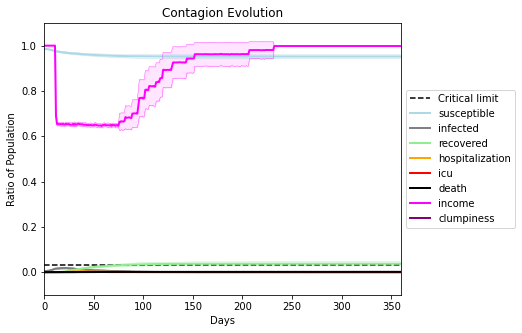

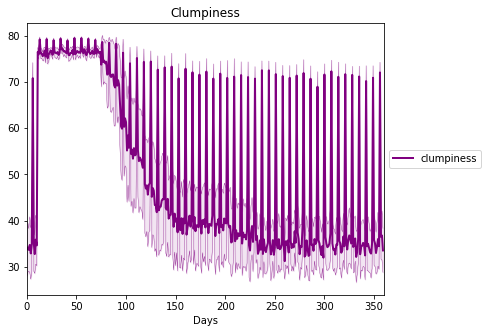

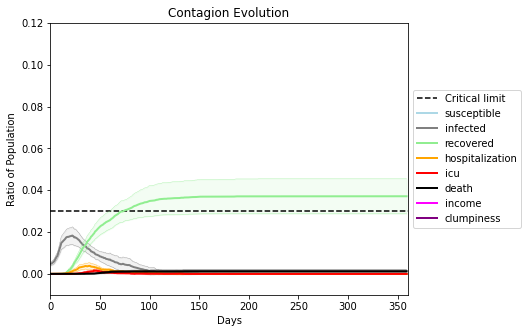

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-1", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[2782, 3885, 1126, 272, 4593, 6788, 7675, 3582, 1397, 7193, 1809, 4885, 4354, 9547, 3786, 1672, 7951, 8993, 9309, 4162]
Average similarity between family members is 0.9948358617631924 at temperature -0.999
Average similarity between family and home is 0.9998989267983784 at temperature -1
Average similarity between students and their classroom is 0.7734095829152603 at temperature -0.999
Average classroom occupancy is 12.521739130434783 and number classrooms is 23
Average similarity between workers is 0.9997941947650156 at temperature -0.999
Average office occupancy is 10.138461538461538 and number offices is 65
Average friend similarity for adults: 0.9997991136235427 for kids: 0.8533986735783405
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.5796679631408536
disconnects
0.12
clumpiness 27.62
avg restaurant similarity 0.6386647852106765
disconnects
0.51
clumpiness 48.4
avg restaurant similarity 0.48662190162453467
disconnects
0.38
clumpiness 38.31
avg restaurant similarity 0.5064850692925826
disconnects
0.2
clumpiness 28.83
avg restaurant similarity 0.6110598103358786
disconnects
0.25
clumpiness 33.6
avg restaurant similarity 0.42454947518635056
disconnects
0.42
clumpiness 44.7
avg restaurant similarity 0.6618825733898914
disconnects
0.88
clumpiness 71.74
avg restaurant similarity 0.7277446570634234
disconnects
0.41
clumpiness 42.67
avg restaurant similarity 0.5285804618178438
disconnects
0.4
clumpiness 40.04
avg restaurant similarity 0.7170613080082167
disconnects
0.3
clumpiness 35.87
avg restaurant similarity 0.5026494903023472
disconnects
0.13
clumpiness 28.92
avg restaurant similarity 0.6010078578266007
disconnects
0.92
clumpiness 74.19
avg restaurant similarity 0.6614314391550609
disconnects

avg restaurant similarity 0.5764543697891291
disconnects
0.53
clumpiness 48.93
avg restaurant similarity 0.5594484604752725
disconnects
0.49
clumpiness 45.89
avg restaurant similarity 0.5987021360299484
disconnects
0.09
clumpiness 23.29
avg restaurant similarity 0.5839474810865285
disconnects
0.22
clumpiness 31.22
avg restaurant similarity 0.7079466295744782
disconnects
0.57
clumpiness 51.42
avg restaurant similarity 0.5474657003376471
disconnects
0.49
clumpiness 47.27
avg restaurant similarity 0.6033291919958951
disconnects
0.84
clumpiness 69.09
avg restaurant similarity 0.6298487990910973
disconnects
0.29
clumpiness 34.3
avg restaurant similarity 0.4708393521446875
disconnects
0.2
clumpiness 28.98
avg restaurant similarity 0.6293882635340099
disconnects
0.55
clumpiness 51.01
avg restaurant similarity 0.5540248480523974
disconnects
0.3
clumpiness 34.93
avg restaurant similarity 0.5202222005676403
disconnects
0.33
clumpiness 41.22
avg restaurant similarity 0.612987499677551
disconnects

avg restaurant similarity 0.6698651728263149
disconnects
0.86
clumpiness 70.13
avg restaurant similarity 0.4927960539237467
disconnects
0.54
clumpiness 49.85
avg restaurant similarity 0.4886420005902076
disconnects
0.44
clumpiness 43.58
avg restaurant similarity 0.5693242161649402
disconnects
0.49
clumpiness 46.84
avg restaurant similarity 0.6536868892678547
disconnects
0.47
clumpiness 46.23
avg restaurant similarity 0.576492638897262
disconnects
0.07
clumpiness 23.51
avg restaurant similarity 0.46627902644538544
disconnects
0.1
clumpiness 23.08
avg restaurant similarity 0.7640532560550888
disconnects
0.84
clumpiness 68.9
avg restaurant similarity 0.5631747633017328
disconnects
0.13
clumpiness 27.35
avg restaurant similarity 0.5833127641585854
disconnects
0.46
clumpiness 46.6
avg restaurant similarity 0.7453704113636367
disconnects
0.19
clumpiness 29.07
avg restaurant similarity 0.47305819594346854
disconnects
0.19
clumpiness 30.17
avg restaurant similarity 0.43536555472365196
disconne

disconnects
0.43
clumpiness 43.34
avg restaurant similarity 0.5296469113032483
disconnects
0.71
clumpiness 61.29
avg restaurant similarity 0.3338591205296196
disconnects
0.5
clumpiness 47.39
avg restaurant similarity 0.5707366095680025
disconnects
0.55
clumpiness 49.97
avg restaurant similarity 0.5697922873821079
disconnects
0.36
clumpiness 39.97
avg restaurant similarity 0.4896159933624299
disconnects
0.1
clumpiness 25.06
avg restaurant similarity 0.4837119442045849
disconnects
0.52
clumpiness 48.53
avg restaurant similarity 0.6763213012505094
disconnects
0.49
clumpiness 46.16
avg restaurant similarity 0.6180145769250994
disconnects
0.93
clumpiness 74.96
avg restaurant similarity 0.4684061595190386
disconnects
0.08
clumpiness 21.62
avg restaurant similarity 0.5526003709948558
disconnects
0.31
clumpiness 36.25
avg restaurant similarity 0.5237448267716898
disconnects
0.11
clumpiness 26.67
avg restaurant similarity 0.6548577991110539
disconnects
0.39
clumpiness 40.9
avg restaurant simila

avg restaurant similarity 0.481523651613379
disconnects
0.0
clumpiness 19.65
avg restaurant similarity 0.5776128663837921
disconnects
0.1
clumpiness 23.63
avg restaurant similarity 0.6389867045303248
disconnects
0.04
clumpiness 19.52
avg restaurant similarity 0.6229381775126462
disconnects
0.07
clumpiness 20.99
avg restaurant similarity 0.4927328606351414
disconnects
0.01
clumpiness 16.22
avg restaurant similarity 0.6148950016421435
disconnects
0.01
clumpiness 18.49
avg restaurant similarity 0.4843614179783636
disconnects
0.74
clumpiness 62.44
avg restaurant similarity 0.5859401723194992
disconnects
0.01
clumpiness 17.82
avg restaurant similarity 0.46669070813673635
disconnects
0.03
clumpiness 18.78
avg restaurant similarity 0.5069743116260264
disconnects
0.0
clumpiness 18.13
avg restaurant similarity 0.47532533110142905
disconnects
0.24
clumpiness 30.87
avg restaurant similarity 0.4909647843459032
disconnects
0.97
clumpiness 77.94
avg restaurant similarity 0.5086978267090511
disconnec

avg restaurant similarity 0.589703442267409
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5061313534280589
disconnects
0.96
clumpiness 77.08
avg restaurant similarity 0.5226756354394371
disconnects
0.87
clumpiness 70.96
avg restaurant similarity 0.592740771735762
disconnects
0.88
clumpiness 71.54
avg restaurant similarity 0.5822065700426177
disconnects
0.94
clumpiness 75.73
avg restaurant similarity 0.6043055378225786
disconnects
0.94
clumpiness 75.86
avg restaurant similarity 0.6196905974422598
disconnects
0.88
clumpiness 71.62
avg restaurant similarity 0.4041012781058891
disconnects
0.98
clumpiness 78.5
avg restaurant similarity 0.4752659235590296
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.42736049246703234
disconnects
0.93
clumpiness 74.99
avg restaurant similarity 0.5850552251792267
disconnects
0.98
clumpiness 78.51
avg restaurant similarity 0.4753540136605294
disconnects
0.9
clumpiness 72.91
avg restaurant similarity 0.580913516751827
disconnects
0

disconnects
0.11
clumpiness 23.73
avg restaurant similarity 0.6085042389379821
disconnects
0.87
clumpiness 71.58
avg restaurant similarity 0.5772499142117689
disconnects
0.08
clumpiness 23.76
avg restaurant similarity 0.5413702072166916
disconnects
0.01
clumpiness 19.39
avg restaurant similarity 0.5107098746499495
disconnects
0.0
clumpiness 21.68
avg restaurant similarity 0.5474445602777859
disconnects
0.01
clumpiness 19.02
avg restaurant similarity 0.46862734153207536
disconnects
0.14
clumpiness 28.22
avg restaurant similarity 0.6134079919000551
disconnects
0.03
clumpiness 19.31
avg restaurant similarity 0.6289871358760043
disconnects
0.77
clumpiness 65.42
avg restaurant similarity 0.6349584295560529
disconnects
0.11
clumpiness 23.63
avg restaurant similarity 0.5717005436604593
disconnects
0.0
clumpiness 15.96
avg restaurant similarity 0.6130952543387407
disconnects
0.14
clumpiness 24.51
avg restaurant similarity 0.6013503837963304
disconnects
0.22
clumpiness 31.81
avg restaurant simi

avg restaurant similarity 0.5036009643327272
disconnects
0.01
clumpiness 19.22
avg restaurant similarity 0.5667536179783561
disconnects
0.92
clumpiness 74.34
avg restaurant similarity 0.5524928252036134
disconnects
0.1
clumpiness 24.41
avg restaurant similarity 0.5487680315300406
disconnects
0.13
clumpiness 25.1
avg restaurant similarity 0.47112610862282905
disconnects
0.01
clumpiness 19.57
avg restaurant similarity 0.5041320903511712
disconnects
0.0
clumpiness 17.52
avg restaurant similarity 0.5590565280797184
disconnects
0.2
clumpiness 31.75
avg restaurant similarity 0.512608219689927
disconnects
0.01
clumpiness 18.68
avg restaurant similarity 0.6130027282190459
disconnects
0.8
clumpiness 66.15
avg restaurant similarity 0.5689256176570863
disconnects
0.21
clumpiness 30.27
avg restaurant similarity 0.48774861743939596
disconnects
0.02
clumpiness 18.07
avg restaurant similarity 0.4305839844119098
disconnects
0.34
clumpiness 36.88
avg restaurant similarity 0.5539477187999149
disconnects

avg restaurant similarity 0.6018526245380214
disconnects
0.01
clumpiness 16.78
avg restaurant similarity 0.6315069605217664
disconnects
0.0
clumpiness 15.11
avg restaurant similarity 0.728266617318889
disconnects
0.0
clumpiness 18.91
avg restaurant similarity 0.6810441245229615
disconnects
0.0
clumpiness 17.46
avg restaurant similarity 0.5688282406003216
disconnects
0.0
clumpiness 15.29
avg restaurant similarity 0.595592024068284
disconnects
0.03
clumpiness 19.57
avg restaurant similarity 0.6439337074589678
disconnects
0.85
clumpiness 70.2
avg restaurant similarity 0.5078785048038915
disconnects
0.02
clumpiness 15.47
avg restaurant similarity 0.6284707487986483
disconnects
0.02
clumpiness 16.74
avg restaurant similarity 0.6235054421337414
disconnects
0.03
clumpiness 16.04
avg restaurant similarity 0.5232198639268564
disconnects
0.01
clumpiness 14.86
avg restaurant similarity 0.7354273893298774
disconnects
0.9
clumpiness 72.9
avg restaurant similarity 0.6575285453465656
disconnects
0.96

avg restaurant similarity 0.663685664476407
disconnects
0.02
clumpiness 17.9
avg restaurant similarity 0.6497671877330329
disconnects
0.04
clumpiness 20.84
avg restaurant similarity 0.6234543075912534
disconnects
0.02
clumpiness 19.84
avg restaurant similarity 0.5539532708515965
disconnects
0.1
clumpiness 22.09
avg restaurant similarity 0.673732402361489
disconnects
0.01
clumpiness 17.93
avg restaurant similarity 0.6563680407451757
disconnects
0.0
clumpiness 18.0
avg restaurant similarity 0.5470211390178564
disconnects
0.84
clumpiness 69.15
avg restaurant similarity 0.4987335528958966
disconnects
0.11
clumpiness 22.24
avg restaurant similarity 0.7752832263216403
disconnects
0.08
clumpiness 22.62
avg restaurant similarity 0.6436590668136772
disconnects
0.02
clumpiness 16.35
avg restaurant similarity 0.6532305019048512
disconnects
0.0
clumpiness 19.34
avg restaurant similarity 0.6004905817258733
disconnects
0.01
clumpiness 20.98
avg restaurant similarity 0.5024757427914377
disconnects
0.

avg restaurant similarity 0.5367566242706253
disconnects
0.0
clumpiness 17.05
avg restaurant similarity 0.6455390816248127
disconnects
0.01
clumpiness 15.8
avg restaurant similarity 0.5928798637747571
disconnects
0.02
clumpiness 19.64
avg restaurant similarity 0.6980955749413249
disconnects
0.04
clumpiness 18.72
avg restaurant similarity 0.643695515653534
disconnects
0.02
clumpiness 18.06
avg restaurant similarity 0.6552480654681261
disconnects
0.0
clumpiness 17.39
avg restaurant similarity 0.5854448012838872
disconnects
0.76
clumpiness 64.57
avg restaurant similarity 0.7300902149965846
disconnects
0.0
clumpiness 15.39
avg restaurant similarity 0.6213724646691008
disconnects
0.01
clumpiness 18.1
avg restaurant similarity 0.7325053967891558
disconnects
0.0
clumpiness 15.56
avg restaurant similarity 0.6912504495347783
disconnects
0.12
clumpiness 23.96
avg restaurant similarity 0.6204092655071235
disconnects
0.01
clumpiness 16.2
avg restaurant similarity 0.4593323088858951
disconnects
0.0

avg restaurant similarity 0.6456293673005146
disconnects
0.02
clumpiness 15.36
avg restaurant similarity 0.5968599191180208
disconnects
0.0
clumpiness 17.17
avg restaurant similarity 0.604025530421049
disconnects
0.0
clumpiness 14.35
avg restaurant similarity 0.6828102822982031
disconnects
0.01
clumpiness 16.64
avg restaurant similarity 0.5393333386984049
disconnects
0.0
clumpiness 15.37
avg restaurant similarity 0.6675265525214977
disconnects
0.09
clumpiness 22.92
avg restaurant similarity 0.5936844327246998
disconnects
0.62
clumpiness 58.61
avg restaurant similarity 0.7116846597816793
disconnects
0.16
clumpiness 27.52
avg restaurant similarity 0.5487506446070665
disconnects
0.02
clumpiness 18.14
avg restaurant similarity 0.6896846831420095
disconnects
0.0
clumpiness 13.63
avg restaurant similarity 0.5736627376391292
disconnects
0.01
clumpiness 19.28
avg restaurant similarity 0.6459720463726043
disconnects
0.0
clumpiness 14.56
avg restaurant similarity 0.6632516210913973
disconnects
0

avg restaurant similarity 0.4956893885864689
disconnects
0.21
clumpiness 34.17
avg restaurant similarity 0.6236985442514021
disconnects
0.16
clumpiness 30.5
avg restaurant similarity 0.48769096009179386
disconnects
0.18
clumpiness 33.8
avg restaurant similarity 0.44630169146859927
disconnects
0.28
clumpiness 37.14
avg restaurant similarity 0.47408447006754567
disconnects
0.17
clumpiness 27.72
avg restaurant similarity 0.5579126674446999
disconnects
0.19
clumpiness 29.86
avg restaurant similarity 0.48231671843227614
disconnects
0.94
clumpiness 75.91
avg restaurant similarity 0.5773767096922142
disconnects
0.2
clumpiness 29.85
avg restaurant similarity 0.43944137689795054
disconnects
0.21
clumpiness 33.48
avg restaurant similarity 0.5469383562602472
disconnects
0.2
clumpiness 32.93
avg restaurant similarity 0.5350236254770915
disconnects
0.21
clumpiness 31.53
avg restaurant similarity 0.5462487081630788
disconnects
0.92
clumpiness 74.47
avg restaurant similarity 0.5070958650693287
discon

avg restaurant similarity 0.5724612146211
disconnects
0.2
clumpiness 29.29
avg restaurant similarity 0.6693705010987886
disconnects
0.21
clumpiness 35.15
avg restaurant similarity 0.6234726223579062
disconnects
0.21
clumpiness 31.8
avg restaurant similarity 0.6112856767607856
disconnects
0.15
clumpiness 31.22
avg restaurant similarity 0.6307293312299977
disconnects
0.13
clumpiness 31.16
avg restaurant similarity 0.5635311453944097
disconnects
0.33
clumpiness 40.83
avg restaurant similarity 0.5081411334715061
disconnects
0.87
clumpiness 71.17
avg restaurant similarity 0.5651574158205334
disconnects
0.18
clumpiness 31.42
avg restaurant similarity 0.5910193143238951
disconnects
0.15
clumpiness 27.82
avg restaurant similarity 0.5468328812074272
disconnects
0.2
clumpiness 32.7
avg restaurant similarity 0.6583985668779327
disconnects
0.13
clumpiness 29.12
avg restaurant similarity 0.5293038901258647
disconnects
0.17
clumpiness 27.99
avg restaurant similarity 0.4562537754016289
disconnects
0.

avg restaurant similarity 0.579628268821239
disconnects
0.17
clumpiness 30.29
avg restaurant similarity 0.5602646090981157
disconnects
0.19
clumpiness 31.27
avg restaurant similarity 0.6821165913485212
disconnects
0.21
clumpiness 34.07
avg restaurant similarity 0.6274575848301652
disconnects
0.13
clumpiness 28.44
avg restaurant similarity 0.481970180674325
disconnects
0.29
clumpiness 36.33
avg restaurant similarity 0.6592277828562901
disconnects
0.14
clumpiness 29.12
avg restaurant similarity 0.52747085782223
disconnects
0.94
clumpiness 75.69
avg restaurant similarity 0.5249499509592356
disconnects
0.17
clumpiness 32.04
avg restaurant similarity 0.5054150814881848
disconnects
0.12
clumpiness 30.06
avg restaurant similarity 0.4929688909391093
disconnects
0.24
clumpiness 34.08
avg restaurant similarity 0.5040671892825299
disconnects
0.18
clumpiness 31.36
avg restaurant similarity 0.5961114904779365
disconnects
0.24
clumpiness 33.58
avg restaurant similarity 0.565381229686939
disconnects


avg restaurant similarity 0.46656668937808876
disconnects
0.18
clumpiness 34.47
avg restaurant similarity 0.6001579408014989
disconnects
0.37
clumpiness 41.54
avg restaurant similarity 0.6275291826741951
disconnects
0.19
clumpiness 33.09
avg restaurant similarity 0.5579172293414909
disconnects
0.17
clumpiness 28.13
avg restaurant similarity 0.5081850995773348
disconnects
0.2
clumpiness 33.45
avg restaurant similarity 0.6527885427601962
disconnects
0.18
clumpiness 31.16
avg restaurant similarity 0.5394704837593098
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.4982060131565294
disconnects
0.2
clumpiness 30.76
avg restaurant similarity 0.6358251342424003
disconnects
0.16
clumpiness 29.55
avg restaurant similarity 0.6662293689311661
disconnects
0.18
clumpiness 29.38
avg restaurant similarity 0.5726247816556949
disconnects
0.21
clumpiness 32.4
avg restaurant similarity 0.523669781022033
disconnects
0.17
clumpiness 30.76
avg restaurant similarity 0.523628053790974
disconnects

avg restaurant similarity 0.6729396060782835
disconnects
0.0
clumpiness 19.01
avg restaurant similarity 0.5859307235651119
disconnects
0.0
clumpiness 16.45
avg restaurant similarity 0.4672980526359702
disconnects
0.05
clumpiness 22.62
avg restaurant similarity 0.6530560123286783
disconnects
0.38
clumpiness 40.47
avg restaurant similarity 0.5683649116176737
disconnects
0.0
clumpiness 18.52
avg restaurant similarity 0.6068218586502945
disconnects
0.24
clumpiness 32.11
avg restaurant similarity 0.5698581977856655
disconnects
0.71
clumpiness 61.01
avg restaurant similarity 0.516696256534586
disconnects
0.12
clumpiness 25.58
avg restaurant similarity 0.4326336970320012
disconnects
0.1
clumpiness 24.45
avg restaurant similarity 0.5459514310195035
disconnects
0.0
clumpiness 17.66
avg restaurant similarity 0.4775486721119225
disconnects
0.1
clumpiness 26.06
avg restaurant similarity 0.5259543624820525
disconnects
0.91
clumpiness 73.43
avg restaurant similarity 0.5679387857176588
disconnects
0.

avg restaurant similarity 0.6463092051793445
disconnects
0.95
clumpiness 76.41
avg restaurant similarity 0.671555818192663
disconnects
0.98
clumpiness 78.56
avg restaurant similarity 0.5968007899948374
disconnects
0.0
clumpiness 18.36
avg restaurant similarity 0.5372664930676523
disconnects
0.09
clumpiness 24.78
avg restaurant similarity 0.6001899211412284
disconnects
0.0
clumpiness 17.58
avg restaurant similarity 0.5790457151237582
disconnects
0.05
clumpiness 22.63
avg restaurant similarity 0.7102376132771011
disconnects
0.83
clumpiness 68.25
avg restaurant similarity 0.5490824053223298
disconnects
0.0
clumpiness 17.78
avg restaurant similarity 0.39501449560229757
disconnects
0.4
clumpiness 42.38
avg restaurant similarity 0.5823394405995049
disconnects
0.07
clumpiness 21.24
avg restaurant similarity 0.5890550867664944
disconnects
0.0
clumpiness 19.09
avg restaurant similarity 0.501949855045044
disconnects
0.0
clumpiness 19.26
avg restaurant similarity 0.5292283969992868
disconnects
0.

avg restaurant similarity 0.5770488685892855
disconnects
0.11
clumpiness 25.88
avg restaurant similarity 0.51308775745554
disconnects
0.0
clumpiness 19.84
avg restaurant similarity 0.4874325325174709
disconnects
0.11
clumpiness 25.52
avg restaurant similarity 0.5804208038581639
disconnects
0.04
clumpiness 20.6
avg restaurant similarity 0.565314958594665
disconnects
0.06
clumpiness 21.64
avg restaurant similarity 0.6166466689785346
disconnects
0.0
clumpiness 17.68
avg restaurant similarity 0.6208019625127682
disconnects
0.82
clumpiness 68.93
avg restaurant similarity 0.5441148588265532
disconnects
0.0
clumpiness 18.48
avg restaurant similarity 0.5126796283447909
disconnects
0.0
clumpiness 17.33
avg restaurant similarity 0.586293497207677
disconnects
0.36
clumpiness 39.07
avg restaurant similarity 0.5859612349588098
disconnects
0.0
clumpiness 19.08
avg restaurant similarity 0.44219034417008773
disconnects
0.48
clumpiness 47.02
avg restaurant similarity 0.47250517381598406
disconnects
0.1

avg restaurant similarity 0.3958835212963065
disconnects
0.07
clumpiness 23.94
avg restaurant similarity 0.5217748662931566
disconnects
0.0
clumpiness 19.27
avg restaurant similarity 0.5580325386559777
disconnects
0.08
clumpiness 25.62
avg restaurant similarity 0.5983415472151382
disconnects
0.0
clumpiness 20.09
avg restaurant similarity 0.49366269684572367
disconnects
0.0
clumpiness 19.35
avg restaurant similarity 0.5809170958292167
disconnects
0.0
clumpiness 17.89
avg restaurant similarity 0.4829002199530576
disconnects
0.9
clumpiness 72.95
avg restaurant similarity 0.7043072483318539
disconnects
0.0
clumpiness 17.89
avg restaurant similarity 0.7030368578747926
disconnects
0.0
clumpiness 19.2
avg restaurant similarity 0.5435095630178329
disconnects
0.0
clumpiness 18.0
avg restaurant similarity 0.6044733974652435
disconnects
0.12
clumpiness 25.18
avg restaurant similarity 0.5369806369613815
disconnects
0.29
clumpiness 34.69
avg restaurant similarity 0.6172557131982331
disconnects
0.0


avg restaurant similarity 0.2940023989290903
disconnects
0.17
clumpiness 30.89
avg restaurant similarity 0.28066776568019824
disconnects
0.0
clumpiness 28.5
avg restaurant similarity 0.5059818954341903
disconnects
0.73
clumpiness 62.89
avg restaurant similarity 0.4826578983934692
disconnects
0.62
clumpiness 56.54
avg restaurant similarity 0.5230858048500477
disconnects
0.01
clumpiness 20.79
avg restaurant similarity 0.2406358783701203
disconnects
0.13
clumpiness 31.67
avg restaurant similarity 0.42869217565443046
disconnects
0.93
clumpiness 74.94
avg restaurant similarity 0.3630885147118548
disconnects
0.67
clumpiness 57.88
avg restaurant similarity 0.31589107756157864
disconnects
0.41
clumpiness 46.25
avg restaurant similarity 0.3369199881549195
disconnects
0.4
clumpiness 44.72
avg restaurant similarity 0.4328216770165746
disconnects
0.31
clumpiness 38.35
avg restaurant similarity 0.3291292978501874
disconnects
0.96
clumpiness 77.04
avg restaurant similarity 0.22575847937775
disconnec

disconnects
0.44
clumpiness 47.21
avg restaurant similarity 0.4242488144152491
disconnects
0.98
clumpiness 78.6
avg restaurant similarity 0.5010352033520132
disconnects
0.1
clumpiness 25.49
avg restaurant similarity 0.6237425825722437
disconnects
0.3
clumpiness 41.61
avg restaurant similarity 0.2906146826063001
disconnects
0.0
clumpiness 24.98
avg restaurant similarity 0.4139206763729549
disconnects
0.2
clumpiness 37.5
avg restaurant similarity 0.33578805380336874
disconnects
0.27
clumpiness 42.44
avg restaurant similarity 0.4129679700285113
disconnects
0.17
clumpiness 31.98
avg restaurant similarity 0.3950763396899355
disconnects
0.96
clumpiness 77.27
avg restaurant similarity 0.44033767763930076
disconnects
0.01
clumpiness 20.1
avg restaurant similarity 0.415863127387798
disconnects
0.0
clumpiness 26.08
avg restaurant similarity 0.3955692361155724
disconnects
0.01
clumpiness 25.63
avg restaurant similarity 0.4057922094322043
disconnects
0.18
clumpiness 30.08
avg restaurant similarity

disconnects
0.0
clumpiness 23.93
avg restaurant similarity 0.6938353926882462
disconnects
0.28
clumpiness 40.55
avg restaurant similarity 0.5025160115955021
disconnects
0.88
clumpiness 71.5
avg restaurant similarity 0.2476252751136706
disconnects
0.19
clumpiness 33.81
avg restaurant similarity 0.30473146232511883
disconnects
0.26
clumpiness 41.01
avg restaurant similarity 0.37456677370754576
disconnects
0.61
clumpiness 55.06
avg restaurant similarity 0.3686461200347755
disconnects
0.01
clumpiness 23.92
avg restaurant similarity 0.5471854609884561
disconnects
0.18
clumpiness 29.94
avg restaurant similarity 0.5603802014739024
disconnects
0.12
clumpiness 27.57
avg restaurant similarity 0.39350369628738596
disconnects
0.98
clumpiness 78.7
avg restaurant similarity 0.48239531726735757
disconnects
0.01
clumpiness 25.21
avg restaurant similarity 0.5049739795671652
disconnects
0.18
clumpiness 31.63
avg restaurant similarity 0.4154013520743773
disconnects
0.23
clumpiness 37.05
avg restaurant si

disconnects
0.0
clumpiness 26.31
avg restaurant similarity 0.3108682635612417
disconnects
0.25
clumpiness 34.5
avg restaurant similarity 0.5746909437301639
disconnects
0.24
clumpiness 32.26
avg restaurant similarity 0.34493847684631507
disconnects
0.95
clumpiness 76.42
avg restaurant similarity 0.2554547212650402
disconnects
0.52
clumpiness 50.73
avg restaurant similarity 0.34260985036016717
disconnects
0.37
clumpiness 40.36
avg restaurant similarity 0.2875641286227669
disconnects
0.15
clumpiness 28.93
avg restaurant similarity 0.5382139389437423
disconnects
0.23
clumpiness 31.86
avg restaurant similarity 0.4342548303966948
disconnects
0.33
clumpiness 42.86
avg restaurant similarity 0.459587360289537
disconnects
0.37
clumpiness 41.18
avg restaurant similarity 0.5168937276187914
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.4756143748180799
disconnects
0.42
clumpiness 44.81
avg restaurant similarity 0.4496233113812504
disconnects
0.5
clumpiness 51.13
avg restaurant simil

avg restaurant similarity 0.6175024473253659
disconnects
0.23
clumpiness 30.21
avg restaurant similarity 0.6157134989429169
disconnects
0.15
clumpiness 30.71
avg restaurant similarity 0.6582946160313702
disconnects
0.24
clumpiness 40.03
avg restaurant similarity 0.7066292511607886
disconnects
0.21
clumpiness 29.34
avg restaurant similarity 0.6489642211264312
disconnects
0.07
clumpiness 21.25
avg restaurant similarity 0.6184054487919479
disconnects
0.2
clumpiness 34.71
avg restaurant similarity 0.6399793283721312
disconnects
0.91
clumpiness 73.97
avg restaurant similarity 0.6973153938479439
disconnects
0.24
clumpiness 36.77
avg restaurant similarity 0.6310067499919227
disconnects
0.07
clumpiness 30.29
avg restaurant similarity 0.6816997076776264
disconnects
0.12
clumpiness 26.4
avg restaurant similarity 0.6165723761827724
disconnects
0.11
clumpiness 27.92
avg restaurant similarity 0.7079679738608172
disconnects
0.96
clumpiness 77.23
avg restaurant similarity 0.5614266717984076
disconnec

avg restaurant similarity 0.721210819047696
disconnects
0.92
clumpiness 74.29
avg restaurant similarity 0.6986110301792012
disconnects
0.98
clumpiness 78.64
avg restaurant similarity 0.6271580380313109
disconnects
0.94
clumpiness 75.68
avg restaurant similarity 0.800399987283813
disconnects
0.92
clumpiness 73.97
avg restaurant similarity 0.6704981068167742
disconnects
0.9
clumpiness 73.27
avg restaurant similarity 0.6986096106705675
disconnects
0.94
clumpiness 75.72
avg restaurant similarity 0.6398375608184173
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.6491886665280386
disconnects
0.9
clumpiness 73.28
avg restaurant similarity 0.6496096811302002
disconnects
0.96
clumpiness 77.22
avg restaurant similarity 0.6723272798469511
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.6783868485050476
disconnects
0.88
clumpiness 71.96
avg restaurant similarity 0.7441816525125818
disconnects
0.99
clumpiness 79.28
avg restaurant similarity 0.746842248047801
disconnects


avg restaurant similarity 0.783414926353889
disconnects
0.1
clumpiness 32.48
avg restaurant similarity 0.6243416918407602
disconnects
0.18
clumpiness 27.32
avg restaurant similarity 0.7485630575795026
disconnects
0.04
clumpiness 19.52
avg restaurant similarity 0.6884041703719762
disconnects
0.19
clumpiness 28.49
avg restaurant similarity 0.685785350770696
disconnects
0.22
clumpiness 29.61
avg restaurant similarity 0.6848679855017822
disconnects
0.18
clumpiness 27.18
avg restaurant similarity 0.686601556965498
disconnects
0.91
clumpiness 73.82
avg restaurant similarity 0.7199789534590879
disconnects
0.11
clumpiness 24.03
avg restaurant similarity 0.6221097854361881
disconnects
0.05
clumpiness 20.32
avg restaurant similarity 0.6998924103100752
disconnects
0.09
clumpiness 24.07
avg restaurant similarity 0.65374204842419
disconnects
0.06
clumpiness 24.54
avg restaurant similarity 0.6698569610692615
disconnects
0.12
clumpiness 29.49
avg restaurant similarity 0.7037374815703304
disconnects
0

disconnects
0.94
clumpiness 75.81
avg restaurant similarity 0.6558196507750464
disconnects
0.25
clumpiness 34.68
avg restaurant similarity 0.7576235394795734
disconnects
0.05
clumpiness 19.04
avg restaurant similarity 0.6011967131698988
disconnects
0.08
clumpiness 23.71
avg restaurant similarity 0.641482158965745
disconnects
0.24
clumpiness 32.58
avg restaurant similarity 0.6592937336369185
disconnects
0.16
clumpiness 26.58
avg restaurant similarity 0.6276694655217325
disconnects
0.11
clumpiness 22.58
avg restaurant similarity 0.6807828036848037
disconnects
0.88
clumpiness 71.54
avg restaurant similarity 0.6116709245000529
disconnects
0.1
clumpiness 24.86
avg restaurant similarity 0.6165480964462638
disconnects
0.14
clumpiness 28.19
avg restaurant similarity 0.6946670106479793
disconnects
0.15
clumpiness 26.21
avg restaurant similarity 0.6634986496821355
disconnects
0.07
clumpiness 22.35
avg restaurant similarity 0.6858279433867215
disconnects
0.08
clumpiness 24.04
avg restaurant simil

avg restaurant similarity 0.7302758296457149
disconnects
0.48
clumpiness 47.13
avg restaurant similarity 0.8042428159977459
disconnects
0.67
clumpiness 58.42
avg restaurant similarity 0.8563110089004466
disconnects
0.73
clumpiness 62.13
avg restaurant similarity 0.8303412686851781
disconnects
0.43
clumpiness 43.92
avg restaurant similarity 0.7264323326404284
disconnects
0.52
clumpiness 49.13
avg restaurant similarity 0.796029739103218
disconnects
0.58
clumpiness 54.24
avg restaurant similarity 0.7753509514182455
disconnects
0.93
clumpiness 75.31
avg restaurant similarity 0.7939454710359737
disconnects
0.52
clumpiness 48.37
avg restaurant similarity 0.6468869006871569
disconnects
0.72
clumpiness 61.29
avg restaurant similarity 0.7940781708917011
disconnects
0.73
clumpiness 62.75
avg restaurant similarity 0.69712717029851
disconnects
0.64
clumpiness 56.13
avg restaurant similarity 0.8973237461430118
disconnects
0.96
clumpiness 77.17
avg restaurant similarity 0.7059258316139103
disconnect

avg restaurant similarity 0.6195972597995308
disconnects
0.96
clumpiness 76.99
avg restaurant similarity 0.7170636233811067
disconnects
0.96
clumpiness 77.11
avg restaurant similarity 0.8414133172720121
disconnects
0.97
clumpiness 77.9
avg restaurant similarity 0.7052681755184714
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.7624174950789048
disconnects
0.96
clumpiness 76.96
avg restaurant similarity 0.8625853762031628
disconnects
0.96
clumpiness 77.08
avg restaurant similarity 0.7071598385583928
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.7003053936222385
disconnects
0.98
clumpiness 78.47
avg restaurant similarity 0.742973989387961
disconnects
0.95
clumpiness 76.28
avg restaurant similarity 0.7450054662108715
disconnects
0.98
clumpiness 78.5
avg restaurant similarity 0.6995724183348875
disconnects
0.96
clumpiness 77.02
avg restaurant similarity 0.6318919020813663
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.7920719215889388
disconnects


avg restaurant similarity 0.6107327740015396
disconnects
0.68
clumpiness 58.53
avg restaurant similarity 0.813118257245154
disconnects
0.65
clumpiness 57.15
avg restaurant similarity 0.9320172751739724
disconnects
0.56
clumpiness 52.54
avg restaurant similarity 0.7668293255203995
disconnects
0.64
clumpiness 56.82
avg restaurant similarity 0.8204844256524206
disconnects
0.55
clumpiness 50.31
avg restaurant similarity 0.7812848392186963
disconnects
0.62
clumpiness 56.42
avg restaurant similarity 0.6513962180834552
disconnects
0.84
clumpiness 69.39
avg restaurant similarity 0.7514334337025977
disconnects
0.66
clumpiness 57.31
avg restaurant similarity 0.642371053655966
disconnects
0.55
clumpiness 52.76
avg restaurant similarity 0.7396917007877274
disconnects
0.59
clumpiness 53.69
avg restaurant similarity 0.5992843692576163
disconnects
0.72
clumpiness 61.55
avg restaurant similarity 0.6750689202227323
disconnects
0.61
clumpiness 54.33
avg restaurant similarity 0.7260479808877275
disconnec

avg restaurant similarity 0.5994489557701349
disconnects
0.72
clumpiness 62.56
avg restaurant similarity 0.698439105261221
disconnects
0.56
clumpiness 53.02
avg restaurant similarity 0.6057326317380833
disconnects
0.58
clumpiness 51.76
avg restaurant similarity 0.651629054635284
disconnects
0.47
clumpiness 46.24
avg restaurant similarity 0.7926911586214666
disconnects
0.62
clumpiness 54.46
avg restaurant similarity 0.7825049950460362
disconnects
0.55
clumpiness 51.18
avg restaurant similarity 0.6169397057397363
disconnects
0.89
clumpiness 72.22
avg restaurant similarity 0.775186927395466
disconnects
0.72
clumpiness 61.33
avg restaurant similarity 0.7708629613706341
disconnects
0.61
clumpiness 57.77
avg restaurant similarity 0.700269495998071
disconnects
0.65
clumpiness 57.15
avg restaurant similarity 0.6429731887524989
disconnects
0.42
clumpiness 43.15
avg restaurant similarity 0.6259548788208565
disconnects
0.51
clumpiness 50.86
avg restaurant similarity 0.7399228566992683
disconnects

avg restaurant similarity 0.5409571330556765
disconnects
0.11
clumpiness 26.13
avg restaurant similarity 0.6247182002506257
disconnects
0.28
clumpiness 37.0
avg restaurant similarity 0.6015274993472022
disconnects
0.21
clumpiness 33.06
avg restaurant similarity 0.6374029497069801
disconnects
0.17
clumpiness 29.1
avg restaurant similarity 0.5904574359732045
disconnects
0.3
clumpiness 34.49
avg restaurant similarity 0.5301260405768964
disconnects
0.21
clumpiness 29.8
avg restaurant similarity 0.5018446109518983
disconnects
0.87
clumpiness 70.85
avg restaurant similarity 0.7915869688673026
disconnects
0.23
clumpiness 33.58
avg restaurant similarity 0.4362119980640413
disconnects
0.16
clumpiness 29.26
avg restaurant similarity 0.7244675698941968
disconnects
0.17
clumpiness 28.19
avg restaurant similarity 0.5208043969371615
disconnects
0.13
clumpiness 26.14
avg restaurant similarity 0.5221859549959764
disconnects
0.9
clumpiness 73.18
avg restaurant similarity 0.6300351819636679
disconnects


avg restaurant similarity 0.5809292077123355
disconnects
0.23
clumpiness 35.35
avg restaurant similarity 0.709853148117508
disconnects
0.21
clumpiness 31.13
avg restaurant similarity 0.6439433996031705
disconnects
0.26
clumpiness 32.3
avg restaurant similarity 0.6527911139659779
disconnects
0.12
clumpiness 26.38
avg restaurant similarity 0.5305877905640933
disconnects
0.18
clumpiness 31.73
avg restaurant similarity 0.5575995301980735
disconnects
0.18
clumpiness 28.79
avg restaurant similarity 0.6638151949807368
disconnects
0.92
clumpiness 74.3
avg restaurant similarity 0.6176496005005291
disconnects
0.12
clumpiness 25.18
avg restaurant similarity 0.5519755716326972
disconnects
0.25
clumpiness 32.33
avg restaurant similarity 0.658414686020774
disconnects
0.12
clumpiness 33.76
avg restaurant similarity 0.5783453522392079
disconnects
0.2
clumpiness 29.87
avg restaurant similarity 0.7109302958294577
disconnects
0.06
clumpiness 26.94
avg restaurant similarity 0.7585351206835652
disconnects


avg restaurant similarity 0.5042076542227661
disconnects
0.31
clumpiness 38.93
avg restaurant similarity 0.6341486748045696
disconnects
0.32
clumpiness 35.9
avg restaurant similarity 0.6543681761771802
disconnects
0.17
clumpiness 31.73
avg restaurant similarity 0.6662964771442585
disconnects
0.19
clumpiness 29.34
avg restaurant similarity 0.6047481984913052
disconnects
0.09
clumpiness 24.11
avg restaurant similarity 0.5948770310903713
disconnects
0.33
clumpiness 39.48
avg restaurant similarity 0.6048141933033876
disconnects
0.88
clumpiness 72.02
avg restaurant similarity 0.6663445691510635
disconnects
0.6
clumpiness 53.5
avg restaurant similarity 0.601034994579537
disconnects
0.3
clumpiness 36.21
avg restaurant similarity 0.6624213412473918
disconnects
0.24
clumpiness 31.04
avg restaurant similarity 0.5723162615244554
disconnects
0.12
clumpiness 24.5
avg restaurant similarity 0.5188092763041563
disconnects
0.27
clumpiness 37.26
avg restaurant similarity 0.5869643862553804
disconnects
0

disconnects
0.83
clumpiness 68.28
avg restaurant similarity 0.6187477756199994
disconnects
0.14
clumpiness 29.33
avg restaurant similarity 0.640068075393752
disconnects
0.24
clumpiness 32.14
avg restaurant similarity 0.47356740010788406
disconnects
0.22
clumpiness 32.09
avg restaurant similarity 0.5779217204822682
disconnects
0.3
clumpiness 35.79
avg restaurant similarity 0.6443937154030932
disconnects
0.2
clumpiness 29.98
avg restaurant similarity 0.6198327493703554
disconnects
0.24
clumpiness 36.27
avg restaurant similarity 0.5648354354809481
disconnects
0.87
clumpiness 70.91
avg restaurant similarity 0.6113924304472392
disconnects
0.42
clumpiness 45.49
avg restaurant similarity 0.6044961899791272
disconnects
0.2
clumpiness 29.98
avg restaurant similarity 0.6821991481914313
disconnects
0.14
clumpiness 29.64
avg restaurant similarity 0.6526470315094458
disconnects
0.52
clumpiness 48.61
avg restaurant similarity 0.6438751333261432
disconnects
0.18
clumpiness 31.21
avg restaurant simila

avg restaurant similarity 0.5108314796198251
disconnects
0.26
clumpiness 30.9
avg restaurant similarity 0.4223809304598393
disconnects
0.26
clumpiness 32.35
avg restaurant similarity 0.4731985095014636
disconnects
0.13
clumpiness 27.2
avg restaurant similarity 0.5193804365989662
disconnects
0.16
clumpiness 25.14
avg restaurant similarity 0.6154051148627974
disconnects
0.58
clumpiness 51.5
avg restaurant similarity 0.4500150105859399
disconnects
0.43
clumpiness 42.34
avg restaurant similarity 0.4333633400113196
disconnects
0.87
clumpiness 71.49
avg restaurant similarity 0.4563086699511442
disconnects
0.52
clumpiness 47.59
avg restaurant similarity 0.5760336851845764
disconnects
0.13
clumpiness 23.84
avg restaurant similarity 0.4793565500560454
disconnects
0.13
clumpiness 23.22
avg restaurant similarity 0.5715507699395966
disconnects
0.17
clumpiness 26.99
avg restaurant similarity 0.45944724127817976
disconnects
0.92
clumpiness 74.28
avg restaurant similarity 0.484600688087706
disconnect

avg restaurant similarity 0.5143799610061591
disconnects
0.93
clumpiness 75.36
avg restaurant similarity 0.6637766883727227
disconnects
0.98
clumpiness 78.58
avg restaurant similarity 0.5566282966519472
disconnects
0.93
clumpiness 75.1
avg restaurant similarity 0.6299170088693893
disconnects
0.9
clumpiness 73.29
avg restaurant similarity 0.5464795033817001
disconnects
0.96
clumpiness 77.18
avg restaurant similarity 0.585785215316553
disconnects
0.11
clumpiness 25.61
avg restaurant similarity 0.6797625425551962
disconnects
0.81
clumpiness 67.67
avg restaurant similarity 0.47929879972123357
disconnects
0.31
clumpiness 37.62
avg restaurant similarity 0.5925699889063749
disconnects
0.08
clumpiness 22.71
avg restaurant similarity 0.5218436967905283
disconnects
0.32
clumpiness 38.46
avg restaurant similarity 0.5877948023028398
disconnects
0.11
clumpiness 21.55
avg restaurant similarity 0.595074650923597
disconnects
0.19
clumpiness 28.7
avg restaurant similarity 0.6864537095214365
disconnects

avg restaurant similarity 0.6786484279225061
disconnects
0.85
clumpiness 70.6
avg restaurant similarity 0.6565916010196156
disconnects
0.57
clumpiness 51.04
avg restaurant similarity 0.5505955427741465
disconnects
0.2
clumpiness 30.21
avg restaurant similarity 0.6635423156551461
disconnects
0.58
clumpiness 51.78
avg restaurant similarity 0.4703542829015492
disconnects
0.27
clumpiness 33.2
avg restaurant similarity 0.5050277800719306
disconnects
0.19
clumpiness 29.88
avg restaurant similarity 0.7212574272758606
disconnects
0.16
clumpiness 26.73
avg restaurant similarity 0.49178117981862335
disconnects
0.77
clumpiness 65.64
avg restaurant similarity 0.5515059702992796
disconnects
0.17
clumpiness 26.02
avg restaurant similarity 0.5445690371848809
disconnects
0.2
clumpiness 29.39
avg restaurant similarity 0.5030237178632724
disconnects
0.24
clumpiness 30.26
avg restaurant similarity 0.48885963858413567
disconnects
0.06
clumpiness 21.61
avg restaurant similarity 0.6518912415797348
disconnec

avg restaurant similarity 0.5993433979057361
disconnects
0.51
clumpiness 47.44
avg restaurant similarity 0.5961412381919456
disconnects
0.92
clumpiness 74.34
avg restaurant similarity 0.45224826291929116
disconnects
0.18
clumpiness 26.61
avg restaurant similarity 0.5762424709837524
disconnects
0.55
clumpiness 49.35
avg restaurant similarity 0.6736109209296646
disconnects
0.32
clumpiness 35.2
avg restaurant similarity 0.39487643712684883
disconnects
0.24
clumpiness 30.79
avg restaurant similarity 0.5245868992426795
disconnects
0.61
clumpiness 53.77
avg restaurant similarity 0.5641510090974207
disconnects
0.33
clumpiness 38.75
avg restaurant similarity 0.5933367064205064
disconnects
0.78
clumpiness 66.79
avg restaurant similarity 0.6695496156111166
disconnects
0.24
clumpiness 29.94
avg restaurant similarity 0.5245505212763474
disconnects
0.16
clumpiness 26.52
avg restaurant similarity 0.4688745863859881
disconnects
0.56
clumpiness 49.95
avg restaurant similarity 0.5875117562144535
discon

avg restaurant similarity 0.5398861205879709
disconnects
0.51
clumpiness 48.63
avg restaurant similarity 0.613838206973302
disconnects
0.63
clumpiness 56.33
avg restaurant similarity 0.5232309167562992
disconnects
0.1
clumpiness 27.78
avg restaurant similarity 0.6561357139703377
disconnects
0.27
clumpiness 34.42
avg restaurant similarity 0.5464713413100846
disconnects
0.35
clumpiness 40.64
avg restaurant similarity 0.6048628462733007
disconnects
0.18
clumpiness 30.31
avg restaurant similarity 0.5896695106919713
disconnects
0.96
clumpiness 77.19
avg restaurant similarity 0.560291970920208
disconnects
0.25
clumpiness 32.3
avg restaurant similarity 0.5044001626013702
disconnects
0.0
clumpiness 19.52
avg restaurant similarity 0.4915532469715997
disconnects
0.17
clumpiness 27.89
avg restaurant similarity 0.6355233368404787
disconnects
0.22
clumpiness 31.29
avg restaurant similarity 0.5355692575047594
disconnects
0.91
clumpiness 73.59
avg restaurant similarity 0.5926565738550127
disconnects


disconnects
0.79
clumpiness 66.63
avg restaurant similarity 0.5860246197131352
disconnects
0.47
clumpiness 47.53
avg restaurant similarity 0.6037136557635769
disconnects
0.11
clumpiness 27.17
avg restaurant similarity 0.5779522411592324
disconnects
0.37
clumpiness 39.57
avg restaurant similarity 0.5644274913796765
disconnects
0.1
clumpiness 26.37
avg restaurant similarity 0.598525505575855
disconnects
0.16
clumpiness 27.26
avg restaurant similarity 0.5855973183122694
disconnects
0.21
clumpiness 31.95
avg restaurant similarity 0.5432780444394522
disconnects
0.91
clumpiness 74.34
avg restaurant similarity 0.6329471254114513
disconnects
0.44
clumpiness 43.47
avg restaurant similarity 0.5291502368654984
disconnects
0.07
clumpiness 24.87
avg restaurant similarity 0.6730092651285832
disconnects
0.13
clumpiness 25.96
avg restaurant similarity 0.5221135145559747
disconnects
0.18
clumpiness 28.78
avg restaurant similarity 0.6058201426865335
disconnects
0.08
clumpiness 23.6
avg restaurant simila

avg restaurant similarity 0.6382929979619449
disconnects
0.93
clumpiness 74.96
avg restaurant similarity 0.5794259673835075
disconnects
0.11
clumpiness 29.78
avg restaurant similarity 0.5451624351745461
disconnects
0.17
clumpiness 29.15
avg restaurant similarity 0.45853982041341784
disconnects
0.1
clumpiness 25.23
avg restaurant similarity 0.5725324821090558
disconnects
0.58
clumpiness 54.2
avg restaurant similarity 0.6908575178805911
disconnects
0.33
clumpiness 38.56
avg restaurant similarity 0.5707578861191361
disconnects
0.53
clumpiness 50.74
avg restaurant similarity 0.6517668883227136
disconnects
0.95
clumpiness 76.46
avg restaurant similarity 0.5727809649321097
disconnects
0.08
clumpiness 23.96
avg restaurant similarity 0.5735641422768287
disconnects
0.14
clumpiness 28.54
avg restaurant similarity 0.5877725192281362
disconnects
0.51
clumpiness 49.82
avg restaurant similarity 0.7210699620991674
disconnects
0.26
clumpiness 33.99
avg restaurant similarity 0.6691276198964055
disconne

disconnects
0.15
clumpiness 25.67
avg restaurant similarity 0.6532101302283926
disconnects
0.9
clumpiness 73.46
avg restaurant similarity 0.5427691866358553
disconnects
0.09
clumpiness 24.78
avg restaurant similarity 0.6250026936289386
disconnects
0.2
clumpiness 32.97
avg restaurant similarity 0.5522885870693349
disconnects
0.35
clumpiness 39.04
avg restaurant similarity 0.7557341184135306
disconnects
0.61
clumpiness 56.37
avg restaurant similarity 0.6675353932283596
disconnects
0.41
clumpiness 42.84
avg restaurant similarity 0.5925832065254096
disconnects
0.32
clumpiness 36.54
avg restaurant similarity 0.5754622062379279
disconnects
0.92
clumpiness 74.26
avg restaurant similarity 0.6190618612425589
disconnects
0.11
clumpiness 26.49
avg restaurant similarity 0.6430715000494813
disconnects
0.07
clumpiness 25.99
avg restaurant similarity 0.6189656148535988
disconnects
0.25
clumpiness 32.48
avg restaurant similarity 0.5417842802382246
disconnects
0.18
clumpiness 29.19
avg restaurant simil

avg restaurant similarity 0.7754984982256156
disconnects
0.58
clumpiness 52.09
avg restaurant similarity 0.8521408625403262
disconnects
0.57
clumpiness 51.06
avg restaurant similarity 0.7636199085787767
disconnects
0.47
clumpiness 45.24
avg restaurant similarity 0.8211914434124544
disconnects
0.62
clumpiness 55.03
avg restaurant similarity 0.7240446971883302
disconnects
0.6
clumpiness 53.35
avg restaurant similarity 0.9072498732348852
disconnects
0.55
clumpiness 49.91
avg restaurant similarity 0.856191779402451
disconnects
0.92
clumpiness 74.37
avg restaurant similarity 0.8495459866681515
disconnects
0.74
clumpiness 62.3
avg restaurant similarity 0.9026757617005976
disconnects
0.67
clumpiness 57.97
avg restaurant similarity 0.7111448726785314
disconnects
0.7
clumpiness 60.34
avg restaurant similarity 0.7686269095012991
disconnects
0.64
clumpiness 56.13
avg restaurant similarity 0.879871741224764
disconnects
0.98
clumpiness 78.51
avg restaurant similarity 0.907384140207924
disconnects
0

avg restaurant similarity 0.8861774006492961
disconnects
0.61
clumpiness 54.28
avg restaurant similarity 0.8441177825540991
disconnects
0.65
clumpiness 56.32
avg restaurant similarity 0.865298106189987
disconnects
0.58
clumpiness 51.26
avg restaurant similarity 0.7966742911217246
disconnects
0.65
clumpiness 55.68
avg restaurant similarity 0.7546489586734598
disconnects
0.65
clumpiness 56.57
avg restaurant similarity 0.7944878490353856
disconnects
0.6
clumpiness 54.5
avg restaurant similarity 0.7188014403773414
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.7011666522063018
disconnects
0.63
clumpiness 54.65
avg restaurant similarity 0.8474596363366327
disconnects
0.72
clumpiness 60.88
avg restaurant similarity 0.7287043270929757
disconnects
0.6
clumpiness 53.2
avg restaurant similarity 0.8135954978847296
disconnects
0.75
clumpiness 62.78
avg restaurant similarity 0.8375593454779106
disconnects
0.69
clumpiness 58.94
avg restaurant similarity 0.758517163906453
disconnects
0

avg restaurant similarity 0.8349603073964651
disconnects
0.67
clumpiness 57.51
avg restaurant similarity 0.7327144902381506
disconnects
0.62
clumpiness 54.66
avg restaurant similarity 0.7138323156413124
disconnects
0.74
clumpiness 62.18
avg restaurant similarity 0.8024952243025287
disconnects
0.66
clumpiness 57.35
avg restaurant similarity 0.7172093291501512
disconnects
0.62
clumpiness 54.2
avg restaurant similarity 0.8266143013255026
disconnects
0.63
clumpiness 55.35
avg restaurant similarity 0.7811117561760407
disconnects
0.83
clumpiness 69.31
avg restaurant similarity 0.813795180858341
disconnects
0.61
clumpiness 53.68
avg restaurant similarity 0.7222447494164335
disconnects
0.63
clumpiness 55.49
avg restaurant similarity 0.7927327699748385
disconnects
0.48
clumpiness 45.9
avg restaurant similarity 0.6658099942927568
disconnects
0.69
clumpiness 58.45
avg restaurant similarity 0.8712694572785413
disconnects
0.48
clumpiness 45.16
avg restaurant similarity 0.8778036850819402
disconnect

avg restaurant similarity 0.7171636123660916
disconnects
0.57
clumpiness 50.95
avg restaurant similarity 0.7372182518695162
disconnects
0.65
clumpiness 55.95
avg restaurant similarity 0.7275364791619134
disconnects
0.55
clumpiness 50.91
avg restaurant similarity 0.6820693999424724
disconnects
0.62
clumpiness 54.69
avg restaurant similarity 0.8674128828962671
disconnects
0.57
clumpiness 51.72
avg restaurant similarity 0.6623339257890017
disconnects
0.67
clumpiness 57.7
avg restaurant similarity 0.7995945828837393
disconnects
0.94
clumpiness 76.06
avg restaurant similarity 0.7945833049344384
disconnects
0.67
clumpiness 57.76
avg restaurant similarity 0.794726900966241
disconnects
0.73
clumpiness 61.84
avg restaurant similarity 0.7667335637346695
disconnects
0.69
clumpiness 59.16
avg restaurant similarity 0.848218929238191
disconnects
0.66
clumpiness 57.06
avg restaurant similarity 0.7560122411216065
disconnects
0.66
clumpiness 57.25
avg restaurant similarity 0.7046962271863256
disconnect

avg restaurant similarity 0.7021115185867529
disconnects
0.01
clumpiness 22.89
avg restaurant similarity 0.822909730846375
disconnects
0.0
clumpiness 22.28
avg restaurant similarity 0.9069190516241747
disconnects
0.0
clumpiness 22.75
avg restaurant similarity 0.792737541187198
disconnects
0.01
clumpiness 22.16
avg restaurant similarity 0.7246982889134815
disconnects
0.0
clumpiness 22.85
avg restaurant similarity 0.7167070250963135
disconnects
0.0
clumpiness 21.45
avg restaurant similarity 0.5262755406432063
disconnects
0.92
clumpiness 74.57
avg restaurant similarity 0.7626997823482462
disconnects
0.0
clumpiness 20.21
avg restaurant similarity 0.7950357873265591
disconnects
0.0
clumpiness 23.25
avg restaurant similarity 0.8456850144215302
disconnects
0.18
clumpiness 34.54
avg restaurant similarity 0.7146040820500994
disconnects
0.0
clumpiness 22.71
avg restaurant similarity 0.7937094701247619
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.8355628851884834
disconnects
0.98

avg restaurant similarity 0.7655764869201942
disconnects
0.0
clumpiness 19.78
avg restaurant similarity 0.7181479747606092
disconnects
0.0
clumpiness 21.78
avg restaurant similarity 0.7354597715063074
disconnects
0.17
clumpiness 34.16
avg restaurant similarity 0.8396496804563076
disconnects
0.0
clumpiness 20.34
avg restaurant similarity 0.7471573139003226
disconnects
0.19
clumpiness 33.0
avg restaurant similarity 0.7572972959878385
disconnects
0.0
clumpiness 23.77
avg restaurant similarity 0.6921015409344565
disconnects
0.77
clumpiness 65.22
avg restaurant similarity 0.7643079281943781
disconnects
0.0
clumpiness 19.74
avg restaurant similarity 0.6389666829198571
disconnects
0.0
clumpiness 26.28
avg restaurant similarity 0.8416061178226972
disconnects
0.0
clumpiness 21.98
avg restaurant similarity 0.7614794605230549
disconnects
0.0
clumpiness 19.76
avg restaurant similarity 0.7020409190768384
disconnects
0.15
clumpiness 28.49
avg restaurant similarity 0.8385846919374793
disconnects
0.0


avg restaurant similarity 0.7410760554124387
disconnects
0.0
clumpiness 21.34
avg restaurant similarity 0.6913879623367616
disconnects
0.13
clumpiness 28.31
avg restaurant similarity 0.5940649029525005
disconnects
0.0
clumpiness 19.82
avg restaurant similarity 0.8060139464389348
disconnects
0.0
clumpiness 22.04
avg restaurant similarity 0.6655380865401038
disconnects
0.0
clumpiness 22.72
avg restaurant similarity 0.6452037331702388
disconnects
0.01
clumpiness 24.93
avg restaurant similarity 0.8479918113993822
disconnects
0.86
clumpiness 70.72
avg restaurant similarity 0.5624473024477874
disconnects
0.25
clumpiness 38.6
avg restaurant similarity 0.6909842879835286
disconnects
0.01
clumpiness 22.05
avg restaurant similarity 0.8091256058412947
disconnects
0.0
clumpiness 21.73
avg restaurant similarity 0.6495111441126239
disconnects
0.0
clumpiness 21.91
avg restaurant similarity 0.7703210236770378
disconnects
0.0
clumpiness 22.07
avg restaurant similarity 0.7098835842386974
disconnects
0.0

avg restaurant similarity 0.7573574433506381
disconnects
0.16
clumpiness 29.98
avg restaurant similarity 0.7215006385379961
disconnects
0.01
clumpiness 18.74
avg restaurant similarity 0.7464454549374913
disconnects
0.01
clumpiness 19.05
avg restaurant similarity 0.7230067424992013
disconnects
0.01
clumpiness 24.42
avg restaurant similarity 0.6768989019097904
disconnects
0.01
clumpiness 22.5
avg restaurant similarity 0.641507462079181
disconnects
0.0
clumpiness 22.49
avg restaurant similarity 0.7394671936519803
disconnects
0.91
clumpiness 73.92
avg restaurant similarity 0.7034408112177771
disconnects
0.0
clumpiness 21.84
avg restaurant similarity 0.6613203111895019
disconnects
0.0
clumpiness 25.49
avg restaurant similarity 0.6833279675282851
disconnects
0.0
clumpiness 21.27
avg restaurant similarity 0.6478426283083296
disconnects
0.01
clumpiness 19.54
avg restaurant similarity 0.7846325919153497
disconnects
0.01
clumpiness 26.19
avg restaurant similarity 0.7112603027916122
disconnects
0

avg restaurant similarity 0.9387944439917741
disconnects
0.27
clumpiness 42.37
avg restaurant similarity 0.8671920726047638
disconnects
0.31
clumpiness 39.53
avg restaurant similarity 0.9330763692716884
disconnects
0.23
clumpiness 37.56
avg restaurant similarity 0.8251158163520151
disconnects
0.28
clumpiness 37.18
avg restaurant similarity 0.7351196937161674
disconnects
0.08
clumpiness 28.35
avg restaurant similarity 0.8457726225078931
disconnects
0.31
clumpiness 41.17
avg restaurant similarity 0.7460403782231573
disconnects
0.95
clumpiness 76.5
avg restaurant similarity 0.8707979917785382
disconnects
0.28
clumpiness 42.32
avg restaurant similarity 0.813051407859615
disconnects
0.22
clumpiness 35.83
avg restaurant similarity 0.999869957727263
disconnects
0.31
clumpiness 43.81
avg restaurant similarity 0.9100944793891856
disconnects
0.19
clumpiness 34.23
avg restaurant similarity 0.89232036294625
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.6587271545816414
disconnects


avg restaurant similarity 0.824844778530864
disconnects
0.3
clumpiness 40.1
avg restaurant similarity 0.8995638713289029
disconnects
0.3
clumpiness 40.33
avg restaurant similarity 0.5758258626052843
disconnects
0.25
clumpiness 40.88
avg restaurant similarity 0.9998827825360483
disconnects
0.23
clumpiness 41.93
avg restaurant similarity 0.7193240624886106
disconnects
0.08
clumpiness 27.87
avg restaurant similarity 0.8996895699812849
disconnects
0.29
clumpiness 41.64
avg restaurant similarity 0.8927219018464129
disconnects
0.97
clumpiness 77.77
avg restaurant similarity 0.7181239805749304
disconnects
0.27
clumpiness 43.18
avg restaurant similarity 0.7823241410486368
disconnects
0.27
clumpiness 39.81
avg restaurant similarity 0.6742227850707115
disconnects
0.31
clumpiness 41.05
avg restaurant similarity 0.9281748440456767
disconnects
0.29
clumpiness 39.77
avg restaurant similarity 0.8715977935272986
disconnects
0.31
clumpiness 43.77
avg restaurant similarity 0.7840325703217152
disconnects

avg restaurant similarity 0.5960264925104547
disconnects
0.11
clumpiness 29.68
avg restaurant similarity 0.7617792568885923
disconnects
0.25
clumpiness 36.43
avg restaurant similarity 0.8177349290668822
disconnects
0.3
clumpiness 45.53
avg restaurant similarity 0.806441062690427
disconnects
0.19
clumpiness 38.76
avg restaurant similarity 0.9340804920315273
disconnects
0.32
clumpiness 44.52
avg restaurant similarity 0.7006782825501359
disconnects
0.09
clumpiness 26.91
avg restaurant similarity 0.8751996553606827
disconnects
0.9
clumpiness 72.89
avg restaurant similarity 0.91540521657711
disconnects
0.35
clumpiness 43.47
avg restaurant similarity 0.9998508768129374
disconnects
0.24
clumpiness 37.01
avg restaurant similarity 0.8505091667979606
disconnects
0.25
clumpiness 40.73
avg restaurant similarity 0.9180107118824582
disconnects
0.3
clumpiness 44.76
avg restaurant similarity 0.9998708010874205
disconnects
0.26
clumpiness 40.73
avg restaurant similarity 0.8821867848486363
disconnects
0

avg restaurant similarity 0.8864631972194392
disconnects
0.28
clumpiness 43.3
avg restaurant similarity 0.9228225018504722
disconnects
0.23
clumpiness 41.26
avg restaurant similarity 0.7580819718240285
disconnects
0.23
clumpiness 36.27
avg restaurant similarity 0.7909833707001688
disconnects
0.21
clumpiness 37.19
avg restaurant similarity 0.7483770586227757
disconnects
0.28
clumpiness 38.46
avg restaurant similarity 0.864217841505821
disconnects
0.22
clumpiness 36.8
avg restaurant similarity 0.999845886383372
disconnects
0.95
clumpiness 76.42
avg restaurant similarity 0.8072292141349536
disconnects
0.22
clumpiness 36.34
avg restaurant similarity 0.9998341588616859
disconnects
0.22
clumpiness 39.47
avg restaurant similarity 0.6298564411578018
disconnects
0.35
clumpiness 43.66
avg restaurant similarity 0.9998617740759899
disconnects
0.25
clumpiness 38.52
avg restaurant similarity 0.6605804833169413
disconnects
0.25
clumpiness 37.64
avg restaurant similarity 0.663928915252955
disconnects


avg restaurant similarity 0.7079541888800649
disconnects
0.31
clumpiness 40.99
avg restaurant similarity 0.709464677314991
disconnects
0.16
clumpiness 29.19
avg restaurant similarity 0.6843048843655409
disconnects
0.16
clumpiness 31.53
avg restaurant similarity 0.6189828096858377
disconnects
0.24
clumpiness 34.73
avg restaurant similarity 0.7097497068386498
disconnects
0.22
clumpiness 36.19
avg restaurant similarity 0.5287657084076407
disconnects
0.29
clumpiness 40.56
avg restaurant similarity 0.7335246503091746
disconnects
0.96
clumpiness 77.09
avg restaurant similarity 0.667133161299149
disconnects
0.22
clumpiness 37.46
avg restaurant similarity 0.6670236232077783
disconnects
0.18
clumpiness 34.12
avg restaurant similarity 0.5756357581736853
disconnects
0.11
clumpiness 31.04
avg restaurant similarity 0.6002301736198061
disconnects
0.33
clumpiness 42.3
avg restaurant similarity 0.7205900510330773
disconnects
0.93
clumpiness 74.85
avg restaurant similarity 0.6562439686402559
disconnect

avg restaurant similarity 0.6798510051965688
disconnects
0.19
clumpiness 35.15
avg restaurant similarity 0.7418894376905831
disconnects
0.19
clumpiness 33.32
avg restaurant similarity 0.49530891215274475
disconnects
0.24
clumpiness 34.32
avg restaurant similarity 0.5671948698557298
disconnects
0.26
clumpiness 38.19
avg restaurant similarity 0.8139065434260901
disconnects
0.17
clumpiness 34.86
avg restaurant similarity 0.49615457884125713
disconnects
0.2
clumpiness 36.38
avg restaurant similarity 0.6263257767650744
disconnects
0.88
clumpiness 71.86
avg restaurant similarity 0.7029235907962359
disconnects
0.22
clumpiness 36.87
avg restaurant similarity 0.6063791317122482
disconnects
0.2
clumpiness 36.86
avg restaurant similarity 0.6783438912341994
disconnects
0.13
clumpiness 28.38
avg restaurant similarity 0.7003030893986487
disconnects
0.18
clumpiness 30.21
avg restaurant similarity 0.590554828856957
disconnects
0.18
clumpiness 33.66
avg restaurant similarity 0.5423075926888491
disconne

avg restaurant similarity 0.7093319383064639
disconnects
0.19
clumpiness 32.35
avg restaurant similarity 0.48135659026078437
disconnects
0.11
clumpiness 28.41
avg restaurant similarity 0.5959932483121664
disconnects
0.17
clumpiness 33.59
avg restaurant similarity 0.625765282030802
disconnects
0.19
clumpiness 30.32
avg restaurant similarity 0.729340160719356
disconnects
0.37
clumpiness 42.82
avg restaurant similarity 0.6239308010712797
disconnects
0.2
clumpiness 32.29
avg restaurant similarity 0.6117089964266921
disconnects
0.95
clumpiness 76.45
avg restaurant similarity 0.5870903628546085
disconnects
0.27
clumpiness 36.66
avg restaurant similarity 0.5886871444607589
disconnects
0.18
clumpiness 27.73
avg restaurant similarity 0.5101039031958782
disconnects
0.17
clumpiness 34.21
avg restaurant similarity 0.5845302798776166
disconnects
0.22
clumpiness 33.7
avg restaurant similarity 0.6122772777991836
disconnects
0.21
clumpiness 33.4
avg restaurant similarity 0.6782540474586441
disconnects

avg restaurant similarity 0.5750267391669293
disconnects
0.33
clumpiness 42.82
avg restaurant similarity 0.656162929856397
disconnects
0.23
clumpiness 34.1
avg restaurant similarity 0.7477147268805875
disconnects
0.25
clumpiness 41.08
avg restaurant similarity 0.6796379596002622
disconnects
0.21
clumpiness 33.48
avg restaurant similarity 0.7317920661105565
disconnects
0.15
clumpiness 31.39
avg restaurant similarity 0.7325127223508124
disconnects
0.18
clumpiness 32.97
avg restaurant similarity 0.7672423765921441
disconnects
0.91
clumpiness 73.67
avg restaurant similarity 0.5707290446898804
disconnects
0.24
clumpiness 37.88
avg restaurant similarity 0.7077875618746029
disconnects
0.19
clumpiness 33.82
avg restaurant similarity 0.8199833075786375
disconnects
0.27
clumpiness 39.84
avg restaurant similarity 0.7558591405920256
disconnects
0.22
clumpiness 35.47
avg restaurant similarity 0.71281613197271
disconnects
0.15
clumpiness 27.5
avg restaurant similarity 0.678513009162826
disconnects
0

avg restaurant similarity 0.7578120883234317
disconnects
0.5
clumpiness 48.33
avg restaurant similarity 0.32742674188835147
disconnects
0.5
clumpiness 49.55
avg restaurant similarity 0.8341076237293337
disconnects
0.41
clumpiness 44.72
avg restaurant similarity 0.46137991515814586
disconnects
0.38
clumpiness 41.48
avg restaurant similarity 0.3987001231161551
disconnects
0.47
clumpiness 45.58
avg restaurant similarity 0.38688466324690524
disconnects
0.39
clumpiness 40.4
avg restaurant similarity 0.6918495662932752
disconnects
0.93
clumpiness 74.8
avg restaurant similarity 0.6898671272125105
disconnects
0.31
clumpiness 36.25
avg restaurant similarity 0.7563780696921216
disconnects
0.43
clumpiness 45.22
avg restaurant similarity 0.4571941904973119
disconnects
0.49
clumpiness 47.95
avg restaurant similarity 0.6250129135771471
disconnects
0.44
clumpiness 44.39
avg restaurant similarity 0.6412770738889672
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.6627228129067247
disconnec

avg restaurant similarity 0.7005290794817258
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.7936801117438926
disconnects
0.98
clumpiness 78.55
avg restaurant similarity 0.830433318890366
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.6622372754842305
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.7654016957539992
disconnects
0.98
clumpiness 78.55
avg restaurant similarity 0.743393402775246
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.9289474286880466
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.8520868519084913
disconnects
0.97
clumpiness 77.86
avg restaurant similarity 0.8077135269606285
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.6404673570109718
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.7491584905278271
disconnects
0.43
clumpiness 44.2
avg restaurant similarity 0.9998114001488972
disconnects
0.48
clumpiness 47.25
avg restaurant similarity 0.8146741778256033
disconnects
0.

avg restaurant similarity 0.6827076007116202
disconnects
0.91
clumpiness 73.49
avg restaurant similarity 0.8489754736219431
disconnects
0.51
clumpiness 49.53
avg restaurant similarity 0.6208393240384321
disconnects
0.46
clumpiness 45.99
avg restaurant similarity 0.552104100556713
disconnects
0.43
clumpiness 44.45
avg restaurant similarity 0.7228104032192264
disconnects
0.36
clumpiness 39.35
avg restaurant similarity 0.8100605925341413
disconnects
0.42
clumpiness 43.24
avg restaurant similarity 0.8870025690109983
disconnects
0.35
clumpiness 39.22
avg restaurant similarity 0.6449243638343279
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.6823530364255085
disconnects
0.46
clumpiness 46.69
avg restaurant similarity 0.7199235965871841
disconnects
0.39
clumpiness 41.83
avg restaurant similarity 0.8297882572039681
disconnects
0.37
clumpiness 39.91
avg restaurant similarity 0.8188047205250595
disconnects
0.43
clumpiness 44.55
avg restaurant similarity 0.7641969126192959
disconne

avg restaurant similarity 0.9046369754749183
disconnects
0.52
clumpiness 50.39
avg restaurant similarity 0.9326942035196236
disconnects
0.95
clumpiness 76.42
avg restaurant similarity 0.5631361801704591
disconnects
0.5
clumpiness 48.14
avg restaurant similarity 0.8013588501674398
disconnects
0.42
clumpiness 42.39
avg restaurant similarity 0.7290577172734154
disconnects
0.44
clumpiness 44.28
avg restaurant similarity 0.6240085874204605
disconnects
0.34
clumpiness 38.9
avg restaurant similarity 0.5634556579069704
disconnects
0.49
clumpiness 47.79
avg restaurant similarity 0.7178728672485003
disconnects
0.37
clumpiness 40.09
avg restaurant similarity 0.8701899555847572
disconnects
0.91
clumpiness 73.44
avg restaurant similarity 0.9317818186967337
disconnects
0.43
clumpiness 43.85
avg restaurant similarity 0.8146271426823277
disconnects
0.44
clumpiness 45.07
avg restaurant similarity 0.6388848176459494
disconnects
0.45
clumpiness 45.57
avg restaurant similarity 0.7913095207497814
disconnec

avg restaurant similarity 0.5753669322524384
disconnects
0.02
clumpiness 18.57
avg restaurant similarity 0.6763804801701975
disconnects
0.01
clumpiness 17.96
avg restaurant similarity 0.6125262062176057
disconnects
0.03
clumpiness 18.23
avg restaurant similarity 0.6778050953943374
disconnects
0.01
clumpiness 17.5
avg restaurant similarity 0.6497331860505104
disconnects
0.0
clumpiness 16.07
avg restaurant similarity 0.6431573177954821
disconnects
0.02
clumpiness 18.27
avg restaurant similarity 0.693770651968684
disconnects
0.69
clumpiness 60.6
avg restaurant similarity 0.5574002602150826
disconnects
0.01
clumpiness 16.99
avg restaurant similarity 0.5179261034862234
disconnects
0.01
clumpiness 18.07
avg restaurant similarity 0.5835603983074035
disconnects
0.02
clumpiness 19.63
avg restaurant similarity 0.5421293901292088
disconnects
0.02
clumpiness 17.89
avg restaurant similarity 0.6373534981465628
disconnects
0.97
clumpiness 77.84
avg restaurant similarity 0.5905054939547277
disconnects

avg restaurant similarity 0.5643951067051479
disconnects
0.02
clumpiness 17.55
avg restaurant similarity 0.49001508146325573
disconnects
0.03
clumpiness 19.63
avg restaurant similarity 0.6889971746124121
disconnects
0.01
clumpiness 18.18
avg restaurant similarity 0.5835922629600934
disconnects
0.01
clumpiness 16.34
avg restaurant similarity 0.6165322805493887
disconnects
0.02
clumpiness 17.28
avg restaurant similarity 0.49641522225980167
disconnects
0.0
clumpiness 17.38
avg restaurant similarity 0.4723877668914759
disconnects
0.91
clumpiness 73.53
avg restaurant similarity 0.65592226793864
disconnects
0.0
clumpiness 18.35
avg restaurant similarity 0.7308503999807094
disconnects
0.01
clumpiness 17.19
avg restaurant similarity 0.5445940172708275
disconnects
0.0
clumpiness 15.33
avg restaurant similarity 0.4659387146934065
disconnects
0.05
clumpiness 20.54
avg restaurant similarity 0.5823902456695368
disconnects
0.0
clumpiness 16.79
avg restaurant similarity 0.6837218083700429
disconnects

avg restaurant similarity 0.6178772097459712
disconnects
0.03
clumpiness 20.15
avg restaurant similarity 0.5699212991564927
disconnects
0.02
clumpiness 18.52
avg restaurant similarity 0.5115483118581431
disconnects
0.0
clumpiness 15.62
avg restaurant similarity 0.5815117179423686
disconnects
0.03
clumpiness 18.56
avg restaurant similarity 0.654743521789356
disconnects
0.0
clumpiness 15.39
avg restaurant similarity 0.521096486497965
disconnects
0.03
clumpiness 18.14
avg restaurant similarity 0.5538778237052251
disconnects
0.92
clumpiness 74.49
avg restaurant similarity 0.6102243424354914
disconnects
0.03
clumpiness 17.37
avg restaurant similarity 0.5230144331937452
disconnects
0.01
clumpiness 17.27
avg restaurant similarity 0.6429720622810178
disconnects
0.03
clumpiness 18.92
avg restaurant similarity 0.7346771901346739
disconnects
0.02
clumpiness 18.27
avg restaurant similarity 0.5971366965446233
disconnects
0.02
clumpiness 17.19
avg restaurant similarity 0.5684561989323007
disconnects

avg restaurant similarity 0.6756846780663225
disconnects
0.04
clumpiness 18.06
avg restaurant similarity 0.5743686675917327
disconnects
0.0
clumpiness 17.32
avg restaurant similarity 0.6878774842689795
disconnects
0.02
clumpiness 17.88
avg restaurant similarity 0.5845221262275403
disconnects
0.05
clumpiness 18.87
avg restaurant similarity 0.5132777935455687
disconnects
0.02
clumpiness 18.24
avg restaurant similarity 0.5796241572316917
disconnects
0.02
clumpiness 17.65
avg restaurant similarity 0.46922112772037883
disconnects
0.87
clumpiness 71.02
avg restaurant similarity 0.5918203530055649
disconnects
0.01
clumpiness 18.76
avg restaurant similarity 0.6982268028449273
disconnects
0.01
clumpiness 16.66
avg restaurant similarity 0.4725941632377882
disconnects
0.02
clumpiness 16.92
avg restaurant similarity 0.4782087544682613
disconnects
0.01
clumpiness 18.29
avg restaurant similarity 0.6342113276809304
disconnects
0.03
clumpiness 18.81
avg restaurant similarity 0.5665108359111001
disconn

avg restaurant similarity 0.9220179317954474
disconnects
0.28
clumpiness 39.89
disconnects
0.29
clumpiness 38.67
avg restaurant similarity 0.7788747898271109
disconnects
0.29
clumpiness 38.32
avg restaurant similarity 0.9997439722493144
disconnects
0.28
clumpiness 37.85
avg restaurant similarity 0.6465857239404319
disconnects
0.2
clumpiness 32.58
avg restaurant similarity 0.5275435948653968
disconnects
0.27
clumpiness 37.4
avg restaurant similarity 0.5393942788753037
disconnects
0.97
clumpiness 77.72
avg restaurant similarity 0.9998000125168741
disconnects
0.28
clumpiness 38.29
avg restaurant similarity 0.9336824839618092
disconnects
0.22
clumpiness 34.35
avg restaurant similarity 0.9997439722493144
disconnects
0.28
clumpiness 38.9
disconnects
0.26
clumpiness 38.56
avg restaurant similarity 0.9996196242835804
disconnects
1.0
clumpiness 80.0
disconnects
0.98
clumpiness 78.58
avg restaurant similarity 0.6874086831153742
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.52843867

disconnects
0.26
clumpiness 38.07
avg restaurant similarity 0.9998002974084864
disconnects
0.25
clumpiness 36.78
disconnects
0.25
clumpiness 36.4
avg restaurant similarity 0.9997852912389524
disconnects
0.37
clumpiness 42.74
disconnects
0.95
clumpiness 76.29
disconnects
0.3
clumpiness 40.83
disconnects
0.3
clumpiness 39.05
avg restaurant similarity 0.9998178459112026
disconnects
0.33
clumpiness 40.6
avg restaurant similarity 0.534191978085194
disconnects
0.32
clumpiness 41.07
disconnects
0.25
clumpiness 37.6
avg restaurant similarity 0.9997751036860184
disconnects
0.3
clumpiness 39.53
disconnects
0.96
clumpiness 76.98
avg restaurant similarity 0.894089123019779
disconnects
0.27
clumpiness 37.11
disconnects
0.29
clumpiness 38.36
avg restaurant similarity 0.5308134132918756
disconnects
0.23
clumpiness 36.98
avg restaurant similarity 0.7271398351327627
disconnects
0.24
clumpiness 34.17
avg restaurant similarity 0.9998089090528962
disconnects
0.3
clumpiness 40.11
disconnects
0.21
clumpines

avg restaurant similarity 0.8943930074316976
disconnects
0.28
clumpiness 36.57
avg restaurant similarity 0.7788242206744509
disconnects
0.15
clumpiness 30.22
avg restaurant similarity 0.5320892974166462
disconnects
0.25
clumpiness 36.84
avg restaurant similarity 0.7908542013690187
disconnects
0.22
clumpiness 35.86
avg restaurant similarity 0.8832840446289774
disconnects
0.16
clumpiness 31.44
avg restaurant similarity 0.9522369194352782
disconnects
0.34
clumpiness 41.88
avg restaurant similarity 0.817211073464613
disconnects
0.94
clumpiness 75.58
avg restaurant similarity 0.9997755910581201
disconnects
0.29
clumpiness 38.68
avg restaurant similarity 0.5298126741314576
disconnects
0.29
clumpiness 38.41
avg restaurant similarity 0.7634363877115733
disconnects
0.29
clumpiness 39.22
avg restaurant similarity 0.7777448551629161
disconnects
0.32
clumpiness 42.13
avg restaurant similarity 0.6164410595222878
disconnects
0.17
clumpiness 31.04
avg restaurant similarity 0.8358453699957618
disconne

avg restaurant similarity 0.8185777389874286
disconnects
0.27
clumpiness 37.41
avg restaurant similarity 0.9109650193987249
disconnects
0.29
clumpiness 39.94
avg restaurant similarity 0.8118417955539556
disconnects
0.16
clumpiness 31.55
avg restaurant similarity 0.6363295680204638
disconnects
0.27
clumpiness 36.12
avg restaurant similarity 0.8304364187388362
disconnects
0.26
clumpiness 37.1
avg restaurant similarity 0.9998455350799661
disconnects
0.35
clumpiness 42.68
avg restaurant similarity 0.7877252945068156
disconnects
0.97
clumpiness 77.73
avg restaurant similarity 0.9997636225315587
disconnects
0.31
clumpiness 38.16
avg restaurant similarity 0.7635972985777979
disconnects
0.31
clumpiness 39.14
avg restaurant similarity 0.8813706528827173
disconnects
0.23
clumpiness 36.78
Average similarity between family members is 0.9928281590999422 at temperature -0.999
Average similarity between family and home is 0.9998873477969081 at temperature -1
Average similarity between students and th

avg restaurant similarity 0.6685383750625714
disconnects
0.48
clumpiness 47.76
avg restaurant similarity 0.5428793365058392
disconnects
0.41
clumpiness 43.48
avg restaurant similarity 0.5749101048341491
disconnects
0.22
clumpiness 31.8
avg restaurant similarity 0.5815870485903595
disconnects
0.44
clumpiness 43.33
avg restaurant similarity 0.6477662613838625
disconnects
0.62
clumpiness 54.51
avg restaurant similarity 0.7493201338256353
disconnects
0.37
clumpiness 41.21
avg restaurant similarity 0.6396408342706056
disconnects
0.93
clumpiness 75.01
avg restaurant similarity 0.6962453364935411
disconnects
0.33
clumpiness 38.45
avg restaurant similarity 0.616041397497711
disconnects
0.22
clumpiness 30.89
avg restaurant similarity 0.6204345987069524
disconnects
0.68
clumpiness 58.8
avg restaurant similarity 0.7557519558942657
disconnects
0.68
clumpiness 58.57
avg restaurant similarity 0.6434320241450189
disconnects
0.89
clumpiness 72.22
avg restaurant similarity 0.5443398834561256
disconnect

avg restaurant similarity 0.5555688225354682
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.6678473938836357
disconnects
0.96
clumpiness 77.17
avg restaurant similarity 0.572826418642341
disconnects
0.94
clumpiness 75.72
avg restaurant similarity 0.6061737676241247
disconnects
0.98
clumpiness 78.64
avg restaurant similarity 0.5406477943905115
disconnects
0.95
clumpiness 76.27
avg restaurant similarity 0.6772794039444789
disconnects
0.93
clumpiness 75.08
avg restaurant similarity 0.6990895268864392
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.703700192293173
disconnects
0.9
clumpiness 72.75
avg restaurant similarity 0.5652106227492057
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.6570276712652938
disconnects
0.96
clumpiness 77.18
avg restaurant similarity 0.5934764809190981
disconnects
0.97
clumpiness 77.77
avg restaurant similarity 0.5577715934203659
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.5920685481378662
disconnects


disconnects
0.82
clumpiness 67.65
avg restaurant similarity 0.7083888789845749
disconnects
0.72
clumpiness 61.2
avg restaurant similarity 0.568340056429611
disconnects
0.6
clumpiness 52.0
avg restaurant similarity 0.6790115995893642
disconnects
0.66
clumpiness 57.27
avg restaurant similarity 0.6617362046498133
disconnects
0.43
clumpiness 44.9
avg restaurant similarity 0.6020951895002361
disconnects
0.43
clumpiness 43.4
avg restaurant similarity 0.5481241014197871
disconnects
0.37
clumpiness 40.75
avg restaurant similarity 0.5098823136618084
disconnects
0.81
clumpiness 68.18
avg restaurant similarity 0.6324276714648859
disconnects
0.41
clumpiness 43.01
avg restaurant similarity 0.6481335348063753
disconnects
0.37
clumpiness 39.47
avg restaurant similarity 0.6308940179949155
disconnects
0.41
clumpiness 42.38
avg restaurant similarity 0.5838695064485937
disconnects
0.27
clumpiness 36.13
avg restaurant similarity 0.590786328214678
disconnects
0.44
clumpiness 43.48
avg restaurant similarity

avg restaurant similarity 0.5722497137340599
disconnects
0.86
clumpiness 70.25
avg restaurant similarity 0.7058658722026867
disconnects
0.4
clumpiness 40.79
avg restaurant similarity 0.6527833993217037
disconnects
0.3
clumpiness 36.9
avg restaurant similarity 0.6890433557779176
disconnects
0.31
clumpiness 38.79
avg restaurant similarity 0.5899001059776803
disconnects
0.66
clumpiness 57.18
avg restaurant similarity 0.6440574323117789
disconnects
0.42
clumpiness 41.86
avg restaurant similarity 0.5462975870914728
disconnects
0.38
clumpiness 39.36
avg restaurant similarity 0.5757037715467465
disconnects
0.67
clumpiness 59.83
avg restaurant similarity 0.593688872269922
disconnects
0.3
clumpiness 37.15
avg restaurant similarity 0.5869098913031671
disconnects
0.4
clumpiness 40.68
avg restaurant similarity 0.6021924269748072
disconnects
0.3
clumpiness 34.86
avg restaurant similarity 0.5679702634078084
disconnects
0.39
clumpiness 40.73
avg restaurant similarity 0.7172345200654302
disconnects
0.

avg restaurant similarity 0.6350719371968835
disconnects
0.3
clumpiness 35.54
avg restaurant similarity 0.48956302834869714
disconnects
0.14
clumpiness 24.72
avg restaurant similarity 0.6206668424284085
disconnects
0.26
clumpiness 34.98
avg restaurant similarity 0.5253997569111241
disconnects
0.23
clumpiness 29.61
avg restaurant similarity 0.7462013298210871
disconnects
0.65
clumpiness 55.99
avg restaurant similarity 0.49598322480298884
disconnects
0.21
clumpiness 30.36
avg restaurant similarity 0.5928621970552455
disconnects
0.92
clumpiness 74.49
avg restaurant similarity 0.6413674492659046
disconnects
0.23
clumpiness 32.17
avg restaurant similarity 0.5506879807119275
disconnects
0.28
clumpiness 32.94
avg restaurant similarity 0.6406175344089751
disconnects
0.02
clumpiness 16.98
avg restaurant similarity 0.6151708254985307
disconnects
0.36
clumpiness 38.43
avg restaurant similarity 0.8638659421855576
disconnects
0.96
clumpiness 77.22
avg restaurant similarity 0.5199379330945406
discon

avg restaurant similarity 0.6745017953495689
disconnects
0.02
clumpiness 18.7
avg restaurant similarity 0.596255996263499
disconnects
0.08
clumpiness 21.77
avg restaurant similarity 0.6004193205314153
disconnects
0.1
clumpiness 21.69
avg restaurant similarity 0.7514015712210981
disconnects
0.1
clumpiness 26.22
avg restaurant similarity 0.6307474846854233
disconnects
0.09
clumpiness 24.33
avg restaurant similarity 0.6898144325198039
disconnects
0.19
clumpiness 28.95
avg restaurant similarity 0.7054594016901821
disconnects
0.92
clumpiness 74.19
avg restaurant similarity 0.6204914346279199
disconnects
0.24
clumpiness 33.25
avg restaurant similarity 0.7403210644144756
disconnects
0.13
clumpiness 26.18
avg restaurant similarity 0.7508657844246531
disconnects
0.04
clumpiness 19.27
avg restaurant similarity 0.6413594295274843
disconnects
0.18
clumpiness 28.18
avg restaurant similarity 0.6534380499071635
disconnects
0.2
clumpiness 30.14
avg restaurant similarity 0.6034499482642
disconnects
0.1

avg restaurant similarity 0.5732593611516403
disconnects
0.01
clumpiness 18.96
avg restaurant similarity 0.6149827848960046
disconnects
0.08
clumpiness 22.16
avg restaurant similarity 0.6178684981773336
disconnects
0.24
clumpiness 30.55
avg restaurant similarity 0.6010435492686481
disconnects
0.01
clumpiness 18.59
avg restaurant similarity 0.7065016759085131
disconnects
0.01
clumpiness 21.25
avg restaurant similarity 0.7038386318042431
disconnects
0.12
clumpiness 29.4
avg restaurant similarity 0.5344458085442003
disconnects
0.87
clumpiness 70.6
avg restaurant similarity 0.7215387820252631
disconnects
0.16
clumpiness 29.9
avg restaurant similarity 0.5876487865513147
disconnects
0.43
clumpiness 42.38
avg restaurant similarity 0.7075275916029007
disconnects
0.17
clumpiness 25.92
avg restaurant similarity 0.5542596033765241
disconnects
0.07
clumpiness 21.11
avg restaurant similarity 0.7531821505814058
disconnects
0.23
clumpiness 31.81
avg restaurant similarity 0.751153927804162
disconnects

avg restaurant similarity 0.6552922176926502
disconnects
0.01
clumpiness 21.06
avg restaurant similarity 0.5745048997273049
disconnects
0.31
clumpiness 36.91
avg restaurant similarity 0.7012894414910152
disconnects
0.22
clumpiness 30.14
avg restaurant similarity 0.6394284752865718
disconnects
0.28
clumpiness 35.55
avg restaurant similarity 0.7536818344974857
disconnects
0.11
clumpiness 25.45
avg restaurant similarity 0.6435464272601812
disconnects
0.1
clumpiness 22.64
avg restaurant similarity 0.5838263345179792
disconnects
0.9
clumpiness 73.06
avg restaurant similarity 0.6080997959043625
disconnects
0.12
clumpiness 23.88
avg restaurant similarity 0.5741208304907426
disconnects
0.13
clumpiness 25.03
avg restaurant similarity 0.5595952015513659
disconnects
0.52
clumpiness 49.17
avg restaurant similarity 0.6550901526105536
disconnects
0.12
clumpiness 24.73
avg restaurant similarity 0.6735801541927487
disconnects
0.13
clumpiness 26.64
avg restaurant similarity 0.6865716930552815
disconnec

9

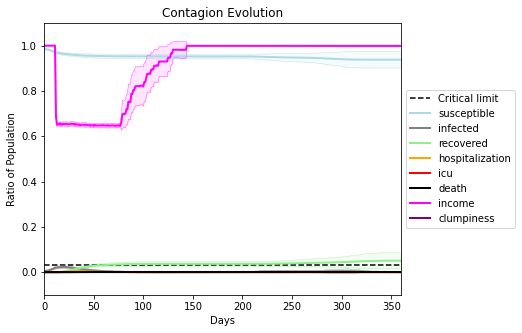

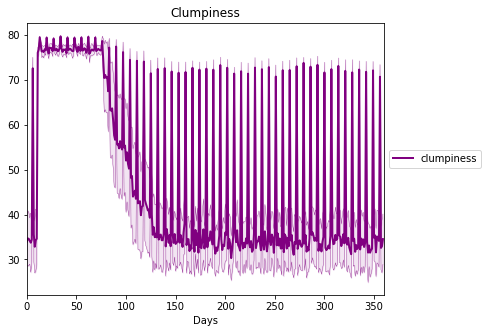

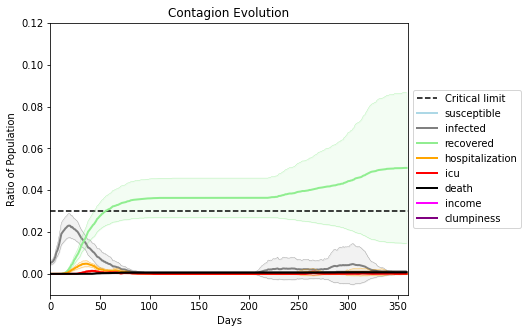

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.999", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )
9

Save these seeds if you want to rerun a scenario
[9864, 9342, 6317, 7834, 5204, 9777, 4954, 8896, 2526, 3854, 4769, 6354, 1989, 9750, 8009, 1849, 5522, 5548, 8904, 9197]
Average similarity between family members is 0.990937202880341 at temperature -0.998
Average similarity between family and home is 0.9999122399200662 at temperature -1
Average similarity between students and their classroom is 0.6892708966358342 at temperature -0.998
Average classroom occupancy is 12.391304347826088 and number classrooms is 23
Average similarity between workers is 0.999098867267058 at temperature -0.998
Average office occupancy is 10.421875 and number offices is 64
Average friend similarity for adults: 0.9993253043513168 for kids: 0.8220381205310596
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogene

avg restaurant similarity 0.6646386041074228
disconnects
0.29
clumpiness 34.61
avg restaurant similarity 0.7099592777130616
disconnects
0.11
clumpiness 23.47
avg restaurant similarity 0.6287184015962042
disconnects
0.13
clumpiness 24.33
avg restaurant similarity 0.5568428557439581
disconnects
0.17
clumpiness 26.18
avg restaurant similarity 0.6790233618872455
disconnects
0.17
clumpiness 26.33
avg restaurant similarity 0.710660765440285
disconnects
0.2
clumpiness 28.58
avg restaurant similarity 0.6248186773426422
disconnects
0.83
clumpiness 68.84
avg restaurant similarity 0.6817332922349665
disconnects
0.17
clumpiness 25.25
avg restaurant similarity 0.5996255765587545
disconnects
0.25
clumpiness 32.23
avg restaurant similarity 0.6296684667772047
disconnects
0.15
clumpiness 25.38
avg restaurant similarity 0.7849079191685592
disconnects
0.17
clumpiness 26.42
avg restaurant similarity 0.7246596647519928
disconnects
0.89
clumpiness 72.33
avg restaurant similarity 0.5814476677549343
disconnec

disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6697954814183165
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.7482535545338659
disconnects
0.92
clumpiness 74.55
avg restaurant similarity 0.6920488150964514
disconnects
0.94
clumpiness 75.64
avg restaurant similarity 0.677195218646527
disconnects
0.93
clumpiness 75.05
avg restaurant similarity 0.6952375051407234
disconnects
0.92
clumpiness 74.35
avg restaurant similarity 0.7214899668288084
disconnects
0.93
clumpiness 75.26
avg restaurant similarity 0.7432127308605732
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.7666271501778279
disconnects
0.94
clumpiness 75.62
avg restaurant similarity 0.5911610059808612
disconnects
0.92
clumpiness 74.31
avg restaurant similarity 0.7327576505850373
disconnects
0.99
clumpiness 79.31
avg restaurant similarity 0.6301724920921121
disconnects
0.93
clumpiness 74.92
avg restaurant similarity 0.5182104562524966
disconnects
0.95
clumpiness 76.62
avg restaurant simila

avg restaurant similarity 0.7023301819746324
disconnects
0.83
clumpiness 68.39
avg restaurant similarity 0.720520316005986
disconnects
0.18
clumpiness 28.82
avg restaurant similarity 0.859137890064287
disconnects
0.18
clumpiness 29.09
avg restaurant similarity 0.6386540276043915
disconnects
0.13
clumpiness 24.69
avg restaurant similarity 0.7326814688560273
disconnects
0.2
clumpiness 29.47
avg restaurant similarity 0.7599876697950837
disconnects
0.15
clumpiness 26.4
avg restaurant similarity 0.5591439971129016
disconnects
0.27
clumpiness 32.65
avg restaurant similarity 0.7786028626330576
disconnects
0.79
clumpiness 66.62
avg restaurant similarity 0.7010396906212355
disconnects
0.2
clumpiness 28.95
avg restaurant similarity 0.7355270305111512
disconnects
0.19
clumpiness 28.09
avg restaurant similarity 0.7106958237661389
disconnects
0.19
clumpiness 29.55
avg restaurant similarity 0.685964790414929
disconnects
0.19
clumpiness 29.0
avg restaurant similarity 0.7175978719904439
disconnects
0.

disconnects
0.19
clumpiness 28.62
avg restaurant similarity 0.6469282473061301
disconnects
0.73
clumpiness 63.83
avg restaurant similarity 0.6285703355034469
disconnects
0.13
clumpiness 25.8
avg restaurant similarity 0.5812128314922667
disconnects
0.22
clumpiness 29.94
avg restaurant similarity 0.652648672611091
disconnects
0.31
clumpiness 36.19
avg restaurant similarity 0.6697702875379941
disconnects
0.27
clumpiness 34.25
avg restaurant similarity 0.8147071580845896
disconnects
0.28
clumpiness 34.45
avg restaurant similarity 0.6250515817447205
disconnects
0.25
clumpiness 33.01
avg restaurant similarity 0.661227577799327
disconnects
0.77
clumpiness 64.96
avg restaurant similarity 0.623549558767143
disconnects
0.16
clumpiness 26.59
avg restaurant similarity 0.6135831424956654
disconnects
0.14
clumpiness 26.39
avg restaurant similarity 0.5710998968977368
disconnects
0.15
clumpiness 26.38
avg restaurant similarity 0.6959491068918814
disconnects
0.16
clumpiness 24.68
avg restaurant similar

avg restaurant similarity 0.560063923409747
disconnects
0.18
clumpiness 27.63
avg restaurant similarity 0.6380268592975008
disconnects
0.15
clumpiness 24.5
avg restaurant similarity 0.6826513419485116
disconnects
0.2
clumpiness 30.45
avg restaurant similarity 0.6931965657049901
disconnects
0.16
clumpiness 25.82
avg restaurant similarity 0.7365383173734027
disconnects
0.15
clumpiness 24.97
avg restaurant similarity 0.7377501012229821
disconnects
0.2
clumpiness 30.82
avg restaurant similarity 0.5840316409185958
disconnects
0.83
clumpiness 68.45
avg restaurant similarity 0.5634702745994241
disconnects
0.16
clumpiness 25.6
avg restaurant similarity 0.6529273785965436
disconnects
0.16
clumpiness 28.02
avg restaurant similarity 0.5409481193674267
disconnects
0.2
clumpiness 31.09
avg restaurant similarity 0.6551951417239935
disconnects
0.16
clumpiness 26.69
avg restaurant similarity 0.6405113158762746
disconnects
0.99
clumpiness 79.4
avg restaurant similarity 0.6095981162191706
disconnects
0.

avg restaurant similarity 0.5691341489555816
disconnects
0.16
clumpiness 25.47
avg restaurant similarity 0.45461081067927317
disconnects
0.2
clumpiness 27.61
avg restaurant similarity 0.5220543916563776
disconnects
0.21
clumpiness 28.31
avg restaurant similarity 0.5849837964707383
disconnects
0.21
clumpiness 28.45
avg restaurant similarity 0.5929098717492343
disconnects
0.17
clumpiness 27.32
avg restaurant similarity 0.5836672670773263
disconnects
0.1
clumpiness 20.47
avg restaurant similarity 0.5237085711829939
disconnects
0.65
clumpiness 58.52
avg restaurant similarity 0.5472391921389113
disconnects
0.17
clumpiness 24.98
avg restaurant similarity 0.5717394762706803
disconnects
0.19
clumpiness 27.68
avg restaurant similarity 0.6697056969272759
disconnects
0.22
clumpiness 28.82
avg restaurant similarity 0.6258234314566138
disconnects
0.2
clumpiness 28.53
avg restaurant similarity 0.6657853092423297
disconnects
0.22
clumpiness 29.59
avg restaurant similarity 0.502588516118691
disconnect

disconnects
0.72
clumpiness 61.6
avg restaurant similarity 0.5955814347725429
disconnects
0.13
clumpiness 23.67
avg restaurant similarity 0.47058175287476683
disconnects
0.23
clumpiness 29.39
avg restaurant similarity 0.567765947872839
disconnects
0.24
clumpiness 30.89
avg restaurant similarity 0.5970814708863232
disconnects
0.19
clumpiness 28.04
avg restaurant similarity 0.5682091147771385
disconnects
0.24
clumpiness 30.62
avg restaurant similarity 0.4856028024560402
disconnects
0.2
clumpiness 27.93
avg restaurant similarity 0.5788360544671828
disconnects
0.84
clumpiness 69.38
avg restaurant similarity 0.4336096582977306
disconnects
0.13
clumpiness 23.33
avg restaurant similarity 0.6042127183216288
disconnects
0.15
clumpiness 24.76
avg restaurant similarity 0.5549515121778432
disconnects
0.21
clumpiness 29.05
avg restaurant similarity 0.4795437143311879
disconnects
0.17
clumpiness 24.3
avg restaurant similarity 0.6654550213123238
disconnects
0.19
clumpiness 26.85
avg restaurant simila

avg restaurant similarity 0.5100541943659624
disconnects
0.73
clumpiness 62.42
avg restaurant similarity 0.53063850211154
disconnects
0.15
clumpiness 25.65
avg restaurant similarity 0.5098284460110024
disconnects
0.22
clumpiness 29.19
avg restaurant similarity 0.6448152180970479
disconnects
0.13
clumpiness 23.49
avg restaurant similarity 0.5624966977725945
disconnects
0.19
clumpiness 28.65
avg restaurant similarity 0.6501494618485707
disconnects
0.19
clumpiness 27.28
avg restaurant similarity 0.5119258838937419
disconnects
0.21
clumpiness 29.16
avg restaurant similarity 0.4606880994159208
disconnects
0.75
clumpiness 64.47
avg restaurant similarity 0.5555938321239412
disconnects
0.2
clumpiness 27.11
avg restaurant similarity 0.6257406631177246
disconnects
0.18
clumpiness 25.93
avg restaurant similarity 0.6169532826650487
disconnects
0.11
clumpiness 24.02
avg restaurant similarity 0.63296768908454
disconnects
0.2
clumpiness 27.94
avg restaurant similarity 0.6857953117145948
disconnects
0

avg restaurant similarity 0.409301921678617
disconnects
0.27
clumpiness 32.68
avg restaurant similarity 0.7104034150144755
disconnects
0.38
clumpiness 42.06
avg restaurant similarity 0.5972957859033494
disconnects
0.38
clumpiness 40.73
avg restaurant similarity 0.5670656492394189
disconnects
0.23
clumpiness 33.8
avg restaurant similarity 0.6118174627420189
disconnects
0.28
clumpiness 38.86
avg restaurant similarity 0.6689166932547573
disconnects
0.27
clumpiness 35.88
avg restaurant similarity 0.581796290686195
disconnects
0.95
clumpiness 76.36
avg restaurant similarity 0.6575009388733988
disconnects
0.32
clumpiness 38.71
avg restaurant similarity 0.46764601312548554
disconnects
0.26
clumpiness 34.19
avg restaurant similarity 0.633790852108151
disconnects
0.31
clumpiness 37.26
avg restaurant similarity 0.4121223944771226
disconnects
0.34
clumpiness 38.91
avg restaurant similarity 0.37469320944485135
disconnects
0.93
clumpiness 74.95
avg restaurant similarity 0.7193995672895681
disconnec

avg restaurant similarity 0.5957130325809341
disconnects
0.21
clumpiness 34.21
avg restaurant similarity 0.5796068268206667
disconnects
0.29
clumpiness 37.56
avg restaurant similarity 0.5397420588507895
disconnects
0.25
clumpiness 35.69
avg restaurant similarity 0.5800219245238594
disconnects
0.3
clumpiness 36.3
avg restaurant similarity 0.4693517010401287
disconnects
0.31
clumpiness 36.91
avg restaurant similarity 0.5881305159455611
disconnects
0.2
clumpiness 32.28
avg restaurant similarity 0.5142616595321566
disconnects
0.92
clumpiness 74.63
avg restaurant similarity 0.6035789466225956
disconnects
0.34
clumpiness 40.56
avg restaurant similarity 0.6035668845358194
disconnects
0.28
clumpiness 36.82
avg restaurant similarity 0.6556280922540393
disconnects
0.4
clumpiness 42.73
avg restaurant similarity 0.5037902415288869
disconnects
0.43
clumpiness 44.77
avg restaurant similarity 0.5885857845371735
disconnects
0.01
clumpiness 25.04
avg restaurant similarity 0.6198997832018267
disconnects

avg restaurant similarity 0.5491528474961774
disconnects
0.43
clumpiness 44.61
avg restaurant similarity 0.7041943409698409
disconnects
0.41
clumpiness 43.69
avg restaurant similarity 0.6458035222756476
disconnects
0.15
clumpiness 27.84
avg restaurant similarity 0.5495316261827968
disconnects
0.4
clumpiness 42.46
avg restaurant similarity 0.657995359577195
disconnects
0.39
clumpiness 40.97
avg restaurant similarity 0.5769308375807974
disconnects
0.25
clumpiness 33.53
avg restaurant similarity 0.5347631948258708
disconnects
0.92
clumpiness 74.15
avg restaurant similarity 0.5938365720338099
disconnects
0.33
clumpiness 39.29
avg restaurant similarity 0.5355158922913286
disconnects
0.04
clumpiness 25.47
avg restaurant similarity 0.5840564167772582
disconnects
0.25
clumpiness 33.46
avg restaurant similarity 0.6155808093423085
disconnects
0.01
clumpiness 22.32
avg restaurant similarity 0.5583521574009611
disconnects
0.24
clumpiness 33.03
avg restaurant similarity 0.5963642949862458
disconnec

avg restaurant similarity 0.5083501045175809
disconnects
0.93
clumpiness 75.14
avg restaurant similarity 0.5300092793131499
disconnects
0.27
clumpiness 36.35
avg restaurant similarity 0.5521397143927175
disconnects
0.32
clumpiness 37.81
avg restaurant similarity 0.5441661407756132
disconnects
0.48
clumpiness 47.72
avg restaurant similarity 0.7430858957906916
disconnects
0.32
clumpiness 38.64
avg restaurant similarity 0.43617395950157345
disconnects
0.25
clumpiness 37.59
avg restaurant similarity 0.645540680796699
disconnects
0.03
clumpiness 27.15
avg restaurant similarity 0.6288816991132277
disconnects
0.99
clumpiness 79.35
avg restaurant similarity 0.5024972090009017
disconnects
0.09
clumpiness 27.39
avg restaurant similarity 0.712440217801658
disconnects
0.36
clumpiness 41.07
avg restaurant similarity 0.566307309811586
disconnects
0.17
clumpiness 29.76
avg restaurant similarity 0.6404844317749873
disconnects
0.03
clumpiness 23.57
avg restaurant similarity 0.7189164062294263
disconnec

avg restaurant similarity 0.7238098541198011
disconnects
0.05
clumpiness 24.36
avg restaurant similarity 0.6298541398850691
disconnects
0.12
clumpiness 24.22
avg restaurant similarity 0.6532588139329146
disconnects
0.08
clumpiness 22.71
avg restaurant similarity 0.6258270323095229
disconnects
0.0
clumpiness 16.37
avg restaurant similarity 0.6244940163986102
disconnects
0.09
clumpiness 22.71
avg restaurant similarity 0.6025028096660926
disconnects
0.08
clumpiness 22.29
avg restaurant similarity 0.6951791757646932
disconnects
0.78
clumpiness 65.56
avg restaurant similarity 0.6537886791332537
disconnects
0.09
clumpiness 24.17
avg restaurant similarity 0.6522066560676015
disconnects
0.13
clumpiness 23.3
avg restaurant similarity 0.7197150060446872
disconnects
0.03
clumpiness 24.55
avg restaurant similarity 0.589355719972271
disconnects
0.14
clumpiness 25.81
avg restaurant similarity 0.6197631928321601
disconnects
0.95
clumpiness 76.44
avg restaurant similarity 0.6872927073705034
disconnect

avg restaurant similarity 0.5421395027089844
disconnects
0.96
clumpiness 77.36
avg restaurant similarity 0.6645414111052098
disconnects
0.9
clumpiness 72.85
avg restaurant similarity 0.5629853707964113
disconnects
0.95
clumpiness 76.5
avg restaurant similarity 0.6694515853345849
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.7491309238562049
disconnects
0.94
clumpiness 75.57
avg restaurant similarity 0.6739823332950641
disconnects
0.92
clumpiness 74.24
avg restaurant similarity 0.6115297294658553
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.6914402734450757
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.6856733719788036
disconnects
0.93
clumpiness 74.98
avg restaurant similarity 0.5758023574520756
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.7347153209364223
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.7733608829479649
disconnects
0.9
clumpiness 72.84
avg restaurant similarity 0.6081914064187135
disconnect

avg restaurant similarity 0.5870049227976389
disconnects
0.0
clumpiness 16.63
avg restaurant similarity 0.6731484391966075
disconnects
0.0
clumpiness 17.07
avg restaurant similarity 0.5734874447104154
disconnects
0.1
clumpiness 26.07
avg restaurant similarity 0.5717269458654588
disconnects
0.0
clumpiness 19.3
avg restaurant similarity 0.6097729886638867
disconnects
0.0
clumpiness 21.9
avg restaurant similarity 0.5609653081341287
disconnects
0.0
clumpiness 16.69
avg restaurant similarity 0.5314576072743004
disconnects
0.8
clumpiness 66.72
avg restaurant similarity 0.6591967351259679
disconnects
0.08
clumpiness 21.36
avg restaurant similarity 0.5666872553556145
disconnects
0.06
clumpiness 20.7
avg restaurant similarity 0.6000609558010072
disconnects
0.1
clumpiness 24.03
avg restaurant similarity 0.6934941202883504
disconnects
0.03
clumpiness 17.65
avg restaurant similarity 0.6996314200322516
disconnects
0.0
clumpiness 22.94
avg restaurant similarity 0.5503716381511962
disconnects
0.09
cl

avg restaurant similarity 0.6635317478267052
disconnects
0.08
clumpiness 24.97
avg restaurant similarity 0.6701249295837919
disconnects
0.0
clumpiness 19.99
avg restaurant similarity 0.6605646834510486
disconnects
0.04
clumpiness 20.51
avg restaurant similarity 0.6318138164647323
disconnects
0.0
clumpiness 16.04
avg restaurant similarity 0.6362592532214053
disconnects
0.0
clumpiness 19.07
avg restaurant similarity 0.7318161762241794
disconnects
0.0
clumpiness 15.77
avg restaurant similarity 0.6050340225781056
disconnects
0.74
clumpiness 63.76
avg restaurant similarity 0.5938170697478827
disconnects
0.0
clumpiness 15.41
avg restaurant similarity 0.6763928473532156
disconnects
0.0
clumpiness 17.94
avg restaurant similarity 0.6274869912566896
disconnects
0.0
clumpiness 16.66
avg restaurant similarity 0.5884204427239984
disconnects
0.05
clumpiness 20.27
avg restaurant similarity 0.6617966152890474
disconnects
0.13
clumpiness 26.84
avg restaurant similarity 0.676755897699191
disconnects
0.0

avg restaurant similarity 0.7130504744753134
disconnects
0.55
clumpiness 49.35
avg restaurant similarity 0.6740759754980129
disconnects
0.0
clumpiness 19.09
avg restaurant similarity 0.6891782220563477
disconnects
0.0
clumpiness 18.59
avg restaurant similarity 0.7600230725430025
disconnects
0.0
clumpiness 17.72
avg restaurant similarity 0.7138910044461291
disconnects
0.0
clumpiness 18.27
avg restaurant similarity 0.7263064236568894
disconnects
0.0
clumpiness 16.21
avg restaurant similarity 0.7481771415839022
disconnects
0.79
clumpiness 66.94
avg restaurant similarity 0.7542529096094194
disconnects
0.0
clumpiness 15.84
avg restaurant similarity 0.678767011788031
disconnects
0.09
clumpiness 20.19
avg restaurant similarity 0.6497486503971696
disconnects
0.11
clumpiness 23.49
avg restaurant similarity 0.6779227196437037
disconnects
0.0
clumpiness 16.44
avg restaurant similarity 0.6402806363973863
disconnects
0.9
clumpiness 73.38
avg restaurant similarity 0.7161716265879963
disconnects
0.9


avg restaurant similarity 0.7179966138957937
disconnects
0.96
clumpiness 77.07
avg restaurant similarity 0.6733255800414918
disconnects
0.96
clumpiness 77.03
avg restaurant similarity 0.6737535785548822
disconnects
0.91
clumpiness 73.51
avg restaurant similarity 0.7097262409981755
disconnects
0.92
clumpiness 74.52
avg restaurant similarity 0.7009318004905991
disconnects
0.93
clumpiness 75.09
avg restaurant similarity 0.7305696274879326
disconnects
0.92
clumpiness 74.48
avg restaurant similarity 0.6661639633959041
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.695708079550644
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.6646030990665533
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.7329539654507415
disconnects
0.88
clumpiness 71.55
avg restaurant similarity 0.7449761031274741
disconnects
0.0
clumpiness 18.3
avg restaurant similarity 0.6424360134552803
disconnects
0.0
clumpiness 15.98
avg restaurant similarity 0.7012225809781594
disconnects

avg restaurant similarity 0.7568791717624771
disconnects
0.09
clumpiness 21.97
avg restaurant similarity 0.6258006700664014
disconnects
0.0
clumpiness 14.5
avg restaurant similarity 0.6799241720283148
disconnects
0.09
clumpiness 21.2
avg restaurant similarity 0.6912294305312343
disconnects
0.0
clumpiness 17.03
avg restaurant similarity 0.6515707998383559
disconnects
0.0
clumpiness 20.33
avg restaurant similarity 0.8142038888367948
disconnects
0.0
clumpiness 17.9
avg restaurant similarity 0.8296676637634718
disconnects
0.83
clumpiness 68.35
avg restaurant similarity 0.6941674437060753
disconnects
0.0
clumpiness 20.02
avg restaurant similarity 0.7426685847102428
disconnects
0.14
clumpiness 27.0
avg restaurant similarity 0.7491687349665221
disconnects
0.1
clumpiness 24.95
avg restaurant similarity 0.6701704984104239
disconnects
0.0
clumpiness 16.22
avg restaurant similarity 0.6186804231230036
disconnects
0.0
clumpiness 17.39
avg restaurant similarity 0.663144739962139
disconnects
0.06
clu

avg restaurant similarity 0.7957512815235432
disconnects
0.15
clumpiness 26.37
avg restaurant similarity 0.8113292333523744
disconnects
0.0
clumpiness 17.16
avg restaurant similarity 0.7062329454555388
disconnects
0.0
clumpiness 18.12
avg restaurant similarity 0.6816826807194273
disconnects
0.15
clumpiness 28.14
avg restaurant similarity 0.8192397938338868
disconnects
0.0
clumpiness 16.35
avg restaurant similarity 0.6757454571171072
disconnects
0.0
clumpiness 17.46
avg restaurant similarity 0.6723312464955882
disconnects
0.67
clumpiness 60.16
avg restaurant similarity 0.6848380572292253
disconnects
0.0
clumpiness 18.79
avg restaurant similarity 0.7428148509373107
disconnects
0.0
clumpiness 15.5
avg restaurant similarity 0.839610879828205
disconnects
0.55
clumpiness 49.3
avg restaurant similarity 0.7235619946717976
disconnects
0.0
clumpiness 17.38
avg restaurant similarity 0.6991425392454467
disconnects
0.07
clumpiness 23.27
avg restaurant similarity 0.7696540641249238
disconnects
0.0
c

avg restaurant similarity 0.8086301169059292
disconnects
0.63
clumpiness 55.52
avg restaurant similarity 0.903940370483895
disconnects
0.6
clumpiness 53.31
avg restaurant similarity 0.9162860666787314
disconnects
0.73
clumpiness 62.06
avg restaurant similarity 0.8608439677911959
disconnects
0.42
clumpiness 44.62
avg restaurant similarity 0.896911659758135
disconnects
0.69
clumpiness 60.87
avg restaurant similarity 0.9032378911148486
disconnects
0.63
clumpiness 55.25
avg restaurant similarity 0.7902268976020492
disconnects
0.95
clumpiness 76.37
avg restaurant similarity 0.7578088135892881
disconnects
0.67
clumpiness 58.92
avg restaurant similarity 0.8377685768310464
disconnects
0.7
clumpiness 60.28
avg restaurant similarity 0.7790522520910238
disconnects
0.68
clumpiness 58.12
avg restaurant similarity 0.7576403959451382
disconnects
0.69
clumpiness 60.21
avg restaurant similarity 0.8272528148686181
disconnects
0.96
clumpiness 77.11
avg restaurant similarity 0.83552005412935
disconnects
0

avg restaurant similarity 0.9299023087182452
disconnects
0.67
clumpiness 58.65
avg restaurant similarity 0.8302120901194286
disconnects
0.67
clumpiness 58.07
avg restaurant similarity 0.9414978344683916
disconnects
0.67
clumpiness 58.49
avg restaurant similarity 0.848072217635933
disconnects
0.68
clumpiness 58.75
avg restaurant similarity 0.9239393659091986
disconnects
0.62
clumpiness 55.42
avg restaurant similarity 0.8292541300501955
disconnects
0.66
clumpiness 57.49
avg restaurant similarity 0.9034634569099933
disconnects
0.96
clumpiness 77.06
avg restaurant similarity 0.8238200223133894
disconnects
0.7
clumpiness 60.43
avg restaurant similarity 0.8747395153968539
disconnects
0.47
clumpiness 47.45
avg restaurant similarity 0.906370797359403
disconnects
0.62
clumpiness 54.86
avg restaurant similarity 0.8914654230192258
disconnects
0.62
clumpiness 55.76
avg restaurant similarity 0.9413732901757044
disconnects
0.65
clumpiness 56.72
avg restaurant similarity 0.8092691535280223
disconnect

avg restaurant similarity 0.7436863150792399
disconnects
0.71
clumpiness 61.97
avg restaurant similarity 0.7908089085761294
disconnects
0.59
clumpiness 53.41
avg restaurant similarity 0.8811086300105331
disconnects
0.71
clumpiness 60.89
avg restaurant similarity 0.8770304743309135
disconnects
0.66
clumpiness 57.79
avg restaurant similarity 0.8507809266414429
disconnects
0.66
clumpiness 57.02
avg restaurant similarity 0.7383969220868536
disconnects
0.68
clumpiness 59.57
avg restaurant similarity 0.7488945878456963
disconnects
0.94
clumpiness 75.54
avg restaurant similarity 0.7882618807577754
disconnects
0.67
clumpiness 58.75
avg restaurant similarity 0.9360404654151876
disconnects
0.55
clumpiness 50.91
avg restaurant similarity 0.8618116470314486
disconnects
0.76
clumpiness 64.52
avg restaurant similarity 0.7756226580447587
disconnects
0.59
clumpiness 54.12
avg restaurant similarity 0.8616487219808615
disconnects
0.56
clumpiness 50.98
avg restaurant similarity 0.8872823048786251
disconn

avg restaurant similarity 0.8724997528463081
disconnects
0.67
clumpiness 58.94
avg restaurant similarity 0.8235801583321795
disconnects
0.73
clumpiness 62.78
avg restaurant similarity 0.8715227540455965
disconnects
0.68
clumpiness 58.61
avg restaurant similarity 0.7717378844589801
disconnects
0.62
clumpiness 55.12
avg restaurant similarity 0.7623848365089485
disconnects
0.62
clumpiness 56.35
avg restaurant similarity 0.8964918422669418
disconnects
0.7
clumpiness 61.2
avg restaurant similarity 0.8873005818225638
disconnects
0.98
clumpiness 78.57
avg restaurant similarity 0.8644976842445892
disconnects
0.61
clumpiness 54.19
avg restaurant similarity 0.9015777222095496
disconnects
0.68
clumpiness 59.11
avg restaurant similarity 0.7807897264523177
disconnects
0.69
clumpiness 59.7
avg restaurant similarity 0.8504278263156346
disconnects
0.57
clumpiness 51.49
avg restaurant similarity 0.8963980315357226
disconnects
0.67
clumpiness 58.49
avg restaurant similarity 0.771566869625066
disconnects

avg restaurant similarity 0.6061192992071046
disconnects
0.1
clumpiness 25.66
avg restaurant similarity 0.6304254440294947
disconnects
0.18
clumpiness 34.72
avg restaurant similarity 0.618290515840765
disconnects
0.08
clumpiness 27.18
avg restaurant similarity 0.539346206135811
disconnects
0.08
clumpiness 24.08
avg restaurant similarity 0.6938439784670757
disconnects
0.56
clumpiness 51.29
avg restaurant similarity 0.5792787000826902
disconnects
0.07
clumpiness 25.22
avg restaurant similarity 0.614034786452963
disconnects
0.95
clumpiness 76.62
avg restaurant similarity 0.6047556837166619
disconnects
0.13
clumpiness 27.46
avg restaurant similarity 0.5022479684394987
disconnects
0.06
clumpiness 24.46
avg restaurant similarity 0.6018977963735053
disconnects
0.12
clumpiness 32.89
avg restaurant similarity 0.6550465590129863
disconnects
0.16
clumpiness 30.21
avg restaurant similarity 0.6515754748445407
disconnects
0.96
clumpiness 77.15
avg restaurant similarity 0.58903457803452
disconnects
0

avg restaurant similarity 0.4967942695415562
disconnects
0.93
clumpiness 75.09
avg restaurant similarity 0.6190696887336069
disconnects
0.96
clumpiness 77.27
avg restaurant similarity 0.6984899631325491
disconnects
0.95
clumpiness 76.32
avg restaurant similarity 0.5699038862141264
disconnects
0.97
clumpiness 77.8
avg restaurant similarity 0.5460961353891622
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.5459161406683861
disconnects
0.93
clumpiness 74.93
avg restaurant similarity 0.547028990509751
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6480450564087799
disconnects
0.96
clumpiness 77.03
avg restaurant similarity 0.7225133109049905
disconnects
0.91
clumpiness 73.63
avg restaurant similarity 0.664381014953719
disconnects
0.2
clumpiness 35.22
avg restaurant similarity 0.6345981167934287
disconnects
0.22
clumpiness 33.98
avg restaurant similarity 0.5165617713141472
disconnects
0.1
clumpiness 29.29
avg restaurant similarity 0.5157147392901769
disconnects
0.

disconnects
0.72
clumpiness 61.94
avg restaurant similarity 0.5420147461818453
disconnects
0.08
clumpiness 30.51
avg restaurant similarity 0.5371502434646297
disconnects
0.28
clumpiness 36.39
avg restaurant similarity 0.5978859097724395
disconnects
0.5
clumpiness 48.17
avg restaurant similarity 0.5056452487230236
disconnects
0.05
clumpiness 24.33
avg restaurant similarity 0.6406247579660528
disconnects
0.02
clumpiness 25.77
avg restaurant similarity 0.5448407415325637
disconnects
0.49
clumpiness 47.21
avg restaurant similarity 0.6332265248733654
disconnects
0.87
clumpiness 71.17
avg restaurant similarity 0.61238228338117
disconnects
0.11
clumpiness 28.37
avg restaurant similarity 0.6983462168707151
disconnects
0.1
clumpiness 26.91
avg restaurant similarity 0.6142130021034173
disconnects
0.09
clumpiness 28.73
avg restaurant similarity 0.607999453657129
disconnects
0.07
clumpiness 23.78
avg restaurant similarity 0.6041904553795034
disconnects
0.05
clumpiness 24.97
avg restaurant similari

avg restaurant similarity 0.6611401957098936
disconnects
0.83
clumpiness 69.82
avg restaurant similarity 0.7095623233864905
disconnects
0.58
clumpiness 52.84
avg restaurant similarity 0.591306111777491
disconnects
0.06
clumpiness 24.2
avg restaurant similarity 0.7595119776876783
disconnects
0.51
clumpiness 48.58
avg restaurant similarity 0.5654433547761312
disconnects
0.12
clumpiness 31.27
avg restaurant similarity 0.5396903002891598
disconnects
0.05
clumpiness 20.13
avg restaurant similarity 0.5239541530405262
disconnects
0.43
clumpiness 44.43
avg restaurant similarity 0.5366903396204079
disconnects
0.91
clumpiness 73.78
avg restaurant similarity 0.5145035833905227
disconnects
0.09
clumpiness 27.39
avg restaurant similarity 0.5010743520428396
disconnects
0.04
clumpiness 26.93
avg restaurant similarity 0.6129113801386684
disconnects
0.26
clumpiness 35.24
avg restaurant similarity 0.6405207892008787
disconnects
0.07
clumpiness 27.16
avg restaurant similarity 0.6319108892869157
disconnec

avg restaurant similarity 0.5253894805244914
disconnects
0.17
clumpiness 28.79
avg restaurant similarity 0.6043613942516618
disconnects
0.09
clumpiness 24.57
avg restaurant similarity 0.6584183757768186
disconnects
0.16
clumpiness 28.39
avg restaurant similarity 0.5179392491212419
disconnects
0.14
clumpiness 25.93
avg restaurant similarity 0.7583237662800593
disconnects
0.25
clumpiness 33.2
avg restaurant similarity 0.619006218693179
disconnects
0.13
clumpiness 24.59
avg restaurant similarity 0.5225210715371961
disconnects
0.95
clumpiness 76.64
avg restaurant similarity 0.6496927489609691
disconnects
0.18
clumpiness 28.7
avg restaurant similarity 0.6364114099499963
disconnects
0.17
clumpiness 26.7
avg restaurant similarity 0.5819514160004424
disconnects
0.21
clumpiness 28.39
avg restaurant similarity 0.473309726480966
disconnects
0.32
clumpiness 35.32
avg restaurant similarity 0.448783520130629
disconnects
0.94
clumpiness 75.51
avg restaurant similarity 0.5483273533354138
disconnects
0

disconnects
0.73
clumpiness 62.54
avg restaurant similarity 0.5629238078130043
disconnects
0.36
clumpiness 37.2
avg restaurant similarity 0.5959372473186965
disconnects
0.11
clumpiness 22.72
avg restaurant similarity 0.608654577469037
disconnects
0.32
clumpiness 36.36
avg restaurant similarity 0.4141330842836547
disconnects
0.1
clumpiness 25.06
avg restaurant similarity 0.5479485326834884
disconnects
0.15
clumpiness 25.51
avg restaurant similarity 0.5705216024758285
disconnects
0.09
clumpiness 22.81
avg restaurant similarity 0.6015172478135484
disconnects
0.82
clumpiness 68.59
avg restaurant similarity 0.5163490807075386
disconnects
0.2
clumpiness 29.81
avg restaurant similarity 0.6457616288809894
disconnects
0.25
clumpiness 35.1
avg restaurant similarity 0.545372817537186
disconnects
0.32
clumpiness 36.84
avg restaurant similarity 0.5816156926573179
disconnects
0.14
clumpiness 26.86
avg restaurant similarity 0.6694240207377206
disconnects
0.18
clumpiness 30.56
avg restaurant similarit

avg restaurant similarity 0.6051337596809695
disconnects
0.92
clumpiness 74.47
avg restaurant similarity 0.630791429076585
disconnects
0.09
clumpiness 22.31
avg restaurant similarity 0.45784561106105265
disconnects
0.16
clumpiness 27.03
avg restaurant similarity 0.7749488459417375
disconnects
0.25
clumpiness 32.22
avg restaurant similarity 0.504216530742108
disconnects
0.28
clumpiness 34.62
avg restaurant similarity 0.5768072697258334
disconnects
0.22
clumpiness 32.13
avg restaurant similarity 0.6658426744544395
disconnects
0.16
clumpiness 26.14
avg restaurant similarity 0.47362360813624804
disconnects
0.8
clumpiness 65.94
avg restaurant similarity 0.6892338729205603
disconnects
0.14
clumpiness 24.61
avg restaurant similarity 0.5795414938208804
disconnects
0.3
clumpiness 35.92
avg restaurant similarity 0.6081011859222705
disconnects
0.14
clumpiness 26.51
avg restaurant similarity 0.6093292493521867
disconnects
0.07
clumpiness 18.84
avg restaurant similarity 0.6033741985608935
disconnec

disconnects
0.2
clumpiness 28.42
avg restaurant similarity 0.5791929246250138
disconnects
0.74
clumpiness 62.96
avg restaurant similarity 0.5010445553885303
disconnects
0.18
clumpiness 26.51
avg restaurant similarity 0.5887537539325998
disconnects
0.22
clumpiness 29.36
avg restaurant similarity 0.4456248445164102
disconnects
0.17
clumpiness 25.6
avg restaurant similarity 0.5211019004939508
disconnects
0.24
clumpiness 31.28
avg restaurant similarity 0.6139625951624078
disconnects
0.09
clumpiness 24.02
avg restaurant similarity 0.5341476126689034
disconnects
0.18
clumpiness 28.12
avg restaurant similarity 0.5825461884166517
disconnects
0.71
clumpiness 62.55
avg restaurant similarity 0.6292362374662079
disconnects
0.11
clumpiness 25.55
avg restaurant similarity 0.6402193346882838
disconnects
0.18
clumpiness 30.18
avg restaurant similarity 0.6812918651378935
disconnects
0.16
clumpiness 25.52
avg restaurant similarity 0.543350672064293
disconnects
0.06
clumpiness 20.19
avg restaurant simila

avg restaurant similarity 0.5699932636621322
disconnects
0.45
clumpiness 45.4
avg restaurant similarity 0.6132917777987639
disconnects
0.49
clumpiness 47.17
avg restaurant similarity 0.5527479748288688
disconnects
0.23
clumpiness 30.58
avg restaurant similarity 0.45591597665308065
disconnects
0.12
clumpiness 26.8
avg restaurant similarity 0.8275450449776356
disconnects
0.44
clumpiness 44.62
avg restaurant similarity 0.5215480065541683
disconnects
0.21
clumpiness 31.98
avg restaurant similarity 0.8648111516929136
disconnects
0.92
clumpiness 74.45
avg restaurant similarity 0.6311285214538246
disconnects
0.28
clumpiness 35.14
avg restaurant similarity 0.6870904359566038
disconnects
0.4
clumpiness 42.9
avg restaurant similarity 0.4670211183965306
disconnects
0.16
clumpiness 32.05
avg restaurant similarity 0.4645330951970733
disconnects
0.15
clumpiness 28.15
avg restaurant similarity 0.5238667052846064
disconnects
0.91
clumpiness 73.7
avg restaurant similarity 0.5914708624336631
disconnects

avg restaurant similarity 0.4120711412754795
disconnects
0.95
clumpiness 76.51
avg restaurant similarity 0.6065849309606568
disconnects
0.97
clumpiness 77.86
avg restaurant similarity 0.5998104389720097
disconnects
0.96
clumpiness 77.18
avg restaurant similarity 0.5400072883571909
disconnects
0.96
clumpiness 77.13
avg restaurant similarity 0.4117401498645101
disconnects
0.98
clumpiness 78.67
avg restaurant similarity 0.5453988890713277
disconnects
0.92
clumpiness 74.18
avg restaurant similarity 0.4878578973093388
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.41290260633506015
disconnects
0.97
clumpiness 77.77
avg restaurant similarity 0.47562915941444944
disconnects
0.96
clumpiness 77.27
avg restaurant similarity 0.63673586014033
disconnects
0.96
clumpiness 77.16
avg restaurant similarity 0.6856515308431879
disconnects
0.97
clumpiness 77.73
avg restaurant similarity 0.40767088109186034
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.5733636322524585
disconne

avg restaurant similarity 0.5699006344168186
disconnects
0.92
clumpiness 74.53
avg restaurant similarity 0.4975235829499549
disconnects
0.44
clumpiness 44.95
avg restaurant similarity 0.4284695403530877
disconnects
0.3
clumpiness 36.99
avg restaurant similarity 0.5857331098400761
disconnects
0.42
clumpiness 42.92
avg restaurant similarity 0.4379165853707973
disconnects
0.24
clumpiness 33.32
avg restaurant similarity 0.6497328169397936
disconnects
0.6
clumpiness 54.24
avg restaurant similarity 0.5474985528660798
disconnects
0.5
clumpiness 47.05
avg restaurant similarity 0.5537874956625046
disconnects
0.91
clumpiness 73.97
avg restaurant similarity 0.5536644576718092
disconnects
0.38
clumpiness 40.95
avg restaurant similarity 0.39588496571285453
disconnects
0.26
clumpiness 34.44
avg restaurant similarity 0.5302241287561354
disconnects
0.5
clumpiness 48.12
avg restaurant similarity 0.7579018390291974
disconnects
0.52
clumpiness 49.51
avg restaurant similarity 0.5590862289318642
disconnect

avg restaurant similarity 0.5537669082028338
disconnects
0.17
clumpiness 29.66
avg restaurant similarity 0.550995018657229
disconnects
0.92
clumpiness 74.51
avg restaurant similarity 0.6642342549857675
disconnects
0.46
clumpiness 44.5
avg restaurant similarity 0.7514825940272338
disconnects
0.47
clumpiness 45.72
avg restaurant similarity 0.5859735513574281
disconnects
0.52
clumpiness 49.94
avg restaurant similarity 0.4887162154683314
disconnects
0.49
clumpiness 46.93
avg restaurant similarity 0.4100520767651938
disconnects
0.28
clumpiness 35.27
avg restaurant similarity 0.5509262823171459
disconnects
0.4
clumpiness 42.71
avg restaurant similarity 0.5324613426292101
disconnects
0.81
clumpiness 67.4
avg restaurant similarity 0.5506327103832238
disconnects
0.21
clumpiness 31.26
avg restaurant similarity 0.4107928246115383
disconnects
0.33
clumpiness 38.9
avg restaurant similarity 0.5120731425109386
disconnects
0.44
clumpiness 44.04
avg restaurant similarity 0.6358734741623069
disconnects


avg restaurant similarity 0.557177827286412
disconnects
0.12
clumpiness 24.07
avg restaurant similarity 0.47984424704605316
disconnects
0.05
clumpiness 23.1
avg restaurant similarity 0.5431218741567392
disconnects
0.27
clumpiness 35.81
avg restaurant similarity 0.6072380965950436
disconnects
0.25
clumpiness 33.44
avg restaurant similarity 0.5898995618210182
disconnects
0.2
clumpiness 32.1
avg restaurant similarity 0.4199337306957787
disconnects
0.35
clumpiness 39.63
avg restaurant similarity 0.5043205015409259
disconnects
0.84
clumpiness 68.95
avg restaurant similarity 0.6256982935769726
disconnects
0.12
clumpiness 26.63
avg restaurant similarity 0.6056933542438497
disconnects
0.07
clumpiness 24.41
avg restaurant similarity 0.616278690299265
disconnects
0.15
clumpiness 27.74
avg restaurant similarity 0.5419217660978403
disconnects
0.13
clumpiness 28.58
avg restaurant similarity 0.5793973272345091
disconnects
0.91
clumpiness 73.37
avg restaurant similarity 0.6448678498250938
disconnects

disconnects
0.84
clumpiness 69.62
avg restaurant similarity 0.5536912707870977
disconnects
0.28
clumpiness 37.87
avg restaurant similarity 0.5545128830639847
disconnects
0.25
clumpiness 40.58
avg restaurant similarity 0.5296673279573177
disconnects
0.0
clumpiness 20.23
avg restaurant similarity 0.6563462688922702
disconnects
0.01
clumpiness 26.87
avg restaurant similarity 0.6055583208751596
disconnects
0.03
clumpiness 27.66
avg restaurant similarity 0.5326089796030803
disconnects
0.17
clumpiness 29.82
avg restaurant similarity 0.7051846788738698
disconnects
0.81
clumpiness 67.55
avg restaurant similarity 0.48353676147507485
disconnects
0.01
clumpiness 19.98
avg restaurant similarity 0.48304001955134485
disconnects
0.19
clumpiness 36.28
avg restaurant similarity 0.7579978321845423
disconnects
0.02
clumpiness 20.44
avg restaurant similarity 0.5271052992325892
disconnects
0.1
clumpiness 24.17
avg restaurant similarity 0.700222298253745
disconnects
0.27
clumpiness 38.61
avg restaurant simi

avg restaurant similarity 0.6792777867000452
disconnects
0.81
clumpiness 67.58
avg restaurant similarity 0.5769989493099698
disconnects
0.12
clumpiness 26.81
avg restaurant similarity 0.5730020076683607
disconnects
0.01
clumpiness 20.31
avg restaurant similarity 0.6522321727201073
disconnects
0.02
clumpiness 25.57
avg restaurant similarity 0.4754510585153332
disconnects
0.18
clumpiness 31.46
avg restaurant similarity 0.6344151481072049
disconnects
0.0
clumpiness 21.65
avg restaurant similarity 0.5889243347469862
disconnects
0.01
clumpiness 21.76
avg restaurant similarity 0.6705791785832667
disconnects
0.75
clumpiness 64.67
avg restaurant similarity 0.6308630004628667
disconnects
0.15
clumpiness 29.19
avg restaurant similarity 0.4966308540834241
disconnects
0.26
clumpiness 34.39
avg restaurant similarity 0.5501672980321224
disconnects
0.29
clumpiness 36.65
avg restaurant similarity 0.5759019715461148
disconnects
0.01
clumpiness 21.1
avg restaurant similarity 0.5847411211826323
disconnec

disconnects
0.01
clumpiness 17.27
avg restaurant similarity 0.6058820055872752
disconnects
0.85
clumpiness 69.77
avg restaurant similarity 0.6429008489273672
disconnects
0.09
clumpiness 25.19
avg restaurant similarity 0.5459352634072409
disconnects
0.01
clumpiness 19.69
avg restaurant similarity 0.5790797429340033
disconnects
0.31
clumpiness 35.9
avg restaurant similarity 0.5233452754888652
disconnects
0.11
clumpiness 27.28
avg restaurant similarity 0.6786566566164745
disconnects
0.0
clumpiness 20.32
avg restaurant similarity 0.6785782032447776
disconnects
0.01
clumpiness 18.35
avg restaurant similarity 0.6961608714602661
disconnects
0.72
clumpiness 61.47
avg restaurant similarity 0.48889421204002875
disconnects
0.01
clumpiness 18.57
avg restaurant similarity 0.5987434292274162
disconnects
0.05
clumpiness 24.11
avg restaurant similarity 0.7035343729990469
disconnects
0.12
clumpiness 23.13
avg restaurant similarity 0.4706304061172348
disconnects
0.0
clumpiness 20.67
avg restaurant simil

avg restaurant similarity 0.5666211969312719
disconnects
0.09
clumpiness 22.19
avg restaurant similarity 0.5520672596964764
disconnects
0.12
clumpiness 22.1
avg restaurant similarity 0.6115028743775646
disconnects
0.12
clumpiness 24.31
avg restaurant similarity 0.6113674645025117
disconnects
0.11
clumpiness 22.77
avg restaurant similarity 0.40212245318554174
disconnects
0.11
clumpiness 25.01
avg restaurant similarity 0.6016276569140836
disconnects
0.11
clumpiness 22.36
avg restaurant similarity 0.5679168325390779
disconnects
0.83
clumpiness 68.51
avg restaurant similarity 0.7534807050575436
disconnects
0.13
clumpiness 25.47
avg restaurant similarity 0.6244754247598947
disconnects
0.15
clumpiness 26.44
avg restaurant similarity 0.5153933389383009
disconnects
0.05
clumpiness 19.92
avg restaurant similarity 0.4474484149340119
disconnects
0.1
clumpiness 23.69
avg restaurant similarity 0.5081302249765031
disconnects
0.91
clumpiness 73.31
avg restaurant similarity 0.490847163470067
disconnec

avg restaurant similarity 0.5578860365137168
disconnects
0.12
clumpiness 23.99
avg restaurant similarity 0.5118916423231298
disconnects
0.06
clumpiness 20.24
avg restaurant similarity 0.5583627397119658
disconnects
0.07
clumpiness 22.27
avg restaurant similarity 0.5016889411817195
disconnects
0.14
clumpiness 26.01
avg restaurant similarity 0.6058549096488386
disconnects
0.09
clumpiness 22.41
avg restaurant similarity 0.5639205406527192
disconnects
0.1
clumpiness 20.68
avg restaurant similarity 0.5555895461873346
disconnects
0.91
clumpiness 73.66
avg restaurant similarity 0.36980704447311363
disconnects
0.15
clumpiness 27.31
avg restaurant similarity 0.5428406386378563
disconnects
0.13
clumpiness 23.59
avg restaurant similarity 0.38412361598044364
disconnects
0.13
clumpiness 24.02
avg restaurant similarity 0.5905691878400404
disconnects
0.17
clumpiness 28.63
avg restaurant similarity 0.5820583769989407
disconnects
0.14
clumpiness 26.11
avg restaurant similarity 0.3504687343400533
discon

avg restaurant similarity 0.4441237219512264
disconnects
0.91
clumpiness 73.5
avg restaurant similarity 0.583344329302669
disconnects
0.1
clumpiness 21.21
avg restaurant similarity 0.47821575793261784
disconnects
0.06
clumpiness 21.34
avg restaurant similarity 0.4427759006989755
disconnects
0.15
clumpiness 25.27
avg restaurant similarity 0.5944677698389051
disconnects
0.11
clumpiness 24.15
avg restaurant similarity 0.5660279801111131
disconnects
0.05
clumpiness 19.89
avg restaurant similarity 0.4909597838045382
disconnects
0.09
clumpiness 20.73
avg restaurant similarity 0.6765779038052581
disconnects
0.73
clumpiness 61.44
avg restaurant similarity 0.569871548511909
disconnects
0.09
clumpiness 21.19
avg restaurant similarity 0.5019312003930261
disconnects
0.11
clumpiness 22.75
avg restaurant similarity 0.4065188039611567
disconnects
0.08
clumpiness 21.57
avg restaurant similarity 0.5721839608636632
disconnects
0.11
clumpiness 22.04
avg restaurant similarity 0.5818431066719487
disconnect

avg restaurant similarity 0.5551641860427105
disconnects
0.12
clumpiness 23.31
avg restaurant similarity 0.6006079884894474
disconnects
0.93
clumpiness 74.91
avg restaurant similarity 0.3470019697293393
disconnects
0.09
clumpiness 23.02
avg restaurant similarity 0.515814128901642
disconnects
0.13
clumpiness 25.52
avg restaurant similarity 0.544655471838279
disconnects
0.07
clumpiness 22.4
avg restaurant similarity 0.48890910782539504
disconnects
0.08
clumpiness 20.94
avg restaurant similarity 0.5627606124474552
disconnects
0.11
clumpiness 24.25
avg restaurant similarity 0.573289108252709
disconnects
0.11
clumpiness 23.45
avg restaurant similarity 0.71613323532925
disconnects
0.82
clumpiness 67.53
avg restaurant similarity 0.4769545793424594
disconnects
0.07
clumpiness 20.48
avg restaurant similarity 0.6742749744469453
disconnects
0.1
clumpiness 25.34
avg restaurant similarity 0.6794464965130078
disconnects
0.16
clumpiness 26.82
avg restaurant similarity 0.5828391140702781
disconnects
0

avg restaurant similarity 0.6053396976252209
disconnects
0.1
clumpiness 24.97
avg restaurant similarity 0.5221282356753607
disconnects
0.09
clumpiness 23.77
avg restaurant similarity 0.5274952089642213
disconnects
0.36
clumpiness 41.09
avg restaurant similarity 0.6245483484094009
disconnects
0.08
clumpiness 23.97
avg restaurant similarity 0.5933800101546076
disconnects
0.09
clumpiness 23.79
avg restaurant similarity 0.5306910536663905
disconnects
0.2
clumpiness 33.3
avg restaurant similarity 0.6022003783751054
disconnects
0.88
clumpiness 71.95
avg restaurant similarity 0.586726287872405
disconnects
0.29
clumpiness 38.91
avg restaurant similarity 0.5859057510412735
disconnects
0.24
clumpiness 33.55
avg restaurant similarity 0.6661952366939627
disconnects
0.16
clumpiness 28.97
avg restaurant similarity 0.5848753040760358
disconnects
0.19
clumpiness 29.66
avg restaurant similarity 0.5946306380200929
disconnects
0.96
clumpiness 77.03
avg restaurant similarity 0.6016504511431134
disconnects

avg restaurant similarity 0.6167090326473467
disconnects
0.0
clumpiness 18.82
avg restaurant similarity 0.6356961279585559
disconnects
0.06
clumpiness 21.74
avg restaurant similarity 0.6203944934549527
disconnects
0.0
clumpiness 20.82
avg restaurant similarity 0.5699998002713428
disconnects
0.2
clumpiness 30.33
avg restaurant similarity 0.609299420293073
disconnects
0.14
clumpiness 27.93
avg restaurant similarity 0.5738112120116703
disconnects
0.33
clumpiness 38.15
avg restaurant similarity 0.5840184166373062
disconnects
0.74
clumpiness 63.51
avg restaurant similarity 0.6734746402479339
disconnects
0.0
clumpiness 17.62
avg restaurant similarity 0.5958201189994525
disconnects
0.14
clumpiness 25.9
avg restaurant similarity 0.6916505983569776
disconnects
0.13
clumpiness 26.2
avg restaurant similarity 0.6607507451800286
disconnects
0.12
clumpiness 24.97
avg restaurant similarity 0.6278575885957135
disconnects
0.18
clumpiness 30.33
avg restaurant similarity 0.6009087438841783
disconnects
0.

avg restaurant similarity 0.6004833915262984
disconnects
0.14
clumpiness 25.87
avg restaurant similarity 0.5803767615716776
disconnects
0.22
clumpiness 31.86
avg restaurant similarity 0.568436192239417
disconnects
0.0
clumpiness 21.93
avg restaurant similarity 0.6386418241755303
disconnects
0.14
clumpiness 27.2
avg restaurant similarity 0.6213094580720017
disconnects
0.0
clumpiness 20.15
avg restaurant similarity 0.6599960067143057
disconnects
0.16
clumpiness 27.3
avg restaurant similarity 0.6270762334100716
disconnects
0.94
clumpiness 75.76
avg restaurant similarity 0.5141323586349125
disconnects
0.02
clumpiness 27.1
avg restaurant similarity 0.5897354387993572
disconnects
0.06
clumpiness 27.73
avg restaurant similarity 0.6463727555410891
disconnects
0.24
clumpiness 33.4
avg restaurant similarity 0.48291251312734135
disconnects
0.12
clumpiness 26.11
avg restaurant similarity 0.6403466895614665
disconnects
0.0
clumpiness 18.07
avg restaurant similarity 0.5388290361574971
disconnects
0.

avg restaurant similarity 0.6718494719185951
disconnects
0.02
clumpiness 21.79
avg restaurant similarity 0.6784880952930671
disconnects
0.08
clumpiness 24.26
avg restaurant similarity 0.7269678900720199
disconnects
0.01
clumpiness 23.03
avg restaurant similarity 0.6208195032513727
disconnects
0.2
clumpiness 30.44
avg restaurant similarity 0.56532369336461
disconnects
0.14
clumpiness 28.17
avg restaurant similarity 0.6781748857345639
disconnects
0.17
clumpiness 28.59
avg restaurant similarity 0.676097846969855
disconnects
0.78
clumpiness 66.17
avg restaurant similarity 0.5499496280399642
disconnects
0.07
clumpiness 23.37
avg restaurant similarity 0.631911301314395
disconnects
0.19
clumpiness 32.69
avg restaurant similarity 0.5809266762399967
disconnects
0.11
clumpiness 26.01
avg restaurant similarity 0.5906606628155167
disconnects
0.19
clumpiness 31.05
avg restaurant similarity 0.6516574397639773
disconnects
0.13
clumpiness 25.58
avg restaurant similarity 0.5529481037514541
disconnects


avg restaurant similarity 0.7427810804209344
disconnects
0.46
clumpiness 45.17
avg restaurant similarity 0.6107880366669248
disconnects
0.1
clumpiness 22.51
avg restaurant similarity 0.675082057175624
disconnects
0.45
clumpiness 44.44
avg restaurant similarity 0.7387877103656656
disconnects
0.43
clumpiness 43.29
avg restaurant similarity 0.7608314123787182
disconnects
0.13
clumpiness 25.53
avg restaurant similarity 0.7215717025749552
disconnects
0.22
clumpiness 30.52
avg restaurant similarity 0.6267796822733105
disconnects
0.81
clumpiness 66.99
avg restaurant similarity 0.6580553269192102
disconnects
0.4
clumpiness 41.21
avg restaurant similarity 0.6634928218679232
disconnects
0.43
clumpiness 43.07
avg restaurant similarity 0.7464026892674165
disconnects
0.51
clumpiness 48.5
avg restaurant similarity 0.7023376692193316
disconnects
0.31
clumpiness 37.84
avg restaurant similarity 0.7892905719723172
disconnects
0.97
clumpiness 77.88
avg restaurant similarity 0.7188452593561129
disconnects

avg restaurant similarity 0.5813257316324096
disconnects
0.44
clumpiness 44.65
avg restaurant similarity 0.5659284554611388
disconnects
0.48
clumpiness 46.54
avg restaurant similarity 0.6352620018629653
disconnects
0.33
clumpiness 37.38
avg restaurant similarity 0.6287387038440997
disconnects
0.22
clumpiness 31.76
avg restaurant similarity 0.7294737976325905
disconnects
0.51
clumpiness 47.97
avg restaurant similarity 0.7347888334725663
disconnects
0.17
clumpiness 26.71
avg restaurant similarity 0.736920643305118
disconnects
0.94
clumpiness 75.56
avg restaurant similarity 0.6463895043274217
disconnects
0.32
clumpiness 37.39
avg restaurant similarity 0.6576138420985902
disconnects
0.38
clumpiness 41.29
avg restaurant similarity 0.6489995989455308
disconnects
0.36
clumpiness 38.07
avg restaurant similarity 0.7342818615002541
disconnects
0.21
clumpiness 31.33
avg restaurant similarity 0.7004254055300395
disconnects
0.43
clumpiness 44.25
avg restaurant similarity 0.7362847986837164
disconne

avg restaurant similarity 0.6526193140642057
disconnects
0.48
clumpiness 46.3
avg restaurant similarity 0.7274579556546144
disconnects
0.36
clumpiness 39.55
avg restaurant similarity 0.7270949701948479
disconnects
0.44
clumpiness 45.12
avg restaurant similarity 0.7700907082204924
disconnects
0.43
clumpiness 44.49
avg restaurant similarity 0.7256440695943202
disconnects
0.13
clumpiness 25.51
avg restaurant similarity 0.6199204548210737
disconnects
0.35
clumpiness 38.08
avg restaurant similarity 0.6673871493756566
disconnects
0.67
clumpiness 58.0
avg restaurant similarity 0.7590434358867751
disconnects
0.47
clumpiness 46.64
avg restaurant similarity 0.7228776256169772
disconnects
0.25
clumpiness 32.01
avg restaurant similarity 0.7228296864162204
disconnects
0.3
clumpiness 35.25
avg restaurant similarity 0.7583461565459773
disconnects
0.28
clumpiness 33.93
avg restaurant similarity 0.6452177797964084
disconnects
0.18
clumpiness 27.95
avg restaurant similarity 0.801748261738264
disconnects

avg restaurant similarity 0.8313287841650808
disconnects
0.26
clumpiness 34.73
avg restaurant similarity 0.6476615053191573
disconnects
0.17
clumpiness 27.95
avg restaurant similarity 0.7228185391183999
disconnects
0.25
clumpiness 34.46
avg restaurant similarity 0.5895191941083476
disconnects
0.21
clumpiness 30.27
avg restaurant similarity 0.6446040238596893
disconnects
0.24
clumpiness 32.06
avg restaurant similarity 0.678460692648357
disconnects
0.13
clumpiness 25.53
avg restaurant similarity 0.6538300598004493
disconnects
0.9
clumpiness 73.29
avg restaurant similarity 0.6322675396773217
disconnects
0.3
clumpiness 36.79
avg restaurant similarity 0.6220081673681895
disconnects
0.48
clumpiness 46.06
avg restaurant similarity 0.5866370779488542
disconnects
0.39
clumpiness 41.12
avg restaurant similarity 0.73383786617929
disconnects
0.25
clumpiness 33.09
avg restaurant similarity 0.6879006210750428
disconnects
0.2
clumpiness 30.3
avg restaurant similarity 0.6906725484129544
disconnects
0.

avg restaurant similarity 0.4801269862083995
disconnects
0.01
clumpiness 19.69
avg restaurant similarity 0.7224514136375672
disconnects
0.15
clumpiness 30.64
avg restaurant similarity 0.5437890214593633
disconnects
0.13
clumpiness 26.21
avg restaurant similarity 0.5060569021759518
disconnects
0.09
clumpiness 26.8
avg restaurant similarity 0.5377241609387513
disconnects
0.01
clumpiness 22.05
avg restaurant similarity 0.6115975836127346
disconnects
0.21
clumpiness 31.21
avg restaurant similarity 0.6056302974841473
disconnects
0.79
clumpiness 66.15
avg restaurant similarity 0.5104494962342467
disconnects
0.06
clumpiness 23.54
avg restaurant similarity 0.4256092819988566
disconnects
0.0
clumpiness 19.61
avg restaurant similarity 0.6377484973283174
disconnects
0.0
clumpiness 22.04
avg restaurant similarity 0.5496164278992283
disconnects
0.33
clumpiness 41.14
avg restaurant similarity 0.5922791414046793
disconnects
0.96
clumpiness 76.99
avg restaurant similarity 0.6677156145005524
disconnect

avg restaurant similarity 0.6636681945571384
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.6012680943730302
disconnects
0.95
clumpiness 76.28
avg restaurant similarity 0.5922792259886331
disconnects
0.84
clumpiness 68.87
avg restaurant similarity 0.6760134837882255
disconnects
0.91
clumpiness 73.48
avg restaurant similarity 0.4991710540368844
disconnects
0.94
clumpiness 75.61
avg restaurant similarity 0.7164547386760637
disconnects
0.94
clumpiness 75.71
avg restaurant similarity 0.6530063306071232
disconnects
0.98
clumpiness 78.46
avg restaurant similarity 0.656784995365914
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.6508741353575491
disconnects
0.94
clumpiness 75.52
avg restaurant similarity 0.5268232533582367
disconnects
0.96
clumpiness 77.21
avg restaurant similarity 0.6452658188422363
disconnects
0.97
clumpiness 77.94
avg restaurant similarity 0.5027222757067575
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.6835478396802711
disconnec

disconnects
0.9
clumpiness 73.31
avg restaurant similarity 0.6749595724795981
disconnects
0.0
clumpiness 21.84
avg restaurant similarity 0.4739274704729781
disconnects
0.0
clumpiness 20.52
avg restaurant similarity 0.5074919172302385
disconnects
0.01
clumpiness 22.0
avg restaurant similarity 0.529217185742927
disconnects
0.38
clumpiness 41.59
avg restaurant similarity 0.5447856144939074
disconnects
0.0
clumpiness 21.48
avg restaurant similarity 0.5109788236403358
disconnects
0.03
clumpiness 22.1
avg restaurant similarity 0.45941888592948743
disconnects
0.94
clumpiness 75.65
avg restaurant similarity 0.5874945803774709
disconnects
0.1
clumpiness 27.88
avg restaurant similarity 0.5554888679087145
disconnects
0.0
clumpiness 21.01
avg restaurant similarity 0.6032540047026638
disconnects
0.01
clumpiness 19.54
avg restaurant similarity 0.5484021024770681
disconnects
0.08
clumpiness 28.51
avg restaurant similarity 0.551714674630067
disconnects
0.14
clumpiness 26.68
avg restaurant similarity 0

avg restaurant similarity 0.6562004818142041
disconnects
0.85
clumpiness 69.32
avg restaurant similarity 0.5663107565779093
disconnects
0.0
clumpiness 22.05
avg restaurant similarity 0.6136571045674907
disconnects
0.0
clumpiness 24.1
avg restaurant similarity 0.6471972344265543
disconnects
0.17
clumpiness 31.43
avg restaurant similarity 0.6424692343304902
disconnects
0.16
clumpiness 27.42
avg restaurant similarity 0.6672580413388596
disconnects
0.01
clumpiness 23.06
avg restaurant similarity 0.5644243421468506
disconnects
0.0
clumpiness 18.31
avg restaurant similarity 0.5660162943764144
disconnects
0.91
clumpiness 73.62
avg restaurant similarity 0.6779682144246169
disconnects
0.18
clumpiness 28.95
avg restaurant similarity 0.6685999426577655
disconnects
0.13
clumpiness 28.1
avg restaurant similarity 0.6262587910628488
disconnects
0.19
clumpiness 31.02
avg restaurant similarity 0.4726968536195193
disconnects
0.21
clumpiness 34.02
avg restaurant similarity 0.5179171139460725
disconnects


avg restaurant similarity 0.7626294681938109
disconnects
0.1
clumpiness 24.81
avg restaurant similarity 0.7239600552385511
disconnects
0.09
clumpiness 24.31
avg restaurant similarity 0.5949172329738773
disconnects
0.1
clumpiness 26.05
avg restaurant similarity 0.6711481562958168
disconnects
0.08
clumpiness 25.16
avg restaurant similarity 0.6789776203856394
disconnects
0.1
clumpiness 26.74
avg restaurant similarity 0.6082880401941468
disconnects
0.11
clumpiness 27.59
avg restaurant similarity 0.5377093810955765
disconnects
0.81
clumpiness 67.48
avg restaurant similarity 0.681412669087275
disconnects
0.14
clumpiness 28.37
avg restaurant similarity 0.7148309591515827
disconnects
0.08
clumpiness 26.91
avg restaurant similarity 0.6655347212417438
disconnects
0.09
clumpiness 27.09
avg restaurant similarity 0.5808892938368035
disconnects
0.12
clumpiness 24.98
avg restaurant similarity 0.5053799661777899
disconnects
0.97
clumpiness 77.8
avg restaurant similarity 0.5434135720257101
disconnects


avg restaurant similarity 0.5174525666252316
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.5880927317720919
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.6177297167080786
disconnects
0.94
clumpiness 75.72
avg restaurant similarity 0.6956980922098991
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.6338266268651586
disconnects
0.94
clumpiness 75.58
avg restaurant similarity 0.8035697954641337
disconnects
0.93
clumpiness 74.85
avg restaurant similarity 0.6247496504922221
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.7718062273482523
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.6677400990396865
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.6835471123788848
disconnects
0.95
clumpiness 76.36
avg restaurant similarity 0.6232648258098753
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.5971944953781598
disconnects
0.92
clumpiness 74.28
avg restaurant similarity 0.7248442435208992
disconn

avg restaurant similarity 0.7323448630303265
disconnects
0.87
clumpiness 71.09
avg restaurant similarity 0.5160197053030924
disconnects
0.11
clumpiness 25.2
avg restaurant similarity 0.7271673954235496
disconnects
0.08
clumpiness 21.7
avg restaurant similarity 0.5278898676510614
disconnects
0.11
clumpiness 25.58
avg restaurant similarity 0.6246883167769044
disconnects
0.11
clumpiness 25.56
avg restaurant similarity 0.6792719268099614
disconnects
0.12
clumpiness 26.61
avg restaurant similarity 0.6843766366159707
disconnects
0.14
clumpiness 27.01
avg restaurant similarity 0.7181876556007414
disconnects
0.88
clumpiness 71.88
avg restaurant similarity 0.5412619799155983
disconnects
0.09
clumpiness 24.06
avg restaurant similarity 0.7101703055578054
disconnects
0.06
clumpiness 21.39
avg restaurant similarity 0.60323316706131
disconnects
0.13
clumpiness 29.44
avg restaurant similarity 0.7193286526172405
disconnects
0.1
clumpiness 25.84
avg restaurant similarity 0.5878630390329265
disconnects


disconnects
0.14
clumpiness 27.28
avg restaurant similarity 0.7864427702451026
disconnects
0.88
clumpiness 72.02
avg restaurant similarity 0.6771258227527649
disconnects
0.08
clumpiness 24.59
avg restaurant similarity 0.7780291340245273
disconnects
0.08
clumpiness 25.82
avg restaurant similarity 0.49725953406635726
disconnects
0.04
clumpiness 25.37
avg restaurant similarity 0.6629609027964178
disconnects
0.16
clumpiness 30.09
avg restaurant similarity 0.7101890060746969
disconnects
0.1
clumpiness 27.01
avg restaurant similarity 0.7351680808024701
disconnects
0.13
clumpiness 26.16
avg restaurant similarity 0.5699260581364993
disconnects
0.92
clumpiness 74.05
avg restaurant similarity 0.4954010747024733
disconnects
0.16
clumpiness 29.93
avg restaurant similarity 0.765260756926144
disconnects
0.09
clumpiness 24.72
avg restaurant similarity 0.7703371435411489
disconnects
0.06
clumpiness 21.97
avg restaurant similarity 0.6864611799952468
disconnects
0.1
clumpiness 25.66
avg restaurant simil

avg restaurant similarity 0.6315315512585263
disconnects
0.09
clumpiness 24.03
avg restaurant similarity 0.5921695013734685
disconnects
0.06
clumpiness 21.0
avg restaurant similarity 0.6300563360827971
disconnects
0.11
clumpiness 24.53
avg restaurant similarity 0.5833404763156822
disconnects
0.07
clumpiness 24.79
avg restaurant similarity 0.7344246728411449
disconnects
0.05
clumpiness 23.43
avg restaurant similarity 0.4740486989430714
disconnects
0.13
clumpiness 27.1
avg restaurant similarity 0.6638140234621334
disconnects
0.84
clumpiness 69.37
avg restaurant similarity 0.5804115037228235
disconnects
0.09
clumpiness 24.02
avg restaurant similarity 0.6509162701626426
disconnects
0.06
clumpiness 19.41
avg restaurant similarity 0.6190088088014457
disconnects
0.09
clumpiness 25.73
avg restaurant similarity 0.6693053007629488
disconnects
0.12
clumpiness 25.29
avg restaurant similarity 0.5741987020023278
disconnects
0.96
clumpiness 77.22
avg restaurant similarity 0.5113231980057361
disconnec

avg restaurant similarity 0.6917036759826656
disconnects
0.98
clumpiness 78.47
avg restaurant similarity 0.6277471402109801
disconnects
0.93
clumpiness 74.9
avg restaurant similarity 0.6525253582122409
disconnects
0.97
clumpiness 77.89
avg restaurant similarity 0.5905874452698828
disconnects
0.98
clumpiness 78.61
avg restaurant similarity 0.5266162567201876
disconnects
0.97
clumpiness 77.9
avg restaurant similarity 0.5071970545166207
disconnects
0.94
clumpiness 75.71
avg restaurant similarity 0.581710545016497
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6143107838666334
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.6327272910746911
disconnects
0.91
clumpiness 73.38
avg restaurant similarity 0.5687856295091444
disconnects
0.97
clumpiness 77.95
avg restaurant similarity 0.5612484702635383
disconnects
0.96
clumpiness 77.09
avg restaurant similarity 0.47790163552729026
disconnects
0.94
clumpiness 75.83
avg restaurant similarity 0.5834594874047112
disconnects


avg restaurant similarity 0.5206272762324579
disconnects
0.11
clumpiness 25.64
avg restaurant similarity 0.581001303007215
disconnects
0.12
clumpiness 24.13
avg restaurant similarity 0.5558893047497832
disconnects
0.14
clumpiness 27.05
avg restaurant similarity 0.5278383497477586
disconnects
0.1
clumpiness 22.55
avg restaurant similarity 0.5130824510706946
disconnects
0.08
clumpiness 24.21
avg restaurant similarity 0.5493636253877585
disconnects
0.12
clumpiness 24.22
avg restaurant similarity 0.6610158222580744
disconnects
0.87
clumpiness 70.96
avg restaurant similarity 0.7093278438714234
disconnects
0.1
clumpiness 26.01
avg restaurant similarity 0.5640729313528041
disconnects
0.1
clumpiness 24.09
avg restaurant similarity 0.6705266564466305
disconnects
0.14
clumpiness 25.12
avg restaurant similarity 0.6061007789081421
disconnects
0.12
clumpiness 25.84
avg restaurant similarity 0.5710885899979432
disconnects
0.1
clumpiness 26.36
avg restaurant similarity 0.4714644830779791
disconnects


avg restaurant similarity 0.6309116547452146
disconnects
0.09
clumpiness 31.76
avg restaurant similarity 0.6413521317665494
disconnects
0.08
clumpiness 22.81
avg restaurant similarity 0.6078809271993231
disconnects
0.1
clumpiness 25.7
avg restaurant similarity 0.4763736150775456
disconnects
0.1
clumpiness 25.42
avg restaurant similarity 0.6397064263823308
disconnects
0.09
clumpiness 22.92
avg restaurant similarity 0.5409866991142258
disconnects
0.16
clumpiness 28.13
avg restaurant similarity 0.5414257581711821
disconnects
0.62
clumpiness 55.52
avg restaurant similarity 0.5125285149899559
disconnects
0.08
clumpiness 25.25
avg restaurant similarity 0.605712054889081
disconnects
0.09
clumpiness 21.93
avg restaurant similarity 0.5817896843091008
disconnects
0.13
clumpiness 25.81
avg restaurant similarity 0.6976514240855627
disconnects
0.09
clumpiness 25.55
avg restaurant similarity 0.5859244729333127
disconnects
0.13
clumpiness 25.34
avg restaurant similarity 0.7066620715479531
disconnects

avg restaurant similarity 0.6142006922914772
disconnects
0.63
clumpiness 55.9
avg restaurant similarity 0.5644756146079454
disconnects
0.53
clumpiness 48.46
avg restaurant similarity 0.5492999283365371
disconnects
0.5
clumpiness 47.56
avg restaurant similarity 0.5637583955769802
disconnects
0.55
clumpiness 49.68
avg restaurant similarity 0.5997468366063109
disconnects
0.58
clumpiness 53.0
avg restaurant similarity 0.49758504469758474
disconnects
0.45
clumpiness 43.8
avg restaurant similarity 0.5675130511967901
disconnects
0.89
clumpiness 72.37
avg restaurant similarity 0.33403242933930893
disconnects
0.52
clumpiness 49.28
avg restaurant similarity 0.6019038201373409
disconnects
0.42
clumpiness 41.94
avg restaurant similarity 0.42179940590802417
disconnects
0.55
clumpiness 50.63
avg restaurant similarity 0.5388406126670412
disconnects
0.59
clumpiness 52.8
avg restaurant similarity 0.5781719273557593
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.5391709449275579
disconnec

avg restaurant similarity 0.4799039161932352
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.5599968523905664
disconnects
0.95
clumpiness 76.34
avg restaurant similarity 0.46000891519807263
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.7506159714996682
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.7365023298178591
disconnects
0.95
clumpiness 76.31
avg restaurant similarity 0.5290955891037329
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.7008986181702064
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6071132090649202
disconnects
0.97
clumpiness 77.94
avg restaurant similarity 0.5465083017971433
disconnects
0.96
clumpiness 77.09
avg restaurant similarity 0.5332082732563148
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.5813282102804653
disconnects
0.97
clumpiness 77.8
avg restaurant similarity 0.6499502770386444
disconnects
0.93
clumpiness 74.84
avg restaurant similarity 0.43863063344497893
disconne

avg restaurant similarity 0.689816092607659
disconnects
0.58
clumpiness 54.6
avg restaurant similarity 0.5881698603112131
disconnects
0.54
clumpiness 50.27
avg restaurant similarity 0.6487166266211295
disconnects
0.51
clumpiness 48.65
avg restaurant similarity 0.47181078085451944
disconnects
0.63
clumpiness 56.61
avg restaurant similarity 0.4912070852754216
disconnects
0.51
clumpiness 48.47
avg restaurant similarity 0.5139174204156053
disconnects
0.49
clumpiness 46.79
avg restaurant similarity 0.6613320877184332
disconnects
0.95
clumpiness 76.43
avg restaurant similarity 0.6087284185765127
disconnects
0.48
clumpiness 45.68
avg restaurant similarity 0.7046965484815852
disconnects
0.65
clumpiness 56.89
avg restaurant similarity 0.41233677767074833
disconnects
0.58
clumpiness 53.38
avg restaurant similarity 0.7156594644206528
disconnects
0.51
clumpiness 50.19
avg restaurant similarity 0.69499588226323
disconnects
0.62
clumpiness 55.12
avg restaurant similarity 0.5412059221431794
disconnec

avg restaurant similarity 0.6412904900437003
disconnects
0.62
clumpiness 55.09
avg restaurant similarity 0.6254331273789163
disconnects
0.54
clumpiness 51.64
avg restaurant similarity 0.5299433115236165
disconnects
0.53
clumpiness 49.94
avg restaurant similarity 0.7516012347018491
disconnects
0.5
clumpiness 48.4
avg restaurant similarity 0.6067000542472096
disconnects
0.47
clumpiness 44.8
avg restaurant similarity 0.6639361514192598
disconnects
0.46
clumpiness 44.1
avg restaurant similarity 0.5177705207857042
disconnects
0.93
clumpiness 75.03
avg restaurant similarity 0.5984585059752073
disconnects
0.48
clumpiness 46.26
avg restaurant similarity 0.5613588076127072
disconnects
0.45
clumpiness 44.89
avg restaurant similarity 0.6036546405363412
disconnects
0.58
clumpiness 52.4
avg restaurant similarity 0.6332416782403727
disconnects
0.44
clumpiness 43.33
avg restaurant similarity 0.7063533770669265
disconnects
0.63
clumpiness 55.98
avg restaurant similarity 0.69385903300706
disconnects
0.

avg restaurant similarity 0.6580808804810712
disconnects
0.18
clumpiness 31.11
avg restaurant similarity 0.5907044762864968
disconnects
0.63
clumpiness 56.27
avg restaurant similarity 0.6552992164660593
disconnects
0.4
clumpiness 43.39
avg restaurant similarity 0.5894316390012504
disconnects
0.27
clumpiness 37.53
avg restaurant similarity 0.6420391592635194
disconnects
0.64
clumpiness 55.91
avg restaurant similarity 0.6377681169833478
disconnects
0.35
clumpiness 39.94
avg restaurant similarity 0.6776215322601307
disconnects
0.89
clumpiness 72.13
avg restaurant similarity 0.5481535508625014
disconnects
0.37
clumpiness 43.59
avg restaurant similarity 0.6619503425275604
disconnects
0.4
clumpiness 47.67
avg restaurant similarity 0.6473424794320473
disconnects
0.69
clumpiness 59.66
avg restaurant similarity 0.5608896283043917
disconnects
0.31
clumpiness 35.03
avg restaurant similarity 0.6190824111202367
disconnects
0.98
clumpiness 78.6
avg restaurant similarity 0.6064552396223403
disconnect

avg restaurant similarity 0.5760588378370308
disconnects
0.93
clumpiness 74.88
avg restaurant similarity 0.5210063196966612
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5928506494126511
disconnects
0.96
clumpiness 77.17
avg restaurant similarity 0.6483239023750706
disconnects
0.96
clumpiness 77.09
avg restaurant similarity 0.6025526362121972
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.620112888920154
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.5090818906387874
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6312537401043611
disconnects
0.96
clumpiness 77.08
avg restaurant similarity 0.674905141929457
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.7601801932937423
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.7435005667722183
disconnects
0.95
clumpiness 76.37
avg restaurant similarity 0.7381858220049129
disconnects
0.93
clumpiness 75.02
avg restaurant similarity 0.6948163867470611
disconnects
0

avg restaurant similarity 0.6015847687798747
disconnects
0.58
clumpiness 51.72
avg restaurant similarity 0.6783939406918122
disconnects
0.36
clumpiness 40.86
avg restaurant similarity 0.6425350331792654
disconnects
0.75
clumpiness 63.85
avg restaurant similarity 0.6694601466765209
disconnects
0.31
clumpiness 40.95
avg restaurant similarity 0.5429367029063434
disconnects
0.72
clumpiness 61.13
avg restaurant similarity 0.7811870743898468
disconnects
0.39
clumpiness 43.52
avg restaurant similarity 0.7049726312637226
disconnects
0.9
clumpiness 72.9
avg restaurant similarity 0.7026372867565058
disconnects
0.66
clumpiness 57.55
avg restaurant similarity 0.6163429082000541
disconnects
0.56
clumpiness 51.22
avg restaurant similarity 0.6832434087748751
disconnects
0.25
clumpiness 36.56
avg restaurant similarity 0.6114644448326814
disconnects
0.61
clumpiness 53.59
avg restaurant similarity 0.6974776836732208
disconnects
0.38
clumpiness 41.12
avg restaurant similarity 0.5885985721446096
disconnec

avg restaurant similarity 0.7674960378941943
disconnects
0.34
clumpiness 39.01
avg restaurant similarity 0.5708378792779323
disconnects
0.6
clumpiness 52.48
avg restaurant similarity 0.5295969030467149
disconnects
0.67
clumpiness 57.62
avg restaurant similarity 0.6658992261237332
disconnects
0.67
clumpiness 58.24
avg restaurant similarity 0.6228330211152378
disconnects
0.64
clumpiness 57.22
avg restaurant similarity 0.6338366035010272
disconnects
0.33
clumpiness 42.27
avg restaurant similarity 0.6634452258265107
disconnects
0.96
clumpiness 77.14
avg restaurant similarity 0.6149210827416087
disconnects
0.38
clumpiness 44.11
avg restaurant similarity 0.49257484353992803
disconnects
0.56
clumpiness 50.29
avg restaurant similarity 0.5886397496379434
disconnects
0.57
clumpiness 50.3
avg restaurant similarity 0.6712330580533448
disconnects
0.29
clumpiness 33.96
avg restaurant similarity 0.6740007799872436
disconnects
0.32
clumpiness 40.48
avg restaurant similarity 0.6467329401766253
disconne

avg restaurant similarity 0.6151426367953685
disconnects
0.16
clumpiness 25.67
avg restaurant similarity 0.6519584992930562
disconnects
0.09
clumpiness 22.66
avg restaurant similarity 0.6856694597200741
disconnects
0.17
clumpiness 31.09
avg restaurant similarity 0.6499674644556799
disconnects
0.08
clumpiness 22.56
avg restaurant similarity 0.7342490684590861
disconnects
0.13
clumpiness 26.34
avg restaurant similarity 0.5960226922397034
disconnects
0.25
clumpiness 33.42
avg restaurant similarity 0.5837626261071974
disconnects
0.8
clumpiness 65.95
avg restaurant similarity 0.6678468583704027
disconnects
0.11
clumpiness 25.06
avg restaurant similarity 0.6665746999374392
disconnects
0.11
clumpiness 26.2
avg restaurant similarity 0.7246140777172434
disconnects
0.1
clumpiness 24.47
avg restaurant similarity 0.6636142342802016
disconnects
0.1
clumpiness 24.44
avg restaurant similarity 0.5824722039346459
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.7338040546788374
disconnects
0

avg restaurant similarity 0.5985076276638134
disconnects
0.96
clumpiness 77.08
avg restaurant similarity 0.5276454304042715
disconnects
0.95
clumpiness 76.39
avg restaurant similarity 0.8201227747022265
disconnects
0.95
clumpiness 76.37
avg restaurant similarity 0.6307286439733023
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.645504962414613
disconnects
0.98
clumpiness 78.6
avg restaurant similarity 0.6360251551675891
disconnects
0.95
clumpiness 76.23
avg restaurant similarity 0.6531684752912496
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.7688613526560473
disconnects
0.97
clumpiness 77.8
avg restaurant similarity 0.7207752127592748
disconnects
0.97
clumpiness 77.89
avg restaurant similarity 0.5920028290795594
disconnects
0.98
clumpiness 78.6
avg restaurant similarity 0.5997021130345845
disconnects
0.98
clumpiness 78.68
avg restaurant similarity 0.7881277481529131
disconnects
0.98
clumpiness 78.56
avg restaurant similarity 0.597425362070369
disconnects
0.

disconnects
0.65
clumpiness 57.6
avg restaurant similarity 0.6811302282092075
disconnects
0.09
clumpiness 23.58
avg restaurant similarity 0.620374422456668
disconnects
0.13
clumpiness 24.78
avg restaurant similarity 0.6519341086421776
disconnects
0.1
clumpiness 24.52
avg restaurant similarity 0.5938889227725956
disconnects
0.14
clumpiness 29.18
avg restaurant similarity 0.7575786226018107
disconnects
0.13
clumpiness 26.88
avg restaurant similarity 0.59754011248246
disconnects
0.07
clumpiness 22.27
avg restaurant similarity 0.651580511146435
disconnects
0.84
clumpiness 69.46
avg restaurant similarity 0.5696948987551512
disconnects
0.11
clumpiness 25.26
avg restaurant similarity 0.6243363410670663
disconnects
0.18
clumpiness 28.88
avg restaurant similarity 0.6424425454140111
disconnects
0.06
clumpiness 21.33
avg restaurant similarity 0.6766050655622531
disconnects
0.09
clumpiness 24.01
avg restaurant similarity 0.6268534745854749
disconnects
0.11
clumpiness 23.49
avg restaurant similarit

avg restaurant similarity 0.6949559623788819
disconnects
0.77
clumpiness 65.22
avg restaurant similarity 0.7122129364710331
disconnects
0.1
clumpiness 23.31
avg restaurant similarity 0.6314360056965501
disconnects
0.19
clumpiness 29.9
avg restaurant similarity 0.6416237546181266
disconnects
0.1
clumpiness 22.82
avg restaurant similarity 0.6436351792682666
disconnects
0.07
clumpiness 23.92
avg restaurant similarity 0.6090961999387741
disconnects
0.1
clumpiness 23.63
avg restaurant similarity 0.5757619825847646
disconnects
0.16
clumpiness 27.92
avg restaurant similarity 0.6570345210535686
disconnects
0.87
clumpiness 70.98
avg restaurant similarity 0.6760833641109094
disconnects
0.2
clumpiness 28.06
avg restaurant similarity 0.6923078128470017
disconnects
0.07
clumpiness 21.47
avg restaurant similarity 0.6641819459986966
disconnects
0.08
clumpiness 22.04
avg restaurant similarity 0.7356850004108222
disconnects
0.1
clumpiness 23.25
avg restaurant similarity 0.673829512836049
disconnects
0.

avg restaurant similarity 0.667926024514846
disconnects
0.0
clumpiness 19.27
avg restaurant similarity 0.5480029034842173
disconnects
0.0
clumpiness 21.41
avg restaurant similarity 0.5310789454473446
disconnects
0.0
clumpiness 19.54
avg restaurant similarity 0.508109351618896
disconnects
0.0
clumpiness 19.72
avg restaurant similarity 0.6997223488551474
disconnects
0.0
clumpiness 19.07
avg restaurant similarity 0.7376221783073513
disconnects
0.0
clumpiness 22.18
avg restaurant similarity 0.4995693536066333
disconnects
0.97
clumpiness 77.86
avg restaurant similarity 0.7348600150504495
disconnects
0.0
clumpiness 20.97
avg restaurant similarity 0.7768170917635921
disconnects
0.0
clumpiness 20.9
avg restaurant similarity 0.49038589744358435
disconnects
0.0
clumpiness 19.83
avg restaurant similarity 0.6582300401205542
disconnects
0.42
clumpiness 43.02
avg restaurant similarity 0.5420772693108096
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.7229539062716489
disconnects
0.97
c

avg restaurant similarity 0.7665145078280171
disconnects
0.0
clumpiness 21.2
avg restaurant similarity 0.6149672256214134
disconnects
0.0
clumpiness 19.86
avg restaurant similarity 0.7116774341062739
disconnects
0.0
clumpiness 20.99
avg restaurant similarity 0.582661964880831
disconnects
0.0
clumpiness 21.15
avg restaurant similarity 0.656600579360791
disconnects
0.0
clumpiness 20.29
avg restaurant similarity 0.5859025268029792
disconnects
0.0
clumpiness 22.51
avg restaurant similarity 0.726841310243855
disconnects
0.89
clumpiness 72.11
avg restaurant similarity 0.8842088359533236
disconnects
0.0
clumpiness 19.39
avg restaurant similarity 0.6367573374802216
disconnects
0.0
clumpiness 20.85
avg restaurant similarity 0.7930040865080856
disconnects
0.0
clumpiness 20.3
avg restaurant similarity 0.6970458767804846
disconnects
0.0
clumpiness 19.84
avg restaurant similarity 0.7751467704208465
disconnects
0.0
clumpiness 20.4
avg restaurant similarity 0.7571340841886196
disconnects
0.0
clumpine

avg restaurant similarity 0.5746038809889901
disconnects
0.0
clumpiness 20.05
avg restaurant similarity 0.727398439791916
disconnects
0.0
clumpiness 20.87
avg restaurant similarity 0.6346449559114173
disconnects
0.0
clumpiness 19.17
avg restaurant similarity 0.503216326320208
disconnects
0.0
clumpiness 23.45
avg restaurant similarity 0.750056366884442
disconnects
0.0
clumpiness 20.09
avg restaurant similarity 0.628325358167631
disconnects
0.0
clumpiness 20.77
avg restaurant similarity 0.7030037516604561
disconnects
0.93
clumpiness 74.96
avg restaurant similarity 0.5749204469010251
disconnects
0.0
clumpiness 19.07
avg restaurant similarity 0.6320371596902086
disconnects
0.0
clumpiness 19.36
avg restaurant similarity 0.7281555519816518
disconnects
0.0
clumpiness 19.54
avg restaurant similarity 0.5247195871468155
disconnects
0.0
clumpiness 20.63
avg restaurant similarity 0.7402142985082301
disconnects
0.0
clumpiness 19.15
avg restaurant similarity 0.6507725658587956
disconnects
0.0
clumpi

avg restaurant similarity 0.5940856634273213
disconnects
0.0
clumpiness 21.19
avg restaurant similarity 0.5320352338701806
disconnects
0.0
clumpiness 19.62
avg restaurant similarity 0.5035449643805849
disconnects
0.0
clumpiness 19.44
avg restaurant similarity 0.5803926666256759
disconnects
0.0
clumpiness 20.4
avg restaurant similarity 0.5688250212431987
disconnects
0.0
clumpiness 21.53
avg restaurant similarity 0.7634891761910421
disconnects
0.0
clumpiness 20.42
avg restaurant similarity 0.6986584842899192
disconnects
0.92
clumpiness 74.25
avg restaurant similarity 0.6695968642515423
disconnects
0.0
clumpiness 20.13
avg restaurant similarity 0.5624167266489342
disconnects
0.0
clumpiness 18.23
avg restaurant similarity 0.5753411131131714
disconnects
0.0
clumpiness 20.49
avg restaurant similarity 0.7074662186720762
disconnects
0.0
clumpiness 20.59
avg restaurant similarity 0.7964235593815974
disconnects
0.0
clumpiness 20.31
avg restaurant similarity 0.8011093940011592
disconnects
0.0
clu

(<function dict.items>, <function dict.items>, <function dict.items>)

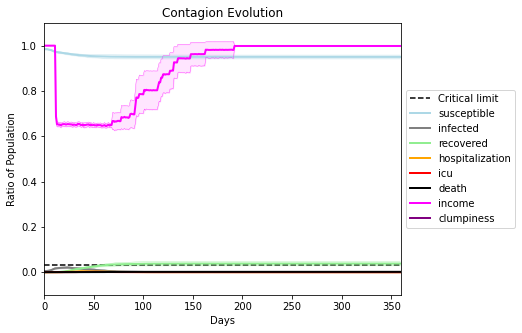

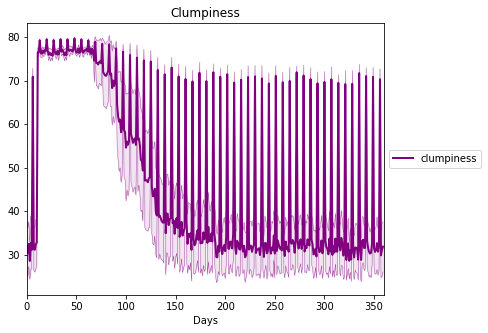

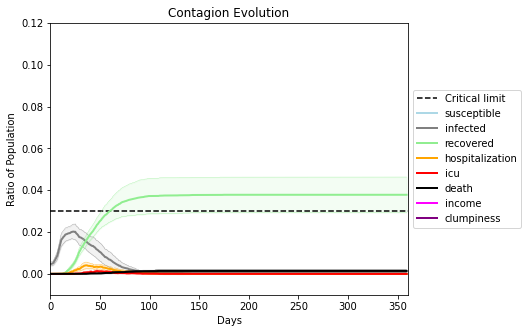

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.998", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[9020, 3014, 6939, 998, 8281, 452, 4295, 2212, 7774, 2705, 9960, 1535, 7122, 9063, 1539, 9924, 1325, 3313, 6331, 2322]
Average similarity between family members is 0.991088418992545 at temperature -0.9975
Average similarity between family and home is 0.9999004844888729 at temperature -1
Average similarity between students and their classroom is 0.7880730705877362 at temperature -0.9975
Average classroom occupancy is 12.458333333333334 and number classrooms is 24
Average similarity between workers is 0.9951763388864447 at temperature -0.9975
Average office occupancy is 9.954545454545455 and number offices is 66
Average friend similarity for adults: 0.9984614057458294 for kids: 0.8414983907729197
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.7559701740810961
disconnects
0.44
clumpiness 43.11
avg restaurant similarity 0.501325667015881
disconnects
0.15
clumpiness 25.44
avg restaurant similarity 0.49316369226094064
disconnects
0.27
clumpiness 32.61
avg restaurant similarity 0.5966685456162814
disconnects
0.17
clumpiness 25.94
avg restaurant similarity 0.6240739721265763
disconnects
0.06
clumpiness 19.47
avg restaurant similarity 0.7067919975226341
disconnects
0.18
clumpiness 26.69
avg restaurant similarity 0.6190985867718746
disconnects
0.78
clumpiness 65.6
avg restaurant similarity 0.5580651251767188
disconnects
0.2
clumpiness 29.02
avg restaurant similarity 0.549237687709634
disconnects
0.23
clumpiness 30.17
avg restaurant similarity 0.4941171812101083
disconnects
0.2
clumpiness 27.96
avg restaurant similarity 0.5051894078599355
disconnects
0.18
clumpiness 27.02
avg restaurant similarity 0.604627472618855
disconnects
0.93
clumpiness 74.89
avg restaurant similarity 0.5775639982816244
disconnects


disconnects
0.58
clumpiness 54.22
avg restaurant similarity 0.5317478914266172
disconnects
0.22
clumpiness 29.5
avg restaurant similarity 0.5920549074180822
disconnects
0.22
clumpiness 28.85
avg restaurant similarity 0.6126786900898751
disconnects
0.16
clumpiness 26.42
avg restaurant similarity 0.751857283955721
disconnects
0.18
clumpiness 28.09
avg restaurant similarity 0.5790741912668912
disconnects
0.15
clumpiness 23.02
avg restaurant similarity 0.5076097614344691
disconnects
0.15
clumpiness 25.16
avg restaurant similarity 0.5797710108636324
disconnects
0.64
clumpiness 56.75
avg restaurant similarity 0.7041314242728015
disconnects
0.18
clumpiness 27.09
avg restaurant similarity 0.622754596452123
disconnects
0.12
clumpiness 24.47
avg restaurant similarity 0.5120828750913475
disconnects
0.46
clumpiness 43.62
avg restaurant similarity 0.6575196944270033
disconnects
0.17
clumpiness 26.89
avg restaurant similarity 0.6123620379305617
disconnects
0.15
clumpiness 25.29
avg restaurant simila

avg restaurant similarity 0.6794869627755648
disconnects
0.79
clumpiness 66.21
avg restaurant similarity 0.5590822737075575
disconnects
0.18
clumpiness 27.21
avg restaurant similarity 0.7058060968073561
disconnects
0.18
clumpiness 27.17
avg restaurant similarity 0.4818800534769535
disconnects
0.37
clumpiness 39.59
avg restaurant similarity 0.5799254507790635
disconnects
0.19
clumpiness 28.43
avg restaurant similarity 0.5699705895803479
disconnects
0.25
clumpiness 32.2
avg restaurant similarity 0.5800234134404406
disconnects
0.18
clumpiness 28.53
avg restaurant similarity 0.6086396953855218
disconnects
0.72
clumpiness 60.87
avg restaurant similarity 0.5835774346795441
disconnects
0.14
clumpiness 23.25
avg restaurant similarity 0.6252888514917098
disconnects
0.13
clumpiness 23.55
avg restaurant similarity 0.5908600891332031
disconnects
0.11
clumpiness 24.26
avg restaurant similarity 0.6160518482288286
disconnects
0.16
clumpiness 26.69
avg restaurant similarity 0.47144954025858404
disconn

disconnects
0.11
clumpiness 22.99
avg restaurant similarity 0.6470020232075151
disconnects
0.74
clumpiness 63.09
avg restaurant similarity 0.5950379461590708
disconnects
0.21
clumpiness 28.43
avg restaurant similarity 0.5749491428795176
disconnects
0.15
clumpiness 25.21
avg restaurant similarity 0.7016652549885052
disconnects
0.23
clumpiness 29.67
avg restaurant similarity 0.6256945480752489
disconnects
0.14
clumpiness 23.08
avg restaurant similarity 0.7108308866592273
disconnects
0.2
clumpiness 28.35
avg restaurant similarity 0.5802384354802789
disconnects
0.16
clumpiness 23.9
avg restaurant similarity 0.5777802464909768
disconnects
0.66
clumpiness 59.14
avg restaurant similarity 0.5218610632308474
disconnects
0.44
clumpiness 42.95
avg restaurant similarity 0.6921979164733867
disconnects
0.21
clumpiness 28.3
avg restaurant similarity 0.6662401283319485
disconnects
0.2
clumpiness 29.47
avg restaurant similarity 0.489664575021535
disconnects
0.35
clumpiness 36.77
avg restaurant similari

avg restaurant similarity 0.5707378309649089
disconnects
0.01
clumpiness 14.29
avg restaurant similarity 0.5961355705846196
disconnects
0.0
clumpiness 13.39
avg restaurant similarity 0.6356455737628279
disconnects
0.0
clumpiness 13.13
avg restaurant similarity 0.5327395396789579
disconnects
0.01
clumpiness 15.05
avg restaurant similarity 0.48402513818864024
disconnects
0.01
clumpiness 15.1
avg restaurant similarity 0.5455555982010031
disconnects
0.01
clumpiness 14.53
avg restaurant similarity 0.5558173890797371
disconnects
0.54
clumpiness 52.48
avg restaurant similarity 0.47417580165139106
disconnects
0.02
clumpiness 16.24
avg restaurant similarity 0.4649320543180608
disconnects
0.03
clumpiness 15.54
avg restaurant similarity 0.6653980284127677
disconnects
0.03
clumpiness 15.47
avg restaurant similarity 0.6195837862189316
disconnects
0.01
clumpiness 13.98
avg restaurant similarity 0.6187362637089827
disconnects
0.82
clumpiness 67.85
avg restaurant similarity 0.6520759170190054
disconne

disconnects
0.54
clumpiness 51.89
avg restaurant similarity 0.5915218088188391
disconnects
0.0
clumpiness 14.31
avg restaurant similarity 0.49603803320896034
disconnects
0.0
clumpiness 14.25
avg restaurant similarity 0.7407119605078418
disconnects
0.01
clumpiness 16.73
avg restaurant similarity 0.73615776985495
disconnects
0.01
clumpiness 15.51
avg restaurant similarity 0.5549987464742135
disconnects
0.01
clumpiness 15.5
avg restaurant similarity 0.6178854636094275
disconnects
0.01
clumpiness 15.28
avg restaurant similarity 0.7266454654961435
disconnects
0.84
clumpiness 68.94
avg restaurant similarity 0.6729769854862928
disconnects
0.0
clumpiness 15.38
avg restaurant similarity 0.5199681458650979
disconnects
0.0
clumpiness 14.18
avg restaurant similarity 0.734147800433526
disconnects
0.03
clumpiness 16.25
avg restaurant similarity 0.5874391602306606
disconnects
0.0
clumpiness 14.63
avg restaurant similarity 0.5340115996501893
disconnects
0.01
clumpiness 15.98
avg restaurant similarity 

avg restaurant similarity 0.570212126963811
disconnects
0.6
clumpiness 54.41
avg restaurant similarity 0.6592716802312887
disconnects
0.01
clumpiness 14.91
avg restaurant similarity 0.6645648448847314
disconnects
0.01
clumpiness 16.02
avg restaurant similarity 0.7186765886121507
disconnects
0.02
clumpiness 15.13
avg restaurant similarity 0.6489673228850781
disconnects
0.03
clumpiness 16.25
avg restaurant similarity 0.6933091067630391
disconnects
0.01
clumpiness 14.63
avg restaurant similarity 0.652948129848235
disconnects
0.02
clumpiness 13.98
avg restaurant similarity 0.6613863814499621
disconnects
0.48
clumpiness 49.63
avg restaurant similarity 0.5582640888318124
disconnects
0.01
clumpiness 15.14
avg restaurant similarity 0.5195515132433328
disconnects
0.0
clumpiness 13.83
avg restaurant similarity 0.597080117321135
disconnects
0.02
clumpiness 16.08
avg restaurant similarity 0.5678205442651467
disconnects
0.02
clumpiness 14.19
avg restaurant similarity 0.5561575057248702
disconnects


disconnects
0.03
clumpiness 16.26
avg restaurant similarity 0.6770202802849014
disconnects
0.64
clumpiness 57.75
avg restaurant similarity 0.5297708319386422
disconnects
0.03
clumpiness 16.34
avg restaurant similarity 0.5967001296412446
disconnects
0.0
clumpiness 14.42
avg restaurant similarity 0.5571732063912259
disconnects
0.01
clumpiness 14.97
avg restaurant similarity 0.6438774223543886
disconnects
0.0
clumpiness 13.45
avg restaurant similarity 0.655095134246616
disconnects
0.02
clumpiness 16.72
avg restaurant similarity 0.5758934112672077
disconnects
0.02
clumpiness 16.71
avg restaurant similarity 0.6456471501093466
disconnects
0.36
clumpiness 42.54
avg restaurant similarity 0.5500026903443944
disconnects
0.01
clumpiness 13.65
avg restaurant similarity 0.7083824120181074
disconnects
0.0
clumpiness 16.28
avg restaurant similarity 0.6499387502093219
disconnects
0.02
clumpiness 15.91
avg restaurant similarity 0.5814409616942963
disconnects
0.03
clumpiness 15.76
avg restaurant similar

avg restaurant similarity 0.5837872165323172
disconnects
0.02
clumpiness 16.96
avg restaurant similarity 0.6807674137028011
disconnects
0.0
clumpiness 15.19
avg restaurant similarity 0.5889085756772036
disconnects
0.0
clumpiness 14.67
avg restaurant similarity 0.6252603765537738
disconnects
0.0
clumpiness 13.13
avg restaurant similarity 0.6908656888369007
disconnects
0.0
clumpiness 14.11
avg restaurant similarity 0.6751450830278863
disconnects
0.02
clumpiness 15.62
avg restaurant similarity 0.6449291070149392
disconnects
0.87
clumpiness 71.33
avg restaurant similarity 0.5455451535191462
disconnects
0.0
clumpiness 14.59
avg restaurant similarity 0.6020200104034862
disconnects
0.0
clumpiness 15.4
avg restaurant similarity 0.7718580603207187
disconnects
0.01
clumpiness 15.17
avg restaurant similarity 0.6639031100615203
disconnects
0.02
clumpiness 16.68
avg restaurant similarity 0.48824126705586074
disconnects
0.87
clumpiness 71.58
avg restaurant similarity 0.5829621747926659
disconnects
0

avg restaurant similarity 0.6880543879577287
disconnects
0.94
clumpiness 75.85
avg restaurant similarity 0.5665577927672392
disconnects
0.94
clumpiness 75.84
avg restaurant similarity 0.6519523520398453
disconnects
0.89
clumpiness 72.43
avg restaurant similarity 0.5992380312578717
disconnects
0.81
clumpiness 66.32
avg restaurant similarity 0.5957522378107766
disconnects
0.84
clumpiness 69.71
avg restaurant similarity 0.6156115243866297
disconnects
0.93
clumpiness 75.35
avg restaurant similarity 0.5942917250832417
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5922652202404513
disconnects
0.99
clumpiness 79.34
avg restaurant similarity 0.6823077861817701
disconnects
0.81
clumpiness 67.79
avg restaurant similarity 0.6186692012534815
disconnects
0.91
clumpiness 73.66
avg restaurant similarity 0.5781867557975285
disconnects
0.93
clumpiness 75.21
avg restaurant similarity 0.6923798648462253
disconnects
0.87
clumpiness 71.26
avg restaurant similarity 0.7305531692876978
disconnec

disconnects
0.54
clumpiness 51.29
avg restaurant similarity 0.5867523424981987
disconnects
0.0
clumpiness 14.78
avg restaurant similarity 0.6578124957175014
disconnects
0.01
clumpiness 16.2
avg restaurant similarity 0.5907848709529142
disconnects
0.01
clumpiness 14.98
avg restaurant similarity 0.5855470978821119
disconnects
0.0
clumpiness 14.81
avg restaurant similarity 0.7067298949719202
disconnects
0.03
clumpiness 17.96
avg restaurant similarity 0.611936939267797
disconnects
0.0
clumpiness 16.63
avg restaurant similarity 0.6466164211213529
disconnects
0.82
clumpiness 67.9
avg restaurant similarity 0.5922079765051385
disconnects
0.01
clumpiness 17.01
avg restaurant similarity 0.6718609064995936
disconnects
0.0
clumpiness 14.1
avg restaurant similarity 0.6042745407862985
disconnects
0.0
clumpiness 15.76
avg restaurant similarity 0.5858492891709605
disconnects
0.02
clumpiness 15.33
avg restaurant similarity 0.6732811348792734
disconnects
0.02
clumpiness 16.67
avg restaurant similarity 0

avg restaurant similarity 0.6163072935529835
disconnects
0.73
clumpiness 63.12
avg restaurant similarity 0.6158669480848579
disconnects
0.0
clumpiness 13.64
avg restaurant similarity 0.7181272470070514
disconnects
0.01
clumpiness 14.5
avg restaurant similarity 0.6544451246704758
disconnects
0.0
clumpiness 16.44
avg restaurant similarity 0.560797277854852
disconnects
0.0
clumpiness 15.28
avg restaurant similarity 0.6315465097494115
disconnects
0.03
clumpiness 16.11
avg restaurant similarity 0.6150248205226653
disconnects
0.03
clumpiness 15.35
avg restaurant similarity 0.5777910513520086
disconnects
0.58
clumpiness 52.87
avg restaurant similarity 0.6632117004714306
disconnects
0.03
clumpiness 17.78
avg restaurant similarity 0.7592213371519791
disconnects
0.0
clumpiness 14.85
avg restaurant similarity 0.6586626161272018
disconnects
0.05
clumpiness 17.59
avg restaurant similarity 0.706913236445124
disconnects
0.01
clumpiness 14.62
avg restaurant similarity 0.6796444629277405
disconnects
0.

avg restaurant similarity 0.6119399879927764
disconnects
0.05
clumpiness 20.11
avg restaurant similarity 0.6679540277493551
disconnects
0.14
clumpiness 25.34
avg restaurant similarity 0.7277959841176794
disconnects
0.3
clumpiness 35.37
avg restaurant similarity 0.7206388237008597
disconnects
0.22
clumpiness 29.3
avg restaurant similarity 0.617611707969935
disconnects
0.11
clumpiness 23.83
avg restaurant similarity 0.6810967484439543
disconnects
0.2
clumpiness 28.24
avg restaurant similarity 0.6417972453382266
disconnects
0.91
clumpiness 73.94
avg restaurant similarity 0.7738708606020307
disconnects
0.21
clumpiness 29.46
avg restaurant similarity 0.6864510449406743
disconnects
0.28
clumpiness 32.9
avg restaurant similarity 0.6002465174035431
disconnects
0.29
clumpiness 34.99
avg restaurant similarity 0.5314041752497906
disconnects
0.22
clumpiness 31.47
avg restaurant similarity 0.6571000595534106
disconnects
0.94
clumpiness 75.7
avg restaurant similarity 0.7102098987952291
disconnects
0

avg restaurant similarity 0.7240771777260856
disconnects
0.16
clumpiness 26.48
avg restaurant similarity 0.7155900226246309
disconnects
0.17
clumpiness 26.76
avg restaurant similarity 0.547174355658007
disconnects
0.18
clumpiness 27.75
avg restaurant similarity 0.5441538701040278
disconnects
0.19
clumpiness 28.51
avg restaurant similarity 0.6761419172237668
disconnects
0.26
clumpiness 32.44
avg restaurant similarity 0.6081158581132036
disconnects
0.08
clumpiness 20.64
avg restaurant similarity 0.5669414819236985
disconnects
0.82
clumpiness 68.35
avg restaurant similarity 0.7414354228189824
disconnects
0.31
clumpiness 35.97
avg restaurant similarity 0.5449749300727507
disconnects
0.1
clumpiness 22.5
avg restaurant similarity 0.7294548311528866
disconnects
0.41
clumpiness 41.96
avg restaurant similarity 0.6661469622112889
disconnects
0.31
clumpiness 35.17
avg restaurant similarity 0.6692730825734946
disconnects
0.25
clumpiness 32.88
avg restaurant similarity 0.5171753911851174
disconnect

avg restaurant similarity 0.700270640164188
disconnects
0.11
clumpiness 22.46
avg restaurant similarity 0.5822339986486071
disconnects
0.25
clumpiness 32.73
avg restaurant similarity 0.6594590910739638
disconnects
0.14
clumpiness 24.4
avg restaurant similarity 0.6039526751174429
disconnects
0.2
clumpiness 29.31
avg restaurant similarity 0.667184818840429
disconnects
0.08
clumpiness 22.95
avg restaurant similarity 0.6021076610038127
disconnects
0.21
clumpiness 29.75
avg restaurant similarity 0.48332740428761267
disconnects
0.84
clumpiness 69.64
avg restaurant similarity 0.5989535402627076
disconnects
0.21
clumpiness 29.28
avg restaurant similarity 0.4961692156872061
disconnects
0.12
clumpiness 23.31
avg restaurant similarity 0.5980660426421041
disconnects
0.19
clumpiness 28.67
avg restaurant similarity 0.6161984292927923
disconnects
0.23
clumpiness 30.69
avg restaurant similarity 0.7167556183919392
disconnects
0.3
clumpiness 35.31
avg restaurant similarity 0.3987124022810494
disconnects

avg restaurant similarity 0.5359296066972656
disconnects
0.22
clumpiness 30.3
avg restaurant similarity 0.723476121545
disconnects
0.27
clumpiness 33.69
avg restaurant similarity 0.5262386371381482
disconnects
0.15
clumpiness 24.86
avg restaurant similarity 0.5189961608994831
disconnects
0.28
clumpiness 33.62
avg restaurant similarity 0.5968449423281155
disconnects
0.2
clumpiness 29.67
avg restaurant similarity 0.4738543438336513
disconnects
0.32
clumpiness 37.5
avg restaurant similarity 0.4624707909133642
disconnects
0.91
clumpiness 74.01
avg restaurant similarity 0.5955695842410572
disconnects
0.29
clumpiness 34.28
avg restaurant similarity 0.766805416977829
disconnects
0.2
clumpiness 29.19
avg restaurant similarity 0.5622317376932874
disconnects
0.11
clumpiness 23.24
avg restaurant similarity 0.5842481710453353
disconnects
0.23
clumpiness 30.42
avg restaurant similarity 0.4801655347268136
disconnects
0.25
clumpiness 31.63
avg restaurant similarity 0.5172661187108397
disconnects
0.25

avg restaurant similarity 0.43931162021660397
disconnects
0.0
clumpiness 18.38
avg restaurant similarity 0.44915131674801556
disconnects
0.0
clumpiness 16.27
avg restaurant similarity 0.4016393758193108
disconnects
0.0
clumpiness 17.29
avg restaurant similarity 0.3498521392805126
disconnects
0.0
clumpiness 16.46
avg restaurant similarity 0.5054402155578354
disconnects
0.01
clumpiness 16.03
avg restaurant similarity 0.46786713196629376
disconnects
0.01
clumpiness 16.88
avg restaurant similarity 0.6534634098816201
disconnects
0.92
clumpiness 74.79
avg restaurant similarity 0.43687587703257835
disconnects
0.0
clumpiness 15.78
avg restaurant similarity 0.41128110684080327
disconnects
0.0
clumpiness 17.51
avg restaurant similarity 0.3951844761269523
disconnects
0.0
clumpiness 17.13
avg restaurant similarity 0.3652752533713681
disconnects
0.03
clumpiness 18.51
avg restaurant similarity 0.5191706657539754
disconnects
0.93
clumpiness 74.95
avg restaurant similarity 0.3984007364452719
disconnec

avg restaurant similarity 0.4275512053493401
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.38475850972833486
disconnects
0.96
clumpiness 77.01
avg restaurant similarity 0.49395858762372563
disconnects
0.95
clumpiness 76.47
avg restaurant similarity 0.5693539967925807
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.33510672028779676
disconnects
0.97
clumpiness 77.8
avg restaurant similarity 0.5328030011414269
disconnects
0.93
clumpiness 74.96
avg restaurant similarity 0.5079983312055152
disconnects
0.99
clumpiness 79.31
avg restaurant similarity 0.4528079881885363
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.6182596900662307
disconnects
0.92
clumpiness 74.46
avg restaurant similarity 0.3941334256248678
disconnects
0.95
clumpiness 76.31
avg restaurant similarity 0.6334281806114063
disconnects
0.95
clumpiness 76.34
avg restaurant similarity 0.7784732506689326
disconnects
0.97
clumpiness 77.75
avg restaurant similarity 0.46415874297682086
disc

avg restaurant similarity 0.33519308528825176
disconnects
0.0
clumpiness 17.32
avg restaurant similarity 0.40733326593264707
disconnects
0.87
clumpiness 70.72
avg restaurant similarity 0.5342450836704246
disconnects
0.0
clumpiness 17.31
avg restaurant similarity 0.6450548435134106
disconnects
0.0
clumpiness 16.62
avg restaurant similarity 0.6189118740727073
disconnects
0.0
clumpiness 17.09
avg restaurant similarity 0.5494301550499346
disconnects
0.01
clumpiness 16.86
avg restaurant similarity 0.43740508931572814
disconnects
0.01
clumpiness 18.86
avg restaurant similarity 0.3122241063984779
disconnects
0.0
clumpiness 16.69
avg restaurant similarity 0.4072922589135994
disconnects
0.89
clumpiness 72.21
avg restaurant similarity 0.4859725457178868
disconnects
0.0
clumpiness 16.39
avg restaurant similarity 0.501451082461287
disconnects
0.0
clumpiness 16.59
avg restaurant similarity 0.5212903781978114
disconnects
0.0
clumpiness 16.92
avg restaurant similarity 0.41144284194725217
disconnects


disconnects
0.02
clumpiness 19.08
avg restaurant similarity 0.24426266679603525
disconnects
0.0
clumpiness 18.55
avg restaurant similarity 0.6309195838365597
disconnects
0.88
clumpiness 71.59
avg restaurant similarity 0.5620300146228618
disconnects
0.01
clumpiness 17.51
avg restaurant similarity 0.3828946937423111
disconnects
0.0
clumpiness 15.94
avg restaurant similarity 0.4046474539233315
disconnects
0.0
clumpiness 18.36
avg restaurant similarity 0.45123612538399155
disconnects
0.0
clumpiness 17.47
avg restaurant similarity 0.4567623292347832
disconnects
0.0
clumpiness 16.2
avg restaurant similarity 0.4147432088840939
disconnects
0.0
clumpiness 15.7
avg restaurant similarity 0.5179592679516637
disconnects
0.89
clumpiness 72.3
avg restaurant similarity 0.4693330708913127
disconnects
0.02
clumpiness 18.34
avg restaurant similarity 0.44011126991725597
disconnects
0.0
clumpiness 16.62
avg restaurant similarity 0.3288058804682117
disconnects
0.0
clumpiness 18.6
avg restaurant similarity 0

avg restaurant similarity 0.5473728042911383
disconnects
0.08
clumpiness 25.34
avg restaurant similarity 0.6406403643291725
disconnects
0.09
clumpiness 24.55
avg restaurant similarity 0.7467464777730785
disconnects
0.12
clumpiness 26.72
avg restaurant similarity 0.5273463254592676
disconnects
0.11
clumpiness 24.77
avg restaurant similarity 0.6827956704890238
disconnects
0.09
clumpiness 25.3
avg restaurant similarity 0.6075985121836875
disconnects
0.06
clumpiness 21.94
avg restaurant similarity 0.6519203824433331
disconnects
0.9
clumpiness 73.28
avg restaurant similarity 0.7037444553543901
disconnects
0.08
clumpiness 22.27
avg restaurant similarity 0.6793153490616651
disconnects
0.11
clumpiness 24.94
avg restaurant similarity 0.6800875270343556
disconnects
0.08
clumpiness 22.09
avg restaurant similarity 0.6183137645930764
disconnects
0.11
clumpiness 26.07
avg restaurant similarity 0.5431480917255427
disconnects
0.97
clumpiness 77.77
avg restaurant similarity 0.5977283743860645
disconnec

avg restaurant similarity 0.532839108246821
disconnects
0.13
clumpiness 25.33
avg restaurant similarity 0.44518517355646503
disconnects
0.12
clumpiness 25.09
avg restaurant similarity 0.6063907165081253
disconnects
0.06
clumpiness 23.28
avg restaurant similarity 0.7532142433568239
disconnects
0.12
clumpiness 27.15
avg restaurant similarity 0.5981553732282042
disconnects
0.12
clumpiness 25.75
avg restaurant similarity 0.667278174177504
disconnects
0.11
clumpiness 25.37
avg restaurant similarity 0.6784531037347015
disconnects
0.91
clumpiness 73.65
avg restaurant similarity 0.6883893487529538
disconnects
0.1
clumpiness 23.75
avg restaurant similarity 0.6237141041008604
disconnects
0.07
clumpiness 23.18
avg restaurant similarity 0.60602613387977
disconnects
0.11
clumpiness 23.56
avg restaurant similarity 0.6182494453059398
disconnects
0.07
clumpiness 20.81
avg restaurant similarity 0.5962421061772627
disconnects
0.17
clumpiness 28.44
avg restaurant similarity 0.7044184708708734
disconnects

avg restaurant similarity 0.6044898665518283
disconnects
0.12
clumpiness 25.36
avg restaurant similarity 0.7240368217864245
disconnects
0.07
clumpiness 25.08
avg restaurant similarity 0.6408985500844594
disconnects
0.14
clumpiness 26.54
avg restaurant similarity 0.6837208488247608
disconnects
0.12
clumpiness 28.18
avg restaurant similarity 0.7336374686495752
disconnects
0.09
clumpiness 24.27
avg restaurant similarity 0.6202581346726899
disconnects
0.13
clumpiness 26.51
avg restaurant similarity 0.5370352356526471
disconnects
0.91
clumpiness 74.07
avg restaurant similarity 0.4629201386095382
disconnects
0.1
clumpiness 25.85
avg restaurant similarity 0.70165590996006
disconnects
0.11
clumpiness 23.88
avg restaurant similarity 0.7292972403039875
disconnects
0.11
clumpiness 24.9
avg restaurant similarity 0.6463613776328261
disconnects
0.09
clumpiness 25.76
avg restaurant similarity 0.6792718540585151
disconnects
0.13
clumpiness 27.57
avg restaurant similarity 0.4816910419021008
disconnects

avg restaurant similarity 0.7197582304568123
disconnects
0.08
clumpiness 23.29
avg restaurant similarity 0.7771128300627593
disconnects
0.14
clumpiness 24.35
avg restaurant similarity 0.6383212789063355
disconnects
0.08
clumpiness 23.81
avg restaurant similarity 0.7146191860005041
disconnects
0.12
clumpiness 26.21
avg restaurant similarity 0.673016011768885
disconnects
0.11
clumpiness 27.49
avg restaurant similarity 0.5628251573058236
disconnects
0.1
clumpiness 26.18
avg restaurant similarity 0.6286778396354658
disconnects
0.96
clumpiness 77.09
avg restaurant similarity 0.5629028358373771
disconnects
0.11
clumpiness 22.99
avg restaurant similarity 0.5839729743051643
disconnects
0.11
clumpiness 27.93
avg restaurant similarity 0.6724666110476897
disconnects
0.08
clumpiness 22.58
avg restaurant similarity 0.6768078179681339
disconnects
0.07
clumpiness 21.65
avg restaurant similarity 0.7374510587215507
disconnects
0.05
clumpiness 19.79
avg restaurant similarity 0.6471702487654322
disconnec

avg restaurant similarity 0.49215819358653434
disconnects
0.0
clumpiness 13.18
avg restaurant similarity 0.4716426874138735
disconnects
0.0
clumpiness 13.75
avg restaurant similarity 0.4559863628289263
disconnects
0.01
clumpiness 14.73
avg restaurant similarity 0.5451318378887989
disconnects
0.01
clumpiness 14.18
avg restaurant similarity 0.5410085960274047
disconnects
0.0
clumpiness 14.18
avg restaurant similarity 0.6133214705325791
disconnects
0.0
clumpiness 13.97
avg restaurant similarity 0.5472349353643395
disconnects
0.5
clumpiness 48.65
avg restaurant similarity 0.5366415323962085
disconnects
0.0
clumpiness 14.57
avg restaurant similarity 0.4224584797813147
disconnects
0.0
clumpiness 13.07
avg restaurant similarity 0.5738137789767239
disconnects
0.01
clumpiness 16.4
avg restaurant similarity 0.46471600383073264
disconnects
0.0
clumpiness 15.21
avg restaurant similarity 0.5117836474058426
disconnects
0.84
clumpiness 70.83
avg restaurant similarity 0.4477222722335856
disconnects
0.

avg restaurant similarity 0.5905481122299936
disconnects
0.91
clumpiness 73.87
avg restaurant similarity 0.6190013872237836
disconnects
0.84
clumpiness 69.35
avg restaurant similarity 0.5410595017481227
disconnects
0.93
clumpiness 75.25
avg restaurant similarity 0.5902018136672639
disconnects
0.96
clumpiness 77.23
avg restaurant similarity 0.5199243732491794
disconnects
0.89
clumpiness 72.29
avg restaurant similarity 0.5511859454843204
disconnects
0.94
clumpiness 75.86
avg restaurant similarity 0.5768318082107795
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6642360829460044
disconnects
0.91
clumpiness 73.64
avg restaurant similarity 0.47590300524638235
disconnects
0.96
clumpiness 77.09
avg restaurant similarity 0.5869498807356821
disconnects
0.95
clumpiness 76.35
avg restaurant similarity 0.48749567614680556
disconnects
0.87
clumpiness 70.79
avg restaurant similarity 0.585352228368452
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.5208038795902684
disconnec

disconnects
0.41
clumpiness 41.68
avg restaurant similarity 0.5140031910900406
disconnects
0.0
clumpiness 13.89
avg restaurant similarity 0.5258627237674003
disconnects
0.0
clumpiness 14.86
avg restaurant similarity 0.5859874593356575
disconnects
0.02
clumpiness 15.7
avg restaurant similarity 0.45939883817724425
disconnects
0.0
clumpiness 13.72
avg restaurant similarity 0.613300349940644
disconnects
0.0
clumpiness 13.97
avg restaurant similarity 0.516374413427691
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.6016508469367509
disconnects
0.5
clumpiness 48.69
avg restaurant similarity 0.7000515069020613
disconnects
0.0
clumpiness 16.58
avg restaurant similarity 0.5345505257995086
disconnects
0.02
clumpiness 14.73
avg restaurant similarity 0.5226466313148577
disconnects
0.0
clumpiness 14.18
avg restaurant similarity 0.5304275635077348
disconnects
0.0
clumpiness 14.08
avg restaurant similarity 0.5351250227308799
disconnects
0.0
clumpiness 15.73
avg restaurant similarity 0.63

avg restaurant similarity 0.6117953974755457
disconnects
0.5
clumpiness 50.97
avg restaurant similarity 0.6421355456626251
disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.5925388764480295
disconnects
0.0
clumpiness 13.02
avg restaurant similarity 0.512224900404322
disconnects
0.01
clumpiness 14.88
avg restaurant similarity 0.5567540092061044
disconnects
0.0
clumpiness 13.75
avg restaurant similarity 0.6109678054179672
disconnects
0.0
clumpiness 15.75
avg restaurant similarity 0.6174626451478751
disconnects
0.01
clumpiness 15.95
avg restaurant similarity 0.49879165368991407
disconnects
0.56
clumpiness 51.57
avg restaurant similarity 0.49213699446863024
disconnects
0.01
clumpiness 14.91
avg restaurant similarity 0.570655053565021
disconnects
0.01
clumpiness 13.86
avg restaurant similarity 0.5144755348429766
disconnects
0.0
clumpiness 13.34
avg restaurant similarity 0.4928897652932217
disconnects
0.0
clumpiness 14.85
avg restaurant similarity 0.44330286094888594
disconnects
0

avg restaurant similarity 0.4752998389106053
disconnects
0.0
clumpiness 17.47
avg restaurant similarity 0.671051739515662
disconnects
0.23
clumpiness 30.77
avg restaurant similarity 0.5177235473606799
disconnects
0.0
clumpiness 16.63
avg restaurant similarity 0.5911690496626636
disconnects
0.0
clumpiness 16.36
avg restaurant similarity 0.38290778127028074
disconnects
0.0
clumpiness 15.02
avg restaurant similarity 0.6609311257818257
disconnects
0.0
clumpiness 16.18
avg restaurant similarity 0.6699964275216949
disconnects
0.73
clumpiness 63.06
avg restaurant similarity 0.7022220969215428
disconnects
0.23
clumpiness 30.84
avg restaurant similarity 0.5819573932712517
disconnects
0.0
clumpiness 18.41
avg restaurant similarity 0.6526012905788535
disconnects
0.0
clumpiness 18.78
avg restaurant similarity 0.6909966473053245
disconnects
0.0
clumpiness 16.97
avg restaurant similarity 0.57429342429481
disconnects
0.95
clumpiness 76.29
avg restaurant similarity 0.5579554361545225
disconnects
0.99


avg restaurant similarity 0.46235487199218894
disconnects
0.96
clumpiness 77.35
avg restaurant similarity 0.4757873062552756
disconnects
0.9
clumpiness 73.21
avg restaurant similarity 0.5979112976975218
disconnects
0.92
clumpiness 74.28
avg restaurant similarity 0.5438643322349618
disconnects
0.95
clumpiness 76.32
avg restaurant similarity 0.5065058572043833
disconnects
0.95
clumpiness 76.3
avg restaurant similarity 0.5967373751834223
disconnects
0.92
clumpiness 74.31
avg restaurant similarity 0.5622991086155362
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.515408133260705
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.42226802924002244
disconnects
0.89
clumpiness 72.26
avg restaurant similarity 0.605152122046772
disconnects
0.95
clumpiness 76.52
avg restaurant similarity 0.4918713613204452
disconnects
0.91
clumpiness 73.69
avg restaurant similarity 0.5852049608021819
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.5321488977569112
disconnects

avg restaurant similarity 0.517494173394664
disconnects
0.0
clumpiness 18.51
avg restaurant similarity 0.5219861083207759
disconnects
0.0
clumpiness 16.68
avg restaurant similarity 0.6392771651685416
disconnects
0.0
clumpiness 16.67
avg restaurant similarity 0.5267796915589663
disconnects
0.0
clumpiness 16.53
avg restaurant similarity 0.607547078567914
disconnects
0.0
clumpiness 15.96
avg restaurant similarity 0.549911274773024
disconnects
0.15
clumpiness 24.84
avg restaurant similarity 0.5018143754767456
disconnects
0.84
clumpiness 69.0
avg restaurant similarity 0.5389108142369752
disconnects
0.2
clumpiness 29.39
avg restaurant similarity 0.3788809468213399
disconnects
0.19
clumpiness 26.32
avg restaurant similarity 0.3958507111193793
disconnects
0.0
clumpiness 15.07
avg restaurant similarity 0.5510272945641763
disconnects
0.0
clumpiness 18.44
avg restaurant similarity 0.6030674136332248
disconnects
0.0
clumpiness 17.05
avg restaurant similarity 0.5835369138671501
disconnects
0.0
clum

avg restaurant similarity 0.721588408268848
disconnects
0.0
clumpiness 21.26
avg restaurant similarity 0.52797870337216
disconnects
0.0
clumpiness 17.44
avg restaurant similarity 0.47084948503824486
disconnects
0.0
clumpiness 18.91
avg restaurant similarity 0.5988039270848696
disconnects
0.16
clumpiness 26.99
avg restaurant similarity 0.4638198950681073
disconnects
0.13
clumpiness 25.67
avg restaurant similarity 0.4274127423073226
disconnects
0.15
clumpiness 25.77
avg restaurant similarity 0.5518694984612581
disconnects
0.79
clumpiness 66.65
avg restaurant similarity 0.4602230801334031
disconnects
0.24
clumpiness 30.19
avg restaurant similarity 0.6354213747717564
disconnects
0.0
clumpiness 17.4
avg restaurant similarity 0.5265653893444048
disconnects
0.19
clumpiness 27.67
avg restaurant similarity 0.5103178747102642
disconnects
0.0
clumpiness 14.48
avg restaurant similarity 0.5922493594552993
disconnects
0.0
clumpiness 18.59
avg restaurant similarity 0.4882995064334209
disconnects
0.17

avg restaurant similarity 0.5741738063760737
disconnects
0.0
clumpiness 15.73
avg restaurant similarity 0.5312573546827611
disconnects
0.0
clumpiness 16.77
avg restaurant similarity 0.4804349195221983
disconnects
0.01
clumpiness 18.33
avg restaurant similarity 0.5605063169805113
disconnects
0.01
clumpiness 19.1
avg restaurant similarity 0.4677188441102392
disconnects
0.0
clumpiness 15.97
avg restaurant similarity 0.47925082601768443
disconnects
0.01
clumpiness 15.36
avg restaurant similarity 0.5892258147801652
disconnects
0.73
clumpiness 63.29
avg restaurant similarity 0.5875488451750299
disconnects
0.0
clumpiness 13.99
avg restaurant similarity 0.5159967314506464
disconnects
0.0
clumpiness 17.63
avg restaurant similarity 0.531189142515421
disconnects
0.01
clumpiness 14.78
avg restaurant similarity 0.5371187163230137
disconnects
0.01
clumpiness 18.41
avg restaurant similarity 0.659492545539199
disconnects
0.79
clumpiness 65.94
avg restaurant similarity 0.5960434517457888
disconnects
0.

avg restaurant similarity 0.5951031862528359
disconnects
0.0
clumpiness 19.31
avg restaurant similarity 0.5589858716221183
disconnects
0.0
clumpiness 17.15
avg restaurant similarity 0.5576608959474243
disconnects
0.02
clumpiness 19.23
avg restaurant similarity 0.598781312823801
disconnects
0.0
clumpiness 17.39
avg restaurant similarity 0.46488561947161616
disconnects
0.02
clumpiness 17.56
avg restaurant similarity 0.5485993130786244
disconnects
0.0
clumpiness 15.11
avg restaurant similarity 0.6159758927463682
disconnects
0.7
clumpiness 61.51
avg restaurant similarity 0.5964625293822805
disconnects
0.0
clumpiness 16.32
avg restaurant similarity 0.5341981384342136
disconnects
0.0
clumpiness 15.5
avg restaurant similarity 0.4919018402905578
disconnects
0.0
clumpiness 16.62
avg restaurant similarity 0.5068630565899344
disconnects
0.01
clumpiness 15.54
avg restaurant similarity 0.5461308478087898
disconnects
0.02
clumpiness 16.62
avg restaurant similarity 0.5089748060058118
disconnects
0.0


avg restaurant similarity 0.5435826029779426
disconnects
0.01
clumpiness 16.97
avg restaurant similarity 0.5010353877166956
disconnects
0.01
clumpiness 15.95
avg restaurant similarity 0.4952789552483307
disconnects
0.0
clumpiness 15.1
avg restaurant similarity 0.509488786269465
disconnects
0.0
clumpiness 16.93
avg restaurant similarity 0.49127740872039793
disconnects
0.0
clumpiness 15.45
avg restaurant similarity 0.486457527540508
disconnects
0.0
clumpiness 15.53
avg restaurant similarity 0.5861751565598096
disconnects
0.6
clumpiness 54.7
avg restaurant similarity 0.5208260804026508
disconnects
0.03
clumpiness 17.65
avg restaurant similarity 0.459541944894105
disconnects
0.02
clumpiness 19.68
avg restaurant similarity 0.4346458609638293
disconnects
0.0
clumpiness 16.66
avg restaurant similarity 0.6181805088909001
disconnects
0.0
clumpiness 18.01
avg restaurant similarity 0.5086762170138985
disconnects
0.0
clumpiness 16.08
avg restaurant similarity 0.47685177180256977
disconnects
0.01
c

avg restaurant similarity 0.59859993030195
disconnects
0.0
clumpiness 18.61
avg restaurant similarity 0.556843459518031
disconnects
0.0
clumpiness 17.22
avg restaurant similarity 0.57438962704391
disconnects
0.01
clumpiness 17.86
avg restaurant similarity 0.5336574932754404
disconnects
0.0
clumpiness 14.97
avg restaurant similarity 0.5954081963739368
disconnects
0.0
clumpiness 15.67
avg restaurant similarity 0.5261490436988038
disconnects
0.01
clumpiness 15.81
avg restaurant similarity 0.5536232864280662
disconnects
0.67
clumpiness 58.9
avg restaurant similarity 0.472101572082137
disconnects
0.02
clumpiness 16.06
avg restaurant similarity 0.5886034009796312
disconnects
0.01
clumpiness 17.53
avg restaurant similarity 0.6813751683766628
disconnects
0.02
clumpiness 17.72
avg restaurant similarity 0.5252172760860488
disconnects
0.01
clumpiness 17.96
avg restaurant similarity 0.5684681682684433
disconnects
0.0
clumpiness 17.01
avg restaurant similarity 0.5794478666111283
disconnects
0.0
clu

avg restaurant similarity 0.5424760199756608
disconnects
0.0
clumpiness 13.94
avg restaurant similarity 0.6663559856370813
disconnects
0.0
clumpiness 16.11
avg restaurant similarity 0.6306623172512764
disconnects
0.0
clumpiness 16.45
avg restaurant similarity 0.595929242497686
disconnects
0.0
clumpiness 15.1
avg restaurant similarity 0.5671341253263212
disconnects
0.0
clumpiness 17.49
avg restaurant similarity 0.6784817763368641
disconnects
0.0
clumpiness 18.31
avg restaurant similarity 0.6450974759969144
disconnects
0.82
clumpiness 67.96
avg restaurant similarity 0.5981150208808643
disconnects
0.0
clumpiness 14.79
avg restaurant similarity 0.6027685797752435
disconnects
0.0
clumpiness 20.26
avg restaurant similarity 0.5632941554026302
disconnects
0.0
clumpiness 16.01
avg restaurant similarity 0.572113090809599
disconnects
0.0
clumpiness 18.73
avg restaurant similarity 0.5280144525987508
disconnects
0.92
clumpiness 74.57
avg restaurant similarity 0.5353478506358414
disconnects
0.91
clu

avg restaurant similarity 0.5841082440756248
disconnects
0.96
clumpiness 77.11
avg restaurant similarity 0.5492725229433059
disconnects
0.97
clumpiness 77.86
avg restaurant similarity 0.471877968520388
disconnects
0.94
clumpiness 75.69
avg restaurant similarity 0.5379406865706114
disconnects
0.9
clumpiness 73.21
avg restaurant similarity 0.6331244387314463
disconnects
0.94
clumpiness 75.84
avg restaurant similarity 0.49957495178944655
disconnects
0.92
clumpiness 74.5
avg restaurant similarity 0.4972476103598845
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5424463524112328
disconnects
0.94
clumpiness 75.66
avg restaurant similarity 0.5213343003312904
disconnects
0.91
clumpiness 73.63
avg restaurant similarity 0.6036839977121464
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.5606285720415237
disconnects
0.91
clumpiness 73.95
avg restaurant similarity 0.7293834197112812
disconnects
0.94
clumpiness 75.78
avg restaurant similarity 0.6524712379656494
disconnects

avg restaurant similarity 0.49255912165970456
disconnects
0.01
clumpiness 17.78
avg restaurant similarity 0.44316831129846085
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.6232498868821534
disconnects
0.0
clumpiness 14.64
avg restaurant similarity 0.565467968063571
disconnects
0.0
clumpiness 14.32
avg restaurant similarity 0.6231102355211168
disconnects
0.0
clumpiness 16.69
avg restaurant similarity 0.5212936128834482
disconnects
0.0
clumpiness 15.58
avg restaurant similarity 0.5306311474629344
disconnects
0.66
clumpiness 57.27
avg restaurant similarity 0.5563721634115537
disconnects
0.0
clumpiness 14.67
avg restaurant similarity 0.5298545776613117
disconnects
0.0
clumpiness 14.33
avg restaurant similarity 0.5089473805925282
disconnects
0.0
clumpiness 15.36
avg restaurant similarity 0.6348537169587527
disconnects
0.0
clumpiness 15.64
avg restaurant similarity 0.5547367653056163
disconnects
0.0
clumpiness 15.93
avg restaurant similarity 0.5762800999754211
disconnects
0.01


avg restaurant similarity 0.5893488758750869
disconnects
0.0
clumpiness 14.82
avg restaurant similarity 0.6438248071376672
disconnects
0.02
clumpiness 16.34
avg restaurant similarity 0.4761471476796228
disconnects
0.0
clumpiness 15.21
avg restaurant similarity 0.550907901627953
disconnects
0.0
clumpiness 16.13
avg restaurant similarity 0.4171171389906601
disconnects
0.0
clumpiness 14.46
avg restaurant similarity 0.6891482221535499
disconnects
0.0
clumpiness 16.4
avg restaurant similarity 0.4417993630904148
disconnects
0.66
clumpiness 58.16
avg restaurant similarity 0.6169815218007476
disconnects
0.01
clumpiness 15.12
avg restaurant similarity 0.512657932115102
disconnects
0.0
clumpiness 14.65
avg restaurant similarity 0.5149347750175786
disconnects
0.0
clumpiness 16.01
avg restaurant similarity 0.5296845402762077
disconnects
0.0
clumpiness 17.47
avg restaurant similarity 0.5308634648857716
disconnects
0.0
clumpiness 14.62
avg restaurant similarity 0.553102238090694
disconnects
0.0
clum

avg restaurant similarity 0.5892455744270028
disconnects
0.01
clumpiness 16.9
avg restaurant similarity 0.6320086375948901
disconnects
0.01
clumpiness 22.57
avg restaurant similarity 0.6298880683254777
disconnects
0.08
clumpiness 21.24
avg restaurant similarity 0.7156185768620082
disconnects
0.1
clumpiness 24.15
avg restaurant similarity 0.5926915848470213
disconnects
0.17
clumpiness 26.11
avg restaurant similarity 0.7156169104015103
disconnects
0.01
clumpiness 15.64
avg restaurant similarity 0.7085031940928368
disconnects
0.6
clumpiness 55.59
avg restaurant similarity 0.5892323554594161
disconnects
0.14
clumpiness 24.84
avg restaurant similarity 0.6421218314647551
disconnects
0.01
clumpiness 16.15
avg restaurant similarity 0.6108765609061917
disconnects
0.32
clumpiness 36.87
avg restaurant similarity 0.6702973171582125
disconnects
0.07
clumpiness 20.67
avg restaurant similarity 0.6679791599141622
disconnects
0.92
clumpiness 74.28
avg restaurant similarity 0.7138703598049333
disconnect

avg restaurant similarity 0.5832618956840437
disconnects
0.98
clumpiness 78.56
avg restaurant similarity 0.7587558732181864
disconnects
0.97
clumpiness 77.82
avg restaurant similarity 0.5791518217403925
disconnects
0.89
clumpiness 72.31
avg restaurant similarity 0.7766600685706858
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.6187789493817778
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.5924764161439869
disconnects
0.95
clumpiness 76.37
avg restaurant similarity 0.7058376299056147
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6374718598671041
disconnects
0.97
clumpiness 77.83
avg restaurant similarity 0.5740171316953009
disconnects
0.94
clumpiness 75.64
avg restaurant similarity 0.6702504000789093
disconnects
0.94
clumpiness 75.47
avg restaurant similarity 0.5686540528273093
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.5315841050552496
disconnects
0.93
clumpiness 75.15
avg restaurant similarity 0.6217280435697409
disconnec

disconnects
0.7
clumpiness 60.39
avg restaurant similarity 0.6137337557693819
disconnects
0.11
clumpiness 22.49
avg restaurant similarity 0.7197795879102942
disconnects
0.13
clumpiness 26.15
avg restaurant similarity 0.5824299886650736
disconnects
0.0
clumpiness 18.83
avg restaurant similarity 0.6122149642174615
disconnects
0.09
clumpiness 23.41
avg restaurant similarity 0.6568221916282454
disconnects
0.1
clumpiness 22.89
avg restaurant similarity 0.7453733279295248
disconnects
0.08
clumpiness 22.54
avg restaurant similarity 0.6221763398270926
disconnects
0.76
clumpiness 64.26
avg restaurant similarity 0.6617943878293201
disconnects
0.23
clumpiness 31.13
avg restaurant similarity 0.6063644206626789
disconnects
0.0
clumpiness 21.59
avg restaurant similarity 0.6235225918213179
disconnects
0.06
clumpiness 20.39
avg restaurant similarity 0.5075109874592743
disconnects
0.02
clumpiness 18.03
avg restaurant similarity 0.611735173966277
disconnects
0.11
clumpiness 23.56
avg restaurant similari

avg restaurant similarity 0.7323473923175122
disconnects
0.65
clumpiness 58.97
avg restaurant similarity 0.5980485708571088
disconnects
0.0
clumpiness 19.44
avg restaurant similarity 0.5327483052048565
disconnects
0.15
clumpiness 26.51
avg restaurant similarity 0.6040415087706775
disconnects
0.03
clumpiness 17.82
avg restaurant similarity 0.6683686957054901
disconnects
0.11
clumpiness 22.2
avg restaurant similarity 0.7630278708236589
disconnects
0.08
clumpiness 21.75
avg restaurant similarity 0.6033435928132835
disconnects
0.12
clumpiness 23.5
avg restaurant similarity 0.5754134093983464
disconnects
0.63
clumpiness 56.09
avg restaurant similarity 0.7092123376261826
disconnects
0.17
clumpiness 28.49
avg restaurant similarity 0.7889592031789113
disconnects
0.11
clumpiness 24.47
avg restaurant similarity 0.6535697733427159
disconnects
0.03
clumpiness 20.93
avg restaurant similarity 0.6876480760149803
disconnects
0.08
clumpiness 21.31
avg restaurant similarity 0.5933476433819318
disconnect

avg restaurant similarity 0.44455441144034136
disconnects
0.08
clumpiness 22.15
avg restaurant similarity 0.5761158384063888
disconnects
0.14
clumpiness 25.77
avg restaurant similarity 0.5412773080419917
disconnects
0.07
clumpiness 23.95
avg restaurant similarity 0.4459902127593383
disconnects
0.24
clumpiness 31.78
avg restaurant similarity 0.5237840631237015
disconnects
0.24
clumpiness 31.7
avg restaurant similarity 0.4913506156176707
disconnects
0.07
clumpiness 22.75
avg restaurant similarity 0.48445491384664907
disconnects
0.83
clumpiness 68.07
avg restaurant similarity 0.7286200572974937
disconnects
0.12
clumpiness 24.23
avg restaurant similarity 0.5188354770818223
disconnects
0.14
clumpiness 27.14
avg restaurant similarity 0.542692389033054
disconnects
0.18
clumpiness 28.78
avg restaurant similarity 0.5254668487333006
disconnects
0.16
clumpiness 27.88
avg restaurant similarity 0.5303749766840036
disconnects
0.89
clumpiness 72.46
avg restaurant similarity 0.5585714549673325
disconn

avg restaurant similarity 0.6001742558919063
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3920140721742787
disconnects
0.92
clumpiness 74.31
avg restaurant similarity 0.4190183446016105
disconnects
0.92
clumpiness 74.42
avg restaurant similarity 0.5989528468813089
disconnects
0.93
clumpiness 75.2
avg restaurant similarity 0.6857961344566548
disconnects
0.89
clumpiness 72.34
avg restaurant similarity 0.6424204654447415
disconnects
0.95
clumpiness 76.74
avg restaurant similarity 0.6559900933939058
disconnects
0.93
clumpiness 75.05
avg restaurant similarity 0.7247595091491638
disconnects
0.84
clumpiness 69.35
avg restaurant similarity 0.5398405517138595
disconnects
0.07
clumpiness 20.59
avg restaurant similarity 0.4791060044786885
disconnects
0.07
clumpiness 26.88
avg restaurant similarity 0.7092727879897347
disconnects
0.08
clumpiness 20.63
avg restaurant similarity 0.48950990886448287
disconnects
0.11
clumpiness 22.47
avg restaurant similarity 0.5833124373435077
disconnec

disconnects
0.08
clumpiness 20.5
avg restaurant similarity 0.5127873157441715
disconnects
0.89
clumpiness 72.4
avg restaurant similarity 0.557802211209175
disconnects
0.1
clumpiness 22.23
avg restaurant similarity 0.50124091682885
disconnects
0.13
clumpiness 26.21
avg restaurant similarity 0.6704158290744765
disconnects
0.08
clumpiness 20.84
avg restaurant similarity 0.60460687136743
disconnects
0.14
clumpiness 24.39
avg restaurant similarity 0.4494499747188076
disconnects
0.11
clumpiness 26.21
avg restaurant similarity 0.5518843232362596
disconnects
0.12
clumpiness 24.2
avg restaurant similarity 0.57148781914731
disconnects
0.88
clumpiness 72.04
avg restaurant similarity 0.5875987442850508
disconnects
0.28
clumpiness 33.13
avg restaurant similarity 0.6694362806467928
disconnects
0.07
clumpiness 20.72
avg restaurant similarity 0.6547281849267412
disconnects
0.12
clumpiness 23.11
avg restaurant similarity 0.47784278900314725
disconnects
0.09
clumpiness 21.73
avg restaurant similarity 0.

avg restaurant similarity 0.5853372317296547
disconnects
0.09
clumpiness 22.27
avg restaurant similarity 0.6691318370326417
disconnects
0.87
clumpiness 71.32
avg restaurant similarity 0.4059927621405628
disconnects
0.12
clumpiness 26.14
avg restaurant similarity 0.5363708749914664
disconnects
0.14
clumpiness 25.62
avg restaurant similarity 0.6077750849442769
disconnects
0.1
clumpiness 23.4
avg restaurant similarity 0.5326940406223503
disconnects
0.11
clumpiness 24.49
avg restaurant similarity 0.5566995576360625
disconnects
0.05
clumpiness 23.02
avg restaurant similarity 0.570664272451264
disconnects
0.08
clumpiness 20.55
avg restaurant similarity 0.5399296804566629
disconnects
0.9
clumpiness 72.95
avg restaurant similarity 0.7618877305438104
disconnects
0.1
clumpiness 25.33
avg restaurant similarity 0.5511900677437532
disconnects
0.06
clumpiness 20.39
avg restaurant similarity 0.7426853578546335
disconnects
0.09
clumpiness 22.14
avg restaurant similarity 0.5482605860397461
disconnects


avg restaurant similarity 0.7161482261354467
disconnects
0.0
clumpiness 15.15
avg restaurant similarity 0.6211537531694445
disconnects
0.0
clumpiness 16.12
avg restaurant similarity 0.5853961189875402
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.5936198508048883
disconnects
0.0
clumpiness 15.59
avg restaurant similarity 0.7213978318266129
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0.7318751725145162
disconnects
0.0
clumpiness 15.24
avg restaurant similarity 0.8235191492155417
disconnects
0.69
clumpiness 60.12
avg restaurant similarity 0.673395576908135
disconnects
0.0
clumpiness 13.88
avg restaurant similarity 0.7720004999973833
disconnects
0.0
clumpiness 15.42
avg restaurant similarity 0.6501851601991675
disconnects
0.0
clumpiness 15.05
avg restaurant similarity 0.6968142828634168
disconnects
0.0
clumpiness 15.34
avg restaurant similarity 0.5702802306859244
disconnects
0.95
clumpiness 76.53
avg restaurant similarity 0.6426527085042762
disconnects
0.9
clu

avg restaurant similarity 0.6613703778708003
disconnects
0.0
clumpiness 15.04
avg restaurant similarity 0.6393915071946238
disconnects
0.0
clumpiness 14.46
avg restaurant similarity 0.5730132651051651
disconnects
0.0
clumpiness 15.73
avg restaurant similarity 0.5846095822602813
disconnects
0.0
clumpiness 16.28
avg restaurant similarity 0.616133814194297
disconnects
0.0
clumpiness 15.02
avg restaurant similarity 0.5568983972786379
disconnects
0.0
clumpiness 14.99
avg restaurant similarity 0.7010190410571006
disconnects
0.75
clumpiness 63.46
avg restaurant similarity 0.7135840788834918
disconnects
0.0
clumpiness 15.62
avg restaurant similarity 0.6797770591988757
disconnects
0.0
clumpiness 14.46
avg restaurant similarity 0.6129188050185158
disconnects
0.0
clumpiness 15.86
avg restaurant similarity 0.627682886926612
disconnects
0.0
clumpiness 14.39
avg restaurant similarity 0.7116450687273053
disconnects
0.0
clumpiness 14.27
avg restaurant similarity 0.5341831837157243
disconnects
0.0
clum

disconnects
0.0
clumpiness 14.13
avg restaurant similarity 0.7137826205403437
disconnects
0.0
clumpiness 15.09
avg restaurant similarity 0.613083066648846
disconnects
0.0
clumpiness 14.9
avg restaurant similarity 0.614815291770476
disconnects
0.0
clumpiness 16.07
avg restaurant similarity 0.6730777570386357
disconnects
0.0
clumpiness 15.58
avg restaurant similarity 0.684246335657571
disconnects
0.0
clumpiness 15.62
avg restaurant similarity 0.7715838863832406
disconnects
0.61
clumpiness 55.98
avg restaurant similarity 0.6800500127948446
disconnects
0.0
clumpiness 17.26
avg restaurant similarity 0.6676898293138109
disconnects
0.0
clumpiness 14.59
avg restaurant similarity 0.7230660446146616
disconnects
0.0
clumpiness 14.67
avg restaurant similarity 0.5435218053500422
disconnects
0.0
clumpiness 14.93
avg restaurant similarity 0.7300434706480837
disconnects
0.0
clumpiness 14.38
avg restaurant similarity 0.6862981387163796
disconnects
0.0
clumpiness 14.72
avg restaurant similarity 0.679682

avg restaurant similarity 0.6403584623538293
disconnects
0.0
clumpiness 15.18
avg restaurant similarity 0.5653035357340833
disconnects
0.0
clumpiness 15.58
avg restaurant similarity 0.6400339552798152
disconnects
0.0
clumpiness 15.57
avg restaurant similarity 0.5423705944482633
disconnects
0.0
clumpiness 14.86
avg restaurant similarity 0.5753231025220265
disconnects
0.0
clumpiness 17.4
avg restaurant similarity 0.5669760357348698
disconnects
0.48
clumpiness 45.71
avg restaurant similarity 0.6096822778362017
disconnects
0.0
clumpiness 15.25
avg restaurant similarity 0.5964973239080431
disconnects
0.0
clumpiness 13.79
avg restaurant similarity 0.7463768821639402
disconnects
0.0
clumpiness 15.25
avg restaurant similarity 0.5038748026402621
disconnects
0.0
clumpiness 14.53
avg restaurant similarity 0.6702437258066394
disconnects
0.0
clumpiness 16.27
avg restaurant similarity 0.565240576065922
disconnects
0.0
clumpiness 14.24
avg restaurant similarity 0.6581185008546502
disconnects
0.76
clu

avg restaurant similarity 0.5683216466150495
disconnects
0.0
clumpiness 18.17
avg restaurant similarity 0.41261658094924614
disconnects
0.02
clumpiness 16.58
avg restaurant similarity 0.4750092170480829
disconnects
0.01
clumpiness 17.59
avg restaurant similarity 0.5042710335827436
disconnects
0.0
clumpiness 15.07
avg restaurant similarity 0.45618249802809413
disconnects
0.03
clumpiness 17.65
avg restaurant similarity 0.4025509039549713
disconnects
0.02
clumpiness 16.39
avg restaurant similarity 0.55040267290456
disconnects
0.64
clumpiness 59.45
avg restaurant similarity 0.5821048088279591
disconnects
0.02
clumpiness 17.97
avg restaurant similarity 0.5294306432137292
disconnects
0.0
clumpiness 17.39
avg restaurant similarity 0.49152327724229095
disconnects
0.0
clumpiness 17.22
avg restaurant similarity 0.4223734130185491
disconnects
0.0
clumpiness 18.54
avg restaurant similarity 0.41719337060305617
disconnects
0.89
clumpiness 72.43
avg restaurant similarity 0.6134323333673606
disconnect

avg restaurant similarity 0.5913486000993992
disconnects
0.96
clumpiness 77.22
avg restaurant similarity 0.43513938175200806
disconnects
0.86
clumpiness 70.0
avg restaurant similarity 0.48621373348823416
disconnects
0.9
clumpiness 73.36
avg restaurant similarity 0.5043933378726871
disconnects
0.94
clumpiness 75.62
avg restaurant similarity 0.5077339467132223
disconnects
0.94
clumpiness 75.66
avg restaurant similarity 0.6153080321975121
disconnects
0.93
clumpiness 75.09
avg restaurant similarity 0.5184563464049556
disconnects
0.98
clumpiness 78.51
avg restaurant similarity 0.5038213352615905
disconnects
0.9
clumpiness 73.12
avg restaurant similarity 0.6859661200051703
disconnects
0.91
clumpiness 73.58
avg restaurant similarity 0.7139657405669388
disconnects
0.95
clumpiness 76.41
avg restaurant similarity 0.5846966695773519
disconnects
0.92
clumpiness 74.31
avg restaurant similarity 0.5228357970883416
disconnects
0.95
clumpiness 76.37
avg restaurant similarity 0.567367401644128
disconnec

disconnects
0.57
clumpiness 54.1
avg restaurant similarity 0.4597471988887553
disconnects
0.01
clumpiness 16.91
avg restaurant similarity 0.567415016600841
disconnects
0.01
clumpiness 14.73
avg restaurant similarity 0.400043454575601
disconnects
0.0
clumpiness 15.53
avg restaurant similarity 0.6348243319800135
disconnects
0.01
clumpiness 18.22
avg restaurant similarity 0.5464675990977944
disconnects
0.0
clumpiness 17.38
avg restaurant similarity 0.5502874543037303
disconnects
0.0
clumpiness 17.07
avg restaurant similarity 0.6881088683226478
disconnects
0.66
clumpiness 58.32
avg restaurant similarity 0.4658181522300817
disconnects
0.0
clumpiness 15.78
avg restaurant similarity 0.6338450744737801
disconnects
0.02
clumpiness 20.43
avg restaurant similarity 0.5171657172642776
disconnects
0.03
clumpiness 18.32
avg restaurant similarity 0.48284816689748666
disconnects
0.0
clumpiness 19.08
avg restaurant similarity 0.5245181962006622
disconnects
0.0
clumpiness 16.78
avg restaurant similarity 

avg restaurant similarity 0.503739785347035
disconnects
0.73
clumpiness 62.82
avg restaurant similarity 0.5199596573199974
disconnects
0.0
clumpiness 17.91
avg restaurant similarity 0.6574397441732328
disconnects
0.01
clumpiness 16.23
avg restaurant similarity 0.5098077429135869
disconnects
0.01
clumpiness 18.31
avg restaurant similarity 0.5875556618361912
disconnects
0.0
clumpiness 14.72
avg restaurant similarity 0.6230896223594583
disconnects
0.02
clumpiness 17.36
avg restaurant similarity 0.5902866762720307
disconnects
0.01
clumpiness 15.13
avg restaurant similarity 0.4475123195227342
disconnects
0.61
clumpiness 57.52
avg restaurant similarity 0.5714429862072878
disconnects
0.0
clumpiness 16.15
avg restaurant similarity 0.5868770020938101
disconnects
0.0
clumpiness 14.95
avg restaurant similarity 0.6110630968453471
disconnects
0.0
clumpiness 14.94
avg restaurant similarity 0.5533479400223882
disconnects
0.01
clumpiness 15.85
avg restaurant similarity 0.6628553515118737
disconnects
0

avg restaurant similarity 0.6575980140646148
disconnects
0.11
clumpiness 24.8
avg restaurant similarity 0.5526353117567074
disconnects
0.11
clumpiness 23.27
avg restaurant similarity 0.7176238192968671
disconnects
0.09
clumpiness 23.42
avg restaurant similarity 0.6849984447829162
disconnects
0.11
clumpiness 24.87
avg restaurant similarity 0.7365870081637361
disconnects
0.16
clumpiness 26.31
avg restaurant similarity 0.710220740358966
disconnects
0.13
clumpiness 24.98
avg restaurant similarity 0.6087161803734037
disconnects
0.9
clumpiness 73.12
avg restaurant similarity 0.7479964598610482
disconnects
0.09
clumpiness 24.14
avg restaurant similarity 0.8228789457398241
disconnects
0.19
clumpiness 29.98
avg restaurant similarity 0.5627900520902254
disconnects
0.09
clumpiness 23.22
avg restaurant similarity 0.6760103566272879
disconnects
0.14
clumpiness 25.18
avg restaurant similarity 0.7238624947348894
disconnects
0.96
clumpiness 77.15
avg restaurant similarity 0.7037136348763974
disconnect

avg restaurant similarity 0.7490673782874082
disconnects
0.15
clumpiness 27.43
avg restaurant similarity 0.6368960740024406
disconnects
0.12
clumpiness 24.44
avg restaurant similarity 0.7345227696026372
disconnects
0.1
clumpiness 23.89
avg restaurant similarity 0.6777699949464284
disconnects
0.1
clumpiness 23.38
avg restaurant similarity 0.6815793175897742
disconnects
0.13
clumpiness 25.07
avg restaurant similarity 0.7902965985140438
disconnects
0.14
clumpiness 26.32
avg restaurant similarity 0.7150055599656342
disconnects
0.88
clumpiness 71.98
avg restaurant similarity 0.6745225515649158
disconnects
0.14
clumpiness 25.32
avg restaurant similarity 0.7518338025211272
disconnects
0.19
clumpiness 29.23
avg restaurant similarity 0.6596253392711979
disconnects
0.09
clumpiness 21.54
avg restaurant similarity 0.640313892326393
disconnects
0.06
clumpiness 20.84
avg restaurant similarity 0.6058896068492197
disconnects
0.08
clumpiness 20.97
avg restaurant similarity 0.6944631589107739
disconnect

avg restaurant similarity 0.7637743344938737
disconnects
0.09
clumpiness 23.49
avg restaurant similarity 0.7045999470498001
disconnects
0.11
clumpiness 24.2
avg restaurant similarity 0.6510706580478014
disconnects
0.16
clumpiness 26.02
avg restaurant similarity 0.5705195552650261
disconnects
0.12
clumpiness 23.85
avg restaurant similarity 0.5352714407946649
disconnects
0.06
clumpiness 19.7
avg restaurant similarity 0.6355105235646056
disconnects
0.13
clumpiness 24.79
avg restaurant similarity 0.5991671776144031
disconnects
0.87
clumpiness 71.47
avg restaurant similarity 0.6522019847638193
disconnects
0.08
clumpiness 20.78
avg restaurant similarity 0.7209559167213535
disconnects
0.06
clumpiness 22.29
avg restaurant similarity 0.607175881664272
disconnects
0.13
clumpiness 25.81
avg restaurant similarity 0.790770528741763
disconnects
0.06
clumpiness 20.79
avg restaurant similarity 0.6071868789789212
disconnects
0.08
clumpiness 22.72
avg restaurant similarity 0.627820624423532
disconnects


avg restaurant similarity 0.6446268374982009
disconnects
0.09
clumpiness 23.13
avg restaurant similarity 0.6563720449424105
disconnects
0.11
clumpiness 24.47
avg restaurant similarity 0.5365578120754221
disconnects
0.1
clumpiness 23.05
avg restaurant similarity 0.7340089231680788
disconnects
0.1
clumpiness 25.13
avg restaurant similarity 0.6841965727194026
disconnects
0.09
clumpiness 22.17
avg restaurant similarity 0.6333992450343282
disconnects
0.11
clumpiness 24.01
avg restaurant similarity 0.594221750545074
disconnects
0.88
clumpiness 71.71
avg restaurant similarity 0.544942569522736
disconnects
0.15
clumpiness 26.53
avg restaurant similarity 0.6701712745447566
disconnects
0.13
clumpiness 25.71
avg restaurant similarity 0.6881098981496683
disconnects
0.08
clumpiness 21.59
avg restaurant similarity 0.7078577035446216
disconnects
0.13
clumpiness 25.86
avg restaurant similarity 0.6158474222341631
disconnects
0.12
clumpiness 23.89
avg restaurant similarity 0.6274612973186257
disconnects

avg restaurant similarity 0.6273835917514381
disconnects
0.32
clumpiness 35.22
avg restaurant similarity 0.8492520121899689
disconnects
0.31
clumpiness 35.71
avg restaurant similarity 0.7538896632521778
disconnects
0.44
clumpiness 43.14
avg restaurant similarity 0.6835536134787817
disconnects
0.36
clumpiness 38.62
avg restaurant similarity 0.5669381167722826
disconnects
0.31
clumpiness 34.21
avg restaurant similarity 0.8005326113330679
disconnects
0.37
clumpiness 38.02
avg restaurant similarity 0.8169725727136219
disconnects
0.9
clumpiness 72.71
avg restaurant similarity 0.6282340881380406
disconnects
0.41
clumpiness 40.87
avg restaurant similarity 0.7768847775225927
disconnects
0.39
clumpiness 39.74
avg restaurant similarity 0.7045071011763044
disconnects
0.39
clumpiness 39.69
avg restaurant similarity 0.7551919779156094
disconnects
0.39
clumpiness 39.01
avg restaurant similarity 0.67337340473711
disconnects
0.92
clumpiness 74.11
avg restaurant similarity 0.6352089984019014
disconnect

avg restaurant similarity 0.7073719309020636
disconnects
0.32
clumpiness 35.35
avg restaurant similarity 0.5407062093032811
disconnects
0.29
clumpiness 35.38
avg restaurant similarity 0.8053453929563367
disconnects
0.39
clumpiness 40.14
avg restaurant similarity 0.8067204122215035
disconnects
0.29
clumpiness 33.67
avg restaurant similarity 0.6477383218159068
disconnects
0.33
clumpiness 36.28
avg restaurant similarity 0.7062592840303893
disconnects
0.36
clumpiness 38.01
avg restaurant similarity 0.6592219089674589
disconnects
0.88
clumpiness 71.75
avg restaurant similarity 0.5795740762403012
disconnects
0.26
clumpiness 31.41
avg restaurant similarity 0.570478036572779
disconnects
0.1
clumpiness 22.77
avg restaurant similarity 0.7236224581239071
disconnects
0.29
clumpiness 34.24
avg restaurant similarity 0.7510757464560551
disconnects
0.27
clumpiness 31.95
avg restaurant similarity 0.7484529238754833
disconnects
0.4
clumpiness 40.41
avg restaurant similarity 0.7168950834859629
disconnect

avg restaurant similarity 0.6119184410620346
disconnects
0.34
clumpiness 36.58
avg restaurant similarity 0.6688220433615687
disconnects
0.18
clumpiness 26.54
avg restaurant similarity 0.5667039045994406
disconnects
0.25
clumpiness 31.12
avg restaurant similarity 0.7289689611069355
disconnects
0.39
clumpiness 39.79
avg restaurant similarity 0.6819105514961007
disconnects
0.3
clumpiness 33.55
avg restaurant similarity 0.633318092769424
disconnects
0.35
clumpiness 37.46
avg restaurant similarity 0.6691528854847053
disconnects
0.91
clumpiness 73.88
avg restaurant similarity 0.8320287103349517
disconnects
0.27
clumpiness 32.67
avg restaurant similarity 0.7181748077275308
disconnects
0.34
clumpiness 36.4
avg restaurant similarity 0.6572642822349218
disconnects
0.21
clumpiness 27.58
avg restaurant similarity 0.7212328685865307
disconnects
0.0
clumpiness 15.84
avg restaurant similarity 0.6698665979500367
disconnects
0.22
clumpiness 28.17
avg restaurant similarity 0.7402374167699738
disconnects

avg restaurant similarity 0.6676556890421542
disconnects
0.15
clumpiness 26.11
avg restaurant similarity 0.7129818078069268
disconnects
0.26
clumpiness 31.49
avg restaurant similarity 0.7555944771187466
disconnects
0.26
clumpiness 31.44
avg restaurant similarity 0.6087779556140764
disconnects
0.4
clumpiness 40.79
avg restaurant similarity 0.7263694753263534
disconnects
0.29
clumpiness 33.32
avg restaurant similarity 0.6559640122844328
disconnects
0.22
clumpiness 28.16
avg restaurant similarity 0.7513578292522272
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.7069045487151989
disconnects
0.34
clumpiness 36.25
avg restaurant similarity 0.653217063379028
disconnects
0.3
clumpiness 34.78
avg restaurant similarity 0.7065130389521016
disconnects
0.24
clumpiness 31.43
avg restaurant similarity 0.6080452797407917
disconnects
0.32
clumpiness 35.2
avg restaurant similarity 0.6988547060872612
disconnects
0.04
clumpiness 18.88
avg restaurant similarity 0.6954100016530186
disconnects

avg restaurant similarity 0.5139603016656725
disconnects
0.0
clumpiness 14.44
avg restaurant similarity 0.619098040526785
disconnects
0.0
clumpiness 14.09
avg restaurant similarity 0.5601525269293683
disconnects
0.01
clumpiness 15.2
avg restaurant similarity 0.5913723509449135
disconnects
0.0
clumpiness 12.81
avg restaurant similarity 0.6269955024612559
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.5499977755129435
disconnects
0.02
clumpiness 14.45
avg restaurant similarity 0.5945114007803932
disconnects
0.78
clumpiness 65.57
avg restaurant similarity 0.5336822405910111
disconnects
0.0
clumpiness 14.61
avg restaurant similarity 0.5335642990140269
disconnects
0.02
clumpiness 15.09
avg restaurant similarity 0.561445705187639
disconnects
0.01
clumpiness 14.15
avg restaurant similarity 0.5868650172405028
disconnects
0.0
clumpiness 13.93
avg restaurant similarity 0.5085175992882709
disconnects
0.93
clumpiness 74.95
avg restaurant similarity 0.572174433844507
disconnects
0.96


avg restaurant similarity 0.5361818365909072
disconnects
0.9
clumpiness 73.16
avg restaurant similarity 0.4621282864829641
disconnects
0.95
clumpiness 76.41
avg restaurant similarity 0.5740460030553652
disconnects
0.94
clumpiness 75.56
avg restaurant similarity 0.5059165201821941
disconnects
0.95
clumpiness 76.43
avg restaurant similarity 0.5753459272387443
disconnects
0.95
clumpiness 76.39
avg restaurant similarity 0.7258051351263257
disconnects
0.94
clumpiness 75.66
avg restaurant similarity 0.5657687046346552
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.6609614339945074
disconnects
0.95
clumpiness 76.37
avg restaurant similarity 0.5400230760228074
disconnects
0.92
clumpiness 74.51
avg restaurant similarity 0.5187554252406447
disconnects
0.92
clumpiness 74.45
avg restaurant similarity 0.5367882957699271
disconnects
0.96
clumpiness 77.11
avg restaurant similarity 0.6246355096659738
disconnects
0.96
clumpiness 77.13
avg restaurant similarity 0.6702242806531671
disconne

disconnects
0.49
clumpiness 47.35
avg restaurant similarity 0.6023456952230567
disconnects
0.0
clumpiness 14.56
avg restaurant similarity 0.5200271283963211
disconnects
0.0
clumpiness 16.34
avg restaurant similarity 0.6611014094287255
disconnects
0.01
clumpiness 13.86
avg restaurant similarity 0.5196277030689678
disconnects
0.0
clumpiness 13.31
avg restaurant similarity 0.6151693662133377
disconnects
0.0
clumpiness 14.78
avg restaurant similarity 0.6161414601140832
disconnects
0.02
clumpiness 14.6
avg restaurant similarity 0.5842397764498609
disconnects
0.52
clumpiness 50.1
avg restaurant similarity 0.615224008463952
disconnects
0.01
clumpiness 14.47
avg restaurant similarity 0.5019348522262808
disconnects
0.01
clumpiness 14.72
avg restaurant similarity 0.5683542232345106
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.5487967181104825
disconnects
0.01
clumpiness 14.61
avg restaurant similarity 0.5223807973954322
disconnects
0.0
clumpiness 15.56
avg restaurant similarity 0

avg restaurant similarity 0.5427182551509501
disconnects
0.0
clumpiness 14.13
avg restaurant similarity 0.5463842319611416
disconnects
0.0
clumpiness 14.39
avg restaurant similarity 0.5269724844675516
disconnects
0.0
clumpiness 15.44
avg restaurant similarity 0.4802069439645438
disconnects
0.0
clumpiness 13.97
avg restaurant similarity 0.7070878732874792
disconnects
0.01
clumpiness 15.37
avg restaurant similarity 0.5917435547934102
disconnects
0.02
clumpiness 14.93
avg restaurant similarity 0.5260927125089383
disconnects
0.6
clumpiness 55.06
avg restaurant similarity 0.5422468024951914
disconnects
0.0
clumpiness 14.97
avg restaurant similarity 0.570009414331256
disconnects
0.01
clumpiness 14.99
avg restaurant similarity 0.45777603645721027
disconnects
0.0
clumpiness 14.54
avg restaurant similarity 0.5849633988331535
disconnects
0.0
clumpiness 14.04
avg restaurant similarity 0.5796452950982101
disconnects
0.0
clumpiness 12.61
avg restaurant similarity 0.6061513793004686
disconnects
0.0


avg restaurant similarity 0.8159108565522646
disconnects
0.0
clumpiness 17.27
avg restaurant similarity 0.31239624945735484
disconnects
0.0
clumpiness 19.06
avg restaurant similarity 0.6281892195823505
disconnects
0.0
clumpiness 17.68
avg restaurant similarity 0.5214132228187164
disconnects
0.0
clumpiness 17.35
avg restaurant similarity 0.5856419082746986
disconnects
0.0
clumpiness 17.05
avg restaurant similarity 0.6716339084501431
disconnects
0.0
clumpiness 15.7
avg restaurant similarity 0.7029628325206078
disconnects
0.86
clumpiness 70.21
avg restaurant similarity 0.3916093471730071
disconnects
0.01
clumpiness 19.36
avg restaurant similarity 0.7369361380080349
disconnects
0.01
clumpiness 18.72
avg restaurant similarity 0.5723171981296691
disconnects
0.0
clumpiness 19.17
avg restaurant similarity 0.5594807838201166
disconnects
0.02
clumpiness 18.91
avg restaurant similarity 0.47421451449140467
disconnects
0.91
clumpiness 73.25
avg restaurant similarity 0.640996103016969
disconnects
0.

avg restaurant similarity 0.5908907449264497
disconnects
0.0
clumpiness 17.17
avg restaurant similarity 0.4357663220111992
disconnects
0.01
clumpiness 16.83
avg restaurant similarity 0.5600596629076952
disconnects
0.02
clumpiness 19.14
avg restaurant similarity 0.6505355109528687
disconnects
0.0
clumpiness 19.47
avg restaurant similarity 0.6030804384230056
disconnects
0.01
clumpiness 17.76
avg restaurant similarity 0.6928577984466291
disconnects
0.0
clumpiness 14.84
avg restaurant similarity 0.5377364449475268
disconnects
0.8
clumpiness 66.5
avg restaurant similarity 0.8556393082285908
disconnects
0.0
clumpiness 17.57
avg restaurant similarity 0.542830880035105
disconnects
0.01
clumpiness 21.04
avg restaurant similarity 0.716353555369767
disconnects
0.0
clumpiness 17.77
avg restaurant similarity 0.5696851793232421
disconnects
0.0
clumpiness 16.26
avg restaurant similarity 0.7001856273581775
disconnects
0.0
clumpiness 17.82
avg restaurant similarity 0.6745775229513435
disconnects
0.0
cl

avg restaurant similarity 0.47988471566311564
disconnects
0.0
clumpiness 18.33
avg restaurant similarity 0.48946278689585854
disconnects
0.0
clumpiness 17.36
avg restaurant similarity 0.5684394265327056
disconnects
0.01
clumpiness 18.26
avg restaurant similarity 0.5603607666002162
disconnects
0.0
clumpiness 16.64
avg restaurant similarity 0.7864901196257059
disconnects
0.0
clumpiness 18.21
avg restaurant similarity 0.42986446380511356
disconnects
0.0
clumpiness 17.77
avg restaurant similarity 0.7823008181451905
disconnects
0.89
clumpiness 72.56
avg restaurant similarity 0.3784732122729025
disconnects
0.0
clumpiness 17.16
avg restaurant similarity 0.4908088387435517
disconnects
0.0
clumpiness 17.34
avg restaurant similarity 0.582200971760872
disconnects
0.01
clumpiness 19.02
avg restaurant similarity 0.7121043354063913
disconnects
0.0
clumpiness 17.7
avg restaurant similarity 0.6762040413837884
disconnects
0.0
clumpiness 17.64
avg restaurant similarity 0.44899412284622126
disconnects
0.

avg restaurant similarity 0.7735171520940541
disconnects
0.0
clumpiness 18.18
avg restaurant similarity 0.6036535851175593
disconnects
0.01
clumpiness 17.14
avg restaurant similarity 0.6589068259728805
disconnects
0.01
clumpiness 18.84
avg restaurant similarity 0.7932039671296904
disconnects
0.0
clumpiness 19.64
avg restaurant similarity 0.6712143705980818
disconnects
0.0
clumpiness 17.49
avg restaurant similarity 0.7607021788656344
disconnects
0.0
clumpiness 17.92
avg restaurant similarity 0.5525581290000519
disconnects
0.86
clumpiness 70.37
avg restaurant similarity 0.5864674963212162
disconnects
0.0
clumpiness 19.03
avg restaurant similarity 0.45199338093917857
disconnects
0.0
clumpiness 18.31
avg restaurant similarity 0.7403157068458149
disconnects
0.01
clumpiness 18.38
avg restaurant similarity 0.7387025573107849
disconnects
0.01
clumpiness 17.89
avg restaurant similarity 0.6168060351359977
disconnects
0.0
clumpiness 18.24
avg restaurant similarity 0.602888193795614
disconnects
0.

avg restaurant similarity 0.712228300516377
disconnects
0.15
clumpiness 26.33
avg restaurant similarity 0.6360379815731073
disconnects
0.11
clumpiness 29.59
avg restaurant similarity 0.673887557672083
disconnects
0.0
clumpiness 16.25
avg restaurant similarity 0.6121099981475838
disconnects
0.1
clumpiness 25.74
avg restaurant similarity 0.722571520774929
disconnects
0.0
clumpiness 17.21
avg restaurant similarity 0.7188564087750378
disconnects
0.02
clumpiness 18.86
avg restaurant similarity 0.637915208012401
disconnects
0.73
clumpiness 62.47
avg restaurant similarity 0.7775439033300734
disconnects
0.09
clumpiness 25.74
avg restaurant similarity 0.6244532708075492
disconnects
0.11
clumpiness 23.83
avg restaurant similarity 0.699566176748635
disconnects
0.0
clumpiness 21.4
avg restaurant similarity 0.7210943161003729
disconnects
0.17
clumpiness 29.71
avg restaurant similarity 0.6408225227163441
disconnects
0.86
clumpiness 70.16
avg restaurant similarity 0.6338187278890923
disconnects
0.88


avg restaurant similarity 0.6097846310783203
disconnects
0.66
clumpiness 59.75
avg restaurant similarity 0.7326095319119944
disconnects
0.88
clumpiness 71.53
avg restaurant similarity 0.6017585936321028
disconnects
0.79
clumpiness 65.76
avg restaurant similarity 0.5683904585940112
disconnects
0.89
clumpiness 72.47
avg restaurant similarity 0.5021752944983652
disconnects
0.94
clumpiness 75.76
avg restaurant similarity 0.5779252029785765
disconnects
0.95
clumpiness 76.53
avg restaurant similarity 0.5688695079080479
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5397669811827579
disconnects
0.85
clumpiness 70.47
avg restaurant similarity 0.7526818509806047
disconnects
0.92
clumpiness 74.46
avg restaurant similarity 0.7139689556127075
disconnects
0.68
clumpiness 60.04
avg restaurant similarity 0.6128481781036764
disconnects
0.85
clumpiness 69.31
avg restaurant similarity 0.6361623835077854
disconnects
0.95
clumpiness 76.4
avg restaurant similarity 0.6139071120694108
disconnect

avg restaurant similarity 0.6118417734041247
disconnects
0.07
clumpiness 22.58
avg restaurant similarity 0.6168859683263417
disconnects
0.0
clumpiness 20.79
avg restaurant similarity 0.6605499216117844
disconnects
0.08
clumpiness 23.75
avg restaurant similarity 0.6707294408627219
disconnects
0.11
clumpiness 26.91
avg restaurant similarity 0.7000801486930884
disconnects
0.13
clumpiness 27.95
avg restaurant similarity 0.6797924361525868
disconnects
0.05
clumpiness 20.15
avg restaurant similarity 0.6009491687681847
disconnects
0.52
clumpiness 50.12
avg restaurant similarity 0.722915797347763
disconnects
0.06
clumpiness 22.13
avg restaurant similarity 0.6391449642054119
disconnects
0.0
clumpiness 19.96
avg restaurant similarity 0.6610479433042104
disconnects
0.1
clumpiness 23.68
avg restaurant similarity 0.7106649300229197
disconnects
0.09
clumpiness 26.49
avg restaurant similarity 0.6788287022992171
disconnects
0.06
clumpiness 22.34
avg restaurant similarity 0.6055078935128138
disconnects

disconnects
0.63
clumpiness 56.41
avg restaurant similarity 0.7221531450005524
disconnects
0.1
clumpiness 29.09
avg restaurant similarity 0.630403873387232
disconnects
0.0
clumpiness 19.46
avg restaurant similarity 0.6117422729536937
disconnects
0.11
clumpiness 24.92
avg restaurant similarity 0.6983870230741863
disconnects
0.14
clumpiness 26.09
avg restaurant similarity 0.7457401746034583
disconnects
0.06
clumpiness 19.46
avg restaurant similarity 0.6784051137650015
disconnects
0.19
clumpiness 35.0
avg restaurant similarity 0.606492965315731
disconnects
0.84
clumpiness 69.12
avg restaurant similarity 0.6660058314774793
disconnects
0.0
clumpiness 20.62
avg restaurant similarity 0.6799550358172388
disconnects
0.0
clumpiness 18.82
avg restaurant similarity 0.6594937590981558
disconnects
0.1
clumpiness 23.98
avg restaurant similarity 0.6418310057897816
disconnects
0.07
clumpiness 23.06
avg restaurant similarity 0.613075918193515
disconnects
0.16
clumpiness 29.65
avg restaurant similarity 0

avg restaurant similarity 0.6415923271266645
disconnects
0.0
clumpiness 16.43
avg restaurant similarity 0.5089574745146216
disconnects
0.11
clumpiness 24.69
avg restaurant similarity 0.5419503681458931
disconnects
0.02
clumpiness 17.23
avg restaurant similarity 0.42741329305286246
disconnects
0.08
clumpiness 22.2
avg restaurant similarity 0.4751191138686522
disconnects
0.04
clumpiness 18.58
avg restaurant similarity 0.648194749833306
disconnects
0.05
clumpiness 18.1
avg restaurant similarity 0.6559882266724583
disconnects
0.59
clumpiness 54.24
avg restaurant similarity 0.5132701471741787
disconnects
0.08
clumpiness 20.11
avg restaurant similarity 0.6122657527399898
disconnects
0.01
clumpiness 16.31
avg restaurant similarity 0.6287980380381153
disconnects
0.1
clumpiness 23.82
avg restaurant similarity 0.5119889318370385
disconnects
0.01
clumpiness 17.31
avg restaurant similarity 0.6157322255593259
disconnects
0.92
clumpiness 74.4
avg restaurant similarity 0.6834362639497574
disconnects


avg restaurant similarity 0.5612455730849848
disconnects
0.13
clumpiness 27.32
avg restaurant similarity 0.5261094006611744
disconnects
0.09
clumpiness 22.18
avg restaurant similarity 0.37379048118037783
disconnects
0.15
clumpiness 24.33
avg restaurant similarity 0.6757217423845299
disconnects
0.01
clumpiness 15.72
avg restaurant similarity 0.5991178371751942
disconnects
0.11
clumpiness 23.98
avg restaurant similarity 0.560478425027627
disconnects
0.09
clumpiness 22.2
avg restaurant similarity 0.5018049599954025
disconnects
0.75
clumpiness 64.05
avg restaurant similarity 0.5932308776170742
disconnects
0.08
clumpiness 20.79
avg restaurant similarity 0.5800717285072985
disconnects
0.04
clumpiness 17.6
avg restaurant similarity 0.6374276035178293
disconnects
0.04
clumpiness 17.02
avg restaurant similarity 0.5537663321822114
disconnects
0.05
clumpiness 20.91
avg restaurant similarity 0.4596900165165398
disconnects
0.16
clumpiness 26.2
avg restaurant similarity 0.5317266318796454
disconnect

avg restaurant similarity 0.5401737370651931
disconnects
0.81
clumpiness 67.22
avg restaurant similarity 0.5255307047921703
disconnects
0.11
clumpiness 22.84
avg restaurant similarity 0.5024232644587696
disconnects
0.08
clumpiness 20.44
avg restaurant similarity 0.4693226566022837
disconnects
0.02
clumpiness 20.4
avg restaurant similarity 0.47817744983092414
disconnects
0.13
clumpiness 25.21
avg restaurant similarity 0.515221686628518
disconnects
0.14
clumpiness 24.61
avg restaurant similarity 0.4976092093939101
disconnects
0.1
clumpiness 21.37
avg restaurant similarity 0.5521022849693235
disconnects
0.81
clumpiness 67.97
avg restaurant similarity 0.4826989337993861
disconnects
0.17
clumpiness 27.52
avg restaurant similarity 0.6147472830806961
disconnects
0.13
clumpiness 23.19
avg restaurant similarity 0.4917724503473258
disconnects
0.1
clumpiness 20.91
avg restaurant similarity 0.38215252623733587
disconnects
0.06
clumpiness 19.87
avg restaurant similarity 0.6534528115298258
disconnec

avg restaurant similarity 0.5929109458741681
disconnects
0.06
clumpiness 20.62
avg restaurant similarity 0.6807396367288324
disconnects
0.64
clumpiness 56.97
avg restaurant similarity 0.518315964666908
disconnects
0.08
clumpiness 22.83
avg restaurant similarity 0.5521163812283472
disconnects
0.1
clumpiness 23.22
avg restaurant similarity 0.4538885509867511
disconnects
0.07
clumpiness 20.23
avg restaurant similarity 0.6108550704425687
disconnects
0.09
clumpiness 22.11
avg restaurant similarity 0.5351930928260562
disconnects
0.12
clumpiness 23.15
avg restaurant similarity 0.6392237653705535
disconnects
0.02
clumpiness 18.95
avg restaurant similarity 0.615130623311696
disconnects
0.56
clumpiness 53.19
avg restaurant similarity 0.44662419860318725
disconnects
0.13
clumpiness 23.86
avg restaurant similarity 0.4039519834987289
disconnects
0.12
clumpiness 23.19
avg restaurant similarity 0.510261375298736
disconnects
0.01
clumpiness 16.5
avg restaurant similarity 0.5243259194830269
disconnects

(<function dict.items>, <function dict.items>, <function dict.items>)

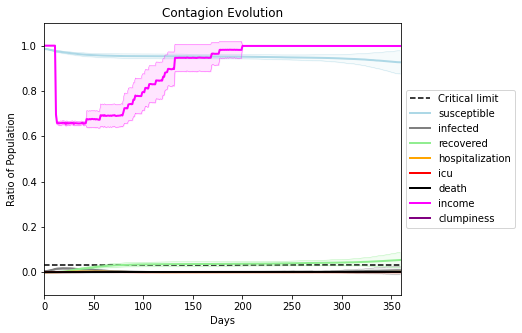

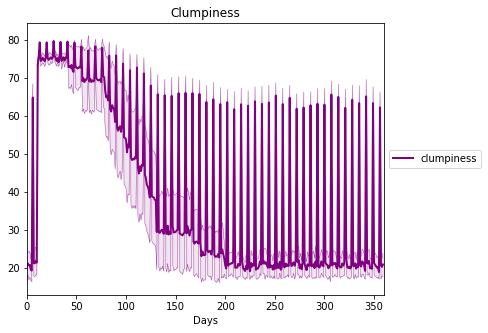

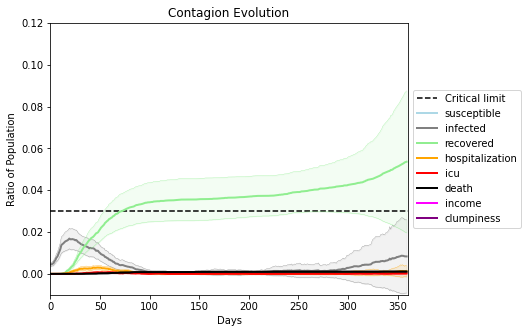

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.9975", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[1641, 7752, 6076, 7708, 6246, 2179, 2664, 898, 4630, 7909, 688, 9657, 7817, 7470, 4495, 6419, 81, 5428, 4724, 8449]
Average similarity between family members is 0.9906256978487739 at temperature -0.997
Average similarity between family and home is 0.9998959388832721 at temperature -1
Average similarity between students and their classroom is 0.6366181983697006 at temperature -0.997
Average classroom occupancy is 12.666666666666666 and number classrooms is 24
Average similarity between workers is 0.9889943561127871 at temperature -0.997
Average office occupancy is 10.301587301587302 and number offices is 63
Average friend similarity for adults: 0.9937990979095002 for kids: 0.7867231687919223
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.6835842547415023
disconnects
0.0
clumpiness 17.58
avg restaurant similarity 0.6238304620439354
disconnects
0.0
clumpiness 17.06
avg restaurant similarity 0.5749588686971645
disconnects
0.0
clumpiness 18.41
avg restaurant similarity 0.5571738658417709
disconnects
0.0
clumpiness 17.77
avg restaurant similarity 0.6127471538940187
disconnects
0.01
clumpiness 18.19
avg restaurant similarity 0.5548172911276219
disconnects
0.01
clumpiness 19.38
avg restaurant similarity 0.5471711267296996
disconnects
0.93
clumpiness 75.29
avg restaurant similarity 0.5560513993788164
disconnects
0.0
clumpiness 18.01
avg restaurant similarity 0.5578586532188091
disconnects
0.0
clumpiness 16.07
avg restaurant similarity 0.5528543767192452
disconnects
0.0
clumpiness 16.38
avg restaurant similarity 0.5775616841984949
disconnects
0.0
clumpiness 17.51
avg restaurant similarity 0.5345116628717063
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.6622084032845207
disconnects
0.9

disconnects
0.84
clumpiness 68.56
avg restaurant similarity 0.4794336359542309
disconnects
0.0
clumpiness 16.87
avg restaurant similarity 0.6192954563644177
disconnects
0.0
clumpiness 16.62
avg restaurant similarity 0.5323103562097498
disconnects
0.01
clumpiness 18.9
avg restaurant similarity 0.5359119331641693
disconnects
0.01
clumpiness 17.15
avg restaurant similarity 0.6872834016065097
disconnects
0.0
clumpiness 17.93
avg restaurant similarity 0.6112241138197652
disconnects
0.01
clumpiness 18.24
avg restaurant similarity 0.5268013296663416
disconnects
0.64
clumpiness 56.87
avg restaurant similarity 0.5667153080468539
disconnects
0.0
clumpiness 16.31
avg restaurant similarity 0.6016159604217699
disconnects
0.0
clumpiness 17.2
avg restaurant similarity 0.57627463651123
disconnects
0.0
clumpiness 16.23
avg restaurant similarity 0.6413391672927325
disconnects
0.0
clumpiness 15.82
avg restaurant similarity 0.5169675264398866
disconnects
0.01
clumpiness 19.28
avg restaurant similarity 0.5

disconnects
0.84
clumpiness 68.37
avg restaurant similarity 0.48483244475667253
disconnects
0.0
clumpiness 17.64
avg restaurant similarity 0.6040501474606067
disconnects
0.0
clumpiness 19.73
avg restaurant similarity 0.6941982772551331
disconnects
0.0
clumpiness 16.68
avg restaurant similarity 0.6732609236716923
disconnects
0.01
clumpiness 18.18
avg restaurant similarity 0.5881978987633654
disconnects
0.0
clumpiness 18.84
avg restaurant similarity 0.4549003882130718
disconnects
0.0
clumpiness 17.65
avg restaurant similarity 0.5010264346562746
disconnects
0.85
clumpiness 69.5
avg restaurant similarity 0.6281226241019651
disconnects
0.0
clumpiness 17.15
avg restaurant similarity 0.627745620869238
disconnects
0.0
clumpiness 19.41
avg restaurant similarity 0.6676800233953809
disconnects
0.0
clumpiness 15.58
avg restaurant similarity 0.7171996149708949
disconnects
0.0
clumpiness 16.59
avg restaurant similarity 0.6634040244748528
disconnects
0.0
clumpiness 18.39
avg restaurant similarity 0.6

avg restaurant similarity 0.5320663403262276
disconnects
0.0
clumpiness 17.18
avg restaurant similarity 0.5349887726337453
disconnects
0.0
clumpiness 20.14
avg restaurant similarity 0.5359828357906903
disconnects
0.0
clumpiness 18.98
avg restaurant similarity 0.6824714318378138
disconnects
0.01
clumpiness 18.38
avg restaurant similarity 0.5205340653546483
disconnects
0.01
clumpiness 17.87
avg restaurant similarity 0.7975728008801782
disconnects
0.0
clumpiness 19.05
avg restaurant similarity 0.7582889557775087
disconnects
0.76
clumpiness 65.13
avg restaurant similarity 0.6256813940034062
disconnects
0.0
clumpiness 16.16
avg restaurant similarity 0.6464582115294609
disconnects
0.0
clumpiness 18.03
avg restaurant similarity 0.553094347406124
disconnects
0.01
clumpiness 18.94
avg restaurant similarity 0.6142515557522422
disconnects
0.0
clumpiness 16.46
avg restaurant similarity 0.6196572159398034
disconnects
0.0
clumpiness 16.79
avg restaurant similarity 0.6951545605494568
disconnects
0.0


avg restaurant similarity 0.43673520920066883
disconnects
0.0
clumpiness 15.56
avg restaurant similarity 0.4949765543239291
disconnects
0.01
clumpiness 15.12
avg restaurant similarity 0.39888447419389683
disconnects
0.01
clumpiness 13.72
avg restaurant similarity 0.39034754472312966
disconnects
0.01
clumpiness 18.02
avg restaurant similarity 0.4534588965541144
disconnects
0.0
clumpiness 15.43
avg restaurant similarity 0.45347412366902534
disconnects
0.18
clumpiness 26.98
avg restaurant similarity 0.4916867939383391
disconnects
0.6
clumpiness 54.04
avg restaurant similarity 0.4831364698463892
disconnects
0.19
clumpiness 26.58
avg restaurant similarity 0.45367829444183067
disconnects
0.0
clumpiness 16.84
avg restaurant similarity 0.4551100385385808
disconnects
0.21
clumpiness 27.36
avg restaurant similarity 0.472132348462593
disconnects
0.16
clumpiness 25.08
avg restaurant similarity 0.5042677048948304
disconnects
0.83
clumpiness 69.16
avg restaurant similarity 0.5076122298641208
disconn

avg restaurant similarity 0.4270178225039801
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.4695583983258078
disconnects
0.91
clumpiness 73.97
avg restaurant similarity 0.4074698493642327
disconnects
0.93
clumpiness 75.29
avg restaurant similarity 0.5473155475777262
disconnects
0.91
clumpiness 73.58
avg restaurant similarity 0.4406552518065508
disconnects
0.91
clumpiness 73.55
avg restaurant similarity 0.42122170580475066
disconnects
0.87
clumpiness 71.25
avg restaurant similarity 0.4387471325605608
disconnects
0.94
clumpiness 75.91
avg restaurant similarity 0.44259793473062053
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.39031170713897384
disconnects
0.87
clumpiness 71.16
avg restaurant similarity 0.45034643623567694
disconnects
0.91
clumpiness 73.81
avg restaurant similarity 0.553931863578507
disconnects
0.88
clumpiness 72.0
avg restaurant similarity 0.4120329673041641
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.39009863475141654
disc

disconnects
0.01
clumpiness 13.69
avg restaurant similarity 0.40083788617571064
disconnects
0.74
clumpiness 62.35
avg restaurant similarity 0.5411279142770987
disconnects
0.15
clumpiness 22.86
avg restaurant similarity 0.33684824778261196
disconnects
0.0
clumpiness 14.89
avg restaurant similarity 0.4677302106933596
disconnects
0.2
clumpiness 26.91
avg restaurant similarity 0.4642183090429484
disconnects
0.18
clumpiness 25.64
avg restaurant similarity 0.4923843648587623
disconnects
0.0
clumpiness 16.86
avg restaurant similarity 0.46800091031125507
disconnects
0.0
clumpiness 16.18
avg restaurant similarity 0.46292093976630644
disconnects
0.65
clumpiness 57.17
avg restaurant similarity 0.4076768773745116
disconnects
0.0
clumpiness 15.78
avg restaurant similarity 0.5570342958211046
disconnects
0.0
clumpiness 16.79
avg restaurant similarity 0.39320937915086646
disconnects
0.0
clumpiness 16.18
avg restaurant similarity 0.4433984766817179
disconnects
0.2
clumpiness 27.01
avg restaurant simila

avg restaurant similarity 0.513944433390051
disconnects
0.0
clumpiness 14.53
avg restaurant similarity 0.40966172834103454
disconnects
0.63
clumpiness 55.74
avg restaurant similarity 0.5126519496663018
disconnects
0.0
clumpiness 15.22
avg restaurant similarity 0.37435772244903814
disconnects
0.0
clumpiness 15.82
avg restaurant similarity 0.5340360125784884
disconnects
0.0
clumpiness 15.41
avg restaurant similarity 0.35660476978693806
disconnects
0.0
clumpiness 17.8
avg restaurant similarity 0.566285940858055
disconnects
0.0
clumpiness 14.54
avg restaurant similarity 0.5061706001537667
disconnects
0.02
clumpiness 16.55
avg restaurant similarity 0.5073134162613181
disconnects
0.6
clumpiness 54.35
avg restaurant similarity 0.4719999494267616
disconnects
0.02
clumpiness 18.07
avg restaurant similarity 0.474777564136566
disconnects
0.22
clumpiness 29.06
avg restaurant similarity 0.41294670364501906
disconnects
0.0
clumpiness 17.39
avg restaurant similarity 0.4629903095264911
disconnects
0.0

avg restaurant similarity 0.4792036395242258
disconnects
0.01
clumpiness 17.48
avg restaurant similarity 0.382453759131151
disconnects
0.0
clumpiness 15.03
avg restaurant similarity 0.5347596897313114
disconnects
0.02
clumpiness 16.76
avg restaurant similarity 0.5092909292623975
disconnects
0.0
clumpiness 13.86
avg restaurant similarity 0.5521514630267572
disconnects
0.01
clumpiness 15.17
avg restaurant similarity 0.4307461353749872
disconnects
0.03
clumpiness 18.45
avg restaurant similarity 0.6728947312102841
disconnects
0.79
clumpiness 65.88
avg restaurant similarity 0.4937623954389018
disconnects
0.0
clumpiness 14.57
avg restaurant similarity 0.439592413580471
disconnects
0.01
clumpiness 16.12
avg restaurant similarity 0.4451813349001471
disconnects
0.01
clumpiness 16.28
avg restaurant similarity 0.38988137195687506
disconnects
0.02
clumpiness 15.29
avg restaurant similarity 0.3281994165405408
disconnects
0.85
clumpiness 69.78
avg restaurant similarity 0.3569105699764867
disconnects

avg restaurant similarity 0.4443290538334917
disconnects
0.66
clumpiness 58.17
avg restaurant similarity 0.35905827562021714
disconnects
0.0
clumpiness 15.16
avg restaurant similarity 0.6447163212391701
disconnects
0.02
clumpiness 15.81
avg restaurant similarity 0.5632615493663738
disconnects
0.02
clumpiness 15.85
avg restaurant similarity 0.5511945868953403
disconnects
0.02
clumpiness 15.06
avg restaurant similarity 0.43783955635254007
disconnects
0.01
clumpiness 15.68
avg restaurant similarity 0.5542378693995365
disconnects
0.01
clumpiness 15.96
avg restaurant similarity 0.3876942303162362
disconnects
0.72
clumpiness 61.37
avg restaurant similarity 0.4592058525261866
disconnects
0.03
clumpiness 15.62
avg restaurant similarity 0.49711977214051095
disconnects
0.0
clumpiness 13.75
avg restaurant similarity 0.5237598204115789
disconnects
0.02
clumpiness 17.59
avg restaurant similarity 0.4835579780545144
disconnects
0.02
clumpiness 15.28
avg restaurant similarity 0.7036931220236141
discon

avg restaurant similarity 0.5281503460892643
disconnects
0.0
clumpiness 14.86
avg restaurant similarity 0.5124318040308985
disconnects
0.85
clumpiness 69.3
avg restaurant similarity 0.5558424571018876
disconnects
0.01
clumpiness 15.27
avg restaurant similarity 0.5947912203576773
disconnects
0.01
clumpiness 14.39
avg restaurant similarity 0.42963845305826864
disconnects
0.02
clumpiness 16.22
avg restaurant similarity 0.40997573427607387
disconnects
0.04
clumpiness 17.7
avg restaurant similarity 0.38231996853856665
disconnects
0.0
clumpiness 15.43
avg restaurant similarity 0.5046598083219168
disconnects
0.01
clumpiness 15.08
avg restaurant similarity 0.4446075173864141
disconnects
0.56
clumpiness 51.94
avg restaurant similarity 0.5890163143048308
disconnects
0.0
clumpiness 14.15
avg restaurant similarity 0.5450249132061998
disconnects
0.01
clumpiness 14.72
avg restaurant similarity 0.44638280321603513
disconnects
0.0
clumpiness 14.51
avg restaurant similarity 0.4928573898854928
disconnec

disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.5379240840665586
disconnects
0.04
clumpiness 17.86
avg restaurant similarity 0.5093895171534316
disconnects
0.66
clumpiness 58.71
avg restaurant similarity 0.4997585295198342
disconnects
0.02
clumpiness 15.26
avg restaurant similarity 0.6957778720546556
disconnects
0.02
clumpiness 15.78
avg restaurant similarity 0.4817147383248108
disconnects
0.02
clumpiness 15.14
avg restaurant similarity 0.5264033260393
disconnects
0.0
clumpiness 14.82
avg restaurant similarity 0.38869863047695985
disconnects
0.01
clumpiness 14.42
avg restaurant similarity 0.5969353785175996
disconnects
0.01
clumpiness 14.1
avg restaurant similarity 0.5196637940563001
disconnects
0.66
clumpiness 56.77
avg restaurant similarity 0.37585206093885587
disconnects
0.02
clumpiness 16.46
avg restaurant similarity 0.47849669046330806
disconnects
0.04
clumpiness 15.66
avg restaurant similarity 0.48228806471600455
disconnects
0.01
clumpiness 16.29
avg restaurant simil

avg restaurant similarity 0.5174151086213935
disconnects
0.01
clumpiness 13.62
avg restaurant similarity 0.5031441101854184
disconnects
0.03
clumpiness 14.8
avg restaurant similarity 0.4979092729270039
disconnects
0.0
clumpiness 14.18
avg restaurant similarity 0.4870163484505904
disconnects
0.01
clumpiness 13.9
avg restaurant similarity 0.5971809718261075
disconnects
0.02
clumpiness 14.34
avg restaurant similarity 0.565630621193263
disconnects
0.02
clumpiness 15.36
avg restaurant similarity 0.46974338274967264
disconnects
0.57
clumpiness 53.39
avg restaurant similarity 0.620384488852531
disconnects
0.01
clumpiness 13.35
avg restaurant similarity 0.5466143685711853
disconnects
0.0
clumpiness 13.28
avg restaurant similarity 0.6248057724696338
disconnects
0.02
clumpiness 13.58
avg restaurant similarity 0.4248173200889944
disconnects
0.01
clumpiness 13.75
avg restaurant similarity 0.5617896171180254
disconnects
0.77
clumpiness 64.4
avg restaurant similarity 0.4552091698604183
disconnects
0

avg restaurant similarity 0.5562135102292037
disconnects
0.9
clumpiness 73.19
avg restaurant similarity 0.4525605321838715
disconnects
0.78
clumpiness 65.36
avg restaurant similarity 0.5676828281602714
disconnects
0.98
clumpiness 78.5
avg restaurant similarity 0.6169313660474132
disconnects
0.66
clumpiness 58.59
avg restaurant similarity 0.4689196476326339
disconnects
0.8
clumpiness 66.54
avg restaurant similarity 0.40726049801864084
disconnects
0.74
clumpiness 63.76
avg restaurant similarity 0.4931846125160326
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.5047338329249592
disconnects
0.94
clumpiness 75.79
avg restaurant similarity 0.6247458720729676
disconnects
0.9
clumpiness 72.94
avg restaurant similarity 0.6857209618345947
disconnects
0.93
clumpiness 74.89
avg restaurant similarity 0.5572068238276348
disconnects
0.85
clumpiness 69.28
avg restaurant similarity 0.5251100433682726
disconnects
0.94
clumpiness 75.77
avg restaurant similarity 0.4854616344499398
disconnect

disconnects
0.51
clumpiness 47.94
avg restaurant similarity 0.6106406085492828
disconnects
0.01
clumpiness 14.05
avg restaurant similarity 0.6948918279422783
disconnects
0.01
clumpiness 14.84
avg restaurant similarity 0.5990919237948955
disconnects
0.02
clumpiness 13.93
avg restaurant similarity 0.5597799367993405
disconnects
0.0
clumpiness 13.67
avg restaurant similarity 0.5219520907497652
disconnects
0.01
clumpiness 13.91
avg restaurant similarity 0.469497885253675
disconnects
0.02
clumpiness 14.37
avg restaurant similarity 0.5650083203671008
disconnects
0.69
clumpiness 61.02
avg restaurant similarity 0.6425223658794174
disconnects
0.02
clumpiness 15.56
avg restaurant similarity 0.5028434016950228
disconnects
0.01
clumpiness 13.18
avg restaurant similarity 0.5414293978774188
disconnects
0.02
clumpiness 14.17
avg restaurant similarity 0.4710787220672399
disconnects
0.0
clumpiness 13.18
avg restaurant similarity 0.5277290834278172
disconnects
0.0
clumpiness 13.07
avg restaurant similar

avg restaurant similarity 0.564493965106457
disconnects
0.48
clumpiness 47.53
avg restaurant similarity 0.5396599156799693
disconnects
0.04
clumpiness 15.44
avg restaurant similarity 0.5406822782173737
disconnects
0.01
clumpiness 13.6
avg restaurant similarity 0.44325621834427414
disconnects
0.02
clumpiness 14.29
avg restaurant similarity 0.5707940394432918
disconnects
0.03
clumpiness 14.18
avg restaurant similarity 0.5492945336146509
disconnects
0.0
clumpiness 12.33
avg restaurant similarity 0.6443121654935509
disconnects
0.01
clumpiness 13.72
avg restaurant similarity 0.4696563464378713
disconnects
0.57
clumpiness 53.02
avg restaurant similarity 0.6604894240258469
disconnects
0.0
clumpiness 12.22
avg restaurant similarity 0.5098891922343946
disconnects
0.01
clumpiness 13.5
avg restaurant similarity 0.5549693744813581
disconnects
0.02
clumpiness 15.26
avg restaurant similarity 0.5569471590826812
disconnects
0.0
clumpiness 13.14
avg restaurant similarity 0.503203582494187
disconnects
0

avg restaurant similarity 0.4455896259173592
disconnects
0.0
clumpiness 13.35
avg restaurant similarity 0.5291139185097483
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.5480439226463606
disconnects
0.0
clumpiness 14.08
avg restaurant similarity 0.7304393216600761
disconnects
0.0
clumpiness 12.42
avg restaurant similarity 0.4655458155371292
disconnects
0.0
clumpiness 13.11
avg restaurant similarity 0.5180428293882624
disconnects
0.0
clumpiness 13.12
avg restaurant similarity 0.4167496241365371
disconnects
0.57
clumpiness 53.08
avg restaurant similarity 0.4787452478015203
disconnects
0.0
clumpiness 13.74
avg restaurant similarity 0.5940292210700023
disconnects
0.0
clumpiness 14.0
avg restaurant similarity 0.6412637939944071
disconnects
0.0
clumpiness 13.68
avg restaurant similarity 0.6240352031788383
disconnects
0.0
clumpiness 13.58
avg restaurant similarity 0.3477170273985576
disconnects
0.88
clumpiness 72.08
avg restaurant similarity 0.5638278641012784
disconnects
0.85
c

avg restaurant similarity 0.5087106556609393
disconnects
0.94
clumpiness 76.22
avg restaurant similarity 0.5413763651502294
disconnects
0.97
clumpiness 77.83
avg restaurant similarity 0.6089424785619166
disconnects
0.94
clumpiness 75.61
avg restaurant similarity 0.6181947713260177
disconnects
0.94
clumpiness 75.93
avg restaurant similarity 0.42766863014525425
disconnects
0.91
clumpiness 73.72
avg restaurant similarity 0.604653492179332
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.415156383811886
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6133702643000751
disconnects
0.89
clumpiness 73.0
avg restaurant similarity 0.38535841138745736
disconnects
0.92
clumpiness 74.33
avg restaurant similarity 0.5208902000757046
disconnects
0.99
clumpiness 79.34
avg restaurant similarity 0.6513565050464093
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.4344850584479163
disconnects
0.93
clumpiness 75.21
avg restaurant similarity 0.4993491033073179
disconnect

disconnects
0.67
clumpiness 59.29
avg restaurant similarity 0.7701246436922348
disconnects
0.0
clumpiness 13.55
avg restaurant similarity 0.4049570843136015
disconnects
0.0
clumpiness 13.64
avg restaurant similarity 0.5681137339793652
disconnects
0.0
clumpiness 13.15
avg restaurant similarity 0.4214799054244885
disconnects
0.0
clumpiness 13.75
avg restaurant similarity 0.49227029398460614
disconnects
0.0
clumpiness 14.66
avg restaurant similarity 0.46733445805287854
disconnects
0.0
clumpiness 14.08
avg restaurant similarity 0.6309643165103351
disconnects
0.57
clumpiness 54.81
avg restaurant similarity 0.5417671032852206
disconnects
0.0
clumpiness 13.04
avg restaurant similarity 0.629084025930862
disconnects
0.0
clumpiness 12.63
avg restaurant similarity 0.5580224156921126
disconnects
0.0
clumpiness 12.49
avg restaurant similarity 0.47295057475743646
disconnects
0.0
clumpiness 13.59
avg restaurant similarity 0.6339435744776682
disconnects
0.0
clumpiness 14.61
avg restaurant similarity 0

disconnects
0.48
clumpiness 47.59
avg restaurant similarity 0.7553531370654036
disconnects
0.0
clumpiness 13.98
avg restaurant similarity 0.4948115014455824
disconnects
0.0
clumpiness 13.51
avg restaurant similarity 0.3649927701097868
disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.6126200022400163
disconnects
0.0
clumpiness 13.83
avg restaurant similarity 0.6600009534803459
disconnects
0.0
clumpiness 13.76
avg restaurant similarity 0.4569071599493281
disconnects
0.0
clumpiness 12.29
avg restaurant similarity 0.5514811612443773
disconnects
0.48
clumpiness 47.1
avg restaurant similarity 0.40420495357545166
disconnects
0.0
clumpiness 12.87
avg restaurant similarity 0.49156392722573605
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.31879884249291557
disconnects
0.0
clumpiness 13.82
avg restaurant similarity 0.5093780012128237
disconnects
0.0
clumpiness 13.53
avg restaurant similarity 0.4605737534490613
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0

avg restaurant similarity 0.40918765608070334
disconnects
0.0
clumpiness 17.0
avg restaurant similarity 0.4183896087402585
disconnects
0.0
clumpiness 16.49
avg restaurant similarity 0.4975238103606574
disconnects
0.0
clumpiness 15.45
avg restaurant similarity 0.6239384112148039
disconnects
0.0
clumpiness 14.73
avg restaurant similarity 0.45587567411920843
disconnects
0.01
clumpiness 17.12
avg restaurant similarity 0.6234587451014507
disconnects
0.01
clumpiness 16.08
avg restaurant similarity 0.6926885801543963
disconnects
0.86
clumpiness 70.83
avg restaurant similarity 0.5603485237982427
disconnects
0.0
clumpiness 15.18
avg restaurant similarity 0.5226545191762699
disconnects
0.01
clumpiness 15.91
avg restaurant similarity 0.4996620471977551
disconnects
0.01
clumpiness 16.51
avg restaurant similarity 0.6544225437032262
disconnects
0.0
clumpiness 15.34
avg restaurant similarity 0.6018718423498571
disconnects
0.91
clumpiness 73.65
avg restaurant similarity 0.5604152752650369
disconnects


avg restaurant similarity 0.5729420536128317
disconnects
0.92
clumpiness 74.32
avg restaurant similarity 0.4349514643806016
disconnects
0.94
clumpiness 75.77
avg restaurant similarity 0.48781550989153805
disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.4323903465121154
disconnects
0.02
clumpiness 19.02
avg restaurant similarity 0.5349350086391251
disconnects
0.02
clumpiness 15.94
avg restaurant similarity 0.36700368110081283
disconnects
0.0
clumpiness 15.88
avg restaurant similarity 0.535266197551877
disconnects
0.66
clumpiness 59.34
avg restaurant similarity 0.3429031332641332
disconnects
0.0
clumpiness 17.14
avg restaurant similarity 0.3852619213294753
disconnects
0.0
clumpiness 16.82
avg restaurant similarity 0.5466654781576231
disconnects
0.0
clumpiness 15.92
avg restaurant similarity 0.595756673813621
disconnects
0.02
clumpiness 15.61
avg restaurant similarity 0.4629355613982429
disconnects
0.0
clumpiness 17.04
avg restaurant similarity 0.4772991303617842
disconnects
0

avg restaurant similarity 0.5478809451497763
disconnects
0.01
clumpiness 15.71
avg restaurant similarity 0.6030036559234138
disconnects
0.0
clumpiness 15.76
avg restaurant similarity 0.4870091500844263
disconnects
0.0
clumpiness 16.01
avg restaurant similarity 0.4997266733334562
disconnects
0.01
clumpiness 15.54
avg restaurant similarity 0.428223720327271
disconnects
0.01
clumpiness 17.13
avg restaurant similarity 0.30937297561037713
disconnects
0.0
clumpiness 16.01
avg restaurant similarity 0.5491595654286691
disconnects
0.78
clumpiness 66.06
avg restaurant similarity 0.5108151203666949
disconnects
0.01
clumpiness 16.17
avg restaurant similarity 0.39317003505830334
disconnects
0.0
clumpiness 16.1
avg restaurant similarity 0.4223980221590719
disconnects
0.0
clumpiness 15.32
avg restaurant similarity 0.48673699262868014
disconnects
0.0
clumpiness 15.68
avg restaurant similarity 0.5434174525314124
disconnects
0.0
clumpiness 14.72
avg restaurant similarity 0.5747821914366329
disconnects
0

disconnects
0.66
clumpiness 59.0
avg restaurant similarity 0.5353454679059728
disconnects
0.01
clumpiness 16.42
avg restaurant similarity 0.3967128468632352
disconnects
0.0
clumpiness 15.81
avg restaurant similarity 0.5586996969300525
disconnects
0.01
clumpiness 15.48
avg restaurant similarity 0.5274451899218096
disconnects
0.01
clumpiness 17.06
avg restaurant similarity 0.4076378063454775
disconnects
0.0
clumpiness 15.76
avg restaurant similarity 0.5834633034573875
disconnects
0.0
clumpiness 14.73
avg restaurant similarity 0.5449696098737825
disconnects
0.84
clumpiness 69.37
avg restaurant similarity 0.39388918284872143
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 0.5054586191528715
disconnects
0.0
clumpiness 15.79
avg restaurant similarity 0.5305272815815246
disconnects
0.0
clumpiness 14.91
avg restaurant similarity 0.6035378247996963
disconnects
0.0
clumpiness 15.96
avg restaurant similarity 0.5248047726362117
disconnects
0.0
clumpiness 14.97
avg restaurant similarity 

avg restaurant similarity 0.6241490271681923
disconnects
0.0
clumpiness 14.42
avg restaurant similarity 0.641602812041564
disconnects
0.0
clumpiness 13.51
avg restaurant similarity 0.5990342448629882
disconnects
0.0
clumpiness 15.55
avg restaurant similarity 0.6235349968060577
disconnects
0.12
clumpiness 21.44
avg restaurant similarity 0.5167830596199572
disconnects
0.0
clumpiness 14.86
avg restaurant similarity 0.5872285479218332
disconnects
0.0
clumpiness 14.44
avg restaurant similarity 0.7669921849717753
disconnects
0.56
clumpiness 50.41
avg restaurant similarity 0.4795462387229104
disconnects
0.0
clumpiness 13.57
avg restaurant similarity 0.6495585989687302
disconnects
0.13
clumpiness 22.41
avg restaurant similarity 0.7153816184831683
disconnects
0.11
clumpiness 21.93
avg restaurant similarity 0.6831696790606886
disconnects
0.0
clumpiness 16.29
avg restaurant similarity 0.5939472493203011
disconnects
0.89
clumpiness 72.31
avg restaurant similarity 0.6351843938324899
disconnects
0.9

disconnects
0.56
clumpiness 51.26
avg restaurant similarity 0.7377411208557507
disconnects
0.0
clumpiness 15.39
avg restaurant similarity 0.6275446158625246
disconnects
0.1
clumpiness 19.33
avg restaurant similarity 0.7786704758396781
disconnects
0.0
clumpiness 14.07
avg restaurant similarity 0.703310890167728
disconnects
0.09
clumpiness 20.14
avg restaurant similarity 0.6795841400499797
disconnects
0.0
clumpiness 13.21
avg restaurant similarity 0.49777717974399793
disconnects
0.0
clumpiness 13.34
avg restaurant similarity 0.7260738824245367
disconnects
0.7
clumpiness 60.44
avg restaurant similarity 0.6630876097238353
disconnects
0.01
clumpiness 15.38
avg restaurant similarity 0.6306188347725689
disconnects
0.0
clumpiness 13.87
avg restaurant similarity 0.7360777242955491
disconnects
0.02
clumpiness 14.13
avg restaurant similarity 0.6521198221298274
disconnects
0.0
clumpiness 14.1
avg restaurant similarity 0.6209836532653383
disconnects
0.13
clumpiness 21.73
avg restaurant similarity 0

disconnects
0.56
clumpiness 52.64
avg restaurant similarity 0.56724658789238
disconnects
0.0
clumpiness 12.96
avg restaurant similarity 0.7586215026581988
disconnects
0.0
clumpiness 12.55
avg restaurant similarity 0.7153136691442602
disconnects
0.0
clumpiness 14.28
avg restaurant similarity 0.7183498877476177
disconnects
0.0
clumpiness 14.13
avg restaurant similarity 0.6137893652474256
disconnects
0.0
clumpiness 13.69
avg restaurant similarity 0.5378394626548453
disconnects
0.09
clumpiness 19.24
avg restaurant similarity 0.5756203744139406
disconnects
0.5
clumpiness 47.97
avg restaurant similarity 0.6083137153605035
disconnects
0.1
clumpiness 22.47
avg restaurant similarity 0.6276279495456493
disconnects
0.09
clumpiness 19.62
avg restaurant similarity 0.6343985260852532
disconnects
0.01
clumpiness 14.68
avg restaurant similarity 0.603251718917894
disconnects
0.15
clumpiness 22.97
avg restaurant similarity 0.5096426218614197
disconnects
0.0
clumpiness 14.84
avg restaurant similarity 0.7

disconnects
0.67
clumpiness 58.34
avg restaurant similarity 0.624313900388011
disconnects
0.0
clumpiness 15.85
avg restaurant similarity 0.5857677370931796
disconnects
0.01
clumpiness 13.67
avg restaurant similarity 0.7328733856638967
disconnects
0.01
clumpiness 13.59
avg restaurant similarity 0.7568257156430298
disconnects
0.1
clumpiness 21.45
avg restaurant similarity 0.7031758377872608
disconnects
0.01
clumpiness 15.31
avg restaurant similarity 0.6633388106812671
disconnects
0.0
clumpiness 14.67
avg restaurant similarity 0.4556056621509004
disconnects
0.62
clumpiness 55.79
avg restaurant similarity 0.5432294957874639
disconnects
0.01
clumpiness 14.45
avg restaurant similarity 0.6763016393821653
disconnects
0.08
clumpiness 19.93
avg restaurant similarity 0.6523293828083208
disconnects
0.0
clumpiness 13.02
avg restaurant similarity 0.7989478584945177
disconnects
0.13
clumpiness 22.22
avg restaurant similarity 0.650170531793985
disconnects
0.0
clumpiness 13.84
avg restaurant similarity

avg restaurant similarity 0.46516908066119145
disconnects
0.0
clumpiness 14.39
avg restaurant similarity 0.4252807642596352
disconnects
0.16
clumpiness 23.69
avg restaurant similarity 0.5231295126280991
disconnects
0.0
clumpiness 16.12
avg restaurant similarity 0.4397399737347184
disconnects
0.0
clumpiness 14.87
avg restaurant similarity 0.6227359917070671
disconnects
0.0
clumpiness 15.11
avg restaurant similarity 0.5114519999396506
disconnects
0.0
clumpiness 15.46
avg restaurant similarity 0.377745281606154
disconnects
0.56
clumpiness 51.26
avg restaurant similarity 0.3364940982461516
disconnects
0.0
clumpiness 14.88
avg restaurant similarity 0.425674808456523
disconnects
0.01
clumpiness 14.54
avg restaurant similarity 0.39145059966476337
disconnects
0.0
clumpiness 14.01
avg restaurant similarity 0.48986405033962827
disconnects
0.0
clumpiness 16.45
avg restaurant similarity 0.5233474985472115
disconnects
0.97
clumpiness 78.04
avg restaurant similarity 0.3772592924959825
disconnects
0.

avg restaurant similarity 0.47002335193682065
disconnects
0.9
clumpiness 73.29
avg restaurant similarity 0.49016158282710437
disconnects
0.9
clumpiness 73.22
avg restaurant similarity 0.3149315626411831
disconnects
0.93
clumpiness 75.47
avg restaurant similarity 0.469004905885491
disconnects
0.97
clumpiness 77.86
avg restaurant similarity 0.39800681893476325
disconnects
0.88
clumpiness 71.9
avg restaurant similarity 0.47138641142387266
disconnects
0.93
clumpiness 75.36
avg restaurant similarity 0.412740250954457
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.5943992531870079
disconnects
0.91
clumpiness 73.66
avg restaurant similarity 0.44125969571941426
disconnects
0.98
clumpiness 78.5
avg restaurant similarity 0.5216453580359645
disconnects
0.95
clumpiness 76.65
avg restaurant similarity 0.36345863902430553
disconnects
0.98
clumpiness 78.69
avg restaurant similarity 0.48638726900698775
disconnects
0.93
clumpiness 74.95
avg restaurant similarity 0.32116870796260377
disco

avg restaurant similarity 0.4155057998486589
disconnects
0.0
clumpiness 13.35
avg restaurant similarity 0.41723411573538827
disconnects
0.01
clumpiness 16.0
avg restaurant similarity 0.3596529333077429
disconnects
0.0
clumpiness 15.1
avg restaurant similarity 0.6000473493548969
disconnects
0.2
clumpiness 26.83
avg restaurant similarity 0.4497829524037667
disconnects
0.01
clumpiness 16.14
avg restaurant similarity 0.5369776129422599
disconnects
0.0
clumpiness 15.72
avg restaurant similarity 0.5016054972534272
disconnects
0.65
clumpiness 56.79
avg restaurant similarity 0.5115327455682736
disconnects
0.0
clumpiness 15.12
avg restaurant similarity 0.4061010267609056
disconnects
0.0
clumpiness 14.36
avg restaurant similarity 0.43266998261742645
disconnects
0.0
clumpiness 15.18
avg restaurant similarity 0.5140445835208941
disconnects
0.0
clumpiness 15.32
avg restaurant similarity 0.44849580476285184
disconnects
0.0
clumpiness 14.67
avg restaurant similarity 0.46390847356199705
disconnects
0.

disconnects
0.72
clumpiness 62.52
avg restaurant similarity 0.5098155691347668
disconnects
0.0
clumpiness 14.87
avg restaurant similarity 0.6216885810191373
disconnects
0.01
clumpiness 16.89
avg restaurant similarity 0.505812593527283
disconnects
0.0
clumpiness 14.38
avg restaurant similarity 0.4288548016160759
disconnects
0.0
clumpiness 15.35
avg restaurant similarity 0.3658738968323154
disconnects
0.0
clumpiness 14.83
avg restaurant similarity 0.43825965360105745
disconnects
0.01
clumpiness 18.69
avg restaurant similarity 0.45905381485901836
disconnects
0.78
clumpiness 64.96
avg restaurant similarity 0.5137969666238138
disconnects
0.01
clumpiness 15.76
avg restaurant similarity 0.41678546913038017
disconnects
0.01
clumpiness 16.0
avg restaurant similarity 0.5745486463471366
disconnects
0.0
clumpiness 15.99
avg restaurant similarity 0.41965165586462394
disconnects
0.01
clumpiness 16.43
avg restaurant similarity 0.46739371313381317
disconnects
0.0
clumpiness 15.05
avg restaurant simila

avg restaurant similarity 0.4455334400623084
disconnects
0.0
clumpiness 13.57
avg restaurant similarity 0.3810985500272984
disconnects
0.0
clumpiness 14.5
avg restaurant similarity 0.3548390136932472
disconnects
0.01
clumpiness 14.33
avg restaurant similarity 0.3057547540599186
disconnects
0.0
clumpiness 15.62
avg restaurant similarity 0.261308231844524
disconnects
0.0
clumpiness 14.22
avg restaurant similarity 0.2700398882213458
disconnects
0.0
clumpiness 16.08
avg restaurant similarity 0.3901900181492175
disconnects
0.62
clumpiness 54.96
avg restaurant similarity 0.410245467691342
disconnects
0.0
clumpiness 15.2
avg restaurant similarity 0.30865440138297595
disconnects
0.0
clumpiness 15.76
avg restaurant similarity 0.2551271310057462
disconnects
0.0
clumpiness 15.27
avg restaurant similarity 0.38934562163689734
disconnects
0.01
clumpiness 16.27
avg restaurant similarity 0.2370027284631857
disconnects
0.84
clumpiness 69.28
avg restaurant similarity 0.41120293727002066
disconnects
0.93

avg restaurant similarity 0.2800940376939076
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4592396903201494
disconnects
0.88
clumpiness 72.08
avg restaurant similarity 0.2798426463672998
disconnects
0.73
clumpiness 62.99
avg restaurant similarity 0.25387118567212935
disconnects
0.97
clumpiness 77.77
avg restaurant similarity 0.4362112829668363
disconnects
0.9
clumpiness 73.05
avg restaurant similarity 0.391649608011337
disconnects
0.86
clumpiness 70.19
avg restaurant similarity 0.5061822656835987
disconnects
0.94
clumpiness 75.71
avg restaurant similarity 0.4350224809872178
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3404542078649284
disconnects
0.94
clumpiness 75.67
avg restaurant similarity 0.3787213697651235
disconnects
0.85
clumpiness 70.72
avg restaurant similarity 0.29733936636568226
disconnects
0.92
clumpiness 74.37
avg restaurant similarity 0.36802182131079997
disconnects
0.86
clumpiness 70.48
avg restaurant similarity 0.4095826170272128
disconnect

disconnects
0.0
clumpiness 14.48
avg restaurant similarity 0.3222320213654037
disconnects
0.79
clumpiness 66.22
avg restaurant similarity 0.48207202244395847
disconnects
0.0
clumpiness 14.82
avg restaurant similarity 0.4348478709050921
disconnects
0.0
clumpiness 15.26
avg restaurant similarity 0.4055175304555722
disconnects
0.0
clumpiness 15.43
avg restaurant similarity 0.3049845781128486
disconnects
0.01
clumpiness 14.74
avg restaurant similarity 0.5031200058065358
disconnects
0.0
clumpiness 14.32
avg restaurant similarity 0.28643480723743503
disconnects
0.01
clumpiness 16.44
avg restaurant similarity 0.40729197899644715
disconnects
0.61
clumpiness 55.72
avg restaurant similarity 0.454568012176041
disconnects
0.0
clumpiness 16.32
avg restaurant similarity 0.39127028313808987
disconnects
0.0
clumpiness 14.56
avg restaurant similarity 0.4167007913616024
disconnects
0.0
clumpiness 15.0
avg restaurant similarity 0.3028009824207389
disconnects
0.01
clumpiness 14.5
avg restaurant similarity

avg restaurant similarity 0.398560611210537
disconnects
0.0
clumpiness 15.2
avg restaurant similarity 0.3122196711681981
disconnects
0.79
clumpiness 66.03
avg restaurant similarity 0.409723544904143
disconnects
0.0
clumpiness 14.29
avg restaurant similarity 0.4684562908671879
disconnects
0.01
clumpiness 16.31
avg restaurant similarity 0.3240357071507965
disconnects
0.0
clumpiness 13.88
avg restaurant similarity 0.6105883236039554
disconnects
0.0
clumpiness 15.55
avg restaurant similarity 0.40196024737305264
disconnects
0.0
clumpiness 13.82
avg restaurant similarity 0.3832176371709133
disconnects
0.01
clumpiness 15.93
avg restaurant similarity 0.5316696553744484
disconnects
0.67
clumpiness 58.05
avg restaurant similarity 0.3628992102743813
disconnects
0.01
clumpiness 15.43
avg restaurant similarity 0.39103527614974126
disconnects
0.0
clumpiness 13.86
avg restaurant similarity 0.42670575835612573
disconnects
0.01
clumpiness 15.5
avg restaurant similarity 0.4027474714763722
disconnects
0.

avg restaurant similarity 0.4460966484055357
disconnects
0.01
clumpiness 12.84
avg restaurant similarity 0.6167128848666531
disconnects
0.01
clumpiness 14.1
avg restaurant similarity 0.5754363021367198
disconnects
0.01
clumpiness 13.17
avg restaurant similarity 0.45206854545416786
disconnects
0.01
clumpiness 13.23
avg restaurant similarity 0.528088217580787
disconnects
0.0
clumpiness 12.62
avg restaurant similarity 0.5306466948528055
disconnects
0.01
clumpiness 12.83
avg restaurant similarity 0.5055117738848632
disconnects
0.45
clumpiness 46.05
avg restaurant similarity 0.43238765570247273
disconnects
0.01
clumpiness 14.11
avg restaurant similarity 0.5250695670663493
disconnects
0.02
clumpiness 14.65
avg restaurant similarity 0.4546515646558257
disconnects
0.01
clumpiness 12.85
avg restaurant similarity 0.4268343456302392
disconnects
0.02
clumpiness 15.17
avg restaurant similarity 0.46390455304014194
disconnects
0.85
clumpiness 69.8
avg restaurant similarity 0.5147978422251768
disconne

avg restaurant similarity 0.5194830204768116
disconnects
0.45
clumpiness 45.6
avg restaurant similarity 0.5451550836611064
disconnects
0.0
clumpiness 12.95
avg restaurant similarity 0.6692001842241024
disconnects
0.0
clumpiness 13.28
avg restaurant similarity 0.4018367220348244
disconnects
0.01
clumpiness 13.45
avg restaurant similarity 0.46305288894748076
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.47885579190408
disconnects
0.0
clumpiness 12.24
avg restaurant similarity 0.5874028110086416
disconnects
0.0
clumpiness 11.98
avg restaurant similarity 0.4991888665758983
disconnects
0.47
clumpiness 47.42
avg restaurant similarity 0.45618767604267146
disconnects
0.0
clumpiness 13.22
avg restaurant similarity 0.42715772014332914
disconnects
0.01
clumpiness 13.8
avg restaurant similarity 0.459382624932767
disconnects
0.0
clumpiness 12.69
avg restaurant similarity 0.4748009646335304
disconnects
0.01
clumpiness 13.21
avg restaurant similarity 0.3101050563821302
disconnects
0.02

disconnects
0.0
clumpiness 12.06
avg restaurant similarity 0.47989617261810125
disconnects
0.51
clumpiness 48.03
avg restaurant similarity 0.4783553960256317
disconnects
0.01
clumpiness 12.41
avg restaurant similarity 0.5942528624887807
disconnects
0.0
clumpiness 14.08
avg restaurant similarity 0.48686725903718603
disconnects
0.0
clumpiness 12.52
avg restaurant similarity 0.48028014383002054
disconnects
0.01
clumpiness 12.79
avg restaurant similarity 0.5695398168447783
disconnects
0.01
clumpiness 12.36
avg restaurant similarity 0.4996775004840852
disconnects
0.0
clumpiness 12.08
avg restaurant similarity 0.5761463764139695
disconnects
0.53
clumpiness 49.11
avg restaurant similarity 0.4260279176009007
disconnects
0.0
clumpiness 13.61
avg restaurant similarity 0.5528456664156552
disconnects
0.0
clumpiness 12.05
avg restaurant similarity 0.4643393302024702
disconnects
0.01
clumpiness 13.02
avg restaurant similarity 0.3807084296170802
disconnects
0.0
clumpiness 11.76
avg restaurant similar

avg restaurant similarity 0.4895990440628648
disconnects
0.0
clumpiness 11.43
avg restaurant similarity 0.525869027152255
disconnects
0.65
clumpiness 57.14
avg restaurant similarity 0.5255174315870601
disconnects
0.0
clumpiness 12.65
avg restaurant similarity 0.4331606091039402
disconnects
0.02
clumpiness 14.04
avg restaurant similarity 0.6341957678371366
disconnects
0.01
clumpiness 13.54
avg restaurant similarity 0.5693768339705694
disconnects
0.02
clumpiness 14.76
avg restaurant similarity 0.5025075423869679
disconnects
0.0
clumpiness 13.47
avg restaurant similarity 0.5026682200506539
disconnects
0.0
clumpiness 12.56
avg restaurant similarity 0.447886491116808
disconnects
0.65
clumpiness 58.1
avg restaurant similarity 0.47778667528747465
disconnects
0.01
clumpiness 14.15
avg restaurant similarity 0.4149647378033258
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.4068948067277969
disconnects
0.02
clumpiness 14.01
avg restaurant similarity 0.6335818412760698
disconnects
0.

avg restaurant similarity 0.574396511696425
disconnects
0.01
clumpiness 15.69
avg restaurant similarity 0.7714214578221922
disconnects
0.02
clumpiness 16.07
avg restaurant similarity 0.6609167410488388
disconnects
0.0
clumpiness 14.19
avg restaurant similarity 0.7791159262668764
disconnects
0.01
clumpiness 16.3
avg restaurant similarity 0.7321488667062886
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.7238566930113061
disconnects
0.0
clumpiness 15.19
avg restaurant similarity 0.8203270751719415
disconnects
0.63
clumpiness 57.84
avg restaurant similarity 0.6771709807459878
disconnects
0.0
clumpiness 14.29
avg restaurant similarity 0.799680098955169
disconnects
0.0
clumpiness 16.27
avg restaurant similarity 0.6594225175720877
disconnects
0.01
clumpiness 16.39
avg restaurant similarity 0.7855273627609338
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.565562386136334
disconnects
0.87
clumpiness 71.29
avg restaurant similarity 0.7399607734600563
disconnects
0.95
c

avg restaurant similarity 0.724693924606487
disconnects
0.89
clumpiness 71.94
avg restaurant similarity 0.77993389779993
disconnects
0.96
clumpiness 77.23
avg restaurant similarity 0.6810834379862789
disconnects
0.92
clumpiness 74.46
avg restaurant similarity 0.6921343529410453
disconnects
0.93
clumpiness 75.15
avg restaurant similarity 0.7069961499583876
disconnects
0.9
clumpiness 72.95
avg restaurant similarity 0.6640071138378305
disconnects
0.97
clumpiness 77.9
avg restaurant similarity 0.7913828168455278
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.8036754043857839
disconnects
0.86
clumpiness 70.46
avg restaurant similarity 0.8335272328130019
disconnects
0.96
clumpiness 77.03
avg restaurant similarity 0.7579434534114682
disconnects
0.91
clumpiness 73.78
avg restaurant similarity 0.7051977997882867
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.714938711402454
disconnects
0.89
clumpiness 72.69
avg restaurant similarity 0.7351864081862679
disconnects
0.9

disconnects
0.62
clumpiness 56.12
avg restaurant similarity 0.6779165318929442
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.7032104761758865
disconnects
0.0
clumpiness 14.81
avg restaurant similarity 0.6744157988322715
disconnects
0.0
clumpiness 14.33
avg restaurant similarity 0.7159372382815454
disconnects
0.01
clumpiness 15.86
avg restaurant similarity 0.7261826501636353
disconnects
0.0
clumpiness 15.42
avg restaurant similarity 0.6618796383746206
disconnects
0.0
clumpiness 13.64
avg restaurant similarity 0.7043682092565522
disconnects
0.63
clumpiness 56.46
avg restaurant similarity 0.7845288359577253
disconnects
0.01
clumpiness 13.85
avg restaurant similarity 0.7303859135858342
disconnects
0.0
clumpiness 15.09
avg restaurant similarity 0.7429810410599821
disconnects
0.0
clumpiness 15.52
avg restaurant similarity 0.6855270346915787
disconnects
0.0
clumpiness 13.73
avg restaurant similarity 0.7748937966149745
disconnects
0.0
clumpiness 14.31
avg restaurant similarity 0.

avg restaurant similarity 0.8696452958572882
disconnects
0.0
clumpiness 15.45
avg restaurant similarity 0.7768021179989572
disconnects
0.0
clumpiness 16.22
avg restaurant similarity 0.6937985308702548
disconnects
0.01
clumpiness 15.77
avg restaurant similarity 0.737182079773315
disconnects
0.01
clumpiness 15.84
avg restaurant similarity 0.6529996376746452
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.7815056994558847
disconnects
0.02
clumpiness 16.71
avg restaurant similarity 0.7722694185388576
disconnects
0.73
clumpiness 62.68
avg restaurant similarity 0.7322310971373386
disconnects
0.0
clumpiness 15.94
avg restaurant similarity 0.7371783852073198
disconnects
0.02
clumpiness 16.6
avg restaurant similarity 0.7408263051092301
disconnects
0.0
clumpiness 15.68
avg restaurant similarity 0.6772938698231378
disconnects
0.01
clumpiness 15.41
avg restaurant similarity 0.65256325498981
disconnects
0.0
clumpiness 14.84
avg restaurant similarity 0.8538735037004297
disconnects
0.01
c

avg restaurant similarity 0.540997513567781
disconnects
0.0
clumpiness 16.4
avg restaurant similarity 0.5334765069563701
disconnects
0.0
clumpiness 14.97
avg restaurant similarity 0.5188058171985724
disconnects
0.0
clumpiness 14.76
avg restaurant similarity 0.6128924857158993
disconnects
0.0
clumpiness 14.26
avg restaurant similarity 0.5544397389921988
disconnects
0.0
clumpiness 14.36
avg restaurant similarity 0.6324842199149622
disconnects
0.0
clumpiness 14.56
avg restaurant similarity 0.5514714325402142
disconnects
0.77
clumpiness 65.25
avg restaurant similarity 0.4230970529593396
disconnects
0.01
clumpiness 15.85
avg restaurant similarity 0.38673901084703727
disconnects
0.01
clumpiness 14.93
avg restaurant similarity 0.5746263215481222
disconnects
0.0
clumpiness 15.25
avg restaurant similarity 0.4747764816414222
disconnects
0.01
clumpiness 15.96
avg restaurant similarity 0.4142858518467035
disconnects
0.97
clumpiness 77.91
avg restaurant similarity 0.4867347684309307
disconnects
0.9

avg restaurant similarity 0.3694450348737113
disconnects
0.96
clumpiness 77.15
avg restaurant similarity 0.5468919686437855
disconnects
0.92
clumpiness 74.4
avg restaurant similarity 0.6542480202150902
disconnects
0.95
clumpiness 76.7
avg restaurant similarity 0.48725580778546507
disconnects
0.94
clumpiness 75.86
avg restaurant similarity 0.3414036858035086
disconnects
0.95
clumpiness 76.47
avg restaurant similarity 0.48295382715020124
disconnects
0.96
clumpiness 77.0
avg restaurant similarity 0.441111775352259
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5103498778259199
disconnects
0.89
clumpiness 72.3
avg restaurant similarity 0.4212236430007729
disconnects
0.96
clumpiness 77.25
avg restaurant similarity 0.34525506037695675
disconnects
0.96
clumpiness 77.16
avg restaurant similarity 0.4684760382773058
disconnects
0.92
clumpiness 74.22
avg restaurant similarity 0.3845053018844938
disconnects
0.93
clumpiness 75.08
avg restaurant similarity 0.40935237884622705
disconnect

avg restaurant similarity 0.5263147988876272
disconnects
0.01
clumpiness 14.78
avg restaurant similarity 0.3751481800503646
disconnects
0.0
clumpiness 13.07
avg restaurant similarity 0.5598402221171941
disconnects
0.0
clumpiness 15.1
avg restaurant similarity 0.5294871528944198
disconnects
0.0
clumpiness 15.48
avg restaurant similarity 0.36779496055305005
disconnects
0.01
clumpiness 15.06
avg restaurant similarity 0.38200562259323423
disconnects
0.01
clumpiness 15.65
avg restaurant similarity 0.5865644425666762
disconnects
0.75
clumpiness 64.21
avg restaurant similarity 0.5964757185741882
disconnects
0.01
clumpiness 15.98
avg restaurant similarity 0.6512728264244168
disconnects
0.0
clumpiness 16.45
avg restaurant similarity 0.3823192803806559
disconnects
0.02
clumpiness 17.17
avg restaurant similarity 0.6220019754893492
disconnects
0.0
clumpiness 15.37
avg restaurant similarity 0.4834844438138667
disconnects
0.01
clumpiness 16.22
avg restaurant similarity 0.745977863516329
disconnects


avg restaurant similarity 0.5436615624286087
disconnects
0.0
clumpiness 15.29
avg restaurant similarity 0.5306587690132832
disconnects
0.0
clumpiness 15.4
avg restaurant similarity 0.47486949180986265
disconnects
0.01
clumpiness 14.96
avg restaurant similarity 0.49109412669549357
disconnects
0.0
clumpiness 13.89
avg restaurant similarity 0.36729095367623615
disconnects
0.0
clumpiness 15.41
avg restaurant similarity 0.6995635562747667
disconnects
0.0
clumpiness 14.91
avg restaurant similarity 0.34135177485366297
disconnects
0.78
clumpiness 65.09
avg restaurant similarity 0.4677206539804392
disconnects
0.0
clumpiness 13.72
avg restaurant similarity 0.6436432875467726
disconnects
0.0
clumpiness 15.26
avg restaurant similarity 0.5298725186604332
disconnects
0.01
clumpiness 15.85
avg restaurant similarity 0.47122176509812586
disconnects
0.0
clumpiness 15.61
avg restaurant similarity 0.5313707013163305
disconnects
0.0
clumpiness 13.89
avg restaurant similarity 0.6287237088783671
disconnects


avg restaurant similarity 0.6970883019084285
disconnects
0.0
clumpiness 13.96
avg restaurant similarity 0.5808877155353174
disconnects
0.14
clumpiness 24.15
avg restaurant similarity 0.6009075737689691
disconnects
0.0
clumpiness 14.42
avg restaurant similarity 0.6775075963182307
disconnects
0.0
clumpiness 14.74
avg restaurant similarity 0.4755775902674124
disconnects
0.0
clumpiness 14.17
avg restaurant similarity 0.6332430618329464
disconnects
0.0
clumpiness 15.65
avg restaurant similarity 0.5994502074458576
disconnects
0.79
clumpiness 65.4
avg restaurant similarity 0.4920427108630729
disconnects
0.08
clumpiness 19.23
avg restaurant similarity 0.6004268979229184
disconnects
0.0
clumpiness 14.58
avg restaurant similarity 0.5639679759303181
disconnects
0.01
clumpiness 16.12
avg restaurant similarity 0.5923335010280908
disconnects
0.0
clumpiness 14.25
avg restaurant similarity 0.5139990549625106
disconnects
0.65
clumpiness 57.25
avg restaurant similarity 0.687884091406997
disconnects
0.91

avg restaurant similarity 0.553068554208238
disconnects
0.0
clumpiness 14.17
avg restaurant similarity 0.5271119918095296
disconnects
0.0
clumpiness 15.64
avg restaurant similarity 0.5907620214446776
disconnects
0.0
clumpiness 12.48
avg restaurant similarity 0.6717370932629053
disconnects
0.0
clumpiness 15.84
avg restaurant similarity 0.633436878302609
disconnects
0.0
clumpiness 14.7
avg restaurant similarity 0.5661336964718091
disconnects
0.01
clumpiness 15.56
avg restaurant similarity 0.6804506111883599
disconnects
0.87
clumpiness 70.74
avg restaurant similarity 0.48938587821168644
disconnects
0.1
clumpiness 20.95
avg restaurant similarity 0.5933601903252468
disconnects
0.01
clumpiness 15.77
avg restaurant similarity 0.5735134921847543
disconnects
0.15
clumpiness 23.48
avg restaurant similarity 0.568261032888432
disconnects
0.0
clumpiness 13.84
avg restaurant similarity 0.6116377866064464
disconnects
0.0
clumpiness 13.5
avg restaurant similarity 0.5658969875716455
disconnects
0.0
clu

avg restaurant similarity 0.6881907554879421
disconnects
0.07
clumpiness 18.13
avg restaurant similarity 0.5178217469725299
disconnects
0.02
clumpiness 14.33
avg restaurant similarity 0.7603601025882417
disconnects
0.0
clumpiness 14.3
avg restaurant similarity 0.6580894702562446
disconnects
0.01
clumpiness 16.05
avg restaurant similarity 0.664398066997167
disconnects
0.13
clumpiness 22.0
avg restaurant similarity 0.5649781702715918
disconnects
0.13
clumpiness 21.93
avg restaurant similarity 0.6778146014210114
disconnects
0.84
clumpiness 68.69
avg restaurant similarity 0.6237346747306577
disconnects
0.09
clumpiness 20.16
avg restaurant similarity 0.6773971681020517
disconnects
0.0
clumpiness 13.83
avg restaurant similarity 0.6546690019111214
disconnects
0.08
clumpiness 18.82
avg restaurant similarity 0.6252456115547196
disconnects
0.07
clumpiness 17.71
avg restaurant similarity 0.5348401645093247
disconnects
0.0
clumpiness 14.35
avg restaurant similarity 0.6642865922697913
disconnects
0

avg restaurant similarity 0.4685655426882563
disconnects
0.0
clumpiness 15.99
avg restaurant similarity 0.6637496054775766
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.6738226214890887
disconnects
0.06
clumpiness 18.29
avg restaurant similarity 0.6851855958061629
disconnects
0.0
clumpiness 14.6
avg restaurant similarity 0.46158057957331333
disconnects
0.0
clumpiness 13.79
avg restaurant similarity 0.7070372212737321
disconnects
0.08
clumpiness 19.46
avg restaurant similarity 0.6483767155660263
disconnects
0.71
clumpiness 60.67
avg restaurant similarity 0.7082162436153916
disconnects
0.01
clumpiness 14.73
avg restaurant similarity 0.6013010057167166
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.5608508554380737
disconnects
0.09
clumpiness 19.39
avg restaurant similarity 0.6552855900183979
disconnects
0.0
clumpiness 14.27
avg restaurant similarity 0.5817173548099284
disconnects
0.0
clumpiness 13.58
avg restaurant similarity 0.6250259352395489
disconnects
0.

avg restaurant similarity 0.6380587173275339
disconnects
0.0
clumpiness 14.29
avg restaurant similarity 0.5325798202912687
disconnects
0.01
clumpiness 14.52
avg restaurant similarity 0.711214354732505
disconnects
0.0
clumpiness 14.5
avg restaurant similarity 0.6412005042671364
disconnects
0.15
clumpiness 22.79
avg restaurant similarity 0.5549310981545783
disconnects
0.0
clumpiness 16.03
avg restaurant similarity 0.5504257077081248
disconnects
0.06
clumpiness 18.72
avg restaurant similarity 0.608854550223881
disconnects
0.7
clumpiness 60.39
avg restaurant similarity 0.6918205085251329
disconnects
0.14
clumpiness 23.1
avg restaurant similarity 0.5804464216405613
disconnects
0.16
clumpiness 24.28
avg restaurant similarity 0.7726710428418939
disconnects
0.0
clumpiness 15.59
avg restaurant similarity 0.6900987660712263
disconnects
0.1
clumpiness 20.27
avg restaurant similarity 0.48332717177242607
disconnects
0.88
clumpiness 72.03
avg restaurant similarity 0.6394041917921515
disconnects
0.94

avg restaurant similarity 0.69443604935724
disconnects
0.92
clumpiness 74.08
avg restaurant similarity 0.6816715386106151
disconnects
0.93
clumpiness 75.01
avg restaurant similarity 0.6197121007237166
disconnects
0.86
clumpiness 69.91
avg restaurant similarity 0.6309607822144817
disconnects
0.92
clumpiness 74.48
avg restaurant similarity 0.4895749438562582
disconnects
0.86
clumpiness 70.62
avg restaurant similarity 0.5888229020318975
disconnects
0.95
clumpiness 76.62
avg restaurant similarity 0.6365364971440625
disconnects
0.73
clumpiness 61.67
avg restaurant similarity 0.6644022637594712
disconnects
0.04
clumpiness 14.69
avg restaurant similarity 0.6634815664377126
disconnects
0.14
clumpiness 23.1
avg restaurant similarity 0.6358212766132685
disconnects
0.1
clumpiness 20.84
avg restaurant similarity 0.6084942413166738
disconnects
0.0
clumpiness 14.43
avg restaurant similarity 0.5641271672284397
disconnects
0.13
clumpiness 23.28
avg restaurant similarity 0.6188483987710471
disconnects


disconnects
0.7
clumpiness 59.47
avg restaurant similarity 0.5506001668646242
disconnects
0.11
clumpiness 22.42
avg restaurant similarity 0.5979957776340159
disconnects
0.06
clumpiness 17.37
avg restaurant similarity 0.6465595144106733
disconnects
0.11
clumpiness 21.01
avg restaurant similarity 0.544958462082715
disconnects
0.0
clumpiness 13.73
avg restaurant similarity 0.6156523034958917
disconnects
0.1
clumpiness 22.28
avg restaurant similarity 0.6609274233450095
disconnects
0.0
clumpiness 15.63
avg restaurant similarity 0.6313857870102892
disconnects
0.53
clumpiness 50.79
avg restaurant similarity 0.6152386002591639
disconnects
0.12
clumpiness 21.57
avg restaurant similarity 0.5921224008636411
disconnects
0.1
clumpiness 20.83
avg restaurant similarity 0.6721389749488612
disconnects
0.1
clumpiness 19.68
avg restaurant similarity 0.5777702713079399
disconnects
0.1
clumpiness 20.17
avg restaurant similarity 0.689091110482203
disconnects
0.06
clumpiness 17.21
avg restaurant similarity 0

avg restaurant similarity 0.6797760736946469
disconnects
0.59
clumpiness 54.17
avg restaurant similarity 0.6418645414587434
disconnects
0.01
clumpiness 14.5
avg restaurant similarity 0.5837464364728184
disconnects
0.0
clumpiness 16.02
avg restaurant similarity 0.572650956246744
disconnects
0.11
clumpiness 21.19
avg restaurant similarity 0.7404874667662379
disconnects
0.06
clumpiness 18.71
avg restaurant similarity 0.638489477652163
disconnects
0.12
clumpiness 22.4
avg restaurant similarity 0.6483726284521747
disconnects
0.14
clumpiness 23.02
avg restaurant similarity 0.6996710966769732
disconnects
0.76
clumpiness 63.43
avg restaurant similarity 0.5442827462597272
disconnects
0.0
clumpiness 13.84
avg restaurant similarity 0.6595893030793641
disconnects
0.07
clumpiness 18.92
avg restaurant similarity 0.5868129155239831
disconnects
0.1
clumpiness 20.72
avg restaurant similarity 0.4571634032945683
disconnects
0.12
clumpiness 23.69
avg restaurant similarity 0.6660994453493353
disconnects
0.

avg restaurant similarity 0.4565567387822252
disconnects
0.0
clumpiness 16.72
avg restaurant similarity 0.4272272800909845
disconnects
0.01
clumpiness 18.16
avg restaurant similarity 0.40192752759099487
disconnects
0.0
clumpiness 15.83
avg restaurant similarity 0.4662874778946985
disconnects
0.02
clumpiness 17.65
avg restaurant similarity 0.5458180417980574
disconnects
0.02
clumpiness 16.92
avg restaurant similarity 0.462018963010113
disconnects
0.0
clumpiness 15.53
avg restaurant similarity 0.6111269223551647
disconnects
0.5
clumpiness 49.65
avg restaurant similarity 0.6547446855078423
disconnects
0.0
clumpiness 16.46
avg restaurant similarity 0.4609412630220835
disconnects
0.0
clumpiness 14.28
avg restaurant similarity 0.5611220657237181
disconnects
0.01
clumpiness 15.96
avg restaurant similarity 0.511217819914618
disconnects
0.0
clumpiness 16.25
avg restaurant similarity 0.4356268360563203
disconnects
0.85
clumpiness 69.85
avg restaurant similarity 0.35200036927468165
disconnects
0.

avg restaurant similarity 0.48060167854199815
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.40564927363273245
disconnects
0.88
clumpiness 71.73
avg restaurant similarity 0.6352301285443097
disconnects
0.92
clumpiness 74.39
avg restaurant similarity 0.4053355879433922
disconnects
0.87
clumpiness 70.92
avg restaurant similarity 0.5363912463919074
disconnects
0.81
clumpiness 68.01
avg restaurant similarity 0.5215900283067234
disconnects
0.92
clumpiness 74.77
avg restaurant similarity 0.4404920031300474
disconnects
0.95
clumpiness 76.49
avg restaurant similarity 0.5585269762752315
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.45273447816586976
disconnects
0.93
clumpiness 75.27
avg restaurant similarity 0.43142985715684734
disconnects
0.9
clumpiness 73.25
avg restaurant similarity 0.3888640224195008
disconnects
0.93
clumpiness 75.48
avg restaurant similarity 0.5985399177778357
disconnects
0.92
clumpiness 74.65
avg restaurant similarity 0.6590906263501319
disc

disconnects
0.0
clumpiness 15.81
avg restaurant similarity 0.6194294650754895
disconnects
0.82
clumpiness 68.03
avg restaurant similarity 0.5419105003999747
disconnects
0.0
clumpiness 13.58
avg restaurant similarity 0.5678450046768287
disconnects
0.0
clumpiness 16.25
avg restaurant similarity 0.5981502661885774
disconnects
0.0
clumpiness 17.47
avg restaurant similarity 0.4453988441193924
disconnects
0.0
clumpiness 15.34
avg restaurant similarity 0.5093581804296408
disconnects
0.01
clumpiness 17.13
avg restaurant similarity 0.43733557030146386
disconnects
0.0
clumpiness 16.15
avg restaurant similarity 0.44024598709830426
disconnects
0.58
clumpiness 54.13
avg restaurant similarity 0.7054903065881344
disconnects
0.01
clumpiness 16.85
avg restaurant similarity 0.7125229735017171
disconnects
0.0
clumpiness 18.83
avg restaurant similarity 0.4910501994904439
disconnects
0.0
clumpiness 14.66
avg restaurant similarity 0.5839166302637369
disconnects
0.0
clumpiness 16.0
avg restaurant similarity 

disconnects
0.0
clumpiness 16.6
avg restaurant similarity 0.5228080493463401
disconnects
0.81
clumpiness 67.18
avg restaurant similarity 0.5649573262789762
disconnects
0.02
clumpiness 17.88
avg restaurant similarity 0.45276797419893944
disconnects
0.0
clumpiness 14.68
avg restaurant similarity 0.5358890432164176
disconnects
0.01
clumpiness 16.25
avg restaurant similarity 0.5514233059492247
disconnects
0.0
clumpiness 15.79
avg restaurant similarity 0.6953527233642119
disconnects
0.0
clumpiness 16.53
avg restaurant similarity 0.5799308882507257
disconnects
0.0
clumpiness 15.72
avg restaurant similarity 0.7127169150617619
disconnects
0.45
clumpiness 47.85
avg restaurant similarity 0.5967496210334065
disconnects
0.0
clumpiness 13.27
avg restaurant similarity 0.5733887605602469
disconnects
0.0
clumpiness 15.43
avg restaurant similarity 0.4417506242130604
disconnects
0.0
clumpiness 16.25
avg restaurant similarity 0.47054747481788745
disconnects
0.03
clumpiness 18.23
avg restaurant similarity

avg restaurant similarity 0.4700734535123529
disconnects
0.0
clumpiness 14.41
avg restaurant similarity 0.5974641910796364
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.5085918246074383
disconnects
0.01
clumpiness 12.93
avg restaurant similarity 0.6112483416280856
disconnects
0.0
clumpiness 13.92
avg restaurant similarity 0.5428465607061598
disconnects
0.0
clumpiness 14.14
avg restaurant similarity 0.5099267988034885
disconnects
0.01
clumpiness 15.0
avg restaurant similarity 0.48880190233515525
disconnects
0.54
clumpiness 50.34
avg restaurant similarity 0.4698893904735815
disconnects
0.0
clumpiness 15.15
avg restaurant similarity 0.5451442209208667
disconnects
0.01
clumpiness 16.41
avg restaurant similarity 0.5554705193902131
disconnects
0.0
clumpiness 13.58
avg restaurant similarity 0.6120793071297084
disconnects
0.0
clumpiness 14.09
avg restaurant similarity 0.7121338514898782
disconnects
0.93
clumpiness 75.25
avg restaurant similarity 0.5030628637355243
disconnects
0.9

avg restaurant similarity 0.5093295875341367
disconnects
0.88
clumpiness 71.55
avg restaurant similarity 0.540848470548397
disconnects
0.83
clumpiness 68.86
avg restaurant similarity 0.4918318399853754
disconnects
0.84
clumpiness 68.88
avg restaurant similarity 0.5180511589635202
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.5684948272619003
disconnects
0.77
clumpiness 65.66
avg restaurant similarity 0.5818374053832239
disconnects
0.97
clumpiness 77.98
avg restaurant similarity 0.6013628457653744
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.6204966029441488
disconnects
0.86
clumpiness 70.95
avg restaurant similarity 0.6272068509550479
disconnects
0.94
clumpiness 75.99
avg restaurant similarity 0.6047803928882155
disconnects
0.94
clumpiness 75.92
avg restaurant similarity 0.6132073321202489
disconnects
0.82
clumpiness 68.68
avg restaurant similarity 0.6209426059640952
disconnects
0.91
clumpiness 73.61
avg restaurant similarity 0.6145110030063333
disconne

disconnects
0.65
clumpiness 57.22
avg restaurant similarity 0.5755646790692045
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 0.5545698497978752
disconnects
0.01
clumpiness 14.88
avg restaurant similarity 0.5063337516160084
disconnects
0.0
clumpiness 15.25
avg restaurant similarity 0.5857715518854262
disconnects
0.0
clumpiness 13.13
avg restaurant similarity 0.5036269514432679
disconnects
0.0
clumpiness 13.98
avg restaurant similarity 0.594775447229139
disconnects
0.01
clumpiness 15.11
avg restaurant similarity 0.5046691384942328
disconnects
0.69
clumpiness 59.89
avg restaurant similarity 0.5758376773440776
disconnects
0.0
clumpiness 13.99
avg restaurant similarity 0.4903206464016998
disconnects
0.0
clumpiness 14.5
avg restaurant similarity 0.49361314924799327
disconnects
0.02
clumpiness 14.81
avg restaurant similarity 0.6353899528958431
disconnects
0.01
clumpiness 15.28
avg restaurant similarity 0.6499819170598776
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 

disconnects
0.62
clumpiness 55.3
avg restaurant similarity 0.6775346146172894
disconnects
0.0
clumpiness 15.55
avg restaurant similarity 0.604668546483296
disconnects
0.0
clumpiness 15.09
avg restaurant similarity 0.6171188323425751
disconnects
0.0
clumpiness 15.19
avg restaurant similarity 0.5414422824647639
disconnects
0.01
clumpiness 14.6
avg restaurant similarity 0.5559791084033358
disconnects
0.0
clumpiness 15.66
avg restaurant similarity 0.5317799422224064
disconnects
0.0
clumpiness 14.48
avg restaurant similarity 0.5328323754760425
disconnects
0.67
clumpiness 58.42
avg restaurant similarity 0.575660095625798
disconnects
0.0
clumpiness 14.74
avg restaurant similarity 0.5376107829727717
disconnects
0.01
clumpiness 15.05
avg restaurant similarity 0.6343911040373849
disconnects
0.0
clumpiness 15.2
avg restaurant similarity 0.49703206361340246
disconnects
0.0
clumpiness 14.06
avg restaurant similarity 0.5715965136536598
disconnects
0.0
clumpiness 16.32
avg restaurant similarity 0.536

avg restaurant similarity 0.5100251347751142
disconnects
0.01
clumpiness 13.87
avg restaurant similarity 0.6224711363388505
disconnects
0.02
clumpiness 14.08
avg restaurant similarity 0.6746510542954087
disconnects
0.0
clumpiness 13.27
avg restaurant similarity 0.6342799365396229
disconnects
0.01
clumpiness 14.36
avg restaurant similarity 0.6154747457743217
disconnects
0.0
clumpiness 12.8
avg restaurant similarity 0.5657607997463626
disconnects
0.01
clumpiness 14.46
avg restaurant similarity 0.6126158288320432
disconnects
0.54
clumpiness 51.79
avg restaurant similarity 0.6963418829373763
disconnects
0.02
clumpiness 15.12
avg restaurant similarity 0.7292889805775307
disconnects
0.01
clumpiness 13.56
avg restaurant similarity 0.6771122101092188
disconnects
0.02
clumpiness 15.02
avg restaurant similarity 0.5444932981308561
disconnects
0.01
clumpiness 15.05
avg restaurant similarity 0.6127425428406081
disconnects
0.96
clumpiness 77.14
avg restaurant similarity 0.5626220452511457
disconnect

avg restaurant similarity 0.6258216799626335
disconnects
0.95
clumpiness 76.33
avg restaurant similarity 0.6164862151249864
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.5525656042618078
disconnects
0.88
clumpiness 71.87
avg restaurant similarity 0.7451989981763996
disconnects
0.9
clumpiness 73.36
avg restaurant similarity 0.7385525485312681
disconnects
0.93
clumpiness 75.12
avg restaurant similarity 0.5948738280310026
disconnects
0.92
clumpiness 74.57
avg restaurant similarity 0.6360287022046927
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5785528212096601
disconnects
0.94
clumpiness 75.59
avg restaurant similarity 0.6083626354235562
disconnects
0.89
clumpiness 72.07
avg restaurant similarity 0.6017852036898532
disconnects
0.72
clumpiness 62.75
avg restaurant similarity 0.584363212751347
disconnects
0.94
clumpiness 75.7
avg restaurant similarity 0.603991780498336
disconnects
0.92
clumpiness 74.32
avg restaurant similarity 0.6241642957276038
disconnects
0

disconnects
0.56
clumpiness 52.6
avg restaurant similarity 0.5326701483028544
disconnects
0.0
clumpiness 12.24
avg restaurant similarity 0.5966418591078253
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0.6964640175535978
disconnects
0.02
clumpiness 15.17
avg restaurant similarity 0.5686732523788011
disconnects
0.01
clumpiness 13.44
avg restaurant similarity 0.6450917374428196
disconnects
0.0
clumpiness 13.09
avg restaurant similarity 0.6100718956749025
disconnects
0.01
clumpiness 15.24
avg restaurant similarity 0.6033878498486533
disconnects
0.51
clumpiness 49.19
avg restaurant similarity 0.6180000705556852
disconnects
0.0
clumpiness 13.99
avg restaurant similarity 0.6200115371877214
disconnects
0.01
clumpiness 14.05
avg restaurant similarity 0.6231888316131099
disconnects
0.0
clumpiness 13.22
avg restaurant similarity 0.5769899752627224
disconnects
0.0
clumpiness 12.43
avg restaurant similarity 0.6096744709274023
disconnects
0.01
clumpiness 13.65
avg restaurant similarity

avg restaurant similarity 0.7127370039975487
disconnects
0.43
clumpiness 46.43
avg restaurant similarity 0.6249451081694579
disconnects
0.01
clumpiness 14.43
avg restaurant similarity 0.652271397694124
disconnects
0.01
clumpiness 14.75
avg restaurant similarity 0.6653376492435765
disconnects
0.01
clumpiness 13.99
avg restaurant similarity 0.6275416023764879
disconnects
0.03
clumpiness 14.57
avg restaurant similarity 0.7052168840068425
disconnects
0.01
clumpiness 14.53
avg restaurant similarity 0.6558155972740115
disconnects
0.01
clumpiness 14.77
avg restaurant similarity 0.6686658007754263
disconnects
0.69
clumpiness 59.74
avg restaurant similarity 0.6373518419012828
disconnects
0.01
clumpiness 13.19
avg restaurant similarity 0.7076859282790257
disconnects
0.01
clumpiness 12.91
avg restaurant similarity 0.6677606376465292
disconnects
0.01
clumpiness 12.62
avg restaurant similarity 0.7458972961404847
disconnects
0.02
clumpiness 15.07
avg restaurant similarity 0.677536005109507
disconnec

avg restaurant similarity 0.5457778236420749
disconnects
0.13
clumpiness 21.27
avg restaurant similarity 0.5223787311100343
disconnects
0.02
clumpiness 16.21
avg restaurant similarity 0.42356506223879953
disconnects
0.23
clumpiness 27.99
avg restaurant similarity 0.4604967924885607
disconnects
0.0
clumpiness 13.76
avg restaurant similarity 0.485437836174606
disconnects
0.08
clumpiness 18.48
avg restaurant similarity 0.5365074117074485
disconnects
0.25
clumpiness 28.77
avg restaurant similarity 0.3720771654465759
disconnects
0.5
clumpiness 50.64
avg restaurant similarity 0.41974246062695825
disconnects
0.12
clumpiness 20.31
avg restaurant similarity 0.5616712690904552
disconnects
0.1
clumpiness 18.35
avg restaurant similarity 0.5104330284909656
disconnects
0.2
clumpiness 25.11
avg restaurant similarity 0.48441633731298284
disconnects
0.11
clumpiness 19.76
avg restaurant similarity 0.5808605947996666
disconnects
0.88
clumpiness 71.67
avg restaurant similarity 0.53229376875347
disconnects

avg restaurant similarity 0.5376086966024856
disconnects
0.94
clumpiness 75.79
avg restaurant similarity 0.5423790695872681
disconnects
0.93
clumpiness 75.19
avg restaurant similarity 0.4205652151322848
disconnects
0.92
clumpiness 74.14
avg restaurant similarity 0.5123957129017073
disconnects
0.94
clumpiness 75.75
avg restaurant similarity 0.5067425046901418
disconnects
0.97
clumpiness 77.83
avg restaurant similarity 0.5928611161942997
disconnects
0.79
clumpiness 66.12
avg restaurant similarity 0.4739753760001858
disconnects
0.98
clumpiness 78.47
avg restaurant similarity 0.6066298815977332
disconnects
0.93
clumpiness 74.9
avg restaurant similarity 0.4744621551888972
disconnects
0.93
clumpiness 75.22
avg restaurant similarity 0.5977215106357904
disconnects
0.9
clumpiness 72.97
avg restaurant similarity 0.47744346949230976
disconnects
0.9
clumpiness 73.05
avg restaurant similarity 0.6286263391146734
disconnects
0.91
clumpiness 73.65
avg restaurant similarity 0.5871951428377081
disconnec

disconnects
0.48
clumpiness 48.52
avg restaurant similarity 0.6506992399007752
disconnects
0.26
clumpiness 30.82
avg restaurant similarity 0.561751765541585
disconnects
0.14
clumpiness 21.28
avg restaurant similarity 0.5064549471509341
disconnects
0.08
clumpiness 18.04
avg restaurant similarity 0.5984798138077805
disconnects
0.07
clumpiness 17.39
avg restaurant similarity 0.5139047654727529
disconnects
0.05
clumpiness 15.75
avg restaurant similarity 0.5310884942154692
disconnects
0.15
clumpiness 22.18
avg restaurant similarity 0.4801755474611564
disconnects
0.67
clumpiness 58.21
avg restaurant similarity 0.5346321821393073
disconnects
0.13
clumpiness 20.67
avg restaurant similarity 0.5114603430375657
disconnects
0.0
clumpiness 13.49
avg restaurant similarity 0.5841005392350718
disconnects
0.07
clumpiness 17.6
avg restaurant similarity 0.4546809693951176
disconnects
0.14
clumpiness 22.07
avg restaurant similarity 0.4366011491298321
disconnects
0.23
clumpiness 28.15
avg restaurant simila

avg restaurant similarity 0.49829068681899147
disconnects
0.49
clumpiness 48.33
avg restaurant similarity 0.4139075273142376
disconnects
0.19
clumpiness 25.24
avg restaurant similarity 0.5939748826192943
disconnects
0.17
clumpiness 23.93
avg restaurant similarity 0.5226719088798478
disconnects
0.17
clumpiness 22.87
avg restaurant similarity 0.5745934227021929
disconnects
0.2
clumpiness 25.26
avg restaurant similarity 0.43051745101521904
disconnects
0.17
clumpiness 22.77
avg restaurant similarity 0.5353598097679155
disconnects
0.0
clumpiness 12.49
avg restaurant similarity 0.48587093689832833
disconnects
0.67
clumpiness 59.74
avg restaurant similarity 0.5870223633651169
disconnects
0.07
clumpiness 17.53
avg restaurant similarity 0.5125455774218275
disconnects
0.27
clumpiness 31.03
avg restaurant similarity 0.5196455215524737
disconnects
0.11
clumpiness 20.11
avg restaurant similarity 0.5106845067644946
disconnects
0.09
clumpiness 19.01
avg restaurant similarity 0.47170403753121987
disco

avg restaurant similarity 0.6040897902850099
disconnects
0.1
clumpiness 19.37
avg restaurant similarity 0.6718799884183061
disconnects
0.09
clumpiness 20.47
avg restaurant similarity 0.5385952439619036
disconnects
0.07
clumpiness 18.34
avg restaurant similarity 0.6535180242044049
disconnects
0.04
clumpiness 15.81
avg restaurant similarity 0.5194699193096396
disconnects
0.14
clumpiness 22.37
avg restaurant similarity 0.6451563398731408
disconnects
0.06
clumpiness 18.88
avg restaurant similarity 0.5779714855967524
disconnects
0.73
clumpiness 61.89
avg restaurant similarity 0.4426877631740719
disconnects
0.1
clumpiness 20.34
avg restaurant similarity 0.6191577957536311
disconnects
0.04
clumpiness 16.81
avg restaurant similarity 0.5119709596994318
disconnects
0.0
clumpiness 13.88
avg restaurant similarity 0.5242321348763337
disconnects
0.13
clumpiness 22.56
avg restaurant similarity 0.7543405648487244
disconnects
0.95
clumpiness 76.37
avg restaurant similarity 0.5821672491738843
disconnect

avg restaurant similarity 0.5927515238057056
disconnects
0.0
clumpiness 14.64
avg restaurant similarity 0.6293988479563534
disconnects
0.06
clumpiness 16.95
avg restaurant similarity 0.6649597101585101
disconnects
0.0
clumpiness 14.54
avg restaurant similarity 0.6638092216746786
disconnects
0.17
clumpiness 25.3
avg restaurant similarity 0.5267505330635041
disconnects
0.06
clumpiness 15.98
avg restaurant similarity 0.6705120107870769
disconnects
0.1
clumpiness 20.37
avg restaurant similarity 0.6940953290041671
disconnects
0.71
clumpiness 60.5
avg restaurant similarity 0.6023417553377944
disconnects
0.0
clumpiness 14.32
avg restaurant similarity 0.7411712387030837
disconnects
0.1
clumpiness 20.52
avg restaurant similarity 0.6370045185001656
disconnects
0.09
clumpiness 20.3
avg restaurant similarity 0.7305170088219147
disconnects
0.15
clumpiness 23.8
avg restaurant similarity 0.6599354443367695
disconnects
0.08
clumpiness 19.71
avg restaurant similarity 0.7113136126386674
disconnects
0.05

disconnects
0.66
clumpiness 58.78
avg restaurant similarity 0.41960619325299814
disconnects
0.11
clumpiness 20.24
avg restaurant similarity 0.6810316648543628
disconnects
0.06
clumpiness 18.51
avg restaurant similarity 0.5250820644078946
disconnects
0.06
clumpiness 17.44
avg restaurant similarity 0.5415241617901573
disconnects
0.14
clumpiness 22.34
avg restaurant similarity 0.4784760662296445
disconnects
0.12
clumpiness 22.56
avg restaurant similarity 0.4994769048706799
disconnects
0.16
clumpiness 23.72
avg restaurant similarity 0.5389983878152413
disconnects
0.66
clumpiness 58.05
avg restaurant similarity 0.5090136086587865
disconnects
0.13
clumpiness 23.5
avg restaurant similarity 0.505478198920639
disconnects
0.06
clumpiness 19.26
avg restaurant similarity 0.48736398132665876
disconnects
0.11
clumpiness 22.14
avg restaurant similarity 0.6913702570476794
disconnects
0.11
clumpiness 20.95
avg restaurant similarity 0.6137240452849032
disconnects
0.08
clumpiness 19.84
avg restaurant sim

avg restaurant similarity 0.46736792297043595
disconnects
0.72
clumpiness 61.54
avg restaurant similarity 0.6041469442700496
disconnects
0.08
clumpiness 19.28
avg restaurant similarity 0.5224910859372937
disconnects
0.0
clumpiness 14.71
avg restaurant similarity 0.5718167817128901
disconnects
0.13
clumpiness 23.31
avg restaurant similarity 0.6236945994156713
disconnects
0.0
clumpiness 14.07
avg restaurant similarity 0.7764945175941262
disconnects
0.13
clumpiness 22.01
avg restaurant similarity 0.48804566666540156
disconnects
0.05
clumpiness 16.21
avg restaurant similarity 0.7474001080155451
disconnects
0.7
clumpiness 60.12
avg restaurant similarity 0.5858124256505887
disconnects
0.12
clumpiness 21.69
avg restaurant similarity 0.4907809898356056
disconnects
0.12
clumpiness 22.86
avg restaurant similarity 0.6176778823341864
disconnects
0.07
clumpiness 19.64
avg restaurant similarity 0.6901091675218695
disconnects
0.13
clumpiness 21.45
avg restaurant similarity 0.6594534406754795
disconne

avg restaurant similarity 0.4520158182929182
disconnects
0.0
clumpiness 13.82
avg restaurant similarity 0.569014825520142
disconnects
0.0
clumpiness 14.26
avg restaurant similarity 0.44278817075693266
disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.5113753224086302
disconnects
0.0
clumpiness 14.48
avg restaurant similarity 0.4323279278834807
disconnects
0.0
clumpiness 14.04
avg restaurant similarity 0.4476870680269668
disconnects
0.0
clumpiness 13.31
avg restaurant similarity 0.3903793023616369
disconnects
0.58
clumpiness 53.3
avg restaurant similarity 0.4585991203436694
disconnects
0.0
clumpiness 13.7
avg restaurant similarity 0.37801964550526945
disconnects
0.0
clumpiness 12.9
avg restaurant similarity 0.4350835127542298
disconnects
0.0
clumpiness 13.38
avg restaurant similarity 0.49775719395230295
disconnects
0.0
clumpiness 13.28
avg restaurant similarity 0.48295453883653716
disconnects
0.69
clumpiness 60.57
avg restaurant similarity 0.5690845546173985
disconnects
0.87


disconnects
0.59
clumpiness 54.96
avg restaurant similarity 0.5248777874815127
disconnects
0.0
clumpiness 14.71
avg restaurant similarity 0.5785167765494706
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.683877388578284
disconnects
0.0
clumpiness 13.54
avg restaurant similarity 0.5461177567671848
disconnects
0.0
clumpiness 14.34
avg restaurant similarity 0.4208991360895367
disconnects
0.0
clumpiness 14.9
avg restaurant similarity 0.4726562688743457
disconnects
0.0
clumpiness 13.77
avg restaurant similarity 0.500540380123652
disconnects
0.53
clumpiness 49.75
avg restaurant similarity 0.4470590536885211
disconnects
0.0
clumpiness 14.8
avg restaurant similarity 0.5685325398540814
disconnects
0.0
clumpiness 14.36
avg restaurant similarity 0.5288617833700652
disconnects
0.0
clumpiness 14.68
avg restaurant similarity 0.5565501074583566
disconnects
0.0
clumpiness 13.29
avg restaurant similarity 0.5476627274809054
disconnects
0.0
clumpiness 13.59
avg restaurant similarity 0.48285

disconnects
0.63
clumpiness 55.6
avg restaurant similarity 0.5693307441154207
disconnects
0.0
clumpiness 13.78
avg restaurant similarity 0.4282365766529443
disconnects
0.0
clumpiness 14.26
avg restaurant similarity 0.5407550555588703
disconnects
0.0
clumpiness 15.51
avg restaurant similarity 0.5075755938289593
disconnects
0.0
clumpiness 13.56
avg restaurant similarity 0.44698400431778534
disconnects
0.0
clumpiness 14.24
avg restaurant similarity 0.45682732498561196
disconnects
0.0
clumpiness 14.72
avg restaurant similarity 0.4642006698946352
disconnects
0.65
clumpiness 57.84
avg restaurant similarity 0.4068638086086648
disconnects
0.0
clumpiness 13.25
avg restaurant similarity 0.5699236818863784
disconnects
0.0
clumpiness 13.45
avg restaurant similarity 0.41960633640496603
disconnects
0.0
clumpiness 13.52
avg restaurant similarity 0.5513259730731789
disconnects
0.0
clumpiness 12.93
avg restaurant similarity 0.4931046790520421
disconnects
0.0
clumpiness 14.28
avg restaurant similarity 0

disconnects
0.54
clumpiness 49.84
avg restaurant similarity 0.3806290194829254
disconnects
0.0
clumpiness 13.3
avg restaurant similarity 0.6143988004384964
disconnects
0.0
clumpiness 14.51
avg restaurant similarity 0.5679063021479898
disconnects
0.0
clumpiness 13.63
avg restaurant similarity 0.5037664363078431
disconnects
0.0
clumpiness 13.33
avg restaurant similarity 0.4837095838248538
disconnects
0.0
clumpiness 15.06
avg restaurant similarity 0.530105064080809
disconnects
0.0
clumpiness 13.66
avg restaurant similarity 0.40830203198363485
disconnects
0.72
clumpiness 61.43
avg restaurant similarity 0.5199007339139037
disconnects
0.0
clumpiness 14.19
avg restaurant similarity 0.5329439215765949
disconnects
0.0
clumpiness 14.21
avg restaurant similarity 0.5548319153295219
disconnects
0.0
clumpiness 12.65
avg restaurant similarity 0.4153289339830837
disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.44983117549168683
disconnects
0.0
clumpiness 14.37
avg restaurant similarity 0.4

(<function dict.items>, <function dict.items>, <function dict.items>)

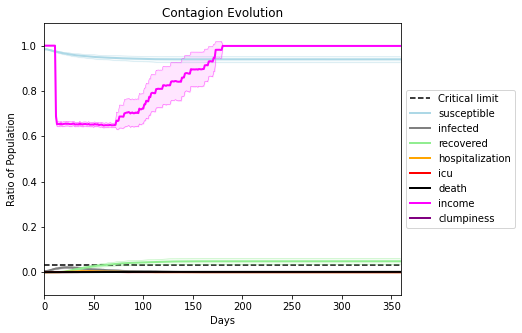

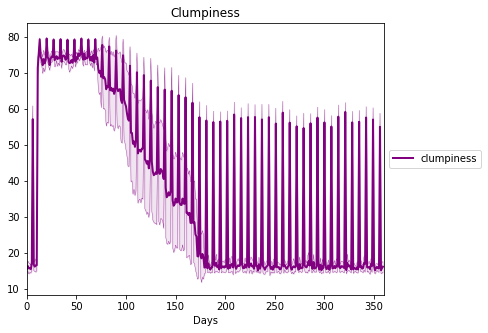

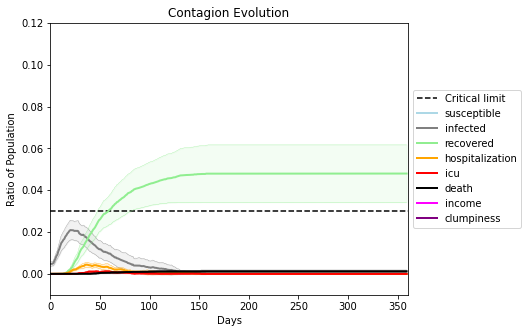

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.997", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[6057, 5132, 7888, 8686, 8085, 7655, 9638, 2665, 6478, 7708, 7815, 5284, 8060, 7750, 2134, 6173, 8705, 2468, 1672, 1906]
Average similarity between family members is 0.984695864217928 at temperature -0.996
Average similarity between family and home is 0.9999003756088348 at temperature -1
Average similarity between students and their classroom is 0.6024396771513639 at temperature -0.996
Average classroom occupancy is 11.833333333333334 and number classrooms is 24
Average similarity between workers is 0.9665674956862609 at temperature -0.996
Average office occupancy is 10.076923076923077 and number offices is 65
Average friend similarity for adults: 0.9946642651117199 for kids: 0.7328317883686976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.4382463632160405
disconnects
0.0
clumpiness 14.57
avg restaurant similarity 0.5860370342452605
disconnects
0.0
clumpiness 14.31
avg restaurant similarity 0.33738381524543354
disconnects
0.0
clumpiness 15.47
avg restaurant similarity 0.5707303585142929
disconnects
0.0
clumpiness 15.92
avg restaurant similarity 0.5433294090150925
disconnects
0.0
clumpiness 14.58
avg restaurant similarity 0.5317325190732307
disconnects
0.0
clumpiness 13.77
avg restaurant similarity 0.4109832010277681
disconnects
0.51
clumpiness 50.05
avg restaurant similarity 0.4074627020036998
disconnects
0.0
clumpiness 14.83
avg restaurant similarity 0.5466263898580098
disconnects
0.0
clumpiness 15.19
avg restaurant similarity 0.5328704441318335
disconnects
0.0
clumpiness 13.87
avg restaurant similarity 0.44560178323621213
disconnects
0.0
clumpiness 16.14
avg restaurant similarity 0.40818794235605405
disconnects
0.89
clumpiness 72.51
avg restaurant similarity 0.3500313381377878
disconnects
0.

disconnects
0.64
clumpiness 56.05
avg restaurant similarity 0.4499999112388675
disconnects
0.0
clumpiness 13.65
avg restaurant similarity 0.6103735286875059
disconnects
0.0
clumpiness 17.1
avg restaurant similarity 0.5496585668269478
disconnects
0.0
clumpiness 15.16
avg restaurant similarity 0.4738779629867563
disconnects
0.0
clumpiness 14.03
avg restaurant similarity 0.4403242824373106
disconnects
0.0
clumpiness 16.2
avg restaurant similarity 0.48764438700818974
disconnects
0.0
clumpiness 14.85
avg restaurant similarity 0.5804138294018188
disconnects
0.63
clumpiness 56.06
avg restaurant similarity 0.5065604921920971
disconnects
0.0
clumpiness 17.09
avg restaurant similarity 0.42721076498114025
disconnects
0.0
clumpiness 16.57
avg restaurant similarity 0.4297146172962412
disconnects
0.0
clumpiness 14.7
avg restaurant similarity 0.3626261722806038
disconnects
0.0
clumpiness 13.82
avg restaurant similarity 0.542296688129772
disconnects
0.0
clumpiness 17.05
avg restaurant similarity 0.545

disconnects
0.57
clumpiness 53.49
avg restaurant similarity 0.6356839117774212
disconnects
0.0
clumpiness 14.08
avg restaurant similarity 0.7247347605852178
disconnects
0.0
clumpiness 17.56
avg restaurant similarity 0.5965767000974341
disconnects
0.0
clumpiness 14.23
avg restaurant similarity 0.6358574705808872
disconnects
0.0
clumpiness 14.66
avg restaurant similarity 0.22483491246497145
disconnects
0.0
clumpiness 15.84
avg restaurant similarity 0.5771600289952783
disconnects
0.0
clumpiness 14.61
avg restaurant similarity 0.40477664138261643
disconnects
0.6
clumpiness 56.05
avg restaurant similarity 0.6299584056135559
disconnects
0.0
clumpiness 15.7
avg restaurant similarity 0.4437931008626691
disconnects
0.0
clumpiness 15.22
avg restaurant similarity 0.5661941074018008
disconnects
0.0
clumpiness 16.19
avg restaurant similarity 0.36961541238263423
disconnects
0.0
clumpiness 14.96
avg restaurant similarity 0.4758650405584215
disconnects
0.0
clumpiness 16.52
avg restaurant similarity 0.

disconnects
0.58
clumpiness 51.71
avg restaurant similarity 0.4065460513577066
disconnects
0.0
clumpiness 16.87
avg restaurant similarity 0.6333894521505878
disconnects
0.0
clumpiness 14.51
avg restaurant similarity 0.4895947760539275
disconnects
0.0
clumpiness 15.41
avg restaurant similarity 0.5538660309002044
disconnects
0.0
clumpiness 14.52
avg restaurant similarity 0.4856689208469865
disconnects
0.0
clumpiness 14.86
avg restaurant similarity 0.3828116207900215
disconnects
0.0
clumpiness 14.44
avg restaurant similarity 0.41431976673961984
disconnects
0.57
clumpiness 51.95
avg restaurant similarity 0.4797896685950901
disconnects
0.0
clumpiness 16.49
avg restaurant similarity 0.4393871357437551
disconnects
0.0
clumpiness 13.83
avg restaurant similarity 0.574410204375345
disconnects
0.0
clumpiness 15.92
avg restaurant similarity 0.3937623064077173
disconnects
0.0
clumpiness 16.24
avg restaurant similarity 0.4050532628855898
disconnects
0.0
clumpiness 14.13
avg restaurant similarity 0.5

avg restaurant similarity 0.5107789329436234
disconnects
0.03
clumpiness 16.67
avg restaurant similarity 0.6078594930361213
disconnects
0.0
clumpiness 13.94
avg restaurant similarity 0.432251509591102
disconnects
0.0
clumpiness 12.36
avg restaurant similarity 0.45805778489072346
disconnects
0.01
clumpiness 13.9
avg restaurant similarity 0.4414030925363431
disconnects
0.0
clumpiness 14.26
avg restaurant similarity 0.501458203592817
disconnects
0.0
clumpiness 13.06
avg restaurant similarity 0.4508346644586045
disconnects
0.58
clumpiness 52.43
avg restaurant similarity 0.357323410444774
disconnects
0.04
clumpiness 16.35
avg restaurant similarity 0.3330563962910641
disconnects
0.01
clumpiness 14.53
avg restaurant similarity 0.4146167314923746
disconnects
0.0
clumpiness 13.76
avg restaurant similarity 0.32496760667852265
disconnects
0.0
clumpiness 13.85
avg restaurant similarity 0.4454907200033713
disconnects
0.85
clumpiness 69.99
avg restaurant similarity 0.5046458642154317
disconnects
0.9

avg restaurant similarity 0.43040591453796284
disconnects
0.9
clumpiness 73.04
avg restaurant similarity 0.38944398059889973
disconnects
0.83
clumpiness 68.59
avg restaurant similarity 0.40096323726469535
disconnects
0.93
clumpiness 75.4
avg restaurant similarity 0.5502881868234465
disconnects
0.83
clumpiness 68.69
avg restaurant similarity 0.44619884504297774
disconnects
0.87
clumpiness 71.71
avg restaurant similarity 0.5064927465101069
disconnects
0.91
clumpiness 73.81
avg restaurant similarity 0.3961247507457438
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.49936906677460335
disconnects
0.0
clumpiness 14.43
avg restaurant similarity 0.595640754553003
disconnects
0.01
clumpiness 14.47
avg restaurant similarity 0.416606401958414
disconnects
0.0
clumpiness 14.88
avg restaurant similarity 0.4794099923427842
disconnects
0.01
clumpiness 14.08
avg restaurant similarity 0.41845880033845295
disconnects
0.0
clumpiness 13.58
avg restaurant similarity 0.2904119694384125
disconne

avg restaurant similarity 0.5370074241258838
disconnects
0.48
clumpiness 45.77
avg restaurant similarity 0.36265767562159107
disconnects
0.02
clumpiness 15.17
avg restaurant similarity 0.3725209150525005
disconnects
0.01
clumpiness 14.81
avg restaurant similarity 0.4490925030845988
disconnects
0.01
clumpiness 13.96
avg restaurant similarity 0.3819045908348124
disconnects
0.0
clumpiness 14.19
avg restaurant similarity 0.4608067898515645
disconnects
0.01
clumpiness 14.76
avg restaurant similarity 0.4153402924204382
disconnects
0.0
clumpiness 13.47
avg restaurant similarity 0.5220730902969035
disconnects
0.6
clumpiness 54.1
avg restaurant similarity 0.4506238563852463
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 0.4218629055591563
disconnects
0.01
clumpiness 13.72
avg restaurant similarity 0.45014488936832553
disconnects
0.0
clumpiness 14.49
avg restaurant similarity 0.4731913903754464
disconnects
0.0
clumpiness 13.51
avg restaurant similarity 0.5113314985929001
disconnects


disconnects
0.0
clumpiness 13.49
avg restaurant similarity 0.4577427669756175
disconnects
0.63
clumpiness 56.17
avg restaurant similarity 0.3989838621457155
disconnects
0.02
clumpiness 14.27
avg restaurant similarity 0.5286921305383344
disconnects
0.02
clumpiness 15.43
avg restaurant similarity 0.3544844788217705
disconnects
0.0
clumpiness 13.05
avg restaurant similarity 0.5934595783309214
disconnects
0.02
clumpiness 15.6
avg restaurant similarity 0.3653633265524935
disconnects
0.0
clumpiness 13.94
avg restaurant similarity 0.4178938680153315
disconnects
0.03
clumpiness 15.08
avg restaurant similarity 0.36189381919167796
disconnects
0.6
clumpiness 54.02
avg restaurant similarity 0.6342338891812696
disconnects
0.01
clumpiness 15.12
avg restaurant similarity 0.5097682804363666
disconnects
0.0
clumpiness 12.84
avg restaurant similarity 0.5371098893129235
disconnects
0.02
clumpiness 15.12
avg restaurant similarity 0.4103936212027197
disconnects
0.0
clumpiness 14.67
avg restaurant similarit

avg restaurant similarity 0.4241820414427045
disconnects
0.01
clumpiness 17.38
avg restaurant similarity 0.4475841443376703
disconnects
0.02
clumpiness 17.19
avg restaurant similarity 0.5121949462216248
disconnects
0.01
clumpiness 18.96
avg restaurant similarity 0.39379861948712325
disconnects
0.0
clumpiness 14.86
avg restaurant similarity 0.4507519818697567
disconnects
0.01
clumpiness 13.93
avg restaurant similarity 0.43638883789266036
disconnects
0.03
clumpiness 15.67
avg restaurant similarity 0.45976381830828617
disconnects
0.83
clumpiness 68.23
avg restaurant similarity 0.48418008221964487
disconnects
0.03
clumpiness 15.94
avg restaurant similarity 0.5594240027787213
disconnects
0.01
clumpiness 16.78
avg restaurant similarity 0.5245308688297061
disconnects
0.04
clumpiness 19.96
avg restaurant similarity 0.41496615688732674
disconnects
0.03
clumpiness 16.65
avg restaurant similarity 0.4121924525707305
disconnects
0.8
clumpiness 66.75
avg restaurant similarity 0.42682248625694624
dis

avg restaurant similarity 0.5598490651661103
disconnects
0.59
clumpiness 52.51
avg restaurant similarity 0.5799790856172978
disconnects
0.01
clumpiness 15.77
avg restaurant similarity 0.39945707817644005
disconnects
0.0
clumpiness 16.7
avg restaurant similarity 0.41417281541648243
disconnects
0.03
clumpiness 17.38
avg restaurant similarity 0.41646402633513885
disconnects
0.0
clumpiness 15.21
avg restaurant similarity 0.45771020881169444
disconnects
0.01
clumpiness 17.38
avg restaurant similarity 0.3684589860179306
disconnects
0.03
clumpiness 18.65
avg restaurant similarity 0.4688555319105865
disconnects
0.74
clumpiness 62.27
avg restaurant similarity 0.4658197698240221
disconnects
0.02
clumpiness 14.79
avg restaurant similarity 0.4520812483847737
disconnects
0.0
clumpiness 14.68
avg restaurant similarity 0.46143544492669547
disconnects
0.02
clumpiness 16.65
avg restaurant similarity 0.5276444874262997
disconnects
0.02
clumpiness 15.43
avg restaurant similarity 0.5854615695945301
discon

avg restaurant similarity 0.5462722629100564
disconnects
0.03
clumpiness 18.03
avg restaurant similarity 0.4138809733578626
disconnects
0.62
clumpiness 54.49
avg restaurant similarity 0.4814363933059505
disconnects
0.01
clumpiness 18.71
avg restaurant similarity 0.5718962982262573
disconnects
0.02
clumpiness 17.64
avg restaurant similarity 0.5126897264288813
disconnects
0.04
clumpiness 19.61
avg restaurant similarity 0.41324429793754697
disconnects
0.01
clumpiness 16.86
avg restaurant similarity 0.47158146424688413
disconnects
0.02
clumpiness 18.96
avg restaurant similarity 0.5522849682856592
disconnects
0.0
clumpiness 15.41
avg restaurant similarity 0.586881371365067
disconnects
0.7
clumpiness 59.8
avg restaurant similarity 0.520658319409965
disconnects
0.04
clumpiness 17.5
avg restaurant similarity 0.5183628852909444
disconnects
0.01
clumpiness 16.67
avg restaurant similarity 0.6812936184897787
disconnects
0.01
clumpiness 17.8
avg restaurant similarity 0.46765646760381596
disconnects

avg restaurant similarity 0.5585934881845992
disconnects
0.02
clumpiness 16.64
avg restaurant similarity 0.470902034092947
disconnects
0.01
clumpiness 19.47
avg restaurant similarity 0.40124523834484244
disconnects
0.65
clumpiness 56.16
avg restaurant similarity 0.43817788763734383
disconnects
0.01
clumpiness 16.51
avg restaurant similarity 0.41872073937167364
disconnects
0.01
clumpiness 16.42
avg restaurant similarity 0.5233672454465895
disconnects
0.04
clumpiness 21.13
avg restaurant similarity 0.5281355736729488
disconnects
0.0
clumpiness 15.18
avg restaurant similarity 0.46801006895252195
disconnects
0.01
clumpiness 18.22
avg restaurant similarity 0.3877479245302518
disconnects
0.01
clumpiness 15.86
avg restaurant similarity 0.4605687522776648
disconnects
0.58
clumpiness 51.87
avg restaurant similarity 0.4288626230420886
disconnects
0.01
clumpiness 15.88
avg restaurant similarity 0.5929344060439494
disconnects
0.01
clumpiness 15.91
avg restaurant similarity 0.4418385302341747
disco

avg restaurant similarity 0.6539898969994226
disconnects
0.0
clumpiness 13.29
avg restaurant similarity 0.5629745225548867
disconnects
0.01
clumpiness 13.04
avg restaurant similarity 0.6945818321805785
disconnects
0.02
clumpiness 14.51
avg restaurant similarity 0.46870513608937514
disconnects
0.02
clumpiness 13.61
avg restaurant similarity 0.6235892442873121
disconnects
0.0
clumpiness 13.82
avg restaurant similarity 0.5214037766030641
disconnects
0.01
clumpiness 12.85
avg restaurant similarity 0.6556532526806762
disconnects
0.43
clumpiness 45.37
avg restaurant similarity 0.5357296540370361
disconnects
0.0
clumpiness 13.18
avg restaurant similarity 0.6847235246915016
disconnects
0.02
clumpiness 14.2
avg restaurant similarity 0.45823713576177594
disconnects
0.01
clumpiness 13.93
avg restaurant similarity 0.573078489168413
disconnects
0.01
clumpiness 13.14
avg restaurant similarity 0.6464880357129963
disconnects
0.86
clumpiness 71.4
avg restaurant similarity 0.5425712514389543
disconnects

avg restaurant similarity 0.44787544067456875
disconnects
0.87
clumpiness 71.24
avg restaurant similarity 0.43576290042201477
disconnects
0.84
clumpiness 69.3
avg restaurant similarity 0.43090136284813985
disconnects
0.92
clumpiness 74.19
avg restaurant similarity 0.46671859206688066
disconnects
0.73
clumpiness 61.93
avg restaurant similarity 0.48771412493937955
disconnects
0.92
clumpiness 74.35
avg restaurant similarity 0.6239385241029739
disconnects
0.87
clumpiness 70.88
avg restaurant similarity 0.6918633275013288
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.6318878102896994
disconnects
0.88
clumpiness 71.94
avg restaurant similarity 0.4474259665637939
disconnects
0.88
clumpiness 71.68
avg restaurant similarity 0.5632475740982246
disconnects
0.82
clumpiness 67.66
avg restaurant similarity 0.56944640228359
disconnects
0.91
clumpiness 73.52
avg restaurant similarity 0.47977618890268825
disconnects
0.86
clumpiness 70.46
avg restaurant similarity 0.5924185428627939
disc

disconnects
0.39
clumpiness 41.02
avg restaurant similarity 0.6567426780906999
disconnects
0.01
clumpiness 13.68
avg restaurant similarity 0.5145593401624128
disconnects
0.04
clumpiness 16.32
avg restaurant similarity 0.3744661676346873
disconnects
0.04
clumpiness 15.79
avg restaurant similarity 0.535522164761763
disconnects
0.01
clumpiness 13.15
avg restaurant similarity 0.6953242943174115
disconnects
0.0
clumpiness 12.72
avg restaurant similarity 0.6120022019137105
disconnects
0.0
clumpiness 12.64
avg restaurant similarity 0.6207058434848226
disconnects
0.57
clumpiness 51.88
avg restaurant similarity 0.61088224824371
disconnects
0.02
clumpiness 14.05
avg restaurant similarity 0.6626419313014087
disconnects
0.0
clumpiness 13.64
avg restaurant similarity 0.48061445071313136
disconnects
0.0
clumpiness 12.89
avg restaurant similarity 0.45280234450739193
disconnects
0.01
clumpiness 13.85
avg restaurant similarity 0.4609694983124558
disconnects
0.0
clumpiness 12.74
avg restaurant similarit

avg restaurant similarity 0.5518426178577183
disconnects
0.5
clumpiness 47.41
avg restaurant similarity 0.49266034734617514
disconnects
0.01
clumpiness 13.22
avg restaurant similarity 0.5214182417051725
disconnects
0.01
clumpiness 13.17
avg restaurant similarity 0.5516805395846331
disconnects
0.0
clumpiness 12.6
avg restaurant similarity 0.5154229615212371
disconnects
0.0
clumpiness 12.52
avg restaurant similarity 0.6598627020782033
disconnects
0.02
clumpiness 13.52
avg restaurant similarity 0.6211130888176131
disconnects
0.03
clumpiness 14.68
avg restaurant similarity 0.5088211224431879
disconnects
0.41
clumpiness 42.26
avg restaurant similarity 0.49765814756193627
disconnects
0.0
clumpiness 12.1
avg restaurant similarity 0.535134610146268
disconnects
0.02
clumpiness 14.17
avg restaurant similarity 0.4957135371046061
disconnects
0.01
clumpiness 14.8
avg restaurant similarity 0.4635325295665384
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.5992059776574143
disconnects
0.

avg restaurant similarity 0.6255731015168744
disconnects
0.0
clumpiness 13.83
avg restaurant similarity 0.6855013748785959
disconnects
0.0
clumpiness 14.43
avg restaurant similarity 0.7761451617553874
disconnects
0.0
clumpiness 14.54
avg restaurant similarity 0.7548759559178191
disconnects
0.0
clumpiness 13.48
avg restaurant similarity 0.7179050314142823
disconnects
0.0
clumpiness 14.83
avg restaurant similarity 0.9669663329260499
disconnects
0.0
clumpiness 14.6
avg restaurant similarity 0.6223416295893606
disconnects
0.78
clumpiness 65.25
avg restaurant similarity 0.6341615077396517
disconnects
0.0
clumpiness 15.09
avg restaurant similarity 0.8433687209473183
disconnects
0.0
clumpiness 14.6
avg restaurant similarity 0.7259683976471383
disconnects
0.0
clumpiness 16.45
avg restaurant similarity 0.955252384419317
disconnects
0.0
clumpiness 13.84
avg restaurant similarity 0.6097613722171196
disconnects
0.95
clumpiness 76.59
avg restaurant similarity 0.617909275633407
disconnects
0.96
clum

avg restaurant similarity 0.7260252130601361
disconnects
0.95
clumpiness 76.35
avg restaurant similarity 0.8380167387847518
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.9241964754651532
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.7473936957447176
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.6522296216782026
disconnects
0.97
clumpiness 77.73
avg restaurant similarity 0.6463199444655852
disconnects
0.96
clumpiness 77.24
avg restaurant similarity 0.6801086320398454
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.7715899417141747
disconnects
0.93
clumpiness 74.95
avg restaurant similarity 0.9041491225534171
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.8559670033197297
disconnects
0.95
clumpiness 76.47
avg restaurant similarity 0.7518466594734516
disconnects
0.91
clumpiness 73.85
avg restaurant similarity 0.8153761575400952
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.8549330753715014
disconnects

avg restaurant similarity 0.7641117777454276
disconnects
0.0
clumpiness 15.24
avg restaurant similarity 0.7217331374809945
disconnects
0.0
clumpiness 15.38
avg restaurant similarity 0.7950412992736133
disconnects
0.0
clumpiness 15.17
avg restaurant similarity 0.9542368377826633
disconnects
0.0
clumpiness 16.13
avg restaurant similarity 0.7982700162533715
disconnects
0.0
clumpiness 15.59
avg restaurant similarity 0.7648391880629423
disconnects
0.0
clumpiness 14.89
avg restaurant similarity 0.7643234927886015
disconnects
0.91
clumpiness 73.82
avg restaurant similarity 0.7078990680521937
disconnects
0.0
clumpiness 14.77
avg restaurant similarity 0.6155891118471702
disconnects
0.0
clumpiness 15.19
avg restaurant similarity 0.8335068201320947
disconnects
0.0
clumpiness 14.15
avg restaurant similarity 0.9313857068149614
disconnects
0.0
clumpiness 14.62
avg restaurant similarity 0.7178556177071742
disconnects
0.0
clumpiness 14.97
avg restaurant similarity 0.9359508520229207
disconnects
0.0
cl

disconnects
0.0
clumpiness 15.15
avg restaurant similarity 0.7888498724799651
disconnects
0.0
clumpiness 15.2
avg restaurant similarity 0.7729061042226831
disconnects
0.0
clumpiness 15.1
avg restaurant similarity 0.6933608434268678
disconnects
0.0
clumpiness 14.54
avg restaurant similarity 0.9526662636172594
disconnects
0.0
clumpiness 15.28
avg restaurant similarity 0.5895171029245363
disconnects
0.0
clumpiness 13.87
avg restaurant similarity 0.7919156773194198
disconnects
0.8
clumpiness 66.28
avg restaurant similarity 0.7803304329309043
disconnects
0.0
clumpiness 13.35
avg restaurant similarity 0.8329321375226205
disconnects
0.0
clumpiness 14.95
avg restaurant similarity 0.5747530264134139
disconnects
0.0
clumpiness 14.24
avg restaurant similarity 0.5807898502502459
disconnects
0.0
clumpiness 13.87
avg restaurant similarity 0.8769300101518932
disconnects
0.0
clumpiness 15.49
avg restaurant similarity 0.8361377675959034
disconnects
0.0
clumpiness 13.77
avg restaurant similarity 0.74891

avg restaurant similarity 0.676302761445708
disconnects
0.01
clumpiness 13.73
avg restaurant similarity 0.6131754349009787
disconnects
0.0
clumpiness 13.29
avg restaurant similarity 0.6218188346472698
disconnects
0.0
clumpiness 14.65
avg restaurant similarity 0.5347751868708563
disconnects
0.0
clumpiness 12.69
avg restaurant similarity 0.517082609856542
disconnects
0.0
clumpiness 13.48
avg restaurant similarity 0.5673657178163991
disconnects
0.0
clumpiness 13.44
avg restaurant similarity 0.4537255983938563
disconnects
0.54
clumpiness 50.29
avg restaurant similarity 0.5532967318923624
disconnects
0.0
clumpiness 13.72
avg restaurant similarity 0.5760219271903518
disconnects
0.03
clumpiness 15.34
avg restaurant similarity 0.6436151341209209
disconnects
0.0
clumpiness 13.57
avg restaurant similarity 0.7708272287357929
disconnects
0.0
clumpiness 14.01
avg restaurant similarity 0.5892493036261053
disconnects
0.82
clumpiness 67.5
avg restaurant similarity 0.4844383113136862
disconnects
0.92
c

avg restaurant similarity 0.5816931206486166
disconnects
0.91
clumpiness 74.31
avg restaurant similarity 0.5565098885308426
disconnects
0.93
clumpiness 75.31
avg restaurant similarity 0.564198279289946
disconnects
0.92
clumpiness 74.83
avg restaurant similarity 0.5698404469430636
disconnects
0.94
clumpiness 75.72
avg restaurant similarity 0.6018047723406865
disconnects
0.86
clumpiness 70.76
avg restaurant similarity 0.5934866662554252
disconnects
0.87
clumpiness 70.78
avg restaurant similarity 0.6287495131430049
disconnects
0.97
clumpiness 77.72
avg restaurant similarity 0.5590054217237663
disconnects
0.9
clumpiness 73.79
avg restaurant similarity 0.42259638790625303
disconnects
0.86
clumpiness 70.41
avg restaurant similarity 0.6000307692023047
disconnects
0.85
clumpiness 69.71
avg restaurant similarity 0.5338781278230587
disconnects
0.82
clumpiness 67.49
avg restaurant similarity 0.5545514081789873
disconnects
0.73
clumpiness 62.81
avg restaurant similarity 0.677941203805486
disconnec

avg restaurant similarity 0.5035898773612445
disconnects
0.02
clumpiness 14.72
avg restaurant similarity 0.4620760935501235
disconnects
0.01
clumpiness 14.01
avg restaurant similarity 0.5685771958876156
disconnects
0.01
clumpiness 13.21
avg restaurant similarity 0.6358214320307344
disconnects
0.01
clumpiness 14.7
avg restaurant similarity 0.6608615548724106
disconnects
0.01
clumpiness 13.91
avg restaurant similarity 0.6647766094487908
disconnects
0.01
clumpiness 13.69
avg restaurant similarity 0.5642760423604621
disconnects
0.66
clumpiness 58.85
avg restaurant similarity 0.676804078447978
disconnects
0.0
clumpiness 13.42
avg restaurant similarity 0.5915765136094617
disconnects
0.0
clumpiness 14.42
avg restaurant similarity 0.5334501788746643
disconnects
0.0
clumpiness 13.67
avg restaurant similarity 0.6242429472692517
disconnects
0.02
clumpiness 15.28
avg restaurant similarity 0.6222359106921851
disconnects
0.02
clumpiness 14.75
avg restaurant similarity 0.5370836064740132
disconnects


disconnects
0.65
clumpiness 56.98
avg restaurant similarity 0.576718900316297
disconnects
0.01
clumpiness 13.05
avg restaurant similarity 0.465749428913327
disconnects
0.03
clumpiness 15.11
avg restaurant similarity 0.5446002000063594
disconnects
0.0
clumpiness 13.4
avg restaurant similarity 0.6907130008725931
disconnects
0.03
clumpiness 15.13
avg restaurant similarity 0.5366393550005283
disconnects
0.0
clumpiness 13.04
avg restaurant similarity 0.732605959557595
disconnects
0.01
clumpiness 14.77
avg restaurant similarity 0.5530682212375659
disconnects
0.67
clumpiness 58.18
avg restaurant similarity 0.593537587020684
disconnects
0.0
clumpiness 13.94
avg restaurant similarity 0.5295183678388037
disconnects
0.0
clumpiness 12.82
avg restaurant similarity 0.5586670090148549
disconnects
0.0
clumpiness 13.29
avg restaurant similarity 0.5820080743422116
disconnects
0.04
clumpiness 15.33
avg restaurant similarity 0.5800089075778246
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 0.6

avg restaurant similarity 0.6342084767628974
disconnects
0.01
clumpiness 14.13
avg restaurant similarity 0.7371168863315891
disconnects
0.01
clumpiness 15.2
avg restaurant similarity 0.6584161745301842
disconnects
0.01
clumpiness 14.73
avg restaurant similarity 0.4635763635216117
disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.5966013230063727
disconnects
0.02
clumpiness 16.79
avg restaurant similarity 0.5625536743728331
disconnects
0.02
clumpiness 15.49
avg restaurant similarity 0.5665794859212954
disconnects
0.59
clumpiness 55.23
avg restaurant similarity 0.5184912755507054
disconnects
0.0
clumpiness 15.38
avg restaurant similarity 0.5822647025733089
disconnects
0.0
clumpiness 14.76
avg restaurant similarity 0.5227554117316953
disconnects
0.0
clumpiness 14.72
avg restaurant similarity 0.5064346753417892
disconnects
0.02
clumpiness 17.1
avg restaurant similarity 0.5465584228361109
disconnects
0.85
clumpiness 69.97
avg restaurant similarity 0.6174459589998914
disconnects
0

avg restaurant similarity 0.6178865784529919
disconnects
0.92
clumpiness 74.55
avg restaurant similarity 0.49471601685237965
disconnects
0.0
clumpiness 15.54
avg restaurant similarity 0.6861835329932332
disconnects
0.0
clumpiness 14.92
avg restaurant similarity 0.5938051752863046
disconnects
0.02
clumpiness 15.97
avg restaurant similarity 0.7193067590153618
disconnects
0.01
clumpiness 16.06
avg restaurant similarity 0.5886762157376924
disconnects
0.01
clumpiness 14.66
avg restaurant similarity 0.5079816213380786
disconnects
0.54
clumpiness 51.39
avg restaurant similarity 0.7113167270006903
disconnects
0.01
clumpiness 15.77
avg restaurant similarity 0.5897892691639023
disconnects
0.02
clumpiness 15.37
avg restaurant similarity 0.666576256012211
disconnects
0.0
clumpiness 14.71
avg restaurant similarity 0.76661638625231
disconnects
0.0
clumpiness 15.16
avg restaurant similarity 0.5994471106553152
disconnects
0.0
clumpiness 14.41
avg restaurant similarity 0.42147318258918426
disconnects
0

disconnects
0.48
clumpiness 47.19
avg restaurant similarity 0.6047718625544742
disconnects
0.0
clumpiness 15.53
avg restaurant similarity 0.6629249574886343
disconnects
0.0
clumpiness 13.77
avg restaurant similarity 0.7220474139162915
disconnects
0.0
clumpiness 14.46
avg restaurant similarity 0.5851238326100667
disconnects
0.0
clumpiness 13.41
avg restaurant similarity 0.5207314669445201
disconnects
0.01
clumpiness 14.38
avg restaurant similarity 0.594588362345576
disconnects
0.01
clumpiness 14.86
avg restaurant similarity 0.6232363896242173
disconnects
0.52
clumpiness 51.8
avg restaurant similarity 0.4915777835260082
disconnects
0.0
clumpiness 14.78
avg restaurant similarity 0.7970822421358603
disconnects
0.01
clumpiness 15.57
avg restaurant similarity 0.731488776606777
disconnects
0.02
clumpiness 15.82
avg restaurant similarity 0.634832432448912
disconnects
0.02
clumpiness 16.92
avg restaurant similarity 0.5662188776750758
disconnects
0.01
clumpiness 16.15
avg restaurant similarity 0

disconnects
0.7
clumpiness 60.61
avg restaurant similarity 0.45770563938107384
disconnects
0.01
clumpiness 16.05
avg restaurant similarity 0.6785680696753307
disconnects
0.0
clumpiness 14.39
avg restaurant similarity 0.7258207669171631
disconnects
0.0
clumpiness 13.79
avg restaurant similarity 0.5052524894955993
disconnects
0.01
clumpiness 15.15
avg restaurant similarity 0.5851516185321692
disconnects
0.0
clumpiness 14.19
avg restaurant similarity 0.4628913162452331
disconnects
0.0
clumpiness 14.83
avg restaurant similarity 0.6807453797454551
disconnects
0.53
clumpiness 50.1
avg restaurant similarity 0.6074328965449185
disconnects
0.0
clumpiness 13.76
avg restaurant similarity 0.6802361390941889
disconnects
0.0
clumpiness 14.2
avg restaurant similarity 0.7448967846849978
disconnects
0.0
clumpiness 14.69
avg restaurant similarity 0.6392701594135608
disconnects
0.0
clumpiness 14.74
avg restaurant similarity 0.6049373628933175
disconnects
0.0
clumpiness 14.51
avg restaurant similarity 0.6

avg restaurant similarity 0.5966489759649909
disconnects
0.06
clumpiness 16.92
avg restaurant similarity 0.6057816589860797
disconnects
0.05
clumpiness 17.14
avg restaurant similarity 0.4819704830999541
disconnects
0.02
clumpiness 14.13
avg restaurant similarity 0.5240458535825883
disconnects
0.01
clumpiness 14.74
avg restaurant similarity 0.5011805103898485
disconnects
0.03
clumpiness 13.78
avg restaurant similarity 0.6170150078045765
disconnects
0.03
clumpiness 15.0
avg restaurant similarity 0.5027706806111267
disconnects
0.45
clumpiness 46.54
avg restaurant similarity 0.6495186236103675
disconnects
0.04
clumpiness 16.13
avg restaurant similarity 0.6253152309390684
disconnects
0.03
clumpiness 15.11
avg restaurant similarity 0.5442238557069551
disconnects
0.04
clumpiness 17.11
avg restaurant similarity 0.5559816612858671
disconnects
0.01
clumpiness 14.31
avg restaurant similarity 0.5310074779242554
disconnects
0.66
clumpiness 60.04
avg restaurant similarity 0.49476097908922817
disconn

avg restaurant similarity 0.4954967717823743
disconnects
0.98
clumpiness 78.51
avg restaurant similarity 0.7047373622314267
disconnects
0.82
clumpiness 67.28
avg restaurant similarity 0.6323438494491865
disconnects
0.86
clumpiness 70.47
avg restaurant similarity 0.6002598314450212
disconnects
0.78
clumpiness 66.51
avg restaurant similarity 0.468896111795978
disconnects
0.68
clumpiness 58.85
avg restaurant similarity 0.5644892915573249
disconnects
0.84
clumpiness 68.96
avg restaurant similarity 0.5423779070485598
disconnects
0.77
clumpiness 64.88
avg restaurant similarity 0.5325461849585938
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.452863390169614
disconnects
0.82
clumpiness 68.25
avg restaurant similarity 0.6965961224960385
disconnects
0.65
clumpiness 58.58
avg restaurant similarity 0.5661185946590994
disconnects
0.83
clumpiness 69.38
avg restaurant similarity 0.4917564860784566
disconnects
0.62
clumpiness 56.31
avg restaurant similarity 0.5981860024237056
disconnects

avg restaurant similarity 0.455784948215877
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.5150914744533464
disconnects
0.73
clumpiness 63.36
avg restaurant similarity 0.6364475216005472
disconnects
0.59
clumpiness 54.86
avg restaurant similarity 0.5593662627183537
disconnects
0.82
clumpiness 67.8
avg restaurant similarity 0.4936541175302442
disconnects
0.65
clumpiness 57.54
avg restaurant similarity 0.6374766273957939
disconnects
0.91
clumpiness 73.81
avg restaurant similarity 0.5595165180541605
disconnects
0.66
clumpiness 61.63
avg restaurant similarity 0.5531013817945993
disconnects
0.96
clumpiness 77.06
avg restaurant similarity 0.48176409053739133
disconnects
0.73
clumpiness 63.13
avg restaurant similarity 0.5072261094144762
disconnects
0.8
clumpiness 66.67
avg restaurant similarity 0.5637276064403612
disconnects
0.66
clumpiness 58.43
avg restaurant similarity 0.4707863673910907
disconnects
0.72
clumpiness 62.5
avg restaurant similarity 0.5100842698672761
disconnect

disconnects
0.04
clumpiness 16.45
avg restaurant similarity 0.5688130557721419
disconnects
0.59
clumpiness 53.8
avg restaurant similarity 0.5656898813944423
disconnects
0.03
clumpiness 15.69
avg restaurant similarity 0.5964445248125897
disconnects
0.01
clumpiness 14.77
avg restaurant similarity 0.4955700270658128
disconnects
0.05
clumpiness 15.96
avg restaurant similarity 0.586816492872328
disconnects
0.03
clumpiness 15.48
avg restaurant similarity 0.5459083180109754
disconnects
0.01
clumpiness 13.64
avg restaurant similarity 0.6505977940826279
disconnects
0.01
clumpiness 13.35
avg restaurant similarity 0.6034187848572066
disconnects
0.49
clumpiness 46.73
avg restaurant similarity 0.6530550190636116
disconnects
0.04
clumpiness 15.45
avg restaurant similarity 0.5702433336529252
disconnects
0.02
clumpiness 13.99
avg restaurant similarity 0.5283822568789228
disconnects
0.03
clumpiness 14.65
avg restaurant similarity 0.47195043783138446
disconnects
0.02
clumpiness 14.58
avg restaurant simi

avg restaurant similarity 0.6444180480139436
disconnects
0.1
clumpiness 21.71
avg restaurant similarity 0.5126757605960006
disconnects
0.04
clumpiness 16.53
avg restaurant similarity 0.6759174349320408
disconnects
0.11
clumpiness 20.53
avg restaurant similarity 0.7026853000319448
disconnects
0.08
clumpiness 20.5
avg restaurant similarity 0.5200008238494215
disconnects
0.11
clumpiness 20.52
avg restaurant similarity 0.5883652324752334
disconnects
0.08
clumpiness 21.75
avg restaurant similarity 0.6258427208353887
disconnects
0.68
clumpiness 59.78
avg restaurant similarity 0.6612944962290314
disconnects
0.06
clumpiness 17.9
avg restaurant similarity 0.5865064300920472
disconnects
0.08
clumpiness 20.04
avg restaurant similarity 0.540034135770701
disconnects
0.09
clumpiness 19.18
avg restaurant similarity 0.4727020884029064
disconnects
0.06
clumpiness 18.6
avg restaurant similarity 0.5203779101521627
disconnects
0.86
clumpiness 71.19
avg restaurant similarity 0.6118992479994169
disconnects


disconnects
0.73
clumpiness 61.7
avg restaurant similarity 0.7002439141492566
disconnects
0.13
clumpiness 22.28
avg restaurant similarity 0.46865229899915994
disconnects
0.05
clumpiness 16.34
avg restaurant similarity 0.4941509348043662
disconnects
0.11
clumpiness 20.74
avg restaurant similarity 0.5921699828102457
disconnects
0.0
clumpiness 16.31
avg restaurant similarity 0.6496292391144547
disconnects
0.08
clumpiness 20.07
avg restaurant similarity 0.5913796657198609
disconnects
0.08
clumpiness 18.59
avg restaurant similarity 0.6108123815994091
disconnects
0.6
clumpiness 54.09
avg restaurant similarity 0.6881439144451156
disconnects
0.07
clumpiness 19.49
avg restaurant similarity 0.581043813224334
disconnects
0.09
clumpiness 20.07
avg restaurant similarity 0.6722169159453958
disconnects
0.0
clumpiness 14.91
avg restaurant similarity 0.6479578988884905
disconnects
0.06
clumpiness 18.7
avg restaurant similarity 0.6245269803368091
disconnects
0.08
clumpiness 20.36
avg restaurant similari

avg restaurant similarity 0.5772500588371715
disconnects
0.76
clumpiness 63.95
avg restaurant similarity 0.577722119365706
disconnects
0.07
clumpiness 18.08
avg restaurant similarity 0.5814871068374197
disconnects
0.15
clumpiness 24.81
avg restaurant similarity 0.6175157478067737
disconnects
0.09
clumpiness 19.22
avg restaurant similarity 0.6866575063225588
disconnects
0.12
clumpiness 21.15
avg restaurant similarity 0.6745894196780269
disconnects
0.08
clumpiness 18.65
avg restaurant similarity 0.5876562767528575
disconnects
0.08
clumpiness 18.94
avg restaurant similarity 0.5342121455021278
disconnects
0.85
clumpiness 69.96
avg restaurant similarity 0.5677482974159771
disconnects
0.17
clumpiness 25.37
avg restaurant similarity 0.5878081838711604
disconnects
0.0
clumpiness 14.79
avg restaurant similarity 0.6493077734044588
disconnects
0.03
clumpiness 16.23
avg restaurant similarity 0.7119239791333952
disconnects
0.1
clumpiness 19.38
avg restaurant similarity 0.5611484920004361
disconnect

avg restaurant similarity 0.4846236624661749
disconnects
0.18
clumpiness 24.35
avg restaurant similarity 0.5444133132297526
disconnects
0.01
clumpiness 14.16
avg restaurant similarity 0.4818567216613945
disconnects
0.11
clumpiness 19.57
avg restaurant similarity 0.5193360344825335
disconnects
0.01
clumpiness 14.17
avg restaurant similarity 0.5793906846082281
disconnects
0.01
clumpiness 15.06
avg restaurant similarity 0.42320606436032
disconnects
0.1
clumpiness 19.2
avg restaurant similarity 0.6106975774308182
disconnects
0.64
clumpiness 56.97
avg restaurant similarity 0.6361974544412015
disconnects
0.15
clumpiness 23.71
avg restaurant similarity 0.5148075926839976
disconnects
0.05
clumpiness 15.93
avg restaurant similarity 0.6154649210462092
disconnects
0.01
clumpiness 14.12
avg restaurant similarity 0.45206593241386844
disconnects
0.08
clumpiness 17.89
avg restaurant similarity 0.5027864938979912
disconnects
0.92
clumpiness 74.27
avg restaurant similarity 0.5774175766702568
disconnect

disconnects
0.56
clumpiness 51.83
avg restaurant similarity 0.5067536209115614
disconnects
0.11
clumpiness 19.92
avg restaurant similarity 0.5608046732821296
disconnects
0.01
clumpiness 13.73
avg restaurant similarity 0.5215893898707599
disconnects
0.12
clumpiness 21.23
avg restaurant similarity 0.6040852263830566
disconnects
0.02
clumpiness 14.34
avg restaurant similarity 0.6174363910671623
disconnects
0.01
clumpiness 14.26
avg restaurant similarity 0.5672168466234224
disconnects
0.11
clumpiness 19.89
avg restaurant similarity 0.5446714360801012
disconnects
0.55
clumpiness 50.85
avg restaurant similarity 0.6035304263516205
disconnects
0.12
clumpiness 22.02
avg restaurant similarity 0.4677351203199289
disconnects
0.01
clumpiness 13.5
avg restaurant similarity 0.4943244264577452
disconnects
0.11
clumpiness 21.06
avg restaurant similarity 0.5374468870590338
disconnects
0.08
clumpiness 18.17
avg restaurant similarity 0.5290641266798067
disconnects
0.01
clumpiness 15.07
avg restaurant simi

avg restaurant similarity 0.4872172676222229
disconnects
0.62
clumpiness 55.07
avg restaurant similarity 0.5209659479533667
disconnects
0.16
clumpiness 24.22
avg restaurant similarity 0.5432051807174844
disconnects
0.19
clumpiness 24.78
avg restaurant similarity 0.6146449695473891
disconnects
0.0
clumpiness 13.68
avg restaurant similarity 0.5416812801252584
disconnects
0.11
clumpiness 20.52
avg restaurant similarity 0.5715284099583167
disconnects
0.12
clumpiness 20.49
avg restaurant similarity 0.5736545631959905
disconnects
0.02
clumpiness 14.45
avg restaurant similarity 0.5177500562296994
disconnects
0.58
clumpiness 52.55
avg restaurant similarity 0.49167400058398314
disconnects
0.09
clumpiness 18.67
avg restaurant similarity 0.5275034769717833
disconnects
0.07
clumpiness 17.1
avg restaurant similarity 0.6515970143687613
disconnects
0.12
clumpiness 21.33
avg restaurant similarity 0.6600384502755683
disconnects
0.01
clumpiness 13.31
avg restaurant similarity 0.5795861178489254
disconne

avg restaurant similarity 0.555136660919326
disconnects
0.01
clumpiness 13.78
avg restaurant similarity 0.6052950781175035
disconnects
0.6
clumpiness 54.52
avg restaurant similarity 0.5818598632989801
disconnects
0.03
clumpiness 15.09
avg restaurant similarity 0.4514529968975773
disconnects
0.08
clumpiness 17.77
avg restaurant similarity 0.5273591853487352
disconnects
0.11
clumpiness 19.87
avg restaurant similarity 0.5512237118375076
disconnects
0.01
clumpiness 14.44
avg restaurant similarity 0.6620425465940658
disconnects
0.07
clumpiness 17.42
avg restaurant similarity 0.49763917133679164
disconnects
0.0
clumpiness 13.84
avg restaurant similarity 0.6100037294300786
disconnects
0.56
clumpiness 50.93
avg restaurant similarity 0.5355399763967219
disconnects
0.1
clumpiness 19.33
avg restaurant similarity 0.5832642613026572
disconnects
0.08
clumpiness 18.67
avg restaurant similarity 0.49062101536220376
disconnects
0.1
clumpiness 19.51
avg restaurant similarity 0.48686413089116976
disconnec

avg restaurant similarity 0.4516582689814885
disconnects
0.0
clumpiness 12.86
avg restaurant similarity 0.4160508668793836
disconnects
0.0
clumpiness 12.43
avg restaurant similarity 0.5735719748345035
disconnects
0.0
clumpiness 12.36
avg restaurant similarity 0.6469369087113673
disconnects
0.0
clumpiness 12.29
avg restaurant similarity 0.4349904420627125
disconnects
0.01
clumpiness 13.55
avg restaurant similarity 0.5226809225447098
disconnects
0.0
clumpiness 12.05
avg restaurant similarity 0.5202903767056489
disconnects
0.56
clumpiness 51.0
avg restaurant similarity 0.4675221554024102
disconnects
0.0
clumpiness 12.6
avg restaurant similarity 0.5663893909385272
disconnects
0.0
clumpiness 12.33
avg restaurant similarity 0.45942830164515286
disconnects
0.0
clumpiness 12.91
avg restaurant similarity 0.4263223219897533
disconnects
0.02
clumpiness 13.81
avg restaurant similarity 0.4879951556498338
disconnects
0.84
clumpiness 69.01
avg restaurant similarity 0.5379000312284791
disconnects
0.8


avg restaurant similarity 0.5877569494977221
disconnects
0.93
clumpiness 75.59
avg restaurant similarity 0.5504098034173083
disconnects
0.94
clumpiness 76.04
avg restaurant similarity 0.6239991473152017
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.414253581700299
disconnects
0.91
clumpiness 73.96
avg restaurant similarity 0.519072729093974
disconnects
0.96
clumpiness 77.01
avg restaurant similarity 0.4757770613413837
disconnects
0.85
clumpiness 70.28
avg restaurant similarity 0.6479318066504487
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.5019636062886246
disconnects
0.83
clumpiness 68.45
avg restaurant similarity 0.5649997821901498
disconnects
0.76
clumpiness 64.08
avg restaurant similarity 0.47656862405415534
disconnects
0.82
clumpiness 68.23
avg restaurant similarity 0.557865342746077
disconnects
0.85
clumpiness 69.92
avg restaurant similarity 0.5537313946864741
disconnects
0.89
clumpiness 72.43
avg restaurant similarity 0.5655139000380329
disconnect

disconnects
0.53
clumpiness 49.53
avg restaurant similarity 0.665814034284639
disconnects
0.0
clumpiness 12.25
avg restaurant similarity 0.48354218731139065
disconnects
0.01
clumpiness 12.65
avg restaurant similarity 0.5471313856950739
disconnects
0.0
clumpiness 12.28
avg restaurant similarity 0.5513367543899204
disconnects
0.0
clumpiness 11.98
avg restaurant similarity 0.5795275527411972
disconnects
0.0
clumpiness 12.38
avg restaurant similarity 0.4852841257761035
disconnects
0.01
clumpiness 12.89
avg restaurant similarity 0.5620195402258928
disconnects
0.59
clumpiness 53.64
avg restaurant similarity 0.6921150884092667
disconnects
0.01
clumpiness 13.08
avg restaurant similarity 0.6787297700886572
disconnects
0.0
clumpiness 12.61
avg restaurant similarity 0.6356633870181847
disconnects
0.0
clumpiness 12.8
avg restaurant similarity 0.5329864475428294
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.5371039015306328
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0

disconnects
0.5
clumpiness 47.7
avg restaurant similarity 0.4107376183976605
disconnects
0.0
clumpiness 12.66
avg restaurant similarity 0.5457608090444788
disconnects
0.0
clumpiness 13.24
avg restaurant similarity 0.3821221880774961
disconnects
0.01
clumpiness 12.92
avg restaurant similarity 0.49618482395945035
disconnects
0.01
clumpiness 12.77
avg restaurant similarity 0.5756615974829102
disconnects
0.0
clumpiness 12.86
avg restaurant similarity 0.5653836620236392
disconnects
0.01
clumpiness 13.28
avg restaurant similarity 0.5965014843611284
disconnects
0.56
clumpiness 50.28
avg restaurant similarity 0.5405333724499275
disconnects
0.01
clumpiness 12.83
avg restaurant similarity 0.7071990152867825
disconnects
0.01
clumpiness 12.81
avg restaurant similarity 0.45701313549344325
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.5780452811227238
disconnects
0.0
clumpiness 12.29
avg restaurant similarity 0.5910279139532176
disconnects
0.0
clumpiness 13.11
avg restaurant similarit

avg restaurant similarity 0.641806542176726
disconnects
0.12
clumpiness 22.46
avg restaurant similarity 0.7151822491422855
disconnects
0.07
clumpiness 19.27
avg restaurant similarity 0.5391195389137675
disconnects
0.08
clumpiness 19.95
avg restaurant similarity 0.6991312009934298
disconnects
0.18
clumpiness 27.13
avg restaurant similarity 0.5600877743528387
disconnects
0.09
clumpiness 21.25
avg restaurant similarity 0.6338852809501389
disconnects
0.04
clumpiness 17.15
avg restaurant similarity 0.6383183272552911
disconnects
0.67
clumpiness 59.38
avg restaurant similarity 0.44925938646673774
disconnects
0.07
clumpiness 18.91
avg restaurant similarity 0.5662569422300032
disconnects
0.11
clumpiness 22.08
avg restaurant similarity 0.6032944360608551
disconnects
0.07
clumpiness 19.43
avg restaurant similarity 0.5692063931164558
disconnects
0.14
clumpiness 24.2
avg restaurant similarity 0.5185598178281029
disconnects
0.85
clumpiness 69.93
avg restaurant similarity 0.4748761847928341
disconne

avg restaurant similarity 0.602531584183366
disconnects
0.67
clumpiness 58.77
avg restaurant similarity 0.5541070128083921
disconnects
0.11
clumpiness 22.96
avg restaurant similarity 0.5903990937091452
disconnects
0.08
clumpiness 20.44
avg restaurant similarity 0.6303347277580884
disconnects
0.15
clumpiness 24.56
avg restaurant similarity 0.5543206464790197
disconnects
0.11
clumpiness 21.1
avg restaurant similarity 0.609099567435922
disconnects
0.1
clumpiness 22.13
avg restaurant similarity 0.564963807326141
disconnects
0.1
clumpiness 20.64
avg restaurant similarity 0.6406149969596199
disconnects
0.73
clumpiness 63.11
avg restaurant similarity 0.6330114612922154
disconnects
0.15
clumpiness 25.53
avg restaurant similarity 0.5418185801958771
disconnects
0.08
clumpiness 20.44
avg restaurant similarity 0.5192660892655218
disconnects
0.13
clumpiness 24.53
avg restaurant similarity 0.4964481752324068
disconnects
0.12
clumpiness 22.71
avg restaurant similarity 0.43703986941015965
disconnects


disconnects
0.1
clumpiness 21.93
avg restaurant similarity 0.48333190123231995
disconnects
0.66
clumpiness 59.07
avg restaurant similarity 0.48130495499091347
disconnects
0.04
clumpiness 17.31
avg restaurant similarity 0.45254489500475426
disconnects
0.14
clumpiness 24.84
avg restaurant similarity 0.3551057171758935
disconnects
0.09
clumpiness 19.77
avg restaurant similarity 0.46145348177161233
disconnects
0.16
clumpiness 25.84
avg restaurant similarity 0.5407505327457928
disconnects
0.15
clumpiness 24.85
avg restaurant similarity 0.6808764752779982
disconnects
0.08
clumpiness 19.73
avg restaurant similarity 0.6351982544062483
disconnects
0.79
clumpiness 66.18
avg restaurant similarity 0.4119798978315123
disconnects
0.1
clumpiness 21.76
avg restaurant similarity 0.5909310067958337
disconnects
0.12
clumpiness 22.91
avg restaurant similarity 0.5431531730624832
disconnects
0.07
clumpiness 20.26
avg restaurant similarity 0.5502380032668647
disconnects
0.08
clumpiness 19.48
avg restaurant s

avg restaurant similarity 0.566974071352635
disconnects
0.15
clumpiness 23.69
avg restaurant similarity 0.534985517714134
disconnects
0.62
clumpiness 58.39
avg restaurant similarity 0.6158331888344057
disconnects
0.03
clumpiness 15.98
avg restaurant similarity 0.4881587635954093
disconnects
0.1
clumpiness 21.96
avg restaurant similarity 0.6030879867310657
disconnects
0.1
clumpiness 22.22
avg restaurant similarity 0.3967515723754861
disconnects
0.19
clumpiness 29.29
avg restaurant similarity 0.5974707212976712
disconnects
0.09
clumpiness 21.55
avg restaurant similarity 0.4789362042890267
disconnects
0.06
clumpiness 18.63
avg restaurant similarity 0.5844182235394296
disconnects
0.63
clumpiness 56.66
avg restaurant similarity 0.6286911406094663
disconnects
0.13
clumpiness 23.45
avg restaurant similarity 0.6237639666981418
disconnects
0.11
clumpiness 22.13
avg restaurant similarity 0.47290460443356824
disconnects
0.1
clumpiness 21.38
avg restaurant similarity 0.643210415018038
disconnects


avg restaurant similarity 0.5983709995322682
disconnects
0.0
clumpiness 14.88
avg restaurant similarity 0.6295543210952025
disconnects
0.0
clumpiness 12.79
avg restaurant similarity 0.5760500513575506
disconnects
0.03
clumpiness 15.19
avg restaurant similarity 0.440901419986526
disconnects
0.0
clumpiness 13.33
avg restaurant similarity 0.5988522299309834
disconnects
0.0
clumpiness 13.08
avg restaurant similarity 0.5150406721354649
disconnects
0.0
clumpiness 14.31
avg restaurant similarity 0.5438371081078676
disconnects
0.51
clumpiness 49.39
avg restaurant similarity 0.5117723328542374
disconnects
0.01
clumpiness 14.96
avg restaurant similarity 0.6584158235353961
disconnects
0.0
clumpiness 14.84
avg restaurant similarity 0.4251740943289305
disconnects
0.0
clumpiness 13.75
avg restaurant similarity 0.537859523817087
disconnects
0.0
clumpiness 13.98
avg restaurant similarity 0.5396282919169355
disconnects
0.93
clumpiness 75.06
avg restaurant similarity 0.6171705331842049
disconnects
0.95


disconnects
0.68
clumpiness 58.28
avg restaurant similarity 0.49366034135562015
disconnects
0.0
clumpiness 14.76
avg restaurant similarity 0.6764955756798319
disconnects
0.01
clumpiness 13.76
avg restaurant similarity 0.5068906270960495
disconnects
0.0
clumpiness 14.49
avg restaurant similarity 0.6460677147579654
disconnects
0.0
clumpiness 14.43
avg restaurant similarity 0.5406112117190625
disconnects
0.01
clumpiness 13.73
avg restaurant similarity 0.455183203137747
disconnects
0.02
clumpiness 13.96
avg restaurant similarity 0.444101691748227
disconnects
0.62
clumpiness 55.02
avg restaurant similarity 0.5001385563492818
disconnects
0.0
clumpiness 12.4
avg restaurant similarity 0.5715420800550411
disconnects
0.02
clumpiness 13.19
avg restaurant similarity 0.5763859977018507
disconnects
0.01
clumpiness 15.42
avg restaurant similarity 0.6219012514494648
disconnects
0.0
clumpiness 13.92
avg restaurant similarity 0.41605220853451874
disconnects
0.0
clumpiness 13.11
avg restaurant similarity

avg restaurant similarity 0.4931099033200017
disconnects
0.61
clumpiness 55.33
avg restaurant similarity 0.5293099625944313
disconnects
0.01
clumpiness 14.58
avg restaurant similarity 0.42163012099779856
disconnects
0.01
clumpiness 15.23
avg restaurant similarity 0.7159975750791594
disconnects
0.01
clumpiness 14.89
avg restaurant similarity 0.5180521937340792
disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.4768455077139678
disconnects
0.01
clumpiness 14.15
avg restaurant similarity 0.5601381377013501
disconnects
0.0
clumpiness 14.13
avg restaurant similarity 0.4727562177864685
disconnects
0.62
clumpiness 55.58
avg restaurant similarity 0.5374515066181672
disconnects
0.0
clumpiness 13.78
avg restaurant similarity 0.5606590457883402
disconnects
0.01
clumpiness 13.66
avg restaurant similarity 0.548849754981716
disconnects
0.01
clumpiness 14.62
avg restaurant similarity 0.5099939622477115
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.5417689113302179
disconnects


disconnects
0.0
clumpiness 13.69
avg restaurant similarity 0.47607035125526254
disconnects
0.41
clumpiness 44.18
avg restaurant similarity 0.5402034285018137
disconnects
0.01
clumpiness 14.6
avg restaurant similarity 0.4892577959894023
disconnects
0.0
clumpiness 12.79
avg restaurant similarity 0.6083104615142749
disconnects
0.0
clumpiness 14.89
avg restaurant similarity 0.641533018341886
disconnects
0.0
clumpiness 14.53
avg restaurant similarity 0.7695735951041253
disconnects
0.02
clumpiness 15.13
avg restaurant similarity 0.7851887450466193
disconnects
0.01
clumpiness 15.88
avg restaurant similarity 0.6517644750675855
disconnects
0.62
clumpiness 55.23
avg restaurant similarity 0.6974851977320949
disconnects
0.03
clumpiness 15.27


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



avg restaurant similarity 0.5979128788461144
disconnects
0.94
clumpiness 75.62
avg restaurant similarity 0.39855711086889295
disconnects
0.98
clumpiness 78.57
avg restaurant similarity 0.4984570554416068
disconnects
0.98
clumpiness 78.71
avg restaurant similarity 0.7399653504197381
disconnects
0.98
clumpiness 78.57
avg restaurant similarity 0.571086359226816
disconnects
0.96
clumpiness 77.08
avg restaurant similarity 0.46109577527966816
disconnects
0.84
clumpiness 69.34
avg restaurant similarity 0.4908323513199443
disconnects
0.99
clumpiness 79.35
avg restaurant similarity 0.6105050829046708
disconnects
0.93
clumpiness 74.94
avg restaurant similarity 0.36849451703989516
disconnects
0.94
clumpiness 75.97
avg restaurant similarity 0.5117044269688747
disconnects
0.91
clumpiness 73.62
avg restaurant similarity 0.42765804676980346
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.5032288677438727
disconnects
0.94
clumpiness 75.8
avg restaurant similarity 0.5515012582049522
disco

disconnects
0.01
clumpiness 14.23
avg restaurant similarity 0.5462923422465162
disconnects
0.0
clumpiness 12.63
avg restaurant similarity 0.6340025475678904
disconnects
0.0
clumpiness 13.49
avg restaurant similarity 0.5130032857348495
disconnects
0.01
clumpiness 14.12
avg restaurant similarity 0.4509895324957458
disconnects
0.52
clumpiness 48.73
avg restaurant similarity 0.608620785546874
disconnects
0.0
clumpiness 14.14
avg restaurant similarity 0.6378812049550103
disconnects
0.0
clumpiness 13.93
avg restaurant similarity 0.5757273066801307
disconnects
0.01
clumpiness 14.24
avg restaurant similarity 0.49469708634898424
disconnects
0.01
clumpiness 14.4
avg restaurant similarity 0.47284810291021145
disconnects
0.01
clumpiness 14.11
avg restaurant similarity 0.564404991789611
disconnects
0.0
clumpiness 14.15
avg restaurant similarity 0.5933534551156959
disconnects
0.62
clumpiness 57.01
avg restaurant similarity 0.6092536031705421
disconnects
0.01
clumpiness 14.21
avg restaurant similarit

avg restaurant similarity 0.5301831536608408
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0.49871131768662497
disconnects
0.0
clumpiness 14.16
avg restaurant similarity 0.44552582597429996
disconnects
0.02
clumpiness 15.03
avg restaurant similarity 0.4747009382569075
disconnects
0.0
clumpiness 14.76
avg restaurant similarity 0.42802255324374694
disconnects
0.81
clumpiness 67.4
avg restaurant similarity 0.5061081387479239
disconnects
0.01
clumpiness 14.03
avg restaurant similarity 0.41033596295487496
disconnects
0.0
clumpiness 14.3
avg restaurant similarity 0.5297823595587597
disconnects
0.0
clumpiness 14.86
avg restaurant similarity 0.45614933717336315
disconnects
0.0
clumpiness 13.39
avg restaurant similarity 0.5057265038153955
disconnects
0.01
clumpiness 13.92
avg restaurant similarity 0.5298983943753014
disconnects
0.0
clumpiness 14.57
avg restaurant similarity 0.5376441038722637
disconnects
0.54
clumpiness 52.04
avg restaurant similarity 0.723621537070229
disconnects


avg restaurant similarity 0.431816118400535
disconnects
0.0
clumpiness 13.42
avg restaurant similarity 0.4605653242539328
disconnects
0.0
clumpiness 13.01
avg restaurant similarity 0.5594092726048729
disconnects
0.0
clumpiness 12.63
avg restaurant similarity 0.5873516829305059
disconnects
0.0
clumpiness 13.8
avg restaurant similarity 0.6027870006273697
disconnects
0.0
clumpiness 13.51
avg restaurant similarity 0.5563551829256316
disconnects
0.0
clumpiness 13.3
avg restaurant similarity 0.613831416944119
disconnects
0.37
clumpiness 39.93
avg restaurant similarity 0.5203362327543394
disconnects
0.0
clumpiness 12.8
avg restaurant similarity 0.4610885723710157
disconnects
0.0
clumpiness 13.13
avg restaurant similarity 0.39778442854478857
disconnects
0.0
clumpiness 13.46
avg restaurant similarity 0.6175507237168618
disconnects
0.0
clumpiness 13.98
avg restaurant similarity 0.6587426376454733
disconnects
0.94
clumpiness 75.88
avg restaurant similarity 0.6362052044744395
disconnects
0.94
clum

disconnects
0.55
clumpiness 51.73
avg restaurant similarity 0.5707073584399929
disconnects
0.0
clumpiness 14.24
avg restaurant similarity 0.4417395175754371
disconnects
0.0
clumpiness 13.41
avg restaurant similarity 0.5181172914423312
disconnects
0.0
clumpiness 13.47
avg restaurant similarity 0.5915156632908594
disconnects
0.0
clumpiness 13.73
avg restaurant similarity 0.505654831042591
disconnects
0.0
clumpiness 13.56
avg restaurant similarity 0.5121078770081402
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.5154546507196793
disconnects
0.54
clumpiness 50.76
avg restaurant similarity 0.4872713760623469
disconnects
0.0
clumpiness 12.79
avg restaurant similarity 0.5894130899464385
disconnects
0.0
clumpiness 14.35
avg restaurant similarity 0.5316049530238637
disconnects
0.0
clumpiness 13.43
avg restaurant similarity 0.5265820904239505
disconnects
0.0
clumpiness 13.93
avg restaurant similarity 0.6551455879354672
disconnects
0.0
clumpiness 13.25
avg restaurant similarity 0.44

disconnects
0.29
clumpiness 35.91
avg restaurant similarity 0.6344656265719432
disconnects
0.0
clumpiness 13.34
avg restaurant similarity 0.5457165783966733
disconnects
0.0
clumpiness 13.16
avg restaurant similarity 0.5160008174938682
disconnects
0.0
clumpiness 13.31
avg restaurant similarity 0.4523281113492122
disconnects
0.0
clumpiness 14.27
avg restaurant similarity 0.4629465878171746
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.46508251299822173
disconnects
0.0
clumpiness 12.07
avg restaurant similarity 0.48856808962693754
disconnects
0.47
clumpiness 47.19
avg restaurant similarity 0.5163982895523901
disconnects
0.0
clumpiness 13.5
avg restaurant similarity 0.6968254850008496
disconnects
0.0
clumpiness 13.48
avg restaurant similarity 0.49123156193537404
disconnects
0.0
clumpiness 13.13
avg restaurant similarity 0.4941622022317061
disconnects
0.0
clumpiness 12.66
avg restaurant similarity 0.44027763117262436
disconnects
0.0
clumpiness 13.83
avg restaurant similarity 

disconnects
0.4
clumpiness 41.4
avg restaurant similarity 0.5964343049453459
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 0.5298073169413322
disconnects
0.0
clumpiness 13.88
avg restaurant similarity 0.5185035937517761
disconnects
0.0
clumpiness 14.55
avg restaurant similarity 0.48947824285030506
disconnects
0.0
clumpiness 14.61
avg restaurant similarity 0.502107134592698
disconnects
0.0
clumpiness 14.18
avg restaurant similarity 0.5109940145210735
disconnects
0.0
clumpiness 14.2
avg restaurant similarity 0.6181753795275237
disconnects
0.35
clumpiness 41.2
avg restaurant similarity 0.6169783416719083
disconnects
0.0
clumpiness 13.5
avg restaurant similarity 0.42458299817013107
disconnects
0.0
clumpiness 12.58
avg restaurant similarity 0.39736003276403925
disconnects
0.0
clumpiness 13.62
avg restaurant similarity 0.5844265912689657
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0.42978163242985656
disconnects
0.0
clumpiness 14.12
avg restaurant similarity 0.563

avg restaurant similarity 0.3595989256554446
disconnects
0.0
clumpiness 19.05
avg restaurant similarity 0.5528565504680001
disconnects
0.0
clumpiness 16.85
avg restaurant similarity 0.6030558160627024
disconnects
0.0
clumpiness 16.52
avg restaurant similarity 0.5993682341819963
disconnects
0.0
clumpiness 17.99
avg restaurant similarity 0.608287012204613
disconnects
0.0
clumpiness 17.92
avg restaurant similarity 0.5787367477972872
disconnects
0.0
clumpiness 15.8
avg restaurant similarity 0.5559339296129991
disconnects
0.89
clumpiness 72.38
avg restaurant similarity 0.6208054435674031
disconnects
0.0
clumpiness 17.66
avg restaurant similarity 0.5313361055210408
disconnects
0.0
clumpiness 15.98
avg restaurant similarity 0.5410437250162166
disconnects
0.0
clumpiness 18.11
avg restaurant similarity 0.5121467811728817
disconnects
0.0
clumpiness 18.06
avg restaurant similarity 0.5393355966851513
disconnects
0.95
clumpiness 76.56
avg restaurant similarity 0.6337746036501071
disconnects
0.98
cl

disconnects
0.76
clumpiness 63.94
avg restaurant similarity 0.6015521164008785
disconnects
0.0
clumpiness 16.37
avg restaurant similarity 0.6321867500697568
disconnects
0.0
clumpiness 18.48
avg restaurant similarity 0.6451817278106696
disconnects
0.0
clumpiness 17.08
avg restaurant similarity 0.5874507637957247
disconnects
0.0
clumpiness 17.48
avg restaurant similarity 0.6747567748923284
disconnects
0.0
clumpiness 18.29
avg restaurant similarity 0.4694354675496826
disconnects
0.0
clumpiness 16.72
avg restaurant similarity 0.6394332355249416
disconnects
0.73
clumpiness 63.1
avg restaurant similarity 0.47980266663330834
disconnects
0.0
clumpiness 17.2
avg restaurant similarity 0.5543034601335421
disconnects
0.0
clumpiness 14.85
avg restaurant similarity 0.64816645768606
disconnects
0.0
clumpiness 17.66
avg restaurant similarity 0.562373065237656
disconnects
0.0
clumpiness 15.97
avg restaurant similarity 0.5811556091087672
disconnects
0.0
clumpiness 16.9
avg restaurant similarity 0.518149

avg restaurant similarity 0.44111082539679
disconnects
0.0
clumpiness 16.76
avg restaurant similarity 0.4393172743335146
disconnects
0.0
clumpiness 17.08
avg restaurant similarity 0.554977465944027
disconnects
0.0
clumpiness 14.9
avg restaurant similarity 0.32022830604679536
disconnects
0.0
clumpiness 18.1
avg restaurant similarity 0.6083844386292627
disconnects
0.0
clumpiness 15.43
avg restaurant similarity 0.4934766570925572
disconnects
0.0
clumpiness 16.56
avg restaurant similarity 0.5711437309876696
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.6757583142798202
disconnects
0.0
clumpiness 17.65
avg restaurant similarity 0.5596727466071936
disconnects
0.0
clumpiness 16.63
avg restaurant similarity 0.40082039064085195
disconnects
0.0
clumpiness 17.04
avg restaurant similarity 0.49007108356640994
disconnects
0.0
clumpiness 17.59
avg restaurant similarity 0.45324850954679036
disconnects
0.0
clumpiness 20.33
avg restaurant similarity 0.5333282739521058
disconnects
0.0
clu

avg restaurant similarity 0.4392861072275461
disconnects
0.0
clumpiness 18.26
avg restaurant similarity 0.5787508658433934
disconnects
0.0
clumpiness 18.52
avg restaurant similarity 0.6910139151431216
disconnects
0.0
clumpiness 17.22
avg restaurant similarity 0.5399721925769707
disconnects
0.0
clumpiness 17.14
avg restaurant similarity 0.6019437932876888
disconnects
0.0
clumpiness 17.24
avg restaurant similarity 0.6815381539491526
disconnects
0.0
clumpiness 16.17
avg restaurant similarity 0.6776434803050321
disconnects
0.69
clumpiness 61.02
avg restaurant similarity 0.5067628568188641
disconnects
0.0
clumpiness 20.38
avg restaurant similarity 0.5738181981856376
disconnects
0.0
clumpiness 17.68
avg restaurant similarity 0.31642432479697924
disconnects
0.0
clumpiness 18.65
avg restaurant similarity 0.7256075354659913
disconnects
0.0
clumpiness 17.05
avg restaurant similarity 0.5633836962174905
disconnects
0.0
clumpiness 17.22
avg restaurant similarity 0.6061791735637673
disconnects
0.0
c

avg restaurant similarity 0.3677623626496943
disconnects
0.0
clumpiness 13.69
avg restaurant similarity 0.522371495826816
disconnects
0.0
clumpiness 13.56
avg restaurant similarity 0.6419193105728931
disconnects
0.0
clumpiness 13.43
avg restaurant similarity 0.33035063210348015
disconnects
0.0
clumpiness 14.22
avg restaurant similarity 0.7307104437226862
disconnects
0.0
clumpiness 13.13
avg restaurant similarity 0.5290938415800395
disconnects
0.0
clumpiness 14.51
avg restaurant similarity 0.5133981048528986
disconnects
0.73
clumpiness 63.19
avg restaurant similarity 0.8587001891148787
disconnects
0.0
clumpiness 14.66
avg restaurant similarity 0.524151738305524
disconnects
0.0
clumpiness 13.98
avg restaurant similarity 0.43839031899854286
disconnects
0.0
clumpiness 14.54
avg restaurant similarity 0.5808328040798584
disconnects
0.0
clumpiness 14.49
avg restaurant similarity 0.3919735155304023
disconnects
0.96
clumpiness 77.13
avg restaurant similarity 0.5741787291935344
disconnects
0.96


avg restaurant similarity 0.4301612181441442
disconnects
0.95
clumpiness 76.71
avg restaurant similarity 0.41135333995582785
disconnects
0.96
clumpiness 77.22
avg restaurant similarity 0.5818083075253735
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.3615481274403245
disconnects
0.93
clumpiness 75.05
avg restaurant similarity 0.7019104290267738
disconnects
0.95
clumpiness 76.28
avg restaurant similarity 0.5983487757525592
disconnects
0.96
clumpiness 77.17
avg restaurant similarity 0.615907038341281
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.7680328320981217
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.4721755537906025
disconnects
0.96
clumpiness 77.17
avg restaurant similarity 0.2804023993617473
disconnects
0.96
clumpiness 77.23
avg restaurant similarity 0.5839670004120404
disconnects
0.95
clumpiness 76.44
avg restaurant similarity 0.534071750375324
disconnects
0.0
clumpiness 13.6
avg restaurant similarity 0.4748789112423031
disconnect

avg restaurant similarity 0.40753397533079966
disconnects
0.0
clumpiness 14.54
avg restaurant similarity 0.2919069987818908
disconnects
0.0
clumpiness 14.42
avg restaurant similarity 0.24018210074955362
disconnects
0.0
clumpiness 13.46
avg restaurant similarity 0.6704603643644452
disconnects
0.0
clumpiness 13.38
avg restaurant similarity 0.4172865358087194
disconnects
0.0
clumpiness 14.03
avg restaurant similarity 0.485228373907838
disconnects
0.0
clumpiness 13.6
avg restaurant similarity 0.4287108159834408
disconnects
0.64
clumpiness 57.15
avg restaurant similarity 0.8211987945175687
disconnects
0.0
clumpiness 13.43
avg restaurant similarity 0.7399349471232766
disconnects
0.0
clumpiness 13.98
avg restaurant similarity 0.33541138630614403
disconnects
0.0
clumpiness 14.24
avg restaurant similarity 0.6305984940956892
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.29688719644084327
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0.35780579669297413
disconnects
0.0

avg restaurant similarity 0.36024912585562
disconnects
0.0
clumpiness 14.21
avg restaurant similarity 0.6963409306859711
disconnects
0.0
clumpiness 14.15
avg restaurant similarity 0.35918724555747106
disconnects
0.0
clumpiness 13.12
avg restaurant similarity 0.4693891662464252
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0.5246132173333454
disconnects
0.0
clumpiness 13.6
avg restaurant similarity 0.7219007342612271
disconnects
0.0
clumpiness 13.41
avg restaurant similarity 0.2807926454220077
disconnects
0.74
clumpiness 63.24
avg restaurant similarity 0.4759599270257074
disconnects
0.0
clumpiness 13.13
avg restaurant similarity 0.22117037722687255
disconnects
0.0
clumpiness 13.55
avg restaurant similarity 0.615166022219862
disconnects
0.0
clumpiness 14.13
avg restaurant similarity 0.6615549383742639
disconnects
0.0
clumpiness 13.33
avg restaurant similarity 0.439787643411784
disconnects
0.0
clumpiness 13.95
avg restaurant similarity 0.5647561415031042
disconnects
0.0
clump

avg restaurant similarity 0.5308726902686699
disconnects
0.0
clumpiness 16.73
avg restaurant similarity 0.629582959810853
disconnects
0.0
clumpiness 17.67
avg restaurant similarity 0.5535458446120733
disconnects
0.0
clumpiness 16.59
avg restaurant similarity 0.3231773124674675
disconnects
0.0
clumpiness 16.59
avg restaurant similarity 0.6313987741858124
disconnects
0.0
clumpiness 15.93
avg restaurant similarity 0.7030228891662601
disconnects
0.0
clumpiness 17.1
avg restaurant similarity 0.5018740522071393
disconnects
0.9
clumpiness 72.94
avg restaurant similarity 0.5646796599138915
disconnects
0.0
clumpiness 15.42
avg restaurant similarity 0.37016452016358903
disconnects
0.0
clumpiness 16.65
avg restaurant similarity 0.45671893510374695
disconnects
0.01
clumpiness 14.1
avg restaurant similarity 0.5077754029242103
disconnects
0.0
clumpiness 17.31
avg restaurant similarity 0.6668595112945069
disconnects
0.94
clumpiness 75.63
avg restaurant similarity 0.6433708312064194
disconnects
0.99
c

avg restaurant similarity 0.5246433767019929
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.6221410458991105
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.7172542818463273
disconnects
0.98
clumpiness 78.51
avg restaurant similarity 0.7413836732710285
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6640381874838233
disconnects
0.95
clumpiness 76.48
avg restaurant similarity 0.2734036784922578
disconnects
0.97
clumpiness 77.77
avg restaurant similarity 0.6089854374882324
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5702597667520185
disconnects
0.96
clumpiness 77.21
avg restaurant similarity 0.5748826282122804
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.44319414482999403
disconnects
0.97
clumpiness 77.77
avg restaurant similarity 0.6381154889847348
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.47174554336489327
disconnects
0.01
clumpiness 17.63
avg restaurant similarity 0.5895540863519017
disconnects
0

avg restaurant similarity 0.5013617280013845
disconnects
0.0
clumpiness 18.66
avg restaurant similarity 0.4486494921709464
disconnects
0.02
clumpiness 16.53
avg restaurant similarity 0.5272843631441149
disconnects
0.0
clumpiness 16.89
avg restaurant similarity 0.6676769753064815
disconnects
0.0
clumpiness 16.93
avg restaurant similarity 0.5948767398667678
disconnects
0.01
clumpiness 16.87
avg restaurant similarity 0.5736995240562666
disconnects
0.0
clumpiness 17.5
avg restaurant similarity 0.3282768871291104
disconnects
0.92
clumpiness 74.27
avg restaurant similarity 0.6026087082508601
disconnects
0.0
clumpiness 16.63
avg restaurant similarity 0.480219714322294
disconnects
0.0
clumpiness 17.19
avg restaurant similarity 0.5455180156866983
disconnects
0.01
clumpiness 17.02
avg restaurant similarity 0.48829341989227826
disconnects
0.01
clumpiness 14.44
avg restaurant similarity 0.7871493171011792
disconnects
0.01
clumpiness 16.09
avg restaurant similarity 0.52171180103698
disconnects
0.0


avg restaurant similarity 0.6799336164567822
disconnects
0.0
clumpiness 16.56
avg restaurant similarity 0.8252142687831414
disconnects
0.0
clumpiness 18.0
avg restaurant similarity 0.5888423344995386
disconnects
0.01
clumpiness 17.55
avg restaurant similarity 0.8655036015293751
disconnects
0.0
clumpiness 16.17
avg restaurant similarity 0.4117433180611233
disconnects
0.0
clumpiness 18.21
avg restaurant similarity 0.538203911588848
disconnects
0.0
clumpiness 16.55
avg restaurant similarity 0.7473120247841927
disconnects
0.86
clumpiness 70.98
avg restaurant similarity 0.5511584102882053
disconnects
0.0
clumpiness 17.61
avg restaurant similarity 0.27491503439050424
disconnects
0.01
clumpiness 16.31
avg restaurant similarity 0.7087522695950843
disconnects
0.0
clumpiness 15.98
avg restaurant similarity 0.5813658711057789
disconnects
0.0
clumpiness 17.15
avg restaurant similarity 0.5114902479712241
disconnects
0.0
clumpiness 16.42
avg restaurant similarity 0.5184649828101318
disconnects
0.01


(<function dict.items>, <function dict.items>, <function dict.items>)

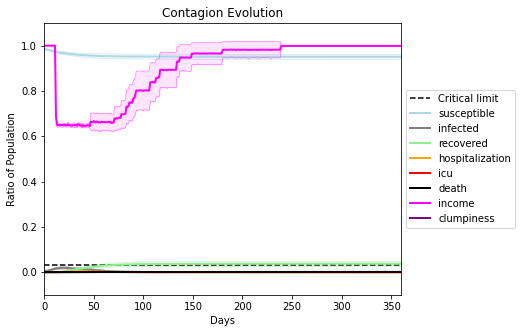

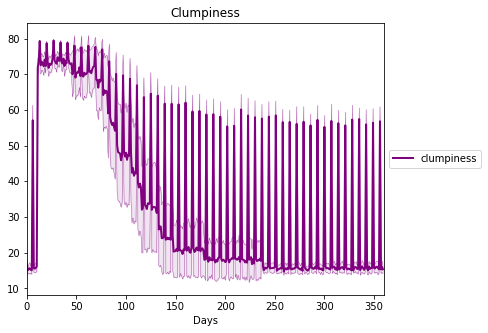

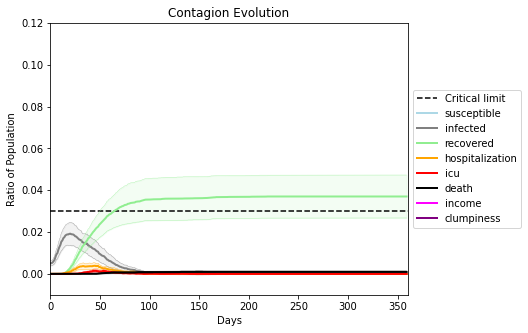

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.996", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[6246, 3970, 3426, 1552, 692, 2613, 728, 4531, 9254, 2813, 6391, 3518, 7726, 9116, 1566, 5810, 7452, 8472, 6636, 6845]
Average similarity between family members is 0.9857850103693441 at temperature -0.995
Average similarity between family and home is 0.9998877149092013 at temperature -1
Average similarity between students and their classroom is 0.6709579919347417 at temperature -0.995
Average classroom occupancy is 12.75 and number classrooms is 24
Average similarity between workers is 0.9745711231270825 at temperature -0.995
Average office occupancy is 10.076923076923077 and number offices is 65
Average friend similarity for adults: 0.9918647189314268 for kids: 0.7667627899126978
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.6463098993375197
disconnects
0.0
clumpiness 14.84
avg restaurant similarity 0.5050737089582827
disconnects
0.0
clumpiness 14.11
avg restaurant similarity 0.6102366923931171
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.5397449075064713
disconnects
0.0
clumpiness 14.38
avg restaurant similarity 0.5824352399607989
disconnects
0.0
clumpiness 12.96
avg restaurant similarity 0.6154351873427844
disconnects
0.0
clumpiness 14.15
avg restaurant similarity 0.4965413189568874
disconnects
0.75
clumpiness 62.63
avg restaurant similarity 0.5582240906006862
disconnects
0.0
clumpiness 14.03
avg restaurant similarity 0.6493919454743662
disconnects
0.0
clumpiness 13.76
avg restaurant similarity 0.44525751839295347
disconnects
0.0
clumpiness 14.26
avg restaurant similarity 0.6014371448667887
disconnects
0.0
clumpiness 13.25
avg restaurant similarity 0.5878964010955576
disconnects
0.92
clumpiness 74.42
avg restaurant similarity 0.5617849444949977
disconnects
0.92

avg restaurant similarity 0.5550226909925899
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.5820617791857404
disconnects
0.97
clumpiness 77.83
avg restaurant similarity 0.4253480724865856
disconnects
0.93
clumpiness 75.19
avg restaurant similarity 0.5120328059414584
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.46632929324782635
disconnects
0.87
clumpiness 71.08
avg restaurant similarity 0.5786353830180965
disconnects
0.93
clumpiness 75.08
avg restaurant similarity 0.5562205009240387
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.47828767187184074
disconnects
0.92
clumpiness 74.36
avg restaurant similarity 0.5243736260628354
disconnects
0.96
clumpiness 77.22
avg restaurant similarity 0.5416345830217454
disconnects
0.96
clumpiness 77.39
avg restaurant similarity 0.5504025028083257
disconnects
0.94
clumpiness 75.82
avg restaurant similarity 0.48336999256646185
disconnects
0.94
clumpiness 75.76
avg restaurant similarity 0.6862008675276972
disconn

avg restaurant similarity 0.5485801218616769
disconnects
0.0
clumpiness 14.27
avg restaurant similarity 0.5920981348003728
disconnects
0.0
clumpiness 14.1
avg restaurant similarity 0.6685221835527629
disconnects
0.0
clumpiness 14.36
avg restaurant similarity 0.6695847112931828
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 0.5050942186439611
disconnects
0.0
clumpiness 13.69
avg restaurant similarity 0.596383513352699
disconnects
0.0
clumpiness 14.14
avg restaurant similarity 0.5940016934277023
disconnects
0.77
clumpiness 64.05
avg restaurant similarity 0.5976124859722154
disconnects
0.0
clumpiness 14.33
avg restaurant similarity 0.5093349838988886
disconnects
0.0
clumpiness 13.94
avg restaurant similarity 0.5408162078278993
disconnects
0.0
clumpiness 13.68
avg restaurant similarity 0.6712333723447651
disconnects
0.0
clumpiness 13.38
avg restaurant similarity 0.6365120729310736
disconnects
0.0
clumpiness 13.88
avg restaurant similarity 0.4794675161521275
disconnects
0.0
clum

avg restaurant similarity 0.6925901438677045
disconnects
0.0
clumpiness 15.36
avg restaurant similarity 0.5514468089097398
disconnects
0.0
clumpiness 14.22
avg restaurant similarity 0.5444097229165138
disconnects
0.0
clumpiness 15.07
avg restaurant similarity 0.5087457415499375
disconnects
0.0
clumpiness 14.45
avg restaurant similarity 0.5480916343991302
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0.5397047402084492
disconnects
0.0
clumpiness 14.07
avg restaurant similarity 0.6178032911515304
disconnects
0.66
clumpiness 57.68
avg restaurant similarity 0.47866057997536127
disconnects
0.0
clumpiness 12.45
avg restaurant similarity 0.45053427949500374
disconnects
0.0
clumpiness 14.21
avg restaurant similarity 0.42840061268206053
disconnects
0.0
clumpiness 13.99
avg restaurant similarity 0.5215734742273548
disconnects
0.0
clumpiness 14.57
avg restaurant similarity 0.5512081367622218
disconnects
0.0
clumpiness 13.22
avg restaurant similarity 0.5695978947949245
disconnects
0.0

avg restaurant similarity 0.6959947068671682
disconnects
0.0
clumpiness 14.5
avg restaurant similarity 0.5961665770040313
disconnects
0.0
clumpiness 13.87
avg restaurant similarity 0.35719239759775284
disconnects
0.01
clumpiness 14.91
avg restaurant similarity 0.48351595479611836
disconnects
0.02
clumpiness 15.56
avg restaurant similarity 0.42516010790529096
disconnects
0.02
clumpiness 15.72
avg restaurant similarity 0.5537470714555203
disconnects
0.01
clumpiness 14.44
avg restaurant similarity 0.6918982372949469
disconnects
0.72
clumpiness 61.89
avg restaurant similarity 0.5096420594249429
disconnects
0.01
clumpiness 15.65
avg restaurant similarity 0.8438047012051035
disconnects
0.01
clumpiness 14.39
avg restaurant similarity 0.32696148788284324
disconnects
0.01
clumpiness 15.75
avg restaurant similarity 0.6092383442012435
disconnects
0.0
clumpiness 14.05
avg restaurant similarity 0.6365985197927435
disconnects
0.95
clumpiness 76.48
avg restaurant similarity 0.5325709175498795
disconn

avg restaurant similarity 0.47265449684186367
disconnects
0.98
clumpiness 78.5
avg restaurant similarity 0.31682415624111127
disconnects
0.95
clumpiness 76.44
avg restaurant similarity 0.5518672738038599
disconnects
0.97
clumpiness 77.87
avg restaurant similarity 0.5511368772313286
disconnects
0.93
clumpiness 74.96
avg restaurant similarity 0.5495025715216951
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.5970432210704186
disconnects
0.97
clumpiness 77.77
avg restaurant similarity 0.49396432073164875
disconnects
0.99
clumpiness 79.32
avg restaurant similarity 0.742255921868533
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.38499146052575905
disconnects
0.95
clumpiness 76.58
avg restaurant similarity 0.390156643384599
disconnects
0.97
clumpiness 77.88
avg restaurant similarity 0.45693555029402794
disconnects
0.93
clumpiness 75.14
avg restaurant similarity 0.3948663868593784
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.42436824357630354
disconne

avg restaurant similarity 0.4977930702423796
disconnects
0.02
clumpiness 16.74
avg restaurant similarity 0.3870384763190599
disconnects
0.81
clumpiness 67.24
avg restaurant similarity 0.6400753782574454
disconnects
0.04
clumpiness 16.39
avg restaurant similarity 0.28257202115334107
disconnects
0.03
clumpiness 16.37
avg restaurant similarity 0.6625912570955163
disconnects
0.01
clumpiness 14.67
avg restaurant similarity 0.3803385501647628
disconnects
0.02
clumpiness 14.69
avg restaurant similarity 0.507994552578204
disconnects
0.01
clumpiness 13.68
avg restaurant similarity 0.5854324475976301
disconnects
0.0
clumpiness 14.42
avg restaurant similarity 0.4198228562985865
disconnects
0.74
clumpiness 62.86
avg restaurant similarity 0.5721360260641731
disconnects
0.01
clumpiness 14.85
avg restaurant similarity 0.48154312404235033
disconnects
0.02
clumpiness 14.81
avg restaurant similarity 0.6854778103564068
disconnects
0.03
clumpiness 17.5
avg restaurant similarity 0.6709505292419873
disconne

avg restaurant similarity 0.49845386469686115
disconnects
0.0
clumpiness 13.77
avg restaurant similarity 0.5674563899755067
disconnects
0.02
clumpiness 15.41
avg restaurant similarity 0.3099834056415172
disconnects
0.9
clumpiness 73.14
avg restaurant similarity 0.6654579612482681
disconnects
0.01
clumpiness 15.01
avg restaurant similarity 0.475756113218769
disconnects
0.0
clumpiness 14.99
avg restaurant similarity 0.31013568314201856
disconnects
0.0
clumpiness 12.67
avg restaurant similarity 0.5636912582025803
disconnects
0.02
clumpiness 15.31
avg restaurant similarity 0.23631385842060945
disconnects
0.02
clumpiness 15.42
avg restaurant similarity 0.4638857668577139
disconnects
0.01
clumpiness 15.26
avg restaurant similarity 0.34681384986435126
disconnects
0.9
clumpiness 73.0
avg restaurant similarity 0.49585485248238675
disconnects
0.0
clumpiness 13.38
avg restaurant similarity 0.645439700249106
disconnects
0.02
clumpiness 15.98
avg restaurant similarity 0.4798150053826296
disconnects

avg restaurant similarity 0.5720357674546891
disconnects
0.0
clumpiness 11.92
avg restaurant similarity 0.5325171912389763
disconnects
0.0
clumpiness 12.57
avg restaurant similarity 0.45914908412805777
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.5414161016865352
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.5379979872681685
disconnects
0.0
clumpiness 12.61
avg restaurant similarity 0.5211523601629007
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.5415058904058073
disconnects
0.55
clumpiness 51.32
avg restaurant similarity 0.4937658628161691
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.5267817918315087
disconnects
0.0
clumpiness 12.3
avg restaurant similarity 0.5180255796510354
disconnects
0.0
clumpiness 12.9
avg restaurant similarity 0.540123099011598
disconnects
0.0
clumpiness 13.04
avg restaurant similarity 0.5861937160120553
disconnects
0.6
clumpiness 53.84
avg restaurant similarity 0.49943166471779293
disconnects
0.72
clu

avg restaurant similarity 0.6899403445795839
disconnects
0.82
clumpiness 68.29
avg restaurant similarity 0.5036678521166624
disconnects
0.8
clumpiness 66.95
avg restaurant similarity 0.5563501176604809
disconnects
0.74
clumpiness 62.67
avg restaurant similarity 0.4786850692322888
disconnects
0.81
clumpiness 67.28
avg restaurant similarity 0.4200581156907021
disconnects
0.8
clumpiness 67.64
avg restaurant similarity 0.4688235437638538
disconnects
0.86
clumpiness 70.5
avg restaurant similarity 0.4827722684937669
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.4218826773044778
disconnects
0.87
clumpiness 70.81
avg restaurant similarity 0.590753219807948
disconnects
0.81
clumpiness 67.59
avg restaurant similarity 0.46390361343923625
disconnects
0.69
clumpiness 59.8
avg restaurant similarity 0.729628642359543
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.6767485698633021
disconnects
0.93
clumpiness 75.33
avg restaurant similarity 0.5839922667203102
disconnects


disconnects
0.56
clumpiness 51.41
avg restaurant similarity 0.5226810285007945
disconnects
0.0
clumpiness 12.83
avg restaurant similarity 0.5514516821605072
disconnects
0.0
clumpiness 12.86
avg restaurant similarity 0.6148096287284414
disconnects
0.0
clumpiness 12.22
avg restaurant similarity 0.5312215707872266
disconnects
0.01
clumpiness 12.37
avg restaurant similarity 0.5824905190653138
disconnects
0.0
clumpiness 12.54
avg restaurant similarity 0.5998465973852571
disconnects
0.01
clumpiness 12.18
avg restaurant similarity 0.5942995800757522
disconnects
0.56
clumpiness 52.35
avg restaurant similarity 0.4766894017314601
disconnects
0.0
clumpiness 12.88
avg restaurant similarity 0.4906190219419116
disconnects
0.0
clumpiness 12.49
avg restaurant similarity 0.5388762063873234
disconnects
0.01
clumpiness 12.59
avg restaurant similarity 0.4939652922632642
disconnects
0.0
clumpiness 12.21
avg restaurant similarity 0.587061429409084
disconnects
0.0
clumpiness 11.97
avg restaurant similarity 0

avg restaurant similarity 0.4294458235150005
disconnects
0.52
clumpiness 49.66
avg restaurant similarity 0.5050946118659722
disconnects
0.0
clumpiness 11.93
avg restaurant similarity 0.6113831937082509
disconnects
0.01
clumpiness 12.74
avg restaurant similarity 0.554432838592161
disconnects
0.01
clumpiness 11.89
avg restaurant similarity 0.5278357637876389
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.5780483898026247
disconnects
0.01
clumpiness 12.42
avg restaurant similarity 0.35849599236663154
disconnects
0.0
clumpiness 12.42
avg restaurant similarity 0.4240504577886624
disconnects
0.53
clumpiness 49.63
avg restaurant similarity 0.4711373549836911
disconnects
0.01
clumpiness 12.84
avg restaurant similarity 0.5246101305874843
disconnects
0.0
clumpiness 12.1
avg restaurant similarity 0.4663221795969172
disconnects
0.01
clumpiness 12.93
avg restaurant similarity 0.5469574630843613
disconnects
0.0
clumpiness 12.91
avg restaurant similarity 0.5421887572774936
disconnects
0

avg restaurant similarity 0.6081875105314991
disconnects
0.0
clumpiness 12.1
avg restaurant similarity 0.6674899165665217
disconnects
0.0
clumpiness 11.73
avg restaurant similarity 0.5490341239214604
disconnects
0.0
clumpiness 12.96
avg restaurant similarity 0.5858862824109135
disconnects
0.0
clumpiness 13.05
avg restaurant similarity 0.72412978857198
disconnects
0.0
clumpiness 12.45
avg restaurant similarity 0.4858394557803777
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.5582267359782676
disconnects
0.53
clumpiness 49.02
avg restaurant similarity 0.6302133171257874
disconnects
0.0
clumpiness 12.68
avg restaurant similarity 0.5905696680247652
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.560591530000513
disconnects
0.0
clumpiness 12.74
avg restaurant similarity 0.5625058087416438
disconnects
0.0
clumpiness 12.34
avg restaurant similarity 0.5655827480101814
disconnects
0.77
clumpiness 65.63
avg restaurant similarity 0.5601820909213459
disconnects
0.88
clum

disconnects
0.51
clumpiness 48.02
avg restaurant similarity 0.6330845597241412
disconnects
0.0
clumpiness 11.93
avg restaurant similarity 0.48642535542659865
disconnects
0.0
clumpiness 11.22
avg restaurant similarity 0.6579583854060729
disconnects
0.0
clumpiness 11.78
avg restaurant similarity 0.6808456593639521
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.5772553218461021
disconnects
0.0
clumpiness 11.88
avg restaurant similarity 0.532985117551988
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.5497470458066043
disconnects
0.55
clumpiness 51.45
avg restaurant similarity 0.6000487147346586
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.5952617855472154
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.6197365214360439
disconnects
0.0
clumpiness 12.01
avg restaurant similarity 0.4917402274978083
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.5574299342226225
disconnects
0.0
clumpiness 12.07
avg restaurant similarity 0.5

disconnects
0.46
clumpiness 44.94
avg restaurant similarity 0.6503190161307957
disconnects
0.0
clumpiness 12.08
avg restaurant similarity 0.667230529851408
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.6017402531571242
disconnects
0.0
clumpiness 13.24
avg restaurant similarity 0.5287603990223952
disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.7420834058371437
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.5480141042448734
disconnects
0.0
clumpiness 12.2
avg restaurant similarity 0.6613445571541277
disconnects
0.46
clumpiness 45.92
avg restaurant similarity 0.621322516244774
disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.6340997014306907
disconnects
0.0
clumpiness 12.57
avg restaurant similarity 0.6583036619619996
disconnects
0.0
clumpiness 12.14
avg restaurant similarity 0.578233356819921
disconnects
0.0
clumpiness 12.28
avg restaurant similarity 0.6521748700380159
disconnects
0.0
clumpiness 12.08
avg restaurant similarity 0.61988

avg restaurant similarity 0.6118395086611125
disconnects
0.0
clumpiness 12.06
avg restaurant similarity 0.5650952503490774
disconnects
0.0
clumpiness 12.81
avg restaurant similarity 0.5291205508698181
disconnects
0.0
clumpiness 13.52
avg restaurant similarity 0.676128589864883
disconnects
0.0
clumpiness 12.43
avg restaurant similarity 0.5548250048120164
disconnects
0.0
clumpiness 12.62
avg restaurant similarity 0.6152639540579381
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.5345002593928612
disconnects
0.61
clumpiness 53.37
avg restaurant similarity 0.3974530246498294
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.5330477959905306
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.5561017754958488
disconnects
0.0
clumpiness 11.99
avg restaurant similarity 0.5499812916935785
disconnects
0.0
clumpiness 12.99
avg restaurant similarity 0.5068119743371138
disconnects
0.0
clumpiness 12.7
avg restaurant similarity 0.5647540636831069
disconnects
0.0
clum

avg restaurant similarity 0.5216168871500382
disconnects
0.0
clumpiness 12.06
avg restaurant similarity 0.36904292417587137
disconnects
0.0
clumpiness 13.49
avg restaurant similarity 0.6199883565551301
disconnects
0.0
clumpiness 13.56
avg restaurant similarity 0.5515487002379544
disconnects
0.0
clumpiness 12.64
avg restaurant similarity 0.4605222497442794
disconnects
0.0
clumpiness 14.1
avg restaurant similarity 0.5069345333194317
disconnects
0.0
clumpiness 12.86
avg restaurant similarity 0.4045779329936101
disconnects
0.68
clumpiness 59.86
avg restaurant similarity 0.5876567136244677
disconnects
0.0
clumpiness 12.69
avg restaurant similarity 0.43087640369069796
disconnects
0.0
clumpiness 12.57
avg restaurant similarity 0.6614408502358448
disconnects
0.0
clumpiness 13.17
avg restaurant similarity 0.6256566452657092
disconnects
0.0
clumpiness 13.7
avg restaurant similarity 0.6526861300210937
disconnects
0.77
clumpiness 64.35
avg restaurant similarity 0.4257635751791352
disconnects
0.88


avg restaurant similarity 0.5330759157059615
disconnects
0.92
clumpiness 74.36
avg restaurant similarity 0.5210297264244391
disconnects
0.91
clumpiness 74.03
avg restaurant similarity 0.6566526915646813
disconnects
0.84
clumpiness 69.47
avg restaurant similarity 0.3350455197056128
disconnects
0.9
clumpiness 73.17
avg restaurant similarity 0.4822710166288003
disconnects
0.88
clumpiness 72.14
avg restaurant similarity 0.7392167434586177
disconnects
0.0
clumpiness 13.55
avg restaurant similarity 0.5831297435327178
disconnects
0.52
clumpiness 49.43
avg restaurant similarity 0.594982115217168
disconnects
0.0
clumpiness 12.53
avg restaurant similarity 0.5578548819422773
disconnects
0.0
clumpiness 13.25
avg restaurant similarity 0.5782083283063021
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.5149364688110946
disconnects
0.0
clumpiness 14.15
avg restaurant similarity 0.47255280726376403
disconnects
0.0
clumpiness 12.96
avg restaurant similarity 0.44157647634136726
disconnects
0

avg restaurant similarity 0.38423436384662535
disconnects
0.0
clumpiness 13.22
avg restaurant similarity 0.38143859949671455
disconnects
0.0
clumpiness 14.28
avg restaurant similarity 0.558751576181425
disconnects
0.0
clumpiness 12.43
avg restaurant similarity 0.6723158383480081
disconnects
0.0
clumpiness 13.27
avg restaurant similarity 0.41208718721791093
disconnects
0.0
clumpiness 13.9
avg restaurant similarity 0.4936002666547902
disconnects
0.0
clumpiness 13.14
avg restaurant similarity 0.7046882578121609
disconnects
0.57
clumpiness 51.33
avg restaurant similarity 0.6100227656620437
disconnects
0.0
clumpiness 12.58
avg restaurant similarity 0.5788406369268528
disconnects
0.0
clumpiness 13.19
avg restaurant similarity 0.6025695049281
disconnects
0.0
clumpiness 13.36
avg restaurant similarity 0.6208622763251586
disconnects
0.0
clumpiness 12.7
avg restaurant similarity 0.48527742523371725
disconnects
0.0
clumpiness 12.7
avg restaurant similarity 0.4717118027677292
disconnects
0.0
clump

disconnects
0.0
clumpiness 13.47
avg restaurant similarity 0.6141017330571094
disconnects
0.0
clumpiness 13.3
avg restaurant similarity 0.4177284036491178
disconnects
0.0
clumpiness 13.51
avg restaurant similarity 0.5243621947865094
disconnects
0.0
clumpiness 13.8
avg restaurant similarity 0.5537233137400007
disconnects
0.0
clumpiness 15.5
avg restaurant similarity 0.45038201514028375
disconnects
0.0
clumpiness 14.26
avg restaurant similarity 0.6279575923835534
disconnects
0.58
clumpiness 53.85
avg restaurant similarity 0.6020943779210262
disconnects
0.0
clumpiness 13.59
avg restaurant similarity 0.8114712402680733
disconnects
0.0
clumpiness 13.91
avg restaurant similarity 0.49448863098709045
disconnects
0.0
clumpiness 13.25
avg restaurant similarity 0.57840698248072
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 0.5554295528706682
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.4081358278041423
disconnects
0.0
clumpiness 13.35
avg restaurant similarity 0.50958

avg restaurant similarity 0.6892192204719604
disconnects
0.01
clumpiness 14.56
avg restaurant similarity 0.4287566074132489
disconnects
0.02
clumpiness 14.86
avg restaurant similarity 0.4653335479971111
disconnects
0.03
clumpiness 16.27
avg restaurant similarity 0.6419696402141688
disconnects
0.01
clumpiness 13.77
avg restaurant similarity 0.6319258266309838
disconnects
0.01
clumpiness 14.95
avg restaurant similarity 0.4990314825057739
disconnects
0.03
clumpiness 15.64
avg restaurant similarity 0.39401031445958473
disconnects
0.56
clumpiness 53.01
avg restaurant similarity 0.5947124628455044
disconnects
0.08
clumpiness 19.84
avg restaurant similarity 0.3955318248190823
disconnects
0.03
clumpiness 16.47
avg restaurant similarity 0.5867276017308534
disconnects
0.05
clumpiness 17.34
avg restaurant similarity 0.6174948021737134
disconnects
0.02
clumpiness 14.77
avg restaurant similarity 0.6027942725606745
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.41395723668079093
disco

avg restaurant similarity 0.45390286874761754
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5163494588440873
disconnects
0.93
clumpiness 75.27
avg restaurant similarity 0.6386359382865363
disconnects
0.94
clumpiness 75.71
avg restaurant similarity 0.656917298557316
disconnects
0.94
clumpiness 75.72
avg restaurant similarity 0.45757763613202584
disconnects
0.9
clumpiness 73.36
avg restaurant similarity 0.6602285723675648
disconnects
0.94
clumpiness 75.71
avg restaurant similarity 0.492386750549644
disconnects
0.94
clumpiness 75.75
avg restaurant similarity 0.5011623731539323
disconnects
0.53
clumpiness 51.8
avg restaurant similarity 0.467324338281353
disconnects
0.02
clumpiness 16.51
avg restaurant similarity 0.5425752367363663
disconnects
0.04
clumpiness 16.32
avg restaurant similarity 0.5088200846816877
disconnects
0.04
clumpiness 17.04
avg restaurant similarity 0.5756250609809013
disconnects
0.02
clumpiness 15.27
avg restaurant similarity 0.3702069215225903
disconnects


avg restaurant similarity 0.5551781635780665
disconnects
0.0
clumpiness 13.72
avg restaurant similarity 0.5935971412956841
disconnects
0.56
clumpiness 54.0
avg restaurant similarity 0.5034854436176999
disconnects
0.02
clumpiness 15.73
avg restaurant similarity 0.615174202741256
disconnects
0.01
clumpiness 15.07
avg restaurant similarity 0.5232179499012899
disconnects
0.03
clumpiness 16.04
avg restaurant similarity 0.40238876065749785
disconnects
0.02
clumpiness 14.66
avg restaurant similarity 0.6584536615523141
disconnects
0.01
clumpiness 14.62
avg restaurant similarity 0.603495893770735
disconnects
0.03
clumpiness 15.47
avg restaurant similarity 0.5930115769317317
disconnects
0.78
clumpiness 65.43
avg restaurant similarity 0.5545884323162552
disconnects
0.02
clumpiness 15.69
avg restaurant similarity 0.6178490633916928
disconnects
0.03
clumpiness 16.1
avg restaurant similarity 0.5371255135334286
disconnects
0.06
clumpiness 17.73
avg restaurant similarity 0.5046021125677449
disconnects

avg restaurant similarity 0.6335229672277713
disconnects
0.01
clumpiness 14.9
avg restaurant similarity 0.5624221060228087
disconnects
0.0
clumpiness 13.76
avg restaurant similarity 0.5967322528899682
disconnects
0.7
clumpiness 60.24
avg restaurant similarity 0.33260192036210606
disconnects
0.03
clumpiness 15.67
avg restaurant similarity 0.4671354939684807
disconnects
0.03
clumpiness 15.72
avg restaurant similarity 0.4310299091523309
disconnects
0.04
clumpiness 16.18
avg restaurant similarity 0.5177721567661476
disconnects
0.0
clumpiness 14.02
avg restaurant similarity 0.5119424725021348
disconnects
0.01
clumpiness 13.78
avg restaurant similarity 0.7129715754935169
disconnects
0.02
clumpiness 15.03
avg restaurant similarity 0.5678453961801848
disconnects
0.69
clumpiness 59.68
avg restaurant similarity 0.7013750225160478
disconnects
0.01
clumpiness 14.4
avg restaurant similarity 0.5590250404891324
disconnects
0.0
clumpiness 13.36
avg restaurant similarity 0.6402454503178203
disconnects


avg restaurant similarity 0.5257483715546972
disconnects
0.0
clumpiness 13.68
avg restaurant similarity 0.3846696035630259
disconnects
0.0
clumpiness 13.05
avg restaurant similarity 0.47233621290547756
disconnects
0.0
clumpiness 14.55
avg restaurant similarity 0.618050355842247
disconnects
0.0
clumpiness 13.44
avg restaurant similarity 0.5122317724291695
disconnects
0.0
clumpiness 13.1
avg restaurant similarity 0.4464817261747397
disconnects
0.01
clumpiness 14.01
avg restaurant similarity 0.4624281414735383
disconnects
0.7
clumpiness 59.61
avg restaurant similarity 0.44629471146170435
disconnects
0.0
clumpiness 13.5
avg restaurant similarity 0.4548208396955835
disconnects
0.0
clumpiness 12.6
avg restaurant similarity 0.4888998653464406
disconnects
0.0
clumpiness 13.56
avg restaurant similarity 0.4083171110612003
disconnects
0.01
clumpiness 13.2
avg restaurant similarity 0.43186641921655045
disconnects
0.81
clumpiness 67.19
avg restaurant similarity 0.2570227973036483
disconnects
0.9
cl

avg restaurant similarity 0.6246776643297784
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6464724718279361
disconnects
0.87
clumpiness 71.1
avg restaurant similarity 0.42538406756964986
disconnects
0.79
clumpiness 67.36
avg restaurant similarity 0.4043476836277509
disconnects
0.95
clumpiness 76.49
avg restaurant similarity 0.3682683423078998
disconnects
0.92
clumpiness 74.42
avg restaurant similarity 0.4295950149510953
disconnects
0.94
clumpiness 75.82
avg restaurant similarity 0.38898211492915724
disconnects
0.93
clumpiness 75.11
avg restaurant similarity 0.37151549121487365
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.42693762176089595
disconnects
0.89
clumpiness 72.27
avg restaurant similarity 0.34207830439084075
disconnects
0.94
clumpiness 75.62
avg restaurant similarity 0.46999057478178385
disconnects
0.96
clumpiness 77.08
avg restaurant similarity 0.3635228543697815
disconnects
0.96
clumpiness 77.33
avg restaurant similarity 0.536842746108286
disco

disconnects
0.0
clumpiness 13.72
avg restaurant similarity 0.5097903471689418
disconnects
0.85
clumpiness 69.58
avg restaurant similarity 0.42111677796066843
disconnects
0.0
clumpiness 13.76
avg restaurant similarity 0.2792931468201365
disconnects
0.0
clumpiness 11.59
avg restaurant similarity 0.34219781947414357
disconnects
0.0
clumpiness 12.98
avg restaurant similarity 0.6307553182179877
disconnects
0.01
clumpiness 14.64
avg restaurant similarity 0.5479950149403988
disconnects
0.0
clumpiness 12.64
avg restaurant similarity 0.5915078602133694
disconnects
0.0
clumpiness 13.72
avg restaurant similarity 0.4582940800125076
disconnects
0.85
clumpiness 69.86
avg restaurant similarity 0.5766916715305755
disconnects
0.0
clumpiness 14.28
avg restaurant similarity 0.41154944866206106
disconnects
0.01
clumpiness 13.29
avg restaurant similarity 0.3357194083812471
disconnects
0.02
clumpiness 14.83
avg restaurant similarity 0.429833493005411
disconnects
0.0
clumpiness 12.12
avg restaurant similarit

avg restaurant similarity 0.5371454310865065
disconnects
0.0
clumpiness 13.08
avg restaurant similarity 0.4051239850807108
disconnects
0.74
clumpiness 62.34
avg restaurant similarity 0.522646407723748
disconnects
0.0
clumpiness 14.99
avg restaurant similarity 0.30325368721833934
disconnects
0.01
clumpiness 13.53
avg restaurant similarity 0.33583578049628393
disconnects
0.0
clumpiness 13.79
avg restaurant similarity 0.4280065952535105
disconnects
0.0
clumpiness 13.45
avg restaurant similarity 0.40020957175419164
disconnects
0.01
clumpiness 13.09
avg restaurant similarity 0.28988320143039537
disconnects
0.0
clumpiness 13.09
avg restaurant similarity 0.21825996903049916
disconnects
0.68
clumpiness 58.98
avg restaurant similarity 0.5363021237753016
disconnects
0.02
clumpiness 14.69
avg restaurant similarity 0.20937093769054407
disconnects
0.01
clumpiness 13.88
avg restaurant similarity 0.3531669191614089
disconnects
0.0
clumpiness 13.34
avg restaurant similarity 0.2368915525104294
disconne

avg restaurant similarity 0.641524349889198
disconnects
0.01
clumpiness 13.16
avg restaurant similarity 0.42949305284144546
disconnects
0.03
clumpiness 15.29
avg restaurant similarity 0.5335563348449492
disconnects
0.01
clumpiness 13.62
avg restaurant similarity 0.582662687599942
disconnects
0.01
clumpiness 13.03
avg restaurant similarity 0.6059035040167948
disconnects
0.01
clumpiness 13.04
avg restaurant similarity 0.5532905497543946
disconnects
0.02
clumpiness 13.2
avg restaurant similarity 0.4576053082240549
disconnects
0.66
clumpiness 59.76
avg restaurant similarity 0.5660735492128748
disconnects
0.01
clumpiness 12.71
avg restaurant similarity 0.5589346600186256
disconnects
0.03
clumpiness 14.68
avg restaurant similarity 0.46866498698544545
disconnects
0.01
clumpiness 13.29
avg restaurant similarity 0.46736570495202384
disconnects
0.0
clumpiness 12.99
avg restaurant similarity 0.5431379578791218
disconnects
0.84
clumpiness 69.73
avg restaurant similarity 0.4329818076770576
disconne

avg restaurant similarity 0.6098626199718804
disconnects
0.89
clumpiness 72.18
avg restaurant similarity 0.5142825226346215
disconnects
0.89
clumpiness 73.17
avg restaurant similarity 0.5257249993873662
disconnects
0.81
clumpiness 67.79
avg restaurant similarity 0.548382975113209
disconnects
0.8
clumpiness 66.92
avg restaurant similarity 0.5939310021893102
disconnects
0.89
clumpiness 72.3
avg restaurant similarity 0.6497245521572809
disconnects
0.84
clumpiness 69.44
avg restaurant similarity 0.48548377991655445
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.49314169875579006
disconnects
0.76
clumpiness 64.02
avg restaurant similarity 0.5995822690228496
disconnects
0.91
clumpiness 73.72
avg restaurant similarity 0.5267184918951177
disconnects
0.81
clumpiness 67.03
avg restaurant similarity 0.5649781963914277
disconnects
0.82
clumpiness 67.47
avg restaurant similarity 0.511905578997668
disconnects
0.79
clumpiness 66.63
avg restaurant similarity 0.604083754398717
disconnects


avg restaurant similarity 0.5165107004215305
disconnects
0.62
clumpiness 55.2
avg restaurant similarity 0.5303393248952095
disconnects
0.01
clumpiness 13.09
avg restaurant similarity 0.5535278749608922
disconnects
0.02
clumpiness 13.21
avg restaurant similarity 0.5689196644162251
disconnects
0.02
clumpiness 13.35
avg restaurant similarity 0.543679370963617
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.5163050802409659
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.7308674425997166
disconnects
0.0
clumpiness 12.71
avg restaurant similarity 0.5608850353216989
disconnects
0.65
clumpiness 56.43
avg restaurant similarity 0.6801162806588876
disconnects
0.0
clumpiness 11.79
avg restaurant similarity 0.4472370961051213
disconnects
0.01
clumpiness 13.06
avg restaurant similarity 0.5320801647307533
disconnects
0.0
clumpiness 12.79
avg restaurant similarity 0.655812850485335
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.5510556330425753
disconnects
0.0


disconnects
0.01
clumpiness 11.79
avg restaurant similarity 0.7069805571910295
disconnects
0.8
clumpiness 66.69
avg restaurant similarity 0.5761728680360552
disconnects
0.0
clumpiness 12.09
avg restaurant similarity 0.5474451001237648
disconnects
0.01
clumpiness 13.09
avg restaurant similarity 0.6678191792604845
disconnects
0.01
clumpiness 12.96
avg restaurant similarity 0.4434954473155567
disconnects
0.03
clumpiness 14.38
avg restaurant similarity 0.3881387938984539
disconnects
0.01
clumpiness 12.8
avg restaurant similarity 0.6269306259656038
disconnects
0.01
clumpiness 12.89
avg restaurant similarity 0.52202514312102
disconnects
0.83
clumpiness 68.95
avg restaurant similarity 0.44359906922730835
disconnects
0.01
clumpiness 12.47
avg restaurant similarity 0.4955633548377285
disconnects
0.03
clumpiness 14.02
avg restaurant similarity 0.5062186602861064
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.6988739421826027
disconnects
0.04
clumpiness 14.93
avg restaurant similari

avg restaurant similarity 0.49463980670159685
disconnects
0.0
clumpiness 13.3
avg restaurant similarity 0.426632335326431
disconnects
0.0
clumpiness 13.39
avg restaurant similarity 0.5499099335829839
disconnects
0.0
clumpiness 13.03
avg restaurant similarity 0.4859259778421213
disconnects
0.0
clumpiness 12.73
avg restaurant similarity 0.44872020334761437
disconnects
0.0
clumpiness 13.27
avg restaurant similarity 0.5264395733647738
disconnects
0.0
clumpiness 13.3
avg restaurant similarity 0.682619752166776
disconnects
0.47
clumpiness 45.77
avg restaurant similarity 0.5725956841763005
disconnects
0.01
clumpiness 15.83
avg restaurant similarity 0.5335044785553396
disconnects
0.0
clumpiness 13.42
avg restaurant similarity 0.5038852283220783
disconnects
0.0
clumpiness 14.06
avg restaurant similarity 0.44179298065293887
disconnects
0.02
clumpiness 14.71
avg restaurant similarity 0.6112827943210944
disconnects
0.82
clumpiness 67.48
avg restaurant similarity 0.5388624814087195
disconnects
0.91

avg restaurant similarity 0.5387319675460266
disconnects
0.76
clumpiness 63.8
avg restaurant similarity 0.48711974063481484
disconnects
0.84
clumpiness 68.76
avg restaurant similarity 0.4743200821720199
disconnects
0.81
clumpiness 67.35
avg restaurant similarity 0.49253488930224126
disconnects
0.72
clumpiness 61.45
avg restaurant similarity 0.4817955895131733
disconnects
0.9
clumpiness 72.91
avg restaurant similarity 0.4157938185123351
disconnects
0.61
clumpiness 55.81
avg restaurant similarity 0.5598699658205752
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.5021536855739375
disconnects
0.85
clumpiness 70.12
avg restaurant similarity 0.6021690758960923
disconnects
0.79
clumpiness 66.49
avg restaurant similarity 0.4449017083153631
disconnects
0.9
clumpiness 73.45
avg restaurant similarity 0.5937113085832858
disconnects
0.74
clumpiness 63.25
avg restaurant similarity 0.5135642494102751
disconnects
0.74
clumpiness 63.62
avg restaurant similarity 0.5110284992845511
disconne

disconnects
0.35
clumpiness 37.52
avg restaurant similarity 0.5167524387123908
disconnects
0.02
clumpiness 13.79
avg restaurant similarity 0.6024901518116732
disconnects
0.0
clumpiness 12.89
avg restaurant similarity 0.571532941315569
disconnects
0.02
clumpiness 15.24
avg restaurant similarity 0.4674182852852446
disconnects
0.0
clumpiness 13.19
avg restaurant similarity 0.483763490378267
disconnects
0.0
clumpiness 13.53
avg restaurant similarity 0.4360084337835989
disconnects
0.0
clumpiness 14.35
avg restaurant similarity 0.5015689279400296
disconnects
0.54
clumpiness 50.93
avg restaurant similarity 0.5070152884404395
disconnects
0.0
clumpiness 12.33
avg restaurant similarity 0.6093931038077438
disconnects
0.0
clumpiness 13.31
avg restaurant similarity 0.6180515466313303
disconnects
0.01
clumpiness 14.64
avg restaurant similarity 0.4262349818191077
disconnects
0.02
clumpiness 14.57
avg restaurant similarity 0.5318013751217848
disconnects
0.01
clumpiness 15.03
avg restaurant similarity 

disconnects
0.45
clumpiness 45.43
avg restaurant similarity 0.484370230920523
disconnects
0.02
clumpiness 15.48
avg restaurant similarity 0.5394578726711694
disconnects
0.0
clumpiness 14.07
avg restaurant similarity 0.4779119267723692
disconnects
0.0
clumpiness 12.81
avg restaurant similarity 0.5980040057980903
disconnects
0.01
clumpiness 14.34
avg restaurant similarity 0.4746205701598626
disconnects
0.0
clumpiness 12.82
avg restaurant similarity 0.6001139207098044
disconnects
0.24
clumpiness 29.16
avg restaurant similarity 0.6037650689143793
disconnects
0.48
clumpiness 46.76
avg restaurant similarity 0.5708496085215564
disconnects
0.0
clumpiness 12.5
avg restaurant similarity 0.41150627004389445
disconnects
0.0
clumpiness 12.9
avg restaurant similarity 0.5741624637180622
disconnects
0.0
clumpiness 12.69
avg restaurant similarity 0.5383353093085012
disconnects
0.24
clumpiness 28.15
avg restaurant similarity 0.5371454974074541
disconnects
0.21
clumpiness 26.77
avg restaurant similarity 

avg restaurant similarity 0.4653734942269642
disconnects
0.01
clumpiness 13.67
avg restaurant similarity 0.5597952641419821
disconnects
0.0
clumpiness 13.11
avg restaurant similarity 0.5647113949136435
disconnects
0.01
clumpiness 13.04
avg restaurant similarity 0.674392073767574
disconnects
0.02
clumpiness 15.37
avg restaurant similarity 0.6531374829884149
disconnects
0.01
clumpiness 14.13
avg restaurant similarity 0.6571757272167024
disconnects
0.0
clumpiness 12.69
avg restaurant similarity 0.7418884798790082
disconnects
0.56
clumpiness 51.85
avg restaurant similarity 0.5784908868859563
disconnects
0.03
clumpiness 14.19
avg restaurant similarity 0.509127041849172
disconnects
0.0
clumpiness 12.27
avg restaurant similarity 0.6072274114446802
disconnects
0.01
clumpiness 13.29
avg restaurant similarity 0.5551439286847727
disconnects
0.01
clumpiness 14.62
avg restaurant similarity 0.4930563588889742
disconnects
0.92
clumpiness 74.61
avg restaurant similarity 0.6308527802542888
disconnects


disconnects
0.53
clumpiness 49.66
avg restaurant similarity 0.4511794477244046
disconnects
0.01
clumpiness 14.35
avg restaurant similarity 0.5892031693526759
disconnects
0.03
clumpiness 15.02
avg restaurant similarity 0.603029746798638
disconnects
0.01
clumpiness 13.59
avg restaurant similarity 0.5327172013110285
disconnects
0.01
clumpiness 14.61
avg restaurant similarity 0.7072761705516287
disconnects
0.0
clumpiness 13.35
avg restaurant similarity 0.5546364057502742
disconnects
0.0
clumpiness 13.15
avg restaurant similarity 0.6276084853196536
disconnects
0.61
clumpiness 55.77
avg restaurant similarity 0.5742252447493347
disconnects
0.01
clumpiness 13.69
avg restaurant similarity 0.582386633807254
disconnects
0.0
clumpiness 13.19
avg restaurant similarity 0.6497486500838845
disconnects
0.01
clumpiness 14.81
avg restaurant similarity 0.5727664867356027
disconnects
0.0
clumpiness 12.64
avg restaurant similarity 0.6832103560406203
disconnects
0.0
clumpiness 12.67
avg restaurant similarity

disconnects
0.54
clumpiness 55.51
avg restaurant similarity 0.5710380623214102
disconnects
0.01
clumpiness 12.15
avg restaurant similarity 0.5170974125672276
disconnects
0.01
clumpiness 14.59
avg restaurant similarity 0.6052526287111891
disconnects
0.02
clumpiness 14.77
avg restaurant similarity 0.5344725203004963
disconnects
0.0
clumpiness 12.56
avg restaurant similarity 0.6720355061824084
disconnects
0.02
clumpiness 14.9
avg restaurant similarity 0.6135759709190528
disconnects
0.02
clumpiness 14.15
avg restaurant similarity 0.6857022532151373
disconnects
0.42
clumpiness 44.66
avg restaurant similarity 0.5766842841585088
disconnects
0.02
clumpiness 14.68
avg restaurant similarity 0.561823862259585
disconnects
0.01
clumpiness 12.78
avg restaurant similarity 0.5294525289522434
disconnects
0.0
clumpiness 13.26
avg restaurant similarity 0.5919622638032644
disconnects
0.01
clumpiness 14.86
avg restaurant similarity 0.6467222934439968
disconnects
0.0
clumpiness 12.98
avg restaurant similari

disconnects
0.46
clumpiness 46.15
avg restaurant similarity 0.47698650128091913
disconnects
0.01
clumpiness 14.01
avg restaurant similarity 0.5583365822176005
disconnects
0.0
clumpiness 12.75
avg restaurant similarity 0.5071972082925624
disconnects
0.03
clumpiness 15.09
avg restaurant similarity 0.5294367184190125
disconnects
0.0
clumpiness 12.25
avg restaurant similarity 0.6594603551349241
disconnects
0.01
clumpiness 13.9
avg restaurant similarity 0.5785779996614345
disconnects
0.02
clumpiness 14.49
avg restaurant similarity 0.5609081413254602
disconnects
0.42
clumpiness 44.6
avg restaurant similarity 0.5780812422433494
disconnects
0.0
clumpiness 12.62
avg restaurant similarity 0.5643908640324203
disconnects
0.01
clumpiness 13.39
avg restaurant similarity 0.6059634332878354
disconnects
0.01
clumpiness 13.47
avg restaurant similarity 0.6156994988245371
disconnects
0.01
clumpiness 14.1
avg restaurant similarity 0.5595986866203564
disconnects
0.03
clumpiness 14.45
avg restaurant similari

avg restaurant similarity 0.5656050294813654
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.46697513246339817
disconnects
0.0
clumpiness 13.42
avg restaurant similarity 0.6305332755816077
disconnects
0.0
clumpiness 13.86
avg restaurant similarity 0.3744984221573842
disconnects
0.0
clumpiness 13.45
avg restaurant similarity 0.7460032187812228
disconnects
0.0
clumpiness 14.53
avg restaurant similarity 0.5149191191333741
disconnects
0.0
clumpiness 14.24
avg restaurant similarity 0.5393502928080967
disconnects
0.7
clumpiness 61.25
avg restaurant similarity 0.645929394556021
disconnects
0.0
clumpiness 13.82
avg restaurant similarity 0.5155340696690307
disconnects
0.0
clumpiness 13.15
avg restaurant similarity 0.6615146750913953
disconnects
0.0
clumpiness 13.87
avg restaurant similarity 0.5375566216474831
disconnects
0.0
clumpiness 14.17
avg restaurant similarity 0.7063892192092491
disconnects
0.93
clumpiness 75.02
avg restaurant similarity 0.45929291564228875
disconnects
0.97


avg restaurant similarity 0.6175897381886502
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.46406854110303986
disconnects
0.93
clumpiness 74.97
avg restaurant similarity 0.42676450711623404
disconnects
0.94
clumpiness 76.09
avg restaurant similarity 0.29004489453136006
disconnects
0.96
clumpiness 77.1
avg restaurant similarity 0.5495104443692406
disconnects
0.98
clumpiness 78.59
avg restaurant similarity 0.6674371574858825
disconnects
0.97
clumpiness 77.86
avg restaurant similarity 0.6210221592375758
disconnects
0.92
clumpiness 74.64
avg restaurant similarity 0.3305476640773562
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.4926511107822888
disconnects
0.97
clumpiness 77.88
avg restaurant similarity 0.5175014963403177
disconnects
0.95
clumpiness 76.33
avg restaurant similarity 0.6320417695960492
disconnects
0.96
clumpiness 77.32
avg restaurant similarity 0.5501836971556545
disconnects
0.94
clumpiness 75.74
avg restaurant similarity 0.6293167048035322
disconn

disconnects
0.0
clumpiness 13.64
avg restaurant similarity 0.5457297214041585
disconnects
0.71
clumpiness 61.29
avg restaurant similarity 0.785605644831256
disconnects
0.0
clumpiness 14.26
avg restaurant similarity 0.4854213488387374
disconnects
0.0
clumpiness 13.17
avg restaurant similarity 0.5805263282311871
disconnects
0.0
clumpiness 14.8
avg restaurant similarity 0.5295718883201317
disconnects
0.0
clumpiness 14.73
avg restaurant similarity 0.6044034242488859
disconnects
0.0
clumpiness 13.64
avg restaurant similarity 0.49554249216907736
disconnects
0.0
clumpiness 13.69
avg restaurant similarity 0.6456857571791407
disconnects
0.74
clumpiness 63.78
avg restaurant similarity 0.3809483384789052
disconnects
0.0
clumpiness 13.41
avg restaurant similarity 0.5006166976174511
disconnects
0.0
clumpiness 13.08
avg restaurant similarity 0.4908137565447274
disconnects
0.0
clumpiness 13.01
avg restaurant similarity 0.4659325386829365
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.65

disconnects
0.0
clumpiness 13.42
avg restaurant similarity 0.6045277195251786
disconnects
0.59
clumpiness 55.0
avg restaurant similarity 0.9165824471627604
disconnects
0.0
clumpiness 14.84
avg restaurant similarity 0.5943921157537674
disconnects
0.0
clumpiness 13.08
avg restaurant similarity 0.4013504744492268
disconnects
0.0
clumpiness 13.63
avg restaurant similarity 0.6115945787131757
disconnects
0.0
clumpiness 14.09
avg restaurant similarity 0.42150365730550926
disconnects
0.0
clumpiness 13.62
avg restaurant similarity 0.5412726897389445
disconnects
0.0
clumpiness 13.81
avg restaurant similarity 0.6678951974121838
disconnects
0.6
clumpiness 56.11
avg restaurant similarity 0.6102733976515178
disconnects
0.0
clumpiness 13.69
avg restaurant similarity 0.4295157580087364
disconnects
0.0
clumpiness 14.78
avg restaurant similarity 0.49527217557753184
disconnects
0.0
clumpiness 13.63
avg restaurant similarity 0.45196986144443607
disconnects
0.0
clumpiness 13.58
avg restaurant similarity 0.

avg restaurant similarity 0.5265011835042694
disconnects
0.0
clumpiness 13.49
avg restaurant similarity 0.7254538058044934
disconnects
0.0
clumpiness 13.48
avg restaurant similarity 0.7219710483105604
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.6598116011654784
disconnects
0.0
clumpiness 13.0
avg restaurant similarity 0.48570535655036734
disconnects
0.0
clumpiness 13.83
avg restaurant similarity 0.5605393305780737
disconnects
0.0
clumpiness 13.59
avg restaurant similarity 0.6405652644171128
disconnects
0.58
clumpiness 53.75
avg restaurant similarity 0.6650133014583043
disconnects
0.0
clumpiness 13.7
avg restaurant similarity 0.47881963886014267
disconnects
0.0
clumpiness 14.37
avg restaurant similarity 0.550941574952698
disconnects
0.0
clumpiness 12.9
avg restaurant similarity 0.5164708359131956
disconnects
0.0
clumpiness 13.86
avg restaurant similarity 0.43516367546093243
disconnects
0.82
clumpiness 68.29
avg restaurant similarity 0.6189434020341431
disconnects
0.94
cl

avg restaurant similarity 0.5980028014301209
disconnects
0.9
clumpiness 73.15
avg restaurant similarity 0.6243528999062952
disconnects
0.96
clumpiness 77.29
avg restaurant similarity 0.6445454485281894
disconnects
0.92
clumpiness 74.83
avg restaurant similarity 0.568652501742967
disconnects
0.92
clumpiness 74.44
avg restaurant similarity 0.6024960758440939
disconnects
0.96
clumpiness 77.36
avg restaurant similarity 0.6750553982374253
disconnects
0.95
clumpiness 76.51
avg restaurant similarity 0.5355513821829185
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.5063968602169455
disconnects
0.93
clumpiness 75.23
avg restaurant similarity 0.5638544730379189
disconnects
0.91
clumpiness 73.61
avg restaurant similarity 0.3944713789886753
disconnects
0.87
clumpiness 71.01
avg restaurant similarity 0.4847977630936083
disconnects
0.86
clumpiness 70.34
avg restaurant similarity 0.6190900036157186
disconnects
0.94
clumpiness 75.88
avg restaurant similarity 0.5282377972132065
disconnect

avg restaurant similarity 0.49236553021500806
disconnects
0.0
clumpiness 12.87
avg restaurant similarity 0.571209173698106
disconnects
0.0
clumpiness 14.57
avg restaurant similarity 0.5790726258645661
disconnects
0.0
clumpiness 14.61
avg restaurant similarity 0.583206518609024
disconnects
0.0
clumpiness 13.72
avg restaurant similarity 0.4995589775923373
disconnects
0.0
clumpiness 12.07
avg restaurant similarity 0.49164431441288603
disconnects
0.0
clumpiness 14.46
avg restaurant similarity 0.5892550691112287
disconnects
0.59
clumpiness 53.43
avg restaurant similarity 0.5776956421728686
disconnects
0.0
clumpiness 13.54
avg restaurant similarity 0.49609102553632495
disconnects
0.0
clumpiness 12.91
avg restaurant similarity 0.6908056596439285
disconnects
0.0
clumpiness 14.04
avg restaurant similarity 0.47420275773228127
disconnects
0.0
clumpiness 12.56
avg restaurant similarity 0.6324190438091832
disconnects
0.0
clumpiness 12.83
avg restaurant similarity 0.4980979787047687
disconnects
0.0


avg restaurant similarity 0.6142980552529127
disconnects
0.0
clumpiness 13.21
avg restaurant similarity 0.6356317306825503
disconnects
0.0
clumpiness 13.84
avg restaurant similarity 0.4934972506675301
disconnects
0.0
clumpiness 12.63
avg restaurant similarity 0.5641869374170411
disconnects
0.0
clumpiness 13.01
avg restaurant similarity 0.6192455267631267
disconnects
0.0
clumpiness 12.02
avg restaurant similarity 0.473080667836144
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.49101865974455294
disconnects
0.76
clumpiness 63.62
avg restaurant similarity 0.5481356975686863
disconnects
0.0
clumpiness 13.37
avg restaurant similarity 0.6974575475651303
disconnects
0.0
clumpiness 13.66
avg restaurant similarity 0.6829791917511588
disconnects
0.0
clumpiness 14.2
avg restaurant similarity 0.7009592714582511
disconnects
0.0
clumpiness 13.54
avg restaurant similarity 0.49867579266322404
disconnects
0.0
clumpiness 12.83
avg restaurant similarity 0.5499721330924717
disconnects
0.0
cl

avg restaurant similarity 0.5120684179489972
disconnects
0.0
clumpiness 13.32
avg restaurant similarity 0.4029675154190325
disconnects
0.0
clumpiness 13.96
avg restaurant similarity 0.4189802005176597
disconnects
0.0
clumpiness 14.0
avg restaurant similarity 0.5468122893064374
disconnects
0.0
clumpiness 13.52
avg restaurant similarity 0.5359035034453236
disconnects
0.0
clumpiness 14.01
avg restaurant similarity 0.40364634630505175
disconnects
0.0
clumpiness 14.34
avg restaurant similarity 0.5885554638311308
disconnects
0.8
clumpiness 67.03
avg restaurant similarity 0.627851731668911
disconnects
0.01
clumpiness 14.14
avg restaurant similarity 0.41557496648236364
disconnects
0.01
clumpiness 15.05
avg restaurant similarity 0.3755075703513328
disconnects
0.0
clumpiness 14.61
avg restaurant similarity 0.4375743144008833
disconnects
0.01
clumpiness 14.58
avg restaurant similarity 0.412927467381255
disconnects
0.92
clumpiness 74.62
avg restaurant similarity 0.5960673672370335
disconnects
0.96

avg restaurant similarity 0.3392700740828397
disconnects
0.02
clumpiness 15.9
avg restaurant similarity 0.6501194239013518
disconnects
0.01
clumpiness 15.0
avg restaurant similarity 0.6066924565349496
disconnects
0.0
clumpiness 14.73
avg restaurant similarity 0.48074892005136377
disconnects
0.01
clumpiness 14.55
avg restaurant similarity 0.5811795418096031
disconnects
0.01
clumpiness 14.22
avg restaurant similarity 0.4296330168858523
disconnects
0.0
clumpiness 15.25
avg restaurant similarity 0.536459016836405
disconnects
0.73
clumpiness 62.45
avg restaurant similarity 0.5492884075995556
disconnects
0.0
clumpiness 13.3
avg restaurant similarity 0.29784708875535737
disconnects
0.0
clumpiness 13.97
avg restaurant similarity 0.4423561836481031
disconnects
0.0
clumpiness 13.22
avg restaurant similarity 0.48249252469342463
disconnects
0.0
clumpiness 14.67
avg restaurant similarity 0.4955679791085727
disconnects
0.0
clumpiness 13.64
avg restaurant similarity 0.4426405398538284
disconnects
0.0

avg restaurant similarity 0.47038334223501377
disconnects
0.0
clumpiness 14.34
avg restaurant similarity 0.3278133705805061
disconnects
0.01
clumpiness 15.64
avg restaurant similarity 0.4353792227422276
disconnects
0.02
clumpiness 16.37
avg restaurant similarity 0.5512769611757831
disconnects
0.0
clumpiness 14.06
avg restaurant similarity 0.5160704848706402
disconnects
0.0
clumpiness 14.78
avg restaurant similarity 0.41234727838814067
disconnects
0.01
clumpiness 15.0
avg restaurant similarity 0.43813469984625564
disconnects
0.72
clumpiness 62.45
avg restaurant similarity 0.3955387631388215
disconnects
0.0
clumpiness 14.08
avg restaurant similarity 0.5300772556770008
disconnects
0.0
clumpiness 14.4
avg restaurant similarity 0.528155460132968
disconnects
0.0
clumpiness 15.89
avg restaurant similarity 0.4682809811574188
disconnects
0.0
clumpiness 14.08
avg restaurant similarity 0.5188759744840283
disconnects
0.0
clumpiness 15.02
avg restaurant similarity 0.5512613934137314
disconnects
0.0

avg restaurant similarity 0.5001296929706739
disconnects
0.01
clumpiness 13.11
avg restaurant similarity 0.47292120276957916
disconnects
0.01
clumpiness 14.29
avg restaurant similarity 0.547386944795665
disconnects
0.0
clumpiness 14.73
avg restaurant similarity 0.47654574068427885
disconnects
0.01
clumpiness 15.79
avg restaurant similarity 0.6108692740872765
disconnects
0.0
clumpiness 13.4
avg restaurant similarity 0.5136651197845437
disconnects
0.01
clumpiness 14.43
avg restaurant similarity 0.34979964687289555
disconnects
0.74
clumpiness 63.9
avg restaurant similarity 0.40284011325214014
disconnects
0.0
clumpiness 13.42
avg restaurant similarity 0.34529430660330124
disconnects
0.01
clumpiness 14.7
avg restaurant similarity 0.5785148420014623
disconnects
0.01
clumpiness 15.09
avg restaurant similarity 0.38299856253507025
disconnects
0.0
clumpiness 13.81
avg restaurant similarity 0.6228191830848432
disconnects
0.0
clumpiness 14.84
avg restaurant similarity 0.5875546398942199
disconnect

avg restaurant similarity 0.5690011304587009
disconnects
0.01
clumpiness 17.23
avg restaurant similarity 0.5288790639318454
disconnects
0.01
clumpiness 15.6
avg restaurant similarity 0.5522091939796305
disconnects
0.01
clumpiness 17.36
avg restaurant similarity 0.7175854710042857
disconnects
0.0
clumpiness 17.19
avg restaurant similarity 0.5740699536478481
disconnects
0.01
clumpiness 16.44
avg restaurant similarity 0.5989526578390961
disconnects
0.0
clumpiness 16.33
avg restaurant similarity 0.5874444575863399
disconnects
0.7
clumpiness 60.2
avg restaurant similarity 0.6460922573644564
disconnects
0.01
clumpiness 15.28
avg restaurant similarity 0.46897634922486564
disconnects
0.01
clumpiness 14.92
avg restaurant similarity 0.596668241577772
disconnects
0.01
clumpiness 16.12
avg restaurant similarity 0.5561233132782436
disconnects
0.01
clumpiness 17.04
avg restaurant similarity 0.6401183410617126
disconnects
0.86
clumpiness 70.04
avg restaurant similarity 0.6591944602995112
disconnects


avg restaurant similarity 0.6004128068031149
disconnects
0.92
clumpiness 74.6
avg restaurant similarity 0.49649703382239646
disconnects
0.86
clumpiness 70.84
avg restaurant similarity 0.520090695939846
disconnects
0.94
clumpiness 75.54
avg restaurant similarity 0.4372934584797934
disconnects
0.92
clumpiness 74.61
avg restaurant similarity 0.7246674691053648
disconnects
0.96
clumpiness 77.12
avg restaurant similarity 0.42959397165539004
disconnects
0.96
clumpiness 77.18
avg restaurant similarity 0.4847446106828632
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.564481508278013
disconnects
0.97
clumpiness 77.99
avg restaurant similarity 0.622771495345178
disconnects
0.93
clumpiness 75.15
avg restaurant similarity 0.6622945619219227
disconnects
0.95
clumpiness 76.42
avg restaurant similarity 0.7058525099858477
disconnects
0.98
clumpiness 78.58
avg restaurant similarity 0.7421001216111126
disconnects
0.92
clumpiness 74.17
avg restaurant similarity 0.5878778748629608
disconnects

avg restaurant similarity 0.5826019160357381
disconnects
0.01
clumpiness 15.19
avg restaurant similarity 0.6733936245473084
disconnects
0.01
clumpiness 16.3
avg restaurant similarity 0.6060681626106358
disconnects
0.0
clumpiness 16.04
avg restaurant similarity 0.5680335360795767
disconnects
0.0
clumpiness 18.18
avg restaurant similarity 0.6203027144297905
disconnects
0.0
clumpiness 15.03
avg restaurant similarity 0.6547985601086125
disconnects
0.02
clumpiness 17.03
avg restaurant similarity 0.6107723192154735
disconnects
0.76
clumpiness 65.28
avg restaurant similarity 0.5250682750190309
disconnects
0.0
clumpiness 15.88
avg restaurant similarity 0.48890327126747163
disconnects
0.0
clumpiness 15.16
avg restaurant similarity 0.5463021413027269
disconnects
0.0
clumpiness 14.83
avg restaurant similarity 0.656835533150235
disconnects
0.0
clumpiness 16.58
avg restaurant similarity 0.5506429253148057
disconnects
0.0
clumpiness 14.47
avg restaurant similarity 0.6092171585340282
disconnects
0.02

avg restaurant similarity 0.6847912137554399
disconnects
0.01
clumpiness 17.18
avg restaurant similarity 0.6105499980206169
disconnects
0.01
clumpiness 19.07
avg restaurant similarity 0.5867664572821948
disconnects
0.0
clumpiness 15.67
avg restaurant similarity 0.5904155930488332
disconnects
0.01
clumpiness 16.75
avg restaurant similarity 0.6963232911075077
disconnects
0.0
clumpiness 15.48
avg restaurant similarity 0.5632004198525851
disconnects
0.01
clumpiness 17.02
avg restaurant similarity 0.5693587867532689
disconnects
0.74
clumpiness 63.83
avg restaurant similarity 0.47929487892817974
disconnects
0.03
clumpiness 17.79
avg restaurant similarity 0.6529590081024134
disconnects
0.01
clumpiness 16.65
avg restaurant similarity 0.6386372261522665
disconnects
0.01
clumpiness 17.13
avg restaurant similarity 0.6328051281391985
disconnects
0.01
clumpiness 15.6
avg restaurant similarity 0.49736288963059744
disconnects
0.01
clumpiness 17.32
avg restaurant similarity 0.5715425423028588
disconne

avg restaurant similarity 0.5764709921147353
disconnects
0.0
clumpiness 12.55
avg restaurant similarity 0.6359110489348708
disconnects
0.01
clumpiness 12.23
avg restaurant similarity 0.47342318170889713
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.47701422427894025
disconnects
0.0
clumpiness 11.85
avg restaurant similarity 0.5355621922204736
disconnects
0.0
clumpiness 12.37
avg restaurant similarity 0.4742864163242563
disconnects
0.0
clumpiness 12.37
avg restaurant similarity 0.6230979814085554
disconnects
0.74
clumpiness 63.19
avg restaurant similarity 0.48838639921301874
disconnects
0.0
clumpiness 12.55
avg restaurant similarity 0.5777418445411102
disconnects
0.0
clumpiness 13.04
avg restaurant similarity 0.5960387591980025
disconnects
0.0
clumpiness 12.56
avg restaurant similarity 0.4908041511909727
disconnects
0.0
clumpiness 12.66
avg restaurant similarity 0.7023310048946413
disconnects
0.83
clumpiness 68.78
avg restaurant similarity 0.6328800684742626
disconnects
0

avg restaurant similarity 0.53214089335312
disconnects
0.91
clumpiness 73.37
avg restaurant similarity 0.5342674320472137
disconnects
0.94
clumpiness 75.74
avg restaurant similarity 0.4073762922133734
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.39969656381399654
disconnects
0.92
clumpiness 74.36
avg restaurant similarity 0.6748335655132665
disconnects
0.96
clumpiness 77.19
avg restaurant similarity 0.6054633595862081
disconnects
0.97
clumpiness 77.9
avg restaurant similarity 0.6320216294491181
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.47201080919178834
disconnects
0.91
clumpiness 73.53
avg restaurant similarity 0.5334353182258971
disconnects
0.96
clumpiness 77.13
avg restaurant similarity 0.6081950399542135
disconnects
0.92
clumpiness 74.34
avg restaurant similarity 0.41280046352217614
disconnects
0.95
clumpiness 76.55
avg restaurant similarity 0.5152207585261093
disconnects
0.95
clumpiness 76.46
avg restaurant similarity 0.45061399557705994
disconn

disconnects
0.67
clumpiness 58.36
avg restaurant similarity 0.4780301473648524
disconnects
0.0
clumpiness 12.62
avg restaurant similarity 0.5054198468236607
disconnects
0.02
clumpiness 13.83
avg restaurant similarity 0.5255908881849016
disconnects
0.01
clumpiness 12.83
avg restaurant similarity 0.6042814309478196
disconnects
0.0
clumpiness 13.32
avg restaurant similarity 0.6287749934974463
disconnects
0.01
clumpiness 12.7
avg restaurant similarity 0.5784832892315417
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.5365889938352159
disconnects
0.81
clumpiness 67.2
avg restaurant similarity 0.5018498548339877
disconnects
0.01
clumpiness 13.4
avg restaurant similarity 0.4834596190885972
disconnects
0.01
clumpiness 12.86
avg restaurant similarity 0.5982292819643025
disconnects
0.0
clumpiness 12.6
avg restaurant similarity 0.6186199084039355
disconnects
0.0
clumpiness 12.7
avg restaurant similarity 0.5610103503624359
disconnects
0.0
clumpiness 12.93
avg restaurant similarity 0.5

disconnects
0.51
clumpiness 48.2
avg restaurant similarity 0.6436849122547216
disconnects
0.0
clumpiness 12.59
avg restaurant similarity 0.5743837207102743
disconnects
0.0
clumpiness 12.8
avg restaurant similarity 0.5334702849241292
disconnects
0.0
clumpiness 13.31
avg restaurant similarity 0.4836436517143183
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.6049122884727222
disconnects
0.01
clumpiness 13.88
avg restaurant similarity 0.5572944368828417
disconnects
0.0
clumpiness 12.36
avg restaurant similarity 0.512615960149504
disconnects
0.74
clumpiness 63.22
avg restaurant similarity 0.4961283060014303
disconnects
0.01
clumpiness 12.84
avg restaurant similarity 0.5900856869721159
disconnects
0.0
clumpiness 12.09
avg restaurant similarity 0.6285662665204564
disconnects
0.0
clumpiness 12.77
avg restaurant similarity 0.4859147353985619
disconnects
0.0
clumpiness 13.16
avg restaurant similarity 0.5681581820432122
disconnects
0.0
clumpiness 12.91
avg restaurant similarity 0.73

avg restaurant similarity 0.6334080403080046
disconnects
0.01
clumpiness 13.18
avg restaurant similarity 0.48849880700473347
disconnects
0.01
clumpiness 12.85
avg restaurant similarity 0.47636945194021935
disconnects
0.0
clumpiness 12.09
avg restaurant similarity 0.5165411613023857
disconnects
0.04
clumpiness 14.74
avg restaurant similarity 0.41463892063368807
disconnects
0.03
clumpiness 13.99
avg restaurant similarity 0.4479959324662576
disconnects
0.02
clumpiness 14.01
avg restaurant similarity 0.32453466482822096
disconnects
0.61
clumpiness 53.59
avg restaurant similarity 0.3412270012165453
disconnects
0.01
clumpiness 13.32
avg restaurant similarity 0.3380092947879076
disconnects
0.01
clumpiness 12.38
avg restaurant similarity 0.5944464359057573
disconnects
0.02
clumpiness 13.74
avg restaurant similarity 0.4122111274550259
disconnects
0.0
clumpiness 12.91
avg restaurant similarity 0.5968712743638966
disconnects
0.83
clumpiness 68.68
avg restaurant similarity 0.41239605474505536
disc

avg restaurant similarity 0.5401571347039251
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.494487599886262
disconnects
0.83
clumpiness 68.97
avg restaurant similarity 0.3798189496247566
disconnects
0.75
clumpiness 66.15
avg restaurant similarity 0.3532875645595815
disconnects
0.84
clumpiness 69.89
avg restaurant similarity 0.44717577260067415
disconnects
0.71
clumpiness 62.88
avg restaurant similarity 0.4588604970647666
disconnects
0.87
clumpiness 70.74
avg restaurant similarity 0.39057293980774893
disconnects
0.67
clumpiness 60.1
avg restaurant similarity 0.5610987477760805
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.6082154221525405
disconnects
0.93
clumpiness 75.27
avg restaurant similarity 0.40007755434308234
disconnects
0.89
clumpiness 72.78
avg restaurant similarity 0.507379619879474
disconnects
0.79
clumpiness 66.53
avg restaurant similarity 0.6744366844071767
disconnects
0.95
clumpiness 76.45
avg restaurant similarity 0.3787790268453624
disconn

avg restaurant similarity 0.5333833026145925
disconnects
0.0
clumpiness 12.8
avg restaurant similarity 0.5981533837118777
disconnects
0.58
clumpiness 51.69
avg restaurant similarity 0.37161981137059064
disconnects
0.03
clumpiness 15.05
avg restaurant similarity 0.49364878806220464
disconnects
0.01
clumpiness 12.01
avg restaurant similarity 0.5496707243000266
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.39311499880259704
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.4823827379394632
disconnects
0.01
clumpiness 12.92
avg restaurant similarity 0.49131079820307766
disconnects
0.01
clumpiness 13.29
avg restaurant similarity 0.5945187542319765
disconnects
0.39
clumpiness 42.15
avg restaurant similarity 0.49244407317856786
disconnects
0.03
clumpiness 14.1
avg restaurant similarity 0.4609767125106422
disconnects
0.01
clumpiness 12.85
avg restaurant similarity 0.5684182927198564
disconnects
0.02
clumpiness 14.16
avg restaurant similarity 0.5210498632078775
disconn

avg restaurant similarity 0.5142662289937227
disconnects
0.02
clumpiness 14.32
avg restaurant similarity 0.4546517426150336
disconnects
0.02
clumpiness 14.66
avg restaurant similarity 0.5785950095677171
disconnects
0.37
clumpiness 39.7
avg restaurant similarity 0.4838025852979785
disconnects
0.02
clumpiness 14.43
avg restaurant similarity 0.5597363927184129
disconnects
0.03
clumpiness 14.38
avg restaurant similarity 0.30699755839272524
disconnects
0.01
clumpiness 12.49
avg restaurant similarity 0.45577446066362265
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.40614361978871005
disconnects
0.02
clumpiness 12.98
avg restaurant similarity 0.5790784305889547
disconnects
0.01
clumpiness 12.48
avg restaurant similarity 0.5588147259038736
disconnects
0.42
clumpiness 43.1
avg restaurant similarity 0.497697661741563
disconnects
0.01
clumpiness 12.76
avg restaurant similarity 0.42531402254851375
disconnects
0.03
clumpiness 13.47
avg restaurant similarity 0.32183487351246676
discon

avg restaurant similarity 0.5423443841684116
disconnects
0.01
clumpiness 12.64
avg restaurant similarity 0.5616022512251833
disconnects
0.02
clumpiness 13.15
avg restaurant similarity 0.614085508790696
disconnects
0.02
clumpiness 14.26
avg restaurant similarity 0.5474550046351029
disconnects
0.02
clumpiness 12.9
avg restaurant similarity 0.5162370895878916
disconnects
0.01
clumpiness 12.89
avg restaurant similarity 0.4197592437242209
disconnects
0.04
clumpiness 14.88
avg restaurant similarity 0.5212683728837489
disconnects
0.67
clumpiness 58.15
avg restaurant similarity 0.4864447546600607
disconnects
0.02
clumpiness 13.47
avg restaurant similarity 0.4054283198663529
disconnects
0.05
clumpiness 15.41
avg restaurant similarity 0.5219586406897331
disconnects
0.01
clumpiness 13.42
avg restaurant similarity 0.5540681490817833
disconnects
0.01
clumpiness 12.05
avg restaurant similarity 0.4893039110761986
disconnects
0.76
clumpiness 63.79
avg restaurant similarity 0.4684519316284881
disconnec

avg restaurant similarity 0.40256083000345194
disconnects
0.96
clumpiness 77.24
avg restaurant similarity 0.5338039759156554
disconnects
0.57
clumpiness 53.6
avg restaurant similarity 0.4969446578834648
disconnects
0.91
clumpiness 73.84
avg restaurant similarity 0.5051284740838892
disconnects
0.94
clumpiness 75.78
avg restaurant similarity 0.462532339614145
disconnects
0.91
clumpiness 74.53
avg restaurant similarity 0.49974840823527644
disconnects
0.74
clumpiness 63.76
avg restaurant similarity 0.43925294245348084
disconnects
0.77
clumpiness 64.65
avg restaurant similarity 0.45407131402447715
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4156161438816204
disconnects
0.88
clumpiness 71.86
avg restaurant similarity 0.36729168690362607
disconnects
0.89
clumpiness 72.34
avg restaurant similarity 0.5294120855236106
disconnects
0.92
clumpiness 74.43
avg restaurant similarity 0.5958228609493779
disconnects
0.9
clumpiness 72.69
avg restaurant similarity 0.5155342233435816
disconn

avg restaurant similarity 0.411222347809448
disconnects
0.0
clumpiness 11.76
avg restaurant similarity 0.38131615441924754
disconnects
0.6
clumpiness 53.55
avg restaurant similarity 0.510696834464142
disconnects
0.02
clumpiness 12.83
avg restaurant similarity 0.5887047189583227
disconnects
0.03
clumpiness 14.54
avg restaurant similarity 0.483912211928829
disconnects
0.01
clumpiness 12.67
avg restaurant similarity 0.4594208584614868
disconnects
0.0
clumpiness 12.47
avg restaurant similarity 0.49629529837586417
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.42900637022462035
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.46860527717804995
disconnects
0.61
clumpiness 53.86
avg restaurant similarity 0.5900625907083809
disconnects
0.01
clumpiness 13.31
avg restaurant similarity 0.4730999056834054
disconnects
0.02
clumpiness 13.45
avg restaurant similarity 0.5212282473926287
disconnects
0.02
clumpiness 12.85
avg restaurant similarity 0.4441144151371252
disconnects

avg restaurant similarity 0.506481232229098
disconnects
0.02
clumpiness 13.89
avg restaurant similarity 0.49398638323870436
disconnects
0.03
clumpiness 14.69
avg restaurant similarity 0.5919796521998509
disconnects
0.65
clumpiness 56.48
avg restaurant similarity 0.5375209711645712
disconnects
0.05
clumpiness 14.96
avg restaurant similarity 0.5355686580003334
disconnects
0.03
clumpiness 14.15
avg restaurant similarity 0.48723585278710296
disconnects
0.03
clumpiness 13.79
avg restaurant similarity 0.4080554675999876
disconnects
0.01
clumpiness 12.59
avg restaurant similarity 0.5161913791687626
disconnects
0.04
clumpiness 14.91
avg restaurant similarity 0.5577336803589593
disconnects
0.03
clumpiness 13.2
avg restaurant similarity 0.4039891699282801
disconnects
0.62
clumpiness 55.46
avg restaurant similarity 0.5401569163754965
disconnects
0.03
clumpiness 14.21
avg restaurant similarity 0.5303356485702827
disconnects
0.03
clumpiness 13.5
avg restaurant similarity 0.5009291000587717
disconne

avg restaurant similarity 0.548589151965509
disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.40664212096434255
disconnects
0.0
clumpiness 13.68
avg restaurant similarity 0.49070113341352317
disconnects
0.0
clumpiness 12.74
avg restaurant similarity 0.4632793317934226
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.39116095317393257
disconnects
0.0
clumpiness 12.8
avg restaurant similarity 0.42392095088066084
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.4222069914053829
disconnects
0.63
clumpiness 57.03
avg restaurant similarity 0.4528720657491209
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.4112594003156991
disconnects
0.0
clumpiness 12.02
avg restaurant similarity 0.4466398797055963
disconnects
0.0
clumpiness 12.25
avg restaurant similarity 0.483727788438124
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.5161598500963717
disconnects
0.92
clumpiness 74.57
avg restaurant similarity 0.49808504856362956
disconnects
0.94

avg restaurant similarity 0.6067297866914676
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.43727910799495406
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.4223428604773462
disconnects
0.95
clumpiness 76.45
avg restaurant similarity 0.5001136356083027
disconnects
0.97
clumpiness 77.84
avg restaurant similarity 0.41487321998549787
disconnects
0.86
clumpiness 70.61
avg restaurant similarity 0.4189792083316991
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.40090392110462064
disconnects
0.96
clumpiness 77.21
avg restaurant similarity 0.3862267375116629
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.5060824538952918
disconnects
0.97
clumpiness 77.82
avg restaurant similarity 0.5691406012370942
disconnects
0.02
clumpiness 13.68
avg restaurant similarity 0.3944329945590745
disconnects
0.0
clumpiness 12.74
avg restaurant similarity 0.44681946781926424
disconnects
0.01
clumpiness 13.21
avg restaurant similarity 0.46334585078298
disconne

disconnects
0.0
clumpiness 12.55
avg restaurant similarity 0.4099306839347181
disconnects
0.54
clumpiness 49.38
avg restaurant similarity 0.44742067374959266
disconnects
0.0
clumpiness 12.41
avg restaurant similarity 0.5038891907978209
disconnects
0.01
clumpiness 12.95
avg restaurant similarity 0.44282692772117077
disconnects
0.0
clumpiness 13.11
avg restaurant similarity 0.4808540878717125
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.4692288774728467
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.4030683670953984
disconnects
0.0
clumpiness 11.98
avg restaurant similarity 0.5203101191388021
disconnects
0.63
clumpiness 57.19
avg restaurant similarity 0.4903053416749963
disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.3988117584493263
disconnects
0.01
clumpiness 12.3
avg restaurant similarity 0.533779629145569
disconnects
0.01
clumpiness 14.45
avg restaurant similarity 0.5765566550543322
disconnects
0.0
clumpiness 13.03
avg restaurant similarity 

avg restaurant similarity 0.3119437695048762
disconnects
0.02
clumpiness 14.72
avg restaurant similarity 0.41402691993629587
disconnects
0.58
clumpiness 53.28
avg restaurant similarity 0.4193498998754918
disconnects
0.0
clumpiness 12.96
avg restaurant similarity 0.40405931962392455
disconnects
0.01
clumpiness 12.24
avg restaurant similarity 0.43999102512845994
disconnects
0.0
clumpiness 11.97
avg restaurant similarity 0.5295045130875465
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.4646842517622849
disconnects
0.0
clumpiness 11.78
avg restaurant similarity 0.4036821817642206
disconnects
0.0
clumpiness 12.14
avg restaurant similarity 0.5096523305280755
disconnects
0.5
clumpiness 46.53
avg restaurant similarity 0.3755651516244534
disconnects
0.0
clumpiness 12.39
avg restaurant similarity 0.503215421078285
disconnects
0.0
clumpiness 11.79
avg restaurant similarity 0.4053848679837437
disconnects
0.0
clumpiness 12.15
avg restaurant similarity 0.39985976067517626
disconnects
0

avg restaurant similarity 0.5502524325190721
disconnects
0.01
clumpiness 13.3
avg restaurant similarity 0.5562629879384162
disconnects
0.03
clumpiness 14.15
avg restaurant similarity 0.5428516393531432
disconnects
0.09
clumpiness 17.56
avg restaurant similarity 0.6590822696356254
disconnects
0.02
clumpiness 12.92
avg restaurant similarity 0.6089984211317137
disconnects
0.01
clumpiness 13.12
avg restaurant similarity 0.577589097314182
disconnects
0.02
clumpiness 13.45
avg restaurant similarity 0.5575127971217317
disconnects
0.57
clumpiness 51.72
avg restaurant similarity 0.6095163249292955
disconnects
0.01
clumpiness 12.84
avg restaurant similarity 0.5606955730669846
disconnects
0.18
clumpiness 24.07
avg restaurant similarity 0.590885598507919
disconnects
0.1
clumpiness 19.64
avg restaurant similarity 0.647549263458924
disconnects
0.02
clumpiness 13.98
avg restaurant similarity 0.5944581313295119
disconnects
0.79
clumpiness 65.38
avg restaurant similarity 0.598104375160322
disconnects
0

disconnects
0.45
clumpiness 42.77
avg restaurant similarity 0.5777257259273417
disconnects
0.0
clumpiness 11.85
avg restaurant similarity 0.5586924682139012
disconnects
0.01
clumpiness 13.58
avg restaurant similarity 0.6122819463700306
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.5108110386895454
disconnects
0.03
clumpiness 13.85
avg restaurant similarity 0.5913238489745832
disconnects
0.0
clumpiness 11.88
avg restaurant similarity 0.5227025167062087
disconnects
0.01
clumpiness 11.99
avg restaurant similarity 0.5089000053380831
disconnects
0.49
clumpiness 46.02
avg restaurant similarity 0.5263610635722261
disconnects
0.15
clumpiness 21.29
avg restaurant similarity 0.5829055734762064
disconnects
0.02
clumpiness 12.69
avg restaurant similarity 0.6630740091900448
disconnects
0.01
clumpiness 13.64
avg restaurant similarity 0.5399769849346617
disconnects
0.0
clumpiness 12.27
avg restaurant similarity 0.6142505102895693
disconnects
0.01
clumpiness 11.99
avg restaurant similar

avg restaurant similarity 0.6316614601976284
disconnects
0.54
clumpiness 48.92
avg restaurant similarity 0.5096672981545459
disconnects
0.0
clumpiness 12.24
avg restaurant similarity 0.5616144071983793
disconnects
0.11
clumpiness 19.05
avg restaurant similarity 0.6077794370916674
disconnects
0.01
clumpiness 13.72
avg restaurant similarity 0.5389312234711335
disconnects
0.02
clumpiness 13.37
avg restaurant similarity 0.5763949682371964
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.5158944297150868
disconnects
0.02
clumpiness 12.57
avg restaurant similarity 0.5782814763417855
disconnects
0.45
clumpiness 44.44
avg restaurant similarity 0.5474603947740383
disconnects
0.03
clumpiness 13.59
avg restaurant similarity 0.6273611755540978
disconnects
0.01
clumpiness 12.49
avg restaurant similarity 0.5291309652701929
disconnects
0.12
clumpiness 19.68
avg restaurant similarity 0.5793837141111037
disconnects
0.03
clumpiness 13.18
avg restaurant similarity 0.5640350560423586
disconnec

disconnects
0.1
clumpiness 18.35
avg restaurant similarity 0.5258692030382167
disconnects
0.59
clumpiness 52.49
avg restaurant similarity 0.5526579665421052
disconnects
0.0
clumpiness 11.67
avg restaurant similarity 0.5905463454133942
disconnects
0.01
clumpiness 12.96
avg restaurant similarity 0.7255259324540758
disconnects
0.03
clumpiness 13.65
avg restaurant similarity 0.6041492813929754
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.6784795153491585
disconnects
0.06
clumpiness 16.29
avg restaurant similarity 0.6885771742313593
disconnects
0.0
clumpiness 12.86
avg restaurant similarity 0.5680084530979032
disconnects
0.49
clumpiness 47.0
avg restaurant similarity 0.6908923675566161
disconnects
0.01
clumpiness 12.57
avg restaurant similarity 0.5685602288422087
disconnects
0.02
clumpiness 12.54
avg restaurant similarity 0.5693342818472107
disconnects
0.02
clumpiness 12.57
avg restaurant similarity 0.6815420751052139
disconnects
0.06
clumpiness 15.16
avg restaurant similari

avg restaurant similarity 0.3708179791900444
disconnects
0.01
clumpiness 13.67
avg restaurant similarity 0.32487804318318575
disconnects
0.01
clumpiness 13.62
avg restaurant similarity 0.5003250314563991
disconnects
0.03
clumpiness 14.88
avg restaurant similarity 0.21587600785071417
disconnects
0.01
clumpiness 13.79
avg restaurant similarity 0.3276667103949549
disconnects
0.0
clumpiness 12.64
avg restaurant similarity 0.41372044819928994
disconnects
0.0
clumpiness 12.62
avg restaurant similarity 0.4434088239814542
disconnects
0.85
clumpiness 69.77
avg restaurant similarity 0.6004604697382923
disconnects
0.01
clumpiness 13.05
avg restaurant similarity 0.17428852282246088
disconnects
0.0
clumpiness 13.53
avg restaurant similarity 0.46095336469654147
disconnects
0.0
clumpiness 12.36
avg restaurant similarity 0.461396869740641
disconnects
0.0
clumpiness 13.83
avg restaurant similarity 0.3100495613072734
disconnects
0.91
clumpiness 73.88
avg restaurant similarity 0.1387822439812407
disconne

avg restaurant similarity 0.24723517632127673
disconnects
0.87
clumpiness 70.58
avg restaurant similarity 0.5326603760513823
disconnects
0.0
clumpiness 13.86
avg restaurant similarity 0.6073729839429143
disconnects
0.0
clumpiness 13.49
avg restaurant similarity 0.5095299295499459
disconnects
0.0
clumpiness 14.17
avg restaurant similarity 0.5756837278394407
disconnects
0.0
clumpiness 13.09
avg restaurant similarity 0.49846872383405555
disconnects
0.0
clumpiness 13.3
avg restaurant similarity 0.5648035227765544
disconnects
0.01
clumpiness 15.01
avg restaurant similarity 0.5374235543679129
disconnects
0.75
clumpiness 64.09
avg restaurant similarity 0.1749128157253598
disconnects
0.01
clumpiness 14.4
avg restaurant similarity 0.4966570075662658
disconnects
0.0
clumpiness 13.53
avg restaurant similarity 0.36680542085524054
disconnects
0.0
clumpiness 14.95
avg restaurant similarity 0.5278038569709211
disconnects
0.0
clumpiness 14.57
avg restaurant similarity 0.44087745183816246
disconnects
0

disconnects
0.0
clumpiness 13.6
avg restaurant similarity 0.38238865507697134
disconnects
0.78
clumpiness 65.62
avg restaurant similarity 0.41084544960842667
disconnects
0.0
clumpiness 13.71
avg restaurant similarity 0.43940487867818884
disconnects
0.0
clumpiness 13.77
avg restaurant similarity 0.47422767481106265
disconnects
0.0
clumpiness 14.97
avg restaurant similarity 0.2416113613411339
disconnects
0.0
clumpiness 14.06
avg restaurant similarity 0.6711092845789691
disconnects
0.01
clumpiness 14.68
avg restaurant similarity 0.5204400579971072
disconnects
0.01
clumpiness 14.73
avg restaurant similarity 0.35724248753117654
disconnects
0.91
clumpiness 73.83
avg restaurant similarity 0.4388164819268621
disconnects
0.0
clumpiness 12.99
avg restaurant similarity 0.11412634735862537
disconnects
0.03
clumpiness 15.88
avg restaurant similarity 0.4474926422964
disconnects
0.0
clumpiness 12.9
avg restaurant similarity 0.398944682852869
disconnects
0.0
clumpiness 13.17
avg restaurant similarity 

avg restaurant similarity 0.4429710034723403
disconnects
0.01
clumpiness 14.18
avg restaurant similarity 0.5931156190296923
disconnects
0.65
clumpiness 57.48
avg restaurant similarity 0.36379613245974884
disconnects
0.02
clumpiness 14.72
avg restaurant similarity 0.3008386592178132
disconnects
0.01
clumpiness 14.03
avg restaurant similarity 0.5739819999002872
disconnects
0.0
clumpiness 14.06
avg restaurant similarity 0.49879371734183625
disconnects
0.02
clumpiness 14.79
avg restaurant similarity 0.5689313008150572
disconnects
0.02
clumpiness 14.83
avg restaurant similarity 0.18449824356280212
disconnects
0.0
clumpiness 13.04
avg restaurant similarity 0.5077103511820321
disconnects
0.64
clumpiness 57.47
avg restaurant similarity 0.2814091810169211
disconnects
0.0
clumpiness 14.64
avg restaurant similarity 0.39515259911738415
disconnects
0.0
clumpiness 14.17
avg restaurant similarity 0.6083560525275321
disconnects
0.0
clumpiness 14.67
avg restaurant similarity 0.4224543604032498
disconne

(<function dict.items>, <function dict.items>, <function dict.items>)

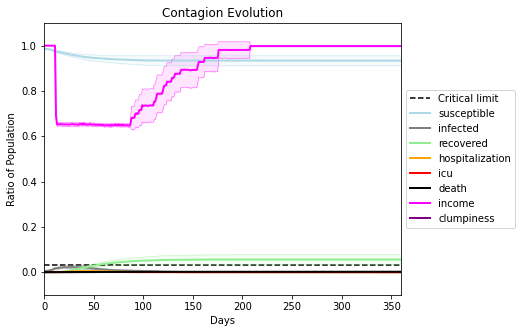

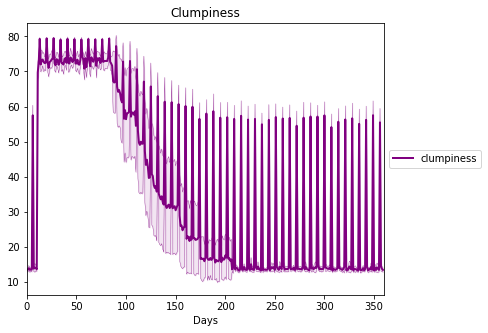

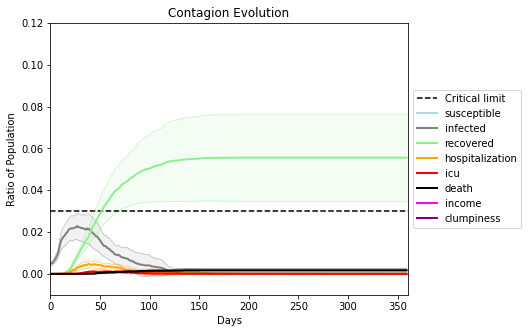

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.995", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[7614, 9454, 7133, 2264, 6051, 3095, 8099, 2858, 425, 9542, 7676, 5851, 4231, 8065, 9458, 3346, 1418, 7333, 4958, 1858]
Average similarity between family members is 0.9819862627376555 at temperature -0.994
Average similarity between family and home is 0.9998964790880482 at temperature -1
Average similarity between students and their classroom is 0.573601382260222 at temperature -0.994
Average classroom occupancy is 11.75 and number classrooms is 24
Average similarity between workers is 0.9608637083713749 at temperature -0.994
Average office occupancy is 9.954545454545455 and number offices is 66
Average friend similarity for adults: 0.9865492853158173 for kids: 0.7126431800941311
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBu

avg restaurant similarity 0.3566949812901645
disconnects
0.0
clumpiness 12.29
avg restaurant similarity 0.4380254597364822
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.3137155849433725
disconnects
0.0
clumpiness 12.41
avg restaurant similarity 0.5588129684916971
disconnects
0.02
clumpiness 13.82
avg restaurant similarity 0.5127136060907787
disconnects
0.0
clumpiness 12.32
avg restaurant similarity 0.4794538832767691
disconnects
0.01
clumpiness 12.41
avg restaurant similarity 0.32302118366430593
disconnects
0.48
clumpiness 45.35
avg restaurant similarity 0.57130789185201
disconnects
0.02
clumpiness 14.11
avg restaurant similarity 0.4817829750028094
disconnects
0.01
clumpiness 12.46
avg restaurant similarity 0.44218573915795195
disconnects
0.01
clumpiness 12.66
avg restaurant similarity 0.4289459757483799
disconnects
0.0
clumpiness 12.58
avg restaurant similarity 0.4837598876123143
disconnects
0.83
clumpiness 68.54
avg restaurant similarity 0.4940952583310221
disconnects


avg restaurant similarity 0.4844277148498904
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.4567575809981464
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.3883845825838305
disconnects
0.91
clumpiness 74.25
avg restaurant similarity 0.3151517930387662
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.5672282883531785
disconnects
0.92
clumpiness 74.39
avg restaurant similarity 0.4100128507253512
disconnects
0.9
clumpiness 73.46
avg restaurant similarity 0.4800696478959598
disconnects
0.93
clumpiness 75.1
avg restaurant similarity 0.3640117838528164
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.44324098733310163
disconnects
0.85
clumpiness 70.84
avg restaurant similarity 0.5505184617804757
disconnects
0.92
clumpiness 74.4
avg restaurant similarity 0.5985784973188841
disconnects
0.9
clumpiness 73.46
avg restaurant similarity 0.31953348281251476
disconnects
0.91
clumpiness 73.91
avg restaurant similarity 0.6457637075363111
disconnect

avg restaurant similarity 0.3567913038956391
disconnects
0.02
clumpiness 12.73
avg restaurant similarity 0.34189316453561586
disconnects
0.68
clumpiness 58.99
avg restaurant similarity 0.40360605721046683
disconnects
0.0
clumpiness 12.3
avg restaurant similarity 0.24307228397882455
disconnects
0.01
clumpiness 12.42
avg restaurant similarity 0.4529136864169348
disconnects
0.0
clumpiness 11.9
avg restaurant similarity 0.4360566221091539
disconnects
0.01
clumpiness 12.7
avg restaurant similarity 0.6222684066178583
disconnects
0.0
clumpiness 12.43
avg restaurant similarity 0.6803656328031095
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.5557265692153457
disconnects
0.5
clumpiness 48.05
avg restaurant similarity 0.5775478097884515
disconnects
0.0
clumpiness 12.1
avg restaurant similarity 0.5240672842716136
disconnects
0.01
clumpiness 12.95
avg restaurant similarity 0.5128560057901121
disconnects
0.01
clumpiness 12.18
avg restaurant similarity 0.4391605749389693
disconnects
0.

disconnects
0.02
clumpiness 14.03
avg restaurant similarity 0.4119143806105678
disconnects
0.0
clumpiness 11.91
avg restaurant similarity 0.5037375118965672
disconnects
0.56
clumpiness 51.04
avg restaurant similarity 0.3975287904557378
disconnects
0.02
clumpiness 13.28
avg restaurant similarity 0.4347225158264027
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.3636932826471225
disconnects
0.01
clumpiness 13.28
avg restaurant similarity 0.3383220732349332
disconnects
0.0
clumpiness 11.9
avg restaurant similarity 0.5228711533876298
disconnects
0.0
clumpiness 11.72
avg restaurant similarity 0.46742051218720354
disconnects
0.01
clumpiness 12.65
avg restaurant similarity 0.3588868567735648
disconnects
0.57
clumpiness 51.86
avg restaurant similarity 0.3629151891977603
disconnects
0.02
clumpiness 12.92
avg restaurant similarity 0.37418115406113345
disconnects
0.01
clumpiness 12.67
avg restaurant similarity 0.3264714086446477
disconnects
0.01
clumpiness 12.51
avg restaurant simila

avg restaurant similarity 0.39596388129007387
disconnects
0.0
clumpiness 11.98
avg restaurant similarity 0.47164869384257446
disconnects
0.0
clumpiness 11.9
avg restaurant similarity 0.5262027034006649
disconnects
0.0
clumpiness 11.78
avg restaurant similarity 0.44290809409183374
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.3985355243672925
disconnects
0.01
clumpiness 12.24
avg restaurant similarity 0.4160192717290957
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.4562917776550245
disconnects
0.38
clumpiness 40.72
avg restaurant similarity 0.5257634072549093
disconnects
0.01
clumpiness 12.76
avg restaurant similarity 0.4009748882515239
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.5338984567807694
disconnects
0.0
clumpiness 11.76
avg restaurant similarity 0.5111588822839447
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.4096820388056789
disconnects
0.78
clumpiness 66.08
avg restaurant similarity 0.43755075102915886
disconnects
0

avg restaurant similarity 0.49214038944526933
disconnects
0.45
clumpiness 44.19
avg restaurant similarity 0.4936852811633341
disconnects
0.01
clumpiness 11.89
avg restaurant similarity 0.40868262914065734
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.5074448072888962
disconnects
0.02
clumpiness 12.6
avg restaurant similarity 0.5308136067438227
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.38819819096005215
disconnects
0.0
clumpiness 12.24
avg restaurant similarity 0.40594864324754054
disconnects
0.01
clumpiness 12.19
avg restaurant similarity 0.4747174695603121
disconnects
0.45
clumpiness 43.09
avg restaurant similarity 0.39725656725641395
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.41432553465512456
disconnects
0.02
clumpiness 13.0
avg restaurant similarity 0.3921409497743315
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.37472492543315417
disconnects
0.01
clumpiness 12.15
avg restaurant similarity 0.4530330220470197
disconn

disconnects
0.0
clumpiness 11.79
avg restaurant similarity 0.4256399771277458
disconnects
0.43
clumpiness 43.45
avg restaurant similarity 0.32920021963495977
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.5745622432508899
disconnects
0.0
clumpiness 12.08
avg restaurant similarity 0.5343307427731923
disconnects
0.0
clumpiness 11.76
avg restaurant similarity 0.5331438873824108
disconnects
0.01
clumpiness 12.25
avg restaurant similarity 0.515235115881307
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.45048070189047407
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.4319475189498419
disconnects
0.51
clumpiness 47.88
avg restaurant similarity 0.4143160787368267
disconnects
0.0
clumpiness 11.65
avg restaurant similarity 0.522462928789944
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.42041742149985495
disconnects
0.0
clumpiness 12.34
avg restaurant similarity 0.6173365838399625
disconnects
0.01
clumpiness 11.92
avg restaurant similarity 

avg restaurant similarity 0.3794831137616451
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.5441021967506472
disconnects
0.43
clumpiness 42.14
avg restaurant similarity 0.45904522198972797
disconnects
0.0
clumpiness 11.0
avg restaurant similarity 0.4111731450614351
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.5413333944549762
disconnects
0.0
clumpiness 11.85
avg restaurant similarity 0.4001169485247468
disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.5285322501917239
disconnects
0.02
clumpiness 13.21
avg restaurant similarity 0.4395367200781174
disconnects
0.01
clumpiness 12.03
avg restaurant similarity 0.4036249552825734
disconnects
0.5
clumpiness 46.97
avg restaurant similarity 0.4950061868113167
disconnects
0.01
clumpiness 12.0
avg restaurant similarity 0.4370623647255444
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.5081294937915568
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.47977267322808337
disconnects
0.0
c

avg restaurant similarity 0.6170477191279016
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.598443804437725
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.5489433622848334
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.5203002793246545
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.5319129220045888
disconnects
0.0
clumpiness 12.55
avg restaurant similarity 0.5283463014047702
disconnects
0.0
clumpiness 12.08
avg restaurant similarity 0.6038617622894661
disconnects
0.62
clumpiness 54.44
avg restaurant similarity 0.5839379543848829
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.6780590624760942
disconnects
0.0
clumpiness 12.84
avg restaurant similarity 0.5963627915963373
disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.6351384435718688
disconnects
0.0
clumpiness 12.29
avg restaurant similarity 0.49198392512907707
disconnects
0.84
clumpiness 69.79
avg restaurant similarity 0.49656138526461274
disconnects
0.85
c

avg restaurant similarity 0.5341411777637378
disconnects
0.87
clumpiness 71.05
avg restaurant similarity 0.4731667618038547
disconnects
0.92
clumpiness 74.73
avg restaurant similarity 0.5286264706393656
disconnects
0.94
clumpiness 75.9
avg restaurant similarity 0.6611918420099442
disconnects
0.85
clumpiness 69.77
avg restaurant similarity 0.5875510363367437
disconnects
0.89
clumpiness 72.99
avg restaurant similarity 0.5480635196420521
disconnects
0.9
clumpiness 73.82
avg restaurant similarity 0.5413538955928452
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5584259434475102
disconnects
0.85
clumpiness 70.63
avg restaurant similarity 0.6213184943697733
disconnects
0.9
clumpiness 73.11
avg restaurant similarity 0.7298954569598148
disconnects
0.91
clumpiness 73.99
avg restaurant similarity 0.5126476380505595
disconnects
0.0
clumpiness 11.86
avg restaurant similarity 0.5171329658398297
disconnects
0.0
clumpiness 12.47
avg restaurant similarity 0.6033384614731282
disconnects
0.

avg restaurant similarity 0.5749789628722674
disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.5406379542177584
disconnects
0.0
clumpiness 11.78
avg restaurant similarity 0.5661819527182722
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.642063793626945
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.7135064450279403
disconnects
0.0
clumpiness 11.55
avg restaurant similarity 0.5266987941649826
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.6165448130050099
disconnects
0.45
clumpiness 46.02
avg restaurant similarity 0.7223664622629815
disconnects
0.0
clumpiness 11.57
avg restaurant similarity 0.5988669821911987
disconnects
0.0
clumpiness 11.66
avg restaurant similarity 0.5750083781271975
disconnects
0.0
clumpiness 11.77
avg restaurant similarity 0.67558427010178
disconnects
0.0
clumpiness 12.93
avg restaurant similarity 0.48754850194536936
disconnects
0.0
clumpiness 12.34
avg restaurant similarity 0.5722455396457996
disconnects
0.0
clum

disconnects
0.0
clumpiness 12.03
avg restaurant similarity 0.5296730732845768
disconnects
0.0
clumpiness 12.22
avg restaurant similarity 0.5368058555715259
disconnects
0.0
clumpiness 12.76
avg restaurant similarity 0.5172895495387704
disconnects
0.0
clumpiness 11.99
avg restaurant similarity 0.599883595359217
disconnects
0.0
clumpiness 12.26
avg restaurant similarity 0.5653361593836262
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.5379894406510293
disconnects
0.7
clumpiness 61.16
avg restaurant similarity 0.5453386610685881
disconnects
0.0
clumpiness 12.02
avg restaurant similarity 0.685865860711317
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.5759734175108187
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.5021759322229175
disconnects
0.0
clumpiness 11.85
avg restaurant similarity 0.606184747438948
disconnects
0.0
clumpiness 12.01
avg restaurant similarity 0.5850600942186395
disconnects
0.0
clumpiness 12.78
avg restaurant similarity 0.626631

avg restaurant similarity 0.28165104486294373
disconnects
0.02
clumpiness 13.15
avg restaurant similarity 0.6259585848408901
disconnects
0.01
clumpiness 13.6
avg restaurant similarity 0.44622497500533537
disconnects
0.02
clumpiness 13.73
avg restaurant similarity 0.4183902121588803
disconnects
0.0
clumpiness 12.34
avg restaurant similarity 0.3265394709991522
disconnects
0.01
clumpiness 13.39
avg restaurant similarity 0.5146400899187819
disconnects
0.01
clumpiness 13.18
avg restaurant similarity 0.4911612828377341
disconnects
0.58
clumpiness 52.1
avg restaurant similarity 0.42750625851142177
disconnects
0.03
clumpiness 13.65
avg restaurant similarity 0.5451318857530995
disconnects
0.03
clumpiness 14.71
avg restaurant similarity 0.35942872230773126
disconnects
0.0
clumpiness 12.32
avg restaurant similarity 0.37930849080864837
disconnects
0.0
clumpiness 12.39
avg restaurant similarity 0.5012597314828018
disconnects
0.95
clumpiness 76.49
avg restaurant similarity 0.45220885715098336
discon

avg restaurant similarity 0.34989320386518613
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.3411088395672601
disconnects
0.95
clumpiness 76.49
avg restaurant similarity 0.581935279408715
disconnects
0.92
clumpiness 74.52
avg restaurant similarity 0.48529726901625236
disconnects
0.01
clumpiness 12.87
avg restaurant similarity 0.4375972535750597
disconnects
0.0
clumpiness 13.01
avg restaurant similarity 0.39773985491137176
disconnects
0.0
clumpiness 12.83
avg restaurant similarity 0.5038670051524116
disconnects
0.01
clumpiness 12.73
avg restaurant similarity 0.3898724157995483
disconnects
0.63
clumpiness 56.61
avg restaurant similarity 0.4835770493333031
disconnects
0.0
clumpiness 12.69
avg restaurant similarity 0.6063856301928263
disconnects
0.0
clumpiness 13.41
avg restaurant similarity 0.4189229876456113
disconnects
0.03
clumpiness 14.91
avg restaurant similarity 0.5542156764411735
disconnects
0.02
clumpiness 13.9
avg restaurant similarity 0.3828470322569819
disconnect

avg restaurant similarity 0.35207129667768033
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.42473914166328897
disconnects
0.84
clumpiness 69.25
avg restaurant similarity 0.36800493510137067
disconnects
0.01
clumpiness 13.58
avg restaurant similarity 0.4830129014314484
disconnects
0.01
clumpiness 13.21
avg restaurant similarity 0.3557115036526754
disconnects
0.01
clumpiness 12.6
avg restaurant similarity 0.47045297581890055
disconnects
0.01
clumpiness 13.37
avg restaurant similarity 0.5073176285053793
disconnects
0.03
clumpiness 14.81
avg restaurant similarity 0.3396567030387607
disconnects
0.02
clumpiness 13.98
avg restaurant similarity 0.6841583805890614
disconnects
0.65
clumpiness 57.05
avg restaurant similarity 0.4323739494667847
disconnects
0.01
clumpiness 13.39
avg restaurant similarity 0.47265394761383905
disconnects
0.01
clumpiness 13.55
avg restaurant similarity 0.5596198310051024
disconnects
0.02
clumpiness 14.21
avg restaurant similarity 0.27707031922915537
dis

avg restaurant similarity 0.4820304568678753
disconnects
0.0
clumpiness 12.49
avg restaurant similarity 0.46146968709237246
disconnects
0.01
clumpiness 13.4
avg restaurant similarity 0.5161231955159149
disconnects
0.7
clumpiness 60.29
avg restaurant similarity 0.27493409100490146
disconnects
0.02
clumpiness 13.07
avg restaurant similarity 0.4797724385856263
disconnects
0.01
clumpiness 13.71
avg restaurant similarity 0.3399532942246524
disconnects
0.01
clumpiness 12.28
avg restaurant similarity 0.5717811618776795
disconnects
0.0
clumpiness 12.33
avg restaurant similarity 0.567380364162818
disconnects
0.01
clumpiness 12.98
avg restaurant similarity 0.3511633707179043
disconnects
0.02
clumpiness 13.76
avg restaurant similarity 0.4496455797629804
disconnects
0.66
clumpiness 57.33
avg restaurant similarity 0.39553538950495815
disconnects
0.01
clumpiness 12.58
avg restaurant similarity 0.5158451436065667
disconnects
0.0
clumpiness 12.27
avg restaurant similarity 0.29721354107576087
disconnec

avg restaurant similarity 0.7482556524629728
disconnects
0.01
clumpiness 12.8
avg restaurant similarity 0.5545015869308425
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.37135404573841607
disconnects
0.0
clumpiness 12.42
avg restaurant similarity 0.422761833987713
disconnects
0.02
clumpiness 13.15
avg restaurant similarity 0.6867672172912691
disconnects
0.02
clumpiness 13.39
avg restaurant similarity 0.5558067621097088
disconnects
0.02
clumpiness 13.77
avg restaurant similarity 0.6348466784991075
disconnects
0.51
clumpiness 48.02
avg restaurant similarity 0.5371198782931288
disconnects
0.02
clumpiness 13.12
avg restaurant similarity 0.5239910585930382
disconnects
0.01
clumpiness 12.61
avg restaurant similarity 0.3938550910117074
disconnects
0.01
clumpiness 12.97
avg restaurant similarity 0.22982561952265418
disconnects
0.01
clumpiness 13.14
avg restaurant similarity 0.4059731357331812
disconnects
0.87
clumpiness 71.04
avg restaurant similarity 0.6084260897026863
disconnec

avg restaurant similarity 0.5148945342048663
disconnects
0.6
clumpiness 55.56
avg restaurant similarity 0.3731794090212837
disconnects
0.01
clumpiness 12.99
avg restaurant similarity 0.4944893672219541
disconnects
0.0
clumpiness 11.65
avg restaurant similarity 0.5672073920001354
disconnects
0.01
clumpiness 12.09
avg restaurant similarity 0.31109539736414304
disconnects
0.0
clumpiness 12.03
avg restaurant similarity 0.6733451098145807
disconnects
0.0
clumpiness 12.68
avg restaurant similarity 0.4282064387637377
disconnects
0.02
clumpiness 12.62
avg restaurant similarity 0.6699152183791813
disconnects
0.67
clumpiness 57.98
avg restaurant similarity 0.5776071168904551
disconnects
0.05
clumpiness 16.5
avg restaurant similarity 0.45646443763048444
disconnects
0.02
clumpiness 13.82
avg restaurant similarity 0.4088360723362254
disconnects
0.02
clumpiness 13.48
avg restaurant similarity 0.519266667212565
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.4005905582572623
disconnects


avg restaurant similarity 0.4970167818694325
disconnects
0.01
clumpiness 13.05
avg restaurant similarity 0.49361162527029645
disconnects
0.53
clumpiness 50.34
avg restaurant similarity 0.24007033269601835
disconnects
0.01
clumpiness 12.24
avg restaurant similarity 0.3934693341597947
disconnects
0.0
clumpiness 12.18
avg restaurant similarity 0.5889747469677581
disconnects
0.02
clumpiness 13.97
avg restaurant similarity 0.6227241819349433
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.44736254467672826
disconnects
0.01
clumpiness 12.81
avg restaurant similarity 0.5357894908569785
disconnects
0.01
clumpiness 12.69
avg restaurant similarity 0.6161072895459139
disconnects
0.43
clumpiness 43.48
avg restaurant similarity 0.4166307251920183
disconnects
0.02
clumpiness 13.33
avg restaurant similarity 0.5497119722895195
disconnects
0.05
clumpiness 15.5
avg restaurant similarity 0.41244326651584245
disconnects
0.02
clumpiness 13.45
avg restaurant similarity 0.4486044458741067
discon

avg restaurant similarity 0.5906230251013875
disconnects
0.02
clumpiness 12.86
avg restaurant similarity 0.4565493151844774
disconnects
0.02
clumpiness 12.87
avg restaurant similarity 0.50804949315204
disconnects
0.54
clumpiness 50.98
avg restaurant similarity 0.5164631909216889
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.5891859557030728
disconnects
0.01
clumpiness 12.4
avg restaurant similarity 0.42596213333879696
disconnects
0.01
clumpiness 13.32
avg restaurant similarity 0.26960185404180786
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.4938337801902668
disconnects
0.01
clumpiness 12.7
avg restaurant similarity 0.5662211719050969
disconnects
0.0
clumpiness 12.15
avg restaurant similarity 0.5456954247514646
disconnects
0.51
clumpiness 48.42
avg restaurant similarity 0.5149346073925098
disconnects
0.02
clumpiness 13.78
avg restaurant similarity 0.561191796448364
disconnects
0.02
clumpiness 12.62
avg restaurant similarity 0.6075166452966939
disconnects
0

avg restaurant similarity 0.4585368052981742
disconnects
0.01
clumpiness 13.04
avg restaurant similarity 0.3657461627556811
disconnects
0.0
clumpiness 11.97
avg restaurant similarity 0.6371047732401762
disconnects
0.0
clumpiness 12.52
avg restaurant similarity 0.38997325056261317
disconnects
0.0
clumpiness 12.81
avg restaurant similarity 0.36491064898560244
disconnects
0.0
clumpiness 13.0
avg restaurant similarity 0.5082540089616093
disconnects
0.0
clumpiness 12.47
avg restaurant similarity 0.4539495863858434
disconnects
0.75
clumpiness 62.64
avg restaurant similarity 0.37796911503352615
disconnects
0.0
clumpiness 11.98
avg restaurant similarity 0.3050224772028376
disconnects
0.0
clumpiness 12.57
avg restaurant similarity 0.35657818506420075
disconnects
0.0
clumpiness 12.9
avg restaurant similarity 0.48084318866737336
disconnects
0.0
clumpiness 13.24
avg restaurant similarity 0.3911749218932046
disconnects
0.93
clumpiness 75.11
avg restaurant similarity 0.5122306223733377
disconnects
0

avg restaurant similarity 0.3485312104054842
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.5110331721902766
disconnects
0.88
clumpiness 72.04
avg restaurant similarity 0.5958830869907527
disconnects
0.89
clumpiness 72.22
avg restaurant similarity 0.5363538324835561
disconnects
0.81
clumpiness 67.04
avg restaurant similarity 0.42326072211119015
disconnects
0.93
clumpiness 75.12
avg restaurant similarity 0.4973338822659853
disconnects
0.95
clumpiness 76.6
avg restaurant similarity 0.39004844877399497
disconnects
0.96
clumpiness 77.16
avg restaurant similarity 0.3993862085215006
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.3410906074060004
disconnects
0.89
clumpiness 71.84
avg restaurant similarity 0.427641161728632
disconnects
0.83
clumpiness 68.51
avg restaurant similarity 0.3677679537904473
disconnects
0.96
clumpiness 77.16
avg restaurant similarity 0.42084574795623175
disconnects
0.98
clumpiness 78.66
avg restaurant similarity 0.64398554761255
disconnec

disconnects
0.0
clumpiness 13.03
avg restaurant similarity 0.2847221139514047
disconnects
0.69
clumpiness 59.67
avg restaurant similarity 0.33793594585804393
disconnects
0.0
clumpiness 13.42
avg restaurant similarity 0.5567274056961559
disconnects
0.0
clumpiness 12.58
avg restaurant similarity 0.4805352265955783
disconnects
0.0
clumpiness 13.03
avg restaurant similarity 0.4956239956476305
disconnects
0.01
clumpiness 13.68
avg restaurant similarity 0.6065837781139414
disconnects
0.01
clumpiness 12.79
avg restaurant similarity 0.39433875125571394
disconnects
0.0
clumpiness 13.04
avg restaurant similarity 0.40411485476625003
disconnects
0.5
clumpiness 46.86
avg restaurant similarity 0.38552536376107954
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.5011091043395255
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.3989415022607638
disconnects
0.01
clumpiness 12.96
avg restaurant similarity 0.4231200854859362
disconnects
0.0
clumpiness 13.11
avg restaurant similari

avg restaurant similarity 0.4770396335203774
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.4413007386014823
disconnects
0.7
clumpiness 59.74
avg restaurant similarity 0.3431519861448898
disconnects
0.02
clumpiness 13.61
avg restaurant similarity 0.4445907993699146
disconnects
0.0
clumpiness 12.24
avg restaurant similarity 0.4522257553754467
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.35292607555237104
disconnects
0.01
clumpiness 13.81
avg restaurant similarity 0.654228565165829
disconnects
0.01
clumpiness 14.11
avg restaurant similarity 0.5630632473485543
disconnects
0.0
clumpiness 12.59
avg restaurant similarity 0.4099343951547537
disconnects
0.45
clumpiness 43.77
avg restaurant similarity 0.567551118646691
disconnects
0.0
clumpiness 13.1
avg restaurant similarity 0.40621499060866423
disconnects
0.01
clumpiness 13.57
avg restaurant similarity 0.4010440351078254
disconnects
0.0
clumpiness 13.46
avg restaurant similarity 0.5850274143068366
disconnects
0.0

avg restaurant similarity 0.5970319967567607
disconnects
0.06
clumpiness 16.88
avg restaurant similarity 0.4750379325822475
disconnects
0.02
clumpiness 14.01
avg restaurant similarity 0.4484913533320917
disconnects
0.01
clumpiness 13.53
avg restaurant similarity 0.4395942924744131
disconnects
0.01
clumpiness 14.28
avg restaurant similarity 0.7100230370219148
disconnects
0.02
clumpiness 14.16
avg restaurant similarity 0.23878694598683098
disconnects
0.01
clumpiness 14.14
avg restaurant similarity 0.49555163736073216
disconnects
0.61
clumpiness 54.98
avg restaurant similarity 0.5119020528775982
disconnects
0.0
clumpiness 12.88
avg restaurant similarity 0.3908015260371786
disconnects
0.0
clumpiness 12.85
avg restaurant similarity 0.572879879202648
disconnects
0.02
clumpiness 14.7
avg restaurant similarity 0.5067149044999516
disconnects
0.01
clumpiness 14.32
avg restaurant similarity 0.5740745765543883
disconnects
0.86
clumpiness 70.54
avg restaurant similarity 0.5586576967758909
disconnec

avg restaurant similarity 0.447808770992053
disconnects
0.48
clumpiness 46.92
avg restaurant similarity 0.44563179859337837
disconnects
0.01
clumpiness 13.26
avg restaurant similarity 0.5085831005279906
disconnects
0.01
clumpiness 13.71
avg restaurant similarity 0.4865463957980686
disconnects
0.02
clumpiness 12.87
avg restaurant similarity 0.5541595809893213
disconnects
0.01
clumpiness 13.46
avg restaurant similarity 0.4019597491292708
disconnects
0.0
clumpiness 13.55
avg restaurant similarity 0.5839670799070994
disconnects
0.01
clumpiness 13.76
avg restaurant similarity 0.27558068040415895
disconnects
0.5
clumpiness 49.17
avg restaurant similarity 0.49674726196079044
disconnects
0.0
clumpiness 12.17
avg restaurant similarity 0.5748115487511397
disconnects
0.03
clumpiness 14.72
avg restaurant similarity 0.5318044710205009
disconnects
0.02
clumpiness 14.61
avg restaurant similarity 0.5343569723492683
disconnects
0.02
clumpiness 14.51
avg restaurant similarity 0.5454302868975731
disconne

avg restaurant similarity 0.6955055817761002
disconnects
0.01
clumpiness 14.16
avg restaurant similarity 0.47172836841006155
disconnects
0.63
clumpiness 56.94
avg restaurant similarity 0.5495579653253903
disconnects
0.0
clumpiness 13.18
avg restaurant similarity 0.4867213182486229
disconnects
0.01
clumpiness 14.0
avg restaurant similarity 0.6091214476605522
disconnects
0.02
clumpiness 13.09
avg restaurant similarity 0.2841238031422977
disconnects
0.02
clumpiness 14.61
avg restaurant similarity 0.32002351665484424
disconnects
0.01
clumpiness 13.41
avg restaurant similarity 0.4219269435425968
disconnects
0.0
clumpiness 12.73
avg restaurant similarity 0.23578336553637697
disconnects
0.75
clumpiness 63.37
avg restaurant similarity 0.44901947437351286
disconnects
0.0
clumpiness 12.25
avg restaurant similarity 0.33922265555186765
disconnects
0.02
clumpiness 14.18
avg restaurant similarity 0.5992419786600783
disconnects
0.03
clumpiness 14.39
avg restaurant similarity 0.44742157324953696
disco

avg restaurant similarity 0.5025974662857748
disconnects
0.01
clumpiness 14.13
avg restaurant similarity 0.48222915325675686
disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.3885024685617543
disconnects
0.72
clumpiness 61.24
avg restaurant similarity 0.5144466532505225
disconnects
0.01
clumpiness 13.18
avg restaurant similarity 0.596226971233543
disconnects
0.01
clumpiness 14.04
avg restaurant similarity 0.47548563492384477
disconnects
0.02
clumpiness 13.78
avg restaurant similarity 0.5037133484187901
disconnects
0.03
clumpiness 14.96
avg restaurant similarity 0.508797888391639
disconnects
0.02
clumpiness 14.8
avg restaurant similarity 0.5152875143558031
disconnects
0.01
clumpiness 13.59
avg restaurant similarity 0.38395830596096636
disconnects
0.55
clumpiness 50.2
avg restaurant similarity 0.5068150678814164
disconnects
0.02
clumpiness 14.06
avg restaurant similarity 0.3964407243130224
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.36715813223775556
disconnect

avg restaurant similarity 0.3825256169606699
disconnects
0.0
clumpiness 12.07
avg restaurant similarity 0.4874410431237636
disconnects
0.0
clumpiness 12.88
avg restaurant similarity 0.4671270399623938
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.5031607495567908
disconnects
0.0
clumpiness 11.48
avg restaurant similarity 0.46963483755149116
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.4587266043048345
disconnects
0.01
clumpiness 13.23
avg restaurant similarity 0.5488164120329035
disconnects
0.56
clumpiness 51.63
avg restaurant similarity 0.5009035014734036
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.5205399347407904
disconnects
0.0
clumpiness 11.67
avg restaurant similarity 0.5470793898631349
disconnects
0.0
clumpiness 11.62
avg restaurant similarity 0.5103037224002019
disconnects
0.0
clumpiness 11.8
avg restaurant similarity 0.6064769601135772
disconnects
0.92
clumpiness 74.69
avg restaurant similarity 0.5742322390303319
disconnects
0.83

avg restaurant similarity 0.5096554247420085
disconnects
0.89
clumpiness 72.21
avg restaurant similarity 0.4959592425692909
disconnects
0.92
clumpiness 74.79
avg restaurant similarity 0.5402001078215511
disconnects
0.84
clumpiness 69.82
avg restaurant similarity 0.5080039907813636
disconnects
0.87
clumpiness 71.89
avg restaurant similarity 0.4066391692687124
disconnects
0.83
clumpiness 69.28
avg restaurant similarity 0.48394974008287717
disconnects
0.92
clumpiness 74.5
avg restaurant similarity 0.3465231683553906
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.42556020715837417
disconnects
0.92
clumpiness 74.3
avg restaurant similarity 0.5232697516533785
disconnects
0.83
clumpiness 69.34
avg restaurant similarity 0.45816145403068465
disconnects
0.88
clumpiness 71.61
avg restaurant similarity 0.5117765114627393
disconnects
0.68
clumpiness 59.13
avg restaurant similarity 0.5064399277076563
disconnects
0.9
clumpiness 73.33
avg restaurant similarity 0.5374882017145631
disconn

avg restaurant similarity 0.46165245955824247
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3635578733224779
disconnects
0.85
clumpiness 70.18
avg restaurant similarity 0.41448435727709093
disconnects
0.78
clumpiness 65.61
avg restaurant similarity 0.5015679440798828
disconnects
0.89
clumpiness 72.8
avg restaurant similarity 0.5489532990773252
disconnects
0.75
clumpiness 63.63
avg restaurant similarity 0.6901656541802381
disconnects
0.83
clumpiness 68.97
avg restaurant similarity 0.5016194823678671
disconnects
0.88
clumpiness 72.0
avg restaurant similarity 0.5953825198886771
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.4743038203557359
disconnects
0.91
clumpiness 73.79
avg restaurant similarity 0.516201585241823
disconnects
0.88
clumpiness 71.85
avg restaurant similarity 0.47329191988661756
disconnects
0.96
clumpiness 77.25
avg restaurant similarity 0.49589250724099115
disconnects
0.76
clumpiness 65.9
avg restaurant similarity 0.4643643555310609
disconnect

disconnects
0.01
clumpiness 13.02
avg restaurant similarity 0.5754658774124933
disconnects
0.74
clumpiness 62.59
avg restaurant similarity 0.3999401346162371
disconnects
0.0
clumpiness 11.91
avg restaurant similarity 0.4994637963150143
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.34877121960231694
disconnects
0.0
clumpiness 12.22
avg restaurant similarity 0.5942747800414467
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.5692690089316214
disconnects
0.01
clumpiness 12.84
avg restaurant similarity 0.48384581682021927
disconnects
0.0
clumpiness 12.6
avg restaurant similarity 0.6296645802296031
disconnects
0.5
clumpiness 46.79
avg restaurant similarity 0.5361617932348061
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.4661767745386308
disconnects
0.0
clumpiness 12.15
avg restaurant similarity 0.5236435456205529
disconnects
0.01
clumpiness 11.76
avg restaurant similarity 0.3840566018867916
disconnects
0.0
clumpiness 11.54
avg restaurant similarity 0

avg restaurant similarity 0.6409236292962861
disconnects
0.0
clumpiness 12.4
avg restaurant similarity 0.5351168249208195
disconnects
0.01
clumpiness 12.82
avg restaurant similarity 0.2989669772882082
disconnects
0.0
clumpiness 12.03
avg restaurant similarity 0.5193673182646074
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.46976991541831425
disconnects
0.01
clumpiness 13.83
avg restaurant similarity 0.5110771050312436
disconnects
0.0
clumpiness 12.39
avg restaurant similarity 0.295016391854972
disconnects
0.69
clumpiness 59.33
avg restaurant similarity 0.39545675575969114
disconnects
0.0
clumpiness 11.99
avg restaurant similarity 0.43580725394581427
disconnects
0.0
clumpiness 12.01
avg restaurant similarity 0.6643752802916362
disconnects
0.0
clumpiness 12.21
avg restaurant similarity 0.6521433319849476
disconnects
0.0
clumpiness 11.92
avg restaurant similarity 0.3439165826714158
disconnects
0.9
clumpiness 72.98
avg restaurant similarity 0.43883593764789897
disconnects
0.

avg restaurant similarity 0.5088104204344726
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3628731550071207
disconnects
0.95
clumpiness 76.54
avg restaurant similarity 0.14016064488463764
disconnects
0.83
clumpiness 69.31
avg restaurant similarity 0.2666330909917015
disconnects
0.9
clumpiness 73.27
avg restaurant similarity 0.33643393810507405
disconnects
0.91
clumpiness 73.68
avg restaurant similarity 0.3506400219244872
disconnects
0.94
clumpiness 75.66
avg restaurant similarity 0.35096687194168114
disconnects
0.82
clumpiness 67.66
avg restaurant similarity 0.3914710841240187
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.3579312496988383
disconnects
0.9
clumpiness 73.02
avg restaurant similarity 0.6082846125471669
disconnects
0.88
clumpiness 71.78
avg restaurant similarity 0.28264524535522634
disconnects
0.95
clumpiness 76.43
avg restaurant similarity 0.4867857263721561
disconnects
0.92
clumpiness 74.23
avg restaurant similarity 0.4571911506582931
disconn

disconnects
0.0
clumpiness 12.21
avg restaurant similarity 0.3496818866310674
disconnects
0.72
clumpiness 62.72
avg restaurant similarity 0.5303594222579346
disconnects
0.01
clumpiness 11.64
avg restaurant similarity 0.2567865409023049
disconnects
0.0
clumpiness 12.18
avg restaurant similarity 0.20459372372040807
disconnects
0.0
clumpiness 12.59
avg restaurant similarity 0.30404025120525907
disconnects
0.0
clumpiness 12.71
avg restaurant similarity 0.4559981368294937
disconnects
0.0
clumpiness 12.58
avg restaurant similarity 0.6413356206647183
disconnects
0.0
clumpiness 12.7
avg restaurant similarity 0.5162668082434969
disconnects
0.81
clumpiness 66.87
avg restaurant similarity 0.2112541960083966
disconnects
0.0
clumpiness 11.66
avg restaurant similarity 0.3376639949921348
disconnects
0.01
clumpiness 12.93
avg restaurant similarity 0.5340188508178701
disconnects
0.0
clumpiness 13.2
avg restaurant similarity 0.36342669431139063
disconnects
0.0
clumpiness 11.91
avg restaurant similarity 

avg restaurant similarity 0.34638669204155603
disconnects
0.01
clumpiness 12.69
avg restaurant similarity 0.4254481058327563
disconnects
0.6
clumpiness 54.04
avg restaurant similarity 0.5413180466096265
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.3889691954402796
disconnects
0.0
clumpiness 12.09
avg restaurant similarity 0.33730211167234153
disconnects
0.0
clumpiness 12.05
avg restaurant similarity 0.49343454273108955
disconnects
0.01
clumpiness 12.92
avg restaurant similarity 0.37880280044050185
disconnects
0.01
clumpiness 13.04
avg restaurant similarity 0.3119844804064274
disconnects
0.0
clumpiness 12.05
avg restaurant similarity 0.5057948967641996
disconnects
0.69
clumpiness 60.26
avg restaurant similarity 0.3945625174282045
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.34615907055026796
disconnects
0.01
clumpiness 13.05
avg restaurant similarity 0.475089137448486
disconnects
0.01
clumpiness 12.66
avg restaurant similarity 0.4794067765113312
disconnec

avg restaurant similarity 0.4199832515296281
disconnects
0.0
clumpiness 11.38
avg restaurant similarity 0.5421145865507204
disconnects
0.0
clumpiness 11.54
avg restaurant similarity 0.4331814021411581
disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.5055974387061843
disconnects
0.0
clumpiness 12.09
avg restaurant similarity 0.6242956308813573
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.5847721436936012
disconnects
0.0
clumpiness 11.77
avg restaurant similarity 0.5446412961528221
disconnects
0.4
clumpiness 40.89
avg restaurant similarity 0.45217393392113725
disconnects
0.0
clumpiness 11.65
avg restaurant similarity 0.5967589528726549
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.5336807150446103
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.43387870030712505
disconnects
0.0
clumpiness 13.15
avg restaurant similarity 0.5253694549333198
disconnects
0.89
clumpiness 72.71
avg restaurant similarity 0.5687289644076806
disconnects
0.79


avg restaurant similarity 0.529343497846246
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.47558598948496483
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.577559786604334
disconnects
0.96
clumpiness 77.31
avg restaurant similarity 0.5870258372360408
disconnects
0.88
clumpiness 71.86
avg restaurant similarity 0.6110921055747962
disconnects
0.93
clumpiness 75.08
avg restaurant similarity 0.5002183802780769
disconnects
0.87
clumpiness 71.7
avg restaurant similarity 0.45864006399409324
disconnects
0.81
clumpiness 68.16
avg restaurant similarity 0.5553525298504011
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5099014602009753
disconnects
0.81
clumpiness 68.73
avg restaurant similarity 0.4766639286650121
disconnects
0.92
clumpiness 74.53
avg restaurant similarity 0.5000432283637748
disconnects
0.74
clumpiness 63.88
avg restaurant similarity 0.49127593065110825
disconnects
0.89
clumpiness 72.41
avg restaurant similarity 0.5105365780942218
disconnects

disconnects
0.0
clumpiness 11.49
avg restaurant similarity 0.5328823009906176
disconnects
0.49
clumpiness 46.75
avg restaurant similarity 0.5416376970479888
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.5530484128366635
disconnects
0.0
clumpiness 11.54
avg restaurant similarity 0.5336816846431554
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.4359866763419844
disconnects
0.0
clumpiness 11.67
avg restaurant similarity 0.4166554127808433
disconnects
0.0
clumpiness 11.85
avg restaurant similarity 0.5631597813279228
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.7072203518056044
disconnects
0.49
clumpiness 47.59
avg restaurant similarity 0.459379730450494
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.5523863558785946
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.39334105520623874
disconnects
0.0
clumpiness 11.48
avg restaurant similarity 0.46690708197799224
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.

disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.4743138698216409
disconnects
0.5
clumpiness 47.47
avg restaurant similarity 0.4920398754097342
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.4832474755438496
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.41972393964298943
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.4793211008043125
disconnects
0.0
clumpiness 12.2
avg restaurant similarity 0.5627847888424936
disconnects
0.0
clumpiness 11.34
avg restaurant similarity 0.3869580719971965
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.515380474737665
disconnects
0.36
clumpiness 37.87
avg restaurant similarity 0.6110525732352345
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.6194932751655114
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.43140722672873594
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.547523438394974
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.500

avg restaurant similarity 0.6366604400092176
disconnects
0.0
clumpiness 13.1
avg restaurant similarity 0.45833317101576154
disconnects
0.0
clumpiness 12.08
avg restaurant similarity 0.5264786279999134
disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.39597242778491437
disconnects
0.0
clumpiness 12.17
avg restaurant similarity 0.5487367354235025
disconnects
0.0
clumpiness 12.92
avg restaurant similarity 0.37206127557935176
disconnects
0.0
clumpiness 11.91
avg restaurant similarity 0.4691225855788041
disconnects
0.72
clumpiness 61.02
avg restaurant similarity 0.47791636664973386
disconnects
0.0
clumpiness 13.15
avg restaurant similarity 0.3717167107917119
disconnects
0.0
clumpiness 12.56
avg restaurant similarity 0.42406677670043663
disconnects
0.0
clumpiness 11.99
avg restaurant similarity 0.33035240153163575
disconnects
0.0
clumpiness 12.14
avg restaurant similarity 0.4923342385108787
disconnects
0.67
clumpiness 58.65
avg restaurant similarity 0.4294138515793528
disconnects


avg restaurant similarity 0.47275716798777306
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.38293414861140185
disconnects
0.7
clumpiness 60.35
avg restaurant similarity 0.45658550372701306
disconnects
0.89
clumpiness 72.87
avg restaurant similarity 0.5339623423673204
disconnects
0.93
clumpiness 75.1
avg restaurant similarity 0.402898233944894
disconnects
0.68
clumpiness 59.52
avg restaurant similarity 0.3645140124184537
disconnects
0.77
clumpiness 64.98
avg restaurant similarity 0.5518746732611843
disconnects
0.75
clumpiness 64.35
avg restaurant similarity 0.5309786662928292
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.4233372032491959
disconnects
0.85
clumpiness 69.9
avg restaurant similarity 0.6137360700607325
disconnects
0.95
clumpiness 76.89
avg restaurant similarity 0.5223812355571829
disconnects
0.89
clumpiness 72.3
avg restaurant similarity 0.4890395647671519
disconnects
0.76
clumpiness 65.45
avg restaurant similarity 0.5002487551668676
disconnec

disconnects
0.0
clumpiness 12.96
avg restaurant similarity 0.6381085711504355
disconnects
0.77
clumpiness 64.3
avg restaurant similarity 0.5663228869766167
disconnects
0.0
clumpiness 12.64
avg restaurant similarity 0.5011300856225285
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.4843077997532833
disconnects
0.0
clumpiness 12.05
avg restaurant similarity 0.4372275054897909
disconnects
0.0
clumpiness 11.91
avg restaurant similarity 0.33863108044621193
disconnects
0.0
clumpiness 12.02
avg restaurant similarity 0.49013390361148695
disconnects
0.0
clumpiness 11.95
avg restaurant similarity 0.3861482364428164
disconnects
0.49
clumpiness 47.12
avg restaurant similarity 0.49944790036447356
disconnects
0.0
clumpiness 11.94
avg restaurant similarity 0.4660976652588207
disconnects
0.0
clumpiness 12.22
avg restaurant similarity 0.3378000996437262
disconnects
0.0
clumpiness 12.79
avg restaurant similarity 0.48982868852752587
disconnects
0.0
clumpiness 12.39
avg restaurant similarity 

disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.42105132006202745
disconnects
0.54
clumpiness 50.91
avg restaurant similarity 0.36649733881415036
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.41044018885362965
disconnects
0.0
clumpiness 11.64
avg restaurant similarity 0.3752387879876361
disconnects
0.0
clumpiness 12.24
avg restaurant similarity 0.42191861132624486
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.44487029359148905
disconnects
0.0
clumpiness 13.24
avg restaurant similarity 0.5302231094890546
disconnects
0.0
clumpiness 13.1
avg restaurant similarity 0.4385272267139407
disconnects
0.5
clumpiness 46.69
avg restaurant similarity 0.33425285201993865
disconnects
0.0
clumpiness 12.94
avg restaurant similarity 0.4252475077516865
disconnects
0.0
clumpiness 12.02
avg restaurant similarity 0.3686934568187305
disconnects
0.0
clumpiness 12.02
avg restaurant similarity 0.4191947606199062
disconnects
0.0
clumpiness 12.25
avg restaurant similarity

avg restaurant similarity 0.627857730318742
disconnects
0.0
clumpiness 13.04
avg restaurant similarity 0.6463973300268065
disconnects
0.0
clumpiness 12.46
avg restaurant similarity 0.6011314255317796
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.5001198349123183
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.4911580492303724
disconnects
0.0
clumpiness 12.1
avg restaurant similarity 0.520549469683324
disconnects
0.0
clumpiness 12.83
avg restaurant similarity 0.5080511333371519
disconnects
0.47
clumpiness 47.82
avg restaurant similarity 0.6327464900509275
disconnects
0.0
clumpiness 11.94
avg restaurant similarity 0.5383355696303365
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.4739264866700931
disconnects
0.0
clumpiness 12.63
avg restaurant similarity 0.5352722378396608
disconnects
0.0
clumpiness 13.17
avg restaurant similarity 0.38443623212077144
disconnects
0.85
clumpiness 69.97
avg restaurant similarity 0.4444570275720403
disconnects
0.83
cl

avg restaurant similarity 0.5019656473037699
disconnects
0.89
clumpiness 72.38
avg restaurant similarity 0.6570035896870754
disconnects
0.88
clumpiness 71.81
avg restaurant similarity 0.6140275351977614
disconnects
0.93
clumpiness 75.21
avg restaurant similarity 0.6138405067623447
disconnects
0.93
clumpiness 75.22
avg restaurant similarity 0.5164507024430007
disconnects
0.81
clumpiness 67.51
avg restaurant similarity 0.5391172152845516
disconnects
0.83
clumpiness 68.59
avg restaurant similarity 0.43355058916194383
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.5697729347833725
disconnects
0.89
clumpiness 72.55
avg restaurant similarity 0.41799997585419046
disconnects
0.84
clumpiness 69.53
avg restaurant similarity 0.5264484048891447
disconnects
0.91
clumpiness 74.11
avg restaurant similarity 0.46612290167598697
disconnects
0.88
clumpiness 71.79
avg restaurant similarity 0.587345195409774
disconnects
0.94
clumpiness 75.86
avg restaurant similarity 0.5358909600469192
disco

disconnects
0.72
clumpiness 61.44
avg restaurant similarity 0.47960528483357556
disconnects
0.0
clumpiness 12.1
avg restaurant similarity 0.4128773615844816
disconnects
0.0
clumpiness 12.05
avg restaurant similarity 0.41314538642335724
disconnects
0.0
clumpiness 12.74
avg restaurant similarity 0.6055215818232763
disconnects
0.0
clumpiness 12.67
avg restaurant similarity 0.5423342088674046
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.527238313943662
disconnects
0.0
clumpiness 12.75
avg restaurant similarity 0.547971910825531
disconnects
0.47
clumpiness 48.18
avg restaurant similarity 0.5924137303865414
disconnects
0.0
clumpiness 12.57
avg restaurant similarity 0.5656163069212697
disconnects
0.0
clumpiness 12.96
avg restaurant similarity 0.4731609209203193
disconnects
0.0
clumpiness 11.86
avg restaurant similarity 0.48790259819377774
disconnects
0.0
clumpiness 13.01
avg restaurant similarity 0.49733356978451976
disconnects
0.0
clumpiness 12.24
avg restaurant similarity 0.

disconnects
0.44
clumpiness 43.53
avg restaurant similarity 0.5389444255448367
disconnects
0.0
clumpiness 13.05
avg restaurant similarity 0.44823117437355786
disconnects
0.0
clumpiness 12.49
avg restaurant similarity 0.4426065371213832
disconnects
0.0
clumpiness 11.6
avg restaurant similarity 0.42671394588239175
disconnects
0.0
clumpiness 12.87
avg restaurant similarity 0.5425162326519932
disconnects
0.0
clumpiness 12.44
avg restaurant similarity 0.4946508445213806
disconnects
0.0
clumpiness 12.43
avg restaurant similarity 0.2661965700218725
disconnects
0.64
clumpiness 57.32
avg restaurant similarity 0.5463399826791172
disconnects
0.0
clumpiness 12.77
avg restaurant similarity 0.4051645788649925
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.5641447684777277
disconnects
0.0
clumpiness 12.54
avg restaurant similarity 0.5668259823601339
disconnects
0.0
clumpiness 12.47
avg restaurant similarity 0.5800226201987904
disconnects
0.0
clumpiness 12.41
avg restaurant similarity 0.

avg restaurant similarity 0.463408034357628
disconnects
0.1
clumpiness 17.63
avg restaurant similarity 0.5089875346906956
disconnects
0.0
clumpiness 11.54
avg restaurant similarity 0.33081019126701566
disconnects
0.05
clumpiness 14.66
avg restaurant similarity 0.3692592105741357
disconnects
0.0
clumpiness 11.48
avg restaurant similarity 0.4061189825413051
disconnects
0.11
clumpiness 18.49
avg restaurant similarity 0.3914969189303684
disconnects
0.14
clumpiness 20.79
avg restaurant similarity 0.35297597136406267
disconnects
0.5
clumpiness 48.13
avg restaurant similarity 0.41670792945425433
disconnects
0.0
clumpiness 11.41
avg restaurant similarity 0.38966560940026834
disconnects
0.0
clumpiness 11.62
avg restaurant similarity 0.3632352950257725
disconnects
0.1
clumpiness 18.45
avg restaurant similarity 0.3185988438685335
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.3162897045924082
disconnects
0.72
clumpiness 63.01
avg restaurant similarity 0.470019619827585
disconnects
0

avg restaurant similarity 0.43225312193597937
disconnects
0.56
clumpiness 50.43
avg restaurant similarity 0.32729595500433
disconnects
0.0
clumpiness 11.88
avg restaurant similarity 0.3888508087448354
disconnects
0.0
clumpiness 11.34
avg restaurant similarity 0.430101596708741
disconnects
0.0
clumpiness 11.52
avg restaurant similarity 0.3656593732764332
disconnects
0.0
clumpiness 12.39
avg restaurant similarity 0.4603461943715596
disconnects
0.11
clumpiness 19.13
avg restaurant similarity 0.5738711959727509
disconnects
0.0
clumpiness 11.75
avg restaurant similarity 0.4225140923604133
disconnects
0.54
clumpiness 50.49
avg restaurant similarity 0.4828907763517727
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.3327191596559652
disconnects
0.0
clumpiness 11.89
avg restaurant similarity 0.32068890096973846
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.36528487119559777
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.34251822785447117
disconnects
0.15

disconnects
0.0
clumpiness 11.58
avg restaurant similarity 0.4927677787629341
disconnects
0.56
clumpiness 51.62
avg restaurant similarity 0.4024003804841544
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.5040071608845721
disconnects
0.07
clumpiness 15.71
avg restaurant similarity 0.3677634854505182
disconnects
0.12
clumpiness 19.45
avg restaurant similarity 0.44057518271596724
disconnects
0.07
clumpiness 16.16
avg restaurant similarity 0.3932850311735145
disconnects
0.1
clumpiness 18.58
avg restaurant similarity 0.45657488916963074
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.3349648119400244
disconnects
0.47
clumpiness 45.97
avg restaurant similarity 0.30091634822337937
disconnects
0.0
clumpiness 12.75
avg restaurant similarity 0.29543694935959736
disconnects
0.0
clumpiness 11.94
avg restaurant similarity 0.36052763645587427
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.3232308217103974
disconnects
0.09
clumpiness 17.66
avg restaurant simil

disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.5110549449968907
disconnects
0.09
clumpiness 17.52
avg restaurant similarity 0.4890554075269327
disconnects
0.46
clumpiness 43.5
avg restaurant similarity 0.41610008393817915
disconnects
0.14
clumpiness 21.04
avg restaurant similarity 0.42637315597217734
disconnects
0.0
clumpiness 12.51
avg restaurant similarity 0.45391454035273476
disconnects
0.09
clumpiness 16.88
avg restaurant similarity 0.45469137921634684
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.37514466137946695
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.5283000593972789
disconnects
0.08
clumpiness 16.67
avg restaurant similarity 0.42891476161195213
disconnects
0.66
clumpiness 57.01
avg restaurant similarity 0.35703795186551446
disconnects
0.0
clumpiness 12.16
avg restaurant similarity 0.46184451595240267
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.3943313161466921
disconnects
0.0
clumpiness 12.02
avg restaurant sim

avg restaurant similarity 0.5846251379139243
disconnects
0.0
clumpiness 13.98
avg restaurant similarity 0.443331299345912
disconnects
0.0
clumpiness 13.18
avg restaurant similarity 0.39962701107182047
disconnects
0.0
clumpiness 13.7
avg restaurant similarity 0.5395303826341445
disconnects
0.0
clumpiness 12.86
avg restaurant similarity 0.4621890206231343
disconnects
0.0
clumpiness 13.13
avg restaurant similarity 0.5477015659469058
disconnects
0.0
clumpiness 12.82
avg restaurant similarity 0.5779813164285709
disconnects
0.63
clumpiness 55.86
avg restaurant similarity 0.4754191465476925
disconnects
0.0
clumpiness 14.33
avg restaurant similarity 0.3846934766750712
disconnects
0.0
clumpiness 13.59
avg restaurant similarity 0.520611485640225
disconnects
0.0
clumpiness 13.52
avg restaurant similarity 0.49887449192886624
disconnects
0.0
clumpiness 13.42
avg restaurant similarity 0.4684750175965951
disconnects
0.9
clumpiness 73.81
avg restaurant similarity 0.5284071312597856
disconnects
0.95
cl

avg restaurant similarity 0.5265435500297763
disconnects
0.94
clumpiness 76.07
avg restaurant similarity 0.5907846733880207
disconnects
0.89
clumpiness 72.58
avg restaurant similarity 0.4884221119892334
disconnects
0.89
clumpiness 72.6
avg restaurant similarity 0.3912502145025622
disconnects
0.91
clumpiness 74.46
avg restaurant similarity 0.7098051346136454
disconnects
0.85
clumpiness 69.77
avg restaurant similarity 0.5067742137238475
disconnects
0.91
clumpiness 73.91
avg restaurant similarity 0.40362633087977856
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.47166993433741145
disconnects
0.87
clumpiness 72.93
avg restaurant similarity 0.3537663478561398
disconnects
0.88
clumpiness 71.86
avg restaurant similarity 0.33140182865817386
disconnects
0.94
clumpiness 75.88
avg restaurant similarity 0.3727577606240518
disconnects
0.79
clumpiness 66.47
avg restaurant similarity 0.6189530202727883
disconnects
0.72
clumpiness 64.14
avg restaurant similarity 0.48658855688666147
discon

disconnects
0.54
clumpiness 51.36
avg restaurant similarity 0.5234568265420664
disconnects
0.0
clumpiness 12.95
avg restaurant similarity 0.5203446274928859
disconnects
0.0
clumpiness 12.76
avg restaurant similarity 0.5302919884799759
disconnects
0.0
clumpiness 12.79
avg restaurant similarity 0.31557662217449367
disconnects
0.0
clumpiness 13.66
avg restaurant similarity 0.392077554985744
disconnects
0.0
clumpiness 12.38
avg restaurant similarity 0.5055278901306838
disconnects
0.0
clumpiness 12.8
avg restaurant similarity 0.4724127946392914
disconnects
0.81
clumpiness 67.3
avg restaurant similarity 0.2795598795261958
disconnects
0.0
clumpiness 13.95
avg restaurant similarity 0.4668651290320331
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.6412041559989263
disconnects
0.0
clumpiness 12.82
avg restaurant similarity 0.4270600621580209
disconnects
0.0
clumpiness 12.56
avg restaurant similarity 0.5688152779132783
disconnects
0.0
clumpiness 13.21
avg restaurant similarity 0.535

disconnects
0.77
clumpiness 65.39
avg restaurant similarity 0.3893095696929998
disconnects
0.0
clumpiness 13.93
avg restaurant similarity 0.5038291189097596
disconnects
0.0
clumpiness 12.59
avg restaurant similarity 0.6448748025692419
disconnects
0.0
clumpiness 13.49
avg restaurant similarity 0.5612528476050384
disconnects
0.0
clumpiness 13.48
avg restaurant similarity 0.5069898990195301
disconnects
0.0
clumpiness 13.47
avg restaurant similarity 0.5200704552252441
disconnects
0.0
clumpiness 12.14
avg restaurant similarity 0.29110791827456944
disconnects
0.52
clumpiness 51.25
avg restaurant similarity 0.44947633044172314
disconnects
0.0
clumpiness 13.79
avg restaurant similarity 0.5063301983446552
disconnects
0.0
clumpiness 12.28
avg restaurant similarity 0.6154516166070388
disconnects
0.0
clumpiness 13.08
avg restaurant similarity 0.5109759056095575
disconnects
0.0
clumpiness 12.26
avg restaurant similarity 0.30773883881555236
disconnects
0.0
clumpiness 13.21
avg restaurant similarity 

avg restaurant similarity 0.5277304119652635
disconnects
0.0
clumpiness 12.27
avg restaurant similarity 0.4660964293136631
disconnects
0.0
clumpiness 12.85
avg restaurant similarity 0.4679376709704603
disconnects
0.0
clumpiness 12.53
avg restaurant similarity 0.39937913010005677
disconnects
0.0
clumpiness 11.88
avg restaurant similarity 0.3460995226855898
disconnects
0.0
clumpiness 12.75
avg restaurant similarity 0.4739142942030643
disconnects
0.0
clumpiness 12.57
avg restaurant similarity 0.4515443133992704
disconnects
0.62
clumpiness 54.72
avg restaurant similarity 0.7032816045602654
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.48380975849320074
disconnects
0.0
clumpiness 12.96
avg restaurant similarity 0.302239921334384
disconnects
0.0
clumpiness 12.88
avg restaurant similarity 0.5494355170056139
disconnects
0.0
clumpiness 12.74
avg restaurant similarity 0.46008865334168436
disconnects
0.88
clumpiness 72.22
avg restaurant similarity 0.33701499167999693
disconnects
0.

disconnects
0.66
clumpiness 57.57
avg restaurant similarity 0.2990039180421374
disconnects
0.0
clumpiness 11.89
avg restaurant similarity 0.34961126855216235
disconnects
0.0
clumpiness 12.67
avg restaurant similarity 0.5017763202109444
disconnects
0.0
clumpiness 12.63
avg restaurant similarity 0.45793166744759933
disconnects
0.0
clumpiness 12.54
avg restaurant similarity 0.4533663358756585
disconnects
0.0
clumpiness 12.46
avg restaurant similarity 0.5178230441581091
disconnects
0.0
clumpiness 11.91
avg restaurant similarity 0.49873915825779436
disconnects
0.68
clumpiness 59.57
avg restaurant similarity 0.4803672676616877
disconnects
0.0
clumpiness 12.42
avg restaurant similarity 0.45180105266574344
disconnects
0.0
clumpiness 12.72
avg restaurant similarity 0.4421175301197765
disconnects
0.0
clumpiness 11.76
avg restaurant similarity 0.5767411519948152
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.5720282701960396
disconnects
0.0
clumpiness 12.17
avg restaurant similarity

disconnects
0.52
clumpiness 49.93
avg restaurant similarity 0.37876476494299366
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.5543616412389805
disconnects
0.0
clumpiness 12.49
avg restaurant similarity 0.47700229170694736
disconnects
0.0
clumpiness 12.05
avg restaurant similarity 0.4966138511166965
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.5191922178888225
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.48449827501995607
disconnects
0.0
clumpiness 12.57
avg restaurant similarity 0.3718400276252636
disconnects
0.54
clumpiness 50.69
avg restaurant similarity 0.4699091427181109
disconnects
0.0
clumpiness 12.03
avg restaurant similarity 0.38114291274839734
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.6138939855648607
disconnects
0.0
clumpiness 12.45
avg restaurant similarity 0.47863931403085674
disconnects
0.0
clumpiness 13.02
avg restaurant similarity 0.5241966464668731
disconnects
0.0
clumpiness 12.11
avg restaurant similarit

disconnects
0.47
clumpiness 45.76
avg restaurant similarity 0.3877157452705772
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.42930558799285945
disconnects
0.0
clumpiness 12.85
avg restaurant similarity 0.4745686832141068
disconnects
0.0
clumpiness 11.96
avg restaurant similarity 0.43181158021349003
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.30217046428980254
disconnects
0.0
clumpiness 12.3
avg restaurant similarity 0.45597749968365486
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.5616313521446699
disconnects
0.43
clumpiness 48.06
avg restaurant similarity 0.47653363886709765
disconnects
0.0
clumpiness 12.73
avg restaurant similarity 0.5357169049126277
disconnects
0.0
clumpiness 12.5
avg restaurant similarity 0.3774959261086359
disconnects
0.0
clumpiness 12.08
avg restaurant similarity 0.4741842786819328
disconnects
0.0
clumpiness 12.87
avg restaurant similarity 0.5415348057845002
disconnects
0.0
clumpiness 12.64
avg restaurant similarity 

avg restaurant similarity 0.430028467780025
disconnects
0.0
clumpiness 11.16
avg restaurant similarity 0.37415878739364217
disconnects
0.0
clumpiness 12.21
avg restaurant similarity 0.3757225717375378
disconnects
0.01
clumpiness 13.17
avg restaurant similarity 0.4783240181549359
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.39889228001740074
disconnects
0.0
clumpiness 12.87
avg restaurant similarity 0.5441451767463157
disconnects
0.0
clumpiness 12.37
avg restaurant similarity 0.31859080765339703
disconnects
0.52
clumpiness 49.23
avg restaurant similarity 0.4123379837633249
disconnects
0.01
clumpiness 13.72
avg restaurant similarity 0.3856157518829764
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.24642113628952964
disconnects
0.01
clumpiness 14.1
avg restaurant similarity 0.39905606671485316
disconnects
0.0
clumpiness 12.48
avg restaurant similarity 0.5017431681493394
disconnects
0.92
clumpiness 75.0
avg restaurant similarity 0.5084211421127046
disconnects


avg restaurant similarity 0.2878788057161348
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.3910060370801722
disconnects
0.88
clumpiness 71.7
avg restaurant similarity 0.37439741817870853
disconnects
0.88
clumpiness 71.88
avg restaurant similarity 0.6397600484197498
disconnects
0.93
clumpiness 75.16
avg restaurant similarity 0.26192086480320603
disconnects
0.85
clumpiness 70.23
avg restaurant similarity 0.5083526937012028
disconnects
0.93
clumpiness 75.19
avg restaurant similarity 0.41184128455971
disconnects
0.78
clumpiness 66.98
avg restaurant similarity 0.3868091714828361
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4570486047915846
disconnects
0.91
clumpiness 74.41
avg restaurant similarity 0.4960402646764271
disconnects
0.95
clumpiness 76.42
avg restaurant similarity 0.3931086352987605
disconnects
0.94
clumpiness 75.6
avg restaurant similarity 0.3278932455792827
disconnects
0.9
clumpiness 73.28
avg restaurant similarity 0.4540662555887002
disconnects


disconnects
0.0
clumpiness 12.21
avg restaurant similarity 0.3122803989512302
disconnects
0.57
clumpiness 51.82
avg restaurant similarity 0.36312210255936694
disconnects
0.0
clumpiness 12.55
avg restaurant similarity 0.5043616414096627
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.38672844707952264
disconnects
0.0
clumpiness 12.13
avg restaurant similarity 0.6061369843328656
disconnects
0.01
clumpiness 13.35
avg restaurant similarity 0.5722382068945522
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.2743001952872989
disconnects
0.01
clumpiness 14.55
avg restaurant similarity 0.39338965455271485
disconnects
0.4
clumpiness 42.98
avg restaurant similarity 0.2763600956114435
disconnects
0.01
clumpiness 13.49
avg restaurant similarity 0.4203560841599182
disconnects
0.01
clumpiness 13.69
avg restaurant similarity 0.35254855789765077
disconnects
0.0
clumpiness 12.93
avg restaurant similarity 0.34736199615941343
disconnects
0.0
clumpiness 12.04
avg restaurant simila

avg restaurant similarity 0.4792132157140637
disconnects
0.01
clumpiness 13.41
avg restaurant similarity 0.5081124798225455
disconnects
0.4
clumpiness 41.98
avg restaurant similarity 0.5101357532466313
disconnects
0.01
clumpiness 13.87
avg restaurant similarity 0.2891133355714121
disconnects
0.0
clumpiness 12.18
avg restaurant similarity 0.3610341645274276
disconnects
0.0
clumpiness 12.14
avg restaurant similarity 0.5021907478757885
disconnects
0.0
clumpiness 12.9
avg restaurant similarity 0.5293557548989068
disconnects
0.02
clumpiness 14.42
avg restaurant similarity 0.5421469182989659
disconnects
0.01
clumpiness 14.08
avg restaurant similarity 0.4111085299520669
disconnects
0.49
clumpiness 47.47
avg restaurant similarity 0.45044370416376994
disconnects
0.0
clumpiness 12.84
avg restaurant similarity 0.3780996156278271
disconnects
0.0
clumpiness 13.19
avg restaurant similarity 0.36890580902872433
disconnects
0.02
clumpiness 12.98
avg restaurant similarity 0.4995527234709202
disconnects


avg restaurant similarity 0.4374618540472307
disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.4664913920730935
disconnects
0.02
clumpiness 12.6
avg restaurant similarity 0.5135297663648073
disconnects
0.01
clumpiness 13.2
avg restaurant similarity 0.41025775806530806
disconnects
0.01
clumpiness 11.85
avg restaurant similarity 0.3985836930237633
disconnects
0.01
clumpiness 12.28
avg restaurant similarity 0.5581083177604372
disconnects
0.0
clumpiness 11.26
avg restaurant similarity 0.3901691389159927
disconnects
0.49
clumpiness 46.27
avg restaurant similarity 0.3782951046664399
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.5320819637490906
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.36676168164826844
disconnects
0.0
clumpiness 11.65
avg restaurant similarity 0.4238354445978159
disconnects
0.0
clumpiness 11.57
avg restaurant similarity 0.4502488756297956
disconnects
0.59
clumpiness 53.32
avg restaurant similarity 0.5713843695684985
disconnects
0

avg restaurant similarity 0.5184509854781912
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.3715856877199284
disconnects
0.69
clumpiness 59.43
avg restaurant similarity 0.46728778976229185
disconnects
0.82
clumpiness 67.25
avg restaurant similarity 0.44391299283610536
disconnects
0.78
clumpiness 65.3
avg restaurant similarity 0.4056779652938474
disconnects
0.9
clumpiness 72.81
avg restaurant similarity 0.5067459980591357
disconnects
0.83
clumpiness 68.91
avg restaurant similarity 0.3964982396601516
disconnects
0.69
clumpiness 60.69
avg restaurant similarity 0.33977524312975754
disconnects
0.98
clumpiness 78.44
avg restaurant similarity 0.5142582520729785
disconnects
0.72
clumpiness 61.12
avg restaurant similarity 0.40244885502411926
disconnects
0.79
clumpiness 66.15
avg restaurant similarity 0.4067075871789759
disconnects
0.7
clumpiness 60.52
avg restaurant similarity 0.6756630899780576
disconnects
0.76
clumpiness 64.47
avg restaurant similarity 0.49683600731372574
disco

avg restaurant similarity 0.4193147169465572
disconnects
0.0
clumpiness 12.92
avg restaurant similarity 0.6049790347382107
disconnects
0.48
clumpiness 46.16
avg restaurant similarity 0.6079147763384837
disconnects
0.0
clumpiness 11.58
avg restaurant similarity 0.38846596135892303
disconnects
0.01
clumpiness 13.04
avg restaurant similarity 0.3417920193896213
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.3318323912291091
disconnects
0.01
clumpiness 12.19
avg restaurant similarity 0.4419309115549453
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.4389668111169507
disconnects
0.28
clumpiness 30.6
avg restaurant similarity 0.3886289771810045
disconnects
0.49
clumpiness 46.93
avg restaurant similarity 0.38012043611026025
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.3759014163776602
disconnects
0.01
clumpiness 12.39
avg restaurant similarity 0.5614003063506252
disconnects
0.0
clumpiness 12.1
avg restaurant similarity 0.4261593602017379
disconnects
0

disconnects
0.01
clumpiness 13.05
avg restaurant similarity 0.5311492805132835
disconnects
0.0
clumpiness 12.83
avg restaurant similarity 0.579773171669418
disconnects
0.75
clumpiness 62.55
avg restaurant similarity 0.421992406439818
disconnects
0.0
clumpiness 11.75
avg restaurant similarity 0.4476390411328465
disconnects
0.01
clumpiness 12.65
avg restaurant similarity 0.6425776865920583
disconnects
0.0
clumpiness 14.14
avg restaurant similarity 0.2621511426694042
disconnects
0.01
clumpiness 12.32
avg restaurant similarity 0.48459664440927386
disconnects
0.01
clumpiness 12.53
avg restaurant similarity 0.3019364446799433
disconnects
0.02
clumpiness 12.94
avg restaurant similarity 0.3988175637646678
disconnects
0.41
clumpiness 42.15
avg restaurant similarity 0.5888318160933129
disconnects
0.0
clumpiness 12.42
avg restaurant similarity 0.39197324423933055
disconnects
0.01
clumpiness 11.92
avg restaurant similarity 0.4876421915008049
disconnects
0.01
clumpiness 11.63
avg restaurant similar

avg restaurant similarity 0.7183866357536817
disconnects
0.01
clumpiness 13.79
avg restaurant similarity 0.4942652477170993
disconnects
0.0
clumpiness 12.35
avg restaurant similarity 0.54000653683186
disconnects
0.01
clumpiness 13.16
avg restaurant similarity 0.5447464955928655
disconnects
0.01
clumpiness 13.06
avg restaurant similarity 0.4924451874013105
disconnects
0.0
clumpiness 11.79
avg restaurant similarity 0.3394198555211967
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.4799551475938447
disconnects
0.6
clumpiness 53.82
avg restaurant similarity 0.5816606242712713
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.5003911966197844
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.577756808140354
disconnects
0.0
clumpiness 12.94
avg restaurant similarity 0.6677144453628838
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.5464504007956745
disconnects
0.61
clumpiness 55.06
avg restaurant similarity 0.7443918806144567
disconnects
0.83
c

avg restaurant similarity 0.6320953312612063
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.5319363285430072
disconnects
0.78
clumpiness 67.48
avg restaurant similarity 0.5634182954349976
disconnects
0.92
clumpiness 74.45
avg restaurant similarity 0.5223506154832142
disconnects
0.86
clumpiness 70.89
avg restaurant similarity 0.41680131124740777
disconnects
0.86
clumpiness 70.56
avg restaurant similarity 0.5182489616493624
disconnects
0.76
clumpiness 64.1
avg restaurant similarity 0.5254923727012624
disconnects
0.65
clumpiness 57.39
avg restaurant similarity 0.6028164979018844
disconnects
0.97
clumpiness 77.96
avg restaurant similarity 0.6274168606579902
disconnects
0.93
clumpiness 75.12
avg restaurant similarity 0.4526581677730197
disconnects
0.92
clumpiness 74.68
avg restaurant similarity 0.5663828619435844
disconnects
0.89
clumpiness 72.47
avg restaurant similarity 0.4319152727106578
disconnects
0.8
clumpiness 66.62
avg restaurant similarity 0.5566306791641584
disconne

disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.6441322170367777
disconnects
0.49
clumpiness 46.56
avg restaurant similarity 0.5748561745447647
disconnects
0.03
clumpiness 13.79
avg restaurant similarity 0.5726561321678328
disconnects
0.03
clumpiness 14.27
avg restaurant similarity 0.6012495598327346
disconnects
0.01
clumpiness 12.64
avg restaurant similarity 0.556861195163959
disconnects
0.04
clumpiness 14.94
avg restaurant similarity 0.49415139885641535
disconnects
0.01
clumpiness 12.98
avg restaurant similarity 0.5920303573280102
disconnects
0.03
clumpiness 14.95
avg restaurant similarity 0.6020062708259132
disconnects
0.49
clumpiness 46.41
avg restaurant similarity 0.5107872358170806
disconnects
0.02
clumpiness 13.07
avg restaurant similarity 0.43302852671503617
disconnects
0.01
clumpiness 11.92
avg restaurant similarity 0.4949797837667737
disconnects
0.02
clumpiness 13.03
avg restaurant similarity 0.39407485190256364
disconnects
0.01
clumpiness 13.18
avg restaurant sim

avg restaurant similarity 0.5782436107472043
disconnects
0.02
clumpiness 12.81
avg restaurant similarity 0.5989744385674651
disconnects
0.49
clumpiness 46.86
avg restaurant similarity 0.44035305545481934
disconnects
0.03
clumpiness 14.01
avg restaurant similarity 0.605859176380641
disconnects
0.02
clumpiness 13.63
avg restaurant similarity 0.5614993548910145
disconnects
0.02
clumpiness 13.97
avg restaurant similarity 0.5618580368135834
disconnects
0.02
clumpiness 12.79
avg restaurant similarity 0.5663007993087623
disconnects
0.01
clumpiness 12.35
avg restaurant similarity 0.5754967294447091
disconnects
0.0
clumpiness 11.9
avg restaurant similarity 0.4978585937732765
disconnects
0.5
clumpiness 48.05
avg restaurant similarity 0.3794574353131106
disconnects
0.03
clumpiness 14.52
avg restaurant similarity 0.550459325606589
disconnects
0.0
clumpiness 13.0
avg restaurant similarity 0.5624967264152864
disconnects
0.01
clumpiness 12.06
avg restaurant similarity 0.6596420274511243
disconnects
0

avg restaurant similarity 0.5207357912331146
disconnects
0.01
clumpiness 12.26
avg restaurant similarity 0.3839748562328837
disconnects
0.0
clumpiness 12.46
avg restaurant similarity 0.4929822049441633
disconnects
0.0
clumpiness 11.75
avg restaurant similarity 0.41908229802752955
disconnects
0.01
clumpiness 11.89
avg restaurant similarity 0.494269706395268
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.4437626792492405
disconnects
0.0
clumpiness 12.55
avg restaurant similarity 0.6397522279760296
disconnects
0.67
clumpiness 57.47
avg restaurant similarity 0.6046396324935198
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.48000170445949225
disconnects
0.0
clumpiness 12.45
avg restaurant similarity 0.4057489580863662
disconnects
0.0
clumpiness 11.9
avg restaurant similarity 0.7035065860036046
disconnects
0.01
clumpiness 12.71
avg restaurant similarity 0.46894919473131413
disconnects
0.84
clumpiness 69.16
avg restaurant similarity 0.5055566542046661
disconnects
0

avg restaurant similarity 0.521778166371924
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6956878724477132
disconnects
0.87
clumpiness 71.06
avg restaurant similarity 0.44044274446177817
disconnects
0.88
clumpiness 71.77
avg restaurant similarity 0.4929732363133734
disconnects
0.0
clumpiness 11.77
avg restaurant similarity 0.4330535340218664
disconnects
0.01
clumpiness 12.43
avg restaurant similarity 0.62546350666857
disconnects
0.01
clumpiness 12.49
avg restaurant similarity 0.43692945653833326
disconnects
0.0
clumpiness 11.48
avg restaurant similarity 0.38312968647742246
disconnects
0.55
clumpiness 50.12
avg restaurant similarity 0.4694772688427798
disconnects
0.01
clumpiness 12.02
avg restaurant similarity 0.5526502560573118
disconnects
0.01
clumpiness 12.13
avg restaurant similarity 0.5140742040783182
disconnects
0.0
clumpiness 12.34
avg restaurant similarity 0.4679778628710392
disconnects
0.02
clumpiness 13.74
avg restaurant similarity 0.4848818423951464
disconnects


disconnects
0.02
clumpiness 13.53
avg restaurant similarity 0.5384670088261932
disconnects
0.74
clumpiness 62.72
avg restaurant similarity 0.3593953633208139
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.3814315278034407
disconnects
0.01
clumpiness 12.87
avg restaurant similarity 0.4746053467673231
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.5436870307736509
disconnects
0.0
clumpiness 11.66
avg restaurant similarity 0.491934816239999
disconnects
0.01
clumpiness 12.36
avg restaurant similarity 0.5166283463399539
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.3722452099671611
disconnects
0.53
clumpiness 50.14
avg restaurant similarity 0.5506393182011488
disconnects
0.0
clumpiness 11.49
avg restaurant similarity 0.41253400885194447
disconnects
0.01
clumpiness 12.38
avg restaurant similarity 0.5263100923598859
disconnects
0.01
clumpiness 13.62
avg restaurant similarity 0.5477664951912217
disconnects
0.01
clumpiness 13.32
avg restaurant similari

avg restaurant similarity 0.32476666253570835
disconnects
0.0
clumpiness 11.86
avg restaurant similarity 0.5196680349710985
disconnects
0.64
clumpiness 56.55
avg restaurant similarity 0.5162321266691499
disconnects
0.0
clumpiness 12.15
avg restaurant similarity 0.4200799163014523
disconnects
0.02
clumpiness 13.43
avg restaurant similarity 0.4822881325930996
disconnects
0.01
clumpiness 12.84
avg restaurant similarity 0.5282805650511526
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.4046795373501377
disconnects
0.0
clumpiness 11.41
avg restaurant similarity 0.4742544722784663
disconnects
0.0
clumpiness 12.2
avg restaurant similarity 0.48488666018459464
disconnects
0.54
clumpiness 50.7
avg restaurant similarity 0.664286797047194
disconnects
0.01
clumpiness 12.4
avg restaurant similarity 0.4440596314413034
disconnects
0.0
clumpiness 11.89
avg restaurant similarity 0.464753061839594
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.40848410771529214
disconnects
0.01

avg restaurant similarity 0.4809331562157373
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.5014104019672999
disconnects
0.02
clumpiness 13.83
avg restaurant similarity 0.4642493299906409
disconnects
0.02
clumpiness 13.41
avg restaurant similarity 0.4952797046674661
disconnects
0.02
clumpiness 13.09
avg restaurant similarity 0.48251401793070875
disconnects
0.01
clumpiness 12.44
avg restaurant similarity 0.5569014783879335
disconnects
0.0
clumpiness 12.05
avg restaurant similarity 0.6469412991098097
disconnects
0.75
clumpiness 63.58
avg restaurant similarity 0.5722553011038135
disconnects
0.02
clumpiness 13.46
avg restaurant similarity 0.40731958596472073
disconnects
0.0
clumpiness 12.38
avg restaurant similarity 0.5275044369985186
disconnects
0.01
clumpiness 12.67
avg restaurant similarity 0.4836562832793914
disconnects
0.0
clumpiness 11.96
avg restaurant similarity 0.4492087828574767
disconnects
0.57
clumpiness 54.82
avg restaurant similarity 0.5800823512034246
disconnec

avg restaurant similarity 0.6134669029812355
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.5428121145780872
disconnects
0.81
clumpiness 67.1
avg restaurant similarity 0.43798521342225316
disconnects
0.57
clumpiness 54.4
avg restaurant similarity 0.47459962402898004
disconnects
0.56
clumpiness 52.18
avg restaurant similarity 0.42026874221743754
disconnects
0.6
clumpiness 56.19
avg restaurant similarity 0.6586475722772936
disconnects
0.75
clumpiness 64.2
avg restaurant similarity 0.5930939244956275
disconnects
0.79
clumpiness 67.25
avg restaurant similarity 0.5284143178019954
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.6345965948866831
disconnects
0.69
clumpiness 60.18
avg restaurant similarity 0.44017677413142947
disconnects
0.71
clumpiness 62.75
avg restaurant similarity 0.48326572390999706
disconnects
0.83
clumpiness 68.55
avg restaurant similarity 0.5771493455615365
disconnects
0.67
clumpiness 58.18
avg restaurant similarity 0.5840840332080839
discon

avg restaurant similarity 0.4790374564127689
disconnects
0.02
clumpiness 13.76
avg restaurant similarity 0.5025372530209605
disconnects
0.5
clumpiness 47.67
avg restaurant similarity 0.5610858364895323
disconnects
0.02
clumpiness 13.75
avg restaurant similarity 0.6078689297091276
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.5300196562981954
disconnects
0.0
clumpiness 12.76
avg restaurant similarity 0.5600908012390258
disconnects
0.01
clumpiness 12.27
avg restaurant similarity 0.519707338782059
disconnects
0.01
clumpiness 12.42
avg restaurant similarity 0.523903648616192
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.4977466455312815
disconnects
0.44
clumpiness 45.35
avg restaurant similarity 0.48074182765858836
disconnects
0.0
clumpiness 12.3
avg restaurant similarity 0.4545746048997923
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.48839276779037955
disconnects
0.01
clumpiness 12.64
avg restaurant similarity 0.5027049226996573
disconnects
0.

disconnects
0.01
clumpiness 13.76
avg restaurant similarity 0.6250067116002279
disconnects
0.02
clumpiness 12.47
avg restaurant similarity 0.5905068407826682
disconnects
0.58
clumpiness 51.62
avg restaurant similarity 0.47450334693445123
disconnects
0.01
clumpiness 12.91
avg restaurant similarity 0.469568516787984
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.43779586125946046
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.5031239980759395
disconnects
0.02
clumpiness 13.35
avg restaurant similarity 0.43427376075977864
disconnects
0.0
clumpiness 12.28
avg restaurant similarity 0.5535062485739589
disconnects
0.02
clumpiness 13.42
avg restaurant similarity 0.5755911205541294
disconnects
0.59
clumpiness 53.06
avg restaurant similarity 0.39060153423209043
disconnects
0.03
clumpiness 13.73
avg restaurant similarity 0.551046884637718
disconnects
0.03
clumpiness 14.35
avg restaurant similarity 0.4622462699701017
disconnects
0.01
clumpiness 12.04
avg restaurant simi

(<function dict.items>, <function dict.items>, <function dict.items>)

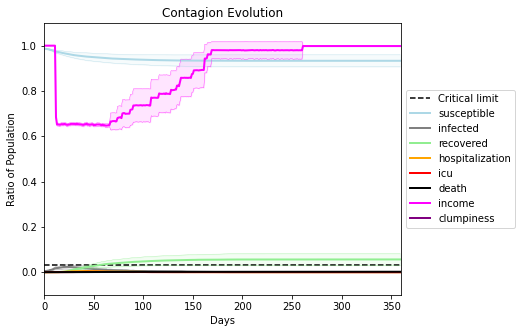

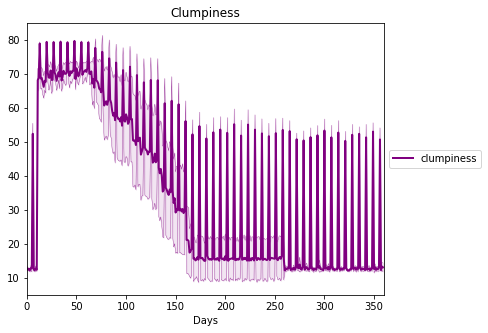

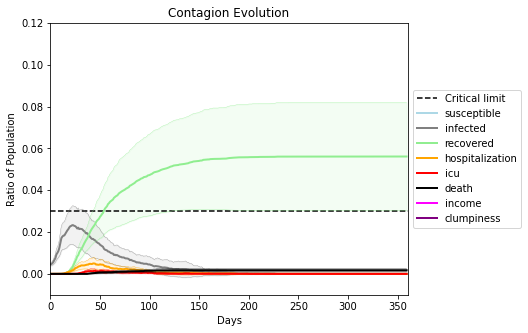

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.994", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[5866, 3908, 5519, 244, 2811, 9238, 8916, 4879, 1286, 8847, 6697, 3956, 1986, 4235, 894, 6572, 937, 9682, 9321, 14]
Average similarity between family members is 0.9786054431472283 at temperature -0.993
Average similarity between family and home is 0.9999048082077062 at temperature -1
Average similarity between students and their classroom is 0.4819899700119571 at temperature -0.993
Average classroom occupancy is 11.333333333333334 and number classrooms is 24
Average similarity between workers is 0.9444819485553464 at temperature -0.993
Average office occupancy is 10.272727272727273 and number offices is 66
Average friend similarity for adults: 0.9786545133800604 for kids: 0.6909615655775297
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.4362223906779166
disconnects
0.0
clumpiness 11.38
avg restaurant similarity 0.34589162211688224
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.5008841140176638
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.46117685316996726
disconnects
0.0
clumpiness 11.8
avg restaurant similarity 0.5319038136550885
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.3996580779766214
disconnects
0.0
clumpiness 11.92
avg restaurant similarity 0.2921761380375165
disconnects
0.58
clumpiness 53.16
avg restaurant similarity 0.330360847173538
disconnects
0.0
clumpiness 12.52
avg restaurant similarity 0.5595831819160443
disconnects
0.0
clumpiness 12.22
avg restaurant similarity 0.4486524891279315
disconnects
0.0
clumpiness 11.72
avg restaurant similarity 0.2921305935657212
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.36313980924223693
disconnects
0.98
clumpiness 78.64
avg restaurant similarity 0.4128313311536092
disconnects
0.94


avg restaurant similarity 0.3819235561588449
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.29729952366454476
disconnects
0.93
clumpiness 75.18
avg restaurant similarity 0.6761223762399281
disconnects
0.94
clumpiness 75.82
avg restaurant similarity 0.439020043944527
disconnects
0.93
clumpiness 75.31
avg restaurant similarity 0.4341525424513471
disconnects
0.98
clumpiness 78.6
avg restaurant similarity 0.2812843825327529
disconnects
0.85
clumpiness 70.15
avg restaurant similarity 0.46103987489734677
disconnects
0.92
clumpiness 74.14
avg restaurant similarity 0.45285212278802883
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4300278671005393
disconnects
0.8
clumpiness 67.37
avg restaurant similarity 0.2481543245557586
disconnects
0.86
clumpiness 70.41
avg restaurant similarity 0.47594836629166226
disconnects
0.0
clumpiness 12.25
avg restaurant similarity 0.5181917071496805
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.38390032478456343
disconnects

disconnects
0.0
clumpiness 12.65
avg restaurant similarity 0.40987593928688476
disconnects
0.59
clumpiness 52.46
avg restaurant similarity 0.5296236937678058
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.3944680676757123
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.3284880115713817
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.3488472796803812
disconnects
0.0
clumpiness 11.86
avg restaurant similarity 0.4644264083191217
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.3982248410937696
disconnects
0.0
clumpiness 11.59
avg restaurant similarity 0.43627775953148096
disconnects
0.65
clumpiness 57.49
avg restaurant similarity 0.41702402718490383
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.43010705496769663
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.46583386900101625
disconnects
0.0
clumpiness 12.41
avg restaurant similarity 0.3870425468157195
disconnects
0.0
clumpiness 12.07
avg restaurant similarit

avg restaurant similarity 0.2798394015687552
disconnects
0.0
clumpiness 11.62
avg restaurant similarity 0.2917944850581203
disconnects
0.62
clumpiness 55.41
avg restaurant similarity 0.46950442359545697
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.5142668116634543
disconnects
0.0
clumpiness 11.93
avg restaurant similarity 0.5206996045580863
disconnects
0.0
clumpiness 12.63
avg restaurant similarity 0.3969568591395032
disconnects
0.0
clumpiness 11.79
avg restaurant similarity 0.5872731095741223
disconnects
0.0
clumpiness 12.45
avg restaurant similarity 0.384806614234258
disconnects
0.0
clumpiness 12.3
avg restaurant similarity 0.42237542834454267
disconnects
0.72
clumpiness 62.91
avg restaurant similarity 0.45038339078530076
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.4376057895763302
disconnects
0.0
clumpiness 11.92
avg restaurant similarity 0.40035640022241437
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.34381339441434655
disconnects
0.

avg restaurant similarity 0.5664334718538052
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.4552200350475807
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.4394165590548693
disconnects
0.0
clumpiness 11.79
avg restaurant similarity 0.4467955448052225
disconnects
0.0
clumpiness 11.66
avg restaurant similarity 0.482388879048683
disconnects
0.0
clumpiness 11.66
avg restaurant similarity 0.3952344514510083
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.6098123059143888
disconnects
0.84
clumpiness 68.94
avg restaurant similarity 0.517417341395628
disconnects
0.0
clumpiness 12.2
avg restaurant similarity 0.5935696807319997
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.5306046598404996
disconnects
0.0
clumpiness 11.78
avg restaurant similarity 0.3764375736659594
disconnects
0.0
clumpiness 11.59
avg restaurant similarity 0.4177064909264032
disconnects
0.94
clumpiness 75.73
avg restaurant similarity 0.7106053659847013
disconnects
0.92
clu

avg restaurant similarity 0.3196184909808854
disconnects
0.95
clumpiness 76.49
avg restaurant similarity 0.41255370665918717
disconnects
0.96
clumpiness 77.31
avg restaurant similarity 0.5122641914349454
disconnects
0.97
clumpiness 77.93
avg restaurant similarity 0.5113024761744229
disconnects
0.91
clumpiness 73.85
avg restaurant similarity 0.5363737351068825
disconnects
0.9
clumpiness 72.86
avg restaurant similarity 0.5604105332329415
disconnects
0.98
clumpiness 78.6
avg restaurant similarity 0.5318161282180428
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.49416332858311307
disconnects
0.94
clumpiness 76.01
avg restaurant similarity 0.42691364826261796
disconnects
0.94
clumpiness 75.87
avg restaurant similarity 0.5822569664645114
disconnects
0.91
clumpiness 73.39
avg restaurant similarity 0.3243108714145105
disconnects
0.86
clumpiness 70.31
avg restaurant similarity 0.2357174265517029
disconnects
0.98
clumpiness 78.59
avg restaurant similarity 0.5306989367339519
disconne

disconnects
0.6
clumpiness 53.3
avg restaurant similarity 0.5166221417865867
disconnects
0.01
clumpiness 12.88
avg restaurant similarity 0.23910193669205715
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.4505452527559705
disconnects
0.01
clumpiness 12.76
avg restaurant similarity 0.5696183314092541
disconnects
0.02
clumpiness 13.03
avg restaurant similarity 0.38226680065853175
disconnects
0.01
clumpiness 12.98
avg restaurant similarity 0.5788076287957277
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.5480616088306978
disconnects
0.57
clumpiness 51.62
avg restaurant similarity 0.2718809160630019
disconnects
0.0
clumpiness 12.28
avg restaurant similarity 0.5024534508097588
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.7391464898708803
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.43438899469213216
disconnects
0.0
clumpiness 11.37
avg restaurant similarity 0.34651974212228703
disconnects
0.0
clumpiness 11.1
avg restaurant similarit

avg restaurant similarity 0.5479618676513666
disconnects
0.38
clumpiness 39.87
avg restaurant similarity 0.7532249222448006
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.5443810621664303
disconnects
0.01
clumpiness 11.66
avg restaurant similarity 0.25928750706728787
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.5432537987098849
disconnects
0.0
clumpiness 12.19
avg restaurant similarity 0.2846567194139479
disconnects
0.01
clumpiness 12.62
avg restaurant similarity 0.6374402436753509
disconnects
0.0
clumpiness 11.89
avg restaurant similarity 0.3930286752424024
disconnects
0.44
clumpiness 42.75
avg restaurant similarity 0.3768235727058956
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.3469605437165907
disconnects
0.0
clumpiness 11.36
avg restaurant similarity 0.31904396838980914
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.4251500826553152
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.4955528160677723
disconnects
0

avg restaurant similarity 0.39057577593525655
disconnects
0.02
clumpiness 12.46
avg restaurant similarity 0.45725346715251436
disconnects
0.01
clumpiness 11.69
avg restaurant similarity 0.3285250664960555
disconnects
0.0
clumpiness 10.5
avg restaurant similarity 0.5426833205995646
disconnects
0.02
clumpiness 12.76
avg restaurant similarity 0.5038905240303869
disconnects
0.03
clumpiness 12.73
avg restaurant similarity 0.41600142982926125
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.4442326881667546
disconnects
0.47
clumpiness 45.58
avg restaurant similarity 0.5755395506257712
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.46390573613293584
disconnects
0.02
clumpiness 12.31
avg restaurant similarity 0.39180550253505436
disconnects
0.0
clumpiness 10.17
avg restaurant similarity 0.36430202520292243
disconnects
0.01
clumpiness 11.69
avg restaurant similarity 0.4406417680700882
disconnects
0.55
clumpiness 50.45
avg restaurant similarity 0.43168319016676115
disco

avg restaurant similarity 0.4244693313350563
disconnects
0.95
clumpiness 76.23
avg restaurant similarity 0.601002778790553
disconnects
0.55
clumpiness 51.35
avg restaurant similarity 0.5559956216304488
disconnects
0.66
clumpiness 57.68
avg restaurant similarity 0.5601407430152371
disconnects
0.62
clumpiness 56.34
avg restaurant similarity 0.4404003501324975
disconnects
0.63
clumpiness 55.76
avg restaurant similarity 0.41340972022366407
disconnects
0.47
clumpiness 45.4
avg restaurant similarity 0.5934292071408704
disconnects
0.59
clumpiness 53.72
avg restaurant similarity 0.42438074080822397
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.4978382928976472
disconnects
0.41
clumpiness 45.28
avg restaurant similarity 0.46756643619369564
disconnects
0.52
clumpiness 50.59
avg restaurant similarity 0.39376710136157894
disconnects
0.61
clumpiness 55.31
avg restaurant similarity 0.44785878174735183
disconnects
0.65
clumpiness 56.03
avg restaurant similarity 0.4284820193381031
disc

avg restaurant similarity 0.45993833116739075
disconnects
0.01
clumpiness 11.57
avg restaurant similarity 0.6169503866860175
disconnects
0.43
clumpiness 42.45
avg restaurant similarity 0.473541323062868
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.35729280185832885
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.5671891321440807
disconnects
0.01
clumpiness 11.29
avg restaurant similarity 0.5042753552408203
disconnects
0.02
clumpiness 12.5
avg restaurant similarity 0.5024459343587484
disconnects
0.02
clumpiness 12.32
avg restaurant similarity 0.3295436086791968
disconnects
0.01
clumpiness 12.26
avg restaurant similarity 0.4561409625583052
disconnects
0.4
clumpiness 39.76
avg restaurant similarity 0.39772811414167036
disconnects
0.01
clumpiness 11.92
avg restaurant similarity 0.5527192228764207
disconnects
0.02
clumpiness 12.71
avg restaurant similarity 0.3780963737624015
disconnects
0.04
clumpiness 13.19
avg restaurant similarity 0.39538313282321413
disconne

avg restaurant similarity 0.4012635930622226
disconnects
0.02
clumpiness 12.17
avg restaurant similarity 0.4011979627726218
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.39866819923253444
disconnects
0.45
clumpiness 43.18
avg restaurant similarity 0.47145050773059616
disconnects
0.0
clumpiness 9.93
avg restaurant similarity 0.506712069127298
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.3538756830643188
disconnects
0.01
clumpiness 11.65
avg restaurant similarity 0.5623776645588661
disconnects
0.02
clumpiness 11.95
avg restaurant similarity 0.5667764041915423
disconnects
0.02
clumpiness 11.63
avg restaurant similarity 0.42281716861389
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.43504086223071853
disconnects
0.36
clumpiness 38.97
avg restaurant similarity 0.3687011740830889
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.48294946037491504
disconnects
0.01
clumpiness 10.81
avg restaurant similarity 0.4058093830331021
disconnects


avg restaurant similarity 0.6411642179611842
disconnects
0.02
clumpiness 13.35
avg restaurant similarity 0.48420218355368977
disconnects
0.02
clumpiness 12.31
avg restaurant similarity 0.5223743986926962
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.5295158801982924
disconnects
0.01
clumpiness 12.12
avg restaurant similarity 0.40513946641794674
disconnects
0.0
clumpiness 10.7
avg restaurant similarity 0.4380666851469362
disconnects
0.02
clumpiness 13.63
avg restaurant similarity 0.4953859127024395
disconnects
0.58
clumpiness 53.25
avg restaurant similarity 0.41876641096245126
disconnects
0.0
clumpiness 12.25
avg restaurant similarity 0.7136461664202416
disconnects
0.01
clumpiness 13.22
avg restaurant similarity 0.5381039293949537
disconnects
0.0
clumpiness 11.99
avg restaurant similarity 0.3613210295844496
disconnects
0.0
clumpiness 12.41
avg restaurant similarity 0.48660474784677615
disconnects
0.55
clumpiness 50.78
avg restaurant similarity 0.488560571898581
disconnect

avg restaurant similarity 0.5329291894704898
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.6162113354149013
disconnects
0.88
clumpiness 72.46
avg restaurant similarity 0.4820035775035268
disconnects
0.73
clumpiness 63.36
avg restaurant similarity 0.43792085957824334
disconnects
0.59
clumpiness 54.19
avg restaurant similarity 0.5046710566380541
disconnects
0.68
clumpiness 58.81
avg restaurant similarity 0.3805088988658225
disconnects
0.69
clumpiness 60.12
avg restaurant similarity 0.5508137928009513
disconnects
0.87
clumpiness 70.89
avg restaurant similarity 0.5892583049733067
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5661216984337474
disconnects
0.62
clumpiness 57.12
avg restaurant similarity 0.43780942507884985
disconnects
0.66
clumpiness 59.16
avg restaurant similarity 0.4102056484812106
disconnects
0.61
clumpiness 55.83
avg restaurant similarity 0.5976886988627209
disconnects
0.78
clumpiness 66.62
avg restaurant similarity 0.6980505482541371
disconn

avg restaurant similarity 0.5787817018430126
disconnects
0.69
clumpiness 61.22
avg restaurant similarity 0.4714752661553931
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5193366050386908
disconnects
0.74
clumpiness 63.65
avg restaurant similarity 0.5174883242670032
disconnects
0.67
clumpiness 59.46
avg restaurant similarity 0.48793393851485367
disconnects
0.67
clumpiness 60.53
avg restaurant similarity 0.45503938033440355
disconnects
0.61
clumpiness 56.38
avg restaurant similarity 0.5743071455469096
disconnects
0.78
clumpiness 66.16
avg restaurant similarity 0.532202239922956
disconnects
0.61
clumpiness 55.58
avg restaurant similarity 0.4624363343801587
disconnects
0.98
clumpiness 78.55
avg restaurant similarity 0.44135827103574304
disconnects
0.68
clumpiness 60.04
avg restaurant similarity 0.49639403674165594
disconnects
0.71
clumpiness 61.57
avg restaurant similarity 0.4589713167887724
disconnects
0.55
clumpiness 53.16
avg restaurant similarity 0.4142251968195894
discon

disconnects
0.03
clumpiness 14.1
avg restaurant similarity 0.480759762941204
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.5681077862709535
disconnects
0.43
clumpiness 43.64
avg restaurant similarity 0.5189381738772747
disconnects
0.0
clumpiness 11.65
avg restaurant similarity 0.6360432517878809
disconnects
0.01
clumpiness 12.64
avg restaurant similarity 0.47892095196365375
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.5458500619641643
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.4924814227501029
disconnects
0.01
clumpiness 11.65
avg restaurant similarity 0.5925136623740082
disconnects
0.01
clumpiness 12.81
avg restaurant similarity 0.4657905301554428
disconnects
0.52
clumpiness 48.2
avg restaurant similarity 0.4235913516881177
disconnects
0.0
clumpiness 11.85
avg restaurant similarity 0.5505333283577003
disconnects
0.0
clumpiness 11.41
avg restaurant similarity 0.49909975746482393
disconnects
0.01
clumpiness 12.96
avg restaurant similarity 

avg restaurant similarity 0.49936678796089257
disconnects
0.04
clumpiness 14.39
avg restaurant similarity 0.4826486892097119
disconnects
0.02
clumpiness 13.93
avg restaurant similarity 0.5657766103122633
disconnects
0.0
clumpiness 12.17
avg restaurant similarity 0.5093719867364342
disconnects
0.04
clumpiness 14.36
avg restaurant similarity 0.43861182395684634
disconnects
0.01
clumpiness 12.91
avg restaurant similarity 0.3426712463679733
disconnects
0.01
clumpiness 12.67
avg restaurant similarity 0.40793969438624866
disconnects
0.5
clumpiness 47.46
avg restaurant similarity 0.44733306434795106
disconnects
0.01
clumpiness 13.02
avg restaurant similarity 0.42866478421017556
disconnects
0.01
clumpiness 12.32
avg restaurant similarity 0.3522345789652526
disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.4539366327864432
disconnects
0.01
clumpiness 12.75
avg restaurant similarity 0.3914991166374917
disconnects
0.8
clumpiness 67.42
avg restaurant similarity 0.3078904038944726
disconn

avg restaurant similarity 0.48370572438912146
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5076003268314507
disconnects
0.79
clumpiness 68.71
avg restaurant similarity 0.46691981015705475
disconnects
0.9
clumpiness 73.61
avg restaurant similarity 0.5807099227175347
disconnects
0.83
clumpiness 69.14
avg restaurant similarity 0.4115195708402025
disconnects
0.78
clumpiness 66.3
avg restaurant similarity 0.4350566613428835
disconnects
0.69
clumpiness 60.82
avg restaurant similarity 0.3438943103502498
disconnects
0.89
clumpiness 72.37
avg restaurant similarity 0.3829783015172809
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4444790577398133
disconnects
0.82
clumpiness 67.96
avg restaurant similarity 0.34039254424606746
disconnects
0.73
clumpiness 63.62
avg restaurant similarity 0.44240754968643164
disconnects
0.88
clumpiness 71.51
avg restaurant similarity 0.41439454956714605
disconnects
0.9
clumpiness 72.89
avg restaurant similarity 0.48610095818164234
disconne

avg restaurant similarity 0.35444529809579006
disconnects
0.86
clumpiness 71.17
avg restaurant similarity 0.3773215183162841
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.4629883931176921
disconnects
0.92
clumpiness 74.43
avg restaurant similarity 0.3764829261811801
disconnects
0.91
clumpiness 73.9
avg restaurant similarity 0.4231568455134711
disconnects
0.9
clumpiness 73.28
avg restaurant similarity 0.33268114927256975
disconnects
0.73
clumpiness 62.77
avg restaurant similarity 0.4454225049980146
disconnects
0.94
clumpiness 75.7
avg restaurant similarity 0.4479784184836969
disconnects
0.87
clumpiness 72.03
avg restaurant similarity 0.4229067021290706
disconnects
0.98
clumpiness 78.62
avg restaurant similarity 0.4821942047709209
disconnects
0.77
clumpiness 65.14
avg restaurant similarity 0.4285373014290015
disconnects
0.83
clumpiness 68.79
avg restaurant similarity 0.40746272173450393
disconnects
0.84
clumpiness 69.74
avg restaurant similarity 0.38864274602052085
discon

avg restaurant similarity 0.5225089787546815
disconnects
0.01
clumpiness 12.16
avg restaurant similarity 0.2905748991586464
disconnects
0.01
clumpiness 11.96
avg restaurant similarity 0.44004215413128456
disconnects
0.38
clumpiness 41.27
avg restaurant similarity 0.4384193952027421
disconnects
0.01
clumpiness 12.78
avg restaurant similarity 0.39168402663926183
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.436336184805008
disconnects
0.01
clumpiness 12.6
avg restaurant similarity 0.27127742921794096
disconnects
0.01
clumpiness 12.13
avg restaurant similarity 0.43259395571301684
disconnects
0.0
clumpiness 11.66
avg restaurant similarity 0.35041479976390827
disconnects
0.01
clumpiness 13.38
avg restaurant similarity 0.5189589477690858
disconnects
0.49
clumpiness 46.27
avg restaurant similarity 0.490631696692142
disconnects
0.01
clumpiness 11.98
avg restaurant similarity 0.3585051058576524
disconnects
0.0
clumpiness 11.82
avg restaurant similarity 0.4154720361353639
disconne

avg restaurant similarity 0.48212106588471765
disconnects
0.01
clumpiness 11.73
avg restaurant similarity 0.6408704658253304
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.37264951251455697
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.49041327596771717
disconnects
0.02
clumpiness 12.02
avg restaurant similarity 0.5197322289250941
disconnects
0.02
clumpiness 12.88
avg restaurant similarity 0.46127921149380896
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.625948283146487
disconnects
0.43
clumpiness 42.05
avg restaurant similarity 0.5213003212152546
disconnects
0.01
clumpiness 11.78
avg restaurant similarity 0.5288405015595816
disconnects
0.01
clumpiness 11.81
avg restaurant similarity 0.46157750447342577
disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.4594249618166144
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.4895407154168966
disconnects
0.88
clumpiness 71.78
avg restaurant similarity 0.5662420041346918
disconne

avg restaurant similarity 0.3736690014133223
disconnects
0.97
clumpiness 77.74
avg restaurant similarity 0.4428327034500581
disconnects
0.87
clumpiness 71.46
avg restaurant similarity 0.5516738971683276
disconnects
0.71
clumpiness 63.27
avg restaurant similarity 0.3877521999396712
disconnects
0.67
clumpiness 62.42
avg restaurant similarity 0.4159408794387185
disconnects
0.75
clumpiness 63.54
avg restaurant similarity 0.47613740311696223
disconnects
0.74
clumpiness 63.83
avg restaurant similarity 0.5077454331026534
disconnects
0.71
clumpiness 62.28
avg restaurant similarity 0.44168933744058536
disconnects
0.97
clumpiness 77.75
avg restaurant similarity 0.3791523498415902
disconnects
0.85
clumpiness 70.82
avg restaurant similarity 0.597046337329581
disconnects
0.78
clumpiness 65.42
avg restaurant similarity 0.6075979621598655
disconnects
0.89
clumpiness 72.92
avg restaurant similarity 0.5668135301157636
disconnects
0.85
clumpiness 70.05
avg restaurant similarity 0.5011080805488127
discon

avg restaurant similarity 0.5588007914915424
disconnects
0.0
clumpiness 11.93
avg restaurant similarity 0.6210865814873751
disconnects
0.37
clumpiness 38.31
avg restaurant similarity 0.5399691309772856
disconnects
0.01
clumpiness 11.69
avg restaurant similarity 0.48594421803869337
disconnects
0.02
clumpiness 13.24
avg restaurant similarity 0.5542501270388841
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.5879743294233503
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.4294118247874794
disconnects
0.02
clumpiness 12.8
avg restaurant similarity 0.4999218893400555
disconnects
0.0
clumpiness 11.86
avg restaurant similarity 0.44293487599377207
disconnects
0.57
clumpiness 50.54
avg restaurant similarity 0.6676630214464382
disconnects
0.01
clumpiness 11.92
avg restaurant similarity 0.4913691013623711
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.4394046906421523
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.42207969331043954
disconnects

disconnects
0.01
clumpiness 12.49
avg restaurant similarity 0.44519206439468034
disconnects
0.0
clumpiness 11.65
avg restaurant similarity 0.5631058392064859
disconnects
0.5
clumpiness 45.44
avg restaurant similarity 0.43668348912151117
disconnects
0.02
clumpiness 13.03
avg restaurant similarity 0.5694840063409651
disconnects
0.01
clumpiness 12.44
avg restaurant similarity 0.36285838207809556
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.5268857069104205
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.6237523838476561
disconnects
0.01
clumpiness 12.36
avg restaurant similarity 0.5083339679795408
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.5061751910876827
disconnects
0.48
clumpiness 47.6
avg restaurant similarity 0.40899659344919653
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.5200962146615482
disconnects
0.01
clumpiness 11.57
avg restaurant similarity 0.41213077008864235
disconnects
0.01
clumpiness 12.02
avg restaurant simil

avg restaurant similarity 0.4490137264680609
disconnects
0.01
clumpiness 12.58
avg restaurant similarity 0.49969862126307374
disconnects
0.01
clumpiness 12.29
avg restaurant similarity 0.5541299767161099
disconnects
0.0
clumpiness 11.81
avg restaurant similarity 0.3728563603917076
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.3475465628131835
disconnects
0.0
clumpiness 11.55
avg restaurant similarity 0.3127832414713571
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.4661230720594566
disconnects
0.36
clumpiness 38.56
avg restaurant similarity 0.3576844102627335
disconnects
0.0
clumpiness 11.91
avg restaurant similarity 0.38406597765277706
disconnects
0.0
clumpiness 11.54
avg restaurant similarity 0.5858271735052909
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.31999622856866144
disconnects
0.0
clumpiness 10.61
avg restaurant similarity 0.3683962559804253
disconnects
0.8
clumpiness 66.36
avg restaurant similarity 0.4488106054119571
disconnects
0

avg restaurant similarity 0.3509633665430449
disconnects
0.36
clumpiness 36.73
avg restaurant similarity 0.46655919345598396
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.3827365558766206
disconnects
0.0
clumpiness 11.2
avg restaurant similarity 0.5524751380407578
disconnects
0.02
clumpiness 13.42
avg restaurant similarity 0.456081234817131
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.38934622841795374
disconnects
0.0
clumpiness 11.64
avg restaurant similarity 0.3808270219547953
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.4004800256398915
disconnects
0.39
clumpiness 40.12
avg restaurant similarity 0.3558935388889851
disconnects
0.0
clumpiness 11.75
avg restaurant similarity 0.4065235734164182
disconnects
0.02
clumpiness 13.9
avg restaurant similarity 0.3096651214666161
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.37454303582095466
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.4300723108275877
disconnects
0.01


disconnects
0.0
clumpiness 12.17
avg restaurant similarity 0.3368410555815495
disconnects
0.32
clumpiness 35.28
avg restaurant similarity 0.435394925413717
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.37377361697968803
disconnects
0.01
clumpiness 11.84
avg restaurant similarity 0.39116780660946443
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.3532995222680275
disconnects
0.01
clumpiness 11.98
avg restaurant similarity 0.2629484866579665
disconnects
0.01
clumpiness 12.63
avg restaurant similarity 0.48215220059178143
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.48434958047539584
disconnects
0.37
clumpiness 39.95
avg restaurant similarity 0.32652843362690914
disconnects
0.02
clumpiness 12.74
avg restaurant similarity 0.3835523098309298
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.36009502225831486
disconnects
0.0
clumpiness 11.99
avg restaurant similarity 0.40638884753970717
disconnects
0.0
clumpiness 10.81
avg restaurant simil

avg restaurant similarity 0.567884074641903
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.37963949772216343
disconnects
0.41
clumpiness 43.01
avg restaurant similarity 0.2654744342033736
disconnects
0.01
clumpiness 11.87
avg restaurant similarity 0.2903288014287418
disconnects
0.01
clumpiness 12.33
avg restaurant similarity 0.33142020468118133
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.339766763215183
disconnects
0.0
clumpiness 11.64
avg restaurant similarity 0.4570615937566885
disconnects
0.0
clumpiness 11.36
avg restaurant similarity 0.5795444465111619
disconnects
0.0
clumpiness 11.95
avg restaurant similarity 0.56289519094898
disconnects
0.35
clumpiness 39.64
avg restaurant similarity 0.4647131752432004
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.49488205887733966
disconnects
0.0
clumpiness 11.26
avg restaurant similarity 0.3901351625275391
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.46969019333671697
disconnects
0.0

avg restaurant similarity 0.45145543350366996
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.29691092918301065
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.3915160808295955
disconnects
0.02
clumpiness 12.55
avg restaurant similarity 0.2908944137093716
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.38279975082580436
disconnects
0.01
clumpiness 11.93
avg restaurant similarity 0.47291886541828265
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.39575555744783675
disconnects
0.53
clumpiness 49.42
avg restaurant similarity 0.3506134559029844
disconnects
0.0
clumpiness 12.52
avg restaurant similarity 0.3766323152977848
disconnects
0.01
clumpiness 13.26
avg restaurant similarity 0.4127055110664097
disconnects
0.0
clumpiness 11.68
avg restaurant similarity 0.37548140760209836
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.40252611699137875
disconnects
0.62
clumpiness 55.04
avg restaurant similarity 0.41150423131023106
discon

avg restaurant similarity 0.37967824646882087
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.398711024190145
disconnects
0.88
clumpiness 71.8
avg restaurant similarity 0.5357320751581675
disconnects
0.96
clumpiness 77.14
avg restaurant similarity 0.46979722128370793
disconnects
0.89
clumpiness 72.36
avg restaurant similarity 0.2843853723146974
disconnects
0.73
clumpiness 62.74
avg restaurant similarity 0.373095792272481
disconnects
0.73
clumpiness 63.26
avg restaurant similarity 0.40338830116103175
disconnects
0.67
clumpiness 58.91
avg restaurant similarity 0.4671787312544233
disconnects
0.98
clumpiness 78.72
avg restaurant similarity 0.38968765633881186
disconnects
0.74
clumpiness 62.36
avg restaurant similarity 0.4519030164642405
disconnects
0.78
clumpiness 65.21
avg restaurant similarity 0.47511036637915366
disconnects
0.57
clumpiness 53.57
avg restaurant similarity 0.3641977320049398
disconnects
0.71
clumpiness 61.65
avg restaurant similarity 0.39568820889793
disconn

disconnects
0.0
clumpiness 11.57
avg restaurant similarity 0.31102210818144116
disconnects
0.56
clumpiness 51.46
avg restaurant similarity 0.3389434035180978
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.35840633637220254
disconnects
0.01
clumpiness 12.34
avg restaurant similarity 0.43759877818225956
disconnects
0.0
clumpiness 11.6
avg restaurant similarity 0.2556474682237741
disconnects
0.0
clumpiness 11.36
avg restaurant similarity 0.4142575596905058
disconnects
0.02
clumpiness 12.55
avg restaurant similarity 0.4659881845955321
disconnects
0.01
clumpiness 11.73
avg restaurant similarity 0.3531494500156332
disconnects
0.63
clumpiness 55.41
avg restaurant similarity 0.5388114962712552
disconnects
0.01
clumpiness 11.67
avg restaurant similarity 0.3488634754856608
disconnects
0.0
clumpiness 11.41
avg restaurant similarity 0.4768658541521469
disconnects
0.01
clumpiness 12.53
avg restaurant similarity 0.253471738813363
disconnects
0.0
clumpiness 11.36
avg restaurant similari

avg restaurant similarity 0.3778050736288934
disconnects
0.0
clumpiness 12.29
avg restaurant similarity 0.43823650452631857
disconnects
0.47
clumpiness 45.11
avg restaurant similarity 0.2754040338805589
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.33933246377330406
disconnects
0.0
clumpiness 11.36
avg restaurant similarity 0.3476172373108684
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.4248092526850829
disconnects
0.01
clumpiness 11.62
avg restaurant similarity 0.46641459593284107
disconnects
0.01
clumpiness 12.43
avg restaurant similarity 0.404715858068198
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.3957411336984762
disconnects
0.47
clumpiness 45.37
avg restaurant similarity 0.27689562624359354
disconnects
0.0
clumpiness 11.04
avg restaurant similarity 0.2915994692842662
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.40709095548924507
disconnects
0.0
clumpiness 11.82
avg restaurant similarity 0.4474593897258582
disconnects

avg restaurant similarity 0.3443313762365396
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.47273337297471735
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.3338701627433545
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.31595595586752534
disconnects
0.0
clumpiness 11.97
avg restaurant similarity 0.4626632198491046
disconnects
0.0
clumpiness 12.01
avg restaurant similarity 0.4210334817328983
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.4896154508784213
disconnects
0.41
clumpiness 40.89
avg restaurant similarity 0.5773156142596944
disconnects
0.0
clumpiness 12.28
avg restaurant similarity 0.4147521731155351
disconnects
0.0
clumpiness 11.22
avg restaurant similarity 0.4609592938692622
disconnects
0.0
clumpiness 11.75
avg restaurant similarity 0.4554486509842548
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.3839470348104654
disconnects
0.9
clumpiness 73.45
avg restaurant similarity 0.5251684478707154
disconnects
0.81

avg restaurant similarity 0.3826635857609272
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.46755890323477084
disconnects
0.84
clumpiness 69.28
avg restaurant similarity 0.3422862257334901
disconnects
0.86
clumpiness 70.28
avg restaurant similarity 0.3076267342314922
disconnects
0.72
clumpiness 61.26
avg restaurant similarity 0.4111924760334782
disconnects
0.75
clumpiness 63.55
avg restaurant similarity 0.46772049662678034
disconnects
0.73
clumpiness 63.97
avg restaurant similarity 0.35573262628691993
disconnects
0.86
clumpiness 71.41
avg restaurant similarity 0.4426199952615451
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.40800599636712254
disconnects
0.0
clumpiness 12.02
avg restaurant similarity 0.3704391983292754
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.5730649362639323
disconnects
0.0
clumpiness 11.6
avg restaurant similarity 0.465930569603546
disconnects
0.0
clumpiness 11.59
avg restaurant similarity 0.3269306783671249
disconnects

avg restaurant similarity 0.385281998274606
disconnects
0.41
clumpiness 42.72
avg restaurant similarity 0.41919754914880547
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.5292865656326462
disconnects
0.0
clumpiness 12.54
avg restaurant similarity 0.5090709735030011
disconnects
0.0
clumpiness 11.73
avg restaurant similarity 0.36180535860244706
disconnects
0.0
clumpiness 12.03
avg restaurant similarity 0.34034724729145355
disconnects
0.0
clumpiness 12.42
avg restaurant similarity 0.4750108820139628
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.4099184425110579
disconnects
0.46
clumpiness 44.54
avg restaurant similarity 0.43067895907640735
disconnects
0.0
clumpiness 12.58
avg restaurant similarity 0.5939058841470701
disconnects
0.0
clumpiness 12.02
avg restaurant similarity 0.6948522894067374
disconnects
0.0
clumpiness 12.13
avg restaurant similarity 0.5070847688209817
disconnects
0.0
clumpiness 11.81
avg restaurant similarity 0.4193772966549712
disconnects
0.

disconnects
0.0
clumpiness 11.22
avg restaurant similarity 0.3282103984546629
disconnects
0.47
clumpiness 44.64
avg restaurant similarity 0.36937507633759076
disconnects
0.0
clumpiness 12.4
avg restaurant similarity 0.35094878512862715
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.4642634497408762
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.2419396449064327
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.4653511431832764
disconnects
0.0
clumpiness 11.62
avg restaurant similarity 0.3417133036801919
disconnects
0.0
clumpiness 11.4
avg restaurant similarity 0.44237835842863027
disconnects
0.63
clumpiness 55.11
avg restaurant similarity 0.3667535720495918
disconnects
0.0
clumpiness 11.26
avg restaurant similarity 0.48820225670394796
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.4973081481546183
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.3634205818540562
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.

avg restaurant similarity 0.4419915504962812
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.39757912850840105
disconnects
0.01
clumpiness 11.02
avg restaurant similarity 0.3917312599990273
disconnects
0.01
clumpiness 10.92
avg restaurant similarity 0.4272246896018939
disconnects
0.01
clumpiness 10.96
avg restaurant similarity 0.44690410721729196
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.43539551979280117
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.39107803800396596
disconnects
0.38
clumpiness 37.93
avg restaurant similarity 0.4841687855654118
disconnects
0.0
clumpiness 10.04
avg restaurant similarity 0.405452658349492
disconnects
0.0
clumpiness 10.14
avg restaurant similarity 0.42136273778801814
disconnects
0.01
clumpiness 11.22
avg restaurant similarity 0.39068474831590266
disconnects
0.01
clumpiness 11.62
avg restaurant similarity 0.4119492849850531
disconnects
0.55
clumpiness 51.61
avg restaurant similarity 0.4391112503768408
disconn

avg restaurant similarity 0.49297584043357284
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.3544562990083445
disconnects
0.35
clumpiness 38.58
avg restaurant similarity 0.4533787447796494
disconnects
0.37
clumpiness 39.98
avg restaurant similarity 0.43478152091660616
disconnects
0.48
clumpiness 45.98
avg restaurant similarity 0.36427996826110726
disconnects
0.66
clumpiness 56.93
avg restaurant similarity 0.4057947419126557
disconnects
0.5
clumpiness 47.73
avg restaurant similarity 0.3974616806998246
disconnects
0.45
clumpiness 45.5
avg restaurant similarity 0.40050999744958865
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.4216883245291676
disconnects
0.46
clumpiness 45.2
avg restaurant similarity 0.38516667980999364
disconnects
0.47
clumpiness 46.79
avg restaurant similarity 0.41422272293938595
disconnects
0.54
clumpiness 49.52
avg restaurant similarity 0.4466897657096562
disconnects
0.57
clumpiness 52.53
avg restaurant similarity 0.451908691101049
discon

avg restaurant similarity 0.5151659348340305
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.3538679933343583
disconnects
0.35
clumpiness 35.99
avg restaurant similarity 0.4864836264806302
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.48436779982921935
disconnects
0.01
clumpiness 11.19
avg restaurant similarity 0.4763707755593193
disconnects
0.01
clumpiness 11.22
avg restaurant similarity 0.4692854090767353
disconnects
0.02
clumpiness 11.34
avg restaurant similarity 0.35286578362523285
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.4094267064458321
disconnects
0.0
clumpiness 9.73
avg restaurant similarity 0.4026303826757627
disconnects
0.37
clumpiness 38.6
avg restaurant similarity 0.33819903759796155
disconnects
0.0
clumpiness 10.01
avg restaurant similarity 0.5626543401508071
disconnects
0.0
clumpiness 10.32
avg restaurant similarity 0.4410443631444165
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.398548993263458
disconnects
0.

disconnects
0.0
clumpiness 10.74
avg restaurant similarity 0.4322819984773179
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.371134550905513
disconnects
0.29
clumpiness 32.28
avg restaurant similarity 0.4152024211091551
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.4379682657364939
disconnects
0.01
clumpiness 10.44
avg restaurant similarity 0.44672678530828513
disconnects
0.01
clumpiness 10.95
avg restaurant similarity 0.41036169728612804
disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.414260461066652
disconnects
0.01
clumpiness 10.6
avg restaurant similarity 0.3930308392317586
disconnects
0.0
clumpiness 10.25
avg restaurant similarity 0.43194737787680515
disconnects
0.32
clumpiness 34.31
avg restaurant similarity 0.4805298087527735
disconnects
0.01
clumpiness 10.93
avg restaurant similarity 0.4838492204469525
disconnects
0.0
clumpiness 10.32
avg restaurant similarity 0.3649618729078294
disconnects
0.01
clumpiness 11.09
avg restaurant similarit

avg restaurant similarity 0.6114600182973638
disconnects
0.0
clumpiness 12.22
avg restaurant similarity 0.45080115950075783
disconnects
0.02
clumpiness 13.26
avg restaurant similarity 0.6668051824159055
disconnects
0.0
clumpiness 13.0
avg restaurant similarity 0.3710868252194808
disconnects
0.0
clumpiness 11.8
avg restaurant similarity 0.5829385975053158
disconnects
0.0
clumpiness 11.58
avg restaurant similarity 0.47311417345323636
disconnects
0.0
clumpiness 12.45
avg restaurant similarity 0.25121344992519495
disconnects
0.68
clumpiness 60.13
avg restaurant similarity 0.4867033160288685
disconnects
0.01
clumpiness 12.87
avg restaurant similarity 0.5282247180689661
disconnects
0.0
clumpiness 12.47
avg restaurant similarity 0.2532117901906968
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.3977163107291767
disconnects
0.02
clumpiness 13.38
avg restaurant similarity 0.6088424805199415
disconnects
0.79
clumpiness 66.07
avg restaurant similarity 0.28696823679270256
disconnects


avg restaurant similarity 0.4149095420749628
disconnects
0.98
clumpiness 78.51
avg restaurant similarity 0.5766489195193871
disconnects
0.91
clumpiness 73.98
avg restaurant similarity 0.6088599783814768
disconnects
0.95
clumpiness 76.89
avg restaurant similarity 0.5656493341951304
disconnects
0.93
clumpiness 75.08
avg restaurant similarity 0.5620110803579632
disconnects
0.95
clumpiness 76.42
avg restaurant similarity 0.23444527670647344
disconnects
0.87
clumpiness 71.67
avg restaurant similarity 0.3839356796872028
disconnects
0.94
clumpiness 75.91
avg restaurant similarity 0.45750797771948554
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.4312796177499431
disconnects
0.93
clumpiness 75.17
avg restaurant similarity 0.6670446634740795
disconnects
0.86
clumpiness 70.26
avg restaurant similarity 0.28936513261593777
disconnects
0.92
clumpiness 74.36
avg restaurant similarity 0.44877327623873003
disconnects
0.88
clumpiness 71.95
avg restaurant similarity 0.30486182748796953
di

avg restaurant similarity 0.3082543078515352
disconnects
0.81
clumpiness 67.49
avg restaurant similarity 0.3447687720481359
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.4228409499444613
disconnects
0.88
clumpiness 71.86
avg restaurant similarity 0.3597254909873341
disconnects
0.94
clumpiness 75.73
avg restaurant similarity 0.4875636652049389
disconnects
0.9
clumpiness 73.62
avg restaurant similarity 0.5675382913155298
disconnects
0.91
clumpiness 73.89
avg restaurant similarity 0.49756829170434047
disconnects
0.92
clumpiness 74.82
avg restaurant similarity 0.4559492079388151
disconnects
0.91
clumpiness 73.65
avg restaurant similarity 0.4390928323653879
disconnects
0.98
clumpiness 78.51
avg restaurant similarity 0.5544774702326993
disconnects
0.86
clumpiness 70.45
avg restaurant similarity 0.38587933472639024
disconnects
0.83
clumpiness 68.79
avg restaurant similarity 0.49696880852321784
disconnects
0.91
clumpiness 73.83
avg restaurant similarity 0.43908741526241
disconn

disconnects
0.0
clumpiness 12.01
avg restaurant similarity 0.4113783518008624
disconnects
0.0
clumpiness 11.78
avg restaurant similarity 0.5585312475646764
disconnects
0.58
clumpiness 54.36
avg restaurant similarity 0.647580597913627
disconnects
0.01
clumpiness 12.95
avg restaurant similarity 0.3651150028141113
disconnects
0.0
clumpiness 12.44
avg restaurant similarity 0.3518795584868165
disconnects
0.0
clumpiness 11.65
avg restaurant similarity 0.6753413897193116
disconnects
0.01
clumpiness 13.35
avg restaurant similarity 0.4567651182720466
disconnects
0.01
clumpiness 12.22
avg restaurant similarity 0.7245000260559703
disconnects
0.02
clumpiness 13.04
avg restaurant similarity 0.30751960137291207
disconnects
0.59
clumpiness 53.63
avg restaurant similarity 0.4249893143155576
disconnects
0.01
clumpiness 13.21
avg restaurant similarity 0.6764489163654349
disconnects
0.01
clumpiness 12.99
avg restaurant similarity 0.45732456471613436
disconnects
0.0
clumpiness 11.65
avg restaurant similar

avg restaurant similarity 0.3924371284490428
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.43534600530488615
disconnects
0.01
clumpiness 11.84
avg restaurant similarity 0.47155952505050924
disconnects
0.02
clumpiness 12.86
avg restaurant similarity 0.39610539033378284
disconnects
0.03
clumpiness 12.9
avg restaurant similarity 0.44229695220539356
disconnects
0.01
clumpiness 12.01
avg restaurant similarity 0.3792014012996351
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.44439651457047963
disconnects
0.51
clumpiness 46.99
avg restaurant similarity 0.5242844464151681
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.5482091498265326
disconnects
0.03
clumpiness 12.86
avg restaurant similarity 0.48691250876214176
disconnects
0.02
clumpiness 12.3
avg restaurant similarity 0.5090621575123511
disconnects
0.01
clumpiness 12.36
avg restaurant similarity 0.5524658049971327
disconnects
0.66
clumpiness 56.98
avg restaurant similarity 0.32962786285047
disconnec

avg restaurant similarity 0.4170218107477358
disconnects
0.42
clumpiness 41.95
avg restaurant similarity 0.4087119878378293
disconnects
0.01
clumpiness 10.96
avg restaurant similarity 0.5229230258117542
disconnects
0.01
clumpiness 12.75
avg restaurant similarity 0.3894126091040348
disconnects
0.01
clumpiness 11.53
avg restaurant similarity 0.5175222981417018
disconnects
0.01
clumpiness 12.76
avg restaurant similarity 0.4027999050295897
disconnects
0.02
clumpiness 12.27
avg restaurant similarity 0.4958005800989138
disconnects
0.01
clumpiness 11.98
avg restaurant similarity 0.35450852372354186
disconnects
0.44
clumpiness 42.93
avg restaurant similarity 0.3948748277144481
disconnects
0.03
clumpiness 13.03
avg restaurant similarity 0.482326048907343
disconnects
0.01
clumpiness 11.42
avg restaurant similarity 0.5314324711105287
disconnects
0.02
clumpiness 13.26
avg restaurant similarity 0.4654019992503547
disconnects
0.01
clumpiness 12.0
avg restaurant similarity 0.5224400409975973
disconne

avg restaurant similarity 0.4479789274269176
disconnects
0.01
clumpiness 11.74
avg restaurant similarity 0.5086942586840419
disconnects
0.42
clumpiness 41.71
avg restaurant similarity 0.6167635485173877
disconnects
0.02
clumpiness 13.02
avg restaurant similarity 0.5330865864812392
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.4235320410030829
disconnects
0.01
clumpiness 12.56
avg restaurant similarity 0.47880050703574617
disconnects
0.02
clumpiness 12.45
avg restaurant similarity 0.46007429574459646
disconnects
0.01
clumpiness 12.07
avg restaurant similarity 0.47251561015819693
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.5528908447043663
disconnects
0.63
clumpiness 55.4
avg restaurant similarity 0.5325030009227776
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.5290488557136976
disconnects
0.01
clumpiness 11.76
avg restaurant similarity 0.5392814024822742
disconnects
0.01
clumpiness 12.82
avg restaurant similarity 0.5498148759343009
disconne

avg restaurant similarity 0.38812088331811784
disconnects
0.01
clumpiness 12.44
avg restaurant similarity 0.5630086067373511
disconnects
0.01
clumpiness 11.7
avg restaurant similarity 0.5141504963859039
disconnects
0.66
clumpiness 57.22
avg restaurant similarity 0.33985625871080877
disconnects
0.02
clumpiness 12.3
avg restaurant similarity 0.5347016504439799
disconnects
0.01
clumpiness 11.9
avg restaurant similarity 0.4116910409891247
disconnects
0.01
clumpiness 13.3
avg restaurant similarity 0.4444470659858504
disconnects
0.01
clumpiness 11.92
avg restaurant similarity 0.4853643435984597
disconnects
0.02
clumpiness 12.29
avg restaurant similarity 0.5029793222643364
disconnects
0.0
clumpiness 11.04
avg restaurant similarity 0.43644185241760497
disconnects
0.52
clumpiness 47.62
avg restaurant similarity 0.38801131902494906
disconnects
0.02
clumpiness 13.1
avg restaurant similarity 0.46689552387882644
disconnects
0.02
clumpiness 13.04
avg restaurant similarity 0.5877155489720065
disconne

avg restaurant similarity 0.45608995283331705
disconnects
0.0
clumpiness 12.06
avg restaurant similarity 0.5377658681707372
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.5956972982595633
disconnects
0.0
clumpiness 11.73
avg restaurant similarity 0.5358694672291575
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.4418094452873464
disconnects
0.0
clumpiness 12.32
avg restaurant similarity 0.4988019238163572
disconnects
0.0
clumpiness 12.32
avg restaurant similarity 0.5886431760080735
disconnects
0.69
clumpiness 60.03
avg restaurant similarity 0.4289086820200733
disconnects
0.0
clumpiness 11.9
avg restaurant similarity 0.3499876512261786
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.3645063156968122
disconnects
0.0
clumpiness 11.59
avg restaurant similarity 0.5894168269535422
disconnects
0.0
clumpiness 12.13
avg restaurant similarity 0.42422545036365045
disconnects
0.65
clumpiness 58.5
avg restaurant similarity 0.4308336482488151
disconnects
0.84


avg restaurant similarity 0.565009015074086
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.45205713821585397
disconnects
0.97
clumpiness 77.92
avg restaurant similarity 0.38566187064970026
disconnects
0.91
clumpiness 74.01
avg restaurant similarity 0.4885509228772177
disconnects
0.89
clumpiness 72.43
avg restaurant similarity 0.4062421258587871
disconnects
0.87
clumpiness 71.87
avg restaurant similarity 0.36998132437380316
disconnects
0.85
clumpiness 70.88
avg restaurant similarity 0.5485070136603624
disconnects
0.88
clumpiness 72.14
avg restaurant similarity 0.5339351969044173
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4167190433321006
disconnects
0.85
clumpiness 70.61
avg restaurant similarity 0.41722555525404104
disconnects
0.87
clumpiness 71.11
avg restaurant similarity 0.44701572806259116
disconnects
0.91
clumpiness 74.31
avg restaurant similarity 0.6546695964395194
disconnects
0.92
clumpiness 74.33
avg restaurant similarity 0.35487713528570514
disc

avg restaurant similarity 0.6052559336041434
disconnects
0.65
clumpiness 57.25
avg restaurant similarity 0.6100552871846772
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.45208482162444874
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.3487748264242404
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.42594529434201606
disconnects
0.0
clumpiness 11.81
avg restaurant similarity 0.5675221524031653
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.34765889764327906
disconnects
0.0
clumpiness 11.97
avg restaurant similarity 0.503818213141638
disconnects
0.76
clumpiness 64.3
avg restaurant similarity 0.47286324309081745
disconnects
0.0
clumpiness 11.96
avg restaurant similarity 0.3423790394707892
disconnects
0.0
clumpiness 12.98
avg restaurant similarity 0.46569198596474337
disconnects
0.0
clumpiness 12.39
avg restaurant similarity 0.3489105218664974
disconnects
0.0
clumpiness 12.34
avg restaurant similarity 0.49812363746865773
disconnects
0

avg restaurant similarity 0.40930827453646423
disconnects
0.61
clumpiness 54.47
avg restaurant similarity 0.5573350205078991
disconnects
0.0
clumpiness 12.31
avg restaurant similarity 0.39869574572753586
disconnects
0.0
clumpiness 11.68
avg restaurant similarity 0.5255262527456483
disconnects
0.0
clumpiness 12.13
avg restaurant similarity 0.4641432971161053
disconnects
0.0
clumpiness 11.43
avg restaurant similarity 0.5730552077472362
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.6990547853989932
disconnects
0.0
clumpiness 12.8
avg restaurant similarity 0.5118677528847269
disconnects
0.75
clumpiness 62.7
avg restaurant similarity 0.43211449040933436
disconnects
0.0
clumpiness 11.64
avg restaurant similarity 0.4212191230797979
disconnects
0.0
clumpiness 12.53
avg restaurant similarity 0.40048411645312887
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.4627760009059849
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.6679104586101359
disconnects
0.0

avg restaurant similarity 0.6502879392903825
disconnects
0.02
clumpiness 12.49
avg restaurant similarity 0.5095244400773805
disconnects
0.02
clumpiness 11.74
avg restaurant similarity 0.5378953484735075
disconnects
0.03
clumpiness 13.22
avg restaurant similarity 0.506388803142576
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.5105257171077834
disconnects
0.02
clumpiness 12.75
avg restaurant similarity 0.32141671056347487
disconnects
0.0
clumpiness 10.56
avg restaurant similarity 0.5533400178377036
disconnects
0.37
clumpiness 37.67
avg restaurant similarity 0.5552441599927233
disconnects
0.01
clumpiness 11.13
avg restaurant similarity 0.45288882843858463
disconnects
0.01
clumpiness 11.93
avg restaurant similarity 0.5542084308997335
disconnects
0.03
clumpiness 11.76
avg restaurant similarity 0.4552898054813813
disconnects
0.02
clumpiness 11.93
avg restaurant similarity 0.5037410948859653
disconnects
0.66
clumpiness 58.03
avg restaurant similarity 0.5109638919306628
disconne

avg restaurant similarity 0.6743243695149566
disconnects
0.47
clumpiness 44.56
avg restaurant similarity 0.49269947403232145
disconnects
0.02
clumpiness 11.93
avg restaurant similarity 0.43507516081857717
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.42657958954542424
disconnects
0.03
clumpiness 12.57
avg restaurant similarity 0.3979109316684006
disconnects
0.02
clumpiness 12.81
avg restaurant similarity 0.45221820611269636
disconnects
0.01
clumpiness 12.01
avg restaurant similarity 0.5069814090438273
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.49078490903174254
disconnects
0.49
clumpiness 45.63
avg restaurant similarity 0.48029307128303456
disconnects
0.03
clumpiness 13.19
avg restaurant similarity 0.3954111034616593
disconnects
0.02
clumpiness 11.91
avg restaurant similarity 0.52960559601124
disconnects
0.04
clumpiness 12.89
avg restaurant similarity 0.4947708693365473
disconnects
0.02
clumpiness 13.15
avg restaurant similarity 0.5480969269396307
disco

avg restaurant similarity 0.5891577803047964
disconnects
0.03
clumpiness 13.14
avg restaurant similarity 0.5121897362755657
disconnects
0.41
clumpiness 40.3
avg restaurant similarity 0.5997712514940354
disconnects
0.02
clumpiness 11.76
avg restaurant similarity 0.3489626699012378
disconnects
0.02
clumpiness 12.4
avg restaurant similarity 0.4962540629300228
disconnects
0.01
clumpiness 11.73
avg restaurant similarity 0.5340119134379233
disconnects
0.03
clumpiness 12.62
avg restaurant similarity 0.5299648050155025
disconnects
0.01
clumpiness 11.16
avg restaurant similarity 0.505235617404616
disconnects
0.02
clumpiness 12.27
avg restaurant similarity 0.5749468718473967
disconnects
0.51
clumpiness 47.48
avg restaurant similarity 0.5078170089507694
disconnects
0.01
clumpiness 10.88
avg restaurant similarity 0.4921523802974233
disconnects
0.02
clumpiness 12.58
avg restaurant similarity 0.517230602053543
disconnects
0.01
clumpiness 11.71
avg restaurant similarity 0.40868626019258564
disconnect

avg restaurant similarity 0.45668750460394664
disconnects
0.02
clumpiness 11.65
avg restaurant similarity 0.5608103720127603
disconnects
0.01
clumpiness 10.89
avg restaurant similarity 0.4855511372378614
disconnects
0.46
clumpiness 44.69
avg restaurant similarity 0.6103349321986373
disconnects
0.03
clumpiness 12.93
avg restaurant similarity 0.506355623796279
disconnects
0.03
clumpiness 12.64
avg restaurant similarity 0.44813610052688746
disconnects
0.03
clumpiness 12.65
avg restaurant similarity 0.5865634900684179
disconnects
0.01
clumpiness 11.46
avg restaurant similarity 0.4879648629944909
disconnects
0.03
clumpiness 13.32
avg restaurant similarity 0.5476162716083052
disconnects
0.01
clumpiness 10.93
avg restaurant similarity 0.48685352043441643
disconnects
0.47
clumpiness 44.81
avg restaurant similarity 0.4564602390516891
disconnects
0.04
clumpiness 13.2
avg restaurant similarity 0.3393376125073097
disconnects
0.04
clumpiness 13.44
avg restaurant similarity 0.477975390950198
disconn

avg restaurant similarity 0.3336328464170306
disconnects
0.0
clumpiness 11.6
avg restaurant similarity 0.35382265999095286
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.35271988776166285
disconnects
0.0
clumpiness 11.48
avg restaurant similarity 0.5369628497878401
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.3342858311581236
disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.31087804532481833
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.3799175053211297
disconnects
0.61
clumpiness 54.05
avg restaurant similarity 0.39376170893836043
disconnects
0.0
clumpiness 11.23
avg restaurant similarity 0.3844425829286771
disconnects
0.0
clumpiness 12.08
avg restaurant similarity 0.5602503478876235
disconnects
0.0
clumpiness 11.75
avg restaurant similarity 0.23721482533572197
disconnects
0.0
clumpiness 11.16
avg restaurant similarity 0.5699996628085857
disconnects
0.54
clumpiness 51.63
avg restaurant similarity 0.30997258132201444
disconnects


avg restaurant similarity 0.4138110661616659
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.3052148568673603
disconnects
0.81
clumpiness 67.13
avg restaurant similarity 0.45109201908495766
disconnects
0.88
clumpiness 71.32
avg restaurant similarity 0.19852183389571879
disconnects
0.91
clumpiness 73.83
avg restaurant similarity 0.27753235121831854
disconnects
0.88
clumpiness 71.82
avg restaurant similarity 0.355429574513277
disconnects
0.75
clumpiness 63.93
avg restaurant similarity 0.24986841541615062
disconnects
0.79
clumpiness 65.77
avg restaurant similarity 0.3943498309687849
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.3930098838382146
disconnects
0.8
clumpiness 66.82
avg restaurant similarity 0.3418332430997713
disconnects
0.85
clumpiness 69.52
avg restaurant similarity 0.284174595160358
disconnects
0.93
clumpiness 74.95
avg restaurant similarity 0.38305244066853567
disconnects
0.91
clumpiness 73.51
avg restaurant similarity 0.3478172302768135
disco

avg restaurant similarity 0.35169648618350635
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.4426711293730516
disconnects
0.52
clumpiness 48.21
avg restaurant similarity 0.30019214311653597
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.3621305794743865
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.4284363883483027
disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.2655583974941916
disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.35741996032300344
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.4889931648516911
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.34880771652084
disconnects
0.54
clumpiness 49.59
avg restaurant similarity 0.34028017079328693
disconnects
0.0
clumpiness 12.13
avg restaurant similarity 0.3918877797782958
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.38556156045534534
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.49940697973960496
disconnects
0.0

disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.3797556683970535
disconnects
0.0
clumpiness 11.96
avg restaurant similarity 0.5093975362146497
disconnects
0.67
clumpiness 58.28
avg restaurant similarity 0.4966639238053164
disconnects
0.0
clumpiness 12.09
avg restaurant similarity 0.49886398787899117
disconnects
0.0
clumpiness 11.78
avg restaurant similarity 0.33177347352793096
disconnects
0.0
clumpiness 11.49
avg restaurant similarity 0.5398456096222134
disconnects
0.0
clumpiness 11.86
avg restaurant similarity 0.25280608387591036
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.5084589555814067
disconnects
0.0
clumpiness 11.6
avg restaurant similarity 0.5368909429318857
disconnects
0.4
clumpiness 39.84
avg restaurant similarity 0.2894307519771456
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.3957576682019117
disconnects
0.0
clumpiness 11.37
avg restaurant similarity 0.6377076952876095
disconnects
0.0
clumpiness 11.37
avg restaurant similarity 0.45

avg restaurant similarity 0.38607034201109514
disconnects
0.0
clumpiness 10.26
avg restaurant similarity 0.47028227551060403
disconnects
0.01
clumpiness 11.63
avg restaurant similarity 0.5661700253956952
disconnects
0.01
clumpiness 11.18
avg restaurant similarity 0.3032336607680357
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.46901272099172275
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.41686827386673697
disconnects
0.01
clumpiness 11.53
avg restaurant similarity 0.46446499437348476
disconnects
0.76
clumpiness 63.65
avg restaurant similarity 0.6409704102849169
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.43371502897447256
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.3568107853362066
disconnects
0.01
clumpiness 11.72
avg restaurant similarity 0.5751145802540817
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.45000199260180834
disconnects
0.8
clumpiness 66.62
avg restaurant similarity 0.5571815186420989
disconn

avg restaurant similarity 0.4140810484161287
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.47192701931121356
disconnects
0.96
clumpiness 77.15
avg restaurant similarity 0.393066811239225
disconnects
0.97
clumpiness 78.03
avg restaurant similarity 0.5719273619096205
disconnects
0.93
clumpiness 75.54
avg restaurant similarity 0.5053548403666482
disconnects
0.81
clumpiness 66.86
avg restaurant similarity 0.3985230927227788
disconnects
0.85
clumpiness 69.8
avg restaurant similarity 0.6270852237471167
disconnects
0.89
clumpiness 72.76
avg restaurant similarity 0.3694190091221189
disconnects
0.97
clumpiness 77.82
avg restaurant similarity 0.488239254506951
disconnects
0.81
clumpiness 67.43
avg restaurant similarity 0.624523648590402
disconnects
0.88
clumpiness 71.97
avg restaurant similarity 0.5359870083922936
disconnects
0.74
clumpiness 62.59
avg restaurant similarity 0.5973560719071038
disconnects
0.94
clumpiness 76.04
avg restaurant similarity 0.6754304171890095
disconnects


avg restaurant similarity 0.38529307270397506
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.45032362775618273
disconnects
0.65
clumpiness 56.48
avg restaurant similarity 0.3270762211870676
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.4519778764852268
disconnects
0.01
clumpiness 12.16
avg restaurant similarity 0.4826171623669668
disconnects
0.0
clumpiness 11.3
avg restaurant similarity 0.38812052954360865
disconnects
0.01
clumpiness 11.72
avg restaurant similarity 0.4874157761801149
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.5017554205024555
disconnects
0.01
clumpiness 11.18
avg restaurant similarity 0.6727924701455834
disconnects
0.69
clumpiness 59.11
avg restaurant similarity 0.5506686899336116
disconnects
0.0
clumpiness 11.37
avg restaurant similarity 0.5923642378741502
disconnects
0.01
clumpiness 11.67
avg restaurant similarity 0.5202296458174175
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.40610421945861036
disconnect

disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.4995364675042948
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.4278215983974384
disconnects
0.52
clumpiness 47.65
avg restaurant similarity 0.45486959125811127
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.45305200158579845
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.39581118029124
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.2531967382146344
disconnects
0.0
clumpiness 11.72
avg restaurant similarity 0.4434869493469024
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.40985467880199933
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.5238811821559827
disconnects
0.61
clumpiness 54.4
avg restaurant similarity 0.3237943310585618
disconnects
0.01
clumpiness 11.23
avg restaurant similarity 0.3567236123063111
disconnects
0.01
clumpiness 11.5
avg restaurant similarity 0.46185839207104645
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0

avg restaurant similarity 0.41817707832532175
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.42208661816910975
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.42944746331308875
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.4534058551592239
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.4325734964428904
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.4620466261020926
disconnects
0.0
clumpiness 11.38
avg restaurant similarity 0.4446930131854659
disconnects
0.53
clumpiness 48.87
avg restaurant similarity 0.5694143149296934
disconnects
0.0
clumpiness 11.2
avg restaurant similarity 0.46160919432716463
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.44294414174799385
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.4906394749804261
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.30853893577969727
disconnects
0.59
clumpiness 54.66
avg restaurant similarity 0.5551132276909739
disconnects


avg restaurant similarity 0.47071337317872014
disconnects
0.49
clumpiness 45.9
avg restaurant similarity 0.5324901486366611
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.5642547460203878
disconnects
0.0
clumpiness 11.49
avg restaurant similarity 0.4826721287222153
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.36422507698480455
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.3901032602195481
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.5636553343185381
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.3353875320627045
disconnects
0.55
clumpiness 52.62
avg restaurant similarity 0.5292553067942615
disconnects
0.0
clumpiness 11.51
avg restaurant similarity 0.484439460275742
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.3665107367273439
disconnects
0.0
clumpiness 11.51
avg restaurant similarity 0.3878834108754806
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.3416327258643238
disconnects
0.0
c

disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.5495761611522272
disconnects
0.6
clumpiness 52.78
avg restaurant similarity 0.4761627131731057
disconnects
0.0
clumpiness 11.03
avg restaurant similarity 0.42774290142709376
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.3357276233249142
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.5549737014864926
disconnects
0.0
clumpiness 11.76
avg restaurant similarity 0.3360555898926423
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.3566340856620998
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.42214780978278227
disconnects
0.52
clumpiness 48.16
avg restaurant similarity 0.4359210331981394
disconnects
0.0
clumpiness 10.47
avg restaurant similarity 0.5073138691528534
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.5192285818678847
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.3415201645749746
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.

disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.46686019259159295
disconnects
0.47
clumpiness 44.48
avg restaurant similarity 0.3574003990609191
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.43602728681082714
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.3788831890161214
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.43329733162658185
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.42448722085744084
disconnects
0.0
clumpiness 11.03
avg restaurant similarity 0.40167103906195545
disconnects
0.0
clumpiness 10.82
avg restaurant similarity 0.3553015433785755
disconnects
0.48
clumpiness 46.41
avg restaurant similarity 0.5431205976284451
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.522616483166496
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.4461149654916949
disconnects
0.0
clumpiness 10.54
avg restaurant similarity 0.48090835371279655
disconnects
0.0
clumpiness 11.12
avg restaurant similarit

avg restaurant similarity 0.28748710992460264
disconnects
0.01
clumpiness 11.31
avg restaurant similarity 0.34743509683003504
disconnects
0.01
clumpiness 11.69
avg restaurant similarity 0.3281887663035653
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.34827017892805706
disconnects
0.04
clumpiness 13.34
avg restaurant similarity 0.33311952094623026
disconnects
0.01
clumpiness 11.95
avg restaurant similarity 0.4829641351911882
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.35723695756916557
disconnects
0.44
clumpiness 43.32
avg restaurant similarity 0.4022124045943361
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.3672865256672922
disconnects
0.01
clumpiness 11.31
avg restaurant similarity 0.2337129172729419
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.31244070775637517
disconnects
0.01
clumpiness 12.14
avg restaurant similarity 0.38251010422338166
disconnects
0.75
clumpiness 63.45
avg restaurant similarity 0.30107819454096785
dis

disconnects
0.0
clumpiness 10.61
avg restaurant similarity 0.346253109959109
disconnects
0.57
clumpiness 51.35
avg restaurant similarity 0.34903480863768227
disconnects
0.01
clumpiness 11.46
avg restaurant similarity 0.4576539655703918
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.3245704422115359
disconnects
0.03
clumpiness 12.6
avg restaurant similarity 0.4071275600674405
disconnects
0.0
clumpiness 10.7
avg restaurant similarity 0.4170761283411939
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.3828335421777864
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.2857237659421726
disconnects
0.38
clumpiness 39.62
avg restaurant similarity 0.25168193762375235
disconnects
0.01
clumpiness 11.53
avg restaurant similarity 0.369418632272485
disconnects
0.01
clumpiness 11.62
avg restaurant similarity 0.3712983837777076
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.342287091465812
disconnects
0.01
clumpiness 11.11
avg restaurant similarity 0

avg restaurant similarity 0.31626427832394255
disconnects
0.02
clumpiness 12.64
avg restaurant similarity 0.34272113038792923
disconnects
0.38
clumpiness 39.81
avg restaurant similarity 0.3947240543797561
disconnects
0.02
clumpiness 12.36
avg restaurant similarity 0.30124729688139756
disconnects
0.0
clumpiness 10.94
avg restaurant similarity 0.350149478732078
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.4736211897636678
disconnects
0.01
clumpiness 11.14
avg restaurant similarity 0.36951917693588704
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.4141101342054265
disconnects
0.01
clumpiness 11.38
avg restaurant similarity 0.3723172042561866
disconnects
0.38
clumpiness 39.17
avg restaurant similarity 0.4194193128815538
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.23067033843866167
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.24688253531798696
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.3398472089640639
disconnec

avg restaurant similarity 0.42048034171272924
disconnects
0.01
clumpiness 11.72
avg restaurant similarity 0.34531719241678804
disconnects
0.01
clumpiness 11.61
avg restaurant similarity 0.3281762730255228
disconnects
0.39
clumpiness 39.55
avg restaurant similarity 0.27039894383802093
disconnects
0.01
clumpiness 11.91
avg restaurant similarity 0.3255957266445994
disconnects
0.0
clumpiness 10.34
avg restaurant similarity 0.38811287596394656
disconnects
0.0
clumpiness 10.42
avg restaurant similarity 0.29315286613670916
disconnects
0.01
clumpiness 11.36
avg restaurant similarity 0.3323361550579951
disconnects
0.01
clumpiness 11.22
avg restaurant similarity 0.42930789248110324
disconnects
0.01
clumpiness 12.05
avg restaurant similarity 0.2772905764124887
disconnects
0.43
clumpiness 42.35
avg restaurant similarity 0.2950871098720462
disconnects
0.0
clumpiness 10.0
avg restaurant similarity 0.5404251638537546
disconnects
0.02
clumpiness 12.68
avg restaurant similarity 0.43665239859101357
disc

avg restaurant similarity 0.4519540836404084
disconnects
0.0
clumpiness 11.03
avg restaurant similarity 0.5165404900501421
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.4184529854834508
disconnects
0.01
clumpiness 13.18
avg restaurant similarity 0.4619799720959194
disconnects
0.01
clumpiness 12.05
avg restaurant similarity 0.45591094827649065
disconnects
0.02
clumpiness 13.13
avg restaurant similarity 0.6264956722538559
disconnects
0.01
clumpiness 12.34
avg restaurant similarity 0.3609055454849593
disconnects
0.46
clumpiness 44.36
avg restaurant similarity 0.5390293894815384
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.44507024156378827
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.48244496722008107
disconnects
0.0
clumpiness 11.98
avg restaurant similarity 0.534191480783215
disconnects
0.0
clumpiness 11.84
avg restaurant similarity 0.5027907744167922
disconnects
0.78
clumpiness 66.19
avg restaurant similarity 0.3240074850900604
disconnects

avg restaurant similarity 0.5914600729992587
disconnects
0.98
clumpiness 78.52
avg restaurant similarity 0.48153219716625095
disconnects
0.77
clumpiness 65.26
avg restaurant similarity 0.5240053356597628
disconnects
0.86
clumpiness 70.71
avg restaurant similarity 0.5665803343515576
disconnects
0.81
clumpiness 67.63
avg restaurant similarity 0.5494646785476086
disconnects
0.79
clumpiness 66.75
avg restaurant similarity 0.5116003459754647
disconnects
0.74
clumpiness 64.01
avg restaurant similarity 0.4002341287135157
disconnects
0.82
clumpiness 67.95
avg restaurant similarity 0.41002691371792654
disconnects
0.96
clumpiness 77.09
avg restaurant similarity 0.6321648264812402
disconnects
0.96
clumpiness 77.17
avg restaurant similarity 0.5950420634208251
disconnects
0.84
clumpiness 69.29
avg restaurant similarity 0.5032772521540934
disconnects
0.76
clumpiness 64.57
avg restaurant similarity 0.4400449092643681
disconnects
0.54
clumpiness 52.58
avg restaurant similarity 0.5996254192287349
disco

disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.5294604074300292
disconnects
0.57
clumpiness 52.47
avg restaurant similarity 0.5076128536257697
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.4459532735205856
disconnects
0.01
clumpiness 12.26
avg restaurant similarity 0.4116275825823134
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.5202193215429852
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.4724218536415062
disconnects
0.02
clumpiness 13.04
avg restaurant similarity 0.47726843135909414
disconnects
0.0
clumpiness 12.26
avg restaurant similarity 0.6087165163485474
disconnects
0.64
clumpiness 56.07
avg restaurant similarity 0.4917923805530895
disconnects
0.01
clumpiness 13.09
avg restaurant similarity 0.5274941993565083
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.5948741169330197
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.6026726847737418
disconnects
0.0
clumpiness 11.75
avg restaurant similarity

disconnects
0.0
clumpiness 11.86
avg restaurant similarity 0.6745885760891142
disconnects
0.49
clumpiness 47.01
avg restaurant similarity 0.5528595694599387
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.603697804241544
disconnects
0.0
clumpiness 12.24
avg restaurant similarity 0.5439795103819361
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.5756480100895454
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.544363600749523
disconnects
0.0
clumpiness 12.26
avg restaurant similarity 0.616081367550665
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.397807516943504
disconnects
0.39
clumpiness 39.6
avg restaurant similarity 0.7060995636659183
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.44647757554473866
disconnects
0.01
clumpiness 12.33
avg restaurant similarity 0.4281701114888342
disconnects
0.0
clumpiness 11.92
avg restaurant similarity 0.5078272207351009
disconnects
0.01
clumpiness 12.82
avg restaurant similarity 0.529

avg restaurant similarity 0.4294109436413234
disconnects
0.0
clumpiness 12.79
avg restaurant similarity 0.43308772667801104
disconnects
0.0
clumpiness 12.62
avg restaurant similarity 0.41497538184919486
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.5739430131940279
disconnects
0.0
clumpiness 12.47
avg restaurant similarity 0.3858260391020364
disconnects
0.0
clumpiness 13.0
avg restaurant similarity 0.3550468899013245
disconnects
0.02
clumpiness 13.8
avg restaurant similarity 0.3072253471130196
disconnects
0.64
clumpiness 56.66
avg restaurant similarity 0.5064098157080847
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.16365787566069898
disconnects
0.02
clumpiness 13.94
avg restaurant similarity 0.41902576143447606
disconnects
0.01
clumpiness 13.34
avg restaurant similarity 0.30339439128755147
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.6821022416645344
disconnects
0.95
clumpiness 76.59
avg restaurant similarity 0.3902346338690807
disconnects

disconnects
0.5
clumpiness 47.85
avg restaurant similarity 0.38363508438042776
disconnects
0.01
clumpiness 13.7
avg restaurant similarity 0.3929078979567126
disconnects
0.01
clumpiness 13.57
avg restaurant similarity 0.4767352063557196
disconnects
0.0
clumpiness 11.98
avg restaurant similarity 0.5671403965986418
disconnects
0.0
clumpiness 12.2
avg restaurant similarity 0.4541236707696415
disconnects
0.01
clumpiness 12.52
avg restaurant similarity 0.22643687994922168
disconnects
0.01
clumpiness 12.83
avg restaurant similarity 0.45898673733654777
disconnects
0.58
clumpiness 54.15
avg restaurant similarity 0.5065613556351666
disconnects
0.01
clumpiness 12.83
avg restaurant similarity 0.5636236756683187
disconnects
0.0
clumpiness 12.03
avg restaurant similarity 0.23245116514634215
disconnects
0.01
clumpiness 13.24
avg restaurant similarity 0.4453560537667695
disconnects
0.0
clumpiness 11.72
avg restaurant similarity 0.42052866700089153
disconnects
0.03
clumpiness 14.94
avg restaurant simil

disconnects
0.0
clumpiness 12.2
avg restaurant similarity 0.34729180426986844
disconnects
0.52
clumpiness 49.33
avg restaurant similarity 0.4044145845637554
disconnects
0.0
clumpiness 12.89
avg restaurant similarity 0.5228873771095873
disconnects
0.0
clumpiness 12.89
avg restaurant similarity 0.3002549035568944
disconnects
0.02
clumpiness 12.88
avg restaurant similarity 0.3982113700646637
disconnects
0.02
clumpiness 13.27
avg restaurant similarity 0.5095045389222805
disconnects
0.01
clumpiness 12.62
avg restaurant similarity 0.4531841160795728
disconnects
0.0
clumpiness 13.17
avg restaurant similarity 0.6515681026454236
disconnects
0.74
clumpiness 62.53
avg restaurant similarity 0.24585946346619317
disconnects
0.01
clumpiness 13.65
avg restaurant similarity 0.5340171262814972
disconnects
0.02
clumpiness 13.21
avg restaurant similarity 0.3396708010987037
disconnects
0.02
clumpiness 12.91
avg restaurant similarity 0.43878675791947225
disconnects
0.0
clumpiness 11.88
avg restaurant simila

disconnects
0.0
clumpiness 11.97
avg restaurant similarity 0.5604377288290979
disconnects
0.03
clumpiness 14.63
avg restaurant similarity 0.45719398291022584
disconnects
0.91
clumpiness 73.63
avg restaurant similarity 0.41902539630573615
disconnects
0.02
clumpiness 12.95
avg restaurant similarity 0.49304253410038507
disconnects
0.01
clumpiness 13.18
avg restaurant similarity 0.6827901357533491
disconnects
0.0
clumpiness 11.71
avg restaurant similarity 0.21198767635737975
disconnects
0.01
clumpiness 12.99
avg restaurant similarity 0.34013436278030196
disconnects
0.0
clumpiness 12.11
avg restaurant similarity 0.36400555702806453
disconnects
0.01
clumpiness 13.24
avg restaurant similarity 0.41774183207909316
disconnects
0.63
clumpiness 55.36
avg restaurant similarity 0.46751552090140125
disconnects
0.0
clumpiness 12.22
avg restaurant similarity 0.3408316832929758
disconnects
0.0
clumpiness 11.93
avg restaurant similarity 0.5790681089782123
disconnects
0.01
clumpiness 13.81
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

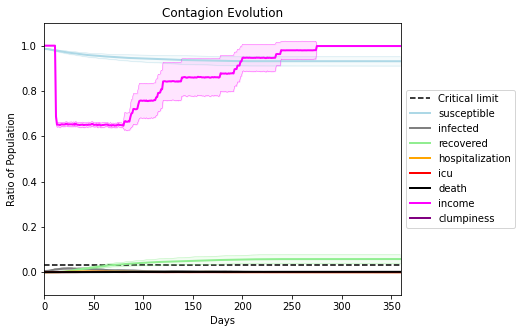

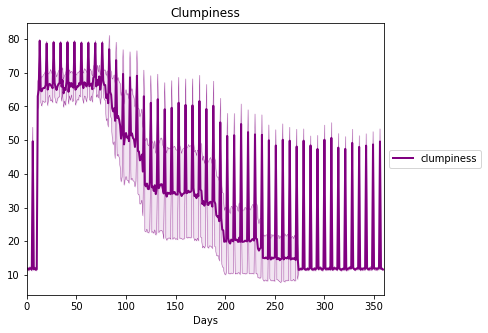

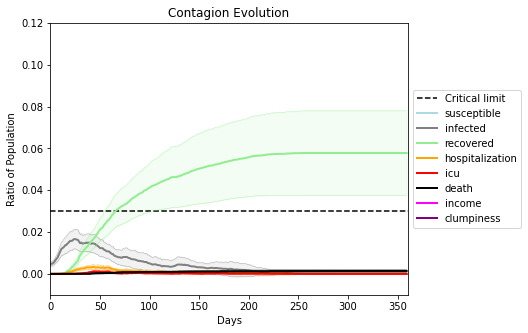

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.993", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[2691, 8077, 3896, 1696, 5346, 816, 2266, 8821, 4575, 2825, 3500, 4983, 2096, 4822, 7204, 8384, 7129, 1172, 9625, 8769]
Average similarity between family members is 0.984764730628085 at temperature -0.992
Average similarity between family and home is 0.9998998847074663 at temperature -1
Average similarity between students and their classroom is 0.4931145278829748 at temperature -0.992
Average classroom occupancy is 12.416666666666666 and number classrooms is 24
Average similarity between workers is 0.919572400345389 at temperature -0.992
Average office occupancy is 9.636363636363637 and number offices is 66
Average friend similarity for adults: 0.9685228685575441 for kids: 0.6580472886574179
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.4428435211657649
disconnects
0.03
clumpiness 13.13
avg restaurant similarity 0.412140038386232
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.3349324997350439
disconnects
0.01
clumpiness 11.95
avg restaurant similarity 0.30639362123419983
disconnects
0.03
clumpiness 13.17
avg restaurant similarity 0.2672935522996947
disconnects
0.02
clumpiness 12.17
avg restaurant similarity 0.4273105918040726
disconnects
0.01
clumpiness 11.79
avg restaurant similarity 0.34627521467888667
disconnects
0.43
clumpiness 41.42
avg restaurant similarity 0.36352325377826294
disconnects
0.0
clumpiness 10.5
avg restaurant similarity 0.4542008725394667
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.5459668611395326
disconnects
0.01
clumpiness 11.62
avg restaurant similarity 0.49923645553525403
disconnects
0.02
clumpiness 12.79
avg restaurant similarity 0.2434672162202409
disconnects
0.75
clumpiness 64.85
avg restaurant similarity 0.5636970940187528
disconne

avg restaurant similarity 0.46635081581779936
disconnects
0.57
clumpiness 51.41
avg restaurant similarity 0.4842559795950343
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.31164997996649246
disconnects
0.01
clumpiness 11.94
avg restaurant similarity 0.496431943362989
disconnects
0.01
clumpiness 12.9
avg restaurant similarity 0.3111205160007752
disconnects
0.01
clumpiness 12.08
avg restaurant similarity 0.3661263608471089
disconnects
0.02
clumpiness 12.68
avg restaurant similarity 0.536046589366182
disconnects
0.0
clumpiness 11.48
avg restaurant similarity 0.4061070719231633
disconnects
0.41
clumpiness 39.8
avg restaurant similarity 0.3566395490550472
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.46272457071454265
disconnects
0.02
clumpiness 12.98
avg restaurant similarity 0.5115005998784022
disconnects
0.0
clumpiness 11.26
avg restaurant similarity 0.4147240303142272
disconnects
0.01
clumpiness 11.71
avg restaurant similarity 0.396874027273859
disconnects
0

avg restaurant similarity 0.49333252755484375
disconnects
0.01
clumpiness 11.2
avg restaurant similarity 0.46459904585126766
disconnects
0.52
clumpiness 47.81
avg restaurant similarity 0.3663451232772987
disconnects
0.0
clumpiness 10.82
avg restaurant similarity 0.32226492020774805
disconnects
0.01
clumpiness 11.8
avg restaurant similarity 0.5017564332543004
disconnects
0.01
clumpiness 11.52
avg restaurant similarity 0.37863846225239645
disconnects
0.01
clumpiness 12.3
avg restaurant similarity 0.3993335541174282
disconnects
0.01
clumpiness 11.28
avg restaurant similarity 0.473259454438126
disconnects
0.01
clumpiness 12.62
avg restaurant similarity 0.2537487509653345
disconnects
0.56
clumpiness 51.36
avg restaurant similarity 0.3182043667443445
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.31654663815127637
disconnects
0.03
clumpiness 12.79
avg restaurant similarity 0.3575601187320408
disconnects
0.01
clumpiness 11.67
avg restaurant similarity 0.47974930792419873
disconn

avg restaurant similarity 0.4453801782260501
disconnects
0.03
clumpiness 12.96
avg restaurant similarity 0.52622237144166
disconnects
0.01
clumpiness 11.73
avg restaurant similarity 0.34639962129101487
disconnects
0.53
clumpiness 48.57
avg restaurant similarity 0.4414373837840658
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.3883632910767391
disconnects
0.01
clumpiness 10.86
avg restaurant similarity 0.5561541896781987
disconnects
0.04
clumpiness 14.11
avg restaurant similarity 0.45600648949374084
disconnects
0.01
clumpiness 11.73
avg restaurant similarity 0.4479339154406179
disconnects
0.02
clumpiness 12.42
avg restaurant similarity 0.36592509314163
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.5563128543548886
disconnects
0.44
clumpiness 42.66
avg restaurant similarity 0.711128110294575
disconnects
0.03
clumpiness 13.92
avg restaurant similarity 0.3876031828849339
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.5300655651535091
disconnects
0.

avg restaurant similarity 0.38394133071501807
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.3295593995059812
disconnects
0.02
clumpiness 11.87
avg restaurant similarity 0.36993973054728624
disconnects
0.0
clumpiness 11.73
avg restaurant similarity 0.47802230658361616
disconnects
0.02
clumpiness 12.53
avg restaurant similarity 0.2979345769510895
disconnects
0.0
clumpiness 11.23
avg restaurant similarity 0.32922092877371306
disconnects
0.02
clumpiness 12.97
avg restaurant similarity 0.3252739763907983
disconnects
0.49
clumpiness 45.5
avg restaurant similarity 0.3443723802394379
disconnects
0.02
clumpiness 12.0
avg restaurant similarity 0.37531965926640687
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.38663636557031594
disconnects
0.01
clumpiness 11.2
avg restaurant similarity 0.4400263470411119
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.3993128005963981
disconnects
0.63
clumpiness 55.63
avg restaurant similarity 0.3292565046075634
disconnec

disconnects
0.68
clumpiness 59.36
avg restaurant similarity 0.4383518184369087
disconnects
0.97
clumpiness 77.8
avg restaurant similarity 0.4234510825977639
disconnects
0.63
clumpiness 56.25
avg restaurant similarity 0.3536542120735678
disconnects
0.67
clumpiness 58.98
avg restaurant similarity 0.34636484837573933
disconnects
0.74
clumpiness 62.66
avg restaurant similarity 0.3470539239241006
disconnects
0.61
clumpiness 56.6
avg restaurant similarity 0.38387353115700146
disconnects
0.64
clumpiness 56.46
avg restaurant similarity 0.46855782219214304
disconnects
0.44
clumpiness 46.49
avg restaurant similarity 0.2733830235188667
disconnects
0.97
clumpiness 77.94
avg restaurant similarity 0.37691749969859517
disconnects
0.59
clumpiness 53.28
avg restaurant similarity 0.3836584391493235
disconnects
0.52
clumpiness 49.33
avg restaurant similarity 0.2653621766437527
disconnects
0.85
clumpiness 70.01
avg restaurant similarity 0.3440446851185303
disconnects
0.5
clumpiness 46.61
avg restaurant si

disconnects
0.01
clumpiness 11.61
avg restaurant similarity 0.3015094947366421
disconnects
0.01
clumpiness 12.46
avg restaurant similarity 0.39364069326679213
disconnects
0.53
clumpiness 49.12
avg restaurant similarity 0.28776761915532
disconnects
0.01
clumpiness 11.93
avg restaurant similarity 0.4232461798163282
disconnects
0.02
clumpiness 13.34
avg restaurant similarity 0.34384942549058073
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.38120985854492384
disconnects
0.01
clumpiness 11.77
avg restaurant similarity 0.4629400449290394
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.2977923745878589
disconnects
0.01
clumpiness 10.83
avg restaurant similarity 0.4144418410106727
disconnects
0.41
clumpiness 41.37
avg restaurant similarity 0.27489274683292897
disconnects
0.03
clumpiness 13.21
avg restaurant similarity 0.3483950493776786
disconnects
0.02
clumpiness 12.32
avg restaurant similarity 0.30985620421209625
disconnects
0.01
clumpiness 11.98
avg restaurant si

disconnects
0.01
clumpiness 11.77
avg restaurant similarity 0.28546367884831925
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.2865460387222928
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.3331556450304648
disconnects
0.55
clumpiness 50.34
avg restaurant similarity 0.405436636350208
disconnects
0.01
clumpiness 11.3
avg restaurant similarity 0.46447555340131175
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.41545684516099735
disconnects
0.0
clumpiness 11.16
avg restaurant similarity 0.2734181835550822
disconnects
0.03
clumpiness 12.54
avg restaurant similarity 0.4336485267189409
disconnects
0.01
clumpiness 11.41
avg restaurant similarity 0.3079930844275384
disconnects
0.02
clumpiness 12.17
avg restaurant similarity 0.25824891081388696
disconnects
0.43
clumpiness 41.54
avg restaurant similarity 0.4408718600112819
disconnects
0.01
clumpiness 11.77
avg restaurant similarity 0.1776919139958206
disconnects
0.01
clumpiness 11.62
avg restaurant simila

avg restaurant similarity 0.4767772196149797
disconnects
0.06
clumpiness 15.78
avg restaurant similarity 0.30948879006596514
disconnects
0.03
clumpiness 13.68
avg restaurant similarity 0.35128315905418295
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.1787651945862756
disconnects
0.02
clumpiness 12.57
avg restaurant similarity 0.23916752580982006
disconnects
0.03
clumpiness 12.94
avg restaurant similarity 0.2263680853450504
disconnects
0.01
clumpiness 12.46
avg restaurant similarity 0.2273544628503114
disconnects
0.66
clumpiness 57.06
avg restaurant similarity 0.28095353516708155
disconnects
0.03
clumpiness 13.54
avg restaurant similarity 0.30502746422986315
disconnects
0.01
clumpiness 12.18
avg restaurant similarity 0.30503935626375106
disconnects
0.01
clumpiness 12.49
avg restaurant similarity 0.21716052739163452
disconnects
0.02
clumpiness 13.05
avg restaurant similarity 0.3825259624406321
disconnects
0.82
clumpiness 68.26
avg restaurant similarity 0.21578302101081095


avg restaurant similarity 0.4304441699439571
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.19674130623706107
disconnects
0.81
clumpiness 68.16
avg restaurant similarity 0.3558370965040932
disconnects
0.83
clumpiness 68.57
avg restaurant similarity 0.3302119685082405
disconnects
0.88
clumpiness 72.43
avg restaurant similarity 0.3740475462384421
disconnects
0.82
clumpiness 67.63
avg restaurant similarity 0.26498096018799455
disconnects
0.9
clumpiness 72.97
avg restaurant similarity 0.3122313332541415
disconnects
0.74
clumpiness 63.76
avg restaurant similarity 0.1622811420507562
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.35597562462828497
disconnects
0.75
clumpiness 63.52
avg restaurant similarity 0.17887270824137383
disconnects
0.81
clumpiness 67.48
avg restaurant similarity 0.16413018248917982
disconnects
0.81
clumpiness 66.86
avg restaurant similarity 0.45411067897250873
disconnects
0.81
clumpiness 69.01
avg restaurant similarity 0.25606002403106776
d

disconnects
0.04
clumpiness 14.18
avg restaurant similarity 0.4568035956840267
disconnects
0.01
clumpiness 12.38
avg restaurant similarity 0.3958352099177542
disconnects
0.52
clumpiness 49.42
avg restaurant similarity 0.1895491766776309
disconnects
0.02
clumpiness 13.44
avg restaurant similarity 0.34278694343366684
disconnects
0.03
clumpiness 13.45
avg restaurant similarity 0.48955923561845893
disconnects
0.01
clumpiness 12.15
avg restaurant similarity 0.30416398846022713
disconnects
0.02
clumpiness 12.9
avg restaurant similarity 0.16853570637529658
disconnects
0.05
clumpiness 15.75
avg restaurant similarity 0.253820058367732
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.48723892698150983
disconnects
0.53
clumpiness 48.9
avg restaurant similarity 0.3701793178183739
disconnects
0.01
clumpiness 12.01
avg restaurant similarity 0.17582733602283007
disconnects
0.02
clumpiness 12.86
avg restaurant similarity 0.19243630235792186
disconnects
0.02
clumpiness 13.75
avg restaurant s

disconnects
0.01
clumpiness 12.14
avg restaurant similarity 0.38387589811372264
disconnects
0.01
clumpiness 12.76
avg restaurant similarity 0.35891311345345606
disconnects
0.02
clumpiness 12.85
avg restaurant similarity 0.2382251398758012
disconnects
0.46
clumpiness 46.97
avg restaurant similarity 0.26276352778539164
disconnects
0.06
clumpiness 15.51
avg restaurant similarity 0.31958695229489015
disconnects
0.01
clumpiness 12.64
avg restaurant similarity 0.17387144371603996
disconnects
0.04
clumpiness 15.2
avg restaurant similarity 0.1945945206422608
disconnects
0.03
clumpiness 13.47
avg restaurant similarity 0.33146730046642536
disconnects
0.02
clumpiness 12.08
avg restaurant similarity 0.3327339163069687
disconnects
0.03
clumpiness 13.68
avg restaurant similarity 0.37429083088964804
disconnects
0.52
clumpiness 49.56
avg restaurant similarity 0.2665555605771793
disconnects
0.02
clumpiness 11.77
avg restaurant similarity 0.20018910489108896
disconnects
0.03
clumpiness 13.39
avg restaur

avg restaurant similarity 0.4476774704436254
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.33548957227426923
disconnects
0.0
clumpiness 12.1
avg restaurant similarity 0.3031546006647168
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.42010334046627934
disconnects
0.0
clumpiness 11.97
avg restaurant similarity 0.6513836129630962
disconnects
0.0
clumpiness 12.32
avg restaurant similarity 0.29375717598821327
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.5339756120864344
disconnects
0.59
clumpiness 53.27
avg restaurant similarity 0.3626092613268654
disconnects
0.0
clumpiness 12.13
avg restaurant similarity 0.6387210462458895
disconnects
0.0
clumpiness 12.21
avg restaurant similarity 0.5296059251797173
disconnects
0.0
clumpiness 11.62
avg restaurant similarity 0.2777629723094189
disconnects
0.0
clumpiness 11.92
avg restaurant similarity 0.24053114641276468
disconnects
0.94
clumpiness 75.82
avg restaurant similarity 0.34363324950713553
disconnects
0.

avg restaurant similarity 0.5064313931503112
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.566590368976117
disconnects
0.92
clumpiness 74.63
avg restaurant similarity 0.2905326023525043
disconnects
0.91
clumpiness 74.24
avg restaurant similarity 0.3904402360772489
disconnects
0.95
clumpiness 76.59
avg restaurant similarity 0.47056193323727113
disconnects
0.95
clumpiness 76.62
avg restaurant similarity 0.4806738636804244
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.36601722357865135
disconnects
0.97
clumpiness 77.97
avg restaurant similarity 0.313629095662062
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5615533367275025
disconnects
0.97
clumpiness 77.96
avg restaurant similarity 0.4987694342773362
disconnects
0.93
clumpiness 74.98
avg restaurant similarity 0.3416090547447327
disconnects
0.89
clumpiness 72.44
avg restaurant similarity 0.3768844398185433
disconnects
0.98
clumpiness 78.59
avg restaurant similarity 0.4670791448443379
disconnects
0

avg restaurant similarity 0.45852792195066416
disconnects
0.91
clumpiness 73.78
avg restaurant similarity 0.27101512229543945
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.4132731897303788
disconnects
0.91
clumpiness 73.83
avg restaurant similarity 0.3421665183529817
disconnects
0.97
clumpiness 77.87
avg restaurant similarity 0.3852691996950182
disconnects
0.96
clumpiness 77.29
avg restaurant similarity 0.3372928570193392
disconnects
0.85
clumpiness 71.28
avg restaurant similarity 0.47629636546432247
disconnects
0.85
clumpiness 70.07
avg restaurant similarity 0.2619530432445008
disconnects
0.91
clumpiness 74.64
avg restaurant similarity 0.4378076547163044
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.3588808386575407
disconnects
0.93
clumpiness 75.08
avg restaurant similarity 0.4464416599121411
disconnects
0.94
clumpiness 75.75
avg restaurant similarity 0.4219509455954624
disconnects
0.94
clumpiness 75.98
avg restaurant similarity 0.4955356669787581
disc

disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.4355804640743711
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.29352489419913047
disconnects
0.61
clumpiness 54.76
avg restaurant similarity 0.4062513528593707
disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.7217983403091737
disconnects
0.0
clumpiness 12.42
avg restaurant similarity 0.6102423861062753
disconnects
0.0
clumpiness 11.3
avg restaurant similarity 0.3980731131042827
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.5421087367820641
disconnects
0.0
clumpiness 12.97
avg restaurant similarity 0.5430111560481183
disconnects
0.0
clumpiness 11.93
avg restaurant similarity 0.3431626662116835
disconnects
0.85
clumpiness 69.85
avg restaurant similarity 0.4318158674783743
disconnects
0.0
clumpiness 12.06
avg restaurant similarity 0.20327147694666295
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.5091977758041626
disconnects
0.0
clumpiness 11.38
avg restaurant similarity 0.3

avg restaurant similarity 0.3354899535470347
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.35293671607879845
disconnects
0.01
clumpiness 11.02
avg restaurant similarity 0.2451723634948683
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.325611110683206
disconnects
0.0
clumpiness 10.5
avg restaurant similarity 0.34242354119447516
disconnects
0.0
clumpiness 10.43
avg restaurant similarity 0.35008993695138757
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.33740196701965713
disconnects
0.53
clumpiness 49.56
avg restaurant similarity 0.23034549808232302
disconnects
0.0
clumpiness 10.4
avg restaurant similarity 0.3408555609174155
disconnects
0.01
clumpiness 11.21
avg restaurant similarity 0.4685646394141704
disconnects
0.0
clumpiness 10.82
avg restaurant similarity 0.2577150182863695
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.3873866275669041
disconnects
0.52
clumpiness 49.77
avg restaurant similarity 0.2902004469636699
disconnects
0

disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.4109132564894956
disconnects
0.47
clumpiness 44.2
avg restaurant similarity 0.3626907166727087
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.42298175163985824
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.39175062711539865
disconnects
0.02
clumpiness 11.66
avg restaurant similarity 0.4082924348563622
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.336772729130184
disconnects
0.0
clumpiness 10.94
avg restaurant similarity 0.3637040127406082
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.4102916461276165
disconnects
0.43
clumpiness 42.01
avg restaurant similarity 0.3087460348676501
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.40328282164523344
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.30095661892264797
disconnects
0.01
clumpiness 11.16
avg restaurant similarity 0.4135300164675857
disconnects
0.01
clumpiness 11.58
avg restaurant similarit

avg restaurant similarity 0.3942422990652156
disconnects
0.01
clumpiness 11.45
avg restaurant similarity 0.39056319608996787
disconnects
0.54
clumpiness 48.85
avg restaurant similarity 0.34624780274976263
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.3909770446402427
disconnects
0.0
clumpiness 10.2
avg restaurant similarity 0.27400799331440573
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.3043194193784107
disconnects
0.01
clumpiness 11.38
avg restaurant similarity 0.36077479153674713
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.4781512655803226
disconnects
0.0
clumpiness 10.47
avg restaurant similarity 0.3246690816539675
disconnects
0.45
clumpiness 44.12
avg restaurant similarity 0.36718945629357447
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.3757647490748344
disconnects
0.01
clumpiness 12.03
avg restaurant similarity 0.5012451370270575
disconnects
0.01
clumpiness 11.57
avg restaurant similarity 0.28303649529881886
disconnec

disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.4042964629421606
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.31865653280279593
disconnects
0.51
clumpiness 47.26
avg restaurant similarity 0.3399733461506277
disconnects
0.01
clumpiness 11.06
avg restaurant similarity 0.38278647401519095
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.394619028162479
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.44062571786802857
disconnects
0.0
clumpiness 10.37
avg restaurant similarity 0.4390823492166769
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.30345877333973903
disconnects
0.0
clumpiness 10.14
avg restaurant similarity 0.4691357211392909
disconnects
0.39
clumpiness 38.61
avg restaurant similarity 0.2606143322330484
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.3542866060883185
disconnects
0.01
clumpiness 11.83
avg restaurant similarity 0.28871728446843353
disconnects
0.0
clumpiness 10.85
avg restaurant similarit

avg restaurant similarity 0.5290772650681201
disconnects
0.0
clumpiness 11.34
avg restaurant similarity 0.5991827090314747
disconnects
0.0
clumpiness 11.89
avg restaurant similarity 0.3565882189522866
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.6446479339143445
disconnects
0.0
clumpiness 11.79
avg restaurant similarity 0.23660291754700802
disconnects
0.0
clumpiness 11.26
avg restaurant similarity 0.2685768517225787
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.48509867282310554
disconnects
0.67
clumpiness 57.25
avg restaurant similarity 0.4251822702815173
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.4753344372100216
disconnects
0.02
clumpiness 13.1
avg restaurant similarity 0.6488425103615524
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.5243681973436226
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.31890062266292607
disconnects
0.7
clumpiness 63.19
avg restaurant similarity 0.6429259781182873
disconnects
0.9

avg restaurant similarity 0.34164017389847684
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.41459909345928136
disconnects
0.9
clumpiness 73.27
avg restaurant similarity 0.46970291389750657
disconnects
0.82
clumpiness 67.92
avg restaurant similarity 0.40621023801988737
disconnects
0.82
clumpiness 68.07
avg restaurant similarity 0.4982006680191477
disconnects
0.85
clumpiness 69.79
avg restaurant similarity 0.5036522505903189
disconnects
0.84
clumpiness 69.66
avg restaurant similarity 0.3961417842630604
disconnects
0.81
clumpiness 67.58
avg restaurant similarity 0.29245227221133363
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.45730940915101015
disconnects
0.94
clumpiness 76.04
avg restaurant similarity 0.47968511063914904
disconnects
0.94
clumpiness 76.0
avg restaurant similarity 0.3604536888403962
disconnects
0.8
clumpiness 67.34
avg restaurant similarity 0.42792317938423385
disconnects
0.87
clumpiness 71.87
avg restaurant similarity 0.43119170492625114
dis

avg restaurant similarity 0.45523891254570276
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.5427003047388393
disconnects
0.61
clumpiness 53.34
avg restaurant similarity 0.46507942277731235
disconnects
0.0
clumpiness 12.06
avg restaurant similarity 0.27638427984008257
disconnects
0.01
clumpiness 12.25
avg restaurant similarity 0.4052645782869916
disconnects
0.0
clumpiness 11.55
avg restaurant similarity 0.4923272550451501
disconnects
0.02
clumpiness 12.49
avg restaurant similarity 0.3788394153182346
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.34962612029876744
disconnects
0.03
clumpiness 13.84
avg restaurant similarity 0.5631710774501095
disconnects
0.32
clumpiness 35.58
avg restaurant similarity 0.4581796765104689
disconnects
0.0
clumpiness 11.16
avg restaurant similarity 0.5063527073247309
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.5020775656954047
disconnects
0.03
clumpiness 13.22
avg restaurant similarity 0.38981007233230947
disconne

disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.3809848226465763
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.46747535831476605
disconnects
0.66
clumpiness 57.69
avg restaurant similarity 0.37767107672876515
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.38910630479158653
disconnects
0.02
clumpiness 13.05
avg restaurant similarity 0.42057767373300353
disconnects
0.02
clumpiness 12.87
avg restaurant similarity 0.5058172205065001
disconnects
0.01
clumpiness 11.85
avg restaurant similarity 0.34141384873892205
disconnects
0.0
clumpiness 11.58
avg restaurant similarity 0.4987691270980028
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.45569460531975703
disconnects
0.41
clumpiness 40.66
avg restaurant similarity 0.4120327121440857
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.34561879119360894
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.37189260699195326
disconnects
0.0
clumpiness 10.64
avg restaurant simi

avg restaurant similarity 0.41619877525110743
disconnects
0.01
clumpiness 12.26
avg restaurant similarity 0.29011593368313077
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.46785013468251324
disconnects
0.01
clumpiness 11.57
avg restaurant similarity 0.3187630526557073
disconnects
0.02
clumpiness 12.18
avg restaurant similarity 0.4815160732718496
disconnects
0.01
clumpiness 10.81
avg restaurant similarity 0.5144363143294157
disconnects
0.0
clumpiness 11.38
avg restaurant similarity 0.482127866383032
disconnects
0.51
clumpiness 47.87
avg restaurant similarity 0.4943528141148096
disconnects
0.0
clumpiness 11.41
avg restaurant similarity 0.49888179331564003
disconnects
0.0
clumpiness 10.56
avg restaurant similarity 0.5142765291398689
disconnects
0.02
clumpiness 12.56
avg restaurant similarity 0.45479298852566535
disconnects
0.01
clumpiness 11.56
avg restaurant similarity 0.40902999448378075
disconnects
0.57
clumpiness 53.88
avg restaurant similarity 0.2697531535375235
discon

avg restaurant similarity 0.4078982799487199
disconnects
0.97
clumpiness 77.75
avg restaurant similarity 0.38268941819479924
disconnects
0.58
clumpiness 53.32
avg restaurant similarity 0.6351519252303921
disconnects
0.7
clumpiness 61.53
avg restaurant similarity 0.4245175587679458
disconnects
0.59
clumpiness 54.08
avg restaurant similarity 0.504699771042806
disconnects
0.83
clumpiness 69.04
avg restaurant similarity 0.359032144491461
disconnects
0.73
clumpiness 62.41
avg restaurant similarity 0.5464668569517378
disconnects
0.84
clumpiness 69.22
avg restaurant similarity 0.4885981494619113
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.413188165041119
disconnects
0.7
clumpiness 60.82
avg restaurant similarity 0.40320977827170956
disconnects
0.64
clumpiness 56.8
avg restaurant similarity 0.580070315748583
disconnects
0.82
clumpiness 68.12
avg restaurant similarity 0.5029616868484776
disconnects
0.63
clumpiness 55.36
avg restaurant similarity 0.4265683137203529
disconnects


disconnects
0.0
clumpiness 11.52
avg restaurant similarity 0.4057082983720954
disconnects
0.69
clumpiness 59.35
avg restaurant similarity 0.39280416221559866
disconnects
0.03
clumpiness 13.1
avg restaurant similarity 0.21118694270729976
disconnects
0.02
clumpiness 13.08
avg restaurant similarity 0.5436075031621072
disconnects
0.01
clumpiness 11.99
avg restaurant similarity 0.3712443535406195
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.39269949199795495
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.4547651791807336
disconnects
0.01
clumpiness 12.2
avg restaurant similarity 0.42801844761302243
disconnects
0.41
clumpiness 40.15
avg restaurant similarity 0.40857000896917506
disconnects
0.01
clumpiness 10.89
avg restaurant similarity 0.4732375121495388
disconnects
0.03
clumpiness 13.29
avg restaurant similarity 0.5487820709127239
disconnects
0.0
clumpiness 10.02
avg restaurant similarity 0.3782829411045795
disconnects
0.0
clumpiness 10.81
avg restaurant simil

avg restaurant similarity 0.40968857119294394
disconnects
0.02
clumpiness 12.24
avg restaurant similarity 0.3880279991258046
disconnects
0.61
clumpiness 54.27
avg restaurant similarity 0.3874864238876821
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.4615843454937464
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.5280910296857771
disconnects
0.01
clumpiness 12.11
avg restaurant similarity 0.39321064867285505
disconnects
0.0
clumpiness 11.55
avg restaurant similarity 0.3065531395362376
disconnects
0.01
clumpiness 10.74
avg restaurant similarity 0.4721031850484974
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.4678949810249586
disconnects
0.53
clumpiness 48.51
avg restaurant similarity 0.4793368904005997
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.31271854996539034
disconnects
0.01
clumpiness 12.11
avg restaurant similarity 0.3518493036070845
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.3330916099331637
disconnect

avg restaurant similarity 0.44013669785579723
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.5275172998314784
disconnects
0.0
clumpiness 11.81
avg restaurant similarity 0.4199822165458934
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.29601593937370957
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.42989199603099315
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.41150916048371483
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.4244535452638486
disconnects
0.54
clumpiness 49.15
avg restaurant similarity 0.2859720440859769
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.34080484665383765
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.27343459664715913
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.3387032851204889
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.2438760782196671
disconnects
0.82
clumpiness 68.4
avg restaurant similarity 0.31708632754048577
disconnects

avg restaurant similarity 0.3729542550042951
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.41368295515502895
disconnects
0.88
clumpiness 72.0
avg restaurant similarity 0.39878586504097546
disconnects
0.84
clumpiness 68.88
avg restaurant similarity 0.4711897812819244
disconnects
0.9
clumpiness 73.27
avg restaurant similarity 0.452101087610357
disconnects
0.85
clumpiness 70.22
avg restaurant similarity 0.39634622997769664
disconnects
0.84
clumpiness 69.68
avg restaurant similarity 0.38725068799138235
disconnects
0.87
clumpiness 71.54
avg restaurant similarity 0.3141132127383636
disconnects
0.95
clumpiness 76.41
avg restaurant similarity 0.4465019755274357
disconnects
0.92
clumpiness 74.38
avg restaurant similarity 0.3596999677931539
disconnects
0.63
clumpiness 56.28
avg restaurant similarity 0.42756451167035686
disconnects
0.9
clumpiness 72.95
avg restaurant similarity 0.4361191336602981
disconnects
0.88
clumpiness 72.11
avg restaurant similarity 0.33025668769232935
disco

avg restaurant similarity 0.3898415918452113
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.26449259409280257
disconnects
0.55
clumpiness 50.58
avg restaurant similarity 0.4374102549426487
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.26572103345928216
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.47435508044646996
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.3436483621627946
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.3465130842473986
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.27010561211178236
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.476073037426606
disconnects
0.48
clumpiness 45.27
avg restaurant similarity 0.4732099296674912
disconnects
0.0
clumpiness 10.48
avg restaurant similarity 0.4623287109596017
disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.31083055874583454
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.356709461945147
disconnects
0.0

disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.24856708796935453
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.42966233491388517
disconnects
0.39
clumpiness 40.08
avg restaurant similarity 0.4823626127844685
disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.3158210139173649
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.3656948226043294
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.30490200753579577
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.28749299541446294
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.4353832205510441
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.5153842931371936
disconnects
0.59
clumpiness 52.63
avg restaurant similarity 0.31866067606634885
disconnects
0.0
clumpiness 11.26
avg restaurant similarity 0.290545089626713
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.5239085836841195
disconnects
0.0
clumpiness 11.18
avg restaurant similarity

avg restaurant similarity 0.5222917755218046
disconnects
0.03
clumpiness 13.03
avg restaurant similarity 0.4925904338562006
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.4730274418133313
disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.629900943461314
disconnects
0.0
clumpiness 11.51
avg restaurant similarity 0.5316281243079574
disconnects
0.01
clumpiness 12.27
avg restaurant similarity 0.5384909826501698
disconnects
0.02
clumpiness 13.2
avg restaurant similarity 0.5334687667940651
disconnects
0.68
clumpiness 59.85
avg restaurant similarity 0.2530040765044712
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.5046444783871052
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.31295577210965203
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.2972619172927517
disconnects
0.01
clumpiness 12.04
avg restaurant similarity 0.42984340411569394
disconnects
0.91
clumpiness 73.86
avg restaurant similarity 0.3581994544703155
disconnects
0

avg restaurant similarity 0.27330241744501177
disconnects
0.97
clumpiness 77.73
avg restaurant similarity 0.6311870527136187
disconnects
0.97
clumpiness 77.85
avg restaurant similarity 0.4352478579502587
disconnects
0.85
clumpiness 69.83
avg restaurant similarity 0.36946794712489495
disconnects
0.89
clumpiness 72.49
avg restaurant similarity 0.5105244953850024
disconnects
0.95
clumpiness 76.38
avg restaurant similarity 0.2720242528309903
disconnects
0.82
clumpiness 68.55
avg restaurant similarity 0.28381831287150344
disconnects
0.95
clumpiness 76.47
avg restaurant similarity 0.3057124703856878
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.46586039015302705
disconnects
0.89
clumpiness 72.48
avg restaurant similarity 0.20242504796731686
disconnects
0.96
clumpiness 76.99
avg restaurant similarity 0.6357554595645393
disconnects
0.94
clumpiness 76.17
avg restaurant similarity 0.19266071965379866
disconnects
0.9
clumpiness 72.95
avg restaurant similarity 0.2972596957135876
disc

avg restaurant similarity 0.41285383411875476
disconnects
0.96
clumpiness 77.15
avg restaurant similarity 0.24277745862137498
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.4824353911652833
disconnects
0.96
clumpiness 77.31
avg restaurant similarity 0.5515203228405027
disconnects
0.96
clumpiness 77.06
avg restaurant similarity 0.44472452940064494
disconnects
0.83
clumpiness 68.81
avg restaurant similarity 0.5892195756749516
disconnects
0.94
clumpiness 75.79
avg restaurant similarity 0.5077273646848548
disconnects
0.94
clumpiness 75.9
avg restaurant similarity 0.5156453494851588
disconnects
0.95
clumpiness 76.48
avg restaurant similarity 0.4953355836988028
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.43782955757859304
disconnects
0.92
clumpiness 74.56
avg restaurant similarity 0.42885201741508433
disconnects
0.79
clumpiness 67.1
avg restaurant similarity 0.4102507461329707
disconnects
0.91
clumpiness 73.81
avg restaurant similarity 0.5655865608639228
discon

disconnects
0.02
clumpiness 12.75
avg restaurant similarity 0.37618081848539925
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.4114043554775711
disconnects
0.56
clumpiness 52.08
avg restaurant similarity 0.3263258881039285
disconnects
0.03
clumpiness 13.35
avg restaurant similarity 0.3858997486598428
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.5021994668902291
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.6911938036844707
disconnects
0.0
clumpiness 12.04
avg restaurant similarity 0.42409513399459087
disconnects
0.0
clumpiness 11.43
avg restaurant similarity 0.33784241997937237
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.5421357099881914
disconnects
0.78
clumpiness 65.27
avg restaurant similarity 0.6067489844518753
disconnects
0.0
clumpiness 11.73
avg restaurant similarity 0.4519319045604789
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.35856645189099406
disconnects
0.0
clumpiness 11.37
avg restaurant similari

avg restaurant similarity 0.49213422233815035
disconnects
0.01
clumpiness 12.32
avg restaurant similarity 0.42502813135902534
disconnects
0.0
clumpiness 11.58
avg restaurant similarity 0.5184479914176306
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.3718954320180583
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.5001106238098727
disconnects
0.0
clumpiness 11.74
avg restaurant similarity 0.6214670092405046
disconnects
0.01
clumpiness 12.18
avg restaurant similarity 0.4854495669247943
disconnects
0.58
clumpiness 52.17
avg restaurant similarity 0.4911451008762324
disconnects
0.01
clumpiness 12.01
avg restaurant similarity 0.4947624680486673
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.45606144849724195
disconnects
0.0
clumpiness 11.78
avg restaurant similarity 0.38432616062747493
disconnects
0.03
clumpiness 14.4
avg restaurant similarity 0.42396890635794166
disconnects
0.87
clumpiness 71.51
avg restaurant similarity 0.512289658305616
disconnect

avg restaurant similarity 0.5358902257848064
disconnects
0.5
clumpiness 46.7
avg restaurant similarity 0.44043679070579844
disconnects
0.0
clumpiness 12.0
avg restaurant similarity 0.5500371278032664
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.5432274000058904
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.43560841055839394
disconnects
0.03
clumpiness 12.86
avg restaurant similarity 0.470673246257275
disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.42134752365247835
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.40556256429714704
disconnects
0.65
clumpiness 56.26
avg restaurant similarity 0.47294048405854394
disconnects
0.0
clumpiness 11.66
avg restaurant similarity 0.3778653680741077
disconnects
0.01
clumpiness 11.38
avg restaurant similarity 0.5208993133508215
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.41547583921645553
disconnects
0.0
clumpiness 11.23
avg restaurant similarity 0.48159423401696794
disconnects


disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.4540855257344945
disconnects
0.54
clumpiness 49.77
avg restaurant similarity 0.43443422584610625
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.3939407965101244
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.38733431016158104
disconnects
0.01
clumpiness 11.81
avg restaurant similarity 0.4312218938159824
disconnects
0.02
clumpiness 13.27
avg restaurant similarity 0.4037276757844362
disconnects
0.01
clumpiness 12.01
avg restaurant similarity 0.4724310151120525
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.40672308683711067
disconnects
0.52
clumpiness 49.28
avg restaurant similarity 0.3545354967859212
disconnects
0.01
clumpiness 11.62
avg restaurant similarity 0.430395813590809
disconnects
0.01
clumpiness 11.98
avg restaurant similarity 0.3564640641695452
disconnects
0.0
clumpiness 11.51
avg restaurant similarity 0.43992668862055667
disconnects
0.0
clumpiness 11.58
avg restaurant simila

avg restaurant similarity 0.4855433990304056
disconnects
0.01
clumpiness 11.91
avg restaurant similarity 0.6079167527590608
disconnects
0.52
clumpiness 48.19
avg restaurant similarity 0.47870058361354323
disconnects
0.01
clumpiness 11.96
avg restaurant similarity 0.43754268100487986
disconnects
0.0
clumpiness 11.86
avg restaurant similarity 0.4007134730382848
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.40649041051578966
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.5080861130891137
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.6151256445680756
disconnects
0.01
clumpiness 12.14
avg restaurant similarity 0.43494108254823177
disconnects
0.55
clumpiness 50.09
avg restaurant similarity 0.48594568711405156
disconnects
0.01
clumpiness 12.68
avg restaurant similarity 0.4196770294625689
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.45263927367793183
disconnects
0.01
clumpiness 12.65
avg restaurant similarity 0.518990713060468
disconn

avg restaurant similarity 0.4371352809373146
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.4775231299194685
disconnects
0.0
clumpiness 12.23
avg restaurant similarity 0.36528386533489354
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.36232778717401354
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.3551815787816893
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.3927602744814847
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.5073894499226222
disconnects
0.42
clumpiness 42.41
avg restaurant similarity 0.3036853031920774
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.47405277450597055
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.4435524368639158
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.5796733489081785
disconnects
0.0
clumpiness 11.6
avg restaurant similarity 0.4177965581646106
disconnects
0.76
clumpiness 64.15
avg restaurant similarity 0.42484144695419257
disconnects
0.48


avg restaurant similarity 0.3816240136858765
disconnects
0.56
clumpiness 51.4
avg restaurant similarity 0.5702638299825549
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.41579476402130217
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.29612358920046433
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.4482185382374151
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.33889804520164507
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.38821602960319457
disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.551863510175881
disconnects
0.44
clumpiness 44.2
avg restaurant similarity 0.44111517316669685
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.4985555725240267
disconnects
0.0
clumpiness 11.68
avg restaurant similarity 0.3918614575371885
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.4896117751938227
disconnects
0.0
clumpiness 11.16
avg restaurant similarity 0.4161579417586257
disconnects
0.0

avg restaurant similarity 0.43784689007479016
disconnects
0.65
clumpiness 55.77
avg restaurant similarity 0.37992663601911486
disconnects
0.0
clumpiness 11.2
avg restaurant similarity 0.3808834528696353
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.3888521071390292
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.46607335857394333
disconnects
0.0
clumpiness 11.91
avg restaurant similarity 0.3724573541914055
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.3857079959389169
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.44220834077229676
disconnects
0.5
clumpiness 46.58
avg restaurant similarity 0.3924991975273682
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.39439456591343386
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.40999723053120884
disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.5267148000453208
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.43211167433415637
disconnects


avg restaurant similarity 0.4932729647443134
disconnects
0.54
clumpiness 49.47
avg restaurant similarity 0.3636592482091316
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.3755906901378593
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.42718422468370865
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.45969346476544554
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.46807170430017003
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.4168784723743721
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.44625066098580907
disconnects
0.49
clumpiness 46.45
avg restaurant similarity 0.49065942007003926
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.4376905660189565
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.4567727182160117
disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.4593117247617557
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.49819265981757516
disconnects

avg restaurant similarity 0.2399164601575837
disconnects
0.04
clumpiness 13.92
avg restaurant similarity 0.33330558724094056
disconnects
0.01
clumpiness 10.93
avg restaurant similarity 0.315269207704
disconnects
0.01
clumpiness 11.0
avg restaurant similarity 0.4203600174656769
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.4094880217226976
disconnects
0.02
clumpiness 12.52
avg restaurant similarity 0.46249632606278185
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.49061763395588215
disconnects
0.48
clumpiness 45.24
avg restaurant similarity 0.41943245334009643
disconnects
0.01
clumpiness 11.58
avg restaurant similarity 0.43057788038395994
disconnects
0.0
clumpiness 11.64
avg restaurant similarity 0.4041084719242883
disconnects
0.0
clumpiness 10.45
avg restaurant similarity 0.42057262897300124
disconnects
0.02
clumpiness 12.34
avg restaurant similarity 0.5162072393357856
disconnects
0.55
clumpiness 51.3
avg restaurant similarity 0.3468858342787463
disconnects

disconnects
0.01
clumpiness 11.9
avg restaurant similarity 0.3631639537901431
disconnects
0.01
clumpiness 11.9
avg restaurant similarity 0.43700278914337043
disconnects
0.35
clumpiness 36.87
avg restaurant similarity 0.4343307288371792
disconnects
0.01
clumpiness 11.2
avg restaurant similarity 0.39034691321163945
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.5055727783211557
disconnects
0.0
clumpiness 10.47
avg restaurant similarity 0.3653577225839507
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.4931677328610701
disconnects
0.01
clumpiness 11.35
avg restaurant similarity 0.5101894454396325
disconnects
0.01
clumpiness 11.87
avg restaurant similarity 0.3282350189763933
disconnects
0.4
clumpiness 39.14
avg restaurant similarity 0.2965462067161123
disconnects
0.0
clumpiness 10.45
avg restaurant similarity 0.3379662221448304
disconnects
0.04
clumpiness 13.44
avg restaurant similarity 0.38062964862504023
disconnects
0.01
clumpiness 11.07
avg restaurant similari

disconnects
0.01
clumpiness 11.01
avg restaurant similarity 0.3145912198207907
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.578328084550692
disconnects
0.03
clumpiness 13.09
avg restaurant similarity 0.34147501239922345
disconnects
0.41
clumpiness 40.68
avg restaurant similarity 0.3991753619450413
disconnects
0.01
clumpiness 11.75
avg restaurant similarity 0.4897401140364663
disconnects
0.02
clumpiness 11.74
avg restaurant similarity 0.4908863458977492
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.3893241015602905
disconnects
0.01
clumpiness 11.61
avg restaurant similarity 0.3913953281081996
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.3931774104208395
disconnects
0.01
clumpiness 11.55
avg restaurant similarity 0.4471779575600701
disconnects
0.34
clumpiness 37.3
avg restaurant similarity 0.4403856497839144
disconnects
0.01
clumpiness 11.29
avg restaurant similarity 0.3511720977457894
disconnects
0.01
clumpiness 11.42
avg restaurant similar

avg restaurant similarity 0.41820978849241397
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.40247713442463545
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.4456612847223403
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.45571200762284436
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.47140585960439857
disconnects
0.0
clumpiness 10.48
avg restaurant similarity 0.5219108794892049
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.5070877342242894
disconnects
0.5
clumpiness 46.09
avg restaurant similarity 0.5418065215538374
disconnects
0.0
clumpiness 11.34
avg restaurant similarity 0.4763794773065969
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.47302713003712143
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.5090227770220284
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.39627126091233617
disconnects
0.66
clumpiness 59.51
avg restaurant similarity 0.49088270635319003
disconnects


avg restaurant similarity 0.434318157672083
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.498835993214872
disconnects
0.85
clumpiness 69.65
avg restaurant similarity 0.5336470744525477
disconnects
0.0
clumpiness 11.0
avg restaurant similarity 0.45793792818083706
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.5378356776430997
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.6483121147812791
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.3375303528034625
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.4901396363614519
disconnects
0.46
clumpiness 43.76
avg restaurant similarity 0.5060019858542637
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.5134038650064616
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.45375294853548553
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.45885916612398864
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.48645367993823974
disconnects
0.0
c

avg restaurant similarity 0.41914696948786656
disconnects
0.49
clumpiness 45.71
avg restaurant similarity 0.5180812165473553
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.4122819495012457
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.4932277081056578
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.4512333976065637
disconnects
0.0
clumpiness 10.14
avg restaurant similarity 0.5073930868273213
disconnects
0.0
clumpiness 10.26
avg restaurant similarity 0.3683964152975557
disconnects
0.0
clumpiness 10.25
avg restaurant similarity 0.47365739115704214
disconnects
0.54
clumpiness 49.15
avg restaurant similarity 0.37276624770856287
disconnects
0.0
clumpiness 10.27
avg restaurant similarity 0.3324545060371389
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.5359599142811322
disconnects
0.0
clumpiness 10.74
avg restaurant similarity 0.5039212687077338
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.47353876902796577
disconnects
0.

avg restaurant similarity 0.4017799946591154
disconnects
0.51
clumpiness 47.38
avg restaurant similarity 0.47132343058082554
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.5608427413032931
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.4582945856858546
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.491511515904489
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.4407950072836942
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.42886381176436156
disconnects
0.0
clumpiness 10.26
avg restaurant similarity 0.43024984580559367
disconnects
0.51
clumpiness 48.08
avg restaurant similarity 0.41025007827566007
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.3968800364701372
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.4756370531471059
disconnects
0.0
clumpiness 10.13
avg restaurant similarity 0.5784535890433791
disconnects
0.0
clumpiness 11.03
avg restaurant similarity 0.4662628878869927
disconnects
0.0

avg restaurant similarity 0.5042128388592262
disconnects
0.01
clumpiness 11.8
avg restaurant similarity 0.48289363068459507
disconnects
0.01
clumpiness 11.46
avg restaurant similarity 0.4429586777250549
disconnects
0.03
clumpiness 13.21
avg restaurant similarity 0.4634369185219849
disconnects
0.03
clumpiness 13.07
avg restaurant similarity 0.44649772062923065
disconnects
0.01
clumpiness 11.32
avg restaurant similarity 0.3663343846922247
disconnects
0.04
clumpiness 14.48
avg restaurant similarity 0.6007624314510006
disconnects
0.51
clumpiness 47.07
avg restaurant similarity 0.5084650941417785
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.44326895513938136
disconnects
0.04
clumpiness 13.53
avg restaurant similarity 0.4237024082088289
disconnects
0.02
clumpiness 11.91
avg restaurant similarity 0.4134928786902814
disconnects
0.01
clumpiness 11.43
avg restaurant similarity 0.5345064274291654
disconnects
0.72
clumpiness 62.16
avg restaurant similarity 0.3700989625645279
discon

avg restaurant similarity 0.5155097138071636
disconnects
0.98
clumpiness 78.55
avg restaurant similarity 0.5367310593962118
disconnects
0.7
clumpiness 59.88
avg restaurant similarity 0.5613709043316312
disconnects
0.73
clumpiness 61.79
avg restaurant similarity 0.35148826700112024
disconnects
0.79
clumpiness 65.96
avg restaurant similarity 0.49336604622903063
disconnects
0.75
clumpiness 63.31
avg restaurant similarity 0.5140019199126948
disconnects
0.72
clumpiness 61.0
avg restaurant similarity 0.34321411426531667
disconnects
0.8
clumpiness 66.93
avg restaurant similarity 0.46251152386084465
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.4846586403200169
disconnects
0.73
clumpiness 62.01
avg restaurant similarity 0.5367649275765459
disconnects
0.72
clumpiness 62.22
avg restaurant similarity 0.43312360008434
disconnects
0.78
clumpiness 65.35
avg restaurant similarity 0.48497633392487455
disconnects
0.83
clumpiness 68.44
avg restaurant similarity 0.4363106952613349
disconn

avg restaurant similarity 0.5240046544712074
disconnects
0.01
clumpiness 11.55
avg restaurant similarity 0.3976413003946196
disconnects
0.45
clumpiness 42.7
avg restaurant similarity 0.5534284433197181
disconnects
0.0
clumpiness 10.82
avg restaurant similarity 0.36185043136158634
disconnects
0.03
clumpiness 13.44
avg restaurant similarity 0.3724296644751117
disconnects
0.03
clumpiness 13.13
avg restaurant similarity 0.506069120688196
disconnects
0.02
clumpiness 11.94
avg restaurant similarity 0.4890377573969015
disconnects
0.01
clumpiness 11.46
avg restaurant similarity 0.5441084554397428
disconnects
0.0
clumpiness 10.4
avg restaurant similarity 0.6020233587993081
disconnects
0.37
clumpiness 37.92
avg restaurant similarity 0.6034457813452317
disconnects
0.01
clumpiness 11.71
avg restaurant similarity 0.6668378456792544
disconnects
0.01
clumpiness 12.11
avg restaurant similarity 0.5314277187829658
disconnects
0.02
clumpiness 12.26
avg restaurant similarity 0.29527433000600706
disconnect

avg restaurant similarity 0.6100069520909308
disconnects
0.02
clumpiness 12.79
avg restaurant similarity 0.4744759629699813
disconnects
0.03
clumpiness 13.21
avg restaurant similarity 0.3289318979975331
disconnects
0.45
clumpiness 43.04
avg restaurant similarity 0.478164818090868
disconnects
0.0
clumpiness 10.4
avg restaurant similarity 0.3845200535405396
disconnects
0.04
clumpiness 14.05
avg restaurant similarity 0.49821612723789804
disconnects
0.02
clumpiness 12.24
avg restaurant similarity 0.5360853012944178
disconnects
0.01
clumpiness 11.39
avg restaurant similarity 0.47203461986475725
disconnects
0.02
clumpiness 12.02
avg restaurant similarity 0.34554253136594104
disconnects
0.01
clumpiness 12.12
avg restaurant similarity 0.45655992043616556
disconnects
0.28
clumpiness 31.49
avg restaurant similarity 0.474282553448784
disconnects
0.03
clumpiness 12.47
avg restaurant similarity 0.5095655438856712
disconnects
0.01
clumpiness 11.25
avg restaurant similarity 0.38111030925332096
discon

avg restaurant similarity 0.42942218979516106
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.3847449178707853
disconnects
0.0
clumpiness 10.53
avg restaurant similarity 0.3299740298187874
disconnects
0.0
clumpiness 11.03
avg restaurant similarity 0.2575961279854944
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.3022199592020487
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.382362086382721
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.1130966291949349
disconnects
0.53
clumpiness 49.77
avg restaurant similarity 0.2556683097999173
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.5777884522674943
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.21415357431681104
disconnects
0.0
clumpiness 10.17
avg restaurant similarity 0.4909960237194961
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.474324284009965
disconnects
0.8
clumpiness 66.81
avg restaurant similarity 0.38125461706016783
disconnects
0.7
c

avg restaurant similarity 0.39736919995628145
disconnects
0.67
clumpiness 58.12
avg restaurant similarity 0.4756698047141466
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.2906943510651124
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.5246805744122596
disconnects
0.0
clumpiness 10.89
avg restaurant similarity 0.29933914303953024
disconnects
0.0
clumpiness 10.89
avg restaurant similarity 0.3605657802347236
disconnects
0.0
clumpiness 11.87
avg restaurant similarity 0.3126320561931462
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.302977310587763
disconnects
0.63
clumpiness 55.89
avg restaurant similarity 0.278277105136689
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.40640355482456775
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.2768666840220428
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.4375707583514915
disconnects
0.0
clumpiness 11.88
avg restaurant similarity 0.36005258832347276
disconnects
0.0


avg restaurant similarity 0.14798341772927945
disconnects
0.71
clumpiness 60.4
avg restaurant similarity 0.31845888017068424
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.39123164194080384
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.25159505071995253
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.45755841801466146
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.5554772803964899
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.25221573688196053
disconnects
0.0
clumpiness 10.89
avg restaurant similarity 0.31775499477417074
disconnects
0.61
clumpiness 55.25
avg restaurant similarity 0.35991670231579276
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.38078825553810597
disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.5633337430599272
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.2812723415713243
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.36729601115275806
disconnec

disconnects
0.0
clumpiness 11.16
avg restaurant similarity 0.23906459316954926
disconnects
0.53
clumpiness 51.32
avg restaurant similarity 0.24866609322056765
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.3861771207601748
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.27543482121615026
disconnects
0.0
clumpiness 11.0
avg restaurant similarity 0.26536911745416086
disconnects
0.0
clumpiness 11.48
avg restaurant similarity 0.6406535783714344
disconnects
0.0
clumpiness 10.89
avg restaurant similarity 0.3103588649690374
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.4445719728656695
disconnects
0.76
clumpiness 63.35
avg restaurant similarity 0.298129623012649
disconnects
0.0
clumpiness 11.0
avg restaurant similarity 0.4208657181339511
disconnects
0.0
clumpiness 11.69
avg restaurant similarity 0.37087637642236043
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.2246148109791104
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.

avg restaurant similarity 0.29467754532996215
disconnects
0.0
clumpiness 11.04
avg restaurant similarity 0.2955643611905489
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.3573687855822784
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.3304285568885521
disconnects
0.0
clumpiness 11.76
avg restaurant similarity 0.3007994983297098
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.49244840065371054
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.3060457451133092
disconnects
0.4
clumpiness 40.78
avg restaurant similarity 0.4182129410725389
disconnects
0.0
clumpiness 11.43
avg restaurant similarity 0.32352590451223334
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.4383516294592515
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.3485893034943011
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.31177643701620683
disconnects
0.77
clumpiness 64.48
avg restaurant similarity 0.48179434481796046
disconnects
0.

avg restaurant similarity 0.3977273767416763
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.3233882412266428
disconnects
0.91
clumpiness 74.09
avg restaurant similarity 0.29516142675615153
disconnects
0.75
clumpiness 62.81
avg restaurant similarity 0.42394397829775693
disconnects
0.92
clumpiness 74.67
avg restaurant similarity 0.38256560428651754
disconnects
0.79
clumpiness 66.22
avg restaurant similarity 0.4027514417324858
disconnects
0.7
clumpiness 61.26
avg restaurant similarity 0.4243457507203134
disconnects
0.69
clumpiness 59.53
avg restaurant similarity 0.4234119117948183
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4230031274819194
disconnects
0.76
clumpiness 65.43
avg restaurant similarity 0.40710653717777223
disconnects
0.85
clumpiness 69.49
avg restaurant similarity 0.4630033338680348
disconnects
0.69
clumpiness 60.48
avg restaurant similarity 0.3860037043436289
disconnects
0.62
clumpiness 56.32
avg restaurant similarity 0.5289711224432727
discon

disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.46421532060307513
disconnects
0.43
clumpiness 42.18
avg restaurant similarity 0.35271283368319123
disconnects
0.0
clumpiness 11.6
avg restaurant similarity 0.407524505436579
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.3880759487779891
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.3640869863502658
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.31970441860557136
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.36385357105423927
disconnects
0.0
clumpiness 10.7
avg restaurant similarity 0.4043748969383911
disconnects
0.47
clumpiness 44.92
avg restaurant similarity 0.5383099364430174
disconnects
0.0
clumpiness 9.95
avg restaurant similarity 0.3427421186650422
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.38410947806208745
disconnects
0.0
clumpiness 11.2
avg restaurant similarity 0.473766776928337
disconnects
0.0
clumpiness 11.54
avg restaurant similarity 0.32

disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.44963880376643944
disconnects
0.67
clumpiness 58.4
avg restaurant similarity 0.47903195447963987
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.4314444215151955
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.48962830442856264
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.4440845820697253
disconnects
0.0
clumpiness 11.0
avg restaurant similarity 0.3339288786725478
disconnects
0.0
clumpiness 10.27
avg restaurant similarity 0.3002409433202627
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.587419404876798
disconnects
0.41
clumpiness 44.04
avg restaurant similarity 0.6087847192760435
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.45521313221994003
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.3600323961351499
disconnects
0.0
clumpiness 11.38
avg restaurant similarity 0.34623363470114027
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.

avg restaurant similarity 0.5353121074500835
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.46088647359183493
disconnects
0.01
clumpiness 12.14
avg restaurant similarity 0.39122393571055836
disconnects
0.01
clumpiness 11.97
avg restaurant similarity 0.44170038859341654
disconnects
0.01
clumpiness 11.78
avg restaurant similarity 0.36199011708635376
disconnects
0.01
clumpiness 12.07
avg restaurant similarity 0.42225409922417917
disconnects
0.01
clumpiness 11.79
avg restaurant similarity 0.3248638368281845
disconnects
0.49
clumpiness 47.11
avg restaurant similarity 0.41004358160708704
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.4425130197627976
disconnects
0.0
clumpiness 11.36
avg restaurant similarity 0.3884542356000319
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.3557508586336316
disconnects
0.0
clumpiness 11.36
avg restaurant similarity 0.3276606506715682
disconnects
0.62
clumpiness 55.82
avg restaurant similarity 0.6113835187192292
discon

avg restaurant similarity 0.5828147687275474
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5056412186748487
disconnects
0.69
clumpiness 59.47
avg restaurant similarity 0.5754049007107503
disconnects
0.79
clumpiness 66.41
avg restaurant similarity 0.41642484078215247
disconnects
0.81
clumpiness 67.13
avg restaurant similarity 0.4535249137156718
disconnects
0.73
clumpiness 63.09
avg restaurant similarity 0.33450669297456576
disconnects
0.66
clumpiness 58.34
avg restaurant similarity 0.34387760752395546
disconnects
0.79
clumpiness 66.5
avg restaurant similarity 0.2999989722743727
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.31668650253420066
disconnects
0.8
clumpiness 66.19
avg restaurant similarity 0.3906602877588104
disconnects
0.81
clumpiness 67.26
avg restaurant similarity 0.4266646820739272
disconnects
0.64
clumpiness 57.87
avg restaurant similarity 0.5676187983641219
disconnects
0.79
clumpiness 66.78
avg restaurant similarity 0.3944859539604225
disconn

disconnects
0.01
clumpiness 11.79
avg restaurant similarity 0.3082312088598285
disconnects
0.48
clumpiness 46.5
avg restaurant similarity 0.4549066533440027
disconnects
0.01
clumpiness 11.12
avg restaurant similarity 0.43572935882876174
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.4224968453895059
disconnects
0.01
clumpiness 12.16
avg restaurant similarity 0.4461164678850318
disconnects
0.01
clumpiness 12.0
avg restaurant similarity 0.4976263660999453
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.33105082134760705
disconnects
0.01
clumpiness 11.16
avg restaurant similarity 0.5242892672647173
disconnects
0.42
clumpiness 41.42
avg restaurant similarity 0.43642471773019015
disconnects
0.01
clumpiness 12.01
avg restaurant similarity 0.4695438497266899
disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.35448331032224817
disconnects
0.01
clumpiness 11.24
avg restaurant similarity 0.4156107588087201
disconnects
0.0
clumpiness 10.65
avg restaurant simil

avg restaurant similarity 0.44934683659901636
disconnects
0.01
clumpiness 11.87
avg restaurant similarity 0.43741544688076994
disconnects
0.48
clumpiness 45.64
avg restaurant similarity 0.3746568489688979
disconnects
0.01
clumpiness 12.21
avg restaurant similarity 0.45614478026444144
disconnects
0.01
clumpiness 11.49
avg restaurant similarity 0.3648298175264833
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.4808246649942166
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.4490523155342955
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.6155291633538019
disconnects
0.01
clumpiness 11.67
avg restaurant similarity 0.47941462428981346
disconnects
0.64
clumpiness 56.51
avg restaurant similarity 0.5019334546856767
disconnects
0.01
clumpiness 11.61
avg restaurant similarity 0.35108680803872155
disconnects
0.0
clumpiness 11.97
avg restaurant similarity 0.5246353250360014
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.36220266425585484
disconn

avg restaurant similarity 0.5103556468794028
disconnects
0.0
clumpiness 11.83
avg restaurant similarity 0.6109733173497491
disconnects
0.0
clumpiness 11.79
avg restaurant similarity 0.4138355596367356
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.39882802041802584
disconnects
0.0
clumpiness 11.68
avg restaurant similarity 0.4645000020144378
disconnects
0.0
clumpiness 11.64
avg restaurant similarity 0.4652078779710087
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.24279995920212746
disconnects
0.52
clumpiness 48.2
avg restaurant similarity 0.27359601505120124
disconnects
0.0
clumpiness 12.36
avg restaurant similarity 0.28073637657169587
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.29370909872816603
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.4398924098273639
disconnects
0.0
clumpiness 11.62
avg restaurant similarity 0.4907579672553406
disconnects
0.91
clumpiness 74.19
avg restaurant similarity 0.4381481460379389
disconnects
0

avg restaurant similarity 0.400131174078152
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.2595431610486436
disconnects
0.92
clumpiness 74.33
avg restaurant similarity 0.55650573834963
disconnects
0.97
clumpiness 77.93
avg restaurant similarity 0.3769825351546976
disconnects
0.93
clumpiness 75.18
avg restaurant similarity 0.36614601607776476
disconnects
0.88
clumpiness 72.06
avg restaurant similarity 0.3359104348022871
disconnects
0.86
clumpiness 71.1
avg restaurant similarity 0.5469808568169239
disconnects
0.92
clumpiness 74.56
avg restaurant similarity 0.4238019261236023
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.5958808687512411
disconnects
0.88
clumpiness 72.01
avg restaurant similarity 0.3594169223051756
disconnects
0.69
clumpiness 61.06
avg restaurant similarity 0.6422272960376538
disconnects
0.98
clumpiness 78.6
avg restaurant similarity 0.6277613044385709
disconnects
0.95
clumpiness 76.63
avg restaurant similarity 0.4702316619034611
disconnects
0

disconnects
0.01
clumpiness 12.57
avg restaurant similarity 0.37836625288890513
disconnects
0.57
clumpiness 52.61
avg restaurant similarity 0.46565265426845237
disconnects
0.01
clumpiness 11.52
avg restaurant similarity 0.2574540986007859
disconnects
0.0
clumpiness 11.0
avg restaurant similarity 0.2654793468674177
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.743160668105522
disconnects
0.01
clumpiness 12.03
avg restaurant similarity 0.4622801899443048
disconnects
0.0
clumpiness 12.18
avg restaurant similarity 0.4320401750956141
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.6210061308558571
disconnects
0.47
clumpiness 45.94
avg restaurant similarity 0.38553240021060603
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.481951594506106
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.5318509434963912
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.5012106080520008
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0

disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.19959805507983408
disconnects
0.49
clumpiness 48.27
avg restaurant similarity 0.3456548480400765
disconnects
0.0
clumpiness 12.2
avg restaurant similarity 0.4585593115556055
disconnects
0.01
clumpiness 11.79
avg restaurant similarity 0.7376857972051662
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.3811168442389641
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.44842353113278444
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.3432271997989372
disconnects
0.01
clumpiness 12.05
avg restaurant similarity 0.2845199288643184
disconnects
0.69
clumpiness 59.32
avg restaurant similarity 0.47223999973837205
disconnects
0.01
clumpiness 12.15
avg restaurant similarity 0.388040135244537
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.3340063486680612
disconnects
0.0
clumpiness 12.03
avg restaurant similarity 0.3214686416988446
disconnects
0.0
clumpiness 11.71
avg restaurant similarity

avg restaurant similarity 0.39053351127727126
disconnects
0.01
clumpiness 12.5
avg restaurant similarity 0.4500041041745108
disconnects
0.0
clumpiness 12.88
avg restaurant similarity 0.2589153513400029
disconnects
0.02
clumpiness 13.96
avg restaurant similarity 0.5656440630202569
disconnects
0.02
clumpiness 12.76
avg restaurant similarity 0.7737650376175831
disconnects
0.02
clumpiness 14.09
avg restaurant similarity 0.3243063108905815
disconnects
0.01
clumpiness 12.48
avg restaurant similarity 0.4021200218775751
disconnects
0.42
clumpiness 41.73
avg restaurant similarity 0.5131621749622151
disconnects
0.01
clumpiness 13.29
avg restaurant similarity 0.5504072661156273
disconnects
0.01
clumpiness 12.9
avg restaurant similarity 0.5951828730758837
disconnects
0.0
clumpiness 12.39
avg restaurant similarity 0.36747983623243585
disconnects
0.01
clumpiness 13.44
avg restaurant similarity 0.48307247413358645
disconnects
0.88
clumpiness 72.41
avg restaurant similarity 0.4292692449336544
disconne

avg restaurant similarity 0.42900515298696834
disconnects
0.62
clumpiness 55.17
avg restaurant similarity 0.3920598635790982
disconnects
0.01
clumpiness 12.93
avg restaurant similarity 0.3491670716106744
disconnects
0.01
clumpiness 12.96
avg restaurant similarity 0.39257375444912834
disconnects
0.03
clumpiness 14.29
avg restaurant similarity 0.4689416109473407
disconnects
0.03
clumpiness 14.61
avg restaurant similarity 0.59607095181347
disconnects
0.0
clumpiness 12.48
avg restaurant similarity 0.36914376645046787
disconnects
0.01
clumpiness 12.86
avg restaurant similarity 0.524879513433672
disconnects
0.67
clumpiness 57.35
avg restaurant similarity 0.2327423845108062
disconnects
0.0
clumpiness 12.12
avg restaurant similarity 0.4769033689653888
disconnects
0.03
clumpiness 13.76
avg restaurant similarity 0.5302526628292823
disconnects
0.03
clumpiness 14.15
avg restaurant similarity 0.37773437379046937
disconnects
0.02
clumpiness 14.31
avg restaurant similarity 0.3722601807047436
disconne

avg restaurant similarity 0.4281752645521392
disconnects
0.02
clumpiness 13.28
avg restaurant similarity 0.38032544845711413
disconnects
0.53
clumpiness 48.73
avg restaurant similarity 0.3438088692710012
disconnects
0.02
clumpiness 14.87
avg restaurant similarity 0.21620794772560772
disconnects
0.01
clumpiness 12.25
avg restaurant similarity 0.3513037903616545
disconnects
0.01
clumpiness 12.47
avg restaurant similarity 0.3902112936257751
disconnects
0.02
clumpiness 13.3
avg restaurant similarity 0.4826627436440951
disconnects
0.01
clumpiness 13.57
avg restaurant similarity 0.6006562702714296
disconnects
0.0
clumpiness 12.76
avg restaurant similarity 0.29472276602173253
disconnects
0.42
clumpiness 42.08
avg restaurant similarity 0.5264881741821005
disconnects
0.02
clumpiness 14.29
avg restaurant similarity 0.42145184878556186
disconnects
0.01
clumpiness 13.82
avg restaurant similarity 0.4165549268962902
disconnects
0.01
clumpiness 14.19
avg restaurant similarity 0.3776760167363014
disco

avg restaurant similarity 0.3323056983021387
disconnects
0.01
clumpiness 13.24
avg restaurant similarity 0.29080942896440437
disconnects
0.0
clumpiness 12.68
avg restaurant similarity 0.2805033614828565
disconnects
0.74
clumpiness 61.78
avg restaurant similarity 0.5274191890420592
disconnects
0.02
clumpiness 13.85
avg restaurant similarity 0.37656019750518754
disconnects
0.0
clumpiness 12.64
avg restaurant similarity 0.5095394401674376
disconnects
0.01
clumpiness 12.46
avg restaurant similarity 0.7676077823704355
disconnects
0.01
clumpiness 13.01
avg restaurant similarity 0.2378349568677068
disconnects
0.01
clumpiness 12.88
avg restaurant similarity 0.3658784126646072
disconnects
0.02
clumpiness 13.93
avg restaurant similarity 0.5115740896648155
disconnects
0.62
clumpiness 54.65
avg restaurant similarity 0.39292914120566264
disconnects
0.0
clumpiness 12.4
avg restaurant similarity 0.33716841957079774
disconnects
0.01
clumpiness 13.85
avg restaurant similarity 0.3871064052880597
disconn

avg restaurant similarity 0.646893822911905
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.36229231971196807
disconnects
0.02
clumpiness 13.13
avg restaurant similarity 0.31544323639057337
disconnects
0.01
clumpiness 12.29
avg restaurant similarity 0.6590195770026064
disconnects
0.0
clumpiness 11.57
avg restaurant similarity 0.5645889244817852
disconnects
0.0
clumpiness 12.21
avg restaurant similarity 0.5143891263702034
disconnects
0.03
clumpiness 14.77
avg restaurant similarity 0.5820899005340537
disconnects
0.54
clumpiness 51.54
avg restaurant similarity 0.37266303674529677
disconnects
0.01
clumpiness 12.0
avg restaurant similarity 0.391195371924843
disconnects
0.0
clumpiness 11.88
avg restaurant similarity 0.5729285127502507
disconnects
0.0
clumpiness 12.68
avg restaurant similarity 0.3529034143154419
disconnects
0.01
clumpiness 12.5
avg restaurant similarity 0.45687194143910403
disconnects
0.93
clumpiness 75.57
avg restaurant similarity 0.3483180469863565
disconnects
0

avg restaurant similarity 0.395318309739457
disconnects
0.97
clumpiness 77.73
avg restaurant similarity 0.6196804311086594
disconnects
0.98
clumpiness 78.65
avg restaurant similarity 0.6171968197163306
disconnects
0.87
clumpiness 71.32
avg restaurant similarity 0.4096185380268839
disconnects
0.9
clumpiness 72.96
avg restaurant similarity 0.5104648315069372
disconnects
0.94
clumpiness 75.83
avg restaurant similarity 0.38589271159520716
disconnects
0.9
clumpiness 72.98
avg restaurant similarity 0.5899762815990564
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.25161892323533086
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.6185793751242832
disconnects
0.92
clumpiness 74.42
avg restaurant similarity 0.6557561866073306
disconnects
0.93
clumpiness 75.42
avg restaurant similarity 0.6201858924314151
disconnects
0.9
clumpiness 72.79
avg restaurant similarity 0.45475806974361827
disconnects
0.01
clumpiness 12.51
avg restaurant similarity 0.5096332081630814
disconnect

disconnects
0.0
clumpiness 11.75
avg restaurant similarity 0.3509027854984804
disconnects
0.45
clumpiness 44.91
avg restaurant similarity 0.30616608344476304
disconnects
0.0
clumpiness 11.68
avg restaurant similarity 0.5743031568220522
disconnects
0.01
clumpiness 12.82
avg restaurant similarity 0.6002117554881511
disconnects
0.0
clumpiness 12.37
avg restaurant similarity 0.46072962158185465
disconnects
0.02
clumpiness 12.89
avg restaurant similarity 0.525074990774774
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.3526115594097872
disconnects
0.04
clumpiness 14.63
avg restaurant similarity 0.6209049493509592
disconnects
0.53
clumpiness 50.34
avg restaurant similarity 0.5669606991231325
disconnects
0.03
clumpiness 14.64
avg restaurant similarity 0.5279316035385937
disconnects
0.01
clumpiness 12.82
avg restaurant similarity 0.27437384967610856
disconnects
0.03
clumpiness 13.8
avg restaurant similarity 0.5841920688047995
disconnects
0.0
clumpiness 11.9
avg restaurant similari

disconnects
0.01
clumpiness 12.45
avg restaurant similarity 0.5177596821279571
disconnects
0.01
clumpiness 13.16
avg restaurant similarity 0.42483552631755805
disconnects
0.55
clumpiness 52.53
avg restaurant similarity 0.5465081711682087
disconnects
0.0
clumpiness 11.49
avg restaurant similarity 0.4499595546735815
disconnects
0.01
clumpiness 13.36
avg restaurant similarity 0.4927431922450372
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.5810087920012605
disconnects
0.0
clumpiness 11.48
avg restaurant similarity 0.4558971006324485
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.4766723268436254
disconnects
0.0
clumpiness 11.85
avg restaurant similarity 0.542234072390853
disconnects
0.52
clumpiness 48.42
avg restaurant similarity 0.259037114844489
disconnects
0.0
clumpiness 11.98
avg restaurant similarity 0.45636392921328794
disconnects
0.01
clumpiness 12.34
avg restaurant similarity 0.3839158819296414
disconnects
0.0
clumpiness 12.4
avg restaurant similarity 

(<function dict.items>, <function dict.items>, <function dict.items>)

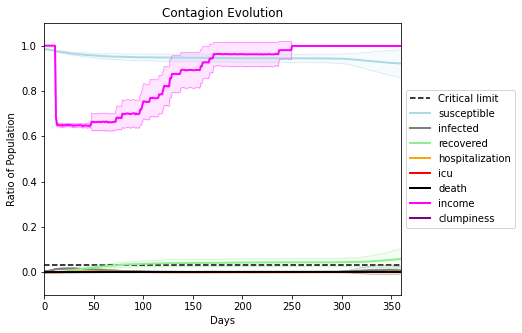

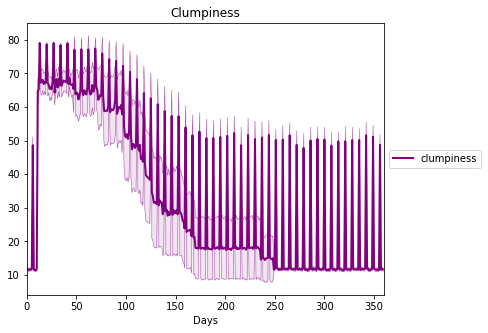

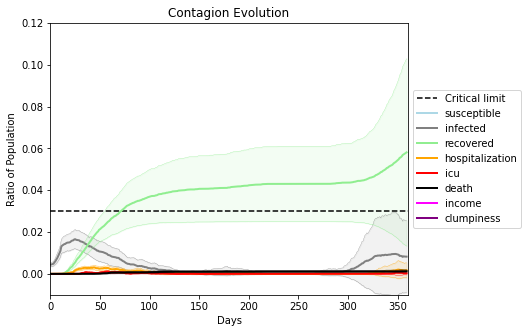

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.992", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[2258, 506, 5928, 8048, 9259, 6935, 3386, 9925, 1213, 2772, 7742, 6433, 9350, 4342, 5772, 845, 9640, 5065, 1409, 3019]
Average similarity between family members is 0.9792784205827456 at temperature -0.991
Average similarity between family and home is 0.9998943042683612 at temperature -1
Average similarity between students and their classroom is 0.42163009248302874 at temperature -0.991
Average classroom occupancy is 12 and number classrooms is 24
Average similarity between workers is 0.8755547631703808 at temperature -0.991
Average office occupancy is 9.924242424242424 and number offices is 66
Average friend similarity for adults: 0.9436495725291533 for kids: 0.6633031931198029
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuil

avg restaurant similarity 0.42648661247605935
disconnects
0.01
clumpiness 11.32
avg restaurant similarity 0.5799434405384417
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.4105710574269806
disconnects
0.01
clumpiness 12.23
avg restaurant similarity 0.2853512368417443
disconnects
0.01
clumpiness 11.23
avg restaurant similarity 0.41013304348408125
disconnects
0.02
clumpiness 11.43
avg restaurant similarity 0.5154595118047678
disconnects
0.03
clumpiness 12.56
avg restaurant similarity 0.6132132230651622
disconnects
0.52
clumpiness 48.93
avg restaurant similarity 0.3961390966659564
disconnects
0.01
clumpiness 11.48
avg restaurant similarity 0.4416636511173709
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.5353194713579961
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.45054555571507343
disconnects
0.01
clumpiness 11.91
avg restaurant similarity 0.35464656263728733
disconnects
0.68
clumpiness 59.66
avg restaurant similarity 0.3442100132711839
disconn

avg restaurant similarity 0.5293988828418533
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.37146839726967595
disconnects
0.76
clumpiness 64.41
avg restaurant similarity 0.5026341096887994
disconnects
0.75
clumpiness 63.79
avg restaurant similarity 0.509347783400526
disconnects
0.61
clumpiness 57.34
avg restaurant similarity 0.3164770467832451
disconnects
0.69
clumpiness 60.03
avg restaurant similarity 0.37477904251941063
disconnects
0.84
clumpiness 69.75
avg restaurant similarity 0.37762917207046465
disconnects
0.64
clumpiness 57.99
avg restaurant similarity 0.38665159739562815
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.5688519326231816
disconnects
0.67
clumpiness 60.8
avg restaurant similarity 0.3717488190053063
disconnects
0.75
clumpiness 63.33
avg restaurant similarity 0.316797579555038
disconnects
0.77
clumpiness 67.22
avg restaurant similarity 0.4940239913469092
disconnects
0.83
clumpiness 68.32
avg restaurant similarity 0.6700185605558701
discon

avg restaurant similarity 0.4631901398253566
disconnects
0.8
clumpiness 67.25
avg restaurant similarity 0.37877456292419237
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.5022385994475345
disconnects
0.64
clumpiness 57.81
avg restaurant similarity 0.4492564795683605
disconnects
0.77
clumpiness 65.51
avg restaurant similarity 0.4328343831636276
disconnects
0.86
clumpiness 71.24
avg restaurant similarity 0.3978793406584053
disconnects
0.69
clumpiness 62.0
avg restaurant similarity 0.41246864175733
disconnects
0.65
clumpiness 58.33
avg restaurant similarity 0.43584465052372695
disconnects
0.7
clumpiness 61.16
avg restaurant similarity 0.4289022481424726
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3767652348364749
disconnects
0.78
clumpiness 66.54
avg restaurant similarity 0.47625386973136785
disconnects
0.75
clumpiness 64.44
avg restaurant similarity 0.4429872602816307
disconnects
0.8
clumpiness 67.09
avg restaurant similarity 0.4043870225003327
disconnects


avg restaurant similarity 0.3341654320299062
disconnects
0.04
clumpiness 13.61
avg restaurant similarity 0.3436504327079702
disconnects
0.01
clumpiness 11.42
avg restaurant similarity 0.3452051203239733
disconnects
0.53
clumpiness 49.81
avg restaurant similarity 0.4915340409359786
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.5701582784676748
disconnects
0.02
clumpiness 12.17
avg restaurant similarity 0.387717988964711
disconnects
0.0
clumpiness 11.73
avg restaurant similarity 0.3763109978493237
disconnects
0.02
clumpiness 12.56
avg restaurant similarity 0.3666495700495569
disconnects
0.01
clumpiness 11.91
avg restaurant similarity 0.6272580130108255
disconnects
0.01
clumpiness 11.66
avg restaurant similarity 0.5169924803780325
disconnects
0.55
clumpiness 50.93
avg restaurant similarity 0.406528292306306
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.44000797441348527
disconnects
0.01
clumpiness 11.82
avg restaurant similarity 0.3768500578641817
disconnects

avg restaurant similarity 0.42791064385939637
disconnects
0.02
clumpiness 12.6
avg restaurant similarity 0.46139924042974
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.45698690023102706
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.4200688771977989
disconnects
0.01
clumpiness 11.57
avg restaurant similarity 0.2938528664841339
disconnects
0.01
clumpiness 11.38
avg restaurant similarity 0.5877909813745054
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.5269971498794125
disconnects
0.48
clumpiness 45.77
avg restaurant similarity 0.4759850466033481
disconnects
0.01
clumpiness 12.18
avg restaurant similarity 0.5233666984884597
disconnects
0.0
clumpiness 11.49
avg restaurant similarity 0.40447272478185664
disconnects
0.0
clumpiness 11.56
avg restaurant similarity 0.6035134887873083
disconnects
0.0
clumpiness 11.52
avg restaurant similarity 0.33004089362258837
disconnects
0.69
clumpiness 60.33
avg restaurant similarity 0.5083002356334106
disconnects


avg restaurant similarity 0.41353747995682366
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.3530759482674086
disconnects
0.68
clumpiness 59.84
avg restaurant similarity 0.49642534104724745
disconnects
0.86
clumpiness 70.75
avg restaurant similarity 0.3747457235657457
disconnects
0.87
clumpiness 70.96
avg restaurant similarity 0.5517954782300563
disconnects
0.74
clumpiness 63.38
avg restaurant similarity 0.38793021783373527
disconnects
0.0
clumpiness 10.56
avg restaurant similarity 0.3255907572163499
disconnects
0.01
clumpiness 12.02
avg restaurant similarity 0.5250392674955867
disconnects
0.45
clumpiness 43.47
avg restaurant similarity 0.5667864693353014
disconnects
0.01
clumpiness 11.25
avg restaurant similarity 0.22183991513026322
disconnects
0.0
clumpiness 11.0
avg restaurant similarity 0.3854565692569825
disconnects
0.01
clumpiness 11.92
avg restaurant similarity 0.37008002089135394
disconnects
0.02
clumpiness 11.9
avg restaurant similarity 0.42198897365480514
disco

disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.3739872220354328
disconnects
0.44
clumpiness 43.65
avg restaurant similarity 0.4607378089722984
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.4185197993164547
disconnects
0.01
clumpiness 12.6
avg restaurant similarity 0.4174520976713844
disconnects
0.0
clumpiness 11.49
avg restaurant similarity 0.478122259390998
disconnects
0.01
clumpiness 11.95
avg restaurant similarity 0.5143047580253693
disconnects
0.01
clumpiness 11.66
avg restaurant similarity 0.41621692830721385
disconnects
0.02
clumpiness 12.64
avg restaurant similarity 0.40345387156235224
disconnects
0.48
clumpiness 45.69
avg restaurant similarity 0.45327908992661714
disconnects
0.01
clumpiness 11.63
avg restaurant similarity 0.2818587501050681
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.38857682576391084
disconnects
0.0
clumpiness 11.16
avg restaurant similarity 0.3156966985763842
disconnects
0.01
clumpiness 11.69
avg restaurant simila

avg restaurant similarity 0.3476077791715755
disconnects
0.02
clumpiness 12.87
avg restaurant similarity 0.383573832584628
disconnects
0.53
clumpiness 49.08
avg restaurant similarity 0.2421502763713796
disconnects
0.0
clumpiness 11.58
avg restaurant similarity 0.35501709460365316
disconnects
0.0
clumpiness 11.4
avg restaurant similarity 0.36333345380099547
disconnects
0.02
clumpiness 12.49
avg restaurant similarity 0.4304932318017284
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.46092393482789257
disconnects
0.01
clumpiness 12.24
avg restaurant similarity 0.38113959816057
disconnects
0.03
clumpiness 13.61
avg restaurant similarity 0.28394825561518855
disconnects
0.64
clumpiness 55.61
avg restaurant similarity 0.3060494262840036
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.47135416793653073
disconnects
0.02
clumpiness 12.86
avg restaurant similarity 0.40841875911510117
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.43164290759554175
disconnec

avg restaurant similarity 0.3740434437950168
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.4231601895640512
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.46373236693341147
disconnects
0.0
clumpiness 11.8
avg restaurant similarity 0.3400368710657282
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.4503460545628652
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.5171199552572687
disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.43866110925388835
disconnects
0.44
clumpiness 43.12
avg restaurant similarity 0.43781956772695374
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.32793378472844636
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.47875334861198554
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.4564597698887508
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.5353463743680196
disconnects
0.73
clumpiness 64.08
avg restaurant similarity 0.36494626015767495
disconnects


avg restaurant similarity 0.4416179315196131
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.4794122407851431
disconnects
0.71
clumpiness 62.27
avg restaurant similarity 0.35102351175622987
disconnects
0.61
clumpiness 55.44
avg restaurant similarity 0.4879133115944535
disconnects
0.71
clumpiness 62.52
avg restaurant similarity 0.46913250132266004
disconnects
0.94
clumpiness 76.08
avg restaurant similarity 0.5241861392923908
disconnects
0.56
clumpiness 54.01
avg restaurant similarity 0.3726024947017653
disconnects
0.84
clumpiness 69.45
avg restaurant similarity 0.44954927714616266
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.38177601955531354
disconnects
0.75
clumpiness 63.65
avg restaurant similarity 0.49952769282734344
disconnects
0.88
clumpiness 72.31
avg restaurant similarity 0.4462935141470552
disconnects
0.7
clumpiness 61.16
avg restaurant similarity 0.40409077311548686
disconnects
0.67
clumpiness 60.49
avg restaurant similarity 0.29706665289430895
d

disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.3220383356465193
disconnects
0.6
clumpiness 52.83
avg restaurant similarity 0.4005262175297155
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.35253331169085667
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.38122737082178965
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.29338721283285873
disconnects
0.0
clumpiness 10.34
avg restaurant similarity 0.3755203920049434
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.49168062275255253
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.3821890126955547
disconnects
0.37
clumpiness 38.68
avg restaurant similarity 0.47721177215683075
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.3941576536701439
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.5217857391907821
disconnects
0.0
clumpiness 11.59
avg restaurant similarity 0.38211805745876337
disconnects
0.0
clumpiness 10.82
avg restaurant similarit

disconnects
0.0
clumpiness 10.42
avg restaurant similarity 0.4391561549184824
disconnects
0.49
clumpiness 47.39
avg restaurant similarity 0.5128992001356744
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.32580584898135656
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.5117546720185038
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.47407486345006966
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.35868688504280366
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.3935225108620776
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.31838810908629855
disconnects
0.53
clumpiness 49.84
avg restaurant similarity 0.4555345141647809
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.40322237529390664
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.37567002776385294
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.49154783664646495
disconnects
0.0
clumpiness 10.69
avg restaurant similar

avg restaurant similarity 0.47839876484616994
disconnects
0.03
clumpiness 12.74
avg restaurant similarity 0.4119392864586986
disconnects
0.01
clumpiness 10.66
avg restaurant similarity 0.28991826635165224
disconnects
0.01
clumpiness 11.85
avg restaurant similarity 0.506502502638254
disconnects
0.02
clumpiness 12.58
avg restaurant similarity 0.2756746970851874
disconnects
0.01
clumpiness 11.37
avg restaurant similarity 0.2870223596145537
disconnects
0.01
clumpiness 11.28
avg restaurant similarity 0.3225718744568898
disconnects
0.53
clumpiness 48.85
avg restaurant similarity 0.31090521841473506
disconnects
0.01
clumpiness 11.62
avg restaurant similarity 0.266050423752286
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.4783209835286055
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.42559828960656865
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.3408304499805986
disconnects
0.79
clumpiness 65.97
avg restaurant similarity 0.41467866729497593
disconn

avg restaurant similarity 0.4277802113610521
disconnects
0.53
clumpiness 49.63
avg restaurant similarity 0.2513261012217975
disconnects
0.02
clumpiness 12.11
avg restaurant similarity 0.22503224147003595
disconnects
0.01
clumpiness 11.8
avg restaurant similarity 0.36102620255744855
disconnects
0.01
clumpiness 11.3
avg restaurant similarity 0.40729069137236146
disconnects
0.01
clumpiness 11.09
avg restaurant similarity 0.41729378877315265
disconnects
0.01
clumpiness 11.57
avg restaurant similarity 0.42387283939037523
disconnects
0.0
clumpiness 10.44
avg restaurant similarity 0.5834030827044293
disconnects
0.68
clumpiness 58.97
avg restaurant similarity 0.3494697828448967
disconnects
0.03
clumpiness 13.21
avg restaurant similarity 0.351110091199175
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.40569007418813735
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.3419129439005727
disconnects
0.03
clumpiness 12.68
avg restaurant similarity 0.5197328085446463
disconn

avg restaurant similarity 0.33447233775732443
disconnects
0.01
clumpiness 12.15
avg restaurant similarity 0.442132238136706
disconnects
0.5
clumpiness 47.94
avg restaurant similarity 0.4189778777528106
disconnects
0.02
clumpiness 12.27
avg restaurant similarity 0.5182789408921737
disconnects
0.02
clumpiness 12.28
avg restaurant similarity 0.2577186018389629
disconnects
0.01
clumpiness 12.15
avg restaurant similarity 0.3171434856238789
disconnects
0.01
clumpiness 11.45
avg restaurant similarity 0.2639634050735166
disconnects
0.02
clumpiness 12.72
avg restaurant similarity 0.45295725080915855
disconnects
0.01
clumpiness 11.73
avg restaurant similarity 0.2564539096054419
disconnects
0.49
clumpiness 46.73
avg restaurant similarity 0.3423382546898043
disconnects
0.01
clumpiness 12.17
avg restaurant similarity 0.24660853678306563
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.2667128542459813
disconnects
0.01
clumpiness 11.68
avg restaurant similarity 0.34209945579235024
discon

avg restaurant similarity 0.5496026115971379
disconnects
0.01
clumpiness 11.59
avg restaurant similarity 0.3764129275469955
disconnects
0.01
clumpiness 11.39
avg restaurant similarity 0.4340467117868081
disconnects
0.48
clumpiness 47.92
avg restaurant similarity 0.3741302673059653
disconnects
0.02
clumpiness 12.22
avg restaurant similarity 0.508152401548329
disconnects
0.02
clumpiness 12.24
avg restaurant similarity 0.5752090569894919
disconnects
0.02
clumpiness 12.46
avg restaurant similarity 0.34021106914379656
disconnects
0.01
clumpiness 11.98
avg restaurant similarity 0.3483520768252523
disconnects
0.03
clumpiness 12.89
avg restaurant similarity 0.5069570516855277
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.2504753212364815
disconnects
0.42
clumpiness 42.71
avg restaurant similarity 0.4847075664406593
disconnects
0.0
clumpiness 11.52
avg restaurant similarity 0.40609609389332946
disconnects
0.02
clumpiness 12.23
avg restaurant similarity 0.18972193548830477
disconn

avg restaurant similarity 0.3305761902497969
disconnects
0.02
clumpiness 11.6
avg restaurant similarity 0.3923942362774678
disconnects
0.0
clumpiness 10.7
avg restaurant similarity 0.4965768863495088
disconnects
0.01
clumpiness 11.31
avg restaurant similarity 0.3715276652818758
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.3118576238145371
disconnects
0.01
clumpiness 11.43
avg restaurant similarity 0.3447433264910526
disconnects
0.01
clumpiness 11.42
avg restaurant similarity 0.2715456692476682
disconnects
0.62
clumpiness 55.55
avg restaurant similarity 0.38004175447866667
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.4650837698826059
disconnects
0.01
clumpiness 11.23
avg restaurant similarity 0.42806142824289817
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.2663360703060604
disconnects
0.0
clumpiness 10.82
avg restaurant similarity 0.3990934822301106
disconnects
0.93
clumpiness 75.04
avg restaurant similarity 0.2605439425940096
disconnects


avg restaurant similarity 0.2950806777190558
disconnects
0.58
clumpiness 52.75
avg restaurant similarity 0.3376887502033237
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.42672825052095514
disconnects
0.01
clumpiness 11.42
avg restaurant similarity 0.33252462319440756
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.2512456340424407
disconnects
0.01
clumpiness 11.26
avg restaurant similarity 0.3400699790673547
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.3250399921455816
disconnects
0.0
clumpiness 10.31
avg restaurant similarity 0.4466540001059657
disconnects
0.56
clumpiness 51.7
avg restaurant similarity 0.42760383040649286
disconnects
0.01
clumpiness 11.42
avg restaurant similarity 0.6855272052167812
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.5524476095056855
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.2895475787506346
disconnects
0.0
clumpiness 10.56
avg restaurant similarity 0.303668068509366
disconnects
0

avg restaurant similarity 0.15739180499517805
disconnects
0.01
clumpiness 11.53
avg restaurant similarity 0.4629436783833785
disconnects
0.53
clumpiness 49.24
avg restaurant similarity 0.18176747080253994
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.23722391396497408
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.2703301570149122
disconnects
0.01
clumpiness 12.0
avg restaurant similarity 0.1687376610413193
disconnects
0.01
clumpiness 11.87
avg restaurant similarity 0.3291087361111941
disconnects
0.01
clumpiness 11.25
avg restaurant similarity 0.3433699518058163
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.5156288770566175
disconnects
0.58
clumpiness 52.64
avg restaurant similarity 0.3951265803666213
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.39588637928883386
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.42199176666387694
disconnects
0.01
clumpiness 11.29
avg restaurant similarity 0.3673261216657915
disconne

avg restaurant similarity 0.3973726247303616
disconnects
0.02
clumpiness 11.34
avg restaurant similarity 0.5207703503944706
disconnects
0.01
clumpiness 12.26
avg restaurant similarity 0.5164970097305459
disconnects
0.63
clumpiness 56.08
avg restaurant similarity 0.44503472683152734
disconnects
0.0
clumpiness 10.32
avg restaurant similarity 0.24760808209637536
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.3121935235151234
disconnects
0.01
clumpiness 11.5
avg restaurant similarity 0.2811212095786717
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.29275198075056685
disconnects
0.01
clumpiness 11.15
avg restaurant similarity 0.3742695035723678
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.4331879471462583
disconnects
0.54
clumpiness 51.72
avg restaurant similarity 0.35460651098276064
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.3740610141391938
disconnects
0.0
clumpiness 9.7
avg restaurant similarity 0.36749763973055166
disconnects

avg restaurant similarity 0.3686186011296217
disconnects
0.01
clumpiness 11.75
avg restaurant similarity 0.3509698554745878
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.5067886772204719
disconnects
0.01
clumpiness 11.67
avg restaurant similarity 0.4612078380340413
disconnects
0.0
clumpiness 10.74
avg restaurant similarity 0.28230189491093993
disconnects
0.01
clumpiness 11.49
avg restaurant similarity 0.24425457613934173
disconnects
0.02
clumpiness 12.49
avg restaurant similarity 0.4504739912707049
disconnects
0.58
clumpiness 52.47
avg restaurant similarity 0.3336060230484064
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.3753326871912638
disconnects
0.01
clumpiness 11.21
avg restaurant similarity 0.5224037947957051
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.5002766138829857
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.36548101796669047
disconnects
0.89
clumpiness 72.59
avg restaurant similarity 0.6015300432349314
disconnec

avg restaurant similarity 0.5862876456970513
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.49131031253161817
disconnects
0.82
clumpiness 68.26
avg restaurant similarity 0.5477440848923325
disconnects
0.92
clumpiness 74.65
avg restaurant similarity 0.35003565329514075
disconnects
0.95
clumpiness 76.4
avg restaurant similarity 0.43214756561488343
disconnects
0.6
clumpiness 54.02
avg restaurant similarity 0.4044187850617349
disconnects
0.8
clumpiness 66.57
avg restaurant similarity 0.4725097455008905
disconnects
0.76
clumpiness 64.21
avg restaurant similarity 0.4164829620023597
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.27921644504945353
disconnects
0.56
clumpiness 52.03
avg restaurant similarity 0.4219353060429847
disconnects
0.02
clumpiness 12.27
avg restaurant similarity 0.5354276350726707
disconnects
0.01
clumpiness 11.3
avg restaurant similarity 0.4505287259921466
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.46632286386184435
disconnect

disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.44527719034599517
disconnects
0.62
clumpiness 54.56
avg restaurant similarity 0.4256001969206258
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.5734808938952544
disconnects
0.02
clumpiness 12.0
avg restaurant similarity 0.46566200003028274
disconnects
0.01
clumpiness 11.76
avg restaurant similarity 0.46220140382017577
disconnects
0.01
clumpiness 11.85
avg restaurant similarity 0.4153298832636206
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.3849514992647167
disconnects
0.0
clumpiness 10.94
avg restaurant similarity 0.4838254562452086
disconnects
0.59
clumpiness 53.35
avg restaurant similarity 0.4087027031804449
disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.543085196100189
disconnects
0.01
clumpiness 11.47
avg restaurant similarity 0.3546741851285168
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.39214776620019015
disconnects
0.01
clumpiness 11.82
avg restaurant similari

avg restaurant similarity 0.38334630272826076
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.4786258956223119
disconnects
0.54
clumpiness 49.67
avg restaurant similarity 0.42061524184259463
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.5587657364989065
disconnects
0.01
clumpiness 11.68
avg restaurant similarity 0.5049899884977338
disconnects
0.01
clumpiness 11.68
avg restaurant similarity 0.5958400118080821
disconnects
0.01
clumpiness 11.84
avg restaurant similarity 0.5415799207922924
disconnects
0.04
clumpiness 14.25
avg restaurant similarity 0.5499922926694398
disconnects
0.01
clumpiness 11.87
avg restaurant similarity 0.5740278935725583
disconnects
0.55
clumpiness 50.41
avg restaurant similarity 0.49188220149865275
disconnects
0.01
clumpiness 11.95
avg restaurant similarity 0.49082538692319183
disconnects
0.02
clumpiness 12.49
avg restaurant similarity 0.47931693514230145
disconnects
0.01
clumpiness 11.46
avg restaurant similarity 0.5042965043462034
disc

avg restaurant similarity 0.3422111757683012
disconnects
0.02
clumpiness 11.8
avg restaurant similarity 0.29122544008876594
disconnects
0.01
clumpiness 10.55
avg restaurant similarity 0.36089480484031544
disconnects
0.02
clumpiness 12.03
avg restaurant similarity 0.31491042342524833
disconnects
0.01
clumpiness 10.79
avg restaurant similarity 0.42843505549498256
disconnects
0.03
clumpiness 12.21
avg restaurant similarity 0.31623127476380997
disconnects
0.01
clumpiness 11.18
avg restaurant similarity 0.30858659430834756
disconnects
0.42
clumpiness 42.03
avg restaurant similarity 0.37971878331920417
disconnects
0.03
clumpiness 11.94
avg restaurant similarity 0.4877641822557756
disconnects
0.02
clumpiness 11.92
avg restaurant similarity 0.5206463832274503
disconnects
0.02
clumpiness 12.15
avg restaurant similarity 0.2812838432254437
disconnects
0.02
clumpiness 11.23
avg restaurant similarity 0.3259826368594587
disconnects
0.63
clumpiness 56.18
avg restaurant similarity 0.4578832339119093
d

disconnects
0.03
clumpiness 12.46
avg restaurant similarity 0.520971102379343
disconnects
0.52
clumpiness 47.29
avg restaurant similarity 0.4222000541580583
disconnects
0.03
clumpiness 12.67
avg restaurant similarity 0.2934443124176027
disconnects
0.04
clumpiness 13.24
avg restaurant similarity 0.34418383586910956
disconnects
0.02
clumpiness 11.18
avg restaurant similarity 0.4744917527756376
disconnects
0.02
clumpiness 11.59
avg restaurant similarity 0.37443317892085176
disconnects
0.02
clumpiness 11.98
avg restaurant similarity 0.2763556935934059
disconnects
0.01
clumpiness 10.62
avg restaurant similarity 0.4174544260391435
disconnects
0.55
clumpiness 49.93
avg restaurant similarity 0.4219156598464285
disconnects
0.03
clumpiness 12.14
avg restaurant similarity 0.389709615067625
disconnects
0.01
clumpiness 11.63
avg restaurant similarity 0.39477628143346755
disconnects
0.0
clumpiness 10.18
avg restaurant similarity 0.2667869244557773
disconnects
0.02
clumpiness 12.2
avg restaurant simi

disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.43292523319853005
disconnects
0.0
clumpiness 10.31
avg restaurant similarity 0.3930743578856127
disconnects
0.49
clumpiness 45.64
avg restaurant similarity 0.44357665368286964
disconnects
0.03
clumpiness 12.74
avg restaurant similarity 0.5034477237375516
disconnects
0.04
clumpiness 12.93
avg restaurant similarity 0.4313624910830046
disconnects
0.02
clumpiness 11.85
avg restaurant similarity 0.3018419201838139
disconnects
0.03
clumpiness 12.32
avg restaurant similarity 0.47135473001761763
disconnects
0.02
clumpiness 11.49
avg restaurant similarity 0.31477375765935556
disconnects
0.01
clumpiness 11.13
avg restaurant similarity 0.3846423120055549
disconnects
0.51
clumpiness 47.14
avg restaurant similarity 0.4923217533837918
disconnects
0.01
clumpiness 11.47
avg restaurant similarity 0.36857005935762965
disconnects
0.01
clumpiness 10.85
avg restaurant similarity 0.35599973270790813
disconnects
0.04
clumpiness 12.89
avg restaurant

disconnects
0.03
clumpiness 11.95
avg restaurant similarity 0.3490226912059085
disconnects
0.03
clumpiness 12.22
avg restaurant similarity 0.3431508382999301
disconnects
0.04
clumpiness 13.17
avg restaurant similarity 0.371702373632483
disconnects
0.33
clumpiness 34.81
avg restaurant similarity 0.3615535274997122
disconnects
0.0
clumpiness 9.67
avg restaurant similarity 0.49005543789722034
disconnects
0.02
clumpiness 11.7
avg restaurant similarity 0.40307917097755797
disconnects
0.0
clumpiness 10.22
avg restaurant similarity 0.3268539066721254
disconnects
0.05
clumpiness 13.65
avg restaurant similarity 0.3685094989918851
disconnects
0.01
clumpiness 11.35
avg restaurant similarity 0.6078680356225702
disconnects
0.02
clumpiness 11.22
avg restaurant similarity 0.4824339685391239
disconnects
0.51
clumpiness 46.54
avg restaurant similarity 0.30013782393601246
disconnects
0.01
clumpiness 11.37
avg restaurant similarity 0.46241830182683874
disconnects
0.01
clumpiness 10.73
avg restaurant simi

avg restaurant similarity 0.40846282132584444
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.34562994919898826
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.5850332775429032
disconnects
0.01
clumpiness 11.09
avg restaurant similarity 0.3430502861041766
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.3920489399069643
disconnects
0.01
clumpiness 11.18
avg restaurant similarity 0.35787904599610343
disconnects
0.0
clumpiness 10.29
avg restaurant similarity 0.6027788903710383
disconnects
0.54
clumpiness 49.31
avg restaurant similarity 0.39697799347603263
disconnects
0.01
clumpiness 11.56
avg restaurant similarity 0.5242739850965656
disconnects
0.02
clumpiness 11.98
avg restaurant similarity 0.41296098361265193
disconnects
0.01
clumpiness 12.03
avg restaurant similarity 0.3651383649708222
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.421695855704687
disconnects
0.79
clumpiness 66.15
avg restaurant similarity 0.35065184963720764
disconn

avg restaurant similarity 0.3497540640149584
disconnects
0.98
clumpiness 78.47
avg restaurant similarity 0.6134606291688535
disconnects
0.65
clumpiness 58.55
avg restaurant similarity 0.4324727443004659
disconnects
0.9
clumpiness 73.27
avg restaurant similarity 0.5201354188545568
disconnects
0.83
clumpiness 68.36
avg restaurant similarity 0.47831614600011807
disconnects
0.6
clumpiness 54.9
avg restaurant similarity 0.4102562220848984
disconnects
0.62
clumpiness 57.66
avg restaurant similarity 0.5704759176220435
disconnects
0.72
clumpiness 62.55
avg restaurant similarity 0.4725560839415478
disconnects
0.93
clumpiness 74.98
avg restaurant similarity 0.4319067783584957
disconnects
0.71
clumpiness 61.3
avg restaurant similarity 0.5952140302166516
disconnects
0.8
clumpiness 66.74
avg restaurant similarity 0.4559809085118889
disconnects
0.83
clumpiness 68.47
avg restaurant similarity 0.5291086009092697
disconnects
0.83
clumpiness 68.6
avg restaurant similarity 0.4558616551899907
disconnects


avg restaurant similarity 0.44485802241996547
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.37104115698768797
disconnects
0.45
clumpiness 44.24
avg restaurant similarity 0.44911676424098057
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.4685369049003085
disconnects
0.02
clumpiness 12.24
avg restaurant similarity 0.4044019604368163
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.40481669593317304
disconnects
0.02
clumpiness 12.26
avg restaurant similarity 0.4213954322135736
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.39510572492748464
disconnects
0.01
clumpiness 11.45
avg restaurant similarity 0.5566750385978714
disconnects
0.52
clumpiness 49.34
avg restaurant similarity 0.3599190778004137
disconnects
0.01
clumpiness 11.11
avg restaurant similarity 0.39861575515850306
disconnects
0.01
clumpiness 11.78
avg restaurant similarity 0.4313671149527084
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.4532422452410555
discon

avg restaurant similarity 0.42805386600014494
disconnects
0.02
clumpiness 11.74
avg restaurant similarity 0.46701700210555874
disconnects
0.0
clumpiness 11.22
avg restaurant similarity 0.4892214922356184
disconnects
0.54
clumpiness 50.83
avg restaurant similarity 0.3873969921052628
disconnects
0.01
clumpiness 12.11
avg restaurant similarity 0.4066865790551342
disconnects
0.0
clumpiness 11.31
avg restaurant similarity 0.46102927264073407
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.4941463449321525
disconnects
0.01
clumpiness 11.67
avg restaurant similarity 0.4521207120695799
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.44978653113565387
disconnects
0.01
clumpiness 10.84
avg restaurant similarity 0.322361699125278
disconnects
0.53
clumpiness 48.89
avg restaurant similarity 0.4151593211926688
disconnects
0.01
clumpiness 11.7
avg restaurant similarity 0.5083418591930342
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.42720735834950996
disconnect

avg restaurant similarity 0.2629331876398765
disconnects
0.0
clumpiness 10.44
avg restaurant similarity 0.4059010042601306
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.5969029723246523
disconnects
0.0
clumpiness 11.43
avg restaurant similarity 0.4032610184152308
disconnects
0.0
clumpiness 11.03
avg restaurant similarity 0.2242860797201479
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.4947480079348656
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.48182943275204054
disconnects
0.48
clumpiness 45.0
avg restaurant similarity 0.3538645627374873
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.5737109254372859
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.4306941171627493
disconnects
0.0
clumpiness 11.04
avg restaurant similarity 0.4097947646585528
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.3384747068499155
disconnects
0.63
clumpiness 56.88
avg restaurant similarity 0.4785055795593058
disconnects
0.89


avg restaurant similarity 0.416990400673746
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.29781678266628747
disconnects
0.74
clumpiness 62.64
avg restaurant similarity 0.3117145816184727
disconnects
0.85
clumpiness 70.26
avg restaurant similarity 0.43976367796172877
disconnects
0.91
clumpiness 73.82
avg restaurant similarity 0.3493476524178178
disconnects
0.9
clumpiness 73.12
avg restaurant similarity 0.3231781278163472
disconnects
0.89
clumpiness 72.82
avg restaurant similarity 0.42867766995192597
disconnects
0.84
clumpiness 69.14
avg restaurant similarity 0.42994451921481086
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.2466895314772444
disconnects
0.83
clumpiness 69.71
avg restaurant similarity 0.5179292179329571
disconnects
0.86
clumpiness 70.93
avg restaurant similarity 0.4555876070296262
disconnects
0.87
clumpiness 71.18
avg restaurant similarity 0.5091993586440933
disconnects
0.88
clumpiness 71.82
avg restaurant similarity 0.5546877604859968
disconn

avg restaurant similarity 0.5164996532169863
disconnects
0.85
clumpiness 69.94
avg restaurant similarity 0.41372451250525655
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.4247074004043798
disconnects
0.84
clumpiness 69.31
avg restaurant similarity 0.42335855112592174
disconnects
0.83
clumpiness 69.07
avg restaurant similarity 0.4046832125879506
disconnects
0.8
clumpiness 66.71
avg restaurant similarity 0.530823820803911
disconnects
0.91
clumpiness 73.9
avg restaurant similarity 0.3144529426422224
disconnects
0.83
clumpiness 68.62
avg restaurant similarity 0.4388733920746967
disconnects
0.9
clumpiness 73.43
avg restaurant similarity 0.4468399052361088
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.4612090672940585
disconnects
0.9
clumpiness 73.1
avg restaurant similarity 0.2698103439999378
disconnects
0.88
clumpiness 71.69
avg restaurant similarity 0.6185268822682279
disconnects
0.86
clumpiness 70.57
avg restaurant similarity 0.26932245325410137
disconnect

avg restaurant similarity 0.5175030855041045
disconnects
0.0
clumpiness 11.27
avg restaurant similarity 0.46906822766492634
disconnects
0.58
clumpiness 52.47
avg restaurant similarity 0.40423207745141515
disconnects
0.0
clumpiness 10.29
avg restaurant similarity 0.4740886572874539
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.5094637518580752
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.43874723405245425
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.41586891615465055
disconnects
0.0
clumpiness 10.5
avg restaurant similarity 0.45747214530759345
disconnects
0.0
clumpiness 10.27
avg restaurant similarity 0.5613229509184549
disconnects
0.58
clumpiness 54.35
avg restaurant similarity 0.4611482457020228
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.4355682518691146
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.4506075848125864
disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.5455539347369797
disconnects
0.

avg restaurant similarity 0.3386379716528709
disconnects
0.01
clumpiness 12.2
avg restaurant similarity 0.5327810024047438
disconnects
0.01
clumpiness 11.66
avg restaurant similarity 0.357077738853642
disconnects
0.01
clumpiness 11.65
avg restaurant similarity 0.41369491089398935
disconnects
0.01
clumpiness 11.57
avg restaurant similarity 0.46180930529603814
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.5515031403950578
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.36920242402288334
disconnects
0.57
clumpiness 51.01
avg restaurant similarity 0.49206033134958993
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.5408842547998485
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.35801980894827923
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.3672689832873042
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.42189204093285954
disconnects
0.68
clumpiness 60.17
avg restaurant similarity 0.2916299835062298
disconnec

avg restaurant similarity 0.30052676732019756
disconnects
0.54
clumpiness 48.97
avg restaurant similarity 0.5100500864569838
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.28163879501400707
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.34909840256012
disconnects
0.01
clumpiness 11.56
avg restaurant similarity 0.46450055340844637
disconnects
0.0
clumpiness 11.2
avg restaurant similarity 0.3583537583720526
disconnects
0.0
clumpiness 11.03
avg restaurant similarity 0.33170874358815916
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.4182842466286424
disconnects
0.44
clumpiness 45.81
avg restaurant similarity 0.2885414103912289
disconnects
0.01
clumpiness 11.33
avg restaurant similarity 0.36334319947071836
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.4828336395601187
disconnects
0.0
clumpiness 10.53
avg restaurant similarity 0.42826202367938737
disconnects
0.0
clumpiness 11.04
avg restaurant similarity 0.4865198125757376
disconnects


disconnects
0.01
clumpiness 11.54
avg restaurant similarity 0.34041830699905795
disconnects
0.55
clumpiness 49.65
avg restaurant similarity 0.32801723411563666
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.24597694045230256
disconnects
0.01
clumpiness 11.85
avg restaurant similarity 0.3737896532204093
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.3965209131429506
disconnects
0.0
clumpiness 11.65
avg restaurant similarity 0.49549190912115776
disconnects
0.02
clumpiness 12.51
avg restaurant similarity 0.5657387866713501
disconnects
0.01
clumpiness 12.19
avg restaurant similarity 0.3987785756153215
disconnects
0.49
clumpiness 47.17
avg restaurant similarity 0.3781216025501809
disconnects
0.01
clumpiness 11.74
avg restaurant similarity 0.4315276862963053
disconnects
0.01
clumpiness 10.69
avg restaurant similarity 0.2977489746103716
disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.26923679416733726
disconnects
0.0
clumpiness 10.71
avg restaurant sim

avg restaurant similarity 0.350997781858175
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.3940137534510386
disconnects
0.5
clumpiness 46.81
avg restaurant similarity 0.3426440000351199
disconnects
0.01
clumpiness 11.41
avg restaurant similarity 0.38498240592868077
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.28394522986565895
disconnects
0.0
clumpiness 10.24
avg restaurant similarity 0.3299644788139249
disconnects
0.01
clumpiness 11.13
avg restaurant similarity 0.4617585295001485
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.4302981082823575
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.48297315608122143
disconnects
0.54
clumpiness 50.47
avg restaurant similarity 0.36889056049537094
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.4634440756605571
disconnects
0.03
clumpiness 13.14
avg restaurant similarity 0.2809279761269142
disconnects
0.02
clumpiness 12.55
avg restaurant similarity 0.2665860068589755
disconnects

avg restaurant similarity 0.5296205440282953
disconnects
0.02
clumpiness 11.77
avg restaurant similarity 0.4843551948907259
disconnects
0.02
clumpiness 12.53
avg restaurant similarity 0.3864206406840965
disconnects
0.01
clumpiness 11.83
avg restaurant similarity 0.3959861365577045
disconnects
0.01
clumpiness 11.32
avg restaurant similarity 0.39527508737740663
disconnects
0.02
clumpiness 12.32
avg restaurant similarity 0.46998713542250525
disconnects
0.03
clumpiness 12.67
avg restaurant similarity 0.41493193239089277
disconnects
0.51
clumpiness 49.01
avg restaurant similarity 0.40297153134539776
disconnects
0.02
clumpiness 12.14
avg restaurant similarity 0.4644339571343274
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.4284754104770573
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.5613662193472077
disconnects
0.02
clumpiness 12.14
avg restaurant similarity 0.378887191582276
disconnects
0.61
clumpiness 56.35
avg restaurant similarity 0.3775833034869059
discon

avg restaurant similarity 0.5545964156923321
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.37925770149170407
disconnects
0.58
clumpiness 55.31
avg restaurant similarity 0.4884770338343465
disconnects
0.71
clumpiness 61.43
avg restaurant similarity 0.47596336037148135
disconnects
0.88
clumpiness 72.71
avg restaurant similarity 0.5608646966359525
disconnects
0.91
clumpiness 74.02
avg restaurant similarity 0.4233607213443645
disconnects
0.71
clumpiness 62.14
avg restaurant similarity 0.42300137486850725
disconnects
0.87
clumpiness 71.45
avg restaurant similarity 0.5550966993030291
disconnects
0.96
clumpiness 76.98
avg restaurant similarity 0.5495306701103488
disconnects
0.83
clumpiness 69.58
avg restaurant similarity 0.4988737510983197
disconnects
0.81
clumpiness 67.16
avg restaurant similarity 0.457918864487819
disconnects
0.77
clumpiness 65.91
avg restaurant similarity 0.4344596016523213
disconnects
0.73
clumpiness 64.1
avg restaurant similarity 0.5115672730560039
disconne

avg restaurant similarity 0.40918563307723815
disconnects
0.03
clumpiness 12.95
avg restaurant similarity 0.3995175665756388
disconnects
0.51
clumpiness 49.63
avg restaurant similarity 0.30783142542630987
disconnects
0.02
clumpiness 12.02
avg restaurant similarity 0.4400584525567434
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.3956041559157584
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.6338350441072301
disconnects
0.02
clumpiness 12.54
avg restaurant similarity 0.40776331456075476
disconnects
0.04
clumpiness 13.96
avg restaurant similarity 0.3623276406951718
disconnects
0.02
clumpiness 12.17
avg restaurant similarity 0.643734323354303
disconnects
0.67
clumpiness 57.11
avg restaurant similarity 0.5997845054316945
disconnects
0.03
clumpiness 13.03
avg restaurant similarity 0.4023580851450312
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.4604292359525872
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.4376913409930558
disconnec

avg restaurant similarity 0.3622128926793749
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.5443743507025463
disconnects
0.02
clumpiness 12.2
avg restaurant similarity 0.3493974210224393
disconnects
0.51
clumpiness 47.9
avg restaurant similarity 0.5844065764601344
disconnects
0.02
clumpiness 12.29
avg restaurant similarity 0.4756700804099743
disconnects
0.05
clumpiness 14.66
avg restaurant similarity 0.47478100730292266
disconnects
0.03
clumpiness 13.01
avg restaurant similarity 0.5195936567475579
disconnects
0.04
clumpiness 13.41
avg restaurant similarity 0.5424839938096924
disconnects
0.05
clumpiness 13.89
avg restaurant similarity 0.42569877100791004
disconnects
0.04
clumpiness 13.65
avg restaurant similarity 0.43614622985219353
disconnects
0.52
clumpiness 48.05
avg restaurant similarity 0.36904952566199706
disconnects
0.01
clumpiness 12.48
avg restaurant similarity 0.38944951452080057
disconnects
0.04
clumpiness 13.69
avg restaurant similarity 0.46623303255121556
disc

avg restaurant similarity 0.5000920675968231
disconnects
0.0
clumpiness 11.26
avg restaurant similarity 0.5069018540845766
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.3705983309836625
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.5046294044143228
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.4748745533425766
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.42465474642347234
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.3728567965268055
disconnects
0.54
clumpiness 49.29
avg restaurant similarity 0.472682156230908
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.5260521728781491
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.4100344636791883
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.49558880917598674
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.43945654677723894
disconnects
0.73
clumpiness 63.28
avg restaurant similarity 0.49382950705466455
disconnects
0.6

avg restaurant similarity 0.46225860597625823
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.4544230704799057
disconnects
0.7
clumpiness 61.07
avg restaurant similarity 0.41526766505218504
disconnects
0.7
clumpiness 61.27
avg restaurant similarity 0.5230585612626679
disconnects
0.79
clumpiness 65.66
avg restaurant similarity 0.3832319243666414
disconnects
0.46
clumpiness 45.77
avg restaurant similarity 0.41550566791618293
disconnects
0.63
clumpiness 56.94
avg restaurant similarity 0.37559715777393593
disconnects
0.73
clumpiness 62.74
avg restaurant similarity 0.5954015365199219
disconnects
0.98
clumpiness 78.46
avg restaurant similarity 0.5570439622517047
disconnects
0.78
clumpiness 65.49
avg restaurant similarity 0.4678582172022971
disconnects
0.73
clumpiness 62.81
avg restaurant similarity 0.5713555233640233
disconnects
0.66
clumpiness 57.42
avg restaurant similarity 0.5764702259508907
disconnects
0.8
clumpiness 66.5
avg restaurant similarity 0.4978777242841455
disconn

avg restaurant similarity 0.4280470210563745
disconnects
0.51
clumpiness 50.41
avg restaurant similarity 0.4845420279509137
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5135724193735933
disconnects
0.73
clumpiness 64.15
avg restaurant similarity 0.4960730105396901
disconnects
0.69
clumpiness 60.55
avg restaurant similarity 0.4407130921876885
disconnects
0.82
clumpiness 67.88
avg restaurant similarity 0.38604855949742484
disconnects
0.62
clumpiness 55.92
avg restaurant similarity 0.5314459061195613
disconnects
0.65
clumpiness 58.33
avg restaurant similarity 0.45128002400272643
disconnects
0.55
clumpiness 52.58
avg restaurant similarity 0.4207579795074719
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.487646261583648
disconnects
0.66
clumpiness 59.0
avg restaurant similarity 0.4497523020234095
disconnects
0.78
clumpiness 65.54
avg restaurant similarity 0.413011164895249
disconnects
0.6
clumpiness 54.45
avg restaurant similarity 0.5529696153230159
disconnects

disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.3421600105199534
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.4008458148039494
disconnects
0.41
clumpiness 42.36
avg restaurant similarity 0.4697823268507182
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.519987688856566
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.5124003051546056
disconnects
0.0
clumpiness 11.42
avg restaurant similarity 0.5557796472807149
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.46181561529393256
disconnects
0.0
clumpiness 10.7
avg restaurant similarity 0.45943055230258983
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.5407486401773127
disconnects
0.46
clumpiness 44.06
avg restaurant similarity 0.4543550735253917
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.49749365119396555
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.5185044523739722
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.

avg restaurant similarity 0.4010129784505293
disconnects
0.01
clumpiness 11.54
avg restaurant similarity 0.49821798452109634
disconnects
0.0
clumpiness 10.26
avg restaurant similarity 0.47399254308152566
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.4167697624745928
disconnects
0.01
clumpiness 10.85
avg restaurant similarity 0.6061043619489348
disconnects
0.02
clumpiness 12.2
avg restaurant similarity 0.503772936801453
disconnects
0.01
clumpiness 10.88
avg restaurant similarity 0.390913111469972
disconnects
0.39
clumpiness 40.31
avg restaurant similarity 0.6316795916197019
disconnects
0.02
clumpiness 12.28
avg restaurant similarity 0.6053377529467879
disconnects
0.0
clumpiness 10.03
avg restaurant similarity 0.5891429872710421
disconnects
0.0
clumpiness 10.17
avg restaurant similarity 0.6530408742656859
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.5958228475973019
disconnects
0.76
clumpiness 64.66
avg restaurant similarity 0.5307020192498296
disconnects
0

avg restaurant similarity 0.576953006278716
disconnects
0.92
clumpiness 74.27
avg restaurant similarity 0.8005075319392301
disconnects
0.93
clumpiness 75.57
avg restaurant similarity 0.3732662880171289
disconnects
0.94
clumpiness 75.85
avg restaurant similarity 0.5488501669887834
disconnects
0.92
clumpiness 74.52
avg restaurant similarity 0.5335859361135376
disconnects
0.96
clumpiness 77.31
avg restaurant similarity 0.6668058236624177
disconnects
0.0
clumpiness 10.21
avg restaurant similarity 0.6100895413129844
disconnects
0.4
clumpiness 41.35
avg restaurant similarity 0.4806862281614409
disconnects
0.01
clumpiness 11.68
avg restaurant similarity 0.5497055531727755
disconnects
0.01
clumpiness 11.1
avg restaurant similarity 0.6717020599746943
disconnects
0.02
clumpiness 11.67
avg restaurant similarity 0.7380819033598288
disconnects
0.01
clumpiness 11.37
avg restaurant similarity 0.5541029928711347
disconnects
0.02
clumpiness 12.25
avg restaurant similarity 0.4384618808344582
disconnects

disconnects
0.42
clumpiness 41.4
avg restaurant similarity 0.6258936305406557
disconnects
0.02
clumpiness 11.83
avg restaurant similarity 0.5469406991911826
disconnects
0.02
clumpiness 12.27
avg restaurant similarity 0.6654602117888846
disconnects
0.0
clumpiness 11.0
avg restaurant similarity 0.6856964763358905
disconnects
0.0
clumpiness 10.94
avg restaurant similarity 0.5732799050491325
disconnects
0.02
clumpiness 11.77
avg restaurant similarity 0.5340235020436265
disconnects
0.0
clumpiness 10.26
avg restaurant similarity 0.3625667615984494
disconnects
0.35
clumpiness 36.69
avg restaurant similarity 0.4972787583550421
disconnects
0.01
clumpiness 11.76
avg restaurant similarity 0.6189994056664284
disconnects
0.05
clumpiness 13.44
avg restaurant similarity 0.41448752665977023
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.6813141074927703
disconnects
0.01
clumpiness 11.66
avg restaurant similarity 0.4670725639405113
disconnects
0.01
clumpiness 11.49
avg restaurant similari

avg restaurant similarity 0.5286771489631918
disconnects
0.39
clumpiness 39.08
avg restaurant similarity 0.740023174007459
disconnects
0.01
clumpiness 11.61
avg restaurant similarity 0.3301479144677836
disconnects
0.02
clumpiness 12.11
avg restaurant similarity 0.5810438706380436
disconnects
0.02
clumpiness 11.78
avg restaurant similarity 0.6590429679988953
disconnects
0.02
clumpiness 12.1
avg restaurant similarity 0.7902378389367132
disconnects
0.02
clumpiness 12.41
avg restaurant similarity 0.45183624580541565
disconnects
0.04
clumpiness 13.33
avg restaurant similarity 0.4455987200330276
disconnects
0.35
clumpiness 36.7
avg restaurant similarity 0.41453082095014854
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.3782386532580202
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.44150239644917283
disconnects
0.02
clumpiness 11.68
avg restaurant similarity 0.4721311473920336
disconnects
0.01
clumpiness 11.81
avg restaurant similarity 0.5170704507747715
disconnec

avg restaurant similarity 0.47940317494696316
disconnects
0.01
clumpiness 11.41
avg restaurant similarity 0.439991230603137
disconnects
0.02
clumpiness 12.15
avg restaurant similarity 0.2905345312050054
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.23812066411285548
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.34419599448581517
disconnects
0.0
clumpiness 11.68
avg restaurant similarity 0.43246692837390166
disconnects
0.01
clumpiness 11.01
avg restaurant similarity 0.3909052497949839
disconnects
0.37
clumpiness 38.77
avg restaurant similarity 0.3178242213752161
disconnects
0.02
clumpiness 12.14
avg restaurant similarity 0.34486328017441836
disconnects
0.02
clumpiness 12.62
avg restaurant similarity 0.3863856407706249
disconnects
0.02
clumpiness 12.37
avg restaurant similarity 0.3248971563422499
disconnects
0.03
clumpiness 12.57
avg restaurant similarity 0.5337786546379416
disconnects
0.67
clumpiness 59.15
avg restaurant similarity 0.37387690336147034
disco

avg restaurant similarity 0.41632784931526273
disconnects
0.99
clumpiness 79.35
avg restaurant similarity 0.46877220977862893
disconnects
0.71
clumpiness 60.87
avg restaurant similarity 0.4162430682073142
disconnects
0.86
clumpiness 70.49
avg restaurant similarity 0.41558631612065006
disconnects
0.77
clumpiness 65.49
avg restaurant similarity 0.3662065676842583
disconnects
0.81
clumpiness 66.96
avg restaurant similarity 0.2559361674776518
disconnects
0.8
clumpiness 66.84
avg restaurant similarity 0.36288060254514176
disconnects
0.6
clumpiness 55.02
avg restaurant similarity 0.275907097104014
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3382915154280391
disconnects
0.71
clumpiness 60.13
avg restaurant similarity 0.45805873602392094
disconnects
0.72
clumpiness 62.58
avg restaurant similarity 0.4325657874955545
disconnects
0.61
clumpiness 55.41
avg restaurant similarity 0.3927219652273147
disconnects
0.82
clumpiness 68.25
avg restaurant similarity 0.4704755574043948
disconn

avg restaurant similarity 0.4641022390169518
disconnects
0.02
clumpiness 11.96
avg restaurant similarity 0.32314230857890924
disconnects
0.33
clumpiness 35.64
avg restaurant similarity 0.3733784936799533
disconnects
0.01
clumpiness 11.45
avg restaurant similarity 0.4389989305683309
disconnects
0.04
clumpiness 13.5
avg restaurant similarity 0.3188759324269488
disconnects
0.02
clumpiness 12.14
avg restaurant similarity 0.3836093451331566
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.46886171136177135
disconnects
0.01
clumpiness 11.51
avg restaurant similarity 0.47854988782863905
disconnects
0.0
clumpiness 10.82
avg restaurant similarity 0.34638826666831485
disconnects
0.36
clumpiness 37.44
avg restaurant similarity 0.37632976703947396
disconnects
0.02
clumpiness 12.34
avg restaurant similarity 0.4907897227196663
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.38176092110217796
disconnects
0.02
clumpiness 12.89
avg restaurant similarity 0.43059044077808617
disc

avg restaurant similarity 0.4588128923280885
disconnects
0.0
clumpiness 11.28
avg restaurant similarity 0.348220249728207
disconnects
0.01
clumpiness 11.25
avg restaurant similarity 0.3376324374196362
disconnects
0.42
clumpiness 41.8
avg restaurant similarity 0.31853226040986726
disconnects
0.02
clumpiness 11.53
avg restaurant similarity 0.5175500995950774
disconnects
0.03
clumpiness 12.6
avg restaurant similarity 0.4050089350297802
disconnects
0.04
clumpiness 13.16
avg restaurant similarity 0.39748721286100575
disconnects
0.01
clumpiness 11.49
avg restaurant similarity 0.4244923008357933
disconnects
0.02
clumpiness 12.12
avg restaurant similarity 0.2899931144370897
disconnects
0.01
clumpiness 11.35
avg restaurant similarity 0.3075255414214129
disconnects
0.36
clumpiness 38.61
avg restaurant similarity 0.5183727647265468
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.42734295282952156
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.38017285970486053
disconnec

avg restaurant similarity 0.38160069318929285
disconnects
0.01
clumpiness 11.36
avg restaurant similarity 0.4410525833382252
disconnects
0.01
clumpiness 12.21
avg restaurant similarity 0.4362845078334076
disconnects
0.0
clumpiness 10.7
avg restaurant similarity 0.31770686202064363
disconnects
0.01
clumpiness 11.6
avg restaurant similarity 0.31340122978277163
disconnects
0.02
clumpiness 12.6
avg restaurant similarity 0.4844267648574566
disconnects
0.02
clumpiness 13.14
avg restaurant similarity 0.39751378687239586
disconnects
0.51
clumpiness 47.59
avg restaurant similarity 0.4048992203388965
disconnects
0.01
clumpiness 11.35
avg restaurant similarity 0.4824785731218531
disconnects
0.01
clumpiness 11.58
avg restaurant similarity 0.37475934427243923
disconnects
0.01
clumpiness 12.7
avg restaurant similarity 0.4139944394966187
disconnects
0.02
clumpiness 11.89
avg restaurant similarity 0.3131193134615229
disconnects
0.83
clumpiness 68.38
avg restaurant similarity 0.2339055576834645
disconn

avg restaurant similarity 0.46607473108955166
disconnects
0.98
clumpiness 78.47
avg restaurant similarity 0.36960088827243875
disconnects
0.86
clumpiness 70.33
avg restaurant similarity 0.23519897555131786
disconnects
0.97
clumpiness 78.02
avg restaurant similarity 0.38165400888743556
disconnects
0.78
clumpiness 65.5
avg restaurant similarity 0.31042208101009955
disconnects
0.96
clumpiness 77.13
avg restaurant similarity 0.5266934478504051
disconnects
0.86
clumpiness 70.65
avg restaurant similarity 0.3745534820806353
disconnects
0.8
clumpiness 66.25
avg restaurant similarity 0.4844093385534527
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.591467674103703
disconnects
0.75
clumpiness 63.42
avg restaurant similarity 0.43611716443778825
disconnects
0.8
clumpiness 66.76
avg restaurant similarity 0.47785582272852173
disconnects
0.82
clumpiness 67.95
avg restaurant similarity 0.5265600064610931
disconnects
0.92
clumpiness 74.46
avg restaurant similarity 0.4372857395892614
disc

avg restaurant similarity 0.3277219821295126
disconnects
0.01
clumpiness 11.84
avg restaurant similarity 0.4333995001670212
disconnects
0.56
clumpiness 50.48
avg restaurant similarity 0.45079028925977904
disconnects
0.02
clumpiness 13.26
avg restaurant similarity 0.44307705990632207
disconnects
0.0
clumpiness 11.22
avg restaurant similarity 0.47024778819825624
disconnects
0.02
clumpiness 12.35
avg restaurant similarity 0.5045124681571471
disconnects
0.01
clumpiness 12.24
avg restaurant similarity 0.4471593444067199
disconnects
0.01
clumpiness 11.75
avg restaurant similarity 0.5477217177211225
disconnects
0.03
clumpiness 13.15
avg restaurant similarity 0.39069756977333364
disconnects
0.41
clumpiness 41.51
avg restaurant similarity 0.3601905482329033
disconnects
0.02
clumpiness 11.77
avg restaurant similarity 0.33257349879061876
disconnects
0.02
clumpiness 12.25
avg restaurant similarity 0.4176567714110601
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.5119440346984663
disco

avg restaurant similarity 0.3766334868101142
disconnects
0.02
clumpiness 12.85
avg restaurant similarity 0.3943054576393593
disconnects
0.0
clumpiness 11.47
avg restaurant similarity 0.34586049358645615
disconnects
0.44
clumpiness 43.0
avg restaurant similarity 0.5121344277627544
disconnects
0.02
clumpiness 12.94
avg restaurant similarity 0.4322374439551088
disconnects
0.0
clumpiness 10.94
avg restaurant similarity 0.48576727772033645
disconnects
0.01
clumpiness 12.33
avg restaurant similarity 0.4528621083592893
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.32530563156131775
disconnects
0.05
clumpiness 14.34
avg restaurant similarity 0.28885867387238207
disconnects
0.03
clumpiness 13.3
avg restaurant similarity 0.48245556612928975
disconnects
0.45
clumpiness 43.92
avg restaurant similarity 0.4640988169885274
disconnects
0.0
clumpiness 11.5
avg restaurant similarity 0.48588813250219615
disconnects
0.0
clumpiness 11.32
avg restaurant similarity 0.5877316923645649
disconnec

avg restaurant similarity 0.5723596053286321
disconnects
0.0
clumpiness 9.89
avg restaurant similarity 0.48985470079160953
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.4836586357293754
disconnects
0.0
clumpiness 10.54
avg restaurant similarity 0.5215543875049218
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.5205992697276983
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.4680804183882002
disconnects
0.0
clumpiness 11.2
avg restaurant similarity 0.529853048625567
disconnects
0.3
clumpiness 32.2
avg restaurant similarity 0.4461149474106616
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.39649785949835986
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.45439219587879154
disconnects
0.0
clumpiness 11.4
avg restaurant similarity 0.5013866393007206
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.5630131576293913
disconnects
0.58
clumpiness 55.53
avg restaurant similarity 0.4408977272536599
disconnects
0.6
clum

avg restaurant similarity 0.5681936350904928
disconnects
0.96
clumpiness 77.01
avg restaurant similarity 0.4910296205811963
disconnects
0.83
clumpiness 68.84
avg restaurant similarity 0.5174460922019278
disconnects
0.68
clumpiness 60.5
avg restaurant similarity 0.45294073740280877
disconnects
0.73
clumpiness 63.64
avg restaurant similarity 0.4486477054508627
disconnects
0.74
clumpiness 62.82
avg restaurant similarity 0.4795649024204717
disconnects
0.56
clumpiness 50.69
avg restaurant similarity 0.5437446767995334
disconnects
0.77
clumpiness 64.98
avg restaurant similarity 0.5510409766689344
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.48904216418478963
disconnects
0.73
clumpiness 62.59
avg restaurant similarity 0.5587999382506553
disconnects
0.64
clumpiness 57.34
avg restaurant similarity 0.41621072291313194
disconnects
0.62
clumpiness 55.64
avg restaurant similarity 0.7006423978775952
disconnects
0.84
clumpiness 69.44
avg restaurant similarity 0.5125280883206461
disco

disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.5249963309197111
disconnects
0.29
clumpiness 32.29
avg restaurant similarity 0.5039533913239685
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.554074394914912
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.42469438426107975
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.5971853288674519
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.5262682336117429
disconnects
0.0
clumpiness 10.43
avg restaurant similarity 0.5274825735415183
disconnects
0.0
clumpiness 10.16
avg restaurant similarity 0.5458759185059556
disconnects
0.27
clumpiness 32.56
avg restaurant similarity 0.6484768525007871
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.42256476523228054
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.4268774860641025
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.4318277894620738
disconnects
0.0
clumpiness 9.65
avg restaurant similarity 0.4

disconnects
0.0
clumpiness 11.41
avg restaurant similarity 0.4403438508798622
disconnects
0.35
clumpiness 37.33
avg restaurant similarity 0.47258736869422674
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.5225744537811517
disconnects
0.0
clumpiness 10.81
avg restaurant similarity 0.45045997998226883
disconnects
0.0
clumpiness 10.43
avg restaurant similarity 0.5413716631702074
disconnects
0.0
clumpiness 10.31
avg restaurant similarity 0.5384026718464864
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.5291115390410454
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.5335384957480986
disconnects
0.34
clumpiness 36.32
avg restaurant similarity 0.5163643765934203
disconnects
0.0
clumpiness 10.18
avg restaurant similarity 0.4511363237085289
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.4727262216991083
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.48744838394524953
disconnects
0.0
clumpiness 10.53
avg restaurant similarity 0

avg restaurant similarity 0.41777454343290726
disconnects
0.01
clumpiness 12.14
avg restaurant similarity 0.4504972216464918
disconnects
0.02
clumpiness 11.51
avg restaurant similarity 0.4810955410278318
disconnects
0.02
clumpiness 11.87
avg restaurant similarity 0.5484444076803666
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.4378438968684426
disconnects
0.02
clumpiness 12.09
avg restaurant similarity 0.4372089907454514
disconnects
0.02
clumpiness 11.9
avg restaurant similarity 0.4772457084588909
disconnects
0.31
clumpiness 33.83
avg restaurant similarity 0.49772097337694443
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.3844214989483211
disconnects
0.03
clumpiness 12.8
avg restaurant similarity 0.5458446264216639
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.5057021927624263
disconnects
0.04
clumpiness 13.45
avg restaurant similarity 0.4810908828827054
disconnects
0.76
clumpiness 64.49
avg restaurant similarity 0.4818694360524459
disconnect

avg restaurant similarity 0.49555195702024146
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.4423248522513462
disconnects
0.61
clumpiness 54.91
avg restaurant similarity 0.44930179304917833
disconnects
0.69
clumpiness 59.46
avg restaurant similarity 0.5190307226470218
disconnects
0.87
clumpiness 70.79
avg restaurant similarity 0.5357024693403815
disconnects
0.78
clumpiness 64.67
avg restaurant similarity 0.505312749762477
disconnects
0.52
clumpiness 49.42
avg restaurant similarity 0.5660649994791508
disconnects
0.92
clumpiness 74.45
avg restaurant similarity 0.4623938834367713
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.5086636648695227
disconnects
0.77
clumpiness 64.51
avg restaurant similarity 0.5094240318804549
disconnects
0.96
clumpiness 77.15
avg restaurant similarity 0.38551139628892694
disconnects
0.86
clumpiness 70.9
avg restaurant similarity 0.49863197707561335
disconnects
0.63
clumpiness 57.16
avg restaurant similarity 0.3937592242411795
disco

disconnects
0.0
clumpiness 10.48
avg restaurant similarity 0.3786434733947173
disconnects
0.02
clumpiness 12.3
avg restaurant similarity 0.5422017121277249
disconnects
0.46
clumpiness 44.43
avg restaurant similarity 0.499806904540887
disconnects
0.01
clumpiness 11.73
avg restaurant similarity 0.34698103046904144
disconnects
0.01
clumpiness 11.25
avg restaurant similarity 0.4043720190877037
disconnects
0.0
clumpiness 10.31
avg restaurant similarity 0.384360639544558
disconnects
0.01
clumpiness 11.24
avg restaurant similarity 0.5169654530763278
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.480308689901874
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.4975541553688632
disconnects
0.42
clumpiness 42.29
avg restaurant similarity 0.5577353652812507
disconnects
0.03
clumpiness 11.96
avg restaurant similarity 0.3732655099937329
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.5266492517924731
disconnects
0.01
clumpiness 11.93
avg restaurant similarity 

disconnects
0.02
clumpiness 12.29
avg restaurant similarity 0.5218633034127412
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.34967352092679155
disconnects
0.01
clumpiness 11.45
avg restaurant similarity 0.38966497685717355
disconnects
0.64
clumpiness 55.92
avg restaurant similarity 0.4785305839725049
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.5695612352143233
disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.5537190334321638
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.3991718668843672
disconnects
0.0
clumpiness 10.08
avg restaurant similarity 0.40532362687953694
disconnects
0.02
clumpiness 11.78
avg restaurant similarity 0.4550914601551194
disconnects
0.03
clumpiness 12.91
avg restaurant similarity 0.4412587395883437
disconnects
0.45
clumpiness 43.31
avg restaurant similarity 0.5355078628977726
disconnects
0.01
clumpiness 12.01
avg restaurant similarity 0.32915890220516036
disconnects
0.03
clumpiness 13.0
avg restaurant simil

avg restaurant similarity 0.5713520796391859
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.4717635285441879
disconnects
0.0
clumpiness 10.4
avg restaurant similarity 0.40927641923075486
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.6100783541932349
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.395360406285411
disconnects
0.0
clumpiness 10.5
avg restaurant similarity 0.4935349218708906
disconnects
0.0
clumpiness 10.4
avg restaurant similarity 0.4548285132401821
disconnects
0.69
clumpiness 58.75
avg restaurant similarity 0.3703017128960785
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.47175169980335596
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.32498822388124304
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.5239851204882675
disconnects
0.0
clumpiness 11.11
avg restaurant similarity 0.5164073153676554
disconnects
0.81
clumpiness 68.21
avg restaurant similarity 0.2656413614184119
disconnects
0.68
clu

disconnects
0.43
clumpiness 41.31
avg restaurant similarity 0.3257573597089617
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.6479434586691915
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.6142747591277008
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.3595174589666372
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.5241306789014281
disconnects
0.0
clumpiness 11.51
avg restaurant similarity 0.4430086047353114
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.6224446916284612
disconnects
0.49
clumpiness 45.59
avg restaurant similarity 0.6080118082736508
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.4700394735764674
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.5239080036023459
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.5649873286105899
disconnects
0.0
clumpiness 10.41
avg restaurant similarity 0.45899307753221463
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.5

disconnects
0.44
clumpiness 42.59
avg restaurant similarity 0.3158353973984961
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.39081473449948734
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.42264083441511807
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.3997280994798771
disconnects
0.0
clumpiness 9.97
avg restaurant similarity 0.5246628357350601
disconnects
0.0
clumpiness 10.32
avg restaurant similarity 0.5664648302782168
disconnects
0.0
clumpiness 10.37
avg restaurant similarity 0.40189083102418405
disconnects
0.44
clumpiness 42.81
avg restaurant similarity 0.5681498133337103
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.32250175608587595
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.4132798823710001
disconnects
0.0
clumpiness 10.43
avg restaurant similarity 0.5030124068540522
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.6290773869634967
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 

disconnects
0.48
clumpiness 45.95
avg restaurant similarity 0.4916896075321537
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.5162608644079121
disconnects
0.0
clumpiness 10.27
avg restaurant similarity 0.4896110325971562
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.4866736868074302
disconnects
0.0
clumpiness 11.02
avg restaurant similarity 0.45223883708659146
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.45397132775030413
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.5716319662924377
disconnects
0.42
clumpiness 41.18
avg restaurant similarity 0.5281243628801019
disconnects
0.0
clumpiness 11.04
avg restaurant similarity 0.5629109377380515
disconnects
0.0
clumpiness 11.01
avg restaurant similarity 0.5043406581528573
disconnects
0.0
clumpiness 10.48
avg restaurant similarity 0.4912774160877266
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.398285019012049
disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.54

avg restaurant similarity 0.4649598765782857
disconnects
0.0
clumpiness 11.35
avg restaurant similarity 0.48270607296514456
disconnects
0.01
clumpiness 11.94
avg restaurant similarity 0.4286357486384403
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.5357714452095995
disconnects
0.0
clumpiness 11.18
avg restaurant similarity 0.4664023953828423
disconnects
0.0
clumpiness 10.89
avg restaurant similarity 0.5599805254285901
disconnects
0.02
clumpiness 12.32
avg restaurant similarity 0.44479591486420367
disconnects
0.56
clumpiness 50.73
avg restaurant similarity 0.39775736017962615
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.364760720304959
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.4456683865097102
disconnects
0.01
clumpiness 11.51
avg restaurant similarity 0.33962565375617176
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.4639558724393387
disconnects
0.68
clumpiness 58.96
avg restaurant similarity 0.4429223656673926
disconnects

disconnects
0.63
clumpiness 56.94
avg restaurant similarity 0.46447085531112
disconnects
0.98
clumpiness 78.55
avg restaurant similarity 0.5345918165348567
disconnects
0.54
clumpiness 51.47
avg restaurant similarity 0.5050043937800959
disconnects
0.68
clumpiness 59.53
avg restaurant similarity 0.49736993837344745
disconnects
0.74
clumpiness 62.74
avg restaurant similarity 0.39464263929186005
disconnects
0.82
clumpiness 68.33
avg restaurant similarity 0.43234058708329
disconnects
0.76
clumpiness 64.01
avg restaurant similarity 0.5269769313608548
disconnects
0.66
clumpiness 58.04
avg restaurant similarity 0.4790448423013072
disconnects
0.98
clumpiness 78.59
avg restaurant similarity 0.37481945549831847
disconnects
0.73
clumpiness 63.2
avg restaurant similarity 0.45030105993899133
disconnects
0.68
clumpiness 58.81
avg restaurant similarity 0.47730356472515734
disconnects
0.82
clumpiness 68.44
avg restaurant similarity 0.33302521932053636
disconnects
0.73
clumpiness 63.2
avg restaurant sim

disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.40835101523588785
disconnects
0.01
clumpiness 11.26
avg restaurant similarity 0.4661749022302713
disconnects
0.41
clumpiness 40.13
avg restaurant similarity 0.37574585832404966
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.4632424719034242
disconnects
0.02
clumpiness 11.99
avg restaurant similarity 0.48843742071905893
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.4217169124352432
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.4047634517573299
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.4903000187667008
disconnects
0.0
clumpiness 11.41
avg restaurant similarity 0.32794512659900393
disconnects
0.36
clumpiness 37.73
avg restaurant similarity 0.44959040664320277
disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.3892918632137431
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.5046486272566645
disconnects
0.0
clumpiness 10.33
avg restaurant similar

avg restaurant similarity 0.5060462988270706
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.48282291551891554
disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.5195596255768808
disconnects
0.43
clumpiness 42.37
avg restaurant similarity 0.40647445926419046
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.4558267740919543
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.38976729389134457
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.4539032501579819
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.3712020142416537
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.4697664513350373
disconnects
0.02
clumpiness 11.96
avg restaurant similarity 0.2551583937177594
disconnects
0.46
clumpiness 43.86
avg restaurant similarity 0.48337746436663337
disconnects
0.0
clumpiness 10.29
avg restaurant similarity 0.41835043304948
disconnects
0.01
clumpiness 11.94
avg restaurant similarity 0.54541143001279
disconnects
0.0

avg restaurant similarity 0.32824571804929065
disconnects
0.02
clumpiness 12.07
avg restaurant similarity 0.486219133904898
disconnects
0.01
clumpiness 12.24
avg restaurant similarity 0.43689993935031163
disconnects
0.02
clumpiness 12.18
avg restaurant similarity 0.4431582581967636
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.3666973882019053
disconnects
0.02
clumpiness 12.35
avg restaurant similarity 0.32161060998642876
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.31483289214500026
disconnects
0.55
clumpiness 51.5
avg restaurant similarity 0.4151211425662775
disconnects
0.01
clumpiness 11.16
avg restaurant similarity 0.5952006106680504
disconnects
0.01
clumpiness 11.36
avg restaurant similarity 0.3885612576259031
disconnects
0.01
clumpiness 11.47
avg restaurant similarity 0.3783917575790489
disconnects
0.0
clumpiness 11.17
avg restaurant similarity 0.358829737873653
disconnects
0.6
clumpiness 55.12
avg restaurant similarity 0.46916838929532323
disconnec

avg restaurant similarity 0.3997290023937329
disconnects
0.53
clumpiness 49.61
avg restaurant similarity 0.2975016971927642
disconnects
0.01
clumpiness 11.68
avg restaurant similarity 0.4098228102291559
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.4509001290111866
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.36862260338935593
disconnects
0.02
clumpiness 12.8
avg restaurant similarity 0.3938689411001386
disconnects
0.01
clumpiness 11.59
avg restaurant similarity 0.3233705660223243
disconnects
0.0
clumpiness 11.52
avg restaurant similarity 0.4404690980204248
disconnects
0.58
clumpiness 52.18
avg restaurant similarity 0.309152694230696
disconnects
0.01
clumpiness 11.77
avg restaurant similarity 0.39861649837146834
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.3710432852448727
disconnects
0.02
clumpiness 12.36
avg restaurant similarity 0.42643436273077895
disconnects
0.01
clumpiness 11.77
avg restaurant similarity 0.4377670966671697
disconnects

avg restaurant similarity 0.329255995865324
disconnects
0.01
clumpiness 11.89
avg restaurant similarity 0.34173690309373056
disconnects
0.55
clumpiness 49.94
avg restaurant similarity 0.35645823659702536
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.43867223999756555
disconnects
0.0
clumpiness 10.87
avg restaurant similarity 0.42558665548670704
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.47338881151516465
disconnects
0.02
clumpiness 13.45
avg restaurant similarity 0.37222714528972617
disconnects
0.02
clumpiness 12.27
avg restaurant similarity 0.3842277776144242
disconnects
0.0
clumpiness 11.39
avg restaurant similarity 0.4089809217702741
disconnects
0.56
clumpiness 50.21
avg restaurant similarity 0.48882477725114165
disconnects
0.01
clumpiness 11.8
avg restaurant similarity 0.4437934488886587
disconnects
0.01
clumpiness 11.58
avg restaurant similarity 0.28914618559113914
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.3110064715373478
disconn

avg restaurant similarity 0.3515512926347081
disconnects
0.02
clumpiness 12.26
avg restaurant similarity 0.3316030398464199
disconnects
0.01
clumpiness 11.91
avg restaurant similarity 0.4019008094552151
disconnects
0.47
clumpiness 45.04
avg restaurant similarity 0.4574506377794628
disconnects
0.02
clumpiness 12.61
avg restaurant similarity 0.44437925642261833
disconnects
0.01
clumpiness 11.75
avg restaurant similarity 0.30181934540745065
disconnects
0.01
clumpiness 11.74
avg restaurant similarity 0.3494400694358653
disconnects
0.01
clumpiness 12.54
avg restaurant similarity 0.3836757136808171
disconnects
0.01
clumpiness 11.99
avg restaurant similarity 0.316056043290635
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.3248769769802988
disconnects
0.55
clumpiness 50.65
avg restaurant similarity 0.35008587832528576
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.3669937132846047
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.30530950059744333
disconn

(<function dict.items>, <function dict.items>, <function dict.items>)

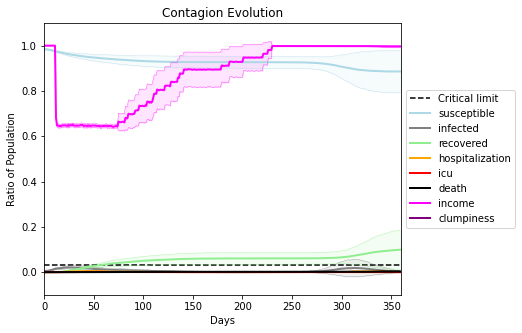

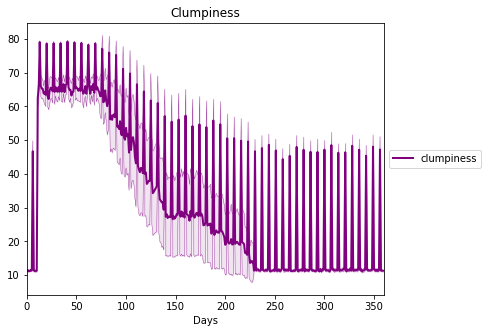

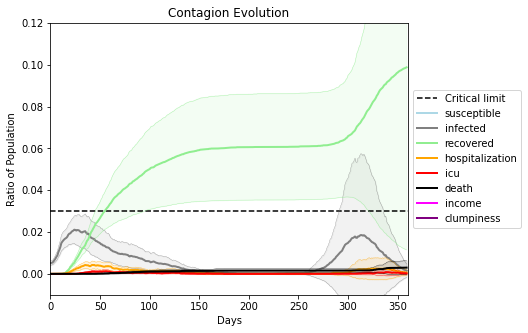

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.991", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[9332, 3882, 963, 4845, 5720, 7264, 9144, 5554, 9211, 2494, 6958, 4887, 367, 1952, 9791, 6877, 3383, 8408, 303, 2084]
Average similarity between family members is 0.9747870215663973 at temperature -0.99
Average similarity between family and home is 0.9999075223205078 at temperature -1
Average similarity between students and their classroom is 0.4683282766637127 at temperature -0.99
Average classroom occupancy is 11.541666666666666 and number classrooms is 24
Average similarity between workers is 0.8931696094962367 at temperature -0.99
Average office occupancy is 10.030303030303031 and number offices is 66
Average friend similarity for adults: 0.9443536454852093 for kids: 0.6495227736288682
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.281590523273236
disconnects
0.01
clumpiness 11.4
avg restaurant similarity 0.41134282478812023
disconnects
0.03
clumpiness 12.51
avg restaurant similarity 0.2968033639304605
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.6029254399165932
disconnects
0.01
clumpiness 11.82
avg restaurant similarity 0.3334164217163295
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.4346928325577134
disconnects
0.02
clumpiness 11.57
avg restaurant similarity 0.4216327681679093
disconnects
0.44
clumpiness 42.32
avg restaurant similarity 0.4824299701131724
disconnects
0.02
clumpiness 13.2
avg restaurant similarity 0.34582816102525354
disconnects
0.02
clumpiness 11.99
avg restaurant similarity 0.4367764644794663
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.29578494422449286
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.3562499932013934
disconnects
0.67
clumpiness 60.75
avg restaurant similarity 0.6396360055479148
disconnects

avg restaurant similarity 0.49625642391614566
disconnects
0.99
clumpiness 79.35
avg restaurant similarity 0.24880378214932156
disconnects
0.78
clumpiness 65.56
avg restaurant similarity 0.2263892400248648
disconnects
0.77
clumpiness 64.96
avg restaurant similarity 0.36399789054372
disconnects
0.79
clumpiness 66.95
avg restaurant similarity 0.35884008452096855
disconnects
0.89
clumpiness 72.77
avg restaurant similarity 0.5704188651334153
disconnects
0.96
clumpiness 77.58
avg restaurant similarity 0.5053632742202214
disconnects
0.78
clumpiness 67.21
avg restaurant similarity 0.4452677480304723
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.24222874955607895
disconnects
0.76
clumpiness 66.14
avg restaurant similarity 0.32455224878470523
disconnects
0.92
clumpiness 74.59
avg restaurant similarity 0.25832339374746444
disconnects
0.68
clumpiness 59.27
avg restaurant similarity 0.4932138063397328
disconnects
0.87
clumpiness 72.14
avg restaurant similarity 0.38694283922614264
disc

disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.3059125394410236
disconnects
0.01
clumpiness 12.5
avg restaurant similarity 0.3727046847243481
disconnects
0.43
clumpiness 42.06
avg restaurant similarity 0.39277190158524056
disconnects
0.04
clumpiness 13.33
avg restaurant similarity 0.34261876307316336
disconnects
0.01
clumpiness 11.02
avg restaurant similarity 0.4496062780669074
disconnects
0.03
clumpiness 12.97
avg restaurant similarity 0.4959128664963981
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.37980082758447153
disconnects
0.01
clumpiness 11.31
avg restaurant similarity 0.5646797357173909
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.2684442614412553
disconnects
0.64
clumpiness 55.34
avg restaurant similarity 0.5081615623057766
disconnects
0.01
clumpiness 11.24
avg restaurant similarity 0.5187010430870802
disconnects
0.01
clumpiness 11.56
avg restaurant similarity 0.46214850065505764
disconnects
0.0
clumpiness 10.83
avg restaurant simi

disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.3419484958274359
disconnects
0.02
clumpiness 12.63
avg restaurant similarity 0.5269488371537994
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.41067987689525565
disconnects
0.66
clumpiness 57.02
avg restaurant similarity 0.41324089744515274
disconnects
0.01
clumpiness 11.09
avg restaurant similarity 0.45557857390092804
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.48681489852207543
disconnects
0.01
clumpiness 11.04
avg restaurant similarity 0.49888285065021254
disconnects
0.01
clumpiness 11.72
avg restaurant similarity 0.40262055441235106
disconnects
0.02
clumpiness 11.47
avg restaurant similarity 0.3573069295803834
disconnects
0.01
clumpiness 12.07
avg restaurant similarity 0.4446518321738332
disconnects
0.45
clumpiness 43.5
avg restaurant similarity 0.4300191451653411
disconnects
0.01
clumpiness 11.49
avg restaurant similarity 0.39600071379536245
disconnects
0.02
clumpiness 12.42
avg restaurant 

avg restaurant similarity 0.3250962920178627
disconnects
0.01
clumpiness 12.07
avg restaurant similarity 0.3121501269326089
disconnects
0.01
clumpiness 11.76
avg restaurant similarity 0.3286655377812897
disconnects
0.01
clumpiness 11.31
avg restaurant similarity 0.43962103874863756
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.3755559797458163
disconnects
0.0
clumpiness 10.47
avg restaurant similarity 0.41279418228739584
disconnects
0.01
clumpiness 11.8
avg restaurant similarity 0.3463298998970839
disconnects
0.55
clumpiness 50.31
avg restaurant similarity 0.3216059949027407
disconnects
0.01
clumpiness 11.14
avg restaurant similarity 0.2359125958286743
disconnects
0.01
clumpiness 11.75
avg restaurant similarity 0.5184510159656323
disconnects
0.0
clumpiness 11.46
avg restaurant similarity 0.3350388684836235
disconnects
0.02
clumpiness 11.8
avg restaurant similarity 0.29242599295099325
disconnects
0.7
clumpiness 60.9
avg restaurant similarity 0.5145872933400134
disconnects

avg restaurant similarity 0.32668460064096205
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.38296624288931985
disconnects
0.87
clumpiness 71.17
avg restaurant similarity 0.3708809192653971
disconnects
0.73
clumpiness 62.79
avg restaurant similarity 0.44346450625313394
disconnects
0.81
clumpiness 68.31
avg restaurant similarity 0.4204797665506584
disconnects
0.74
clumpiness 62.9
avg restaurant similarity 0.5425121282492865
disconnects
0.85
clumpiness 70.09
avg restaurant similarity 0.4245903647054142
disconnects
0.85
clumpiness 70.27
avg restaurant similarity 0.3377275599082555
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.38086840784653747
disconnects
0.61
clumpiness 55.43
avg restaurant similarity 0.33939813778334543
disconnects
0.92
clumpiness 74.62
avg restaurant similarity 0.3370310790738984
disconnects
0.8
clumpiness 66.7
avg restaurant similarity 0.32435393385221045
disconnects
0.81
clumpiness 67.93
avg restaurant similarity 0.4016036489221854
discon

disconnects
0.01
clumpiness 11.62
avg restaurant similarity 0.24659218460022808
disconnects
0.64
clumpiness 55.1
avg restaurant similarity 0.34428540300939553
disconnects
0.01
clumpiness 11.62
avg restaurant similarity 0.45366653128555523
disconnects
0.01
clumpiness 12.18
avg restaurant similarity 0.2535005684852893
disconnects
0.02
clumpiness 11.76
avg restaurant similarity 0.3837222267979447
disconnects
0.01
clumpiness 11.42
avg restaurant similarity 0.37877385478805237
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.33865940113921134
disconnects
0.01
clumpiness 11.28
avg restaurant similarity 0.5315447658386259
disconnects
0.43
clumpiness 42.88
avg restaurant similarity 0.3483141535861889
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.37791792601275614
disconnects
0.0
clumpiness 11.22
avg restaurant similarity 0.4937569499556247
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.3328318061659339
disconnects
0.0
clumpiness 10.59
avg restaurant sim

disconnects
0.02
clumpiness 11.61
avg restaurant similarity 0.476604872910384
disconnects
0.01
clumpiness 11.69
avg restaurant similarity 0.2471301612498763
disconnects
0.46
clumpiness 43.92
avg restaurant similarity 0.41021803615814817
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.2559388773857689
disconnects
0.0
clumpiness 10.82
avg restaurant similarity 0.45297404547494047
disconnects
0.02
clumpiness 11.92
avg restaurant similarity 0.30717225910851526
disconnects
0.02
clumpiness 12.32
avg restaurant similarity 0.46947195449413476
disconnects
0.01
clumpiness 12.59
avg restaurant similarity 0.4701179281437325
disconnects
0.01
clumpiness 11.96
avg restaurant similarity 0.49954513064333184
disconnects
0.62
clumpiness 55.39
avg restaurant similarity 0.3803272310167018
disconnects
0.02
clumpiness 12.11
avg restaurant similarity 0.32801820718696917
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.5344815477204955
disconnects
0.0
clumpiness 11.91
avg restaurant si

avg restaurant similarity 0.40500032101232764
disconnects
0.01
clumpiness 11.01
avg restaurant similarity 0.34519544172628586
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.5256765101430352
disconnects
0.0
clumpiness 10.07
avg restaurant similarity 0.4769497716564371
disconnects
0.01
clumpiness 10.92
avg restaurant similarity 0.39563327025529715
disconnects
0.0
clumpiness 9.3
avg restaurant similarity 0.3733642549822976
disconnects
0.0
clumpiness 10.03
avg restaurant similarity 0.4779212848558528
disconnects
0.43
clumpiness 41.03
avg restaurant similarity 0.5944840810365739
disconnects
0.01
clumpiness 10.87
avg restaurant similarity 0.6558065430052764
disconnects
0.02
clumpiness 11.24
avg restaurant similarity 0.5775745809900621
disconnects
0.0
clumpiness 10.06
avg restaurant similarity 0.3444936496820798
disconnects
0.0
clumpiness 10.2
avg restaurant similarity 0.42488248265319084
disconnects
0.6
clumpiness 54.6
avg restaurant similarity 0.4664331881466348
disconnects
0.

avg restaurant similarity 0.3955959249224199
disconnects
0.95
clumpiness 76.42
avg restaurant similarity 0.423508297659875
disconnects
0.62
clumpiness 57.72
avg restaurant similarity 0.41056234056063656
disconnects
0.51
clumpiness 48.84
avg restaurant similarity 0.41627608465694294
disconnects
0.48
clumpiness 46.84
avg restaurant similarity 0.547804943192842
disconnects
0.66
clumpiness 58.42
avg restaurant similarity 0.39568679381853505
disconnects
0.54
clumpiness 51.77
avg restaurant similarity 0.5499811633006584
disconnects
0.6
clumpiness 54.1
avg restaurant similarity 0.46583382732446693
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.5761299227785219
disconnects
0.65
clumpiness 57.67
avg restaurant similarity 0.4909158707459853
disconnects
0.61
clumpiness 55.83
avg restaurant similarity 0.5761277915152003
disconnects
0.67
clumpiness 60.71
avg restaurant similarity 0.5737609230650037
disconnects
0.64
clumpiness 62.19
avg restaurant similarity 0.4179218119318464
disconn

disconnects
0.0
clumpiness 10.37
avg restaurant similarity 0.5473272545668876
disconnects
0.35
clumpiness 35.93
avg restaurant similarity 0.4713871013055915
disconnects
0.0
clumpiness 10.16
avg restaurant similarity 0.4190794953274967
disconnects
0.01
clumpiness 10.59
avg restaurant similarity 0.5088857834116552
disconnects
0.0
clumpiness 10.45
avg restaurant similarity 0.3552717204712914
disconnects
0.01
clumpiness 11.12
avg restaurant similarity 0.5795270947768688
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.46744306284897746
disconnects
0.01
clumpiness 11.21
avg restaurant similarity 0.4030692634490323
disconnects
0.3
clumpiness 32.72
avg restaurant similarity 0.4014618266695897
disconnects
0.0
clumpiness 10.28
avg restaurant similarity 0.5669707564214049
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.5610592513569038
disconnects
0.01
clumpiness 10.55
avg restaurant similarity 0.46119430861017824
disconnects
0.0
clumpiness 10.32
avg restaurant similarit

disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.43425683040839774
disconnects
0.4
clumpiness 38.63
avg restaurant similarity 0.4787058359337643
disconnects
0.0
clumpiness 10.03
avg restaurant similarity 0.3822651346208531
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.45399361194360166
disconnects
0.0
clumpiness 10.44
avg restaurant similarity 0.5055784599703342
disconnects
0.0
clumpiness 10.26
avg restaurant similarity 0.4199900706799118
disconnects
0.01
clumpiness 10.81
avg restaurant similarity 0.4818975651200396
disconnects
0.0
clumpiness 10.22
avg restaurant similarity 0.4252050598834319
disconnects
0.37
clumpiness 38.0
avg restaurant similarity 0.49645028636895566
disconnects
0.0
clumpiness 10.25
avg restaurant similarity 0.4513280076114192
disconnects
0.0
clumpiness 10.07
avg restaurant similarity 0.39777495482893926
disconnects
0.0
clumpiness 9.97
avg restaurant similarity 0.45262859571728736
disconnects
0.01
clumpiness 10.81
avg restaurant similarity 

avg restaurant similarity 0.49763844831138826
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.4281675020657456
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.3049529230427579
disconnects
0.0
clumpiness 9.97
avg restaurant similarity 0.4847339439026275
disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.48882964965539993
disconnects
0.0
clumpiness 10.25
avg restaurant similarity 0.6661332400613862
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.218899988726766
disconnects
0.35
clumpiness 35.31
avg restaurant similarity 0.39100478925890225
disconnects
0.0
clumpiness 10.47
avg restaurant similarity 0.3793395608636336
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.4701177439494343
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.30953329978191346
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.41698923385992026
disconnects
0.64
clumpiness 56.37
avg restaurant similarity 0.37143619114298226
disconnects
0

disconnects
0.5
clumpiness 49.14
avg restaurant similarity 0.40252239351149954
disconnects
0.98
clumpiness 78.58
avg restaurant similarity 0.3605494196233578
disconnects
0.66
clumpiness 57.82
avg restaurant similarity 0.5157618595234936
disconnects
0.77
clumpiness 64.99
avg restaurant similarity 0.30496858539494975
disconnects
0.44
clumpiness 44.3
avg restaurant similarity 0.5529260428249094
disconnects
0.82
clumpiness 67.84
avg restaurant similarity 0.39490220853872077
disconnects
0.84
clumpiness 68.85
avg restaurant similarity 0.4002950589422439
disconnects
0.51
clumpiness 49.38
avg restaurant similarity 0.39190857748401975
disconnects
0.98
clumpiness 78.56
avg restaurant similarity 0.34957399528232075
disconnects
0.61
clumpiness 54.35
avg restaurant similarity 0.3745654301197581
disconnects
0.67
clumpiness 58.61
avg restaurant similarity 0.501510079977103
disconnects
0.59
clumpiness 53.74
avg restaurant similarity 0.3833116776691368
disconnects
0.78
clumpiness 66.04
avg restaurant s

avg restaurant similarity 0.3595945213560343
disconnects
0.66
clumpiness 58.31
avg restaurant similarity 0.46887511222106887
disconnects
0.92
clumpiness 74.47
avg restaurant similarity 0.5129641940618235
disconnects
0.66
clumpiness 58.39
avg restaurant similarity 0.3093184331080197
disconnects
0.58
clumpiness 52.56
avg restaurant similarity 0.437601022217532
disconnects
0.67
clumpiness 58.7
avg restaurant similarity 0.3439893441955642
disconnects
0.81
clumpiness 66.68
avg restaurant similarity 0.42239870928215206
disconnects
0.67
clumpiness 60.96
avg restaurant similarity 0.38728291588978325
disconnects
0.72
clumpiness 61.68
avg restaurant similarity 0.3744570365775333
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.45959646717791486
disconnects
0.7
clumpiness 59.84
avg restaurant similarity 0.4263431231791653
disconnects
0.48
clumpiness 47.32
avg restaurant similarity 0.2802047179324132
disconnects
0.62
clumpiness 55.58
avg restaurant similarity 0.33451621093182826
disco

disconnects
0.75
clumpiness 63.89
avg restaurant similarity 0.2716864448970977
disconnects
0.63
clumpiness 55.68
avg restaurant similarity 0.30443614789706186
disconnects
0.67
clumpiness 58.71
avg restaurant similarity 0.4542898991661479
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.3925544740586927
disconnects
0.72
clumpiness 62.01
avg restaurant similarity 0.3467469873929995
disconnects
0.61
clumpiness 56.82
avg restaurant similarity 0.3503848936828903
disconnects
0.79
clumpiness 65.62
avg restaurant similarity 0.4841010587829142
disconnects
0.73
clumpiness 62.46
avg restaurant similarity 0.2799903934526487
disconnects
0.66
clumpiness 57.09
avg restaurant similarity 0.4301838746356877
disconnects
0.67
clumpiness 59.62
avg restaurant similarity 0.26028627835835355
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.29331508470643625
disconnects
0.55
clumpiness 50.47
avg restaurant similarity 0.33933305347319204
disconnects
0.67
clumpiness 58.3
avg restaurant si

avg restaurant similarity 0.20183395147217562
disconnects
0.0
clumpiness 9.82
avg restaurant similarity 0.2567229933214906
disconnects
0.01
clumpiness 10.83
avg restaurant similarity 0.14959337124481048
disconnects
0.0
clumpiness 10.48
avg restaurant similarity 0.210134102828492
disconnects
0.01
clumpiness 11.25
avg restaurant similarity 0.41893146096550415
disconnects
0.01
clumpiness 10.67
avg restaurant similarity 0.31638818009867176
disconnects
0.0
clumpiness 10.32
avg restaurant similarity 0.34351309042411354
disconnects
0.44
clumpiness 42.18
avg restaurant similarity 0.3536657111063579
disconnects
0.0
clumpiness 10.26
avg restaurant similarity 0.2569116016753871
disconnects
0.0
clumpiness 10.05
avg restaurant similarity 0.388291543311465
disconnects
0.01
clumpiness 11.12
avg restaurant similarity 0.3710939862549467
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.333226843181805
disconnects
0.51
clumpiness 48.68
avg restaurant similarity 0.31279793400954314
disconnects

disconnects
0.01
clumpiness 10.48
avg restaurant similarity 0.28220987057494135
disconnects
0.43
clumpiness 41.14
avg restaurant similarity 0.4058357409744133
disconnects
0.01
clumpiness 11.31
avg restaurant similarity 0.4389433561315878
disconnects
0.01
clumpiness 11.39
avg restaurant similarity 0.41620833613680913
disconnects
0.0
clumpiness 9.7
avg restaurant similarity 0.32482280587412765
disconnects
0.0
clumpiness 10.44
avg restaurant similarity 0.2383309084203687
disconnects
0.01
clumpiness 10.83
avg restaurant similarity 0.356148004298964
disconnects
0.0
clumpiness 10.25
avg restaurant similarity 0.25851718057493467
disconnects
0.4
clumpiness 38.59
avg restaurant similarity 0.24277961212720103
disconnects
0.0
clumpiness 10.26
avg restaurant similarity 0.3801193028770448
disconnects
0.01
clumpiness 10.91
avg restaurant similarity 0.3117198405750636
disconnects
0.0
clumpiness 10.18
avg restaurant similarity 0.3244607616844964
disconnects
0.02
clumpiness 11.93
avg restaurant similar

avg restaurant similarity 0.27030959988441705
disconnects
0.0
clumpiness 10.22
avg restaurant similarity 0.17417594104066558
disconnects
0.41
clumpiness 40.14
avg restaurant similarity 0.2665108713045122
disconnects
0.02
clumpiness 12.34
avg restaurant similarity 0.40491810601026457
disconnects
0.0
clumpiness 10.1
avg restaurant similarity 0.3466420417888381
disconnects
0.0
clumpiness 9.9
avg restaurant similarity 0.26055677883158257
disconnects
0.0
clumpiness 9.98
avg restaurant similarity 0.250305120294235
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.4481947113969027
disconnects
0.02
clumpiness 12.08
avg restaurant similarity 0.2589960193834861
disconnects
0.51
clumpiness 47.05
avg restaurant similarity 0.3619919369573574
disconnects
0.01
clumpiness 10.79
avg restaurant similarity 0.33542864237980574
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.39164131496836163
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.4958289807730532
disconnects
0

avg restaurant similarity 0.20898456032049462
disconnects
0.02
clumpiness 12.08
avg restaurant similarity 0.47339268993754235
disconnects
0.0
clumpiness 10.75
avg restaurant similarity 0.22768950928366524
disconnects
0.39
clumpiness 38.76
avg restaurant similarity 0.2523602447656938
disconnects
0.01
clumpiness 10.95
avg restaurant similarity 0.33643044411684964
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.29927295875895005
disconnects
0.02
clumpiness 11.88
avg restaurant similarity 0.2694901037158112
disconnects
0.01
clumpiness 10.96
avg restaurant similarity 0.35228757505913993
disconnects
0.0
clumpiness 10.4
avg restaurant similarity 0.36402951462869115
disconnects
0.01
clumpiness 11.33
avg restaurant similarity 0.30773718152283824
disconnects
0.43
clumpiness 41.61
avg restaurant similarity 0.3034251410685927
disconnects
0.02
clumpiness 11.55
avg restaurant similarity 0.47779749417073963
disconnects
0.01
clumpiness 10.81
avg restaurant similarity 0.30173361413721345
d

avg restaurant similarity 0.4099455020857423
disconnects
0.02
clumpiness 11.3
avg restaurant similarity 0.6089991066496163
disconnects
0.03
clumpiness 12.03
avg restaurant similarity 0.42527038649508997
disconnects
0.01
clumpiness 11.01
avg restaurant similarity 0.36964111747124995
disconnects
0.02
clumpiness 11.89
avg restaurant similarity 0.4628080058661364
disconnects
0.04
clumpiness 12.79
avg restaurant similarity 0.3248019346986156
disconnects
0.02
clumpiness 11.36
avg restaurant similarity 0.42713742561403584
disconnects
0.54
clumpiness 50.05
avg restaurant similarity 0.3675539229082758
disconnects
0.01
clumpiness 10.85
avg restaurant similarity 0.4879651195012065
disconnects
0.01
clumpiness 10.75
avg restaurant similarity 0.11639115164800691
disconnects
0.03
clumpiness 12.47
avg restaurant similarity 0.40760177799204445
disconnects
0.01
clumpiness 11.1
avg restaurant similarity 0.5115819959761294
disconnects
0.81
clumpiness 68.99
avg restaurant similarity 0.4238508273149886
disc

avg restaurant similarity 0.47543336655672985
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.24305802132914667
disconnects
0.94
clumpiness 76.12
avg restaurant similarity 0.2514227693895276
disconnects
0.97
clumpiness 77.75
avg restaurant similarity 0.2738753809219649
disconnects
0.85
clumpiness 70.52
avg restaurant similarity 0.3083413457666062
disconnects
0.78
clumpiness 65.72
avg restaurant similarity 0.4854767390045953
disconnects
0.79
clumpiness 67.11
avg restaurant similarity 0.48320848265895694
disconnects
0.92
clumpiness 75.1
avg restaurant similarity 0.29785697246364595
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.4258228368206426
disconnects
0.87
clumpiness 71.42
avg restaurant similarity 0.4888104581182824
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.5389516147162424
disconnects
0.93
clumpiness 75.27
avg restaurant similarity 0.34590113387519994
disconnects
0.91
clumpiness 74.57
avg restaurant similarity 0.6140963180093926
dis

avg restaurant similarity 0.4481734578728646
disconnects
0.02
clumpiness 12.12
avg restaurant similarity 0.47132473534283587
disconnects
0.71
clumpiness 60.55
avg restaurant similarity 0.225984862548569
disconnects
0.01
clumpiness 10.98
avg restaurant similarity 0.5876634932484354
disconnects
0.03
clumpiness 12.32
avg restaurant similarity 0.38836882828970737
disconnects
0.01
clumpiness 11.42
avg restaurant similarity 0.33261661999776954
disconnects
0.02
clumpiness 11.83
avg restaurant similarity 0.40426849054974556
disconnects
0.0
clumpiness 10.09
avg restaurant similarity 0.39945372280174757
disconnects
0.02
clumpiness 11.82
avg restaurant similarity 0.5633070834390601
disconnects
0.4
clumpiness 41.51
avg restaurant similarity 0.4872936589140276
disconnects
0.01
clumpiness 11.07
avg restaurant similarity 0.41672810088552026
disconnects
0.01
clumpiness 11.19
avg restaurant similarity 0.257701656629365
disconnects
0.02
clumpiness 11.98
avg restaurant similarity 0.38261369447937615
disc

avg restaurant similarity 0.5896417047841847
disconnects
0.02
clumpiness 11.58
avg restaurant similarity 0.46915041127010704
disconnects
0.02
clumpiness 12.15
avg restaurant similarity 0.4709099459045734
disconnects
0.47
clumpiness 44.99
avg restaurant similarity 0.3892585710962431
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.5716577855885057
disconnects
0.02
clumpiness 11.87
avg restaurant similarity 0.504544894277749
disconnects
0.0
clumpiness 10.12
avg restaurant similarity 0.5557292980310163
disconnects
0.0
clumpiness 9.78
avg restaurant similarity 0.41350004537799356
disconnects
0.01
clumpiness 10.97
avg restaurant similarity 0.4808928514222364
disconnects
0.02
clumpiness 11.86
avg restaurant similarity 0.48467421302193
disconnects
0.51
clumpiness 47.46
avg restaurant similarity 0.34635159426833356
disconnects
0.0
clumpiness 10.48
avg restaurant similarity 0.4357013073623691
disconnects
0.01
clumpiness 10.89
avg restaurant similarity 0.47552330563884126
disconnects

avg restaurant similarity 0.14073361207456606
disconnects
0.0
clumpiness 10.89
avg restaurant similarity 0.2770999062998932
disconnects
0.0
clumpiness 10.64
avg restaurant similarity 0.2209268281084572
disconnects
0.02
clumpiness 12.16
avg restaurant similarity 0.30380387820950683
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.19581096500599482
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.2339410429249711
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.1570818313297
disconnects
0.36
clumpiness 37.26
avg restaurant similarity 0.23010177320197533
disconnects
0.0
clumpiness 10.67
avg restaurant similarity 0.24002460161872805
disconnects
0.01
clumpiness 11.52
avg restaurant similarity 0.2482224547373884
disconnects
0.02
clumpiness 11.84
avg restaurant similarity 0.15861705787721336
disconnects
0.02
clumpiness 12.18
avg restaurant similarity 0.19056711795485887
disconnects
0.74
clumpiness 64.21
avg restaurant similarity 0.15658335965035575
disconne

disconnects
0.72
clumpiness 61.88
avg restaurant similarity 0.28436268581030427
disconnects
0.97
clumpiness 77.71
avg restaurant similarity 0.2183577777451388
disconnects
0.65
clumpiness 57.91
avg restaurant similarity 0.36188690832447706
disconnects
0.85
clumpiness 69.93
avg restaurant similarity 0.15677043950054878
disconnects
0.73
clumpiness 61.86
avg restaurant similarity 0.20214424877871048
disconnects
0.82
clumpiness 68.17
avg restaurant similarity 0.16324028608807256
disconnects
0.75
clumpiness 64.2
avg restaurant similarity 0.2953346732150309
disconnects
0.65
clumpiness 57.84
avg restaurant similarity 0.20936822302178298
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.41405596554820345
disconnects
0.61
clumpiness 56.27
avg restaurant similarity 0.32895636515822874
disconnects
0.8
clumpiness 67.22
avg restaurant similarity 0.22546405043858414
disconnects
0.72
clumpiness 62.75
avg restaurant similarity 0.22243348360144413
disconnects
0.85
clumpiness 69.77
avg restau

avg restaurant similarity 0.2794008962981777
disconnects
0.01
clumpiness 10.7
avg restaurant similarity 0.3125389809198688
disconnects
0.01
clumpiness 11.47
avg restaurant similarity 0.35940177709062604
disconnects
0.58
clumpiness 51.08
avg restaurant similarity 0.2320968045838538
disconnects
0.02
clumpiness 12.01
avg restaurant similarity 0.3289538747191006
disconnects
0.03
clumpiness 12.93
avg restaurant similarity 0.23344555548747542
disconnects
0.03
clumpiness 12.86
avg restaurant similarity 0.16782907323253382
disconnects
0.04
clumpiness 13.14
avg restaurant similarity 0.30034350367024454
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.2629040406570954
disconnects
0.01
clumpiness 11.66
avg restaurant similarity 0.23585662532817342
disconnects
0.41
clumpiness 41.54
avg restaurant similarity 0.30362790738832385
disconnects
0.04
clumpiness 13.67
avg restaurant similarity 0.3214099391618681
disconnects
0.01
clumpiness 11.28
avg restaurant similarity 0.3839333278742968
dis

avg restaurant similarity 0.2740322687463911
disconnects
0.0
clumpiness 10.43
avg restaurant similarity 0.10349964341666187
disconnects
0.01
clumpiness 11.08
avg restaurant similarity 0.3054067535892496
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.33004647006191123
disconnects
0.38
clumpiness 38.1
avg restaurant similarity 0.2213210525611339
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.31159646044937694
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.2707483747354489
disconnects
0.01
clumpiness 10.85
avg restaurant similarity 0.19457259902415316
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.3683190921566023
disconnects
0.02
clumpiness 12.09
avg restaurant similarity 0.3624258430637411
disconnects
0.01
clumpiness 11.3
avg restaurant similarity 0.2019566634461817
disconnects
0.48
clumpiness 45.26
avg restaurant similarity 0.20662931513253463
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.15961186100270783
disconnect

avg restaurant similarity 0.3072362131964515
disconnects
0.0
clumpiness 10.61
avg restaurant similarity 0.3678529523559866
disconnects
0.0
clumpiness 10.53
avg restaurant similarity 0.3039131607411097
disconnects
0.0
clumpiness 10.18
avg restaurant similarity 0.2878555591633572
disconnects
0.01
clumpiness 10.83
avg restaurant similarity 0.40718667722716895
disconnects
0.0
clumpiness 11.15
avg restaurant similarity 0.5155906599127553
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.5007520496018322
disconnects
0.62
clumpiness 54.43
avg restaurant similarity 0.3214385279420402
disconnects
0.0
clumpiness 10.44
avg restaurant similarity 0.4729022131757984
disconnects
0.02
clumpiness 12.44
avg restaurant similarity 0.3607811167852661
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.27237339952772827
disconnects
0.03
clumpiness 12.73
avg restaurant similarity 0.4038578109290598
disconnects
0.8
clumpiness 67.02
avg restaurant similarity 0.45235719601885893
disconnects


avg restaurant similarity 0.406679349966535
disconnects
0.49
clumpiness 46.33
avg restaurant similarity 0.21990705125402704
disconnects
0.0
clumpiness 11.57
avg restaurant similarity 0.3640715437336603
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.27494663208853537
disconnects
0.01
clumpiness 11.36
avg restaurant similarity 0.30095951119497516
disconnects
0.0
clumpiness 10.56
avg restaurant similarity 0.426778561324295
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.40148409658955014
disconnects
0.0
clumpiness 10.1
avg restaurant similarity 0.3493693800307398
disconnects
0.43
clumpiness 43.72
avg restaurant similarity 0.4833068700920218
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.3154306174275992
disconnects
0.01
clumpiness 11.03
avg restaurant similarity 0.39324184882922053
disconnects
0.01
clumpiness 11.68
avg restaurant similarity 0.479850351204886
disconnects
0.01
clumpiness 11.39
avg restaurant similarity 0.5954979675594428
disconnects


disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.5027194372972505
disconnects
0.52
clumpiness 47.98
avg restaurant similarity 0.40028429952085576
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.4817614142693869
disconnects
0.0
clumpiness 10.53
avg restaurant similarity 0.21736586996383297
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.4982031260512118
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.4433644975785711
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.3490995775526606
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.4388543810011673
disconnects
0.45
clumpiness 44.65
avg restaurant similarity 0.2519599302688935
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.49139604531428205
disconnects
0.01
clumpiness 10.99
avg restaurant similarity 0.44540033335624674
disconnects
0.02
clumpiness 11.97
avg restaurant similarity 0.3037932846775052
disconnects
0.01
clumpiness 11.51
avg restaurant similari

avg restaurant similarity 0.41505471421215984
disconnects
0.0
clumpiness 10.7
avg restaurant similarity 0.34369367161640035
disconnects
0.69
clumpiness 59.13
avg restaurant similarity 0.27295228562814305
disconnects
0.0
clumpiness 10.24
avg restaurant similarity 0.4932750360683318
disconnects
0.01
clumpiness 10.71
avg restaurant similarity 0.3217226332692215
disconnects
0.03
clumpiness 12.54
avg restaurant similarity 0.2590697619727328
disconnects
0.0
clumpiness 10.89
avg restaurant similarity 0.3437221556146397
disconnects
0.01
clumpiness 10.65
avg restaurant similarity 0.2934764747307423
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.24265093717836933
disconnects
0.47
clumpiness 45.37
avg restaurant similarity 0.31910069781385075
disconnects
0.0
clumpiness 10.34
avg restaurant similarity 0.4920424190621217
disconnects
0.0
clumpiness 10.06
avg restaurant similarity 0.35420320902486496
disconnects
0.0
clumpiness 11.33
avg restaurant similarity 0.30688023737599884
disconne

avg restaurant similarity 0.34229187681297024
disconnects
0.0
clumpiness 10.01
avg restaurant similarity 0.3785662663837799
disconnects
0.01
clumpiness 10.5
avg restaurant similarity 0.36746273574975735
disconnects
0.01
clumpiness 10.56
avg restaurant similarity 0.4889033543041289
disconnects
0.01
clumpiness 10.85
avg restaurant similarity 0.45114961223809413
disconnects
0.01
clumpiness 10.86
avg restaurant similarity 0.41675503551044846
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.3869049718062713
disconnects
0.34
clumpiness 35.78
avg restaurant similarity 0.48452730993626425
disconnects
0.01
clumpiness 10.6
avg restaurant similarity 0.29986605208943845
disconnects
0.02
clumpiness 11.75
avg restaurant similarity 0.4744123794427995
disconnects
0.0
clumpiness 9.64
avg restaurant similarity 0.4379992776509826
disconnects
0.04
clumpiness 12.98
avg restaurant similarity 0.350517850961215
disconnects
0.61
clumpiness 54.82
avg restaurant similarity 0.27825557175037524
disconn

disconnects
0.01
clumpiness 10.36
avg restaurant similarity 0.3130167240817568
disconnects
0.38
clumpiness 39.16
avg restaurant similarity 0.3810070888043115
disconnects
0.01
clumpiness 10.58
avg restaurant similarity 0.434772141613237
disconnects
0.01
clumpiness 11.07
avg restaurant similarity 0.4683546561456835
disconnects
0.0
clumpiness 9.68
avg restaurant similarity 0.31752779425324273
disconnects
0.0
clumpiness 9.81
avg restaurant similarity 0.41434078957471415
disconnects
0.0
clumpiness 9.96
avg restaurant similarity 0.463848720308466
disconnects
0.02
clumpiness 11.67
avg restaurant similarity 0.4313552189028038
disconnects
0.4
clumpiness 39.61
avg restaurant similarity 0.3693756798255347
disconnects
0.01
clumpiness 10.72
avg restaurant similarity 0.37656887392398514
disconnects
0.02
clumpiness 11.82
avg restaurant similarity 0.287545412223769
disconnects
0.01
clumpiness 11.0
avg restaurant similarity 0.4968442646095236
disconnects
0.01
clumpiness 10.75
avg restaurant similarity 

avg restaurant similarity 0.3124649727689929
disconnects
0.01
clumpiness 10.47
avg restaurant similarity 0.3622425371217469
disconnects
0.3
clumpiness 33.39
avg restaurant similarity 0.33827719149613067
disconnects
0.02
clumpiness 11.16
avg restaurant similarity 0.47612081838403875
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.4242165085208869
disconnects
0.0
clumpiness 10.4
avg restaurant similarity 0.42321112814831663
disconnects
0.02
clumpiness 11.61
avg restaurant similarity 0.2431483832866328
disconnects
0.01
clumpiness 10.75
avg restaurant similarity 0.2824925705366435
disconnects
0.01
clumpiness 10.14
avg restaurant similarity 0.49263136396948326
disconnects
0.37
clumpiness 37.3
avg restaurant similarity 0.3687081468683529
disconnects
0.0
clumpiness 10.08
avg restaurant similarity 0.3307460542850696
disconnects
0.0
clumpiness 9.47
avg restaurant similarity 0.5018659098026547
disconnects
0.0
clumpiness 9.98
avg restaurant similarity 0.4000987659741386
disconnects
0

disconnects
0.0
clumpiness 10.15
avg restaurant similarity 0.309989515553062
disconnects
0.02
clumpiness 11.12
avg restaurant similarity 0.40886423612380624
disconnects
0.33
clumpiness 33.92
avg restaurant similarity 0.4091835098344408
disconnects
0.01
clumpiness 10.45
avg restaurant similarity 0.47666263744409654
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.38813265165170585
disconnects
0.0
clumpiness 10.5
avg restaurant similarity 0.3790184647776581
disconnects
0.0
clumpiness 10.15
avg restaurant similarity 0.39494364229132667
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.5208094338764935
disconnects
0.0
clumpiness 10.01
avg restaurant similarity 0.4268692673772139
disconnects
0.34
clumpiness 35.2
avg restaurant similarity 0.5039996358686707
disconnects
0.02
clumpiness 11.58
avg restaurant similarity 0.42293048220341045
disconnects
0.0
clumpiness 9.66
avg restaurant similarity 0.33770726919332594
disconnects
0.0
clumpiness 10.02
avg restaurant similarity 0

avg restaurant similarity 0.2697455518585076
disconnects
0.0
clumpiness 11.49
avg restaurant similarity 0.46893650052290237
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.32680491587884164
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.45988384817570205
disconnects
0.0
clumpiness 10.55
avg restaurant similarity 0.46550027229302293
disconnects
0.01
clumpiness 12.02
avg restaurant similarity 0.3020564468127931
disconnects
0.0
clumpiness 11.16
avg restaurant similarity 0.3146599489500131
disconnects
0.78
clumpiness 64.94
avg restaurant similarity 0.5049188823181318
disconnects
0.0
clumpiness 11.29
avg restaurant similarity 0.5564075437176931
disconnects
0.0
clumpiness 11.03
avg restaurant similarity 0.5132458133251651
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.41490160476321586
disconnects
0.01
clumpiness 11.08
avg restaurant similarity 0.34535079947148073
disconnects
0.64
clumpiness 59.0
avg restaurant similarity 0.5011146771360118
disconnect

avg restaurant similarity 0.5798741770761782
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.4759709615325007
disconnects
0.79
clumpiness 66.75
avg restaurant similarity 0.45285963065771623
disconnects
0.83
clumpiness 68.85
avg restaurant similarity 0.3090979929001613
disconnects
0.73
clumpiness 63.06
avg restaurant similarity 0.45883916275396824
disconnects
0.61
clumpiness 58.3
avg restaurant similarity 0.4983626021214799
disconnects
0.87
clumpiness 72.3
avg restaurant similarity 0.351659459745152
disconnects
0.68
clumpiness 63.63
avg restaurant similarity 0.361267947243173
disconnects
0.98
clumpiness 78.45
avg restaurant similarity 0.2461280286204591
disconnects
0.77
clumpiness 66.38
avg restaurant similarity 0.35725947799237334
disconnects
0.72
clumpiness 64.24
avg restaurant similarity 0.45653806204401615
disconnects
0.7
clumpiness 61.67
avg restaurant similarity 0.480007165620583
disconnects
0.79
clumpiness 67.9
avg restaurant similarity 0.4854218654029754
disconnects


avg restaurant similarity 0.42796628061101016
disconnects
0.73
clumpiness 64.43
avg restaurant similarity 0.46833374664228417
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.48099210218301647
disconnects
0.6
clumpiness 57.41
avg restaurant similarity 0.4336062029310064
disconnects
0.79
clumpiness 67.22
avg restaurant similarity 0.5959646403006513
disconnects
0.86
clumpiness 70.74
avg restaurant similarity 0.3922164724090485
disconnects
0.81
clumpiness 69.03
avg restaurant similarity 0.3776104174978974
disconnects
0.74
clumpiness 63.64
avg restaurant similarity 0.37478295800017924
disconnects
0.82
clumpiness 68.77
avg restaurant similarity 0.7495465322532514
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.42859658763424857
disconnects
0.87
clumpiness 71.8
avg restaurant similarity 0.39229925134050503
disconnects
0.83
clumpiness 68.89
avg restaurant similarity 0.4130104667003318
disconnects
0.64
clumpiness 60.77
avg restaurant similarity 0.2631128026924584
disconn

avg restaurant similarity 0.48537581057794826
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.3865976375988677
disconnects
0.0
clumpiness 11.53
avg restaurant similarity 0.4714337632233199
disconnects
0.87
clumpiness 71.28
avg restaurant similarity 0.2908550684449414
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.41427303130002363
disconnects
0.01
clumpiness 12.15
avg restaurant similarity 0.5091278736335114
disconnects
0.0
clumpiness 11.67
avg restaurant similarity 0.39899887583178373
disconnects
0.0
clumpiness 11.63
avg restaurant similarity 0.45663238437217385
disconnects
0.0
clumpiness 11.81
avg restaurant similarity 0.41939495810502075
disconnects
0.0
clumpiness 11.41
avg restaurant similarity 0.5332240297471023
disconnects
0.68
clumpiness 59.8
avg restaurant similarity 0.32988565597007175
disconnects
0.0
clumpiness 11.38
avg restaurant similarity 0.5415430142243235
disconnects
0.0
clumpiness 11.61
avg restaurant similarity 0.5250862090585169
disconnects
0

avg restaurant similarity 0.32698657195576974
disconnects
0.03
clumpiness 12.05
avg restaurant similarity 0.3992742336849035
disconnects
0.0
clumpiness 10.09
avg restaurant similarity 0.3424878820868943
disconnects
0.01
clumpiness 11.15
avg restaurant similarity 0.5200246375805644
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.3663788951521059
disconnects
0.01
clumpiness 11.0
avg restaurant similarity 0.3384474141529082
disconnects
0.0
clumpiness 10.42
avg restaurant similarity 0.3901272870805994
disconnects
0.5
clumpiness 46.03
avg restaurant similarity 0.3290884024251923
disconnects
0.01
clumpiness 10.63
avg restaurant similarity 0.4504860028719224
disconnects
0.0
clumpiness 10.69
avg restaurant similarity 0.4330062872215891
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.37134910148056693
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.3915651192287814
disconnects
0.51
clumpiness 48.95
avg restaurant similarity 0.27902596491244597
disconnects


disconnects
0.65
clumpiness 57.73
avg restaurant similarity 0.3090268276541517
disconnects
0.96
clumpiness 77.21
avg restaurant similarity 0.434767287619711
disconnects
0.68
clumpiness 59.14
avg restaurant similarity 0.30951852282752657
disconnects
0.52
clumpiness 50.25
avg restaurant similarity 0.4060177994036802
disconnects
0.65
clumpiness 58.64
avg restaurant similarity 0.26494303113740214
disconnects
0.74
clumpiness 63.43
avg restaurant similarity 0.49716357716285603
disconnects
0.7
clumpiness 61.07
avg restaurant similarity 0.3649905624604582
disconnects
0.51
clumpiness 49.94
avg restaurant similarity 0.3451152455488715
disconnects
0.95
clumpiness 76.61
avg restaurant similarity 0.3244058692741991
disconnects
0.57
clumpiness 54.0
avg restaurant similarity 0.4863000620679934
disconnects
0.54
clumpiness 50.21
avg restaurant similarity 0.32200214605297
disconnects
0.7
clumpiness 61.81
avg restaurant similarity 0.33083526336710256
disconnects
0.49
clumpiness 47.14
avg restaurant simil

disconnects
0.59
clumpiness 52.62
avg restaurant similarity 0.36657341053525583
disconnects
0.43
clumpiness 43.52
avg restaurant similarity 0.34447127284247314
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.33385301002005136
disconnects
0.63
clumpiness 57.14
avg restaurant similarity 0.40414811884872487
disconnects
0.58
clumpiness 52.38
avg restaurant similarity 0.250070582137491
disconnects
0.58
clumpiness 53.47
avg restaurant similarity 0.38366474680122953
disconnects
0.79
clumpiness 66.23
avg restaurant similarity 0.49577418289742975
disconnects
0.84
clumpiness 68.82
avg restaurant similarity 0.3898635935693455
disconnects
0.67
clumpiness 58.58
avg restaurant similarity 0.4582413615493607
disconnects
0.98
clumpiness 78.51
avg restaurant similarity 0.46828036635825815
disconnects
0.65
clumpiness 57.15
avg restaurant similarity 0.28401473465928334
disconnects
0.56
clumpiness 51.0
avg restaurant similarity 0.41772378922962156
disconnects
0.72
clumpiness 61.99
avg restauran

avg restaurant similarity 0.28404318179130683
disconnects
0.57
clumpiness 52.41
avg restaurant similarity 0.33929354724707855
disconnects
0.54
clumpiness 50.29
avg restaurant similarity 0.5030403325096726
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.3915962547855869
disconnects
0.66
clumpiness 59.27
avg restaurant similarity 0.3597935581403025
disconnects
0.73
clumpiness 62.18
avg restaurant similarity 0.22646824796598888
disconnects
0.38
clumpiness 40.53
avg restaurant similarity 0.3520736663179029
disconnects
0.59
clumpiness 55.88
avg restaurant similarity 0.3531295377845426
disconnects
0.7
clumpiness 61.61
avg restaurant similarity 0.40123106811831627
disconnects
0.69
clumpiness 60.53
avg restaurant similarity 0.4581076734326118
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.3180096085990911
disconnects
0.57
clumpiness 54.28
avg restaurant similarity 0.5031580377671911
disconnects
0.72
clumpiness 61.84
avg restaurant similarity 0.3916104710172675
disc

avg restaurant similarity 0.36220691612322586
disconnects
0.01
clumpiness 11.54
avg restaurant similarity 0.30793036687083186
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.3233219645847941
disconnects
0.03
clumpiness 12.35
avg restaurant similarity 0.3350480577719656
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.38945636003659895
disconnects
0.01
clumpiness 12.2
avg restaurant similarity 0.3193781644733279
disconnects
0.01
clumpiness 11.54
avg restaurant similarity 0.465709594665771
disconnects
0.46
clumpiness 43.78
avg restaurant similarity 0.5529492288649461
disconnects
0.02
clumpiness 12.3
avg restaurant similarity 0.5039398896653543
disconnects
0.01
clumpiness 11.83
avg restaurant similarity 0.42066888971118305
disconnects
0.0
clumpiness 11.08
avg restaurant similarity 0.4688879964924287
disconnects
0.0
clumpiness 11.22
avg restaurant similarity 0.4145200895124165
disconnects
0.58
clumpiness 52.83
avg restaurant similarity 0.3866009542466432
disconnects

avg restaurant similarity 0.3790926785733464
disconnects
0.96
clumpiness 77.05
avg restaurant similarity 0.3593864362150732
disconnects
0.63
clumpiness 58.63
avg restaurant similarity 0.412710935763402
disconnects
0.58
clumpiness 54.0
avg restaurant similarity 0.38339234838745845
disconnects
0.57
clumpiness 52.58
avg restaurant similarity 0.47179298622857585
disconnects
0.57
clumpiness 54.09
avg restaurant similarity 0.36705872566095277
disconnects
0.57
clumpiness 52.85
avg restaurant similarity 0.3431282710460527
disconnects
0.75
clumpiness 64.28
avg restaurant similarity 0.5652033532590546
disconnects
0.95
clumpiness 76.6
avg restaurant similarity 0.4533084017547366
disconnects
0.62
clumpiness 55.57
avg restaurant similarity 0.29744045595374663
disconnects
0.57
clumpiness 53.7
avg restaurant similarity 0.44176094150960293
disconnects
0.59
clumpiness 55.32
avg restaurant similarity 0.485698526128553
disconnects
0.77
clumpiness 65.73
avg restaurant similarity 0.34164301525977775
discon

disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.5017267848336835
disconnects
0.01
clumpiness 11.24
avg restaurant similarity 0.4109461490097175
disconnects
0.57
clumpiness 50.8
avg restaurant similarity 0.41711187816102063
disconnects
0.01
clumpiness 11.54
avg restaurant similarity 0.4293115528447346
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.35111808876017475
disconnects
0.01
clumpiness 11.64
avg restaurant similarity 0.4014103366725631
disconnects
0.03
clumpiness 12.45
avg restaurant similarity 0.5473880319720642
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.3348643684934496
disconnects
0.01
clumpiness 11.66
avg restaurant similarity 0.5331127691225818
disconnects
0.48
clumpiness 45.54
avg restaurant similarity 0.571897962908405
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.42989044547221
disconnects
0.01
clumpiness 11.37
avg restaurant similarity 0.3686379041148682
disconnects
0.0
clumpiness 10.48
avg restaurant similarity

disconnects
0.01
clumpiness 11.5
avg restaurant similarity 0.3448562357213861
disconnects
0.03
clumpiness 12.36
avg restaurant similarity 0.41723585465857427
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.4191530146269876
disconnects
0.52
clumpiness 48.04
avg restaurant similarity 0.3653304105444531
disconnects
0.01
clumpiness 11.54
avg restaurant similarity 0.3996305763371136
disconnects
0.0
clumpiness 10.63
avg restaurant similarity 0.39739311589497833
disconnects
0.0
clumpiness 11.07
avg restaurant similarity 0.27801139846948136
disconnects
0.01
clumpiness 11.74
avg restaurant similarity 0.445999889269118
disconnects
0.01
clumpiness 11.54
avg restaurant similarity 0.4055236558031072
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.3679626239797103
disconnects
0.55
clumpiness 49.67
avg restaurant similarity 0.3397696419784597
disconnects
0.01
clumpiness 11.38
avg restaurant similarity 0.3479166297000444
disconnects
0.01
clumpiness 11.43
avg restaurant similar

avg restaurant similarity 0.39044699799876403
disconnects
0.0
clumpiness 10.47
avg restaurant similarity 0.4712839781998845
disconnects
0.0
clumpiness 10.15
avg restaurant similarity 0.4971048566012788
disconnects
0.0
clumpiness 10.52
avg restaurant similarity 0.4626993798231501
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.5298073433891747
disconnects
0.02
clumpiness 12.24
avg restaurant similarity 0.404634821363948
disconnects
0.0
clumpiness 10.54
avg restaurant similarity 0.37952983422310566
disconnects
0.36
clumpiness 37.12
avg restaurant similarity 0.28997728068876427
disconnects
0.0
clumpiness 10.47
avg restaurant similarity 0.36992357331666925
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.43201573297961926
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.5461422533115996
disconnects
0.0
clumpiness 9.81
avg restaurant similarity 0.32294942098130686
disconnects
0.6
clumpiness 54.0
avg restaurant similarity 0.3839078649726545
disconnects
0.6

avg restaurant similarity 0.5243010154374362
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3858951742094517
disconnects
0.68
clumpiness 59.13
avg restaurant similarity 0.5217891108141398
disconnects
0.79
clumpiness 65.65
avg restaurant similarity 0.541812938844055
disconnects
0.66
clumpiness 58.02
avg restaurant similarity 0.35438119447547795
disconnects
0.59
clumpiness 53.47
avg restaurant similarity 0.4460461062423239
disconnects
0.83
clumpiness 68.62
avg restaurant similarity 0.4712205973121853
disconnects
0.74
clumpiness 63.15
avg restaurant similarity 0.5547191302877231
disconnects
0.97
clumpiness 77.91
avg restaurant similarity 0.45069312632582986
disconnects
0.71
clumpiness 60.44
avg restaurant similarity 0.46978396115946297
disconnects
0.77
clumpiness 64.53
avg restaurant similarity 0.43376250851781056
disconnects
0.81
clumpiness 67.4
avg restaurant similarity 0.4625657964529035
disconnects
0.74
clumpiness 62.74
avg restaurant similarity 0.514593982198918
disconne

avg restaurant similarity 0.4647948276142908
disconnects
0.78
clumpiness 65.16
avg restaurant similarity 0.42599388508420916
disconnects
0.94
clumpiness 75.77
avg restaurant similarity 0.3281825694759098
disconnects
0.67
clumpiness 58.26
avg restaurant similarity 0.38909938947300565
disconnects
0.63
clumpiness 56.91
avg restaurant similarity 0.4850782254833206
disconnects
0.79
clumpiness 65.81
avg restaurant similarity 0.3820412356618217
disconnects
0.61
clumpiness 54.79
avg restaurant similarity 0.5116968090507938
disconnects
0.64
clumpiness 56.67
avg restaurant similarity 0.48706668675483455
disconnects
0.65
clumpiness 57.7
avg restaurant similarity 0.4333443387699845
disconnects
0.95
clumpiness 76.57
avg restaurant similarity 0.45892474904030844
disconnects
0.69
clumpiness 59.92
avg restaurant similarity 0.46640901474823576
disconnects
0.64
clumpiness 56.1
avg restaurant similarity 0.48023461236085685
disconnects
0.65
clumpiness 57.08
avg restaurant similarity 0.3825059892942673
dis

disconnects
0.01
clumpiness 11.43
avg restaurant similarity 0.4148234623528002
disconnects
0.01
clumpiness 11.01
avg restaurant similarity 0.39750073238893396
disconnects
0.43
clumpiness 42.53
avg restaurant similarity 0.3915783711818508
disconnects
0.0
clumpiness 10.13
avg restaurant similarity 0.44975708398614295
disconnects
0.01
clumpiness 10.57
avg restaurant similarity 0.5253175760129675
disconnects
0.0
clumpiness 10.45
avg restaurant similarity 0.41284420110138936
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.3569145427107973
disconnects
0.0
clumpiness 10.32
avg restaurant similarity 0.42200174844923993
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.3490073217072551
disconnects
0.49
clumpiness 46.1
avg restaurant similarity 0.41022733299228864
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.35714031928714335
disconnects
0.01
clumpiness 11.3
avg restaurant similarity 0.4460115989244893
disconnects
0.01
clumpiness 11.25
avg restaurant simila

avg restaurant similarity 0.5068019645630808
disconnects
0.0
clumpiness 10.11
avg restaurant similarity 0.3822731805351086
disconnects
0.01
clumpiness 12.12
avg restaurant similarity 0.34553385225857497
disconnects
0.0
clumpiness 11.7
avg restaurant similarity 0.45718138045757145
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.44036904053679554
disconnects
0.0
clumpiness 10.49
avg restaurant similarity 0.40146813528630415
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.3690629061247469
disconnects
0.51
clumpiness 47.82
avg restaurant similarity 0.35073520502127875
disconnects
0.02
clumpiness 12.05
avg restaurant similarity 0.5212602056627997
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.5624057883018442
disconnects
0.0
clumpiness 10.54
avg restaurant similarity 0.5085568736700589
disconnects
0.01
clumpiness 11.84
avg restaurant similarity 0.4512811491638068
disconnects
0.54
clumpiness 49.9
avg restaurant similarity 0.5522542325613105
disconnects


avg restaurant similarity 0.47075677789222214
disconnects
0.96
clumpiness 77.24
avg restaurant similarity 0.473111849666093
disconnects
0.6
clumpiness 54.26
avg restaurant similarity 0.35603643495354254
disconnects
0.83
clumpiness 68.73
avg restaurant similarity 0.5354439198340609
disconnects
0.77
clumpiness 64.02
avg restaurant similarity 0.47486629277571346
disconnects
0.74
clumpiness 62.22
avg restaurant similarity 0.4988997216612425
disconnects
0.53
clumpiness 50.41
avg restaurant similarity 0.42814695850557577
disconnects
0.85
clumpiness 70.27
avg restaurant similarity 0.453558700724699
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.4268880204752235
disconnects
0.01
clumpiness 11.56
avg restaurant similarity 0.40180007619692937
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.4756893036966124
disconnects
0.01
clumpiness 11.96
avg restaurant similarity 0.42975830441063273
disconnects
0.0
clumpiness 10.31
avg restaurant similarity 0.6026768939107977
discon

disconnects
0.0
clumpiness 11.45
avg restaurant similarity 0.4496879193290888
disconnects
0.49
clumpiness 46.5
avg restaurant similarity 0.4375048311077209
disconnects
0.0
clumpiness 11.2
avg restaurant similarity 0.447668802942311
disconnects
0.01
clumpiness 11.88
avg restaurant similarity 0.48419319244802783
disconnects
0.01
clumpiness 12.07
avg restaurant similarity 0.544590118010719
disconnects
0.0
clumpiness 11.44
avg restaurant similarity 0.5468769652262079
disconnects
0.01
clumpiness 11.82
avg restaurant similarity 0.4497786075207207
disconnects
0.0
clumpiness 11.05
avg restaurant similarity 0.4695859303815914
disconnects
0.5
clumpiness 47.5
avg restaurant similarity 0.38692152401289587
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.40342482854055683
disconnects
0.0
clumpiness 11.38
avg restaurant similarity 0.5272622385120042
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.3961689691292054
disconnects
0.02
clumpiness 12.16
avg restaurant similarity 0.

avg restaurant similarity 0.450955848114339
disconnects
0.0
clumpiness 10.82
avg restaurant similarity 0.31498717149465183
disconnects
0.48
clumpiness 45.41
avg restaurant similarity 0.44955017573623934
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.4343695521312032
disconnects
0.0
clumpiness 11.3
avg restaurant similarity 0.4354631167687905
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.3477542517711377
disconnects
0.0
clumpiness 10.43
avg restaurant similarity 0.39884878459699025
disconnects
0.0
clumpiness 10.24
avg restaurant similarity 0.5257909096460879
disconnects
0.02
clumpiness 12.0
avg restaurant similarity 0.5529780752148781
disconnects
0.57
clumpiness 51.72
avg restaurant similarity 0.46739485335518743
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.41856445903486694
disconnects
0.0
clumpiness 10.98
avg restaurant similarity 0.5382714150316494
disconnects
0.0
clumpiness 10.37
avg restaurant similarity 0.39903151511402163
disconnects
0

avg restaurant similarity 0.542717747995276
disconnects
0.01
clumpiness 11.25
avg restaurant similarity 0.6017127887488192
disconnects
0.01
clumpiness 11.44
avg restaurant similarity 0.48712095444124937
disconnects
0.0
clumpiness 10.4
avg restaurant similarity 0.6050338962426842
disconnects
0.0
clumpiness 10.79
avg restaurant similarity 0.5687686112320204
disconnects
0.0
clumpiness 10.13
avg restaurant similarity 0.6563687867610302
disconnects
0.0
clumpiness 11.37
avg restaurant similarity 0.5010690322055718
disconnects
0.63
clumpiness 55.11
avg restaurant similarity 0.551572474402241
disconnects
0.0
clumpiness 10.92
avg restaurant similarity 0.41426981746670366
disconnects
0.0
clumpiness 10.56
avg restaurant similarity 0.6417803434713154
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.6953649009776439
disconnects
0.0
clumpiness 10.86
avg restaurant similarity 0.5377004916206661
disconnects
0.77
clumpiness 65.37
avg restaurant similarity 0.57826543464381
disconnects
0.81
c

avg restaurant similarity 0.609614034740953
disconnects
0.93
clumpiness 75.45
avg restaurant similarity 0.4530828672659891
disconnects
0.87
clumpiness 71.22
avg restaurant similarity 0.6853723219739922
disconnects
0.92
clumpiness 74.72
avg restaurant similarity 0.5179914697144525
disconnects
0.84
clumpiness 70.06
avg restaurant similarity 0.33647350849945906
disconnects
0.92
clumpiness 74.39
avg restaurant similarity 0.5614591113145215
disconnects
0.92
clumpiness 74.91
avg restaurant similarity 0.6505215535531436
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5479537157936628
disconnects
0.94
clumpiness 76.04
avg restaurant similarity 0.46783502601112115
disconnects
0.81
clumpiness 68.59
avg restaurant similarity 0.4102534111716557
disconnects
0.9
clumpiness 74.03
avg restaurant similarity 0.49353713840871544
disconnects
0.84
clumpiness 69.29
avg restaurant similarity 0.5517908712906061
disconnects
0.93
clumpiness 75.12
avg restaurant similarity 0.6383474755382889
disconne

disconnects
0.54
clumpiness 50.79
avg restaurant similarity 0.5868905527187525
disconnects
0.0
clumpiness 10.32
avg restaurant similarity 0.7505225253790248
disconnects
0.0
clumpiness 11.25
avg restaurant similarity 0.548239013199373
disconnects
0.0
clumpiness 10.24
avg restaurant similarity 0.5415743131914676
disconnects
0.01
clumpiness 11.97
avg restaurant similarity 0.7076822286508395
disconnects
0.01
clumpiness 11.4
avg restaurant similarity 0.5979427924000095
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.5835712290038501
disconnects
0.57
clumpiness 51.24
avg restaurant similarity 0.5914811203584083
disconnects
0.02
clumpiness 11.72
avg restaurant similarity 0.5899312992905039
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.6204489877268898
disconnects
0.0
clumpiness 10.5
avg restaurant similarity 0.3590580245763816
disconnects
0.01
clumpiness 11.04
avg restaurant similarity 0.5779410151526094
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.5

disconnects
0.47
clumpiness 46.45
avg restaurant similarity 0.5170395999753113
disconnects
0.0
clumpiness 10.37
avg restaurant similarity 0.4259359485016703
disconnects
0.0
clumpiness 10.45
avg restaurant similarity 0.5057741152559018
disconnects
0.01
clumpiness 11.32
avg restaurant similarity 0.7817730901945068
disconnects
0.01
clumpiness 11.49
avg restaurant similarity 0.4950543777188841
disconnects
0.0
clumpiness 10.04
avg restaurant similarity 0.6014090417304827
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.6181113848125355
disconnects
0.44
clumpiness 44.38
avg restaurant similarity 0.6012409828564711
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.4772218678485736
disconnects
0.01
clumpiness 12.08
avg restaurant similarity 0.7083261796440404
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.3463781790138396
disconnects
0.0
clumpiness 10.31
avg restaurant similarity 0.5297570690265779
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0

avg restaurant similarity 0.3366194216622934
disconnects
0.01
clumpiness 10.77
avg restaurant similarity 0.27475825855770647
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.36637423139565994
disconnects
0.0
clumpiness 11.21
avg restaurant similarity 0.290399334146966
disconnects
0.0
clumpiness 10.22
avg restaurant similarity 0.4756203045511435
disconnects
0.0
clumpiness 10.88
avg restaurant similarity 0.40733648284424373
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.3278419137827556
disconnects
0.64
clumpiness 55.44
avg restaurant similarity 0.3773794632006534
disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.30596089693278855
disconnects
0.0
clumpiness 11.06
avg restaurant similarity 0.49289595706705036
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.3202211876783709
disconnects
0.0
clumpiness 10.61
avg restaurant similarity 0.2018044945478983
disconnects
0.57
clumpiness 52.56
avg restaurant similarity 0.6022509801583861
disconnects


avg restaurant similarity 0.44784657095894714
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.47813690490548166
disconnects
0.76
clumpiness 64.67
avg restaurant similarity 0.34900972803253355
disconnects
0.79
clumpiness 66.78
avg restaurant similarity 0.35880221551060487
disconnects
0.78
clumpiness 65.01
avg restaurant similarity 0.307458669088568
disconnects
0.77
clumpiness 65.9
avg restaurant similarity 0.4423836138688046
disconnects
0.72
clumpiness 62.32
avg restaurant similarity 0.27288752038324543
disconnects
0.66
clumpiness 58.03
avg restaurant similarity 0.4226151130144015
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.2670950896031483
disconnects
0.81
clumpiness 67.41
avg restaurant similarity 0.3982421012861183
disconnects
0.94
clumpiness 75.86
avg restaurant similarity 0.31790275869106693
disconnects
0.7
clumpiness 59.42
avg restaurant similarity 0.4526550361826071
disconnects
0.61
clumpiness 55.91
avg restaurant similarity 0.3850934858794345
disc

avg restaurant similarity 0.38459023283987537
disconnects
0.0
clumpiness 11.24
avg restaurant similarity 0.36264064205850505
disconnects
0.48
clumpiness 44.21
avg restaurant similarity 0.48113614106322083
disconnects
0.01
clumpiness 11.22
avg restaurant similarity 0.23196919191609652
disconnects
0.01
clumpiness 11.52
avg restaurant similarity 0.37366592592199804
disconnects
0.02
clumpiness 12.38
avg restaurant similarity 0.3136245274115707
disconnects
0.01
clumpiness 11.34
avg restaurant similarity 0.4659842813533179
disconnects
0.0
clumpiness 10.53
avg restaurant similarity 0.48208447314319136
disconnects
0.0
clumpiness 10.95
avg restaurant similarity 0.5190876414436868
disconnects
0.62
clumpiness 54.48
avg restaurant similarity 0.3519441796317706
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.49152115691501763
disconnects
0.0
clumpiness 11.09
avg restaurant similarity 0.23656649237848035
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.5113648645320934
discon

disconnects
0.01
clumpiness 11.7
avg restaurant similarity 0.334181604068238
disconnects
0.0
clumpiness 10.96
avg restaurant similarity 0.6306960544536925
disconnects
0.43
clumpiness 43.58
avg restaurant similarity 0.36871307901824124
disconnects
0.01
clumpiness 11.37
avg restaurant similarity 0.41463419269407803
disconnects
0.01
clumpiness 11.63
avg restaurant similarity 0.4176125314604229
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.341404726342888
disconnects
0.01
clumpiness 11.59
avg restaurant similarity 0.21406368413420085
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.39983556125868247
disconnects
0.0
clumpiness 10.21
avg restaurant similarity 0.3536869880999162
disconnects
0.51
clumpiness 46.83
avg restaurant similarity 0.40127491402634796
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.44092710671642016
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.39316720373732117
disconnects
0.0
clumpiness 11.16
avg restaurant similar

avg restaurant similarity 0.3706720387053975
disconnects
0.0
clumpiness 10.11
avg restaurant similarity 0.3769904702813259
disconnects
0.0
clumpiness 10.12
avg restaurant similarity 0.30745219309236094
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.43242403411786406
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.3302112058503559
disconnects
0.0
clumpiness 10.02
avg restaurant similarity 0.28214177971123844
disconnects
0.0
clumpiness 9.99
avg restaurant similarity 0.26909667069080867
disconnects
0.34
clumpiness 35.62
avg restaurant similarity 0.40220056137649773
disconnects
0.0
clumpiness 10.04
avg restaurant similarity 0.47294711581380094
disconnects
0.0
clumpiness 9.93
avg restaurant similarity 0.43434083903221465
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.4004263602396938
disconnects
0.0
clumpiness 10.29
avg restaurant similarity 0.38161430059905604
disconnects
0.59
clumpiness 53.13
avg restaurant similarity 0.37119349603806956
disconnects
0.

avg restaurant similarity 0.4536235888423083
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.3706756620568413
disconnects
0.56
clumpiness 51.67
avg restaurant similarity 0.31312426734776544
disconnects
0.74
clumpiness 63.73
avg restaurant similarity 0.3133008760759042
disconnects
0.63
clumpiness 56.33
avg restaurant similarity 0.39790031796799563
disconnects
0.61
clumpiness 53.33
avg restaurant similarity 0.413413607768649
disconnects
0.68
clumpiness 58.78
avg restaurant similarity 0.33940224969716953
disconnects
0.53
clumpiness 49.2
avg restaurant similarity 0.46855740366368875
disconnects
0.89
clumpiness 72.02
avg restaurant similarity 0.30068488672121013
disconnects
0.59
clumpiness 52.53
avg restaurant similarity 0.4396089618534203
disconnects
0.63
clumpiness 58.74
avg restaurant similarity 0.4254900930581894
disconnects
0.54
clumpiness 53.44
avg restaurant similarity 0.3555046579844851
disconnects
0.68
clumpiness 61.22
avg restaurant similarity 0.37048617209172496
dis

avg restaurant similarity 0.3403935720203273
disconnects
0.33
clumpiness 34.66
avg restaurant similarity 0.3518754381184968
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.22598822921285355
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.2910801965316812
disconnects
0.0
clumpiness 10.84
avg restaurant similarity 0.5206702954293488
disconnects
0.0
clumpiness 10.19
avg restaurant similarity 0.4306278654129947
disconnects
0.0
clumpiness 10.05
avg restaurant similarity 0.4978583510035415
disconnects
0.0
clumpiness 9.73
avg restaurant similarity 0.3049530544545619
disconnects
0.31
clumpiness 33.73
avg restaurant similarity 0.32327383044044355
disconnects
0.0
clumpiness 9.85
avg restaurant similarity 0.3680050981015058
disconnects
0.0
clumpiness 10.2
avg restaurant similarity 0.2878716131527476
disconnects
0.0
clumpiness 9.9
avg restaurant similarity 0.40113120889401654
disconnects
0.0
clumpiness 10.19
avg restaurant similarity 0.5094724482146926
disconnects
0.0
clump

avg restaurant similarity 0.3130929541105145
disconnects
0.36
clumpiness 36.37
avg restaurant similarity 0.28464158771808884
disconnects
0.0
clumpiness 10.62
avg restaurant similarity 0.3037196437478412
disconnects
0.0
clumpiness 10.18
avg restaurant similarity 0.3060353084576416
disconnects
0.0
clumpiness 10.13
avg restaurant similarity 0.33545839400588234
disconnects
0.0
clumpiness 10.36
avg restaurant similarity 0.38930286560517835
disconnects
0.0
clumpiness 10.12
avg restaurant similarity 0.39294097794908417
disconnects
0.0
clumpiness 10.54
avg restaurant similarity 0.34302040555109536
disconnects
0.47
clumpiness 43.68
avg restaurant similarity 0.28563684215426455
disconnects
0.0
clumpiness 10.46
avg restaurant similarity 0.403878598633045
disconnects
0.0
clumpiness 10.11
avg restaurant similarity 0.34128257853262817
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.3631049623001341
disconnects
0.0
clumpiness 9.95
avg restaurant similarity 0.35498611535947777
disconnects

avg restaurant similarity 0.436777349474328
disconnects
0.01
clumpiness 10.56
avg restaurant similarity 0.28719253765845637
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.32489787648511836
disconnects
0.01
clumpiness 10.59
avg restaurant similarity 0.3450198985136828
disconnects
0.01
clumpiness 10.25
avg restaurant similarity 0.318344509445846
disconnects
0.01
clumpiness 10.58
avg restaurant similarity 0.3435169255923162
disconnects
0.02
clumpiness 11.1
avg restaurant similarity 0.33947062832432046
disconnects
0.41
clumpiness 39.44
avg restaurant similarity 0.4198834970438136
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.5168807703085398
disconnects
0.03
clumpiness 11.37
avg restaurant similarity 0.39048198728224964
disconnects
0.01
clumpiness 10.64
avg restaurant similarity 0.3473622286347163
disconnects
0.01
clumpiness 10.47
avg restaurant similarity 0.34361160322528106
disconnects
0.52
clumpiness 50.05
avg restaurant similarity 0.3326212132210257
disconnec

disconnects
0.02
clumpiness 10.81
avg restaurant similarity 0.4229663691076047
disconnects
0.45
clumpiness 42.74
avg restaurant similarity 0.38870999998029926
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.41511308618810683
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.393898210042257
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.433635310251965
disconnects
0.01
clumpiness 10.9
avg restaurant similarity 0.31149007627482156
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.352702543485702
disconnects
0.03
clumpiness 11.93
avg restaurant similarity 0.3855241879405651
disconnects
0.53
clumpiness 47.98
avg restaurant similarity 0.5181845551827302
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.5029898697758797
disconnects
0.0
clumpiness 9.51
avg restaurant similarity 0.3925508402674588
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.3673505522921839
disconnects
0.01
clumpiness 10.46
avg restaurant similarity 0.31562

avg restaurant similarity 0.298438907107954
disconnects
0.02
clumpiness 11.01
avg restaurant similarity 0.3517781650415745
disconnects
0.43
clumpiness 41.24
avg restaurant similarity 0.37529602446264804
disconnects
0.02
clumpiness 10.87
avg restaurant similarity 0.3908792781346021
disconnects
0.04
clumpiness 12.51
avg restaurant similarity 0.3918491642746813
disconnects
0.01
clumpiness 9.92
avg restaurant similarity 0.42718614474012123
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.37782758232045627
disconnects
0.04
clumpiness 12.87
avg restaurant similarity 0.34176459373078244
disconnects
0.01
clumpiness 11.14
avg restaurant similarity 0.3747211165754244
disconnects
0.49
clumpiness 45.85
avg restaurant similarity 0.3364116867580505
disconnects
0.01
clumpiness 10.21
avg restaurant similarity 0.3416250902837744
disconnects
0.02
clumpiness 10.88
avg restaurant similarity 0.37651625998258265
disconnects
0.01
clumpiness 10.18
avg restaurant similarity 0.34420000663725875
disco

avg restaurant similarity 0.3488453239368106
disconnects
0.01
clumpiness 10.59
avg restaurant similarity 0.44456878040004283
disconnects
0.01
clumpiness 10.41
avg restaurant similarity 0.4259136631441079
disconnects
0.49
clumpiness 45.21
avg restaurant similarity 0.3827165138958491
disconnects
0.03
clumpiness 12.42
avg restaurant similarity 0.40900889417017405
disconnects
0.01
clumpiness 10.88
avg restaurant similarity 0.3141021931864762
disconnects
0.01
clumpiness 10.52
avg restaurant similarity 0.241214093513401
disconnects
0.01
clumpiness 10.14
avg restaurant similarity 0.28640255260041064
disconnects
0.02
clumpiness 11.15
avg restaurant similarity 0.4817864779575551
disconnects
0.01
clumpiness 10.54
avg restaurant similarity 0.3384741730050225
disconnects
0.39
clumpiness 38.44
avg restaurant similarity 0.3340507833993072
disconnects
0.02
clumpiness 11.54
avg restaurant similarity 0.3866729845635748
disconnects
0.01
clumpiness 10.47
avg restaurant similarity 0.22348902836457074
disc

avg restaurant similarity 0.42453605899705693
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.40373508163344274
disconnects
0.01
clumpiness 10.67
avg restaurant similarity 0.31115164491089425
disconnects
0.0
clumpiness 9.65
avg restaurant similarity 0.3408382780022626
disconnects
0.0
clumpiness 10.61
avg restaurant similarity 0.4818672839604496
disconnects
0.0
clumpiness 10.33
avg restaurant similarity 0.5316915046095899
disconnects
0.0
clumpiness 10.53
avg restaurant similarity 0.4845357750908967
disconnects
0.49
clumpiness 46.67
avg restaurant similarity 0.4518709629503986
disconnects
0.0
clumpiness 10.71
avg restaurant similarity 0.43865246290663273
disconnects
0.02
clumpiness 11.45
avg restaurant similarity 0.3710081186767542
disconnects
0.01
clumpiness 10.78
avg restaurant similarity 0.4477538560185349
disconnects
0.02
clumpiness 11.43
avg restaurant similarity 0.6091343363265755
disconnects
0.79
clumpiness 66.01
avg restaurant similarity 0.4906391616305636
disconnect

avg restaurant similarity 0.3453272103183045
disconnects
0.35
clumpiness 38.81
avg restaurant similarity 0.4060054354408471
disconnects
0.01
clumpiness 11.35
avg restaurant similarity 0.4082058918447799
disconnects
0.02
clumpiness 11.9
avg restaurant similarity 0.3933165155084732
disconnects
0.0
clumpiness 10.25
avg restaurant similarity 0.4246408006495493
disconnects
0.0
clumpiness 10.13
avg restaurant similarity 0.46415886924570443
disconnects
0.0
clumpiness 10.12
avg restaurant similarity 0.5612568030461955
disconnects
0.0
clumpiness 10.91
avg restaurant similarity 0.5619294242413072
disconnects
0.43
clumpiness 43.33
avg restaurant similarity 0.36326226906643966
disconnects
0.01
clumpiness 10.86
avg restaurant similarity 0.25930061881445315
disconnects
0.0
clumpiness 10.78
avg restaurant similarity 0.4617901547159359
disconnects
0.01
clumpiness 10.72
avg restaurant similarity 0.45624780604412674
disconnects
0.0
clumpiness 10.0
avg restaurant similarity 0.47881478511275505
disconnect

avg restaurant similarity 0.4318046740222341
disconnects
0.02
clumpiness 11.77
avg restaurant similarity 0.46076567840906957
disconnects
0.44
clumpiness 42.62
avg restaurant similarity 0.6421956654551162
disconnects
0.0
clumpiness 10.53
avg restaurant similarity 0.4882831959567765
disconnects
0.02
clumpiness 11.74
avg restaurant similarity 0.45878141083161017
disconnects
0.01
clumpiness 11.18
avg restaurant similarity 0.3388080188547451
disconnects
0.02
clumpiness 11.75
avg restaurant similarity 0.3479114415540478
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.48150126938301585
disconnects
0.0
clumpiness 10.24
avg restaurant similarity 0.5174504610201737
disconnects
0.4
clumpiness 39.86
avg restaurant similarity 0.42904355816493445
disconnects
0.0
clumpiness 10.77
avg restaurant similarity 0.4765882437402518
disconnects
0.0
clumpiness 9.92
avg restaurant similarity 0.4425634175563547
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.4679343761071937
disconnects

disconnects
0.0
clumpiness 10.11
avg restaurant similarity 0.43397450373169805
disconnects
0.02
clumpiness 11.86
avg restaurant similarity 0.4892520747462911
disconnects
0.44
clumpiness 42.55
avg restaurant similarity 0.5594135582711146
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.4662593107531772
disconnects
0.01
clumpiness 10.91
avg restaurant similarity 0.4564176695975582
disconnects
0.03
clumpiness 12.23
avg restaurant similarity 0.48968142009990656
disconnects
0.01
clumpiness 11.43
avg restaurant similarity 0.5885951274041009
disconnects
0.0
clumpiness 10.65
avg restaurant similarity 0.6566444636108897
disconnects
0.0
clumpiness 10.29
avg restaurant similarity 0.31789311373677714
disconnects
0.42
clumpiness 41.56
avg restaurant similarity 0.3695816948289302
disconnects
0.01
clumpiness 11.29
avg restaurant similarity 0.4237124919584047
disconnects
0.0
clumpiness 9.94
avg restaurant similarity 0.45252047363308917
disconnects
0.0
clumpiness 10.36
avg restaurant simila

avg restaurant similarity 0.3793727850997864
disconnects
0.02
clumpiness 13.35
avg restaurant similarity 0.5238021256637525
disconnects
0.0
clumpiness 10.68
avg restaurant similarity 0.4847355115529575
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.2163919591099932
disconnects
0.01
clumpiness 11.52
avg restaurant similarity 0.3896901221912233
disconnects
0.0
clumpiness 11.22
avg restaurant similarity 0.3902390569316725
disconnects
0.0
clumpiness 11.14
avg restaurant similarity 0.6499040908693684
disconnects
0.6
clumpiness 54.04
avg restaurant similarity 0.46844135252864905
disconnects
0.0
clumpiness 11.23
avg restaurant similarity 0.36316914365404696
disconnects
0.01
clumpiness 11.67
avg restaurant similarity 0.3022970611958139
disconnects
0.0
clumpiness 11.12
avg restaurant similarity 0.2765383439532834
disconnects
0.0
clumpiness 10.99
avg restaurant similarity 0.5172853071127027
disconnects
0.8
clumpiness 67.85
avg restaurant similarity 0.4449914526454752
disconnects
0.

avg restaurant similarity 0.5094932638937887
disconnects
0.98
clumpiness 78.46
avg restaurant similarity 0.10166265402341537
disconnects
0.83
clumpiness 69.84
avg restaurant similarity 0.36744605540341035
disconnects
0.88
clumpiness 71.69
avg restaurant similarity 0.32097087206652253
disconnects
0.87
clumpiness 71.89
avg restaurant similarity 0.6256380350435291
disconnects
0.94
clumpiness 75.93
avg restaurant similarity 0.31702562180541727
disconnects
0.84
clumpiness 70.14
avg restaurant similarity 0.464620462399483
disconnects
0.86
clumpiness 71.18
avg restaurant similarity 0.30960695485892314
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.5554532357674923
disconnects
0.0
clumpiness 10.97
avg restaurant similarity 0.23307801025091499
disconnects
0.0
clumpiness 11.13
avg restaurant similarity 0.5073998157840506
disconnects
0.01
clumpiness 11.54
avg restaurant similarity 0.531461032693969
disconnects
0.01
clumpiness 11.59
avg restaurant similarity 0.2024155555124363
disconn

disconnects
0.0
clumpiness 10.72
avg restaurant similarity 0.2670786257219082
disconnects
0.7
clumpiness 60.06
avg restaurant similarity 0.4518666919324953
disconnects
0.0
clumpiness 10.89
avg restaurant similarity 0.43039997837559585
disconnects
0.0
clumpiness 10.66
avg restaurant similarity 0.3121778224353824
disconnects
0.0
clumpiness 11.36
avg restaurant similarity 0.29943929662243673
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.30679282217504045
disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.5739379213413331
disconnects
0.0
clumpiness 11.8
avg restaurant similarity 0.42487853159844935
disconnects
0.61
clumpiness 55.19
avg restaurant similarity 0.44717521494082224
disconnects
0.01
clumpiness 11.83
avg restaurant similarity 0.376914994147251
disconnects
0.01
clumpiness 12.13
avg restaurant similarity 0.4909799999871899
disconnects
0.01
clumpiness 11.93
avg restaurant similarity 0.4351964771745649
disconnects
0.0
clumpiness 10.86
avg restaurant similarity

avg restaurant similarity 0.2146481519653274
disconnects
0.0
clumpiness 11.2
avg restaurant similarity 0.427158645756557
disconnects
0.5
clumpiness 47.52
avg restaurant similarity 0.44335563968729685
disconnects
0.0
clumpiness 10.9
avg restaurant similarity 0.4615566871551918
disconnects
0.0
clumpiness 11.1
avg restaurant similarity 0.46204989351963355
disconnects
0.0
clumpiness 11.37
avg restaurant similarity 0.41059163790720804
disconnects
0.01
clumpiness 12.13
avg restaurant similarity 0.5701434452072892
disconnects
0.01
clumpiness 11.55
avg restaurant similarity 0.21956489732753529
disconnects
0.0
clumpiness 10.8
avg restaurant similarity 0.5308629936779301
disconnects
0.64
clumpiness 56.0
avg restaurant similarity 0.5338544223415883
disconnects
0.0
clumpiness 10.47
avg restaurant similarity 0.5428910769875099
disconnects
0.02
clumpiness 12.44
avg restaurant similarity 0.1480239000429418
disconnects
0.0
clumpiness 11.4
avg restaurant similarity 0.41891435185195885
disconnects
0.0
c

(<function dict.items>, <function dict.items>, <function dict.items>)

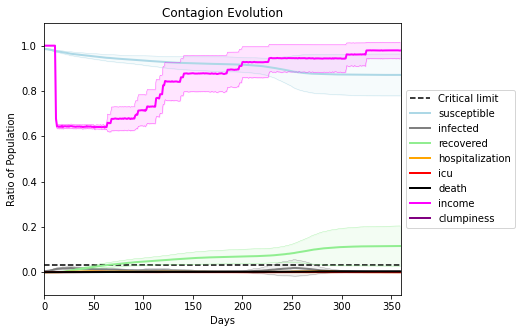

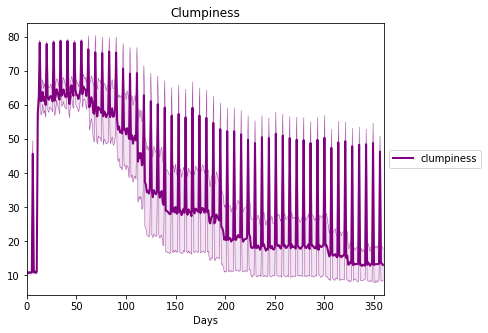

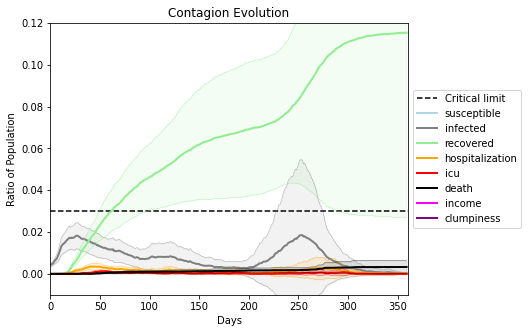

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.99", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[8556, 2851, 1992, 8550, 7376, 3166, 7006, 718, 4482, 8324, 488, 6497, 1780, 9466, 4944, 3499, 9954, 8824, 4468, 3995]
Average similarity between family members is 0.9564429215517952 at temperature -0.98
Average similarity between family and home is 0.9998995338888391 at temperature -1
Average similarity between students and their classroom is 0.4075565984569295 at temperature -0.98
Average classroom occupancy is 11.625 and number classrooms is 24
Average similarity between workers is 0.7598078177303216 at temperature -0.98
Average office occupancy is 10.181818181818182 and number offices is 66
Average friend similarity for adults: 0.862611312300118 for kids: 0.6279118210613842
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuil

avg restaurant similarity 0.11781441754251115
disconnects
0.0
clumpiness 9.79
avg restaurant similarity 0.3973874395258425
disconnects
0.0
clumpiness 9.64
avg restaurant similarity 0.3537095371222622
disconnects
0.0
clumpiness 10.03
avg restaurant similarity 0.2976626804376962
disconnects
0.0
clumpiness 9.82
avg restaurant similarity 0.32306855182191624
disconnects
0.0
clumpiness 9.79
avg restaurant similarity 0.24257294855117856
disconnects
0.0
clumpiness 9.92
avg restaurant similarity 0.13732390511814882
disconnects
0.52
clumpiness 47.15
avg restaurant similarity 0.27867232767390193
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.17809400134824635
disconnects
0.0
clumpiness 9.79
avg restaurant similarity 0.22159366049501053
disconnects
0.0
clumpiness 9.95
avg restaurant similarity 0.28705739310982115
disconnects
0.0
clumpiness 10.32
avg restaurant similarity 0.2804850327068958
disconnects
0.57
clumpiness 54.39
avg restaurant similarity 0.41152985211306836
disconnects
0.64

disconnects
0.7
clumpiness 60.49
avg restaurant similarity 0.23826641693007727
disconnects
0.98
clumpiness 78.59
avg restaurant similarity 0.1373678216755686
disconnects
0.65
clumpiness 57.87
avg restaurant similarity 0.39861410109793327
disconnects
0.73
clumpiness 62.66
avg restaurant similarity 0.2645118601318855
disconnects
0.55
clumpiness 51.65
avg restaurant similarity 0.43271698917322693
disconnects
0.67
clumpiness 59.05
avg restaurant similarity 0.2931497484505488
disconnects
0.62
clumpiness 55.68
avg restaurant similarity 0.19637220500201635
disconnects
0.75
clumpiness 64.14
avg restaurant similarity 0.2908296268994081
disconnects
0.97
clumpiness 77.76
avg restaurant similarity 0.33431413769167323
disconnects
0.82
clumpiness 68.37
avg restaurant similarity 0.4371362401139601
disconnects
0.67
clumpiness 58.8
avg restaurant similarity 0.4006215952672002
disconnects
0.66
clumpiness 58.33
avg restaurant similarity 0.1665462914678768
disconnects
0.58
clumpiness 53.38
avg restaurant 

disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.2036407147298266
disconnects
0.57
clumpiness 50.58
avg restaurant similarity 0.3445284067420403
disconnects
0.0
clumpiness 9.98
avg restaurant similarity 0.42009953074888357
disconnects
0.0
clumpiness 9.99
avg restaurant similarity 0.2006238124618297
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.3744940341868171
disconnects
0.0
clumpiness 9.94
avg restaurant similarity 0.10924823080158515
disconnects
0.0
clumpiness 9.87
avg restaurant similarity 0.3825614804196833
disconnects
0.0
clumpiness 10.14
avg restaurant similarity 0.349132845490072
disconnects
0.54
clumpiness 48.87
avg restaurant similarity 0.17345388831033648
disconnects
0.0
clumpiness 9.98
avg restaurant similarity 0.19023745849336535
disconnects
0.0
clumpiness 9.68
avg restaurant similarity 0.4047910426882447
disconnects
0.0
clumpiness 9.92
avg restaurant similarity 0.1886742289738877
disconnects
0.0
clumpiness 10.12
avg restaurant similarity 0.3387980

avg restaurant similarity 0.48597385680976285
disconnects
0.52
clumpiness 47.05
avg restaurant similarity 0.26696920013194586
disconnects
0.0
clumpiness 9.86
avg restaurant similarity 0.24018619576228264
disconnects
0.0
clumpiness 10.04
avg restaurant similarity 0.2047957300591739
disconnects
0.0
clumpiness 9.99
avg restaurant similarity 0.3122249400143411
disconnects
0.0
clumpiness 10.0
avg restaurant similarity 0.3013949569286557
disconnects
0.0
clumpiness 10.59
avg restaurant similarity 0.19948767800257555
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.21539340158796436
disconnects
0.52
clumpiness 47.53
avg restaurant similarity 0.2765353669264463
disconnects
0.0
clumpiness 9.89
avg restaurant similarity 0.24938563190338772
disconnects
0.0
clumpiness 10.07
avg restaurant similarity 0.2760612753441764
disconnects
0.0
clumpiness 9.97
avg restaurant similarity 0.37779173305226904
disconnects
0.0
clumpiness 9.99
avg restaurant similarity 0.3878062120591599
disconnects
0.0
cl

avg restaurant similarity 0.22697629691912768
disconnects
0.0
clumpiness 9.63
avg restaurant similarity 0.2648346948942994
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.14459611619736817
disconnects
0.0
clumpiness 9.66
avg restaurant similarity 0.25996440323411424
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.20470338038975178
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.09563469855956613
disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.2751698188481438
disconnects
0.49
clumpiness 44.8
avg restaurant similarity 0.1555587688677971
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.0900988569244802
disconnects
0.0
clumpiness 8.84
avg restaurant similarity 0.34075108670704035
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.18884612538434004
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.32489825596404115
disconnects
0.53
clumpiness 49.69
avg restaurant similarity 0.18539075401948976
disconnects
0.55
clu

disconnects
0.36
clumpiness 38.75
avg restaurant similarity 0.21265367554785822
disconnects
0.95
clumpiness 76.61
avg restaurant similarity 0.21801295440441087
disconnects
0.52
clumpiness 48.44
avg restaurant similarity 0.14100685940076507
disconnects
0.53
clumpiness 50.37
avg restaurant similarity 0.13908811007021932
disconnects
0.5
clumpiness 47.09
avg restaurant similarity 0.3272470555914252
disconnects
0.55
clumpiness 51.96
avg restaurant similarity 0.17380525680700556
disconnects
0.54
clumpiness 49.82
avg restaurant similarity 0.34498257823360956
disconnects
0.56
clumpiness 53.52
avg restaurant similarity 0.17841947287236268
disconnects
0.92
clumpiness 74.35
avg restaurant similarity 0.1532440390302611
disconnects
0.45
clumpiness 44.5
avg restaurant similarity 0.38959722064983987
disconnects
0.63
clumpiness 56.13
avg restaurant similarity 0.24063567492136378
disconnects
0.59
clumpiness 53.8
avg restaurant similarity 0.31019049479828736
disconnects
0.53
clumpiness 48.73
avg restaur

avg restaurant similarity 0.18768839886589198
disconnects
0.55
clumpiness 50.69
avg restaurant similarity 0.17181491685507333
disconnects
0.44
clumpiness 44.37
avg restaurant similarity 0.20758260765076958
disconnects
0.95
clumpiness 76.43
avg restaurant similarity 0.11299572746708918
disconnects
0.54
clumpiness 48.65
avg restaurant similarity 0.19238286362002072
disconnects
0.5
clumpiness 48.39
avg restaurant similarity 0.15190133261569091
disconnects
0.44
clumpiness 43.42
avg restaurant similarity 0.29231915682104725
disconnects
0.5
clumpiness 47.11
avg restaurant similarity 0.2663790095959772
disconnects
0.58
clumpiness 52.32
avg restaurant similarity 0.3344974985712139
disconnects
0.45
clumpiness 44.35
avg restaurant similarity 0.18826148818289237
disconnects
0.99
clumpiness 79.34
avg restaurant similarity 0.1782553526473097
disconnects
0.51
clumpiness 47.75
avg restaurant similarity 0.2215254772042425
disconnects
0.39
clumpiness 42.48
avg restaurant similarity 0.2885241816979925
d

disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.10115763866877236
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.21150286814741154
disconnects
0.5
clumpiness 46.09
avg restaurant similarity 0.36232870737592276
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.26249633510337234
disconnects
0.0
clumpiness 9.67
avg restaurant similarity 0.2631048176749984
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.15916946437061494
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.13997000733947465
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.1478446353901139
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.3131878039856134
disconnects
0.37
clumpiness 36.84
avg restaurant similarity 0.20320013453370794
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.32663977934021554
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.11457320700328984
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.20268

avg restaurant similarity 0.3784320275014568
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.19849880713643545
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.35813699663829424
disconnects
0.0
clumpiness 9.53
avg restaurant similarity 0.31075371025278364
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.36929296504436937
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.28299612113351247
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.2665098601780125
disconnects
0.49
clumpiness 46.11
avg restaurant similarity 0.14782345577043282
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.26261960795900896
disconnects
0.0
clumpiness 9.87
avg restaurant similarity 0.18862774524101286
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.11503973033739094
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.3357856340829645
disconnects
0.43
clumpiness 42.02
avg restaurant similarity 0.28207413505292966
disconnects
0.58


avg restaurant similarity 0.2162974271690327
disconnects
0.93
clumpiness 75.09
avg restaurant similarity 0.294261021442788
disconnects
0.5
clumpiness 47.52
avg restaurant similarity 0.1702667515366132
disconnects
0.59
clumpiness 52.91
avg restaurant similarity 0.3226397454499904
disconnects
0.56
clumpiness 52.14
avg restaurant similarity 0.352173594341705
disconnects
0.53
clumpiness 49.09
avg restaurant similarity 0.31301214334224214
disconnects
0.59
clumpiness 53.09
avg restaurant similarity 0.2916549531235158
disconnects
0.55
clumpiness 50.72
avg restaurant similarity 0.08151369359575959
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.2793698075952232
disconnects
0.46
clumpiness 44.32
avg restaurant similarity 0.19503241215105946
disconnects
0.54
clumpiness 50.06
avg restaurant similarity 0.2189917079966315
disconnects
0.58
clumpiness 51.62
avg restaurant similarity 0.24379279321391126
disconnects
0.44
clumpiness 44.98
avg restaurant similarity 0.19992439303847861
disco

avg restaurant similarity 0.32273751691211766
disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.36463850437349493
disconnects
0.34
clumpiness 36.07
avg restaurant similarity 0.2500815901406329
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.32906968239108686
disconnects
0.0
clumpiness 9.76
avg restaurant similarity 0.33931473527377776
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.37088269666906715
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.44352140341292406
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.20538818843513346
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.30768301540041076
disconnects
0.45
clumpiness 43.27
avg restaurant similarity 0.10514539731372083
disconnects
0.0
clumpiness 9.68
avg restaurant similarity 0.40151613536742614
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.19900697572173795
disconnects
0.0
clumpiness 9.79
avg restaurant similarity 0.2837271953796811
disconnects
0.0


disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.3494294737189722
disconnects
0.52
clumpiness 47.66
avg restaurant similarity 0.3722187092528227
disconnects
0.0
clumpiness 9.64
avg restaurant similarity 0.21158994438799544
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.20036628850402363
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.09539248487638996
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.21560304160058427
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.3085926624847216
disconnects
0.0
clumpiness 9.73
avg restaurant similarity 0.3291867218687252
disconnects
0.46
clumpiness 42.99
avg restaurant similarity 0.24538055557379415
disconnects
0.0
clumpiness 9.63
avg restaurant similarity 0.22554881710637942
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.2723814910168011
disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.21369021384550818
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.32979

avg restaurant similarity 0.24558205286682128
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.2265114059003411
disconnects
0.0
clumpiness 9.6
avg restaurant similarity 0.21766322368589966
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.21662863476608094
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.3028882328868446
disconnects
0.0
clumpiness 9.76
avg restaurant similarity 0.423735172161358
disconnects
0.0
clumpiness 10.13
avg restaurant similarity 0.3627830407502703
disconnects
0.4
clumpiness 39.4
avg restaurant similarity 0.26401108458144845
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.35593374275418865
disconnects
0.0
clumpiness 9.72
avg restaurant similarity 0.19633516683171612
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.23821579522802072
disconnects
0.0
clumpiness 10.14
avg restaurant similarity 0.2538587284938374
disconnects
0.4
clumpiness 41.85
avg restaurant similarity 0.29661716734303245
disconnects
0.46
clumpi

disconnects
0.48
clumpiness 45.96
avg restaurant similarity 0.218631321890269
disconnects
0.99
clumpiness 79.31
avg restaurant similarity 0.25038549652686765
disconnects
0.47
clumpiness 46.91
avg restaurant similarity 0.21747218025840837
disconnects
0.34
clumpiness 38.37
avg restaurant similarity 0.2299012479018378
disconnects
0.49
clumpiness 46.57
avg restaurant similarity 0.17323084435501307
disconnects
0.6
clumpiness 54.14
avg restaurant similarity 0.26260695207066986
disconnects
0.44
clumpiness 43.15
avg restaurant similarity 0.26784438108582
disconnects
0.55
clumpiness 51.11
avg restaurant similarity 0.32341283816504657
disconnects
0.94
clumpiness 76.09
avg restaurant similarity 0.2791347683337171
disconnects
0.4
clumpiness 41.12
avg restaurant similarity 0.31714111246034343
disconnects
0.52
clumpiness 49.23
avg restaurant similarity 0.14968976790321348
disconnects
0.48
clumpiness 47.98
avg restaurant similarity 0.28900599938716365
disconnects
0.48
clumpiness 49.98
avg restaurant 

disconnects
0.41
clumpiness 43.28
avg restaurant similarity 0.2402967577198502
disconnects
0.49
clumpiness 47.44
avg restaurant similarity 0.26972121962087264
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.27370150955600014
disconnects
0.47
clumpiness 47.43
avg restaurant similarity 0.30460714116117865
disconnects
0.44
clumpiness 44.45
avg restaurant similarity 0.241294160868438
disconnects
0.52
clumpiness 48.07
avg restaurant similarity 0.34964876547745316
disconnects
0.51
clumpiness 48.25
avg restaurant similarity 0.31319387677368427
disconnects
0.43
clumpiness 43.36
avg restaurant similarity 0.25049354875132784
disconnects
0.52
clumpiness 49.67
avg restaurant similarity 0.2514617418063787
disconnects
0.98
clumpiness 78.58
avg restaurant similarity 0.4221001343097675
disconnects
0.44
clumpiness 43.12
avg restaurant similarity 0.175097434946547
disconnects
0.44
clumpiness 44.28
avg restaurant similarity 0.19278349671277256
disconnects
0.52
clumpiness 48.96
avg restauran

disconnects
0.0
clumpiness 9.87
avg restaurant similarity 0.3035502848719916
disconnects
0.0
clumpiness 9.75
avg restaurant similarity 0.24383598339844165
disconnects
0.51
clumpiness 47.0
avg restaurant similarity 0.37465920530151514
disconnects
0.0
clumpiness 9.41
avg restaurant similarity 0.251443452640993
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.25706859174813546
disconnects
0.0
clumpiness 9.91
avg restaurant similarity 0.21275611619643786
disconnects
0.0
clumpiness 9.61
avg restaurant similarity 0.30740121157108113
disconnects
0.0
clumpiness 9.88
avg restaurant similarity 0.3586560241225874
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.28515940504888415
disconnects
0.48
clumpiness 44.95
avg restaurant similarity 0.26732324733992324
disconnects
0.0
clumpiness 9.41
avg restaurant similarity 0.2694740211798553
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.2500236720627379
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.3746465

avg restaurant similarity 0.11915814591512462
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.12858920294586038
disconnects
0.02
clumpiness 11.09
avg restaurant similarity 0.24691718765551396
disconnects
0.0
clumpiness 10.19
avg restaurant similarity 0.219290952249311
disconnects
0.0
clumpiness 9.89
avg restaurant similarity 0.2777873068389684
disconnects
0.02
clumpiness 11.15
avg restaurant similarity 0.3134130784890832
disconnects
0.0
clumpiness 9.91
avg restaurant similarity 0.26193016825397064
disconnects
0.58
clumpiness 51.37
avg restaurant similarity 0.38440747140414017
disconnects
0.04
clumpiness 12.78
avg restaurant similarity 0.32145388134417735
disconnects
0.02
clumpiness 11.25
avg restaurant similarity 0.30018211999862965
disconnects
0.02
clumpiness 10.64
avg restaurant similarity 0.1860269580461568
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.34578962239192457
disconnects
0.47
clumpiness 45.65
avg restaurant similarity 0.2817408613238775
disconnec

disconnects
0.53
clumpiness 50.27
avg restaurant similarity 0.35127476442722727
disconnects
0.96
clumpiness 77.25
avg restaurant similarity 0.310518482162083
disconnects
0.54
clumpiness 50.75
avg restaurant similarity 0.5007276140034367
disconnects
0.5
clumpiness 48.33
avg restaurant similarity 0.2987600040712351
disconnects
0.36
clumpiness 39.16
avg restaurant similarity 0.35838173478059426
disconnects
0.53
clumpiness 51.11
avg restaurant similarity 0.18397791703284622
disconnects
0.55
clumpiness 52.44
avg restaurant similarity 0.2777084995045198
disconnects
0.44
clumpiness 45.41
avg restaurant similarity 0.2458542672499232
disconnects
0.98
clumpiness 78.55
avg restaurant similarity 0.46284507108491507
disconnects
0.49
clumpiness 50.32
avg restaurant similarity 0.2221886791843103
disconnects
0.46
clumpiness 45.32
avg restaurant similarity 0.39618440748147565
disconnects
0.5
clumpiness 48.81
avg restaurant similarity 0.3879756912396614
disconnects
0.5
clumpiness 48.26
avg restaurant si

disconnects
0.65
clumpiness 57.51
avg restaurant similarity 0.2760234824234842
disconnects
0.42
clumpiness 43.87
avg restaurant similarity 0.18555007435784196
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.3375031842087396
disconnects
0.56
clumpiness 52.07
avg restaurant similarity 0.36464626594777183
disconnects
0.56
clumpiness 51.97
avg restaurant similarity 0.2930877529140924
disconnects
0.66
clumpiness 58.58
avg restaurant similarity 0.397273887147448
disconnects
0.55
clumpiness 50.96
avg restaurant similarity 0.310372083955083
disconnects
0.47
clumpiness 45.74
avg restaurant similarity 0.33595440250260433
disconnects
0.46
clumpiness 45.31
avg restaurant similarity 0.3240903648742574
disconnects
0.97
clumpiness 77.91
avg restaurant similarity 0.3925968339905754
disconnects
0.53
clumpiness 51.27
avg restaurant similarity 0.3607820731313923
disconnects
0.52
clumpiness 50.72
avg restaurant similarity 0.3434207411899874
disconnects
0.46
clumpiness 45.82
avg restaurant si

disconnects
0.62
clumpiness 55.77
avg restaurant similarity 0.33587577535934143
disconnects
0.55
clumpiness 52.63
avg restaurant similarity 0.3852516785694367
disconnects
0.55
clumpiness 53.5
avg restaurant similarity 0.43181046804715495
disconnects
0.95
clumpiness 76.41
avg restaurant similarity 0.30030348924048345
disconnects
0.49
clumpiness 49.07
avg restaurant similarity 0.3306948308293393
disconnects
0.52
clumpiness 48.08
avg restaurant similarity 0.251701979715005
disconnects
0.57
clumpiness 53.17
avg restaurant similarity 0.2646300844854483
disconnects
0.5
clumpiness 47.44
avg restaurant similarity 0.41803556256824626
disconnects
0.83
clumpiness 69.45
avg restaurant similarity 0.5553652490658494
disconnects
0.64
clumpiness 57.89
avg restaurant similarity 0.411088146576703
disconnects
0.97
clumpiness 77.88
avg restaurant similarity 0.3559744648801433
disconnects
0.52
clumpiness 48.61
avg restaurant similarity 0.2536311246797805
disconnects
0.54
clumpiness 51.88
avg restaurant sim

avg restaurant similarity 0.21508686566506466
disconnects
0.0
clumpiness 9.77
avg restaurant similarity 0.16892987913106078
disconnects
0.0
clumpiness 9.77
avg restaurant similarity 0.06569856293128293
disconnects
0.01
clumpiness 9.97
avg restaurant similarity 0.1727785711373234
disconnects
0.01
clumpiness 10.7
avg restaurant similarity 0.21183893467561024
disconnects
0.02
clumpiness 11.08
avg restaurant similarity 0.21106744520450138
disconnects
0.0
clumpiness 9.46
avg restaurant similarity 0.20110914156768636
disconnects
0.49
clumpiness 46.9
avg restaurant similarity 0.08783550057702137
disconnects
0.01
clumpiness 10.21
avg restaurant similarity 0.15977004338268594
disconnects
0.0
clumpiness 9.67
avg restaurant similarity 0.2542668928067033
disconnects
0.0
clumpiness 9.95
avg restaurant similarity 0.27080785101268445
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.25021044393372893
disconnects
0.53
clumpiness 48.93
avg restaurant similarity 0.21134019737087353
disconnects

disconnects
0.62
clumpiness 57.06
avg restaurant similarity 0.20550089639711636
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.27134461656916364
disconnects
0.65
clumpiness 57.83
avg restaurant similarity 0.11529289654587664
disconnects
0.6
clumpiness 54.34
avg restaurant similarity 0.06875067514792549
disconnects
0.62
clumpiness 56.19
avg restaurant similarity 0.18838710121907618
disconnects
0.63
clumpiness 55.91
avg restaurant similarity 0.19479672458534134
disconnects
0.52
clumpiness 49.9
avg restaurant similarity 0.20682807600560052
disconnects
0.62
clumpiness 55.94
avg restaurant similarity 0.2333740732892527
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.2285997422770877
disconnects
0.61
clumpiness 54.84
avg restaurant similarity 0.1440521472740563
disconnects
0.66
clumpiness 57.71
avg restaurant similarity 0.18204937026476864
disconnects
0.63
clumpiness 56.37
avg restaurant similarity 0.16620677037120776
disconnects
0.62
clumpiness 55.62
avg restauran

disconnects
0.0
clumpiness 9.54
avg restaurant similarity 0.21228915919526287
disconnects
0.02
clumpiness 10.51
avg restaurant similarity 0.31602920434885007
disconnects
0.5
clumpiness 46.01
avg restaurant similarity 0.35053783338028344
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.18921854608411268
disconnects
0.0
clumpiness 9.78
avg restaurant similarity 0.2410614698892495
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.45368138828836996
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.17976177943160668
disconnects
0.0
clumpiness 9.54
avg restaurant similarity 0.40074173970614035
disconnects
0.0
clumpiness 10.01
avg restaurant similarity 0.16414114088655765
disconnects
0.58
clumpiness 51.5
avg restaurant similarity 0.29053560280216256
disconnects
0.0
clumpiness 10.6
avg restaurant similarity 0.14304179065826036
disconnects
0.01
clumpiness 10.15
avg restaurant similarity 0.30054466269115815
disconnects
0.02
clumpiness 10.72
avg restaurant similarit

avg restaurant similarity 0.2722058467277278
disconnects
0.0
clumpiness 9.44
avg restaurant similarity 0.24749506403672866
disconnects
0.0
clumpiness 9.72
avg restaurant similarity 0.32615382377723023
disconnects
0.57
clumpiness 51.98
avg restaurant similarity 0.252381808086273
disconnects
0.0
clumpiness 9.87
avg restaurant similarity 0.10133047196040458
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.20682612191299674
disconnects
0.01
clumpiness 9.92
avg restaurant similarity 0.3526995073139287
disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.23672955218995614
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.18194221352569442
disconnects
0.0
clumpiness 9.44
avg restaurant similarity 0.10806154227770735
disconnects
0.56
clumpiness 50.86
avg restaurant similarity 0.1401250105551669
disconnects
0.01
clumpiness 10.01
avg restaurant similarity 0.2378566236891068
disconnects
0.02
clumpiness 11.31
avg restaurant similarity 0.23329335086591016
disconnects
0.0

avg restaurant similarity 0.31816779805550527
disconnects
0.0
clumpiness 10.73
avg restaurant similarity 0.1437913174097013
disconnects
0.0
clumpiness 10.16
avg restaurant similarity 0.2976248755582539
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.584123656777456
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.2334768727755711
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.09573639764027311
disconnects
0.0
clumpiness 10.51
avg restaurant similarity 0.28984950999338915
disconnects
0.79
clumpiness 66.78
avg restaurant similarity 0.45316686568667386
disconnects
0.01
clumpiness 11.06
avg restaurant similarity 0.10450475602685057
disconnects
0.0
clumpiness 9.54
avg restaurant similarity 0.14054660983078376
disconnects
0.0
clumpiness 10.85
avg restaurant similarity 0.27209093994476286
disconnects
0.0
clumpiness 10.76
avg restaurant similarity 0.4145582685831497
disconnects
0.55
clumpiness 52.46
avg restaurant similarity 0.41068149321481656
disconnects

disconnects
0.66
clumpiness 59.98
avg restaurant similarity 0.3365241967574025
disconnects
0.98
clumpiness 78.47
avg restaurant similarity 0.08215899000761268
disconnects
0.63
clumpiness 58.41
avg restaurant similarity 0.40562958950630146
disconnects
0.56
clumpiness 52.64
avg restaurant similarity 0.4442888898324333
disconnects
0.6
clumpiness 55.56
avg restaurant similarity 0.2698523892801714
disconnects
0.63
clumpiness 59.37
avg restaurant similarity 0.5181615734090792
disconnects
0.59
clumpiness 56.17
avg restaurant similarity 0.24183655900659762
disconnects
0.54
clumpiness 55.03
avg restaurant similarity 0.23071491321420468
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.4322665914601238
disconnects
0.66
clumpiness 62.17
avg restaurant similarity 0.18654206072503185
disconnects
0.76
clumpiness 65.93
avg restaurant similarity 0.13228151149487705
disconnects
0.58
clumpiness 55.47
avg restaurant similarity 0.24019996153550108
disconnects
0.67
clumpiness 59.41
avg restaura

disconnects
0.45
clumpiness 47.49
avg restaurant similarity 0.2073436422240981
disconnects
0.64
clumpiness 58.77
avg restaurant similarity 0.4411562465662092
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.15788086640289134
disconnects
0.68
clumpiness 61.08
avg restaurant similarity 0.2833890962268023
disconnects
0.61
clumpiness 56.24
avg restaurant similarity 0.36717665782199954
disconnects
0.6
clumpiness 55.29
avg restaurant similarity 0.14247656289937682
disconnects
0.72
clumpiness 66.27
avg restaurant similarity 0.15601523232846232
disconnects
0.63
clumpiness 59.9
avg restaurant similarity 0.46346518964569416
disconnects
0.78
clumpiness 67.29
avg restaurant similarity 0.10509434197936073
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.250530009806622
disconnects
0.71
clumpiness 62.23
avg restaurant similarity 0.3302940116095781
disconnects
0.69
clumpiness 62.21
avg restaurant similarity 0.2786520495975767
disconnects
0.68
clumpiness 60.95
avg restaurant simi

disconnects
0.0
clumpiness 10.83
avg restaurant similarity 0.23266305078399915
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.3820626823405019
disconnects
0.0
clumpiness 10.3
avg restaurant similarity 0.2167755008273114
disconnects
0.51
clumpiness 47.98
avg restaurant similarity 0.4380037511159429
disconnects
0.0
clumpiness 10.58
avg restaurant similarity 0.382853100160817
disconnects
0.02
clumpiness 11.86
avg restaurant similarity 0.32632038451253037
disconnects
0.0
clumpiness 10.35
avg restaurant similarity 0.5618848226448045
disconnects
0.0
clumpiness 11.19
avg restaurant similarity 0.369651283574321
disconnects
0.0
clumpiness 10.27
avg restaurant similarity 0.5253921674730889
disconnects
0.0
clumpiness 10.57
avg restaurant similarity 0.06296861064149219
disconnects
0.66
clumpiness 56.9
avg restaurant similarity 0.2955735358024038
disconnects
0.0
clumpiness 10.93
avg restaurant similarity 0.19307549321774675
disconnects
0.0
clumpiness 10.06
avg restaurant similarity 0.

avg restaurant similarity 0.20421689831213377
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.2643553109211084
disconnects
0.01
clumpiness 10.3
avg restaurant similarity 0.14165774845256557
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.16063252980804274
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.26629002200692525
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.27301485223912325
disconnects
0.02
clumpiness 10.85
avg restaurant similarity 0.4163214086557148
disconnects
0.43
clumpiness 40.86
avg restaurant similarity 0.29481016880773936
disconnects
0.0
clumpiness 9.53
avg restaurant similarity 0.24744291441135308
disconnects
0.01
clumpiness 9.9
avg restaurant similarity 0.37224473376681855
disconnects
0.02
clumpiness 10.48
avg restaurant similarity 0.1287607961209715
disconnects
0.01
clumpiness 9.71
avg restaurant similarity 0.30947582935504536
disconnects
0.55
clumpiness 50.03
avg restaurant similarity 0.2361726171678522
disconnects


disconnects
0.51
clumpiness 48.4
avg restaurant similarity 0.3066990670373714
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.0800135460167211
disconnects
0.57
clumpiness 51.73
avg restaurant similarity 0.18026140991036296
disconnects
0.49
clumpiness 49.01
avg restaurant similarity 0.07290356948252667
disconnects
0.68
clumpiness 59.23
avg restaurant similarity 0.19115101455286998
disconnects
0.53
clumpiness 50.42
avg restaurant similarity 0.33611843935026675
disconnects
0.55
clumpiness 51.73
avg restaurant similarity 0.185525624559473
disconnects
0.55
clumpiness 51.15
avg restaurant similarity 0.1605887330798474
disconnects
0.98
clumpiness 78.59
avg restaurant similarity 0.24989927982915436
disconnects
0.62
clumpiness 56.07
avg restaurant similarity 0.27923502226626506
disconnects
0.49
clumpiness 49.67
avg restaurant similarity 0.2252977030399057
disconnects
0.01
clumpiness 10.18
avg restaurant similarity 0.23793043783152873
disconnects
0.01
clumpiness 10.29
avg restauran

disconnects
0.01
clumpiness 9.66
avg restaurant similarity 0.3081765561288246
disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.1598704379805523
disconnects
0.48
clumpiness 44.61
avg restaurant similarity 0.11533374388886158
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.37304129159947963
disconnects
0.01
clumpiness 9.86
avg restaurant similarity 0.37637459015761865
disconnects
0.0
clumpiness 9.6
avg restaurant similarity 0.17371480339828008
disconnects
0.01
clumpiness 10.43
avg restaurant similarity 0.31523602908451637
disconnects
0.01
clumpiness 10.15
avg restaurant similarity 0.3863251956505296
disconnects
0.01
clumpiness 10.2
avg restaurant similarity 0.2628954934382483
disconnects
0.42
clumpiness 40.59
avg restaurant similarity 0.17132386562758598
disconnects
0.01
clumpiness 9.93
avg restaurant similarity 0.26426656856924596
disconnects
0.0
clumpiness 9.63
avg restaurant similarity 0.27273447787422195
disconnects
0.01
clumpiness 10.61
avg restaurant similari

avg restaurant similarity 0.3125169628600191
disconnects
0.03
clumpiness 11.04
avg restaurant similarity 0.10392264467976539
disconnects
0.02
clumpiness 11.07
avg restaurant similarity 0.16522129690823548
disconnects
0.46
clumpiness 43.45
avg restaurant similarity 0.3905216566425927
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.2079413252134937
disconnects
0.02
clumpiness 10.47
avg restaurant similarity 0.3507901852053041
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.21817101272429243
disconnects
0.02
clumpiness 11.46
avg restaurant similarity 0.20955875428267318
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.16332232700355123
disconnects
0.01
clumpiness 9.92
avg restaurant similarity 0.29574964914621443
disconnects
0.46
clumpiness 43.89
avg restaurant similarity 0.18997274417132323
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.2963201050376105
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.20119445294673785
disconnect

avg restaurant similarity 0.12032757263264376
disconnects
0.0
clumpiness 9.93
avg restaurant similarity 0.24056039767280954
disconnects
0.0
clumpiness 9.67
avg restaurant similarity 0.24344318538039145
disconnects
0.0
clumpiness 9.67
avg restaurant similarity 0.08461210961661933
disconnects
0.0
clumpiness 9.85
avg restaurant similarity 0.15430458260047097
disconnects
0.01
clumpiness 10.58
avg restaurant similarity 0.21834743714465074
disconnects
0.02
clumpiness 10.91
avg restaurant similarity 0.1577938012483648
disconnects
0.5
clumpiness 47.58
avg restaurant similarity 0.3586329952756184
disconnects
0.01
clumpiness 10.69
avg restaurant similarity 0.20437042295979904
disconnects
0.0
clumpiness 10.17
avg restaurant similarity 0.18550117632531518
disconnects
0.0
clumpiness 9.88
avg restaurant similarity 0.21287508913122352
disconnects
0.02
clumpiness 11.34
avg restaurant similarity 0.1361466632390743
disconnects
0.46
clumpiness 46.49
avg restaurant similarity 0.007950885961112188
disconne

disconnects
0.33
clumpiness 39.04
avg restaurant similarity 0.2695724889943131
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3211186317090571
disconnects
0.51
clumpiness 50.84
avg restaurant similarity 0.22023363092875797
disconnects
0.58
clumpiness 54.35
avg restaurant similarity 0.22537582531328804
disconnects
0.59
clumpiness 55.4
avg restaurant similarity 0.2840939451386208
disconnects
0.53
clumpiness 50.09
avg restaurant similarity 0.13747920577949183
disconnects
0.54
clumpiness 51.89
avg restaurant similarity 0.1742670991549311
disconnects
0.67
clumpiness 59.83
avg restaurant similarity 0.215605148612526
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.12156712238504763
disconnects
0.52
clumpiness 51.48
avg restaurant similarity 0.12461098919961729
disconnects
0.59
clumpiness 54.76
avg restaurant similarity 0.15066537865188506
disconnects
0.56
clumpiness 52.6
avg restaurant similarity 0.3440764797729925
disconnects
0.52
clumpiness 51.58
avg restaurant si

disconnects
0.0
clumpiness 9.77
avg restaurant similarity 0.277746247728673
disconnects
0.03
clumpiness 11.8
avg restaurant similarity 0.30715786102294423
disconnects
0.49
clumpiness 45.74
avg restaurant similarity 0.18240207929858765
disconnects
0.01
clumpiness 10.39
avg restaurant similarity 0.3641410556331648
disconnects
0.02
clumpiness 10.79
avg restaurant similarity 0.06289351845203969
disconnects
0.02
clumpiness 10.82
avg restaurant similarity 0.16334957605807665
disconnects
0.02
clumpiness 11.2
avg restaurant similarity 0.2357103089680623
disconnects
0.0
clumpiness 9.98
avg restaurant similarity 0.1583336455695475
disconnects
0.02
clumpiness 10.86
avg restaurant similarity 0.23083920126568738
disconnects
0.52
clumpiness 49.26
avg restaurant similarity 0.17669262809139788
disconnects
0.03
clumpiness 11.46
avg restaurant similarity 0.18419325651103688
disconnects
0.01
clumpiness 10.13
avg restaurant similarity 0.3579931210610337
disconnects
0.02
clumpiness 10.84
avg restaurant sim

disconnects
0.01
clumpiness 10.52
avg restaurant similarity 0.19663192473413113
disconnects
0.01
clumpiness 10.71
avg restaurant similarity 0.17913313597345437
disconnects
0.02
clumpiness 11.08
avg restaurant similarity 0.18529623584380361
disconnects
0.58
clumpiness 52.14
avg restaurant similarity 0.27241909165750305
disconnects
0.0
clumpiness 10.19
avg restaurant similarity 0.26884002799102136
disconnects
0.01
clumpiness 10.12
avg restaurant similarity 0.18857973336733433
disconnects
0.01
clumpiness 10.25
avg restaurant similarity 0.47133588256362985
disconnects
0.02
clumpiness 11.43
avg restaurant similarity 0.20657674021407924
disconnects
0.0
clumpiness 9.99
avg restaurant similarity 0.23641864824966205
disconnects
0.02
clumpiness 11.42
avg restaurant similarity 0.1417785395314338
disconnects
0.54
clumpiness 49.54
avg restaurant similarity 0.23751664879076237
disconnects
0.02
clumpiness 10.88
avg restaurant similarity 0.2234805648658143
disconnects
0.0
clumpiness 9.65
avg restauran

avg restaurant similarity 0.30494811796023913
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.33965436739347643
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.31689454081400475
disconnects
0.0
clumpiness 9.6
avg restaurant similarity 0.27564315414366825
disconnects
0.0
clumpiness 9.94
avg restaurant similarity 0.24812737813158964
disconnects
0.0
clumpiness 8.69
avg restaurant similarity 0.3751129025735548
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.2885415201984843
disconnects
0.54
clumpiness 48.76
avg restaurant similarity 0.42982848247097843
disconnects
0.0
clumpiness 9.81
avg restaurant similarity 0.23278542757438087
disconnects
0.0
clumpiness 9.18
avg restaurant similarity 0.3019190718261112
disconnects
0.0
clumpiness 9.71
avg restaurant similarity 0.34332445998376493
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.3069918273738229
disconnects
0.46
clumpiness 44.33
avg restaurant similarity 0.2664800295597915
disconnects
0.63
clu

disconnects
0.5
clumpiness 47.45
avg restaurant similarity 0.22887540915870375
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.3429215130601571
disconnects
0.6
clumpiness 53.85
avg restaurant similarity 0.20966514412425843
disconnects
0.53
clumpiness 49.26
avg restaurant similarity 0.31610327161295004
disconnects
0.49
clumpiness 46.76
avg restaurant similarity 0.19898858285643553
disconnects
0.52
clumpiness 48.59
avg restaurant similarity 0.26149344123325924
disconnects
0.43
clumpiness 42.21
avg restaurant similarity 0.269331395789606
disconnects
0.37
clumpiness 38.74
avg restaurant similarity 0.2174113782604615
disconnects
0.97
clumpiness 77.72
avg restaurant similarity 0.29197603626304
disconnects
0.43
clumpiness 43.33
avg restaurant similarity 0.13247028517597104
disconnects
0.52
clumpiness 48.44
avg restaurant similarity 0.29377591306588857
disconnects
0.6
clumpiness 53.51
avg restaurant similarity 0.23718434039824396
disconnects
0.47
clumpiness 45.54
avg restaurant sim

disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.23241487956058074
disconnects
0.52
clumpiness 47.44
avg restaurant similarity 0.2477869697399434
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.3628581866046969
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.21410834674777882
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.2935321393673246
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.1894801929401478
disconnects
0.0
clumpiness 9.63
avg restaurant similarity 0.18212666834073943
disconnects
0.0
clumpiness 9.62
avg restaurant similarity 0.3155982861285613
disconnects
0.56
clumpiness 50.66
avg restaurant similarity 0.2724864013355183
disconnects
0.0
clumpiness 9.72
avg restaurant similarity 0.19194496684540902
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.35680494444152294
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.19734393226272423
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.2441955

disconnects
0.64
clumpiness 55.18
avg restaurant similarity 0.36381828390949544
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.3573442187317019
disconnects
0.0
clumpiness 9.7
avg restaurant similarity 0.40752977408154634
disconnects
0.0
clumpiness 9.99
avg restaurant similarity 0.2863447169398964
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.27742082216807207
disconnects
0.0
clumpiness 9.97
avg restaurant similarity 0.21212163471906376
disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.2530858262713518
disconnects
0.54
clumpiness 48.98
avg restaurant similarity 0.14599665703197212
disconnects
0.0
clumpiness 9.66
avg restaurant similarity 0.24271817305441165
disconnects
0.0
clumpiness 9.07
avg restaurant similarity 0.232525783522017
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.3506613754735825
disconnects
0.0
clumpiness 9.6
avg restaurant similarity 0.35354332525753696
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.17559909

avg restaurant similarity 0.24859763206271948
disconnects
0.01
clumpiness 10.98
avg restaurant similarity 0.2434388829666489
disconnects
0.01
clumpiness 10.35
avg restaurant similarity 0.24412067611765473
disconnects
0.01
clumpiness 10.44
avg restaurant similarity 0.16588235622658343
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.268141015543881
disconnects
0.0
clumpiness 10.0
avg restaurant similarity 0.37598230403374033
disconnects
0.01
clumpiness 10.72
avg restaurant similarity 0.10896909678676214
disconnects
0.59
clumpiness 52.06
avg restaurant similarity 0.2312005593253828
disconnects
0.03
clumpiness 11.6
avg restaurant similarity 0.1560077889106262
disconnects
0.0
clumpiness 9.07
avg restaurant similarity 0.33855626606632516
disconnects
0.02
clumpiness 11.37
avg restaurant similarity 0.36099882027836633
disconnects
0.01
clumpiness 10.68
avg restaurant similarity 0.35078489106979505
disconnects
0.49
clumpiness 47.28
avg restaurant similarity 0.17421610686825947
discon

avg restaurant similarity 0.2083617585937657
disconnects
0.95
clumpiness 76.39
avg restaurant similarity 0.18780818561164447
disconnects
0.61
clumpiness 54.4
avg restaurant similarity 0.27696752914445016
disconnects
0.58
clumpiness 52.54
avg restaurant similarity 0.2352720528425154
disconnects
0.62
clumpiness 56.45
avg restaurant similarity 0.31251005973485513
disconnects
0.65
clumpiness 58.55
avg restaurant similarity 0.180500229342935
disconnects
0.69
clumpiness 59.12
avg restaurant similarity 0.309499744131528
disconnects
0.53
clumpiness 49.4
avg restaurant similarity 0.18406690704964224
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.27217282366455275
disconnects
0.54
clumpiness 50.61
avg restaurant similarity 0.17414428911478233
disconnects
0.54
clumpiness 50.77
avg restaurant similarity 0.33903081217139197
disconnects
0.55
clumpiness 50.59
avg restaurant similarity 0.17345238800185725
disconnects
0.53
clumpiness 51.3
avg restaurant similarity 0.18375972293723417
dis

avg restaurant similarity 0.02107040106152839
disconnects
0.01
clumpiness 10.17
avg restaurant similarity 0.09910424172070681
disconnects
0.56
clumpiness 50.32
avg restaurant similarity 0.1243274498276139
disconnects
0.01
clumpiness 10.31
avg restaurant similarity 0.1862505886264631
disconnects
0.02
clumpiness 11.8
avg restaurant similarity 0.08210545455640743
disconnects
0.0
clumpiness 9.72
avg restaurant similarity 0.4605893031867058
disconnects
0.0
clumpiness 9.82
avg restaurant similarity 0.22697403815158898
disconnects
0.01
clumpiness 10.74
avg restaurant similarity 0.264207538046508
disconnects
0.0
clumpiness 9.95
avg restaurant similarity 0.241049045389275
disconnects
0.61
clumpiness 53.49
avg restaurant similarity 0.14566382463363595
disconnects
0.0
clumpiness 10.31
avg restaurant similarity 0.25499045662126707
disconnects
0.03
clumpiness 11.18
avg restaurant similarity 0.22264265185315738
disconnects
0.02
clumpiness 11.33
avg restaurant similarity 0.1579726747977112
disconnect

avg restaurant similarity 0.1538765747397806
disconnects
0.01
clumpiness 10.6
avg restaurant similarity 0.11952237738655898
disconnects
0.0
clumpiness 9.84
avg restaurant similarity 0.08918056769266697
disconnects
0.58
clumpiness 51.66
avg restaurant similarity 0.18160250032798533
disconnects
0.02
clumpiness 11.04
avg restaurant similarity 0.12516328601845345
disconnects
0.0
clumpiness 9.92
avg restaurant similarity 0.18021075734181985
disconnects
0.0
clumpiness 9.82
avg restaurant similarity 0.14001785755503127
disconnects
0.02
clumpiness 11.43
avg restaurant similarity 0.09258520321717312
disconnects
0.02
clumpiness 10.78
avg restaurant similarity 0.3762391227110297
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.1777573212326528
disconnects
0.55
clumpiness 49.58
avg restaurant similarity 0.10945589798770511
disconnects
0.02
clumpiness 11.23
avg restaurant similarity 0.27251033690084225
disconnects
0.0
clumpiness 9.73
avg restaurant similarity 0.23039083712507058
disconne

avg restaurant similarity 0.20430471189644694
disconnects
0.02
clumpiness 10.96
avg restaurant similarity 0.2508853422117775
disconnects
0.03
clumpiness 11.61
avg restaurant similarity 0.24719190221279072
disconnects
0.02
clumpiness 10.7
avg restaurant similarity 0.28513303517401467
disconnects
0.03
clumpiness 11.71
avg restaurant similarity 0.23003000169616764
disconnects
0.01
clumpiness 10.19
avg restaurant similarity 0.26275188472090083
disconnects
0.01
clumpiness 9.93
avg restaurant similarity 0.35817099936857666
disconnects
0.45
clumpiness 42.57
avg restaurant similarity 0.26421830682540076
disconnects
0.03
clumpiness 11.71
avg restaurant similarity 0.26462835785092365
disconnects
0.01
clumpiness 10.54
avg restaurant similarity 0.2039787458612833
disconnects
0.02
clumpiness 11.04
avg restaurant similarity 0.2714398047705345
disconnects
0.0
clumpiness 9.77
avg restaurant similarity 0.22651209714552767
disconnects
0.38
clumpiness 40.24
avg restaurant similarity 0.27649588223228705
d

disconnects
0.49
clumpiness 47.55
avg restaurant similarity 0.24444605039430767
disconnects
0.95
clumpiness 76.59
avg restaurant similarity 0.22574117199230542
disconnects
0.42
clumpiness 42.29
avg restaurant similarity 0.196019542723097
disconnects
0.44
clumpiness 42.54
avg restaurant similarity 0.2003009547673768
disconnects
0.47
clumpiness 45.59
avg restaurant similarity 0.2643519363375208
disconnects
0.5
clumpiness 47.12
avg restaurant similarity 0.24964238887233153
disconnects
0.46
clumpiness 45.13
avg restaurant similarity 0.19114706480799493
disconnects
0.39
clumpiness 39.21
avg restaurant similarity 0.1630613177110172
disconnects
0.91
clumpiness 73.67
avg restaurant similarity 0.1863797422108724
disconnects
0.53
clumpiness 49.47
avg restaurant similarity 0.2057505700440041
disconnects
0.42
clumpiness 41.81
avg restaurant similarity 0.3367616193930606
disconnects
0.48
clumpiness 46.38
avg restaurant similarity 0.30726787129035016
disconnects
0.5
clumpiness 47.23
avg restaurant s

avg restaurant similarity 0.24539342461324262
disconnects
0.49
clumpiness 46.65
avg restaurant similarity 0.12912945310284155
disconnects
0.46
clumpiness 44.25
avg restaurant similarity 0.2598698554751975
disconnects
0.95
clumpiness 76.41
avg restaurant similarity 0.16313650863257698
disconnects
0.51
clumpiness 48.2
avg restaurant similarity 0.26139488044141007
disconnects
0.47
clumpiness 47.14
avg restaurant similarity 0.23280933224705663
disconnects
0.42
clumpiness 42.54
avg restaurant similarity 0.21486634977555386
disconnects
0.5
clumpiness 46.69
avg restaurant similarity 0.13667180369635554
disconnects
0.48
clumpiness 46.17
avg restaurant similarity 0.24807194927205917
disconnects
0.58
clumpiness 52.01
avg restaurant similarity 0.17276397921708483
disconnects
0.96
clumpiness 77.08
avg restaurant similarity 0.3310403492631928
disconnects
0.44
clumpiness 43.65
avg restaurant similarity 0.20867667279383248
disconnects
0.45
clumpiness 43.94
avg restaurant similarity 0.3014050380844328

disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.19245878768769276
disconnects
0.01
clumpiness 10.38
avg restaurant similarity 0.15704770257539996
disconnects
0.0
clumpiness 9.99
avg restaurant similarity 0.15826826362751675
disconnects
0.01
clumpiness 9.97
avg restaurant similarity 0.17778983214300506
disconnects
0.42
clumpiness 41.02
avg restaurant similarity 0.182028842847765
disconnects
0.01
clumpiness 10.09
avg restaurant similarity 0.2144970352175968
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.26092233020009165
disconnects
0.01
clumpiness 10.26
avg restaurant similarity 0.3228321266745165
disconnects
0.04
clumpiness 12.27
avg restaurant similarity 0.2721892658202579
disconnects
0.02
clumpiness 10.88
avg restaurant similarity 0.24429213356616325
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.17709195479926096
disconnects
0.35
clumpiness 35.5
avg restaurant similarity 0.4003728798513057
disconnects
0.02
clumpiness 10.74
avg restaurant similar

avg restaurant similarity 0.32253128152682775
disconnects
0.01
clumpiness 9.89
avg restaurant similarity 0.1261843428760728
disconnects
0.0
clumpiness 10.17
avg restaurant similarity 0.203670060347007
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.3030361268446677
disconnects
0.0
clumpiness 9.85
avg restaurant similarity 0.17639192308712054
disconnects
0.03
clumpiness 11.78
avg restaurant similarity 0.2042720702132846
disconnects
0.0
clumpiness 10.14
avg restaurant similarity 0.1790837150657235
disconnects
0.57
clumpiness 51.41
avg restaurant similarity 0.22362071627091523
disconnects
0.01
clumpiness 10.32
avg restaurant similarity 0.21291871531010614
disconnects
0.0
clumpiness 9.88
avg restaurant similarity 0.10631345968272263
disconnects
0.01
clumpiness 10.42
avg restaurant similarity 0.21098183420629804
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.1501067023679638
disconnects
0.52
clumpiness 48.77
avg restaurant similarity 0.19469478181107674
disconnects


disconnects
0.49
clumpiness 46.73
avg restaurant similarity 0.20152180745047957
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.29783265973001116
disconnects
0.4
clumpiness 42.05
avg restaurant similarity 0.3308603246497747
disconnects
0.62
clumpiness 54.9
avg restaurant similarity 0.44370624071754144
disconnects
0.58
clumpiness 52.89
avg restaurant similarity 0.2278615142773067
disconnects
0.58
clumpiness 52.36
avg restaurant similarity 0.146298013222673
disconnects
0.47
clumpiness 45.28
avg restaurant similarity 0.22045718621307586
disconnects
0.58
clumpiness 53.33
avg restaurant similarity 0.26629769971917466
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.2892957257816018
disconnects
0.49
clumpiness 46.65
avg restaurant similarity 0.1494315548776371
disconnects
0.56
clumpiness 51.49
avg restaurant similarity 0.20344298050001228
disconnects
0.5
clumpiness 48.29
avg restaurant similarity 0.17164311933890344
disconnects
0.61
clumpiness 54.84
avg restaurant si

avg restaurant similarity 0.21799295684149284
disconnects
0.56
clumpiness 51.93
avg restaurant similarity 0.4674074663781017
disconnects
0.42
clumpiness 43.55
avg restaurant similarity 0.3063520461539147
disconnects
0.99
clumpiness 79.35
avg restaurant similarity 0.283517658696225
disconnects
0.6
clumpiness 53.73
avg restaurant similarity 0.30467783359983097
disconnects
0.5
clumpiness 46.95
avg restaurant similarity 0.15256902952193563
disconnects
0.54
clumpiness 51.0
avg restaurant similarity 0.3108955495815753
disconnects
0.64
clumpiness 56.85
avg restaurant similarity 0.22416543432310604
disconnects
0.6
clumpiness 54.56
avg restaurant similarity 0.33522110143593753
disconnects
0.47
clumpiness 45.74
avg restaurant similarity 0.20079507981263156
disconnects
0.99
clumpiness 79.27
avg restaurant similarity 0.2120722909734134
disconnects
0.61
clumpiness 54.75
avg restaurant similarity 0.14006563162705202
disconnects
0.49
clumpiness 49.55
avg restaurant similarity 0.20166165028081515
disc

disconnects
0.51
clumpiness 48.74
avg restaurant similarity 0.26191202119359513
disconnects
0.56
clumpiness 51.37
avg restaurant similarity 0.35349923586095083
disconnects
0.46
clumpiness 45.07
avg restaurant similarity 0.16465055925090882
disconnects
0.58
clumpiness 53.05
avg restaurant similarity 0.1443101987569958
disconnects
0.97
clumpiness 78.02
avg restaurant similarity 0.18732925544249235
disconnects
0.58
clumpiness 52.29
avg restaurant similarity 0.210314128948347
disconnects
0.56
clumpiness 50.83
avg restaurant similarity 0.27446183754084086
disconnects
0.49
clumpiness 47.86
avg restaurant similarity 0.20817968595938896
disconnects
0.63
clumpiness 55.99
avg restaurant similarity 0.08369327676543402
disconnects
0.57
clumpiness 51.96
avg restaurant similarity 0.3264151089822967
disconnects
0.54
clumpiness 51.1
avg restaurant similarity 0.2713076017578337
disconnects
0.98
clumpiness 78.65
avg restaurant similarity 0.18325729626935436
disconnects
0.6
clumpiness 54.96
avg restauran

avg restaurant similarity 0.23195147025818455
disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.2532267591541893
disconnects
0.0
clumpiness 9.22
avg restaurant similarity 0.19394465620265636
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.16897524420715665
disconnects
0.0
clumpiness 8.79
avg restaurant similarity 0.23283217631759115
disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.22656619638602654
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.14271802054749072
disconnects
0.43
clumpiness 41.62
avg restaurant similarity 0.23002082420332096
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.2841874491792411
disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.2970118719795297
disconnects
0.0
clumpiness 8.95
avg restaurant similarity 0.2763693078453398
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.27729677545040543
disconnects
0.39
clumpiness 39.84
avg restaurant similarity 0.2144040460373604
disconnects
0.49
clu

disconnects
0.51
clumpiness 48.98
avg restaurant similarity 0.3014974212041365
disconnects
0.96
clumpiness 77.14
avg restaurant similarity 0.059194201415077224
disconnects
0.55
clumpiness 50.95
avg restaurant similarity 0.22775924905698453
disconnects
0.45
clumpiness 42.72
avg restaurant similarity 0.21135589810734878
disconnects
0.32
clumpiness 35.82
avg restaurant similarity 0.11641137282393212
disconnects
0.53
clumpiness 48.48
avg restaurant similarity 0.2110851633430482
disconnects
0.47
clumpiness 45.89
avg restaurant similarity 0.26087703100380966
disconnects
0.51
clumpiness 47.13
avg restaurant similarity 0.3009839278318915
disconnects
0.93
clumpiness 75.15
avg restaurant similarity 0.3005963452700034
disconnects
0.46
clumpiness 44.04
avg restaurant similarity 0.20636688111554083
disconnects
0.6
clumpiness 53.44
avg restaurant similarity 0.23743732008558066
disconnects
0.5
clumpiness 47.03
avg restaurant similarity 0.2596132799459373
disconnects
0.5
clumpiness 46.84
avg restauran

avg restaurant similarity 0.11025843749390488
disconnects
0.58
clumpiness 51.66
avg restaurant similarity 0.24741381984147087
disconnects
0.62
clumpiness 54.66
avg restaurant similarity 0.23892612025519527
disconnects
0.96
clumpiness 77.2
avg restaurant similarity 0.13979131907421358
disconnects
0.57
clumpiness 51.82
avg restaurant similarity 0.19766883445822508
disconnects
0.58
clumpiness 51.8
avg restaurant similarity 0.26200841404574804
disconnects
0.5
clumpiness 46.68
avg restaurant similarity 0.23091776510461245
disconnects
0.43
clumpiness 41.48
avg restaurant similarity 0.22555541792578399
disconnects
0.54
clumpiness 49.17
avg restaurant similarity 0.10760375052502888
disconnects
0.54
clumpiness 50.63
avg restaurant similarity 0.19060489769399394
disconnects
0.98
clumpiness 78.55
avg restaurant similarity 0.15923738921091865
disconnects
0.49
clumpiness 46.37
avg restaurant similarity 0.21389417818082676
disconnects
0.52
clumpiness 48.12
avg restaurant similarity 0.280898859444375

avg restaurant similarity 0.11422505971767617
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.19371503912701174
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.401259311103143
disconnects
0.45
clumpiness 44.15
avg restaurant similarity 0.12693123455315553
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.2997289745576155
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.2571853982736508
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.13645741539305334
disconnects
0.0
clumpiness 9.4
avg restaurant similarity 0.1795855153313606
disconnects
0.0
clumpiness 9.36
avg restaurant similarity 0.11207114941939499
disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.1510292876498956
disconnects
0.43
clumpiness 41.42
avg restaurant similarity 0.23727563211586408
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.21160178157704435
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.27958996418262405
disconnects
0.0
clump

avg restaurant similarity 0.2981754280928004
disconnects
0.0
clumpiness 10.43
avg restaurant similarity 0.11837064383594668
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.32036224366880584
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.36442933753770973
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.2185312364339616
disconnects
0.0
clumpiness 9.9
avg restaurant similarity 0.500780831331611
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.2594066370122949
disconnects
0.39
clumpiness 39.03
avg restaurant similarity 0.33607456130930224
disconnects
0.0
clumpiness 10.01
avg restaurant similarity 0.433951562261524
disconnects
0.0
clumpiness 9.53
avg restaurant similarity 0.30109870134050276
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.2821114326632165
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.24736069836552463
disconnects
0.46
clumpiness 44.45
avg restaurant similarity 0.3384434441017678
disconnects
0.54
clump

disconnects
0.45
clumpiness 43.5
avg restaurant similarity 0.3390902609055464
disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.23850069769760515
disconnects
0.0
clumpiness 9.89
avg restaurant similarity 0.2849008113774491
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.22048546557309523
disconnects
0.0
clumpiness 9.78
avg restaurant similarity 0.18902749909166447
disconnects
0.0
clumpiness 9.91
avg restaurant similarity 0.1902717629451334
disconnects
0.0
clumpiness 9.73
avg restaurant similarity 0.22055822419685522
disconnects
0.49
clumpiness 45.55
avg restaurant similarity 0.3352436820100675
disconnects
0.0
clumpiness 10.01
avg restaurant similarity 0.23633111207909335
disconnects
0.0
clumpiness 10.15
avg restaurant similarity 0.40893354259675835
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.48297502051259356
disconnects
0.0
clumpiness 10.09
avg restaurant similarity 0.36552631783000694
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.21

disconnects
0.54
clumpiness 49.32
avg restaurant similarity 0.24075007660432163
disconnects
0.0
clumpiness 9.65
avg restaurant similarity 0.16576807994738826
disconnects
0.0
clumpiness 9.6
avg restaurant similarity 0.1393432783779845
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.4479758208683374
disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.3902887530916376
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.33789560398166324
disconnects
0.0
clumpiness 9.64
avg restaurant similarity 0.2727284736821286
disconnects
0.43
clumpiness 41.47
avg restaurant similarity 0.07561265345153177
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.2362269443506012
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.4616927826366832
disconnects
0.0
clumpiness 9.73
avg restaurant similarity 0.41940551267044107
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.31700855128331845
disconnects
0.0
clumpiness 9.24
avg restaurant similarity 0.49136913

avg restaurant similarity 0.2162410047934278
disconnects
0.0
clumpiness 9.88
avg restaurant similarity 0.38086558869075615
disconnects
0.0
clumpiness 10.19
avg restaurant similarity 0.2834679973440082
disconnects
0.0
clumpiness 9.61
avg restaurant similarity 0.1360891645033423
disconnects
0.0
clumpiness 9.88
avg restaurant similarity 0.24883859353311386
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.3082683847921893
disconnects
0.0
clumpiness 9.67
avg restaurant similarity 0.33462235889022224
disconnects
0.43
clumpiness 41.32
avg restaurant similarity 0.3461062904661467
disconnects
0.0
clumpiness 9.81
avg restaurant similarity 0.3406007209592943
disconnects
0.0
clumpiness 9.63
avg restaurant similarity 0.4247917097748176
disconnects
0.0
clumpiness 9.75
avg restaurant similarity 0.21101248411683152
disconnects
0.0
clumpiness 9.76
avg restaurant similarity 0.26660394559860046
disconnects
0.0
clumpiness 9.87
avg restaurant similarity 0.22528979167804816
disconnects
0.0
clumpi

avg restaurant similarity 0.3100961155055308
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.285005455986022
disconnects
0.03
clumpiness 11.49
avg restaurant similarity 0.2571266631187926
disconnects
0.02
clumpiness 10.47
avg restaurant similarity 0.33402077650823486
disconnects
0.01
clumpiness 10.2
avg restaurant similarity 0.33870361802460597
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.25824863261614445
disconnects
0.02
clumpiness 11.0
avg restaurant similarity 0.15067721478067375
disconnects
0.42
clumpiness 41.07
avg restaurant similarity 0.26380589168539137
disconnects
0.04
clumpiness 12.15
avg restaurant similarity 0.3143265663249521
disconnects
0.0
clumpiness 9.93
avg restaurant similarity 0.2555693905057101
disconnects
0.0
clumpiness 9.36
avg restaurant similarity 0.2527693495173374
disconnects
0.02
clumpiness 10.82
avg restaurant similarity 0.23251548126380403
disconnects
0.34
clumpiness 36.44
avg restaurant similarity 0.2871155522360749
disconnects


disconnects
0.56
clumpiness 52.49
avg restaurant similarity 0.3527395368557009
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.40316508807938406
disconnects
0.42
clumpiness 42.6
avg restaurant similarity 0.27193203775274044
disconnects
0.61
clumpiness 56.08
avg restaurant similarity 0.21568290615709165
disconnects
0.46
clumpiness 46.35
avg restaurant similarity 0.16250236425204692
disconnects
0.57
clumpiness 52.07
avg restaurant similarity 0.24998735120685733
disconnects
0.59
clumpiness 53.43
avg restaurant similarity 0.4528171197515775
disconnects
0.45
clumpiness 45.52
avg restaurant similarity 0.37843318779553914
disconnects
0.95
clumpiness 76.47
avg restaurant similarity 0.29131295551486436
disconnects
0.44
clumpiness 45.22
avg restaurant similarity 0.3671036839030907
disconnects
0.62
clumpiness 54.82
avg restaurant similarity 0.21013081409130857
disconnects
0.53
clumpiness 50.61
avg restaurant similarity 0.21982159438515664
disconnects
0.49
clumpiness 46.83
avg restau

disconnects
0.01
clumpiness 9.91
avg restaurant similarity 0.2622807604151051
disconnects
0.04
clumpiness 12.28
avg restaurant similarity 0.34258904620178293
disconnects
0.5
clumpiness 47.1
avg restaurant similarity 0.3623664755053442
disconnects
0.02
clumpiness 10.83
avg restaurant similarity 0.30753565206896577
disconnects
0.03
clumpiness 11.54
avg restaurant similarity 0.32245609767585925
disconnects
0.04
clumpiness 12.11
avg restaurant similarity 0.2960589335587364
disconnects
0.0
clumpiness 8.94
avg restaurant similarity 0.31248072853749936
disconnects
0.02
clumpiness 11.27
avg restaurant similarity 0.33144932605706257
disconnects
0.01
clumpiness 10.47
avg restaurant similarity 0.3699087080782566
disconnects
0.51
clumpiness 47.11
avg restaurant similarity 0.2511010771094097
disconnects
0.01
clumpiness 9.9
avg restaurant similarity 0.242562813599203
disconnects
0.02
clumpiness 10.75
avg restaurant similarity 0.30083657681964493
disconnects
0.02
clumpiness 11.03
avg restaurant simil

disconnects
0.01
clumpiness 10.39
avg restaurant similarity 0.27254785358758665
disconnects
0.03
clumpiness 11.7
avg restaurant similarity 0.3282220530798556
disconnects
0.01
clumpiness 9.94
avg restaurant similarity 0.17211519011093035
disconnects
0.41
clumpiness 39.87
avg restaurant similarity 0.2675144634863949
disconnects
0.01
clumpiness 10.52
avg restaurant similarity 0.15204108833695346
disconnects
0.02
clumpiness 10.6
avg restaurant similarity 0.2964358211433877
disconnects
0.02
clumpiness 10.7
avg restaurant similarity 0.3613974909187599
disconnects
0.03
clumpiness 11.67
avg restaurant similarity 0.12627627727777418
disconnects
0.03
clumpiness 11.57
avg restaurant similarity 0.17685991443085003
disconnects
0.0
clumpiness 9.38
avg restaurant similarity 0.2633394177925181
disconnects
0.44
clumpiness 42.3
avg restaurant similarity 0.36397777254040625
disconnects
0.02
clumpiness 10.81
avg restaurant similarity 0.33539158586492807
disconnects
0.02
clumpiness 10.62
avg restaurant sim

avg restaurant similarity 0.09596326538291682
disconnects
0.0
clumpiness 10.0
avg restaurant similarity 0.14580252469274876
disconnects
0.0
clumpiness 9.78
avg restaurant similarity 0.15262522062489342
disconnects
0.0
clumpiness 10.39
avg restaurant similarity 0.01216596793931286
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.08194494476345976
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.08741635946873562
disconnects
0.0
clumpiness 9.74
avg restaurant similarity -0.14914568269158873
disconnects
0.5
clumpiness 46.87
avg restaurant similarity -0.1192029096502607
disconnects
0.0
clumpiness 9.81
avg restaurant similarity 0.3272335555997261
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.13776709466137593
disconnects
0.0
clumpiness 10.02
avg restaurant similarity 0.273938593081318
disconnects
0.0
clumpiness 9.98
avg restaurant similarity -0.08116799460842997
disconnects
0.0
clumpiness 9.99
avg restaurant similarity -0.03790101351181224
disconnects
0.0

disconnects
0.53
clumpiness 49.81
avg restaurant similarity 0.21548399885999564
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.28006321891864316
disconnects
0.0
clumpiness 10.34
avg restaurant similarity 0.05938935660640395
disconnects
0.0
clumpiness 9.86
avg restaurant similarity 0.5068932933344867
disconnects
0.0
clumpiness 9.68
avg restaurant similarity 0.14088691824001498
disconnects
0.0
clumpiness 9.99
avg restaurant similarity 0.0781489896791209
disconnects
0.0
clumpiness 10.02
avg restaurant similarity 0.08501947635235552
disconnects
0.8
clumpiness 66.57
avg restaurant similarity 0.25769834243191986
disconnects
0.0
clumpiness 10.11
avg restaurant similarity 0.0736353675281408
disconnects
0.0
clumpiness 10.23
avg restaurant similarity 0.05873933697326709
disconnects
0.0
clumpiness 10.02
avg restaurant similarity 0.06492605572925535
disconnects
0.0
clumpiness 10.0
avg restaurant similarity 0.044597214344974066
disconnects
0.0
clumpiness 10.31
avg restaurant similarity

disconnects
0.53
clumpiness 49.51
avg restaurant similarity -0.030976988369218722
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.11161134488834659
disconnects
0.0
clumpiness 10.38
avg restaurant similarity 0.20695111111416792
disconnects
0.0
clumpiness 9.68
avg restaurant similarity 0.08450086734670205
disconnects
0.0
clumpiness 9.73
avg restaurant similarity 0.06403502652524493
disconnects
0.0
clumpiness 10.18
avg restaurant similarity 0.13017471351515184
disconnects
0.0
clumpiness 9.9
avg restaurant similarity 0.03086462003857688
disconnects
0.54
clumpiness 49.68
avg restaurant similarity 0.10801583109947305
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.2269448651796741
disconnects
0.0
clumpiness 9.98
avg restaurant similarity 0.002052150684667181
disconnects
0.0
clumpiness 9.83
avg restaurant similarity -0.052023426367207734
disconnects
0.0
clumpiness 9.85
avg restaurant similarity -0.018880914558787164
disconnects
0.0
clumpiness 9.86
avg restaurant simila

avg restaurant similarity 0.14188099034608637
disconnects
0.44
clumpiness 42.57
avg restaurant similarity -0.19882631360384684
disconnects
0.0
clumpiness 9.72
avg restaurant similarity 0.02924700248716952
disconnects
0.0
clumpiness 10.11
avg restaurant similarity 0.1870654323199312
disconnects
0.0
clumpiness 10.1
avg restaurant similarity 0.31036451829678396
disconnects
0.0
clumpiness 9.81
avg restaurant similarity 0.052612953898331795
disconnects
0.0
clumpiness 9.75
avg restaurant similarity 0.2756623792521039
disconnects
0.0
clumpiness 9.54
avg restaurant similarity -0.046927937825899116
disconnects
0.63
clumpiness 54.58
avg restaurant similarity 0.18104206789682872
disconnects
0.0
clumpiness 10.22
avg restaurant similarity 0.161678032498833
disconnects
0.0
clumpiness 10.03
avg restaurant similarity 0.5602245471735753
disconnects
0.0
clumpiness 10.05
avg restaurant similarity -0.07128330490340966
disconnects
0.0
clumpiness 9.53
avg restaurant similarity 0.2836686407393729
disconnects

avg restaurant similarity 0.32372206981968804
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.1784598993336767
disconnects
0.0
clumpiness 9.61
avg restaurant similarity 0.14746688061986626
disconnects
0.0
clumpiness 9.61
avg restaurant similarity 0.22112427794514178
disconnects
0.0
clumpiness 9.89
avg restaurant similarity 0.3711828683917296
disconnects
0.01
clumpiness 10.59
avg restaurant similarity 0.3326859076857048
disconnects
0.01
clumpiness 10.65
avg restaurant similarity 0.30003301744888033
disconnects
0.47
clumpiness 44.52
avg restaurant similarity 0.2999866848182648
disconnects
0.0
clumpiness 9.93
avg restaurant similarity 0.19632619945913116
disconnects
0.0
clumpiness 9.54
avg restaurant similarity 0.5528680558610076
disconnects
0.0
clumpiness 10.13
avg restaurant similarity 0.37429900558022794
disconnects
0.0
clumpiness 9.91
avg restaurant similarity 0.22948908522843053
disconnects
0.83
clumpiness 68.6
avg restaurant similarity 0.20013982950048897
disconnects
0.7

avg restaurant similarity 0.4010095421801294
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.21640604386245496
disconnects
0.66
clumpiness 57.72
avg restaurant similarity 0.09721448531922938
disconnects
0.49
clumpiness 50.68
avg restaurant similarity 0.0634367490173295
disconnects
0.74
clumpiness 63.1
avg restaurant similarity 0.18803533503059458
disconnects
0.59
clumpiness 53.5
avg restaurant similarity 0.24867781096673602
disconnects
0.69
clumpiness 60.62
avg restaurant similarity 0.29200207647836685
disconnects
0.81
clumpiness 68.07
avg restaurant similarity 0.20507480349610865
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.2833844625104007
disconnects
0.79
clumpiness 66.34
avg restaurant similarity 0.44525895563159873
disconnects
0.62
clumpiness 56.59
avg restaurant similarity 0.25004741352395893
disconnects
0.72
clumpiness 61.85
avg restaurant similarity 0.3335843092009038
disconnects
0.71
clumpiness 62.05
avg restaurant similarity 0.2931310739343816
dis

disconnects
0.0
clumpiness 9.88
avg restaurant similarity 0.23666537070100074
disconnects
0.57
clumpiness 52.38
avg restaurant similarity 0.08207002972718454
disconnects
0.0
clumpiness 10.2
avg restaurant similarity 0.17760620198816052
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.4042141594306869
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.46310580138100543
disconnects
0.0
clumpiness 9.96
avg restaurant similarity 0.3775845953381393
disconnects
0.01
clumpiness 10.76
avg restaurant similarity 0.21307338847420554
disconnects
0.0
clumpiness 10.13
avg restaurant similarity 0.22744213562698515
disconnects
0.57
clumpiness 52.04
avg restaurant similarity 0.3617589182618003
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.25274662224157246
disconnects
0.01
clumpiness 10.6
avg restaurant similarity 0.3395469901320909
disconnects
0.01
clumpiness 10.75
avg restaurant similarity 0.267540089126137
disconnects
0.0
clumpiness 10.04
avg restaurant similarity 0.

disconnects
0.0
clumpiness 10.08
avg restaurant similarity 0.29632604013310976
disconnects
0.62
clumpiness 55.55
avg restaurant similarity 0.32065679991528734
disconnects
0.0
clumpiness 9.71
avg restaurant similarity 0.41054941616776497
disconnects
0.02
clumpiness 11.53
avg restaurant similarity 0.38960791909946535
disconnects
0.01
clumpiness 10.43
avg restaurant similarity 0.2881193032481004
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.27632367523565576
disconnects
0.02
clumpiness 11.19
avg restaurant similarity 0.14312529176793565
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.425997730192995
disconnects
0.52
clumpiness 47.88
avg restaurant similarity 0.37151901370651264
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.42896884066057533
disconnects
0.0
clumpiness 9.65
avg restaurant similarity 0.47914277524701854
disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.3904453542389391
disconnects
0.0
clumpiness 9.38
avg restaurant similarity 0

avg restaurant similarity 0.2757028873189335
disconnects
0.01
clumpiness 9.8
avg restaurant similarity 0.2400409886947872
disconnects
0.01
clumpiness 10.38
avg restaurant similarity 0.2662757384957769
disconnects
0.01
clumpiness 10.19
avg restaurant similarity 0.394467061902961
disconnects
0.02
clumpiness 11.07
avg restaurant similarity 0.2596450424809484
disconnects
0.02
clumpiness 10.78
avg restaurant similarity 0.23571688630597654
disconnects
0.01
clumpiness 10.11
avg restaurant similarity 0.2783987653730796
disconnects
0.46
clumpiness 43.71
avg restaurant similarity 0.28465560309980903
disconnects
0.03
clumpiness 11.82
avg restaurant similarity 0.2575239207886711
disconnects
0.02
clumpiness 10.67
avg restaurant similarity 0.24459571716498632
disconnects
0.01
clumpiness 10.29
avg restaurant similarity 0.26942484974523667
disconnects
0.01
clumpiness 10.58
avg restaurant similarity 0.20869372137584932
disconnects
0.43
clumpiness 42.88
avg restaurant similarity 0.4157760415304896
disco

disconnects
0.48
clumpiness 47.97
avg restaurant similarity 0.3811554767489012
disconnects
0.97
clumpiness 77.9
avg restaurant similarity 0.4685061517847837
disconnects
0.5
clumpiness 49.74
avg restaurant similarity 0.2887214028048773
disconnects
0.61
clumpiness 54.68
avg restaurant similarity 0.21915916923036824
disconnects
0.58
clumpiness 52.89
avg restaurant similarity 0.18054825136146935
disconnects
0.53
clumpiness 49.21
avg restaurant similarity 0.25894001459881466
disconnects
0.73
clumpiness 62.55
avg restaurant similarity 0.23390155289149003
disconnects
0.74
clumpiness 63.59
avg restaurant similarity 0.3017388252541304
disconnects
0.95
clumpiness 76.47
avg restaurant similarity 0.22362742916189396
disconnects
0.71
clumpiness 60.68
avg restaurant similarity 0.17996271578078207
disconnects
0.52
clumpiness 51.6
avg restaurant similarity 0.29143279642160325
disconnects
0.47
clumpiness 47.19
avg restaurant similarity 0.18140891727745292
disconnects
0.66
clumpiness 58.74
avg restauran

avg restaurant similarity 0.16034063589640757
disconnects
0.02
clumpiness 11.08
avg restaurant similarity 0.1800019830264844
disconnects
0.02
clumpiness 11.14
avg restaurant similarity 0.22164833995466907
disconnects
0.57
clumpiness 50.59
avg restaurant similarity 0.2504717901330832
disconnects
0.01
clumpiness 9.96
avg restaurant similarity 0.2135340370873301
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.40460490853526526
disconnects
0.01
clumpiness 10.57
avg restaurant similarity 0.33777364611350125
disconnects
0.01
clumpiness 10.1
avg restaurant similarity 0.21238531209417882
disconnects
0.02
clumpiness 11.04
avg restaurant similarity 0.18199844049317337
disconnects
0.02
clumpiness 10.9
avg restaurant similarity 0.2320778294275532
disconnects
0.49
clumpiness 45.84
avg restaurant similarity 0.2301668950687942
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.39286877157159206
disconnects
0.01
clumpiness 10.48
avg restaurant similarity 0.2675848185139508
disconn

avg restaurant similarity 0.1975964555277685
disconnects
0.04
clumpiness 12.53
avg restaurant similarity 0.18605620892735453
disconnects
0.02
clumpiness 10.87
avg restaurant similarity 0.41369463493068087
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.3733084266606113
disconnects
0.39
clumpiness 38.4
avg restaurant similarity 0.24565589900154236
disconnects
0.01
clumpiness 10.04
avg restaurant similarity 0.28986579830921533
disconnects
0.02
clumpiness 11.16
avg restaurant similarity 0.23118764609104817
disconnects
0.01
clumpiness 10.2
avg restaurant similarity 0.322880778812803
disconnects
0.02
clumpiness 11.1
avg restaurant similarity 0.3260059426917835
disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.2494832018629312
disconnects
0.0
clumpiness 9.78
avg restaurant similarity 0.22847656500346203
disconnects
0.47
clumpiness 43.64
avg restaurant similarity 0.23398939474553476
disconnects
0.0
clumpiness 9.76
avg restaurant similarity 0.19797636341212346
disconnects


avg restaurant similarity 0.11333367798581244
disconnects
0.02
clumpiness 11.02
avg restaurant similarity 0.22138279084880277
disconnects
0.0
clumpiness 9.78
avg restaurant similarity 0.16640077334867953
disconnects
0.01
clumpiness 10.05
avg restaurant similarity 0.08568791086346637
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.21727496932282853
disconnects
0.0
clumpiness 9.75
avg restaurant similarity 0.2450660991901302
disconnects
0.01
clumpiness 10.14
avg restaurant similarity 0.17634187590050612
disconnects
0.51
clumpiness 46.72
avg restaurant similarity 0.18204017609662784
disconnects
0.0
clumpiness 9.36
avg restaurant similarity 0.18697672674475088
disconnects
0.01
clumpiness 10.47
avg restaurant similarity 0.19666505359886538
disconnects
0.01
clumpiness 10.21
avg restaurant similarity 0.2892063980255599
disconnects
0.01
clumpiness 10.41
avg restaurant similarity 0.21894514185081013
disconnects
0.53
clumpiness 51.23
avg restaurant similarity 0.18112159987702237
disc

avg restaurant similarity 0.1148090963264642
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.28033832714753704
disconnects
0.54
clumpiness 51.87
avg restaurant similarity 0.12447374416745587
disconnects
0.73
clumpiness 62.6
avg restaurant similarity 0.21474486611200375
disconnects
0.62
clumpiness 55.33
avg restaurant similarity 0.29507418345516556
disconnects
0.73
clumpiness 62.55
avg restaurant similarity 0.2529519703070546
disconnects
0.58
clumpiness 54.31
avg restaurant similarity 0.29708588010766324
disconnects
0.69
clumpiness 60.31
avg restaurant similarity 0.16147568077720204
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.10280365848923648
disconnects
0.56
clumpiness 51.42
avg restaurant similarity 0.24239739511881822
disconnects
0.8
clumpiness 67.07
avg restaurant similarity 0.24307981277813256
disconnects
0.64
clumpiness 58.22
avg restaurant similarity 0.03513680793089975
disconnects
0.7
clumpiness 61.38
avg restaurant similarity 0.20013619344455316

disconnects
0.0
clumpiness 9.64
avg restaurant similarity 0.08632141432251993
disconnects
0.4
clumpiness 39.34
avg restaurant similarity 0.2941813001620832
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.2759135862140136
disconnects
0.0
clumpiness 9.41
avg restaurant similarity 0.3042560748158202
disconnects
0.01
clumpiness 10.07
avg restaurant similarity 0.33814777023955706
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.14300817683495437
disconnects
0.0
clumpiness 9.78
avg restaurant similarity 0.22330937182502583
disconnects
0.01
clumpiness 10.62
avg restaurant similarity 0.3573317521659303
disconnects
0.44
clumpiness 42.33
avg restaurant similarity 0.3941658052715556
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.1996842139099428
disconnects
0.0
clumpiness 9.62
avg restaurant similarity 0.25518138401329304
disconnects
0.01
clumpiness 9.81
avg restaurant similarity 0.2215410172424024
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.1589

avg restaurant similarity 0.11460364205502603
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.1340370006884842
disconnects
0.55
clumpiness 49.31
avg restaurant similarity 0.20148206356121723
disconnects
0.0
clumpiness 9.54
avg restaurant similarity -0.004657193028326007
disconnects
0.0
clumpiness 9.66
avg restaurant similarity 0.23134718564816578
disconnects
0.01
clumpiness 10.47
avg restaurant similarity 0.33742975715534085
disconnects
0.01
clumpiness 10.22
avg restaurant similarity 0.22824119258161554
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.19330034890533382
disconnects
0.01
clumpiness 10.14
avg restaurant similarity 0.33410412404572143
disconnects
0.44
clumpiness 41.81
avg restaurant similarity 0.276887962209317
disconnects
0.01
clumpiness 10.46
avg restaurant similarity 0.3754323286473737
disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.16228987967374417
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.20626196308182945
disconnec

(<function dict.items>, <function dict.items>, <function dict.items>)

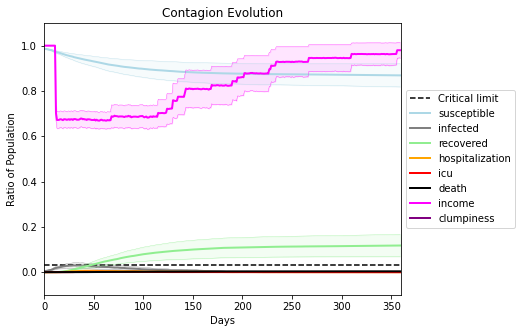

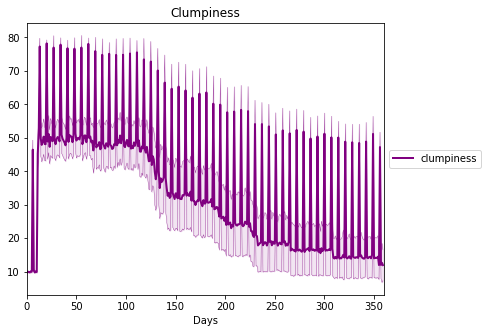

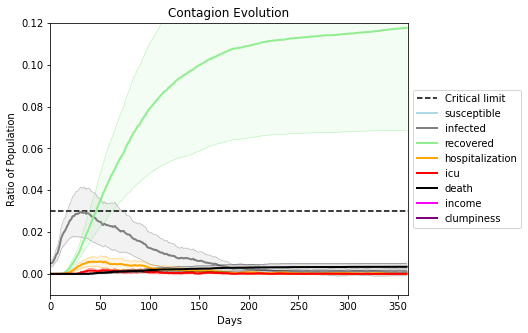

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.98
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.989", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[9086, 481, 5712, 6331, 74, 9154, 3632, 3555, 8740, 9278, 2580, 7082, 5573, 8082, 1104, 8237, 8329, 9626, 1542, 7948]
Average similarity between family members is 0.94326486769308 at temperature -0.97
Average similarity between family and home is 0.9999054673148948 at temperature -1
Average similarity between students and their classroom is 0.4093538892211137 at temperature -0.97
Average classroom occupancy is 12.541666666666666 and number classrooms is 24
Average similarity between workers is 0.6332383940997692 at temperature -0.97
Average office occupancy is 9.772727272727273 and number offices is 66
Average friend similarity for adults: 0.8149902796290197 for kids: 0.5882460398824977
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.20747591076570926
disconnects
0.01
clumpiness 10.29
avg restaurant similarity 0.18165774352331224
disconnects
0.01
clumpiness 9.86
avg restaurant similarity 0.2481203392366974
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.28454271936899056
disconnects
0.0
clumpiness 9.8
avg restaurant similarity 0.3453794478400357
disconnects
0.03
clumpiness 11.34
avg restaurant similarity 0.35333942776564103
disconnects
0.03
clumpiness 11.62
avg restaurant similarity 0.3114588955623727
disconnects
0.55
clumpiness 49.27
avg restaurant similarity 0.14970277613022895
disconnects
0.01
clumpiness 10.48
avg restaurant similarity 0.30668347536497204
disconnects
0.0
clumpiness 9.75
avg restaurant similarity 0.19488347633590994
disconnects
0.01
clumpiness 10.13
avg restaurant similarity 0.02198757670862654
disconnects
0.01
clumpiness 10.14
avg restaurant similarity 0.16013856044311475
disconnects
0.61
clumpiness 55.24
avg restaurant similarity 0.2594983605317638
discon

avg restaurant similarity 0.294708233055928
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.2431955400250351
disconnects
0.52
clumpiness 50.55
avg restaurant similarity 0.389930477723646
disconnects
0.58
clumpiness 53.93
avg restaurant similarity 0.3682446177270109
disconnects
0.53
clumpiness 51.33
avg restaurant similarity 0.21173731402745213
disconnects
0.68
clumpiness 61.03
avg restaurant similarity 0.14645856398864163
disconnects
0.7
clumpiness 60.74
avg restaurant similarity 0.29389278921664913
disconnects
0.59
clumpiness 53.6
avg restaurant similarity 0.20340892298607133
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.04501474542535527
disconnects
0.7
clumpiness 61.08
avg restaurant similarity 0.1680217149010688
disconnects
0.68
clumpiness 59.25
avg restaurant similarity 0.24698776196692174
disconnects
0.58
clumpiness 53.33
avg restaurant similarity 0.2084501712705881
disconnects
0.56
clumpiness 51.93
avg restaurant similarity 0.33421305911432686
disco

avg restaurant similarity 0.378849572255329
disconnects
0.03
clumpiness 11.78
avg restaurant similarity 0.15468946887342924
disconnects
0.46
clumpiness 43.58
avg restaurant similarity 0.20815248464662123
disconnects
0.0
clumpiness 9.44
avg restaurant similarity 0.32162065856862815
disconnects
0.01
clumpiness 9.88
avg restaurant similarity 0.26531753179484924
disconnects
0.01
clumpiness 9.83
avg restaurant similarity 0.34399573696326396
disconnects
0.04
clumpiness 12.39
avg restaurant similarity 0.27451423603671404
disconnects
0.01
clumpiness 10.3
avg restaurant similarity 0.24235246830512092
disconnects
0.0
clumpiness 9.62
avg restaurant similarity 0.18385030223631238
disconnects
0.46
clumpiness 43.74
avg restaurant similarity 0.2530158109221343
disconnects
0.01
clumpiness 9.72
avg restaurant similarity 0.16193299233699712
disconnects
0.0
clumpiness 9.18
avg restaurant similarity 0.32923052830593413
disconnects
0.0
clumpiness 9.71
avg restaurant similarity 0.16199333549684572
disconnec

avg restaurant similarity 0.3234176916769927
disconnects
0.02
clumpiness 10.98
avg restaurant similarity 0.34283811444431395
disconnects
0.0
clumpiness 9.83
avg restaurant similarity 0.40726676838740394
disconnects
0.45
clumpiness 43.37
avg restaurant similarity 0.36225976988867575
disconnects
0.02
clumpiness 10.66
avg restaurant similarity 0.2249275338069835
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.1259800487786142
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.31654546659071287
disconnects
0.02
clumpiness 10.78
avg restaurant similarity 0.277443325352844
disconnects
0.01
clumpiness 10.04
avg restaurant similarity 0.28909000899816484
disconnects
0.01
clumpiness 10.35
avg restaurant similarity 0.299932039682113
disconnects
0.44
clumpiness 41.96
avg restaurant similarity 0.3921794956550488
disconnects
0.01
clumpiness 10.02
avg restaurant similarity 0.18331638337042033
disconnects
0.03
clumpiness 11.41
avg restaurant similarity 0.23506663614655202
disconne

avg restaurant similarity 0.22811532749695346
disconnects
0.02
clumpiness 10.22
avg restaurant similarity 0.12266932061999443
disconnects
0.0
clumpiness 8.71
avg restaurant similarity 0.19718474721118687
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.17466718996662212
disconnects
0.0
clumpiness 8.5
avg restaurant similarity 0.08780844259042753
disconnects
0.01
clumpiness 9.45
avg restaurant similarity 0.24944372563861922
disconnects
0.0
clumpiness 8.73
avg restaurant similarity 0.1590569650286058
disconnects
0.32
clumpiness 33.15
avg restaurant similarity 0.18468984475424585
disconnects
0.0
clumpiness 8.77
avg restaurant similarity 0.2834835030085495
disconnects
0.0
clumpiness 8.5
avg restaurant similarity 0.08180147813487616
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.2672086523873815
disconnects
0.0
clumpiness 8.35
avg restaurant similarity 0.20639902992664905
disconnects
0.41
clumpiness 40.24
avg restaurant similarity 0.24242363947501344
disconnects
0.41

disconnects
0.56
clumpiness 50.64
avg restaurant similarity 0.15944833325162514
disconnects
0.92
clumpiness 74.62
avg restaurant similarity 0.23481580308632222
disconnects
0.52
clumpiness 48.12
avg restaurant similarity 0.13017925673836556
disconnects
0.51
clumpiness 47.19
avg restaurant similarity 0.2631602130802891
disconnects
0.49
clumpiness 45.6
avg restaurant similarity 0.19356712059875797
disconnects
0.41
clumpiness 40.21
avg restaurant similarity 0.1284707870075802
disconnects
0.54
clumpiness 48.77
avg restaurant similarity 0.19271311659845425
disconnects
0.49
clumpiness 45.88
avg restaurant similarity 0.2984349705153066
disconnects
0.92
clumpiness 74.52
avg restaurant similarity 0.21256443479331194
disconnects
0.42
clumpiness 40.97
avg restaurant similarity 0.20504915977485763
disconnects
0.45
clumpiness 42.68
avg restaurant similarity 0.20110496271898406
disconnects
0.38
clumpiness 38.82
avg restaurant similarity 0.32879027716981873
disconnects
0.45
clumpiness 42.77
avg restau

disconnects
0.52
clumpiness 47.32
avg restaurant similarity 0.10869899168546633
disconnects
0.44
clumpiness 42.25
avg restaurant similarity 0.09576854845946797
disconnects
0.54
clumpiness 48.74
avg restaurant similarity 0.19272395663854971
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.22747637135102247
disconnects
0.33
clumpiness 34.47
avg restaurant similarity 0.14479754322289803
disconnects
0.46
clumpiness 43.65
avg restaurant similarity 0.10918130445387218
disconnects
0.43
clumpiness 41.69
avg restaurant similarity 0.2606389873404103
disconnects
0.33
clumpiness 35.73
avg restaurant similarity 0.22803842377386535
disconnects
0.4
clumpiness 39.54
avg restaurant similarity 0.26570825881762833
disconnects
0.44
clumpiness 42.54
avg restaurant similarity 0.2632390777430442
disconnects
0.86
clumpiness 70.18
avg restaurant similarity 0.26529956415677014
disconnects
0.49
clumpiness 45.46
avg restaurant similarity 0.19325997917932577
disconnects
0.42
clumpiness 41.3
avg restau

disconnects
0.01
clumpiness 9.83
avg restaurant similarity 0.21312036393961248
disconnects
0.01
clumpiness 9.27
avg restaurant similarity 0.11763153450578578
disconnects
0.01
clumpiness 9.48
avg restaurant similarity 0.21902630436424042
disconnects
0.33
clumpiness 33.68
avg restaurant similarity 0.22066894810687163
disconnects
0.04
clumpiness 11.77
avg restaurant similarity 0.176976469467643
disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.2626293613424533
disconnects
0.02
clumpiness 10.4
avg restaurant similarity 0.15424951623001232
disconnects
0.0
clumpiness 8.65
avg restaurant similarity 0.18194744790852657
disconnects
0.01
clumpiness 9.47
avg restaurant similarity 0.2691989484898911
disconnects
0.01
clumpiness 9.11
avg restaurant similarity 0.36316572529096336
disconnects
0.48
clumpiness 44.51
avg restaurant similarity 0.13166439891796125
disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.11955065620029438
disconnects
0.01
clumpiness 9.5
avg restaurant similarit

avg restaurant similarity 0.20020486105609883
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.2857820897315896
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.2656326085765235
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.27039086596965556
disconnects
0.0
clumpiness 9.6
avg restaurant similarity 0.2338190598945771
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.32000061515468853
disconnects
0.0
clumpiness 9.24
avg restaurant similarity 0.25908891023451897
disconnects
0.57
clumpiness 50.7
avg restaurant similarity 0.1384192832480112
disconnects
0.0
clumpiness 9.46
avg restaurant similarity 0.06501406619415666
disconnects
0.0
clumpiness 9.04
avg restaurant similarity 0.4236534050641066
disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.3530978749215301
disconnects
0.0
clumpiness 9.07
avg restaurant similarity 0.2179185254974595
disconnects
0.51
clumpiness 47.84
avg restaurant similarity 0.4287731967429652
disconnects
0.62
clumpine

avg restaurant similarity 0.2861102734154234
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.2328322263808697
disconnects
0.56
clumpiness 50.83
avg restaurant similarity 0.26355249541146025
disconnects
0.69
clumpiness 59.8
avg restaurant similarity 0.24392497467487578
disconnects
0.67
clumpiness 58.21
avg restaurant similarity 0.26259841715528925
disconnects
0.6
clumpiness 53.95
avg restaurant similarity 0.18436714842185697
disconnects
0.61
clumpiness 53.94
avg restaurant similarity 0.3098503636859675
disconnects
0.59
clumpiness 52.53
avg restaurant similarity 0.18128464309695544
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.41285860542675296
disconnects
0.61
clumpiness 55.18
avg restaurant similarity 0.3607373803729805
disconnects
0.63
clumpiness 56.62
avg restaurant similarity 0.48798609418389977
disconnects
0.6
clumpiness 56.51
avg restaurant similarity 0.1899202392514823
disconnects
0.58
clumpiness 53.81
avg restaurant similarity 0.31947940744676867
di

disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.25818771252706796
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.4111341237189457
disconnects
0.55
clumpiness 49.22
avg restaurant similarity 0.3299015716069428
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.26572934341055526
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.29770082668110187
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.41698357249682344
disconnects
0.0
clumpiness 9.38
avg restaurant similarity 0.27507765563615116
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.36208402227721515
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.3210240177019835
disconnects
0.46
clumpiness 43.35
avg restaurant similarity 0.1851550094482651
disconnects
0.0
clumpiness 9.9
avg restaurant similarity 0.3628854039164598
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.21829512132492762
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.1657393

avg restaurant similarity 0.2066543829386647
disconnects
0.0
clumpiness 8.93
avg restaurant similarity 0.3671472524957958
disconnects
0.56
clumpiness 50.18
avg restaurant similarity 0.1394274563994671
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.2972034802945267
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.2034452277267559
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.23977399519448483
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.28193408137237785
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.41097460479182385
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.20235547088408107
disconnects
0.48
clumpiness 44.89
avg restaurant similarity 0.2589904989175977
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.19367196847474788
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.3539175246486318
disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.2914524482611251
disconnects
0.0
clumpine

avg restaurant similarity 0.2909058008086739
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.28363163522851553
disconnects
0.0
clumpiness 8.8
avg restaurant similarity 0.16882510666678457
disconnects
0.0
clumpiness 8.76
avg restaurant similarity 0.14790615657942877
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.182049183103112
disconnects
0.0
clumpiness 8.77
avg restaurant similarity 0.25072045412974087
disconnects
0.0
clumpiness 9.32
avg restaurant similarity 0.27192269573415
disconnects
0.41
clumpiness 39.59
avg restaurant similarity 0.22171123799381753
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.3206686352340626
disconnects
0.0
clumpiness 8.91
avg restaurant similarity 0.18968349661992634
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.16702544552621898
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.3115140121943075
disconnects
0.23
clumpiness 28.82
avg restaurant similarity 0.1884727197829061
disconnects
0.4
clumpine

disconnects
0.51
clumpiness 47.9
avg restaurant similarity 0.1211175399349114
disconnects
0.94
clumpiness 75.63
avg restaurant similarity 0.18214915866542358
disconnects
0.42
clumpiness 41.18
avg restaurant similarity 0.2151578184084437
disconnects
0.44
clumpiness 42.78
avg restaurant similarity 0.20338989218039416
disconnects
0.38
clumpiness 39.38
avg restaurant similarity 0.16551617411559258
disconnects
0.44
clumpiness 42.6
avg restaurant similarity 0.19343071303040776
disconnects
0.38
clumpiness 38.36
avg restaurant similarity 0.18939219543937902
disconnects
0.41
clumpiness 40.3
avg restaurant similarity 0.14987767757148596
disconnects
0.9
clumpiness 73.08
avg restaurant similarity 0.1588014966734706
disconnects
0.35
clumpiness 36.72
avg restaurant similarity 0.19457939400619262
disconnects
0.42
clumpiness 42.96
avg restaurant similarity 0.25081917285729616
disconnects
0.4
clumpiness 40.06
avg restaurant similarity 0.20340716552065638
disconnects
0.4
clumpiness 40.56
avg restaurant 

avg restaurant similarity 0.2720684618469686
disconnects
0.46
clumpiness 45.64
avg restaurant similarity 0.2525386215620304
disconnects
0.34
clumpiness 35.54
avg restaurant similarity 0.14620254531361307
disconnects
0.96
clumpiness 77.06
avg restaurant similarity 0.26746138330942637
disconnects
0.48
clumpiness 45.82
avg restaurant similarity 0.31485696954166315
disconnects
0.38
clumpiness 38.09
avg restaurant similarity 0.16916778198168284
disconnects
0.46
clumpiness 43.6
avg restaurant similarity 0.19765165911244884
disconnects
0.36
clumpiness 37.55
avg restaurant similarity 0.20509277070124635
disconnects
0.44
clumpiness 42.78
avg restaurant similarity 0.15748755684469098
disconnects
0.32
clumpiness 35.7
avg restaurant similarity 0.2502479186226157
disconnects
0.95
clumpiness 76.66
avg restaurant similarity 0.23118986026382374
disconnects
0.0
clumpiness 8.62
avg restaurant similarity 0.2561730668862732
disconnects
0.0
clumpiness 9.38
avg restaurant similarity 0.24544393634629533
disc

disconnects
0.0
clumpiness 9.44
avg restaurant similarity 0.30387662059821446
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.32679654194839813
disconnects
0.39
clumpiness 38.55
avg restaurant similarity 0.28988876208638703
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.18693329025735042
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.1873370810617045
disconnects
0.0
clumpiness 9.08
avg restaurant similarity 0.10311557976272603
disconnects
0.0
clumpiness 8.8
avg restaurant similarity 0.1992407242178761
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.4011583407766276
disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.2503891884811056
disconnects
0.43
clumpiness 40.72
avg restaurant similarity 0.22349169870175772
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.18453510343228982
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.22936740360418975
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.346406

avg restaurant similarity 0.12899002364409995
disconnects
0.01
clumpiness 9.81
avg restaurant similarity 0.13040403627765343
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.12276882945021839
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.16500385873612836
disconnects
0.02
clumpiness 10.56
avg restaurant similarity 0.19419392412677763
disconnects
0.02
clumpiness 10.77
avg restaurant similarity 0.1306947274828038
disconnects
0.01
clumpiness 10.13
avg restaurant similarity 0.22280581550324666
disconnects
0.45
clumpiness 42.56
avg restaurant similarity 0.09391303012401572
disconnects
0.01
clumpiness 9.99
avg restaurant similarity 0.22662849407006225
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.16169042172108994
disconnects
0.02
clumpiness 10.9
avg restaurant similarity 0.23695592680917824
disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.16857946192530784
disconnects
0.45
clumpiness 43.99
avg restaurant similarity 0.26306812606565994
discon

disconnects
0.57
clumpiness 52.0
avg restaurant similarity 0.19680428130338837
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.21635757726720364
disconnects
0.44
clumpiness 44.8
avg restaurant similarity 0.0013247581822945873
disconnects
0.45
clumpiness 43.62
avg restaurant similarity 0.1698252982741393
disconnects
0.58
clumpiness 53.25
avg restaurant similarity 0.26818223857475837
disconnects
0.45
clumpiness 44.35
avg restaurant similarity 0.20249506992951305
disconnects
0.59
clumpiness 52.84
avg restaurant similarity 0.21429790022174383
disconnects
0.48
clumpiness 45.93
avg restaurant similarity 0.29043996415825235
disconnects
0.92
clumpiness 74.57
avg restaurant similarity 0.32713749942612264
disconnects
0.49
clumpiness 46.07
avg restaurant similarity 0.08199212801216516
disconnects
0.46
clumpiness 45.45
avg restaurant similarity 0.05181919946981932
disconnects
0.49
clumpiness 46.48
avg restaurant similarity 0.2918937157375841
disconnects
0.44
clumpiness 43.33
avg rest

avg restaurant similarity 0.17482902144485093
disconnects
0.02
clumpiness 10.98
avg restaurant similarity 0.1945196739436869
disconnects
0.47
clumpiness 43.86
avg restaurant similarity 0.04456606625838114
disconnects
0.01
clumpiness 9.88
avg restaurant similarity 0.18708553366826128
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.34743566545905247
disconnects
0.0
clumpiness 9.32
avg restaurant similarity 0.15849242870788927
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.3086869334215104
disconnects
0.01
clumpiness 10.04
avg restaurant similarity 0.11023543455185005
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.12405851162694465
disconnects
0.46
clumpiness 42.94
avg restaurant similarity 0.22624700218433721
disconnects
0.01
clumpiness 10.27
avg restaurant similarity 0.26289024749466944
disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.12351740954544807
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.19595068796741683
disconnec

disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.12649617820561848
disconnects
0.03
clumpiness 11.52
avg restaurant similarity 0.2472493059061843
disconnects
0.38
clumpiness 37.42
avg restaurant similarity 0.19545289455611625
disconnects
0.0
clumpiness 9.62
avg restaurant similarity 0.19352841532826917
disconnects
0.01
clumpiness 9.69
avg restaurant similarity 0.25994166140460445
disconnects
0.01
clumpiness 9.45
avg restaurant similarity 0.1508825870467169
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.2566130210552841
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.2488737703808455
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.13806330941082515
disconnects
0.37
clumpiness 37.37
avg restaurant similarity 0.10028411276118251
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.18448398791958703
disconnects
0.02
clumpiness 10.93
avg restaurant similarity 0.2841674409268408
disconnects
0.0
clumpiness 9.0
avg restaurant similarity 0.

avg restaurant similarity 0.1284627872546496
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.1804480371632844
disconnects
0.01
clumpiness 9.85
avg restaurant similarity 0.14198669158277197
disconnects
0.0
clumpiness 8.91
avg restaurant similarity 0.10062309384628396
disconnects
0.01
clumpiness 9.98
avg restaurant similarity 0.2032312537339991
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.2158330677870702
disconnects
0.01
clumpiness 9.9
avg restaurant similarity 0.3580039235117233
disconnects
0.49
clumpiness 45.17
avg restaurant similarity 0.15470077677389146
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.1912968854829344
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.21731541569336635
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.21617655444298825
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.40008014574946466
disconnects
0.35
clumpiness 38.76
avg restaurant similarity 0.24099931066072416
disconnects
0.55
c

disconnects
0.65
clumpiness 56.94
avg restaurant similarity 0.13876416891369925
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.12038577743385469
disconnects
0.62
clumpiness 55.25
avg restaurant similarity 0.22989021506092439
disconnects
0.6
clumpiness 54.6
avg restaurant similarity 0.1059120601092509
disconnects
0.63
clumpiness 57.51
avg restaurant similarity 0.2941719444611038
disconnects
0.58
clumpiness 52.83
avg restaurant similarity 0.16124875242456038
disconnects
0.53
clumpiness 49.67
avg restaurant similarity 0.25344465053585347
disconnects
0.48
clumpiness 45.69
avg restaurant similarity 0.17559551334977125
disconnects
0.96
clumpiness 76.98
avg restaurant similarity 0.1625762345650433
disconnects
0.66
clumpiness 58.45
avg restaurant similarity 0.19652954856677815
disconnects
0.61
clumpiness 55.54
avg restaurant similarity 0.26987703526558565
disconnects
0.61
clumpiness 54.86
avg restaurant similarity 0.30041239899067634
disconnects
0.45
clumpiness 45.38
avg restauran

avg restaurant similarity 0.21281150048502953
disconnects
0.01
clumpiness 10.13
avg restaurant similarity 0.4351034788205969
disconnects
0.54
clumpiness 48.96
avg restaurant similarity 0.13271710976529597
disconnects
0.02
clumpiness 10.54
avg restaurant similarity 0.15027218056498828
disconnects
0.0
clumpiness 9.1
avg restaurant similarity -0.04709155462382651
disconnects
0.02
clumpiness 10.05
avg restaurant similarity 0.06231812377105199
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.23347808751269689
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.11455973153549673
disconnects
0.0
clumpiness 8.8
avg restaurant similarity 0.14678468048701837
disconnects
0.46
clumpiness 43.75
avg restaurant similarity 0.058690146362236725
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.2745356772639716
disconnects
0.01
clumpiness 10.05
avg restaurant similarity 0.23964597379842734
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.19882723928366966
disconne

disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.17810098026142734
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.24666984160409824
disconnects
0.5
clumpiness 46.97
avg restaurant similarity 0.1163552998497586
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.148686771369695
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.05347111759142655
disconnects
0.01
clumpiness 9.61
avg restaurant similarity 0.20485368777752563
disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.06743521336353976
disconnects
0.0
clumpiness 9.38
avg restaurant similarity -0.05918049312073062
disconnects
0.0
clumpiness 8.91
avg restaurant similarity 0.1633643146123217
disconnects
0.43
clumpiness 40.93
avg restaurant similarity 0.16748157923637158
disconnects
0.01
clumpiness 10.12
avg restaurant similarity 0.05379307000893808
disconnects
0.0
clumpiness 8.7
avg restaurant similarity 0.3576707536933212
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.201

avg restaurant similarity 0.3413734868374848
disconnects
0.0
clumpiness 9.41
avg restaurant similarity 0.19131119027810403
disconnects
0.01
clumpiness 10.18
avg restaurant similarity 0.20399083012771227
disconnects
0.02
clumpiness 10.89
avg restaurant similarity 0.2785022096574355
disconnects
0.01
clumpiness 10.29
avg restaurant similarity 0.1996525331586357
disconnects
0.0
clumpiness 9.73
avg restaurant similarity 0.09955225864196127
disconnects
0.01
clumpiness 10.62
avg restaurant similarity 0.2032833715583356
disconnects
0.56
clumpiness 50.47
avg restaurant similarity 0.14840957787763473
disconnects
0.01
clumpiness 9.88
avg restaurant similarity 0.1150034035634087
disconnects
0.02
clumpiness 10.98
avg restaurant similarity 0.4052908259026666
disconnects
0.01
clumpiness 10.02
avg restaurant similarity 0.23040563679976053
disconnects
0.01
clumpiness 9.9
avg restaurant similarity 0.1335746359163206
disconnects
0.6
clumpiness 54.47
avg restaurant similarity 0.2797156611360789
disconnect

avg restaurant similarity 0.1690611007870677
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.09731724432246401
disconnects
0.6
clumpiness 55.18
avg restaurant similarity 0.21275850091556145
disconnects
0.62
clumpiness 56.73
avg restaurant similarity 0.20117884291791865
disconnects
0.47
clumpiness 47.52
avg restaurant similarity 0.3612741192192431
disconnects
0.53
clumpiness 49.76
avg restaurant similarity 0.23133066734417557
disconnects
0.6
clumpiness 55.78
avg restaurant similarity 0.23028354290740585
disconnects
0.55
clumpiness 52.18
avg restaurant similarity 0.30244994647127804
disconnects
0.98
clumpiness 78.59
avg restaurant similarity 0.14926759494562614
disconnects
0.58
clumpiness 53.01
avg restaurant similarity 0.2051860615356282
disconnects
0.54
clumpiness 51.29
avg restaurant similarity 0.37036853463512864
disconnects
0.59
clumpiness 53.58
avg restaurant similarity 0.2019584681629341
disconnects
0.53
clumpiness 50.94
avg restaurant similarity 0.3208386131652029
dis

disconnects
0.01
clumpiness 9.98
avg restaurant similarity 0.4227886323841247
disconnects
0.39
clumpiness 39.45
avg restaurant similarity 0.3925557713255178
disconnects
0.0
clumpiness 9.3
avg restaurant similarity 0.08128206863667392
disconnects
0.0
clumpiness 9.72
avg restaurant similarity 0.16898535545094726
disconnects
0.0
clumpiness 9.4
avg restaurant similarity 0.23329916805843864
disconnects
0.02
clumpiness 11.2
avg restaurant similarity 0.22173470562902076
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.2700566700315855
disconnects
0.0
clumpiness 9.4
avg restaurant similarity 0.31574526637373107
disconnects
0.47
clumpiness 44.41
avg restaurant similarity 0.21372196477743405
disconnects
0.01
clumpiness 10.03
avg restaurant similarity 0.22767841694760724
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.2846619981897692
disconnects
0.01
clumpiness 10.06
avg restaurant similarity 0.19967438460107745
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.31

disconnects
0.01
clumpiness 10.39
avg restaurant similarity 0.25470157781540165
disconnects
0.0
clumpiness 8.72
avg restaurant similarity 0.168611588457736
disconnects
0.57
clumpiness 50.5
avg restaurant similarity 0.1971852422185983
disconnects
0.01
clumpiness 9.85
avg restaurant similarity 0.21231934547456002
disconnects
0.0
clumpiness 9.18
avg restaurant similarity 0.3552787839229243
disconnects
0.02
clumpiness 10.93
avg restaurant similarity 0.36686538616812664
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.24805905906621722
disconnects
0.0
clumpiness 9.51
avg restaurant similarity 0.20790722166331632
disconnects
0.01
clumpiness 10.14
avg restaurant similarity 0.24798731211523206
disconnects
0.49
clumpiness 45.38
avg restaurant similarity 0.19363169862047697
disconnects
0.02
clumpiness 10.91
avg restaurant similarity 0.22396039540160464
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.23517611567965302
disconnects
0.0
clumpiness 9.1
avg restaurant similarity

avg restaurant similarity 0.12937047287683642
disconnects
0.0
clumpiness 9.53
avg restaurant similarity 0.149638059185834
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.06959985248525327
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.17429113824242545
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.08353137639728796
disconnects
0.01
clumpiness 9.9
avg restaurant similarity 0.12727363971288394
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.16558824187637938
disconnects
0.48
clumpiness 45.1
avg restaurant similarity 0.04235891464599373
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.032779840664186856
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.08302482895521619
disconnects
0.0
clumpiness 9.51
avg restaurant similarity 0.3011095432067043
disconnects
0.0
clumpiness 9.22
avg restaurant similarity 0.23160412581462922
disconnects
0.31
clumpiness 36.24
avg restaurant similarity 0.05626242018513958
disconnects
0.44


disconnects
0.41
clumpiness 42.53
avg restaurant similarity 0.034077913824111954
disconnects
0.99
clumpiness 79.35
avg restaurant similarity 0.16298653646111264
disconnects
0.44
clumpiness 43.65
avg restaurant similarity 0.2722995287339063
disconnects
0.34
clumpiness 38.01
avg restaurant similarity 0.14468891537289683
disconnects
0.54
clumpiness 49.65
avg restaurant similarity 0.16004053259709128
disconnects
0.47
clumpiness 45.79
avg restaurant similarity 0.18897350611891617
disconnects
0.49
clumpiness 47.78
avg restaurant similarity 0.13920273698285696
disconnects
0.46
clumpiness 44.95
avg restaurant similarity 0.11195435700713438
disconnects
0.98
clumpiness 78.53
avg restaurant similarity 0.13467644707111548
disconnects
0.42
clumpiness 42.13
avg restaurant similarity 0.019381937249696824
disconnects
0.55
clumpiness 50.26
avg restaurant similarity 0.2095877980313323
disconnects
0.44
clumpiness 44.15
avg restaurant similarity 0.16642280343524762
disconnects
0.44
clumpiness 45.6
avg res

disconnects
0.49
clumpiness 47.0
avg restaurant similarity 0.216969697144172
disconnects
0.49
clumpiness 46.93
avg restaurant similarity 0.2508159929091314
disconnects
0.43
clumpiness 43.24
avg restaurant similarity 0.18644835546261837
disconnects
0.96
clumpiness 77.15
avg restaurant similarity 0.13002127037691477
disconnects
0.49
clumpiness 46.43
avg restaurant similarity 0.2009675064468937
disconnects
0.58
clumpiness 53.21
avg restaurant similarity 0.19150569546895374
disconnects
0.5
clumpiness 49.35
avg restaurant similarity 0.12995553188000736
disconnects
0.46
clumpiness 45.87
avg restaurant similarity 0.21917443747421084
disconnects
0.41
clumpiness 42.39
avg restaurant similarity 0.1308401794359682
disconnects
0.46
clumpiness 45.48
avg restaurant similarity 0.17210903029032523
disconnects
0.96
clumpiness 77.18
avg restaurant similarity 0.16726316477230152
disconnects
0.53
clumpiness 49.69
avg restaurant similarity 0.17896917761597492
disconnects
0.5
clumpiness 50.13
avg restaurant

disconnects
0.0
clumpiness 9.65
avg restaurant similarity 0.08859760218205134
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.08663824939701854
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.20941478417441609
disconnects
0.0
clumpiness 9.36
avg restaurant similarity 0.08979222592364224
disconnects
0.49
clumpiness 45.33
avg restaurant similarity 0.1570085567216119
disconnects
0.0
clumpiness 9.43
avg restaurant similarity 0.1568462126484191
disconnects
0.0
clumpiness 9.98
avg restaurant similarity 0.1941408446393202
disconnects
0.0
clumpiness 9.04
avg restaurant similarity 0.16567607376596594
disconnects
0.0
clumpiness 9.75
avg restaurant similarity 0.18770404980400465
disconnects
0.0
clumpiness 9.65
avg restaurant similarity 0.1761878302254085
disconnects
0.0
clumpiness 9.47
avg restaurant similarity 0.11218930384162883
disconnects
0.49
clumpiness 46.18
avg restaurant similarity 0.11689278258090757
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.1343

avg restaurant similarity 0.26982954491613576
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.25216522721313245
disconnects
0.0
clumpiness 9.01
avg restaurant similarity 0.1360814682021787
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.15579545608280623
disconnects
0.0
clumpiness 9.08
avg restaurant similarity 0.2734991687292728
disconnects
0.0
clumpiness 9.63
avg restaurant similarity 0.10354606064945779
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.1648940547100737
disconnects
0.45
clumpiness 42.35
avg restaurant similarity 0.2007353995660055
disconnects
0.0
clumpiness 9.41
avg restaurant similarity 0.22870744569420498
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.20624967686656046
disconnects
0.0
clumpiness 8.78
avg restaurant similarity 0.1985330894227709
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.34877787895617773
disconnects
0.44
clumpiness 42.78
avg restaurant similarity 0.2635577059990124
disconnects
0.52
clu

disconnects
0.57
clumpiness 51.0
avg restaurant similarity 0.1642531308989791
disconnects
0.95
clumpiness 76.52
avg restaurant similarity 0.09768124268711315
disconnects
0.51
clumpiness 47.62
avg restaurant similarity 0.1661783567815834
disconnects
0.47
clumpiness 46.02
avg restaurant similarity 0.30049935055724153
disconnects
0.54
clumpiness 49.84
avg restaurant similarity 0.2428713818663519
disconnects
0.51
clumpiness 47.2
avg restaurant similarity 0.18093290239274765
disconnects
0.55
clumpiness 49.84
avg restaurant similarity 0.19829737053133178
disconnects
0.62
clumpiness 54.69
avg restaurant similarity 0.1300282664519273
disconnects
0.99
clumpiness 79.31
avg restaurant similarity 0.0763943264578306
disconnects
0.48
clumpiness 45.04
avg restaurant similarity 0.16494398551211825
disconnects
0.53
clumpiness 49.1
avg restaurant similarity 0.2233795370312844
disconnects
0.56
clumpiness 50.67
avg restaurant similarity 0.21052761048936436
disconnects
0.55
clumpiness 50.11
avg restaurant 

avg restaurant similarity 0.30520334655423287
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.20446361853248765
disconnects
0.4
clumpiness 39.46
avg restaurant similarity 0.3248760783551286
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.14074900348182737
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.15761713780838613
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.16926534098039311
disconnects
0.0
clumpiness 8.84
avg restaurant similarity 0.051923500944813405
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.19414767550990136
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.15541069693884713
disconnects
0.43
clumpiness 40.71
avg restaurant similarity 0.1748915349430862
disconnects
0.0
clumpiness 9.24
avg restaurant similarity 0.21632467901543082
disconnects
0.0
clumpiness 9.0
avg restaurant similarity 0.20038128278680756
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.20499924075986137
disconnects
0.0
clu

disconnects
0.0
clumpiness 9.32
avg restaurant similarity 0.17331817878742573
disconnects
0.47
clumpiness 43.91
avg restaurant similarity 0.22406649179071952
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.2540148915340835
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.24823319010032022
disconnects
0.0
clumpiness 9.44
avg restaurant similarity 0.23288693385615142
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.18523929110714898
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.1213527352182749
disconnects
0.0
clumpiness 8.75
avg restaurant similarity 0.22267212408685944
disconnects
0.5
clumpiness 45.65
avg restaurant similarity 0.10049277190885465
disconnects
0.0
clumpiness 9.44
avg restaurant similarity 0.17584654616046244
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.15758761007232916
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.1076053123082597
disconnects
0.0
clumpiness 9.72
avg restaurant similarity 0.3106

avg restaurant similarity 0.2523311427437268
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.24583670745204286
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.2679656560763899
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.233684980018723
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.24213625089916058
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.17005285628817352
disconnects
0.0
clumpiness 9.08
avg restaurant similarity 0.1858614918388421
disconnects
0.48
clumpiness 45.12
avg restaurant similarity 0.15081843700033082
disconnects
0.0
clumpiness 9.51
avg restaurant similarity 0.21274500509849562
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.07184958587966504
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.20290450737469098
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.13576913908374696
disconnects
0.47
clumpiness 45.52
avg restaurant similarity 0.050743402047017584
disconnects
0.54
cl

disconnects
0.7
clumpiness 60.41
avg restaurant similarity 0.17366696045859648
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.2834153688562487
disconnects
0.51
clumpiness 47.21
avg restaurant similarity 0.2614765577161352
disconnects
0.47
clumpiness 44.81
avg restaurant similarity 0.2042042573355612
disconnects
0.41
clumpiness 41.59
avg restaurant similarity 0.15167126577905626
disconnects
0.49
clumpiness 46.89
avg restaurant similarity 0.0544892798225854
disconnects
0.51
clumpiness 47.11
avg restaurant similarity 0.09168923456161575
disconnects
0.48
clumpiness 46.49
avg restaurant similarity 0.26402566100112496
disconnects
0.99
clumpiness 79.26
avg restaurant similarity 0.27126243047291204
disconnects
0.56
clumpiness 51.13
avg restaurant similarity 0.2398922790921133
disconnects
0.42
clumpiness 42.09
avg restaurant similarity 0.13202250921213857
disconnects
0.51
clumpiness 49.01
avg restaurant similarity 0.09038650091576221
disconnects
0.47
clumpiness 45.15
avg restaura

avg restaurant similarity 0.22546075571535518
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.21454139719972487
disconnects
0.51
clumpiness 46.84
avg restaurant similarity 0.3727977762340491
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.24947594243071214
disconnects
0.0
clumpiness 9.43
avg restaurant similarity 0.12055420177699344
disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.2419907458693643
disconnects
0.0
clumpiness 9.07
avg restaurant similarity 0.2914245672272278
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.10930755428767508
disconnects
0.0
clumpiness 9.41
avg restaurant similarity 0.2167729186837277
disconnects
0.47
clumpiness 44.2
avg restaurant similarity 0.2106448503325677
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.1928342513384118
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.2103714503296865
disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.17183574956686282
disconnects
0.0
clumpin

disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.20622102351412308
disconnects
0.52
clumpiness 47.15
avg restaurant similarity 0.25705260458466156
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.12890651127045763
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.2762141976489501
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.1984035127357619
disconnects
0.0
clumpiness 9.43
avg restaurant similarity 0.17007590858338387
disconnects
0.0
clumpiness 9.68
avg restaurant similarity 0.3021776864194196
disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.15322430412455593
disconnects
0.49
clumpiness 45.48
avg restaurant similarity 0.11449709636832142
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.2587905896942286
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.24510566723095883
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.0890709310201713
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.117555

avg restaurant similarity 0.3760186761871871
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.052329857077688405
disconnects
0.02
clumpiness 11.04
avg restaurant similarity 0.11650836156560085
disconnects
0.01
clumpiness 9.82
avg restaurant similarity 0.2667484137756579
disconnects
0.01
clumpiness 10.23
avg restaurant similarity -0.06041496056979134
disconnects
0.0
clumpiness 9.08
avg restaurant similarity 0.1479779366024535
disconnects
0.0
clumpiness 9.5
avg restaurant similarity -0.027129285369197096
disconnects
0.58
clumpiness 51.48
avg restaurant similarity 0.4352474648635661
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.12282970089743574
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.1714570573047941
disconnects
0.01
clumpiness 9.76
avg restaurant similarity 0.08070602386061998
disconnects
0.01
clumpiness 10.51
avg restaurant similarity 0.46211708385650313
disconnects
0.47
clumpiness 47.6
avg restaurant similarity 0.13655973621589637
disconnec

disconnects
0.02
clumpiness 10.75
avg restaurant similarity 0.49110995375213734
disconnects
0.52
clumpiness 48.46
avg restaurant similarity 0.35405900505330073
disconnects
0.01
clumpiness 9.91
avg restaurant similarity 0.30687558691130296
disconnects
0.01
clumpiness 9.84
avg restaurant similarity 0.15027127443351126
disconnects
0.01
clumpiness 10.07
avg restaurant similarity 0.25331931233565463
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.09759233860236279
disconnects
0.0
clumpiness 9.32
avg restaurant similarity 0.12480497803601137
disconnects
0.01
clumpiness 9.72
avg restaurant similarity 0.2608252971862242
disconnects
0.58
clumpiness 51.51
avg restaurant similarity 0.2539975413602925
disconnects
0.01
clumpiness 10.01
avg restaurant similarity 0.10063621868596148
disconnects
0.0
clumpiness 9.53
avg restaurant similarity 0.10664619238277315
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.3564491878042249
disconnects
0.01
clumpiness 9.96
avg restaurant simila

disconnects
0.0
clumpiness 9.63
avg restaurant similarity 0.05197018190201016
disconnects
0.01
clumpiness 10.13
avg restaurant similarity 0.24183668430516056
disconnects
0.62
clumpiness 53.91
avg restaurant similarity 0.09570358227900759
disconnects
0.01
clumpiness 10.28
avg restaurant similarity 0.14699497048654464
disconnects
0.0
clumpiness 8.98
avg restaurant similarity 0.16082952879843015
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.296525377557702
disconnects
0.0
clumpiness 9.04
avg restaurant similarity 0.19833624950303053
disconnects
0.01
clumpiness 10.33
avg restaurant similarity 0.2289130774530954
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.17733987732468315
disconnects
0.46
clumpiness 44.37
avg restaurant similarity 0.030351470109825092
disconnects
0.01
clumpiness 10.14
avg restaurant similarity 0.534963335180971
disconnects
0.01
clumpiness 10.02
avg restaurant similarity 0.24537701990838393
disconnects
0.01
clumpiness 10.19
avg restaurant simil

avg restaurant similarity 0.33719930402650194
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.14286935582471474
disconnects
0.0
clumpiness 9.56
avg restaurant similarity 0.13240746860676553
disconnects
0.62
clumpiness 53.91
avg restaurant similarity -0.0575711007178832
disconnects
0.01
clumpiness 9.7
avg restaurant similarity 0.021874920759823904
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.47416295945463816
disconnects
0.03
clumpiness 11.68
avg restaurant similarity 0.0790399683357009
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.27378768556001637
disconnects
0.0
clumpiness 9.41
avg restaurant similarity -0.044576091407116075
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.20786846921026017
disconnects
0.55
clumpiness 49.64
avg restaurant similarity 0.03805111191110806
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.291589224082243
disconnects
0.01
clumpiness 9.86
avg restaurant similarity 0.01083189525602828
disconnects

avg restaurant similarity 0.13506527507262053
disconnects
0.02
clumpiness 10.19
avg restaurant similarity 0.20899210833943083
disconnects
0.02
clumpiness 10.41
avg restaurant similarity 0.1991639199670319
disconnects
0.01
clumpiness 9.97
avg restaurant similarity 0.18411144407753005
disconnects
0.03
clumpiness 10.83
avg restaurant similarity 0.18162783001555516
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.22770428558723138
disconnects
0.0
clumpiness 9.07
avg restaurant similarity 0.17402449470508674
disconnects
0.43
clumpiness 41.26
avg restaurant similarity 0.27551955541536866
disconnects
0.01
clumpiness 9.62
avg restaurant similarity 0.23066540216085615
disconnects
0.01
clumpiness 9.74
avg restaurant similarity 0.1410953215654016
disconnects
0.01
clumpiness 9.86
avg restaurant similarity 0.2482742561509316
disconnects
0.02
clumpiness 10.34
avg restaurant similarity 0.24315996638951842
disconnects
0.53
clumpiness 48.34
avg restaurant similarity 0.19947616606353907
disco

disconnects
0.51
clumpiness 47.74
avg restaurant similarity 0.24326019828659298
disconnects
0.91
clumpiness 73.93
avg restaurant similarity 0.19231828510740273
disconnects
0.49
clumpiness 46.49
avg restaurant similarity 0.18382210693482676
disconnects
0.51
clumpiness 46.94
avg restaurant similarity 0.20779564664876352
disconnects
0.39
clumpiness 38.66
avg restaurant similarity 0.28365729560965364
disconnects
0.57
clumpiness 50.97
avg restaurant similarity 0.18935623618946457
disconnects
0.47
clumpiness 45.44
avg restaurant similarity 0.24469183202521233
disconnects
0.47
clumpiness 45.15
avg restaurant similarity 0.12763139971947798
disconnects
0.84
clumpiness 69.3
avg restaurant similarity 0.22106576392659202
disconnects
0.41
clumpiness 40.39
avg restaurant similarity 0.21620483019414652
disconnects
0.52
clumpiness 47.65
avg restaurant similarity 0.1996839644151255
disconnects
0.57
clumpiness 51.39
avg restaurant similarity 0.20165366727959735
disconnects
0.53
clumpiness 48.0
avg resta

avg restaurant similarity 0.10234859158407177
disconnects
0.51
clumpiness 48.06
avg restaurant similarity 0.18023818189106158
disconnects
0.42
clumpiness 40.81
avg restaurant similarity 0.0847323995579017
disconnects
0.94
clumpiness 75.71
avg restaurant similarity 0.14264295385465797
disconnects
0.4
clumpiness 40.08
avg restaurant similarity 0.1878544901087497
disconnects
0.45
clumpiness 44.28
avg restaurant similarity 0.22656953221464823
disconnects
0.44
clumpiness 42.2
avg restaurant similarity 0.2034883639081426
disconnects
0.57
clumpiness 51.23
avg restaurant similarity 0.24030356811752596
disconnects
0.41
clumpiness 41.07
avg restaurant similarity 0.17574315625643783
disconnects
0.45
clumpiness 42.74
avg restaurant similarity 0.2977420254717897
disconnects
0.93
clumpiness 75.25
avg restaurant similarity 0.17292665674921723
disconnects
0.4
clumpiness 39.73
avg restaurant similarity 0.14432211660989638
disconnects
0.51
clumpiness 47.44
avg restaurant similarity 0.18505397303524465
d

disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.20380708141163287
disconnects
0.02
clumpiness 10.51
avg restaurant similarity 0.18864402209729067
disconnects
0.03
clumpiness 11.3
avg restaurant similarity 0.077781442655358
disconnects
0.0
clumpiness 8.98
avg restaurant similarity 0.2168856017267776
disconnects
0.33
clumpiness 33.78
avg restaurant similarity 0.10852009717914515
disconnects
0.01
clumpiness 9.46
avg restaurant similarity 0.1830085870281463
disconnects
0.01
clumpiness 9.62
avg restaurant similarity 0.21624797457851883
disconnects
0.03
clumpiness 11.33
avg restaurant similarity 0.29378793122999014
disconnects
0.01
clumpiness 9.24
avg restaurant similarity 0.1826303959309252
disconnects
0.01
clumpiness 10.25
avg restaurant similarity 0.17163082885873354
disconnects
0.02
clumpiness 10.36
avg restaurant similarity 0.1745308575050244
disconnects
0.34
clumpiness 34.66
avg restaurant similarity 0.25033563299434203
disconnects
0.02
clumpiness 10.69
avg restaurant simil

avg restaurant similarity 0.14875629257095116
disconnects
0.0
clumpiness 9.6
avg restaurant similarity 0.0462531379965358
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.17289814442060575
disconnects
0.0
clumpiness 9.68
avg restaurant similarity 0.15243370673016368
disconnects
0.03
clumpiness 11.61
avg restaurant similarity 0.22446833667766866
disconnects
0.0
clumpiness 9.81
avg restaurant similarity 0.1319541970760523
disconnects
0.0
clumpiness 9.7
avg restaurant similarity 0.13406605573687214
disconnects
0.57
clumpiness 51.78
avg restaurant similarity 0.15772681158176902
disconnects
0.01
clumpiness 10.46
avg restaurant similarity 0.21473731950182184
disconnects
0.0
clumpiness 9.41
avg restaurant similarity 0.09051758115167934
disconnects
0.0
clumpiness 9.95
avg restaurant similarity 0.2670888828198384
disconnects
0.0
clumpiness 9.77
avg restaurant similarity 0.41714879120732373
disconnects
0.64
clumpiness 57.17
avg restaurant similarity 0.31924262853200813
disconnects
0.6

avg restaurant similarity 0.25690111894428896
disconnects
0.98
clumpiness 78.49
avg restaurant similarity 0.20220788310703558
disconnects
0.57
clumpiness 55.05
avg restaurant similarity 0.11650577404791462
disconnects
0.74
clumpiness 63.55
avg restaurant similarity 0.2444888480761792
disconnects
0.77
clumpiness 65.45
avg restaurant similarity 0.3207004201111866
disconnects
0.73
clumpiness 64.04
avg restaurant similarity 0.09147467303070303
disconnects
0.72
clumpiness 62.15
avg restaurant similarity 0.3813530010598728
disconnects
0.67
clumpiness 58.81
avg restaurant similarity 0.03279861326240132
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.40146581601016895
disconnects
0.7
clumpiness 62.06
avg restaurant similarity 0.2527642507480253
disconnects
0.67
clumpiness 58.92
avg restaurant similarity 0.07071687889719044
disconnects
0.66
clumpiness 59.02
avg restaurant similarity 0.0656476458183252
disconnects
0.74
clumpiness 63.47
avg restaurant similarity 0.3845428888105177
d

avg restaurant similarity 0.030479598429292026
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.19543440938576742
disconnects
0.6
clumpiness 53.24
avg restaurant similarity 0.3334008387440328
disconnects
0.0
clumpiness 10.04
avg restaurant similarity 0.1085479273403453
disconnects
0.01
clumpiness 10.26
avg restaurant similarity 0.17241123285911564
disconnects
0.0
clumpiness 9.4
avg restaurant similarity 0.32513071350335826
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.1655108714229863
disconnects
0.0
clumpiness 9.67
avg restaurant similarity -0.00662133441786202
disconnects
0.03
clumpiness 11.39
avg restaurant similarity 0.23539295073450464
disconnects
0.51
clumpiness 49.5
avg restaurant similarity 0.20391611861594253
disconnects
0.0
clumpiness 10.02
avg restaurant similarity 0.24928031157947164
disconnects
0.01
clumpiness 10.37
avg restaurant similarity 0.27820570287343516
disconnects
0.0
clumpiness 9.44
avg restaurant similarity 0.30674955194324705
disconnect

disconnects
0.0
clumpiness 10.0
avg restaurant similarity 0.197503954805423
disconnects
0.0
clumpiness 9.38
avg restaurant similarity 0.24150044100283677
disconnects
0.72
clumpiness 60.95
avg restaurant similarity 0.08923132883735384
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.2021481000097827
disconnects
0.02
clumpiness 11.5
avg restaurant similarity 0.1980492152024908
disconnects
0.03
clumpiness 11.88
avg restaurant similarity 0.18041571670643947
disconnects
0.01
clumpiness 10.49
avg restaurant similarity 0.25182986296273735
disconnects
0.01
clumpiness 10.83
avg restaurant similarity 0.12994985458219008
disconnects
0.02
clumpiness 10.68
avg restaurant similarity 0.10542502439114185
disconnects
0.49
clumpiness 47.27
avg restaurant similarity 0.3363177732977735
disconnects
0.01
clumpiness 10.54
avg restaurant similarity 0.10557953738898017
disconnects
0.01
clumpiness 10.47
avg restaurant similarity 0.18606892591879892
disconnects
0.01
clumpiness 10.16
avg restaurant sim

avg restaurant similarity 0.3742276028918685
disconnects
0.01
clumpiness 10.02
avg restaurant similarity 0.1350122489196503
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.17921769649662936
disconnects
0.0
clumpiness 9.7
avg restaurant similarity 0.25448190909555984
disconnects
0.0
clumpiness 9.54
avg restaurant similarity 0.2745528027623029
disconnects
0.0
clumpiness 9.5
avg restaurant similarity 0.14428829770187887
disconnects
0.02
clumpiness 10.19
avg restaurant similarity 0.14941393348458776
disconnects
0.47
clumpiness 44.65
avg restaurant similarity 0.20734031839729633
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.17784088608463014
disconnects
0.01
clumpiness 10.25
avg restaurant similarity 0.3066619654695416
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.11638801344340524
disconnects
0.01
clumpiness 9.88
avg restaurant similarity 0.2772036108893656
disconnects
0.58
clumpiness 52.83
avg restaurant similarity 0.15603921673852422
disconnects
0.

disconnects
0.58
clumpiness 53.1
avg restaurant similarity 0.2678220854287172
disconnects
0.98
clumpiness 78.6
avg restaurant similarity 0.14612439886705172
disconnects
0.61
clumpiness 54.9
avg restaurant similarity 0.10917989427360228
disconnects
0.59
clumpiness 52.8
avg restaurant similarity 0.1879945834650986
disconnects
0.68
clumpiness 59.52
avg restaurant similarity 0.21399092203672465
disconnects
0.57
clumpiness 52.15
avg restaurant similarity 0.09161124822518883
disconnects
0.63
clumpiness 56.02
avg restaurant similarity 0.2083111879740376
disconnects
0.57
clumpiness 52.15
avg restaurant similarity 0.3256575325097917
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.24993060682152035
disconnects
0.69
clumpiness 59.74
avg restaurant similarity 0.11841329484469594
disconnects
0.63
clumpiness 56.02
avg restaurant similarity 0.06084819828158956
disconnects
0.72
clumpiness 61.27
avg restaurant similarity 0.18924869586457196
disconnects
0.61
clumpiness 54.67
avg restaurant s

disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.19835450699611426
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.16806093865477484
disconnects
0.6
clumpiness 52.74
avg restaurant similarity 0.15969458465467457
disconnects
0.01
clumpiness 10.1
avg restaurant similarity 0.25741745908548685
disconnects
0.0
clumpiness 9.71
avg restaurant similarity 0.23001336242287038
disconnects
0.02
clumpiness 10.51
avg restaurant similarity 0.37549659527344265
disconnects
0.01
clumpiness 10.38
avg restaurant similarity 0.24654910587768553
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.18297814245865718
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.014073976011975024
disconnects
0.44
clumpiness 42.92
avg restaurant similarity 0.20645106579984054
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.1539719434942639
disconnects
0.01
clumpiness 10.05
avg restaurant similarity 0.1441688752792584
disconnects
0.0
clumpiness 9.31
avg restaurant similari

disconnects
0.01
clumpiness 10.13
avg restaurant similarity 0.30201943500494477
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.15604744237756768
disconnects
0.54
clumpiness 49.06
avg restaurant similarity 0.3471867978537028
disconnects
0.0
clumpiness 9.61
avg restaurant similarity 0.21865712504560497
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.08997457132485609
disconnects
0.0
clumpiness 9.22
avg restaurant similarity 0.1864026197309778
disconnects
0.01
clumpiness 10.13
avg restaurant similarity 0.12962338233716317
disconnects
0.0
clumpiness 9.07
avg restaurant similarity 0.2212213108199297
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.18978665876737405
disconnects
0.65
clumpiness 56.35
avg restaurant similarity 0.21284732963121455
disconnects
0.0
clumpiness 9.43
avg restaurant similarity 0.32109282744474077
disconnects
0.01
clumpiness 10.05
avg restaurant similarity 0.14622533940313487
disconnects
0.0
clumpiness 9.47
avg restaurant similarity

avg restaurant similarity 0.30985613385907534
disconnects
0.0
clumpiness 9.38
avg restaurant similarity 0.10711184885859715
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.21040203200033167
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.12487192057499291
disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.09413046576029918
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.12298567862307884
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.2439665871561731
disconnects
0.39
clumpiness 39.73
avg restaurant similarity 0.2821643966545035
disconnects
0.0
clumpiness 9.4
avg restaurant similarity 0.3314903303635415
disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.2288064034699016
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.1171371344925749
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.4476256203596739
disconnects
0.61
clumpiness 54.18
avg restaurant similarity 0.1587727689504399
disconnects
0.61
clump

disconnects
0.62
clumpiness 56.55
avg restaurant similarity 0.2382171683621258
disconnects
0.99
clumpiness 79.24
avg restaurant similarity 0.15226347191915776
disconnects
0.69
clumpiness 60.52
avg restaurant similarity 0.050691829571811106
disconnects
0.67
clumpiness 58.28
avg restaurant similarity 0.24014869828796648
disconnects
0.68
clumpiness 59.73
avg restaurant similarity 0.11139710399061324
disconnects
0.72
clumpiness 61.63
avg restaurant similarity 0.13271046883201065
disconnects
0.76
clumpiness 65.16
avg restaurant similarity 0.21923665522439587
disconnects
0.59
clumpiness 53.77
avg restaurant similarity 0.06460386860216347
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.12248477938902988
disconnects
0.61
clumpiness 55.26
avg restaurant similarity 0.15013819524970526
disconnects
0.7
clumpiness 60.5
avg restaurant similarity 0.30139790827499
disconnects
0.73
clumpiness 63.01
avg restaurant similarity 0.030308525415920766
disconnects
0.73
clumpiness 63.03
avg restaura

avg restaurant similarity 0.17960010719111888
disconnects
0.71
clumpiness 61.13
avg restaurant similarity 0.15736619507026012
disconnects
0.59
clumpiness 54.82
avg restaurant similarity 0.09450459586805116
disconnects
0.99
clumpiness 79.22
avg restaurant similarity 0.15201835051125898
disconnects
0.8
clumpiness 67.58
avg restaurant similarity 0.022433765758846626
disconnects
0.75
clumpiness 64.2
avg restaurant similarity 0.08231676181658955
disconnects
0.73
clumpiness 62.7
avg restaurant similarity 0.14878881717312287
disconnects
0.68
clumpiness 59.68
avg restaurant similarity 0.3893700572308224
disconnects
0.7
clumpiness 61.26
avg restaurant similarity 0.23263019888313047
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.1272687357661606
disconnects
0.55
clumpiness 50.52
avg restaurant similarity 0.08412261982795939
disconnects
0.0
clumpiness 8.81
avg restaurant similarity 0.1528128891122765
disconnects
0.0
clumpiness 9.71
avg restaurant similarity -0.03081188858904332
disco

disconnects
0.0
clumpiness 9.24
avg restaurant similarity 0.04251450382421248
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.1572581089387129
disconnects
0.6
clumpiness 52.92
avg restaurant similarity 0.3251876631050297
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.16859752387400315
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.12811161441125765
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.09107292686358605
disconnects
0.0
clumpiness 9.76
avg restaurant similarity 0.13602966226851845
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.10121960504511934
disconnects
0.0
clumpiness 9.36
avg restaurant similarity 0.1153048971826846
disconnects
0.56
clumpiness 50.88
avg restaurant similarity 0.1710283907869922
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.18245099097895034
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.3500403362610851
disconnects
0.0
clumpiness 9.34
avg restaurant similarity -0.03602

avg restaurant similarity 0.17396055862735843
disconnects
0.02
clumpiness 10.35
avg restaurant similarity 0.10008148826559009
disconnects
0.01
clumpiness 9.92
avg restaurant similarity 0.2023133315161733
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.2426407497727334
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.2860731422399873
disconnects
0.01
clumpiness 10.5
avg restaurant similarity 0.05581697319822039
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.17951080733029764
disconnects
0.48
clumpiness 44.67
avg restaurant similarity 0.16095164348278576
disconnects
0.0
clumpiness 9.43
avg restaurant similarity 0.23824670035073767
disconnects
0.01
clumpiness 9.86
avg restaurant similarity 0.13993590969925782
disconnects
0.0
clumpiness 9.52
avg restaurant similarity 0.14581609290914815
disconnects
0.01
clumpiness 9.94
avg restaurant similarity 0.2171567125080717
disconnects
0.5
clumpiness 46.95
avg restaurant similarity 0.17811268335937944
disconnects
0

disconnects
0.0
clumpiness 9.67
avg restaurant similarity 0.15904142815794645
disconnects
0.52
clumpiness 47.78
avg restaurant similarity 0.13393637268454037
disconnects
0.01
clumpiness 10.22
avg restaurant similarity 0.0941865535176456
disconnects
0.01
clumpiness 9.9
avg restaurant similarity 0.21736079053395263
disconnects
0.01
clumpiness 10.51
avg restaurant similarity 0.13541790952447408
disconnects
0.01
clumpiness 10.19
avg restaurant similarity 0.1190953908327751
disconnects
0.0
clumpiness 9.54
avg restaurant similarity 0.21333593170891862
disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.14813616708611932
disconnects
0.53
clumpiness 47.98
avg restaurant similarity 0.3207203527286828
disconnects
0.0
clumpiness 9.3
avg restaurant similarity -0.002264141006989898
disconnects
0.01
clumpiness 10.21
avg restaurant similarity 0.2262890436826867
disconnects
0.02
clumpiness 10.66
avg restaurant similarity 0.27139341863328403
disconnects
0.0
clumpiness 9.42
avg restaurant simila

avg restaurant similarity 0.19364446886009587
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.2897972128959349
disconnects
0.49
clumpiness 44.9
avg restaurant similarity 0.2965970765661274
disconnects
0.01
clumpiness 10.26
avg restaurant similarity 0.09107343627173524
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.16003871482054555
disconnects
0.01
clumpiness 9.71
avg restaurant similarity 0.2633382779737399
disconnects
0.01
clumpiness 9.97
avg restaurant similarity 0.16169583944941202
disconnects
0.01
clumpiness 9.69
avg restaurant similarity 0.21946227742541782
disconnects
0.0
clumpiness 9.32
avg restaurant similarity 0.14374002406069777
disconnects
0.43
clumpiness 40.6
avg restaurant similarity 0.16506136630301196
disconnects
0.01
clumpiness 10.21
avg restaurant similarity 0.11567060850327247
disconnects
0.0
clumpiness 9.2
avg restaurant similarity -0.03740935120748186
disconnects
0.01
clumpiness 10.07
avg restaurant similarity 0.2242674364911433
disconnects

disconnects
0.0
clumpiness 9.81
avg restaurant similarity 0.1366560416893727
disconnects
0.01
clumpiness 10.12
avg restaurant similarity 0.3360360563748654
disconnects
0.45
clumpiness 42.77
avg restaurant similarity 0.23277033730075058
disconnects
0.0
clumpiness 9.74
avg restaurant similarity 0.2812231670139175
disconnects
0.01
clumpiness 10.24
avg restaurant similarity 0.20017414530113728
disconnects
0.0
clumpiness 9.7
avg restaurant similarity 0.3050214072939461
disconnects
0.01
clumpiness 10.51
avg restaurant similarity 0.1731053924962068
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.3045537069857473
disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.17523779023482622
disconnects
0.49
clumpiness 45.43
avg restaurant similarity 0.11428158882379229
disconnects
0.0
clumpiness 9.4
avg restaurant similarity 0.2937874936131552
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.21188167453165263
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.233

avg restaurant similarity 0.1766776380823262
disconnects
0.0
clumpiness 8.91
avg restaurant similarity 0.2431216531217888
disconnects
0.0
clumpiness 9.02
avg restaurant similarity 0.10997152402815003
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.1413226017933833
disconnects
0.0
clumpiness 8.71
avg restaurant similarity 0.310277656645578
disconnects
0.0
clumpiness 8.7
avg restaurant similarity 0.24181544451270187
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.3917938751054623
disconnects
0.49
clumpiness 44.71
avg restaurant similarity 0.23632344565056118
disconnects
0.0
clumpiness 8.57
avg restaurant similarity 0.23886588703367992
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.36088764868104267
disconnects
0.0
clumpiness 8.83
avg restaurant similarity 0.23793575108171416
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.47783648648708976
disconnects
0.46
clumpiness 44.75
avg restaurant similarity 0.15208888518712196
disconnects
0.44
clum

avg restaurant similarity 0.37458643955751925
disconnects
0.96
clumpiness 77.25
avg restaurant similarity 0.41362706203453264
disconnects
0.48
clumpiness 47.2
avg restaurant similarity 0.24874518580342858
disconnects
0.54
clumpiness 50.03
avg restaurant similarity 0.23121747850444568
disconnects
0.66
clumpiness 57.02
avg restaurant similarity 0.36420726772158524
disconnects
0.48
clumpiness 46.63
avg restaurant similarity 0.26204859363498056
disconnects
0.47
clumpiness 45.0
avg restaurant similarity 0.27157833354737604
disconnects
0.57
clumpiness 51.55
avg restaurant similarity 0.2539556080854737
disconnects
0.95
clumpiness 76.53
avg restaurant similarity 0.3422345439584234
disconnects
0.58
clumpiness 51.74
avg restaurant similarity 0.2860420441225045
disconnects
0.43
clumpiness 43.16
avg restaurant similarity 0.21264522305594902
disconnects
0.62
clumpiness 54.17
avg restaurant similarity 0.30558344530911846
disconnects
0.52
clumpiness 48.21
avg restaurant similarity 0.1599239745630873


disconnects
0.45
clumpiness 44.39
avg restaurant similarity 0.189598746397785
disconnects
0.55
clumpiness 51.12
avg restaurant similarity 0.1991123938174791
disconnects
0.97
clumpiness 77.82
avg restaurant similarity 0.3969740590800568
disconnects
0.49
clumpiness 46.75
avg restaurant similarity 0.3416256365594275
disconnects
0.53
clumpiness 49.0
avg restaurant similarity 0.35184387135795286
disconnects
0.57
clumpiness 51.71
avg restaurant similarity 0.1627305598882276
disconnects
0.55
clumpiness 50.15
avg restaurant similarity 0.20611177386684637
disconnects
0.43
clumpiness 42.79
avg restaurant similarity 0.20699130309139288
disconnects
0.54
clumpiness 49.38
avg restaurant similarity 0.3377369173586531
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.24551904205895417
disconnects
0.5
clumpiness 48.11
avg restaurant similarity 0.11854300571918684
disconnects
0.5
clumpiness 46.32
avg restaurant similarity 0.3872286101318415
disconnects
0.47
clumpiness 44.88
avg restaurant simi

avg restaurant similarity 0.24721262519652426
disconnects
0.6
clumpiness 54.07
avg restaurant similarity 0.1022207412255894
disconnects
0.56
clumpiness 51.11
avg restaurant similarity 0.2273133094525863
disconnects
0.49
clumpiness 46.97
avg restaurant similarity 0.22947882140040085
disconnects
0.94
clumpiness 76.06
avg restaurant similarity 0.21516811221575424
disconnects
0.45
clumpiness 43.42
avg restaurant similarity 0.2720156274038369
disconnects
0.48
clumpiness 45.73
avg restaurant similarity 0.283918339163826
disconnects
0.4
clumpiness 39.86
avg restaurant similarity 0.33857154787403215
disconnects
0.5
clumpiness 46.9
avg restaurant similarity 0.3543294258631984
disconnects
0.48
clumpiness 45.92
avg restaurant similarity 0.3898923661051998
disconnects
0.6
clumpiness 53.97
avg restaurant similarity 0.3071386907508646
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.3078058630181386
disconnects
0.61
clumpiness 53.92
avg restaurant similarity 0.323144268622334
disconnects

avg restaurant similarity 0.2550816708954039
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.12607407588064765
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.25752567347406335
disconnects
0.01
clumpiness 10.12
avg restaurant similarity 0.16286558935611334
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.15020612210406156
disconnects
0.01
clumpiness 9.93
avg restaurant similarity 0.20560926898174997
disconnects
0.01
clumpiness 10.12
avg restaurant similarity 0.09703299685149079
disconnects
0.56
clumpiness 49.76
avg restaurant similarity 0.15555046770883413
disconnects
0.02
clumpiness 10.83
avg restaurant similarity 0.1781531010076712
disconnects
0.0
clumpiness 9.75
avg restaurant similarity 0.1239479536636186
disconnects
0.01
clumpiness 9.8
avg restaurant similarity 0.28636226489023736
disconnects
0.01
clumpiness 9.73
avg restaurant similarity 0.2959313226810196
disconnects
0.4
clumpiness 41.6
avg restaurant similarity 0.22312708928561148
disconnects
0

disconnects
0.59
clumpiness 53.06
avg restaurant similarity 0.1418921849169323
disconnects
0.97
clumpiness 77.81
avg restaurant similarity 0.14232457145280028
disconnects
0.49
clumpiness 47.21
avg restaurant similarity 0.2687008384395632
disconnects
0.51
clumpiness 47.98
avg restaurant similarity 0.20301262407020923
disconnects
0.48
clumpiness 45.56
avg restaurant similarity 0.28328149283910714
disconnects
0.39
clumpiness 40.5
avg restaurant similarity 0.2043840511987775
disconnects
0.57
clumpiness 51.38
avg restaurant similarity 0.23204208776384236
disconnects
0.57
clumpiness 52.27
avg restaurant similarity 0.12867012352222332
disconnects
0.94
clumpiness 75.89
avg restaurant similarity 0.27938635224190045
disconnects
0.6
clumpiness 53.75
avg restaurant similarity 0.1454626978437064
disconnects
0.52
clumpiness 48.8
avg restaurant similarity 0.18859475231697517
disconnects
0.5
clumpiness 46.78
avg restaurant similarity 0.13263474746445036
disconnects
0.55
clumpiness 50.83
avg restaurant

avg restaurant similarity 0.3249801482280936
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.1658533701349504
disconnects
0.02
clumpiness 10.82
avg restaurant similarity 0.1456989187082791
disconnects
0.45
clumpiness 42.41
avg restaurant similarity 0.12105597297525157
disconnects
0.02
clumpiness 10.87
avg restaurant similarity 0.16675935842889003
disconnects
0.01
clumpiness 9.72
avg restaurant similarity 0.23304773128769873
disconnects
0.0
clumpiness 9.67
avg restaurant similarity 0.09334289545894106
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.21374563933815321
disconnects
0.0
clumpiness 9.36
avg restaurant similarity 0.29719825904533087
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.14766876056319067
disconnects
0.53
clumpiness 47.45
avg restaurant similarity 0.1480631721880262
disconnects
0.0
clumpiness 9.59
avg restaurant similarity 0.23853768480954152
disconnects
0.02
clumpiness 10.77
avg restaurant similarity 0.12624216296671673
disconnects

disconnects
0.01
clumpiness 9.85
avg restaurant similarity 0.135635933807194
disconnects
0.0
clumpiness 9.43
avg restaurant similarity 0.14200978104228015
disconnects
0.0
clumpiness 9.03
avg restaurant similarity -0.002551201819567714
disconnects
0.46
clumpiness 42.93
avg restaurant similarity 0.22022200860914093
disconnects
0.03
clumpiness 11.52
avg restaurant similarity 0.2078995686544302
disconnects
0.02
clumpiness 10.51
avg restaurant similarity 0.2665035647873283
disconnects
0.0
clumpiness 8.94
avg restaurant similarity 0.14351389344835436
disconnects
0.01
clumpiness 10.41
avg restaurant similarity 0.17098322391404905
disconnects
0.02
clumpiness 10.37
avg restaurant similarity 0.08483918705184933
disconnects
0.02
clumpiness 10.75
avg restaurant similarity 0.06294141373351611
disconnects
0.45
clumpiness 42.08
avg restaurant similarity 0.22890950034345148
disconnects
0.0
clumpiness 8.83
avg restaurant similarity 0.16429797494057038
disconnects
0.0
clumpiness 8.9
avg restaurant simil

avg restaurant similarity 0.347037225760912
disconnects
0.0
clumpiness 9.76
avg restaurant similarity 0.205099485370484
disconnects
0.0
clumpiness 9.69
avg restaurant similarity 0.2112603379270786
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.09747283914868549
disconnects
0.0
clumpiness 9.72
avg restaurant similarity 0.0009845076530967127
disconnects
0.0
clumpiness 9.53
avg restaurant similarity 0.2765858016061959
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.19353100255083522
disconnects
0.49
clumpiness 45.83
avg restaurant similarity 0.2445514443445597
disconnects
0.0
clumpiness 9.63
avg restaurant similarity 0.2281385248789921
disconnects
0.02
clumpiness 10.78
avg restaurant similarity 0.1445846055445495
disconnects
0.0
clumpiness 9.86
avg restaurant similarity -0.13267499886305745
disconnects
0.0
clumpiness 9.6
avg restaurant similarity 0.07004014358818064
disconnects
0.53
clumpiness 51.14
avg restaurant similarity 0.19114106529792035
disconnects
0.67
cl

disconnects
0.58
clumpiness 53.3
avg restaurant similarity 0.07384826153046335
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.39496161940167007
disconnects
0.66
clumpiness 58.11
avg restaurant similarity 0.2198315031567121
disconnects
0.7
clumpiness 60.29
avg restaurant similarity 0.19713708515733336
disconnects
0.69
clumpiness 60.41
avg restaurant similarity 0.31915019640359327
disconnects
0.72
clumpiness 61.95
avg restaurant similarity 0.22854555021517717
disconnects
0.67
clumpiness 58.98
avg restaurant similarity 0.17012311361298613
disconnects
0.77
clumpiness 65.05
avg restaurant similarity 0.23214428496266593
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.1220622521572979
disconnects
0.6
clumpiness 55.75
avg restaurant similarity 0.3374966446451291
disconnects
0.65
clumpiness 58.06
avg restaurant similarity 0.31460004819093684
disconnects
0.56
clumpiness 51.18
avg restaurant similarity 0.2583385022110493
disconnects
0.66
clumpiness 58.36
avg restaurant si

avg restaurant similarity 0.2075052277245144
disconnects
0.71
clumpiness 62.36
avg restaurant similarity 0.1447661602343224
disconnects
0.66
clumpiness 58.36
avg restaurant similarity -0.19301040721770624
disconnects
0.54
clumpiness 49.61
avg restaurant similarity 0.10021085541265831
disconnects
0.0
clumpiness 9.94
avg restaurant similarity 0.1547540123325695
disconnects
0.0
clumpiness 9.01
avg restaurant similarity 0.10189008372963909
disconnects
0.02
clumpiness 10.66
avg restaurant similarity 0.12500170008325445
disconnects
0.0
clumpiness 9.4
avg restaurant similarity 0.14367519685012342
disconnects
0.01
clumpiness 10.32
avg restaurant similarity 0.08188057165117424
disconnects
0.0
clumpiness 9.02
avg restaurant similarity 0.10437519345871411
disconnects
0.56
clumpiness 50.42
avg restaurant similarity 0.14952272442183298
disconnects
0.0
clumpiness 9.46
avg restaurant similarity 0.13300495971226925
disconnects
0.01
clumpiness 10.28
avg restaurant similarity 0.3226273418279897
disconne

disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.21498380775977022
disconnects
0.01
clumpiness 10.05
avg restaurant similarity -0.04071101804161469
disconnects
0.02
clumpiness 11.03
avg restaurant similarity 0.3082115943645766
disconnects
0.55
clumpiness 50.7
avg restaurant similarity 0.3119999768227066
disconnects
0.0
clumpiness 10.12
avg restaurant similarity 0.014999916713312944
disconnects
0.01
clumpiness 10.27
avg restaurant similarity 0.1670778017997133
disconnects
0.0
clumpiness 9.58
avg restaurant similarity 0.22483226599729988
disconnects
0.0
clumpiness 9.61
avg restaurant similarity 0.08553646427709177
disconnects
0.0
clumpiness 9.44
avg restaurant similarity 0.13814074127185585
disconnects
0.0
clumpiness 8.76
avg restaurant similarity 0.1374995850903422
disconnects
0.51
clumpiness 46.78
avg restaurant similarity 0.2624234070403744
disconnects
0.0
clumpiness 9.35
avg restaurant similarity -0.03460561917608529
disconnects
0.0
clumpiness 9.55
avg restaurant similarit

avg restaurant similarity 0.005456856734320218
disconnects
0.0
clumpiness 9.3
avg restaurant similarity 0.14117208332297881
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.2678252507333745
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.04217173556440899
disconnects
0.0
clumpiness 9.46
avg restaurant similarity 0.1480992997934676
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.3583836637790768
disconnects
0.0
clumpiness 8.77
avg restaurant similarity 0.22245261788732737
disconnects
0.46
clumpiness 43.59
avg restaurant similarity 0.17004339509514993
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.24431120229840175
disconnects
0.0
clumpiness 9.51
avg restaurant similarity 0.27415021062759337
disconnects
0.0
clumpiness 8.54
avg restaurant similarity 0.14438783747848868
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.33090103837804963
disconnects
0.4
clumpiness 40.48
avg restaurant similarity 0.1793644613404703
disconnects
0.38
cl

disconnects
0.5
clumpiness 48.34
avg restaurant similarity 0.14203126394485946
disconnects
0.98
clumpiness 78.5
avg restaurant similarity 0.15349146787242066
disconnects
0.45
clumpiness 44.16
avg restaurant similarity 0.22744284013729565
disconnects
0.57
clumpiness 51.76
avg restaurant similarity 0.16780647930155834
disconnects
0.47
clumpiness 46.13
avg restaurant similarity 0.2995362466199678
disconnects
0.42
clumpiness 42.79
avg restaurant similarity 0.1932010438887962
disconnects
0.42
clumpiness 41.77
avg restaurant similarity 0.30880028411945665
disconnects
0.52
clumpiness 48.49
avg restaurant similarity 0.2955988358079128
disconnects
0.94
clumpiness 75.73
avg restaurant similarity 0.030285922010117605
disconnects
0.43
clumpiness 43.19
avg restaurant similarity 0.14189449649958968
disconnects
0.55
clumpiness 50.79
avg restaurant similarity 0.13604319538914425
disconnects
0.46
clumpiness 45.74
avg restaurant similarity 0.14599515266197266
disconnects
0.55
clumpiness 50.66
avg restau

avg restaurant similarity 0.28498863726781065
disconnects
0.43
clumpiness 45.37
avg restaurant similarity 0.17026488151350733
disconnects
0.59
clumpiness 53.43
avg restaurant similarity 0.26692550364764545
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.14884722865215086
disconnects
0.56
clumpiness 51.54
avg restaurant similarity 0.19291666848640115
disconnects
0.61
clumpiness 54.15
avg restaurant similarity 0.25948473757068924
disconnects
0.53
clumpiness 49.89
avg restaurant similarity 0.18344751651832222
disconnects
0.61
clumpiness 54.83
avg restaurant similarity 0.15922563709791404
disconnects
0.41
clumpiness 41.72
avg restaurant similarity 0.2143570750981414
disconnects
0.52
clumpiness 49.51
avg restaurant similarity 0.19312676473864868
disconnects
0.97
clumpiness 77.91
avg restaurant similarity 0.22364420681330963
disconnects
0.51
clumpiness 47.55
avg restaurant similarity 0.2933452725654668
disconnects
0.45
clumpiness 44.41
avg restaurant similarity 0.25101819762359

avg restaurant similarity 0.20856521115541013
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.26547425808087216
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.08264561251741238
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.25520638935171064
disconnects
0.45
clumpiness 42.4
avg restaurant similarity 0.12196109698557225
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.3193495201665465
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.233167006069912
disconnects
0.0
clumpiness 8.95
avg restaurant similarity 0.24182439149857754
disconnects
0.0
clumpiness 9.01
avg restaurant similarity 0.2554156166648188
disconnects
0.0
clumpiness 9.64
avg restaurant similarity 0.30653791722226237
disconnects
0.0
clumpiness 9.7
avg restaurant similarity 0.2518620289363332
disconnects
0.4
clumpiness 39.12
avg restaurant similarity 0.2553318188870234
disconnects
0.0
clumpiness 8.98
avg restaurant similarity 0.18218175950679463
disconnects
0.0
clumpin

(<function dict.items>, <function dict.items>, <function dict.items>)

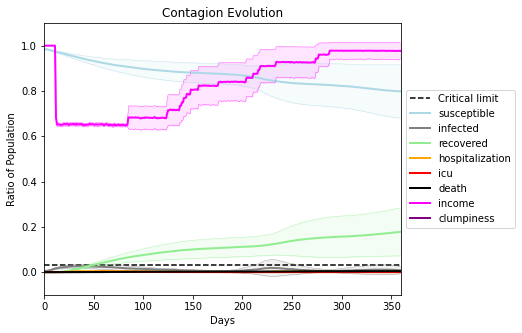

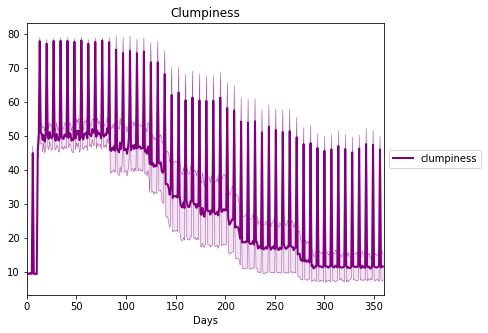

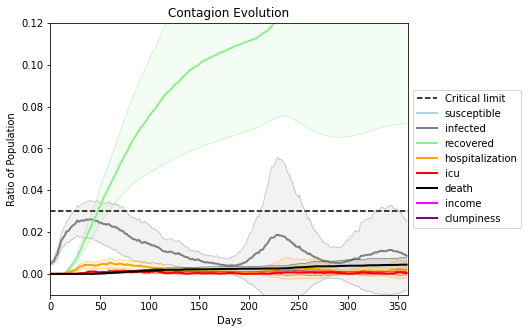

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.97
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T-.97", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )


Save these seeds if you want to rerun a scenario
[4540, 8722, 8291, 7112, 2932, 6975, 9118, 9446, 6227, 1689, 4464, 2018, 7632, 2150, 2284, 133, 5234, 6145, 1802, 7424]
Average similarity between family members is 0.032839388200288214 at temperature 1
Average similarity between family and home is 0.9999121288878756 at temperature -1
Average similarity between students and their classroom is 0.08165398719838983 at temperature 1
Average classroom occupancy is 12.5 and number classrooms is 24
Average similarity between workers is 0.011572720608940455 at temperature 1
Average office occupancy is 9.833333333333334 and number offices is 66
Average friend similarity for adults: 0.08438270925914051 for kids: 0.07486004232213739
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 

avg restaurant similarity 0.021631035235982827
disconnects
0.0
clumpiness 8.68
avg restaurant similarity 0.020943927999088792
disconnects
0.0
clumpiness 9.36
avg restaurant similarity 0.09882084754247682
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.11963116967376942
disconnects
0.0
clumpiness 8.84
avg restaurant similarity 0.03419558435733255
disconnects
0.0
clumpiness 8.84
avg restaurant similarity -0.00019502999925806208
disconnects
0.0
clumpiness 9.09
avg restaurant similarity -0.002591042257222945
disconnects
0.41
clumpiness 39.9
avg restaurant similarity 0.03220229207699069
disconnects
0.0
clumpiness 8.92
avg restaurant similarity -0.0035511619136057693
disconnects
0.0
clumpiness 8.94
avg restaurant similarity 0.031908826376664534
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.005775393528384029
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.06837319986559759
disconnects
0.4
clumpiness 39.94
avg restaurant similarity 0.10061605747160908
dis

avg restaurant similarity 0.006713738925442258
disconnects
0.53
clumpiness 48.97
avg restaurant similarity 0.011615943458327246
disconnects
0.5
clumpiness 47.61
avg restaurant similarity 0.019461479934340525
disconnects
0.92
clumpiness 74.31
avg restaurant similarity -0.029506747200663295
disconnects
0.54
clumpiness 49.32
avg restaurant similarity -0.0035405356703876803
disconnects
0.46
clumpiness 45.51
avg restaurant similarity 0.06576896617112808
disconnects
0.39
clumpiness 39.48
avg restaurant similarity 0.045003629804585395
disconnects
0.44
clumpiness 43.38
avg restaurant similarity 0.009925679711197946
disconnects
0.41
clumpiness 40.82
avg restaurant similarity 0.14206081016077024
disconnects
0.43
clumpiness 42.29
avg restaurant similarity -0.027936814521894043
disconnects
0.99
clumpiness 79.28
avg restaurant similarity 0.013057959512883929
disconnects
0.42
clumpiness 41.77
avg restaurant similarity 0.03358055838803409
disconnects
0.49
clumpiness 46.71
avg restaurant similarity 0.

disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.014585719426883264
disconnects
0.0
clumpiness 8.87
avg restaurant similarity 0.09298527970535266
disconnects
0.0
clumpiness 8.64
avg restaurant similarity 0.02303398058912805
disconnects
0.0
clumpiness 8.83
avg restaurant similarity 0.05238432579349443
disconnects
0.43
clumpiness 40.75
avg restaurant similarity 0.09590249856166361
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.006837129207851929
disconnects
0.0
clumpiness 8.75
avg restaurant similarity -0.004213890274966658
disconnects
0.0
clumpiness 8.57
avg restaurant similarity 0.07078413051667597
disconnects
0.0
clumpiness 8.86
avg restaurant similarity -0.03075267869159824
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.0440351244979531
disconnects
0.0
clumpiness 9.08
avg restaurant similarity 0.0685489547158127
disconnects
0.36
clumpiness 36.6
avg restaurant similarity 0.040498185255026325
disconnects
0.0
clumpiness 8.99
avg restaurant similarity

avg restaurant similarity -0.02286745875212188
disconnects
0.0
clumpiness 8.67
avg restaurant similarity 0.005040820533120183
disconnects
0.0
clumpiness 8.87
avg restaurant similarity -0.03022515789371261
disconnects
0.0
clumpiness 9.12
avg restaurant similarity -0.04223074741563951
disconnects
0.0
clumpiness 8.81
avg restaurant similarity -0.004771572934513971
disconnects
0.39
clumpiness 38.44
avg restaurant similarity 0.028542938803715705
disconnects
0.0
clumpiness 9.0
avg restaurant similarity 0.04800002159681937
disconnects
0.0
clumpiness 8.68
avg restaurant similarity 0.0371430173865808
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.010440779158894561
disconnects
0.0
clumpiness 8.76
avg restaurant similarity 0.04612885190301965
disconnects
0.0
clumpiness 8.77
avg restaurant similarity 0.00890773936147696
disconnects
0.0
clumpiness 8.46
avg restaurant similarity 0.10381447588393215
disconnects
0.37
clumpiness 36.95
avg restaurant similarity 0.05163424142449834
disconne

avg restaurant similarity -0.010172279371853062
disconnects
0.02
clumpiness 10.63
avg restaurant similarity -0.033138258075196075
disconnects
0.06
clumpiness 13.47
avg restaurant similarity 0.03408571984409882
disconnects
0.03
clumpiness 11.18
avg restaurant similarity 0.0678387703371511
disconnects
0.01
clumpiness 10.16
avg restaurant similarity 0.05087344080949478
disconnects
0.04
clumpiness 11.85
avg restaurant similarity -0.051191847332596484
disconnects
0.01
clumpiness 9.54
avg restaurant similarity 0.16332570487884515
disconnects
0.6
clumpiness 53.58
avg restaurant similarity 0.02653733650684009
disconnects
0.01
clumpiness 10.11
avg restaurant similarity 0.09489962799591611
disconnects
0.01
clumpiness 9.45
avg restaurant similarity 0.09373611078132935
disconnects
0.06
clumpiness 13.4
avg restaurant similarity -0.002431035194509856
disconnects
0.02
clumpiness 10.47
avg restaurant similarity 0.1241862262264689
disconnects
0.59
clumpiness 55.34
avg restaurant similarity 0.0540816383

avg restaurant similarity 0.05285048759086535
disconnects
0.63
clumpiness 58.37
avg restaurant similarity 0.043971617919060776
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.08511091831700295
disconnects
0.72
clumpiness 62.95
avg restaurant similarity -0.026405820666079945
disconnects
0.58
clumpiness 55.27
avg restaurant similarity 0.09134301645203469
disconnects
0.81
clumpiness 69.22
avg restaurant similarity 0.026890932012464185
disconnects
0.66
clumpiness 61.14
avg restaurant similarity 0.1948305118522911
disconnects
0.59
clumpiness 55.9
avg restaurant similarity 0.146760206230045
disconnects
0.73
clumpiness 62.98
avg restaurant similarity 0.11239177623532207
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.2198116911307134
disconnects
0.65
clumpiness 58.88
avg restaurant similarity 0.008555667023336058
disconnects
0.71
clumpiness 64.99
avg restaurant similarity -0.12153004980404156
disconnects
0.82
clumpiness 69.58
avg restaurant similarity 0.029734640880870

disconnects
0.01
clumpiness 9.5
avg restaurant similarity 0.09256393304940758
disconnects
0.01
clumpiness 10.13
avg restaurant similarity 0.14804884121158685
disconnects
0.0
clumpiness 9.38
avg restaurant similarity 0.062081308417513845
disconnects
0.04
clumpiness 12.56
avg restaurant similarity 0.08764449179771791
disconnects
0.5
clumpiness 46.31
avg restaurant similarity 0.1296133503321939
disconnects
0.02
clumpiness 10.79
avg restaurant similarity 0.12910569443461176
disconnects
0.02
clumpiness 10.56
avg restaurant similarity 0.13102929952071116
disconnects
0.03
clumpiness 11.31
avg restaurant similarity 0.12096283268756639
disconnects
0.03
clumpiness 11.21
avg restaurant similarity 0.05474851719242297
disconnects
0.01
clumpiness 9.96
avg restaurant similarity 0.06627151259774071
disconnects
0.01
clumpiness 9.7
avg restaurant similarity 0.05370556595694
disconnects
0.48
clumpiness 46.17
avg restaurant similarity 0.02239465006476751
disconnects
0.04
clumpiness 12.04
avg restaurant si

disconnects
0.01
clumpiness 9.63
avg restaurant similarity 0.057495549908516685
disconnects
0.07
clumpiness 13.96
avg restaurant similarity 0.0706928584396626
disconnects
0.05
clumpiness 12.5
avg restaurant similarity 0.02065817691073692
disconnects
0.02
clumpiness 11.09
avg restaurant similarity 0.15218962579983356
disconnects
0.0
clumpiness 8.93
avg restaurant similarity 0.10139781812038683
disconnects
0.01
clumpiness 10.02
avg restaurant similarity -0.007555418620019937
disconnects
0.54
clumpiness 49.67
avg restaurant similarity 0.12139980325972671
disconnects
0.04
clumpiness 12.22
avg restaurant similarity 0.07426232718939392
disconnects
0.03
clumpiness 11.08
avg restaurant similarity 0.18008079859968604
disconnects
0.01
clumpiness 9.81
avg restaurant similarity 0.12487132029189926
disconnects
0.01
clumpiness 9.88
avg restaurant similarity 0.11573915730533303
disconnects
0.05
clumpiness 12.8
avg restaurant similarity 0.11382600652583191
disconnects
0.01
clumpiness 10.01
avg restaur

avg restaurant similarity -0.0054108596922005986
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.08970199206129109
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.05824577436747217
disconnects
0.01
clumpiness 9.71
avg restaurant similarity -0.019735107574976266
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.048490163748196
disconnects
0.0
clumpiness 9.0
avg restaurant similarity 0.07746314109991341
disconnects
0.0
clumpiness 8.91
avg restaurant similarity 0.0012554241075685363
disconnects
0.4
clumpiness 38.97
avg restaurant similarity 0.061015009234188754
disconnects
0.0
clumpiness 8.6
avg restaurant similarity 0.10506826831808974
disconnects
0.0
clumpiness 9.18
avg restaurant similarity 0.09084433134501292
disconnects
0.01
clumpiness 9.86
avg restaurant similarity 0.05941569168701745
disconnects
0.0
clumpiness 8.98
avg restaurant similarity -0.021142372895159644
disconnects
0.45
clumpiness 44.26
avg restaurant similarity 0.015337866579067518
discon

disconnects
0.41
clumpiness 40.6
avg restaurant similarity 0.09536103028995856
disconnects
0.42
clumpiness 42.66
avg restaurant similarity 0.07835828250426365
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.02312803852876917
disconnects
0.47
clumpiness 44.44
avg restaurant similarity -0.02245739258288391
disconnects
0.48
clumpiness 45.19
avg restaurant similarity 0.06649046564204165
disconnects
0.42
clumpiness 42.19
avg restaurant similarity 0.051112617479505996
disconnects
0.5
clumpiness 47.13
avg restaurant similarity -0.014833013404264172
disconnects
0.45
clumpiness 43.02
avg restaurant similarity 0.04890788710819047
disconnects
0.46
clumpiness 44.45
avg restaurant similarity 0.04013095878334658
disconnects
0.97
clumpiness 77.75
avg restaurant similarity 0.0038277521976228896
disconnects
0.45
clumpiness 43.9
avg restaurant similarity 0.026444017734287832
disconnects
0.54
clumpiness 49.37
avg restaurant similarity 0.053956007591793045
disconnects
0.52
clumpiness 48.58
avg

avg restaurant similarity 0.04999371880102574
disconnects
0.54
clumpiness 49.83
avg restaurant similarity 0.039831579540151076
disconnects
0.48
clumpiness 45.16
avg restaurant similarity 0.03972764285525257
disconnects
0.54
clumpiness 49.35
avg restaurant similarity 0.115857609265996
disconnects
0.52
clumpiness 48.24
avg restaurant similarity 0.10547660247619262
disconnects
0.96
clumpiness 77.07
avg restaurant similarity 0.05862127295976909
disconnects
0.59
clumpiness 53.31
avg restaurant similarity 0.04922772767829557
disconnects
0.52
clumpiness 49.58
avg restaurant similarity 0.06579025424306832
disconnects
0.49
clumpiness 46.03
avg restaurant similarity 0.043399314136749266
disconnects
0.58
clumpiness 52.0
avg restaurant similarity 0.030831709206703948
disconnects
0.59
clumpiness 52.03
avg restaurant similarity 0.0060231387670820705
disconnects
0.46
clumpiness 43.4
avg restaurant similarity 0.019397060980337125
disconnects
0.96
clumpiness 77.03
avg restaurant similarity 0.0279921290

disconnects
0.46
clumpiness 43.16
avg restaurant similarity -0.02154351883391819
disconnects
0.01
clumpiness 9.91
avg restaurant similarity 0.07967497748996324
disconnects
0.01
clumpiness 9.67
avg restaurant similarity 0.07896773797769778
disconnects
0.0
clumpiness 9.18
avg restaurant similarity 0.10401765944634457
disconnects
0.02
clumpiness 10.68
avg restaurant similarity 0.016343070631388856
disconnects
0.01
clumpiness 9.19
avg restaurant similarity 0.055074982320915414
disconnects
0.02
clumpiness 10.76
avg restaurant similarity -0.001675892419688085
disconnects
0.4
clumpiness 39.21
avg restaurant similarity 0.002415293353119512
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.034787178708396205
disconnects
0.01
clumpiness 9.98
avg restaurant similarity 0.03854068798606753
disconnects
0.03
clumpiness 10.9
avg restaurant similarity 0.12619739757624887
disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.03553447537251305
disconnects
0.0
clumpiness 8.91
avg restauran

avg restaurant similarity 0.09564704028222841
disconnects
0.0
clumpiness 9.02
avg restaurant similarity 0.07054895782355633
disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.08754939405731174
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.07567660328375525
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.06896781186674852
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.015231371581543538
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.07692444031079766
disconnects
0.41
clumpiness 41.13
avg restaurant similarity 0.009772771312582878
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.05896780309622491
disconnects
0.0
clumpiness 8.79
avg restaurant similarity -0.0174240310756022
disconnects
0.0
clumpiness 9.08
avg restaurant similarity 0.060347510634028545
disconnects
0.0
clumpiness 8.75
avg restaurant similarity 0.07318844168956345
disconnects
0.39
clumpiness 40.97
avg restaurant similarity 0.11325502949672651
disconnects

disconnects
0.51
clumpiness 49.17
avg restaurant similarity 0.11172405213856451
disconnects
0.46
clumpiness 45.18
avg restaurant similarity 0.024381637541590076
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.14381097854314856
disconnects
0.47
clumpiness 46.96
avg restaurant similarity 0.009164584093172078
disconnects
0.49
clumpiness 46.49
avg restaurant similarity 0.10825126538495314
disconnects
0.54
clumpiness 50.05
avg restaurant similarity 0.06222299777300116
disconnects
0.53
clumpiness 50.66
avg restaurant similarity 0.022698050394529014
disconnects
0.51
clumpiness 48.91
avg restaurant similarity 0.10757368699188352
disconnects
0.56
clumpiness 51.89
avg restaurant similarity -0.03468338468586319
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.08209343390527316
disconnects
0.52
clumpiness 49.0
avg restaurant similarity 0.07342245072561596
disconnects
0.55
clumpiness 50.76
avg restaurant similarity 0.023722202136057052
disconnects
0.49
clumpiness 47.32
avg re

avg restaurant similarity -0.016778221321135413
disconnects
0.44
clumpiness 43.63
avg restaurant similarity 0.03143255046629898
disconnects
0.51
clumpiness 48.64
avg restaurant similarity 0.08254494650954819
disconnects
0.53
clumpiness 50.45
avg restaurant similarity 0.0720205836346852
disconnects
0.53
clumpiness 50.46
avg restaurant similarity 0.043654843288494324
disconnects
0.98
clumpiness 78.48
avg restaurant similarity -0.011121164285004157
disconnects
0.46
clumpiness 45.63
avg restaurant similarity 0.08420491951985944
disconnects
0.46
clumpiness 45.02
avg restaurant similarity 0.09122174504805584
disconnects
0.5
clumpiness 48.07
avg restaurant similarity 0.05364816321259874
disconnects
0.6
clumpiness 53.71
avg restaurant similarity 0.1323021165042804
disconnects
0.4
clumpiness 44.36
avg restaurant similarity 0.07519323728372347
disconnects
0.51
clumpiness 50.18
avg restaurant similarity 0.13033035403783852
disconnects
0.97
clumpiness 77.79
avg restaurant similarity 0.032398970116

avg restaurant similarity 0.04444319853602401
disconnects
0.0
clumpiness 9.08
avg restaurant similarity 0.009800901735410742
disconnects
0.0
clumpiness 8.83
avg restaurant similarity 0.018962662699773276
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.0056293913909360605
disconnects
0.0
clumpiness 9.22
avg restaurant similarity 0.09808740062304873
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.06396218358435046
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.005727732115175159
disconnects
0.52
clumpiness 47.24
avg restaurant similarity 0.0778310529465749
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.0347944843419166
disconnects
0.0
clumpiness 9.18
avg restaurant similarity 0.029318270008270583
disconnects
0.0
clumpiness 9.51
avg restaurant similarity 0.15559262423386366
disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.08641382090408353
disconnects
0.0
clumpiness 9.29
avg restaurant similarity -0.051012532862293694
disconnect

avg restaurant similarity 0.026320663862535978
disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.011890312609041305
disconnects
0.02
clumpiness 10.13
avg restaurant similarity 0.04678918131795498
disconnects
0.01
clumpiness 9.65
avg restaurant similarity 0.08398938817968589
disconnects
0.0
clumpiness 9.04
avg restaurant similarity 0.024463212249862247
disconnects
0.0
clumpiness 9.24
avg restaurant similarity 0.07444867378434927
disconnects
0.0
clumpiness 8.84
avg restaurant similarity 0.023142501989736653
disconnects
0.43
clumpiness 41.02
avg restaurant similarity -0.01748490821904362
disconnects
0.0
clumpiness 8.67
avg restaurant similarity -0.022327885502849202
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.061679484300895045
disconnects
0.0
clumpiness 8.75
avg restaurant similarity -0.02734715565099321
disconnects
0.0
clumpiness 8.56
avg restaurant similarity -0.041664989762574364
disconnects
0.45
clumpiness 43.95
avg restaurant similarity 0.01319268088651248


avg restaurant similarity 0.062424738218262964
disconnects
0.52
clumpiness 48.11
avg restaurant similarity -0.02507664531138639
disconnects
0.48
clumpiness 45.62
avg restaurant similarity 0.013754272616559647
disconnects
0.97
clumpiness 77.78
avg restaurant similarity 0.04833404320967048
disconnects
0.55
clumpiness 50.49
avg restaurant similarity 0.006279650430557355
disconnects
0.45
clumpiness 43.9
avg restaurant similarity -0.02506747757524138
disconnects
0.46
clumpiness 44.71
avg restaurant similarity -0.07020360737248098
disconnects
0.49
clumpiness 46.4
avg restaurant similarity -0.01147932194092584
disconnects
0.52
clumpiness 48.07
avg restaurant similarity 0.02953800693962655
disconnects
0.56
clumpiness 51.12
avg restaurant similarity -0.006933689864741316
disconnects
0.94
clumpiness 75.69
avg restaurant similarity 0.0058367641404762196
disconnects
0.54
clumpiness 50.12
avg restaurant similarity -0.034722525190230655
disconnects
0.41
clumpiness 41.65
avg restaurant similarity -0.

disconnects
0.59
clumpiness 53.44
avg restaurant similarity 0.024295530217818637
disconnects
0.54
clumpiness 50.07
avg restaurant similarity -0.009097337816544608
disconnects
0.61
clumpiness 53.97
avg restaurant similarity -0.030540111054681723
disconnects
0.62
clumpiness 54.77
avg restaurant similarity 0.0845998779981768
disconnects
0.48
clumpiness 46.55
avg restaurant similarity 0.03601905317847595
disconnects
0.55
clumpiness 51.0
avg restaurant similarity 0.036847023123940496
disconnects
0.96
clumpiness 77.17
avg restaurant similarity 0.03315963528092788
disconnects
0.47
clumpiness 45.98
avg restaurant similarity -0.032798170898231095
disconnects
0.62
clumpiness 55.4
avg restaurant similarity 0.05202740575781203
disconnects
0.53
clumpiness 48.72
avg restaurant similarity 0.0714807580214114
disconnects
0.56
clumpiness 50.33
avg restaurant similarity 0.029352327554714383
disconnects
0.44
clumpiness 43.54
avg restaurant similarity 0.031160620218742753
disconnects
0.6
clumpiness 53.68
a

disconnects
0.51
clumpiness 48.62
avg restaurant similarity -0.03247584481610651
disconnects
0.55
clumpiness 50.25
avg restaurant similarity -0.021451754677743656
disconnects
0.95
clumpiness 76.56
avg restaurant similarity 0.003462381075264828
disconnects
0.55
clumpiness 50.67
avg restaurant similarity 0.002054315773984041
disconnects
0.69
clumpiness 59.72
avg restaurant similarity 0.06980174978720742
disconnects
0.51
clumpiness 47.12
avg restaurant similarity 0.04769848476001623
disconnects
0.64
clumpiness 56.14
avg restaurant similarity -0.007922559778480767
disconnects
0.5
clumpiness 47.28
avg restaurant similarity 0.02972792050565614
disconnects
0.63
clumpiness 55.32
avg restaurant similarity -0.020763118412420567
disconnects
1.0
clumpiness 80.0
avg restaurant similarity -0.0007605022937176782
disconnects
0.49
clumpiness 46.17
avg restaurant similarity 0.07026136502859773
disconnects
0.41
clumpiness 43.21
avg restaurant similarity 0.07779071238606032
disconnects
0.55
clumpiness 50.

avg restaurant similarity -0.06427134351629848
disconnects
0.0
clumpiness 8.93
avg restaurant similarity -0.021826963984897696
disconnects
0.0
clumpiness 9.01
avg restaurant similarity -0.03209410714180777
disconnects
0.0
clumpiness 8.37
avg restaurant similarity 0.0517584627211604
disconnects
0.0
clumpiness 9.12
avg restaurant similarity -0.04129508170210798
disconnects
0.0
clumpiness 8.87
avg restaurant similarity -0.08173688173526282
disconnects
0.0
clumpiness 9.26
avg restaurant similarity -0.0976014233536516
disconnects
0.54
clumpiness 48.87
avg restaurant similarity 0.0036838220776830013
disconnects
0.0
clumpiness 8.92
avg restaurant similarity -0.0429632352276922
disconnects
0.0
clumpiness 9.24
avg restaurant similarity -0.011974312414777078
disconnects
0.0
clumpiness 8.71
avg restaurant similarity 0.024130402067007086
disconnects
0.0
clumpiness 8.88
avg restaurant similarity -0.10344558970865705
disconnects
0.48
clumpiness 46.94
avg restaurant similarity -0.15580712468005936
di

disconnects
0.58
clumpiness 53.48
avg restaurant similarity -0.0345187212091144
disconnects
0.48
clumpiness 46.1
avg restaurant similarity 0.015687763672258322
disconnects
0.63
clumpiness 55.53
avg restaurant similarity 0.01689550160663959
disconnects
1.0
clumpiness 80.0
avg restaurant similarity -0.0686052731478017
disconnects
0.61
clumpiness 55.23
avg restaurant similarity -0.031369022727285194
disconnects
0.58
clumpiness 53.1
avg restaurant similarity -0.025073778561928488
disconnects
0.42
clumpiness 42.74
avg restaurant similarity -0.024210075241931302
disconnects
0.62
clumpiness 55.26
avg restaurant similarity -0.042214788430558606
disconnects
0.39
clumpiness 41.84
avg restaurant similarity -0.01847032918471792
disconnects
0.51
clumpiness 48.04
avg restaurant similarity -0.09011958416978784
disconnects
0.98
clumpiness 78.5
avg restaurant similarity 0.005330086956817625
disconnects
0.47
clumpiness 46.61
avg restaurant similarity 0.03720861440561989
disconnects
0.5
clumpiness 47.29


disconnects
0.0
clumpiness 9.1
avg restaurant similarity -0.01496145130562024
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.01929243925577419
disconnects
0.0
clumpiness 9.4
avg restaurant similarity -0.0218346153653279
disconnects
0.0
clumpiness 9.35
avg restaurant similarity -0.0960847041878238
disconnects
0.0
clumpiness 9.01
avg restaurant similarity -0.07846781053205386
disconnects
0.47
clumpiness 44.77
avg restaurant similarity -0.033256802795027685
disconnects
0.0
clumpiness 8.95
avg restaurant similarity 0.01510541232086206
disconnects
0.0
clumpiness 9.19
avg restaurant similarity -0.033302599292878064
disconnects
0.0
clumpiness 9.04
avg restaurant similarity -0.09082168905095596
disconnects
0.0
clumpiness 9.34
avg restaurant similarity -0.056619340819169285
disconnects
0.0
clumpiness 9.13
avg restaurant similarity -0.018695878178597043
disconnects
0.0
clumpiness 9.12
avg restaurant similarity -0.09092446766270117
disconnects
0.49
clumpiness 45.5
avg restaurant simi

avg restaurant similarity 0.07293999866120537
disconnects
0.0
clumpiness 8.83
avg restaurant similarity -0.016585704588733027
disconnects
0.0
clumpiness 9.09
avg restaurant similarity -0.012305019334537233
disconnects
0.0
clumpiness 9.21
avg restaurant similarity -0.02148070782113544
disconnects
0.0
clumpiness 8.86
avg restaurant similarity -0.101418305434869
disconnects
0.0
clumpiness 8.8
avg restaurant similarity -0.006945437842912359
disconnects
0.0
clumpiness 8.85
avg restaurant similarity -0.0028571076876168456
disconnects
0.44
clumpiness 43.36
avg restaurant similarity 0.027417395415846573
disconnects
0.0
clumpiness 9.0
avg restaurant similarity -0.08801274875432406
disconnects
0.0
clumpiness 9.03
avg restaurant similarity -0.01966254029148609
disconnects
0.0
clumpiness 9.0
avg restaurant similarity 0.014230757194014823
disconnects
0.0
clumpiness 8.9
avg restaurant similarity -0.07701528801672089
disconnects
0.0
clumpiness 8.78
avg restaurant similarity -0.02276128449423612
disco

avg restaurant similarity 0.09071199487444906
disconnects
0.0
clumpiness 8.86
avg restaurant similarity 0.10843462228154303
disconnects
0.0
clumpiness 8.69
avg restaurant similarity 0.06346526989103318
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.09249493519520245
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.14915102095155205
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.09378576146099639
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.08525350780460694
disconnects
0.5
clumpiness 45.89
avg restaurant similarity 0.08994153172821075
disconnects
0.01
clumpiness 9.52
avg restaurant similarity -0.02738160057799188
disconnects
0.0
clumpiness 8.9
avg restaurant similarity 0.17524743787789812
disconnects
0.0
clumpiness 8.63
avg restaurant similarity 0.059871781349266996
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.12187069697023532
disconnects
0.43
clumpiness 42.64
avg restaurant similarity 0.07003645066644856
disconnects
0

avg restaurant similarity 0.10693622555237822
disconnects
0.45
clumpiness 43.46
avg restaurant similarity 0.11431265766945957
disconnects
0.98
clumpiness 78.48
avg restaurant similarity 0.0955189874695807
disconnects
0.55
clumpiness 50.88
avg restaurant similarity 0.12346876061876999
disconnects
0.6
clumpiness 54.16
avg restaurant similarity 0.08662882378882691
disconnects
0.49
clumpiness 47.08
avg restaurant similarity 0.12160408937978065
disconnects
0.0
clumpiness 9.24
avg restaurant similarity 0.2048137501021644
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.10239535526487237
disconnects
0.0
clumpiness 8.9
avg restaurant similarity 0.11327847733073576
disconnects
0.35
clumpiness 35.79
avg restaurant similarity 0.1162528869442397
disconnects
0.0
clumpiness 8.57
avg restaurant similarity 0.12312406673322437
disconnects
0.01
clumpiness 9.95
avg restaurant similarity 0.12446477908697222
disconnects
0.0
clumpiness 8.55
avg restaurant similarity 0.09013047949728177
disconnect

avg restaurant similarity 0.10747650584576922
disconnects
0.01
clumpiness 9.86
avg restaurant similarity 0.055827825141706394
disconnects
0.37
clumpiness 37.01
avg restaurant similarity 0.09764424040651964
disconnects
0.0
clumpiness 9.35
avg restaurant similarity 0.13181460783558852
disconnects
0.0
clumpiness 8.75
avg restaurant similarity 0.14675706877289985
disconnects
0.0
clumpiness 8.72
avg restaurant similarity 0.13184173282022302
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.09409318791985367
disconnects
0.01
clumpiness 10.14
avg restaurant similarity 0.12385740379655233
disconnects
0.0
clumpiness 8.97
avg restaurant similarity 0.06163508056928914
disconnects
0.43
clumpiness 40.97
avg restaurant similarity 0.10733218219698618
disconnects
0.01
clumpiness 9.65
avg restaurant similarity 0.1011872212078314
disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.09368375644454584
disconnects
0.0
clumpiness 8.7
avg restaurant similarity 0.11107086726017569
disconnects

avg restaurant similarity 0.09545539880252157
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.0946369786245384
disconnects
0.4
clumpiness 39.04
avg restaurant similarity 0.09377248676371916
disconnects
0.01
clumpiness 9.42
avg restaurant similarity 0.0751758481227537
disconnects
0.0
clumpiness 8.72
avg restaurant similarity 0.09777625248098737
disconnects
0.0
clumpiness 8.77
avg restaurant similarity 0.07944518336977872
disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.03009640944099734
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.15926180674785057
disconnects
0.0
clumpiness 8.94
avg restaurant similarity 0.1558735587712844
disconnects
0.38
clumpiness 37.79
avg restaurant similarity 0.1308323663778477
disconnects
0.01
clumpiness 9.6
avg restaurant similarity 0.09337760339644782
disconnects
0.0
clumpiness 8.87
avg restaurant similarity 0.14486890904833746
disconnects
0.01
clumpiness 9.19
avg restaurant similarity 0.06491056869652292
disconnects
0.01


avg restaurant similarity 0.0030113633035581833
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.04040405397359096
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.012588864308965744
disconnects
0.0
clumpiness 8.68
avg restaurant similarity 0.052543238241653245
disconnects
0.0
clumpiness 8.81
avg restaurant similarity 0.003813526034854753
disconnects
0.0
clumpiness 8.86
avg restaurant similarity 0.0628824589150316
disconnects
0.0
clumpiness 8.86
avg restaurant similarity 0.07938494725504217
disconnects
0.53
clumpiness 47.72
avg restaurant similarity 0.057911777793616226
disconnects
0.01
clumpiness 10.12
avg restaurant similarity 0.011898041241675277
disconnects
0.0
clumpiness 8.94
avg restaurant similarity 0.08434092382621068
disconnects
0.0
clumpiness 8.87
avg restaurant similarity 0.12231547184219053
disconnects
0.02
clumpiness 10.54
avg restaurant similarity 0.04196106820629051
disconnects
0.35
clumpiness 37.7
avg restaurant similarity 0.06096033025670668
discon

avg restaurant similarity 0.03624999937416538
disconnects
0.0
clumpiness 8.72
avg restaurant similarity 0.04568315032579056
disconnects
0.44
clumpiness 42.1
avg restaurant similarity 0.044052630369253255
disconnects
0.0
clumpiness 8.68
avg restaurant similarity 0.07905664866209978
disconnects
0.02
clumpiness 10.72
avg restaurant similarity 0.09021825290190912
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.0436669953946358
disconnects
0.01
clumpiness 9.71
avg restaurant similarity 0.06888431651093276
disconnects
0.02
clumpiness 10.32
avg restaurant similarity 0.05406121839235324
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.03302870502586569
disconnects
0.48
clumpiness 44.06
avg restaurant similarity 0.01768245458913124
disconnects
0.01
clumpiness 9.79
avg restaurant similarity 0.14515119926599204
disconnects
0.02
clumpiness 10.41
avg restaurant similarity 0.006781566019893891
disconnects
0.0
clumpiness 8.56
avg restaurant similarity 0.05351714776286607
disconn

disconnects
0.0
clumpiness 8.65
avg restaurant similarity 0.049254063382020645
disconnects
0.03
clumpiness 10.96
avg restaurant similarity 0.11092186273803804
disconnects
0.44
clumpiness 41.33
avg restaurant similarity 0.09685815295918748
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.02839411698122083
disconnects
0.0
clumpiness 8.81
avg restaurant similarity 0.1541816645311997
disconnects
0.0
clumpiness 9.04
avg restaurant similarity 0.007235335783497764
disconnects
0.0
clumpiness 8.73
avg restaurant similarity 0.07831062257275428
disconnects
0.0
clumpiness 8.66
avg restaurant similarity 0.012811672355963595
disconnects
0.0
clumpiness 8.84
avg restaurant similarity 0.11690353848996528
disconnects
0.5
clumpiness 45.73
avg restaurant similarity 0.06228363531007764
disconnects
0.0
clumpiness 8.87
avg restaurant similarity 0.018276070752609196
disconnects
0.0
clumpiness 9.12
avg restaurant similarity 0.053065965200769734
disconnects
0.02
clumpiness 10.26
avg restaurant simila

disconnects
0.0
clumpiness 9.01
avg restaurant similarity 0.07333370543019027
disconnects
0.0
clumpiness 8.67
avg restaurant similarity 0.04932277625412464
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.026547688363667443
disconnects
0.5
clumpiness 45.38
avg restaurant similarity 0.02970824695687858
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.013415247578316988
disconnects
0.0
clumpiness 8.77
avg restaurant similarity 0.008239164443604575
disconnects
0.01
clumpiness 9.72
avg restaurant similarity 0.007609013499107428
disconnects
0.0
clumpiness 8.93
avg restaurant similarity 0.055611837503550345
disconnects
0.0
clumpiness 8.79
avg restaurant similarity 0.10070403022060556
disconnects
0.0
clumpiness 8.79
avg restaurant similarity 0.03251273721128463
disconnects
0.41
clumpiness 39.37
avg restaurant similarity 0.09387842353962471
disconnects
0.01
clumpiness 9.74
avg restaurant similarity 0.08054079263525024
disconnects
0.0
clumpiness 8.81
avg restaurant similari

avg restaurant similarity 0.10760482179991644
disconnects
0.01
clumpiness 9.64
avg restaurant similarity 0.12386819381120256
disconnects
0.01
clumpiness 9.72
avg restaurant similarity 0.05030409500068283
disconnects
0.01
clumpiness 10.06
avg restaurant similarity 0.03515686220133619
disconnects
0.0
clumpiness 8.81
avg restaurant similarity 0.06139102281102827
disconnects
0.02
clumpiness 10.58
avg restaurant similarity 0.06531385324518481
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.14562243869890157
disconnects
0.45
clumpiness 42.17
avg restaurant similarity 0.123005897971317
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.07870627780965962
disconnects
0.01
clumpiness 9.72
avg restaurant similarity 0.021154107367474778
disconnects
0.02
clumpiness 10.58
avg restaurant similarity 0.0787501078615798
disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.12604274841803484
disconnects
0.43
clumpiness 42.18
avg restaurant similarity 0.10224660815694273
disconne

avg restaurant similarity 0.06385739520023423
disconnects
0.6
clumpiness 53.59
avg restaurant similarity 0.10451240154917431
disconnects
0.93
clumpiness 75.28
avg restaurant similarity 0.09376770916690079
disconnects
0.54
clumpiness 49.11
avg restaurant similarity 0.052491677760866697
disconnects
0.62
clumpiness 55.24
avg restaurant similarity 0.11333944593006945
disconnects
0.66
clumpiness 57.18
avg restaurant similarity 0.11578462208482651
disconnects
0.51
clumpiness 47.03
avg restaurant similarity 0.09446135059958809
disconnects
0.48
clumpiness 46.35
avg restaurant similarity 0.027660407989346686
disconnects
0.41
clumpiness 41.0
avg restaurant similarity 0.0936340300895948
disconnects
0.99
clumpiness 79.25
avg restaurant similarity 0.06234304355882583
disconnects
0.45
clumpiness 42.61
avg restaurant similarity 0.07043697451892067
disconnects
0.61
clumpiness 54.34
avg restaurant similarity 0.08117021127447592
disconnects
0.61
clumpiness 53.71
avg restaurant similarity 0.0779589509925

disconnects
0.01
clumpiness 9.75
avg restaurant similarity 0.06206439979974147
disconnects
0.0
clumpiness 8.58
avg restaurant similarity 0.052432891942687083
disconnects
0.45
clumpiness 42.05
avg restaurant similarity 0.07737638768207324
disconnects
0.0
clumpiness 8.83
avg restaurant similarity 0.13890590829186433
disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.1111173483291801
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.11175537865578113
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.0449156913058004
disconnects
0.01
clumpiness 9.84
avg restaurant similarity 0.05474064023095305
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.10500808422840255
disconnects
0.48
clumpiness 44.61
avg restaurant similarity 0.04212130199174215
disconnects
0.0
clumpiness 8.91
avg restaurant similarity 0.1330782264709802
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.1017183988637337
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.0

disconnects
0.0
clumpiness 8.93
avg restaurant similarity 0.0875310519861319
disconnects
0.0
clumpiness 9.04
avg restaurant similarity 0.06223915601317173
disconnects
0.49
clumpiness 45.28
avg restaurant similarity 0.05048415271427265
disconnects
0.0
clumpiness 8.68
avg restaurant similarity 0.028112163639840027
disconnects
0.01
clumpiness 9.83
avg restaurant similarity 0.022802637719584355
disconnects
0.02
clumpiness 10.9
avg restaurant similarity 0.09756889555518045
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.04802963029485473
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.12864589172563495
disconnects
0.01
clumpiness 9.89
avg restaurant similarity 0.04512056065838318
disconnects
0.41
clumpiness 39.6
avg restaurant similarity 0.08881713176973163
disconnects
0.0
clumpiness 8.73
avg restaurant similarity 0.0871204663071377
disconnects
0.0
clumpiness 8.78
avg restaurant similarity 0.07150975404630008
disconnects
0.0
clumpiness 8.8
avg restaurant similarity 0

avg restaurant similarity -0.04024766956340519
disconnects
0.01
clumpiness 9.47
avg restaurant similarity -0.011757785136514197
disconnects
0.02
clumpiness 10.4
avg restaurant similarity -0.04616674542431678
disconnects
0.0
clumpiness 9.04
avg restaurant similarity -0.01888530037149087
disconnects
0.01
clumpiness 9.74
avg restaurant similarity 0.032333566907463945
disconnects
0.0
clumpiness 9.24
avg restaurant similarity -0.010644734089221907
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.013980058769105269
disconnects
0.5
clumpiness 45.3
avg restaurant similarity 0.01955483673166854
disconnects
0.0
clumpiness 8.85
avg restaurant similarity -0.03517112865710263
disconnects
0.01
clumpiness 9.51
avg restaurant similarity 0.0647136492318757
disconnects
0.0
clumpiness 8.86
avg restaurant similarity -0.022832111734536243
disconnects
0.01
clumpiness 9.98
avg restaurant similarity -0.0064704917422492405
disconnects
0.5
clumpiness 46.28
avg restaurant similarity 0.0395335639499405

disconnects
0.45
clumpiness 42.83
avg restaurant similarity 0.08046823763704401
disconnects
0.49
clumpiness 46.4
avg restaurant similarity 0.006182958016068944
disconnects
0.46
clumpiness 45.98
avg restaurant similarity -0.06929230153199475
disconnects
0.98
clumpiness 78.54
avg restaurant similarity -0.0014647040765794629
disconnects
0.4
clumpiness 39.91
avg restaurant similarity -0.009209765976539441
disconnects
0.44
clumpiness 42.99
avg restaurant similarity -0.02148199659321386
disconnects
0.51
clumpiness 47.56
avg restaurant similarity 0.022361770084045357
disconnects
0.46
clumpiness 44.41
avg restaurant similarity -0.017273501725608174
disconnects
0.49
clumpiness 46.2
avg restaurant similarity -0.04863324836722221
disconnects
0.57
clumpiness 51.41
avg restaurant similarity -0.02689279262911293
disconnects
0.95
clumpiness 76.51
avg restaurant similarity 0.013277666826124176
disconnects
0.31
clumpiness 34.57
avg restaurant similarity -0.06277483710230372
disconnects
0.51
clumpiness 

avg restaurant similarity -0.009183073741588811
disconnects
0.0
clumpiness 8.8
avg restaurant similarity -0.003939992752832735
disconnects
0.01
clumpiness 9.41
avg restaurant similarity -0.0341193060932915
disconnects
0.03
clumpiness 10.94
avg restaurant similarity 0.056348693667159395
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.012199910620383144
disconnects
0.0
clumpiness 8.91
avg restaurant similarity -0.052177109524740806
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.05020967380637163
disconnects
0.44
clumpiness 41.46
avg restaurant similarity 0.054968615831135235
disconnects
0.0
clumpiness 8.98
avg restaurant similarity -0.003144891312063456
disconnects
0.0
clumpiness 8.75
avg restaurant similarity 0.008617360919042681
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.1003370482399151
disconnects
0.0
clumpiness 9.45
avg restaurant similarity 0.06631831353752178
disconnects
0.0
clumpiness 8.84
avg restaurant similarity -0.025379029194884238
d

avg restaurant similarity -0.022309544718500468
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.003171688051822594
disconnects
0.5
clumpiness 45.6
avg restaurant similarity 0.019370282410415055
disconnects
0.0
clumpiness 8.74
avg restaurant similarity -0.014010077789293442
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.03571737805977344
disconnects
0.0
clumpiness 8.82
avg restaurant similarity 0.03557652778159899
disconnects
0.02
clumpiness 10.07
avg restaurant similarity -0.030726247015666956
disconnects
0.0
clumpiness 8.57
avg restaurant similarity -0.0401000413831238
disconnects
0.01
clumpiness 9.42
avg restaurant similarity -0.011908050894633971
disconnects
0.48
clumpiness 44.56
avg restaurant similarity -0.04922473506101914
disconnects
0.0
clumpiness 8.65
avg restaurant similarity 0.003042319731126122
disconnects
0.0
clumpiness 8.97
avg restaurant similarity 0.021255469589251952
disconnects
0.01
clumpiness 9.54
avg restaurant similarity -0.0252537418444728

avg restaurant similarity 0.07524730441002256
disconnects
0.01
clumpiness 9.89
avg restaurant similarity -0.025176329372517035
disconnects
0.0
clumpiness 8.86
avg restaurant similarity -0.0034144481712237553
disconnects
0.0
clumpiness 9.25
avg restaurant similarity 0.02125442764513102
disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.034061370118564235
disconnects
0.01
clumpiness 9.69
avg restaurant similarity -0.10444020962879343
disconnects
0.01
clumpiness 9.75
avg restaurant similarity 0.05746897743573747
disconnects
0.47
clumpiness 43.6
avg restaurant similarity 0.11908650989764269
disconnects
0.0
clumpiness 8.97
avg restaurant similarity 0.03543086473166334
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.03325855731148891
disconnects
0.01
clumpiness 9.73
avg restaurant similarity -0.0098486752855681
disconnects
0.01
clumpiness 9.57
avg restaurant similarity -0.026707527790089187
disconnects
0.39
clumpiness 41.58
avg restaurant similarity -0.00599587631613485


avg restaurant similarity 0.0824110795361552
disconnects
0.55
clumpiness 50.62
avg restaurant similarity -0.07257628609544521
disconnects
0.59
clumpiness 53.96
avg restaurant similarity 0.05066211397347355
disconnects
0.99
clumpiness 79.28
avg restaurant similarity 0.06269574047612056
disconnects
0.52
clumpiness 48.92
avg restaurant similarity 0.001712838690797315
disconnects
0.63
clumpiness 55.86
avg restaurant similarity -0.023613751279206084
disconnects
0.53
clumpiness 50.51
avg restaurant similarity 0.016942776223151046
disconnects
0.61
clumpiness 54.39
avg restaurant similarity -0.00900320944186054
disconnects
0.6
clumpiness 54.58
avg restaurant similarity 0.028876669232832993
disconnects
0.54
clumpiness 49.65
avg restaurant similarity 0.027962734457995856
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.0756888844928732
disconnects
0.53
clumpiness 49.43
avg restaurant similarity 0.022038735923127162
disconnects
0.53
clumpiness 50.2
avg restaurant similarity 0.0438827

avg restaurant similarity 0.04216877365880182
disconnects
0.01
clumpiness 9.52
avg restaurant similarity -0.007272710478130486
disconnects
0.01
clumpiness 9.8
avg restaurant similarity 0.016442979547248576
disconnects
0.03
clumpiness 10.85
avg restaurant similarity 0.019802686603482503
disconnects
0.01
clumpiness 9.56
avg restaurant similarity 0.015334204319859601
disconnects
0.5
clumpiness 45.97
avg restaurant similarity -0.02712739799036281
disconnects
0.0
clumpiness 8.95
avg restaurant similarity -0.027889540478759176
disconnects
0.0
clumpiness 9.08
avg restaurant similarity 0.005123841632453002
disconnects
0.01
clumpiness 9.89
avg restaurant similarity 0.08487381438192572
disconnects
0.0
clumpiness 9.04
avg restaurant similarity 0.0654766779078595
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.08723769204870176
disconnects
0.0
clumpiness 8.87
avg restaurant similarity -0.0137032208577132
disconnects
0.49
clumpiness 44.98
avg restaurant similarity 0.0883604456196605
dis

disconnects
0.02
clumpiness 10.1
avg restaurant similarity 0.0039728276671290065
disconnects
0.0
clumpiness 8.69
avg restaurant similarity 0.034952435048524154
disconnects
0.01
clumpiness 9.7
avg restaurant similarity -0.018341383308463702
disconnects
0.02
clumpiness 10.3
avg restaurant similarity 0.010443457490003796
disconnects
0.04
clumpiness 11.54
avg restaurant similarity -0.0014291082895978636
disconnects
0.03
clumpiness 11.41
avg restaurant similarity 0.039292527284490474
disconnects
0.5
clumpiness 46.65
avg restaurant similarity 0.09300862731903622
disconnects
0.02
clumpiness 10.29
avg restaurant similarity 0.0007664346750592174
disconnects
0.0
clumpiness 9.28
avg restaurant similarity -0.015707001473266136
disconnects
0.0
clumpiness 9.07
avg restaurant similarity -0.029543890132013507
disconnects
0.01
clumpiness 9.56
avg restaurant similarity -0.01962251737475639
disconnects
0.01
clumpiness 9.84
avg restaurant similarity -0.005776748702410805
disconnects
0.0
clumpiness 8.87
av

avg restaurant similarity 0.037766998005816815
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.10414765472084318
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.06851718945092225
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.07715190656382356
disconnects
0.0
clumpiness 8.94
avg restaurant similarity 0.1710795529880662
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.08134019889244645
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.11366047949949497
disconnects
0.53
clumpiness 49.02
avg restaurant similarity 0.10939174505538331
disconnects
0.0
clumpiness 9.42
avg restaurant similarity 0.05339467346539674
disconnects
0.0
clumpiness 8.98
avg restaurant similarity 0.11063288680637419
disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.10839233092991231
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.059977831189515086
disconnects
0.54
clumpiness 50.78
avg restaurant similarity 0.09036948639495142
disconnects
0.

disconnects
0.52
clumpiness 49.76
avg restaurant similarity 0.0779235711421008
disconnects
0.98
clumpiness 78.46
avg restaurant similarity 0.1126001421198451
disconnects
0.51
clumpiness 49.33
avg restaurant similarity 0.07907575031272328
disconnects
0.53
clumpiness 51.99
avg restaurant similarity 0.12169624089994303
disconnects
0.54
clumpiness 52.36
avg restaurant similarity 0.0639596843341537
disconnects
0.49
clumpiness 48.88
avg restaurant similarity 0.0861757967590991
disconnects
0.57
clumpiness 52.88
avg restaurant similarity 0.1615329641750952
disconnects
0.48
clumpiness 47.1
avg restaurant similarity 0.0721707211032797
disconnects
0.99
clumpiness 79.3
avg restaurant similarity 0.15048862200815827
disconnects
0.49
clumpiness 47.78
avg restaurant similarity 0.03138538104409837
disconnects
0.56
clumpiness 51.3
avg restaurant similarity 0.15490042329879808
disconnects
0.56
clumpiness 51.35
avg restaurant similarity -0.0047045527353844485
disconnects
0.57
clumpiness 52.85
avg restaura

avg restaurant similarity 0.09009884502520346
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.06645589501419272
disconnects
0.0
clumpiness 9.31
avg restaurant similarity 0.19173213122806318
disconnects
0.51
clumpiness 47.83
avg restaurant similarity 0.13314282049067439
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.09808226301783522
disconnects
0.0
clumpiness 9.06
avg restaurant similarity 0.18181784464291345
disconnects
0.0
clumpiness 9.62
avg restaurant similarity 0.11173681628264555
disconnects
0.0
clumpiness 9.53
avg restaurant similarity -0.0043909952835456696
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.06878936397364234
disconnects
0.0
clumpiness 9.48
avg restaurant similarity 0.08940778079131062
disconnects
0.7
clumpiness 59.71
avg restaurant similarity 0.10654296926752282
disconnects
0.0
clumpiness 8.93
avg restaurant similarity 0.050999747069679816
disconnects
0.0
clumpiness 9.57
avg restaurant similarity 0.10812553188232392
disconnects

avg restaurant similarity 0.0913802767736311
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.176023638884514
disconnects
0.0
clumpiness 8.97
avg restaurant similarity 0.07374340745522423
disconnects
0.52
clumpiness 47.47
avg restaurant similarity 0.11693547261086537
disconnects
0.0
clumpiness 9.0
avg restaurant similarity 0.1878306789669803
disconnects
0.0
clumpiness 8.83
avg restaurant similarity 0.10854912376830092
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.17815347786776986
disconnects
0.0
clumpiness 9.34
avg restaurant similarity 0.11471686768169174
disconnects
0.0
clumpiness 9.27
avg restaurant similarity 0.11625766536060482
disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.18892958552822295
disconnects
0.64
clumpiness 55.83
avg restaurant similarity 0.13417199518076162
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.10064380967812671
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.11228952049918266
disconnects
0.0
clu

avg restaurant similarity 0.044559781389655134
disconnects
0.0
clumpiness 8.72
avg restaurant similarity 0.04565977042766938
disconnects
0.01
clumpiness 9.82
avg restaurant similarity 0.0425719334835058
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.06104703305209175
disconnects
0.0
clumpiness 8.81
avg restaurant similarity -0.0008703331778251077
disconnects
0.0
clumpiness 8.83
avg restaurant similarity -0.055717983580045566
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.007182121017728974
disconnects
0.49
clumpiness 44.77
avg restaurant similarity -0.018229721920908094
disconnects
0.01
clumpiness 9.61
avg restaurant similarity 0.07568266998322402
disconnects
0.01
clumpiness 9.66
avg restaurant similarity -0.04854129993449426
disconnects
0.0
clumpiness 8.67
avg restaurant similarity 0.0326517213274559
disconnects
0.0
clumpiness 8.86
avg restaurant similarity -0.0034159303050738444
disconnects
0.54
clumpiness 49.13
avg restaurant similarity 0.038165736419152205

avg restaurant similarity -0.014635241132356477
disconnects
0.46
clumpiness 45.27
avg restaurant similarity -0.028260891489649116
disconnects
0.46
clumpiness 44.22
avg restaurant similarity 0.046389806653114776
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.03731852100363892
disconnects
0.55
clumpiness 51.26
avg restaurant similarity 0.016217109655085965
disconnects
0.48
clumpiness 46.53
avg restaurant similarity -0.05039730213145475
disconnects
0.55
clumpiness 50.49
avg restaurant similarity -0.012802935029698646
disconnects
0.47
clumpiness 46.31
avg restaurant similarity 0.023857543576733753
disconnects
0.48
clumpiness 45.73
avg restaurant similarity 0.0779204475131898
disconnects
0.59
clumpiness 53.27
avg restaurant similarity -0.00590351692034976
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.01240023558161415
disconnects
0.5
clumpiness 47.61
avg restaurant similarity 0.015626785961441136
disconnects
0.61
clumpiness 54.37
avg restaurant similarity -0.027

avg restaurant similarity -0.01757950852579784
disconnects
0.03
clumpiness 11.08
avg restaurant similarity -0.04068627520335395
disconnects
0.0
clumpiness 9.19
avg restaurant similarity 0.06324877150536413
disconnects
0.0
clumpiness 8.69
avg restaurant similarity -0.05206463656280742
disconnects
0.0
clumpiness 9.18
avg restaurant similarity -0.04288806803907978
disconnects
0.01
clumpiness 9.49
avg restaurant similarity 0.034937588055439596
disconnects
0.44
clumpiness 42.08
avg restaurant similarity 0.035374233409941044
disconnects
0.0
clumpiness 9.09
avg restaurant similarity -0.008871014315251037
disconnects
0.0
clumpiness 8.82
avg restaurant similarity 0.061420952479373965
disconnects
0.0
clumpiness 8.68
avg restaurant similarity -0.02099962986769747
disconnects
0.0
clumpiness 8.42
avg restaurant similarity 0.05642772723536985
disconnects
0.0
clumpiness 8.54
avg restaurant similarity -0.02408843648374701
disconnects
0.0
clumpiness 8.72
avg restaurant similarity 0.029060937289726547
d

disconnects
0.62
clumpiness 54.24
avg restaurant similarity 0.029051855795999924
disconnects
0.01
clumpiness 9.21
avg restaurant similarity -0.04627690752998981
disconnects
0.01
clumpiness 9.42
avg restaurant similarity -0.01497235340840398
disconnects
0.01
clumpiness 9.88
avg restaurant similarity -0.03054675378952264
disconnects
0.0
clumpiness 8.75
avg restaurant similarity 0.04822863762738387
disconnects
0.01
clumpiness 9.67
avg restaurant similarity -0.021331807743118786
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.009823686389339989
disconnects
0.41
clumpiness 39.55
avg restaurant similarity 0.025343725298471287
disconnects
0.0
clumpiness 8.93
avg restaurant similarity -0.05367770608949355
disconnects
0.0
clumpiness 9.19
avg restaurant similarity -0.07203221562974463
disconnects
0.0
clumpiness 9.0
avg restaurant similarity 0.006615040024673776
disconnects
0.0
clumpiness 8.84
avg restaurant similarity 0.06346645141672992
disconnects
0.01
clumpiness 10.25
avg restaura

avg restaurant similarity -0.001364662577670135
disconnects
0.0
clumpiness 8.81
avg restaurant similarity 0.03848447325515062
disconnects
0.01
clumpiness 9.27
avg restaurant similarity 0.01895908486012904
disconnects
0.0
clumpiness 9.28
avg restaurant similarity 0.0705486356721826
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.057348919751460545
disconnects
0.01
clumpiness 9.38
avg restaurant similarity 0.012049041114321347
disconnects
0.0
clumpiness 8.88
avg restaurant similarity 0.021614821551980436
disconnects
0.47
clumpiness 43.51
avg restaurant similarity 0.05638639343074994
disconnects
0.0
clumpiness 8.98
avg restaurant similarity 0.009629451939085102
disconnects
0.02
clumpiness 10.09
avg restaurant similarity 0.0882997480732896
disconnects
0.01
clumpiness 9.39
avg restaurant similarity 0.009691823050801945
disconnects
0.0
clumpiness 8.94
avg restaurant similarity 0.051186905249236705
disconnects
0.39
clumpiness 39.81
avg restaurant similarity -0.008163740501451052
d

avg restaurant similarity 0.061383508466181555
disconnects
0.52
clumpiness 47.15
avg restaurant similarity -0.060262060635180595
disconnects
0.48
clumpiness 45.1
avg restaurant similarity 0.020917804842317558
disconnects
0.94
clumpiness 75.85
avg restaurant similarity 0.08080052991677478
disconnects
0.47
clumpiness 45.01
avg restaurant similarity 0.07029484767513644
disconnects
0.57
clumpiness 51.15
avg restaurant similarity 0.07407999798938186
disconnects
0.56
clumpiness 49.65
avg restaurant similarity 0.019389709449562934
disconnects
0.56
clumpiness 50.76
avg restaurant similarity 0.034511146620661896
disconnects
0.39
clumpiness 39.6
avg restaurant similarity 0.02626980154248208
disconnects
0.48
clumpiness 46.03
avg restaurant similarity -0.002277052593301956
disconnects
0.96
clumpiness 77.15
avg restaurant similarity -0.02890462917390866
disconnects
0.44
clumpiness 43.62
avg restaurant similarity -0.0037029253940389895
disconnects
0.54
clumpiness 49.22
avg restaurant similarity 0.03

avg restaurant similarity 0.05318450249512226
disconnects
0.44
clumpiness 42.62
avg restaurant similarity 0.048078093548290624
disconnects
0.44
clumpiness 42.87
avg restaurant similarity -0.01727306305339667
disconnects
0.56
clumpiness 50.25
avg restaurant similarity 0.0477138420180854
disconnects
0.42
clumpiness 41.75
avg restaurant similarity 0.05723258731384037
disconnects
0.37
clumpiness 38.07
avg restaurant similarity 0.02401161574927704
disconnects
0.94
clumpiness 75.6
avg restaurant similarity 0.056698506364075724
disconnects
0.58
clumpiness 51.43
avg restaurant similarity 0.009095368054303644
disconnects
0.67
clumpiness 57.88
avg restaurant similarity 0.0031619545003913497
disconnects
0.49
clumpiness 46.19
avg restaurant similarity -7.89649360377983e-05
disconnects
0.43
clumpiness 42.77
avg restaurant similarity 0.07564028747230354
disconnects
0.55
clumpiness 49.71
avg restaurant similarity 0.06887722625086172
disconnects
0.48
clumpiness 45.43
avg restaurant similarity -0.00462

avg restaurant similarity 0.03628810672554542
disconnects
0.57
clumpiness 51.09
avg restaurant similarity -0.005597928996138894
disconnects
0.87
clumpiness 71.12
avg restaurant similarity -0.028046573858361304
disconnects
0.48
clumpiness 44.89
avg restaurant similarity 0.023933283506660737
disconnects
0.5
clumpiness 46.95
avg restaurant similarity 0.05887595583933754
disconnects
0.44
clumpiness 42.98
avg restaurant similarity 0.0019323929854588306
disconnects
0.44
clumpiness 43.53
avg restaurant similarity 0.03031085865582532
disconnects
0.47
clumpiness 44.36
avg restaurant similarity 0.04465336856154386
disconnects
0.49
clumpiness 46.35
avg restaurant similarity -0.006106644830134977
disconnects
0.91
clumpiness 73.68
avg restaurant similarity 0.05167894679418003
disconnects
0.43
clumpiness 41.65
avg restaurant similarity 0.02739265996239241
disconnects
0.51
clumpiness 47.73
avg restaurant similarity 0.038969019585896464
disconnects
0.54
clumpiness 49.4
avg restaurant similarity 0.0188

avg restaurant similarity 0.020050761125472542
disconnects
0.04
clumpiness 11.34
avg restaurant similarity 0.03213786953986457
disconnects
0.02
clumpiness 10.48
avg restaurant similarity 0.09028241671487557
disconnects
0.03
clumpiness 10.81
avg restaurant similarity 0.030997381374400224
disconnects
0.03
clumpiness 11.43
avg restaurant similarity 0.06689174944273425
disconnects
0.02
clumpiness 10.22
avg restaurant similarity 0.03500408678055531
disconnects
0.07
clumpiness 13.68
avg restaurant similarity 0.058622708086329724
disconnects
0.45
clumpiness 42.27
avg restaurant similarity 0.05062501914547509
disconnects
0.02
clumpiness 9.96
avg restaurant similarity 0.009188603538777537
disconnects
0.06
clumpiness 13.31
avg restaurant similarity 0.03411676551102638
disconnects
0.02
clumpiness 10.38
avg restaurant similarity 0.05751288813993817
disconnects
0.03
clumpiness 10.97
avg restaurant similarity 0.15323920573523092
disconnects
0.55
clumpiness 50.21
avg restaurant similarity 0.080721778

disconnects
0.57
clumpiness 51.07
avg restaurant similarity 0.03857437495616659
disconnects
0.69
clumpiness 59.47
avg restaurant similarity 0.02106233583688925
disconnects
0.98
clumpiness 78.58
avg restaurant similarity 0.02598736498283592
disconnects
0.61
clumpiness 55.11
avg restaurant similarity 0.06557024243498298
disconnects
0.6
clumpiness 53.95
avg restaurant similarity 0.025801156759458814
disconnects
0.61
clumpiness 54.87
avg restaurant similarity 0.06273027095949964
disconnects
0.7
clumpiness 60.76
avg restaurant similarity 0.03518179854608022
disconnects
0.66
clumpiness 57.06
avg restaurant similarity 0.07457358336293617
disconnects
0.62
clumpiness 55.33
avg restaurant similarity 0.08527391575647794
disconnects
0.96
clumpiness 77.07
avg restaurant similarity 0.0593384314318183
disconnects
0.62
clumpiness 55.83
avg restaurant similarity 0.04811205987481457
disconnects
0.54
clumpiness 50.58
avg restaurant similarity 0.014010903877343928
disconnects
0.58
clumpiness 52.13
avg res

avg restaurant similarity 0.0827649538188085
disconnects
0.02
clumpiness 10.58
avg restaurant similarity 0.06701360432161103
disconnects
0.04
clumpiness 11.68
avg restaurant similarity -0.000672173711863577
disconnects
0.04
clumpiness 11.13
avg restaurant similarity 0.08125495273639195
disconnects
0.03
clumpiness 11.39
avg restaurant similarity 0.10037038077305835
disconnects
0.49
clumpiness 45.69
avg restaurant similarity 0.0016916962952359218
disconnects
0.02
clumpiness 10.21
avg restaurant similarity 0.08858241322296476
disconnects
0.05
clumpiness 12.52
avg restaurant similarity 0.09294310896256901
disconnects
0.01
clumpiness 9.54
avg restaurant similarity 0.04923349393933428
disconnects
0.01
clumpiness 9.51
avg restaurant similarity 0.06726315235553468
disconnects
0.03
clumpiness 10.78
avg restaurant similarity 0.050130172176687596
disconnects
0.01
clumpiness 9.92
avg restaurant similarity 0.058883542269267085
disconnects
0.49
clumpiness 44.85
avg restaurant similarity -0.018036993

avg restaurant similarity -0.004944703246052326
disconnects
0.03
clumpiness 10.77
avg restaurant similarity 0.03773600726543392
disconnects
0.02
clumpiness 10.61
avg restaurant similarity -0.0051726253875088455
disconnects
0.03
clumpiness 11.19
avg restaurant similarity 0.0307110491526216
disconnects
0.04
clumpiness 12.18
avg restaurant similarity 0.07422343994943786
disconnects
0.05
clumpiness 12.62
avg restaurant similarity 0.09819128268062713
disconnects
0.1
clumpiness 15.62
avg restaurant similarity 0.12953527646983667
disconnects
0.49
clumpiness 44.95
avg restaurant similarity 0.047185715697055916
disconnects
0.02
clumpiness 10.36
avg restaurant similarity 0.07968139896650908
disconnects
0.04
clumpiness 11.6
avg restaurant similarity 0.010598800549279528
disconnects
0.02
clumpiness 10.07
avg restaurant similarity 0.08343446323382725
disconnects
0.03
clumpiness 11.07
avg restaurant similarity 0.05945843534794922
disconnects
0.03
clumpiness 11.05
avg restaurant similarity 0.05417024

avg restaurant similarity 0.004245275382316051
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.08775874856817042
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.04822797253462783
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.08640350913777829
disconnects
0.0
clumpiness 8.68
avg restaurant similarity 0.06685934980321824
disconnects
0.0
clumpiness 8.7
avg restaurant similarity 0.021333324560288525
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.05572200753544066
disconnects
0.5
clumpiness 45.9
avg restaurant similarity 0.19264583689725345
disconnects
0.0
clumpiness 8.89
avg restaurant similarity 0.10308416819388241
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.223607348403193
disconnects
0.0
clumpiness 9.55
avg restaurant similarity 0.09364738322537788
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.040526395625092804
disconnects
0.47
clumpiness 46.24
avg restaurant similarity 0.02492781130935351
disconnects
0.51


avg restaurant similarity 0.017160822075080306
disconnects
0.66
clumpiness 59.34
avg restaurant similarity -0.011634156119200184
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.06931167827467864
disconnects
0.54
clumpiness 51.67
avg restaurant similarity 0.07446177354084878
disconnects
0.57
clumpiness 53.56
avg restaurant similarity 0.1050881719384266
disconnects
0.58
clumpiness 53.9
avg restaurant similarity 0.04171321861803483
disconnects
0.66
clumpiness 58.55
avg restaurant similarity 0.0911483290418313
disconnects
0.53
clumpiness 51.77
avg restaurant similarity 0.021903371545196774
disconnects
0.52
clumpiness 51.29
avg restaurant similarity 0.06547279436932424
disconnects
0.97
clumpiness 77.71
avg restaurant similarity 0.12337382119701308
disconnects
0.6
clumpiness 54.77
avg restaurant similarity 0.10881567869159989
disconnects
0.66
clumpiness 58.52
avg restaurant similarity 0.06643375657572305
disconnects
0.65
clumpiness 58.63
avg restaurant similarity 0.24411801397929

avg restaurant similarity 0.0426249771421382
disconnects
0.64
clumpiness 58.37
avg restaurant similarity -0.030191019247477975
disconnects
0.6
clumpiness 55.38
avg restaurant similarity 0.09974581317015963
disconnects
0.62
clumpiness 56.03
avg restaurant similarity 0.008779865198550021
disconnects
0.98
clumpiness 78.55
avg restaurant similarity 0.1115194021204125
disconnects
0.58
clumpiness 53.53
avg restaurant similarity 0.02454158863211422
disconnects
0.55
clumpiness 53.1
avg restaurant similarity 0.06803443134287832
disconnects
0.59
clumpiness 56.13
avg restaurant similarity 0.17806582696188852
disconnects
0.57
clumpiness 54.37
avg restaurant similarity 0.013198296008831099
disconnects
0.56
clumpiness 54.14
avg restaurant similarity 0.186114192991964
disconnects
0.64
clumpiness 57.16
avg restaurant similarity 0.10781590374033734
disconnects
0.99
clumpiness 79.23
avg restaurant similarity 0.0423221517549177
disconnects
0.6
clumpiness 53.88
avg restaurant similarity 0.0191940170879646

avg restaurant similarity 0.06644824269699179
disconnects
0.0
clumpiness 9.09
avg restaurant similarity 0.06527525492837692
disconnects
0.0
clumpiness 9.35
avg restaurant similarity -0.01058572132089496
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.05876878771351883
disconnects
0.0
clumpiness 8.79
avg restaurant similarity 0.07917709162012207
disconnects
0.45
clumpiness 42.88
avg restaurant similarity 0.08570222919652357
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.1035547982627555
disconnects
0.0
clumpiness 9.09
avg restaurant similarity -0.011234196347584392
disconnects
0.0
clumpiness 9.37
avg restaurant similarity 0.0741586892121779
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.09774155395320143
disconnects
0.0
clumpiness 9.51
avg restaurant similarity -0.03271153489183018
disconnects
0.0
clumpiness 8.75
avg restaurant similarity 0.09226608447721
disconnects
0.42
clumpiness 40.85
avg restaurant similarity 0.13957811574151208
disconnects
0.0

avg restaurant similarity 0.05602086434558228
disconnects
0.0
clumpiness 9.04
avg restaurant similarity 0.0873923726013987
disconnects
0.02
clumpiness 10.36
avg restaurant similarity 0.1581029783235953
disconnects
0.0
clumpiness 9.18
avg restaurant similarity 0.021494629159219812
disconnects
0.0
clumpiness 9.01
avg restaurant similarity 0.16425511232276496
disconnects
0.01
clumpiness 9.8
avg restaurant similarity 0.09615571559291644
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.06382811974046847
disconnects
0.55
clumpiness 49.72
avg restaurant similarity 0.06898903172493037
disconnects
0.01
clumpiness 9.33
avg restaurant similarity 0.08629223562967901
disconnects
0.01
clumpiness 9.4
avg restaurant similarity 0.10067873133797285
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.11451181142051352
disconnects
0.01
clumpiness 9.65
avg restaurant similarity 0.13465712241482286
disconnects
0.57
clumpiness 51.34
avg restaurant similarity 0.057476980842255485
disconnect

avg restaurant similarity 0.11460644475364458
disconnects
0.55
clumpiness 50.77
avg restaurant similarity 0.03532525883844361
disconnects
0.98
clumpiness 78.56
avg restaurant similarity 0.09125025631958977
disconnects
0.67
clumpiness 58.17
avg restaurant similarity 0.15666549670615146
disconnects
0.61
clumpiness 54.89
avg restaurant similarity 0.13725049084273122
disconnects
0.52
clumpiness 48.49
avg restaurant similarity 0.1608217003627865
disconnects
0.5
clumpiness 47.62
avg restaurant similarity 0.09010519309415366
disconnects
0.54
clumpiness 49.91
avg restaurant similarity 0.087316950281379
disconnects
0.54
clumpiness 49.97
avg restaurant similarity 0.047297669694717666
disconnects
0.93
clumpiness 75.0
avg restaurant similarity 0.10387773473494945
disconnects
0.55
clumpiness 50.45
avg restaurant similarity 0.06952747270512791
disconnects
0.56
clumpiness 51.58
avg restaurant similarity 0.20018672208480603
disconnects
0.51
clumpiness 49.31
avg restaurant similarity 0.0458671561338934

disconnects
0.53
clumpiness 49.29
avg restaurant similarity 0.13626648941726668
disconnects
0.58
clumpiness 52.49
avg restaurant similarity 0.07332873633914891
disconnects
0.51
clumpiness 48.99
avg restaurant similarity 0.0721598205335646
disconnects
0.55
clumpiness 50.7
avg restaurant similarity 0.08144057876451076
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.02232123584793826
disconnects
0.57
clumpiness 51.3
avg restaurant similarity 0.06707072849698645
disconnects
0.53
clumpiness 49.36
avg restaurant similarity 0.17597924809188184
disconnects
0.58
clumpiness 52.54
avg restaurant similarity 0.14069826488817513
disconnects
0.48
clumpiness 45.91
avg restaurant similarity 0.041388211114719055
disconnects
0.46
clumpiness 43.84
avg restaurant similarity 0.11874006947470372
disconnects
0.52
clumpiness 49.03
avg restaurant similarity 0.030369354886006807
disconnects
0.98
clumpiness 78.54
avg restaurant similarity 0.0824245405315915
disconnects
0.59
clumpiness 53.08
avg rest

avg restaurant similarity 0.09218536140740055
disconnects
0.02
clumpiness 10.27
avg restaurant similarity 0.02431779894307105
disconnects
0.01
clumpiness 10.03
avg restaurant similarity 0.06744901079564974
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.07018268315386977
disconnects
0.01
clumpiness 9.99
avg restaurant similarity 0.021486893926670393
disconnects
0.02
clumpiness 10.6
avg restaurant similarity 0.13209700028392446
disconnects
0.41
clumpiness 40.02
avg restaurant similarity 0.10518543653834235
disconnects
0.01
clumpiness 10.01
avg restaurant similarity 0.07592561627940629
disconnects
0.01
clumpiness 9.8
avg restaurant similarity 0.14292632333728225
disconnects
0.02
clumpiness 10.65
avg restaurant similarity 0.11620244507604029
disconnects
0.0
clumpiness 9.07
avg restaurant similarity 0.1326996039787549
disconnects
0.01
clumpiness 10.03
avg restaurant similarity 0.10948688000550898
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.04336140928061435
disco

avg restaurant similarity 0.0374160944371045
disconnects
0.0
clumpiness 9.14
avg restaurant similarity 0.06442834469485735
disconnects
0.0
clumpiness 8.75
avg restaurant similarity 0.08469843278533683
disconnects
0.0
clumpiness 9.26
avg restaurant similarity 0.10961331038713101
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.09192251861872965
disconnects
0.0
clumpiness 9.15
avg restaurant similarity 0.08925430691119955
disconnects
0.0
clumpiness 9.0
avg restaurant similarity 0.10579454814612417
disconnects
0.5
clumpiness 45.96
avg restaurant similarity 0.06618023664410952
disconnects
0.0
clumpiness 8.72
avg restaurant similarity 0.03740903906450261
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.06629603967437607
disconnects
0.0
clumpiness 8.98
avg restaurant similarity 0.10753641922150814
disconnects
0.01
clumpiness 9.7
avg restaurant similarity 0.04942422106791601
disconnects
0.53
clumpiness 49.36
avg restaurant similarity 0.1337073170891345
disconnects
0.62
c

avg restaurant similarity 0.07823288910942162
disconnects
0.63
clumpiness 56.1
avg restaurant similarity 0.10230326273974166
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.06530716124784924
disconnects
0.71
clumpiness 61.05
avg restaurant similarity 0.12907939878784433
disconnects
0.59
clumpiness 52.9
avg restaurant similarity 0.08291792051451902
disconnects
0.73
clumpiness 62.26
avg restaurant similarity 0.07313023761228259
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.08659849906016402
disconnects
0.0
clumpiness 8.99
avg restaurant similarity 0.04866634906293732
disconnects
0.0
clumpiness 8.93
avg restaurant similarity 0.11541790178312025
disconnects
0.51
clumpiness 46.49
avg restaurant similarity 0.08475304011401885
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.1024238245259293
disconnects
0.02
clumpiness 10.2
avg restaurant similarity 0.06169132762236916
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.11624085403914718
disconnects

disconnects
0.0
clumpiness 8.92
avg restaurant similarity 0.08340858970711978
disconnects
0.0
clumpiness 9.2
avg restaurant similarity 0.12611901416203802
disconnects
0.48
clumpiness 45.0
avg restaurant similarity 0.07324604084097516
disconnects
0.0
clumpiness 9.01
avg restaurant similarity 0.07301379821574931
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.043014672053808815
disconnects
0.02
clumpiness 10.15
avg restaurant similarity 0.08259515471508058
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.03832654419406454
disconnects
0.0
clumpiness 9.17
avg restaurant similarity 0.13374379693017732
disconnects
0.0
clumpiness 9.05
avg restaurant similarity 0.08553298971157065
disconnects
0.58
clumpiness 51.2
avg restaurant similarity 0.05120685897636835
disconnects
0.0
clumpiness 8.64
avg restaurant similarity 0.060177958654419175
disconnects
0.0
clumpiness 8.9
avg restaurant similarity 0.10048413326719353
disconnects
0.0
clumpiness 9.39
avg restaurant similarity 0.

disconnects
0.01
clumpiness 9.52
avg restaurant similarity 0.11278778029704811
disconnects
0.01
clumpiness 9.69
avg restaurant similarity 0.10688239338127216
disconnects
0.55
clumpiness 49.05
avg restaurant similarity 0.0779630055040487
disconnects
0.02
clumpiness 10.4
avg restaurant similarity 0.10213148601547117
disconnects
0.01
clumpiness 9.57
avg restaurant similarity 0.03849878104629968
disconnects
0.01
clumpiness 9.9
avg restaurant similarity 0.10099541004786589
disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.04591432625122417
disconnects
0.0
clumpiness 9.22
avg restaurant similarity 0.17155566614909543
disconnects
0.01
clumpiness 9.53
avg restaurant similarity 0.11928591881403189
disconnects
0.55
clumpiness 49.34
avg restaurant similarity 0.07633510202339669
disconnects
0.0
clumpiness 8.84
avg restaurant similarity 0.08932690016873397
disconnects
0.0
clumpiness 9.02
avg restaurant similarity 0.09670969532723118
disconnects
0.0
clumpiness 9.11
avg restaurant similarit

avg restaurant similarity 0.06363482376424254
disconnects
0.02
clumpiness 10.37
avg restaurant similarity 0.11621669218521403
disconnects
0.0
clumpiness 8.96
avg restaurant similarity 0.025995174301151378
disconnects
0.02
clumpiness 10.22
avg restaurant similarity 0.07319063664533863
disconnects
0.0
clumpiness 9.33
avg restaurant similarity 0.11266868939981754
disconnects
0.01
clumpiness 9.83
avg restaurant similarity 0.057065458845702244
disconnects
0.0
clumpiness 8.76
avg restaurant similarity 0.06667695331054631
disconnects
0.37
clumpiness 37.26
avg restaurant similarity 0.12820659972522574
disconnects
0.01
clumpiness 9.87
avg restaurant similarity 0.07901214541187887
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.0904257712740194
disconnects
0.0
clumpiness 9.16
avg restaurant similarity 0.06953979115569163
disconnects
0.01
clumpiness 9.67
avg restaurant similarity 0.13991531935216048
disconnects
0.57
clumpiness 52.32
avg restaurant similarity 0.05691366171571483
discon

avg restaurant similarity 0.056280955261651416
disconnects
0.45
clumpiness 45.9
avg restaurant similarity 0.0891741693592288
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.16671198447726926
disconnects
0.52
clumpiness 49.07
avg restaurant similarity 0.1480661250114019
disconnects
0.59
clumpiness 53.76
avg restaurant similarity 0.1138086970999383
disconnects
0.4
clumpiness 41.45
avg restaurant similarity 0.05661358334472164
disconnects
0.44
clumpiness 44.26
avg restaurant similarity 0.02641217785750097
disconnects
0.42
clumpiness 42.74
avg restaurant similarity 0.0738059399838925
disconnects
0.45
clumpiness 44.07
avg restaurant similarity 0.046322964020005956
disconnects
0.97
clumpiness 77.75
avg restaurant similarity 0.038838573669920815
disconnects
0.53
clumpiness 49.67
avg restaurant similarity 0.07202524861830438
disconnects
0.42
clumpiness 43.17
avg restaurant similarity 0.06927192480746401
disconnects
0.47
clumpiness 46.26
avg restaurant similarity 0.175636493844670

avg restaurant similarity 0.10862932735934937
disconnects
0.51
clumpiness 49.04
avg restaurant similarity 0.08662393840941891
disconnects
0.46
clumpiness 46.09
avg restaurant similarity 0.11792152649028086
disconnects
0.39
clumpiness 41.04
avg restaurant similarity 0.08679770839540428
disconnects
0.96
clumpiness 77.09
avg restaurant similarity 0.07362331227762967
disconnects
0.49
clumpiness 47.8
avg restaurant similarity 0.13235053136542507
disconnects
0.01
clumpiness 9.71
avg restaurant similarity 0.12136009498054394
disconnects
0.01
clumpiness 9.66
avg restaurant similarity 0.07537913784507219
disconnects
0.01
clumpiness 9.24
avg restaurant similarity 0.07515395914237415
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.06754793130092336
disconnects
0.01
clumpiness 9.85
avg restaurant similarity 0.11404463364002772
disconnects
0.48
clumpiness 44.55
avg restaurant similarity 0.10626705646586652
disconnects
0.02
clumpiness 10.52
avg restaurant similarity 0.03980862077159599
d

avg restaurant similarity 0.09789235628473206
disconnects
0.0
clumpiness 9.47
avg restaurant similarity 0.07865325509840042
disconnects
0.02
clumpiness 10.55
avg restaurant similarity 0.08277350249230274
disconnects
0.02
clumpiness 10.45
avg restaurant similarity 0.05047872864271449
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.1316854202043667
disconnects
0.44
clumpiness 41.3
avg restaurant similarity 0.07987851421601229
disconnects
0.01
clumpiness 9.53
avg restaurant similarity 0.06242411626019903
disconnects
0.01
clumpiness 9.77
avg restaurant similarity 0.08772691583919366
disconnects
0.02
clumpiness 10.47
avg restaurant similarity 0.08699035983068791
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.0849350270445168
disconnects
0.0
clumpiness 8.86
avg restaurant similarity 0.06766465132282451
disconnects
0.0
clumpiness 8.9
avg restaurant similarity 0.12248836618300568
disconnects
0.49
clumpiness 45.0
avg restaurant similarity 0.03454569871331408
disconnects

avg restaurant similarity 0.05068516033876166
disconnects
0.0
clumpiness 9.03
avg restaurant similarity 0.08964026551379912
disconnects
0.0
clumpiness 8.95
avg restaurant similarity 0.1481311501745244
disconnects
0.0
clumpiness 8.94
avg restaurant similarity 0.05959737057991951
disconnects
0.0
clumpiness 9.41
avg restaurant similarity 0.1225633108471732
disconnects
0.0
clumpiness 9.13
avg restaurant similarity 0.10678628836454457
disconnects
0.0
clumpiness 9.29
avg restaurant similarity 0.08665192722288267
disconnects
0.58
clumpiness 51.32
avg restaurant similarity 0.16313484000750153
disconnects
0.0
clumpiness 8.75
avg restaurant similarity 0.06619654114265888
disconnects
0.0
clumpiness 9.49
avg restaurant similarity 0.09544138524238205
disconnects
0.0
clumpiness 8.93
avg restaurant similarity 0.06335158347305976
disconnects
0.0
clumpiness 8.95
avg restaurant similarity 0.05918988595590149
disconnects
0.49
clumpiness 47.25
avg restaurant similarity 0.03363962580788477
disconnects
0.51

disconnects
0.52
clumpiness 48.55
avg restaurant similarity 0.07739774432335435
disconnects
1.0
clumpiness 80.0
avg restaurant similarity 0.06937374553538218
disconnects
0.5
clumpiness 47.26
avg restaurant similarity 0.08352084731387774
disconnects
0.52
clumpiness 49.27
avg restaurant similarity 0.04601696139252466
disconnects
0.5
clumpiness 48.18
avg restaurant similarity 0.08537633855608726
disconnects
0.56
clumpiness 51.66
avg restaurant similarity 0.08443544247478987
disconnects
0.51
clumpiness 47.91
avg restaurant similarity 0.07607009142797516
disconnects
0.42
clumpiness 42.24
avg restaurant similarity 0.16202789504973525
disconnects
0.97
clumpiness 77.84
avg restaurant similarity 0.0880530192904103
disconnects
0.5
clumpiness 47.33
avg restaurant similarity 0.05933165280589248
disconnects
0.58
clumpiness 52.07
avg restaurant similarity 0.10168801375082771
disconnects
0.5
clumpiness 47.0
avg restaurant similarity 0.10917445929855497
disconnects
0.44
clumpiness 43.53
avg restaurant

disconnects
0.52
clumpiness 49.53
avg restaurant similarity 0.0826891549901707
disconnects
0.59
clumpiness 53.57
avg restaurant similarity 0.12926246852351372
disconnects
0.59
clumpiness 52.55
avg restaurant similarity 0.12117618946228229
disconnects
0.95
clumpiness 76.31
avg restaurant similarity 0.09412712759850467
disconnects
0.52
clumpiness 48.65
avg restaurant similarity 0.08759735212534786
disconnects
0.48
clumpiness 46.65
avg restaurant similarity 0.022586670249890185
disconnects
0.64
clumpiness 56.72
avg restaurant similarity 0.08541162089158366
disconnects
0.46
clumpiness 45.14
avg restaurant similarity 0.08051867272222477
disconnects
0.54
clumpiness 49.67
avg restaurant similarity 0.04088326168345284
disconnects
0.51
clumpiness 49.26
avg restaurant similarity 0.035211654575714506
disconnects
0.99
clumpiness 79.29
avg restaurant similarity 0.10951444794560174
disconnects
0.58
clumpiness 52.44
avg restaurant similarity 0.07709282270831366
disconnects
0.37
clumpiness 38.0
avg re

disconnects
0.0
clumpiness 8.85
avg restaurant similarity 0.09359932030288862
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.18200449117976475
disconnects
0.0
clumpiness 9.1
avg restaurant similarity 0.06448735175623717
disconnects
0.0
clumpiness 9.23
avg restaurant similarity 0.07635784876305331
disconnects
0.5
clumpiness 46.3
avg restaurant similarity 0.03009323396448837
disconnects
0.0
clumpiness 9.21
avg restaurant similarity 0.06350512667683657
disconnects
0.0
clumpiness 8.69
avg restaurant similarity 0.0606856595595844
disconnects
0.0
clumpiness 9.01
avg restaurant similarity 0.003016494363538777
disconnects
0.0
clumpiness 9.22
avg restaurant similarity 0.06828989445131003
disconnects
0.0
clumpiness 9.07
avg restaurant similarity 0.10776875458436654
disconnects
0.0
clumpiness 9.24
avg restaurant similarity 0.08271348641033464
disconnects
0.55
clumpiness 49.58
avg restaurant similarity 0.1178316582744969
disconnects
0.0
clumpiness 9.11
avg restaurant similarity 0.1333

(<function dict.items>, <function dict.items>, <function dict.items>)

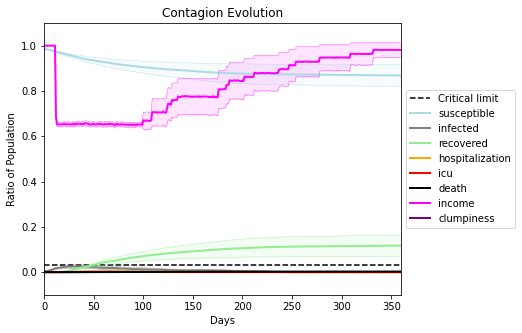

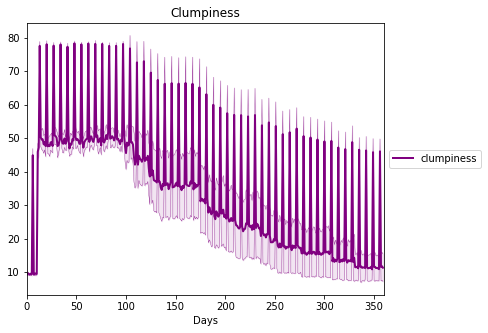

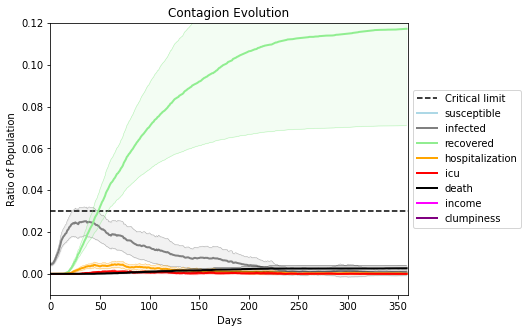

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 20
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = run_prefix+"T1", 
              do_print = True, 
              home_grid_height = 8, home_grid_width = 10, school_home_list = 

[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9)],
[
(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9)],
[
(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9)],
[
(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)]
]

,work_home_list =     
[
[
(0,0),(0,1),(0,2),(0,3),(0,4),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,0),(1,1),(1,2),(1,3),(1,4),
(1,5),(1,6),(1,7),(1,8),(1,9),

(2,0),(2,1),(2,2),(2,3),(2,4),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,0),(3,1),(3,2),(3,3),(3,4),
(3,5),(3,6),(3,7),(3,8),(3,9),


(4,0),(4,1),(4,2),(4,3),(4,4),
(4,5),(4,6),(4,7),(4,8),(4,9),
(5,0),(5,1),(5,2),(5,3),(5,4),
(5,5),(5,6),(5,7),(5,8),(5,9),

(6,0),(6,1),(6,2),(6,3),(6,4),
(6,5),(6,6),(6,7),(6,8),(6,9),
(7,0),(7,1),(7,2),(7,3),(7,4),
(7,5),(7,6),(7,7),(7,8),(7,9)
]

],listeners = listeners, compute_hoprank = False )
